In [1]:
%load_ext autoreload
%autoreload 2

import matplotlib.pyplot as plt
import numpy as np
from scipy.special import expi
from scipy.stats import norm
from scipy import signal
import random

# from wurlitzer import sys_pipes
# For C output, use as:
# with sys_pipes():
#     evran....
import xcoll as xc
from xcoll.scattering_routines.everest import random as evran
from xcoll.scattering_routines.pyeverest import random as k2ran

In [31]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

In [32]:
def test_random(r, bins, func):
    result = plt.hist(r, bins=bins, density=True,color="blue")
    plt.close()
    x = (result[1][:-1]+result[1][1:])/2
    y_meas = result[0]
    y_real = [ func(xx) for xx in x ]
    S = ((y_real-y_meas)**2).sum()

    print(S)

    fig, ax = plt.subplots(1, 2, figsize=(15,4))
    ax[0].plot(x,y_meas,'r.')
    ax[0].plot(x,y_real,'b-')
    ax[1].plot(x,y_meas,'r.')
    ax[1].plot(x,y_real,'b-')
    ax[1].set_yscale('log')
    plt.show()
    return S

# Rutherford random number generator

In [33]:
def PDF(t, z, emr):
    c = 0.8561e3
    A = (z**2)
    B = c*(emr**2)
    return (A/(t**2))*(np.exp(-B*t))

def CDF(t, z, emr):
    c = 0.8561e3
    A = (z**2)
    B = c*(emr**2)
    t0 = 0.0009982
    return - A*B*expi(-B*t) - t*PDF(t,z,emr) + A*B*expi(-B*t0) + t0*PDF(t0,z,emr)

CPU times: user 2.32 s, sys: 3.98 ms, total: 2.32 s
Wall time: 2.32 s
CPU times: user 1.78 s, sys: 3.95 ms, total: 1.79 s
Wall time: 1.79 s
11992.366420410306


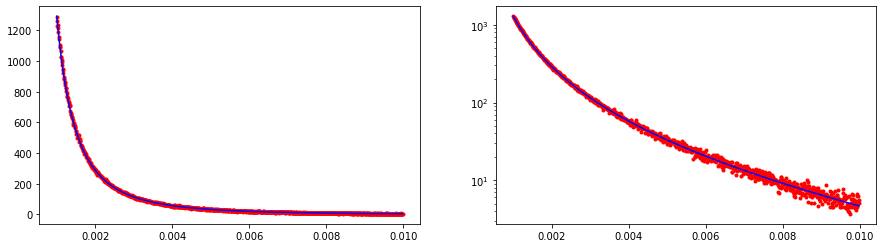

18162.36027628512


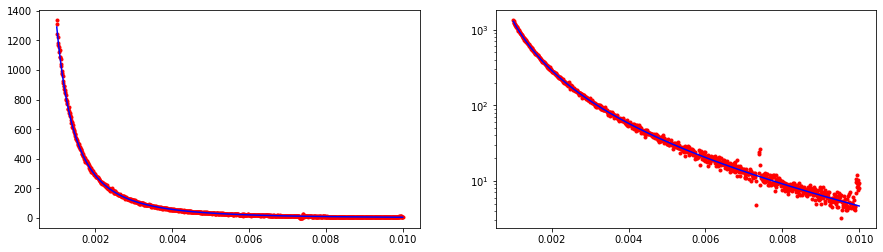

18162.36027628512

In [35]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(z,emr,t1)

n = 1000000
bins = 1000

f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

evran.set_rutherford_iterations(7)
%time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
%time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
test_random(r_everest, bins, f)
test_random(r_k2, bins, f)

## 1000000 samples

In [25]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 1000000
evran.set_rutherford_iterations(20)
bins = 1000

loops = 20
S_everest = []
S_K2 = []

f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 2.33 s, sys: 10 ms, total: 2.34 s
Wall time: 2.35 s
CPU times: user 1.86 s, sys: 6.87 ms, total: 1.87 s
Wall time: 1.87 s
11863.647420268833


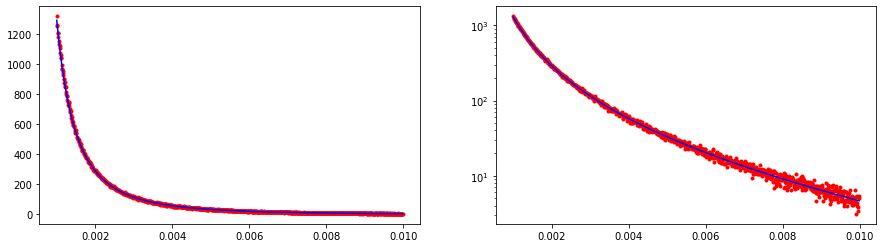

17919.02773107456


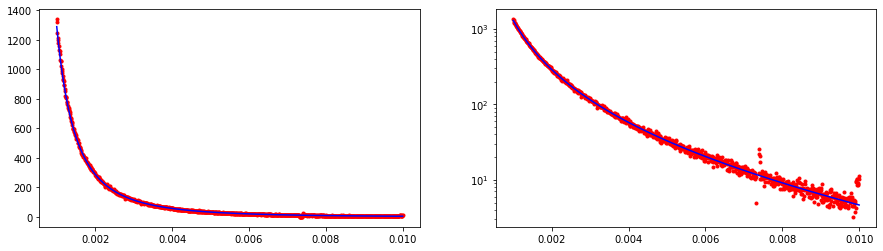

CPU times: user 2.36 s, sys: 2.96 ms, total: 2.36 s
Wall time: 2.37 s
CPU times: user 1.92 s, sys: 3.99 ms, total: 1.92 s
Wall time: 1.92 s
13205.488091460857


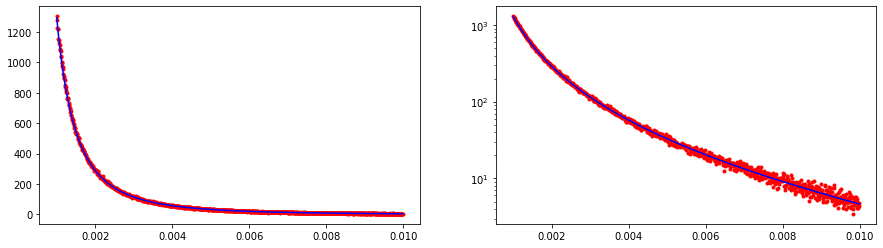

17857.01092831135


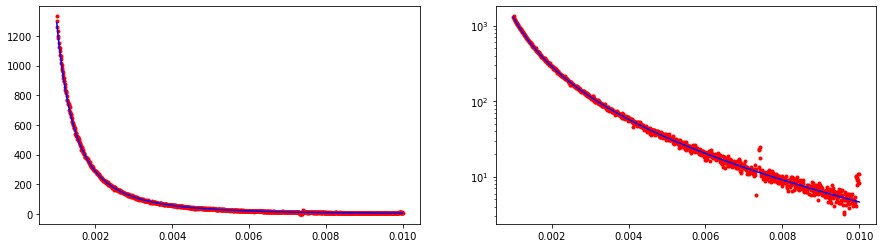

CPU times: user 2.35 s, sys: 4.98 ms, total: 2.35 s
Wall time: 2.36 s
CPU times: user 1.9 s, sys: 4.99 ms, total: 1.91 s
Wall time: 1.91 s
11737.519069912847


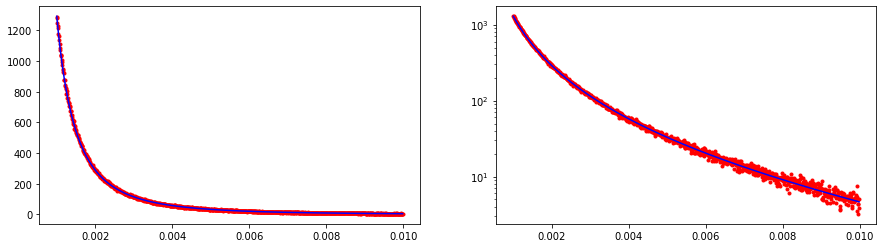

14641.42793723136


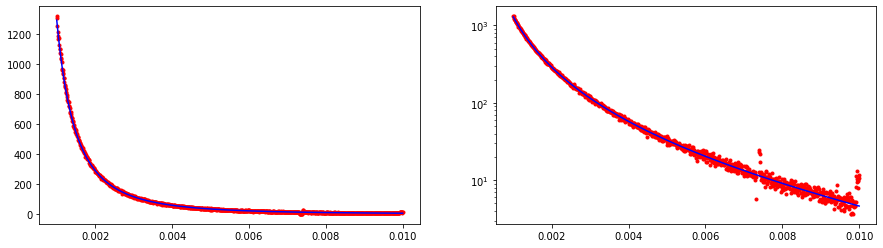

CPU times: user 2.33 s, sys: 8 ms, total: 2.34 s
Wall time: 2.34 s
CPU times: user 1.85 s, sys: 9.97 ms, total: 1.86 s
Wall time: 1.86 s
11664.945475987315


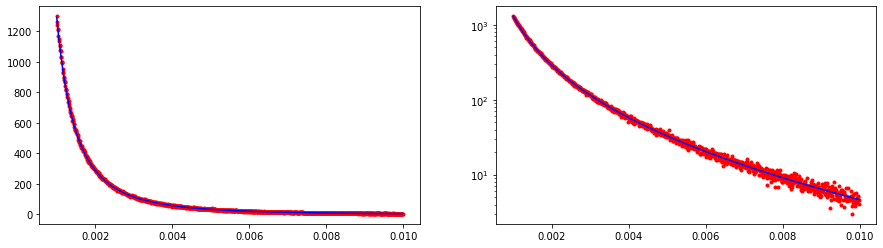

16691.889659884124


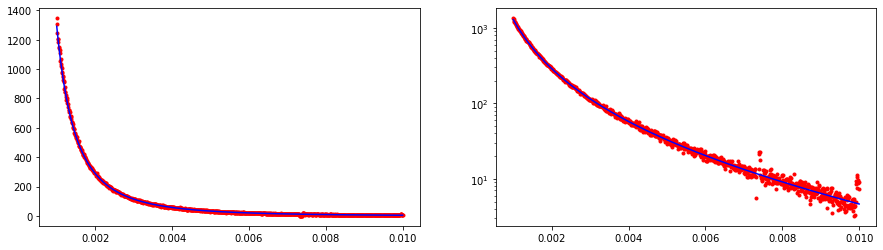

CPU times: user 2.33 s, sys: 3.99 ms, total: 2.33 s
Wall time: 2.34 s
CPU times: user 1.89 s, sys: 9.01 ms, total: 1.9 s
Wall time: 1.9 s
11253.5478771993


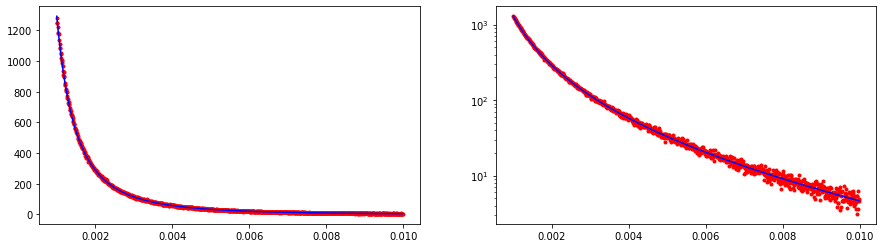

16930.411534866806


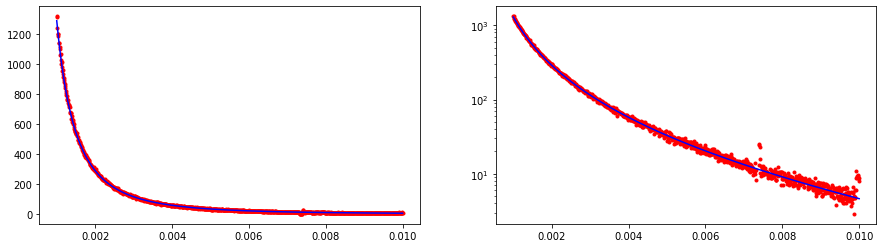

CPU times: user 2.33 s, sys: 3.99 ms, total: 2.33 s
Wall time: 2.33 s
CPU times: user 1.86 s, sys: 2.98 ms, total: 1.86 s
Wall time: 1.86 s
13893.523271921524


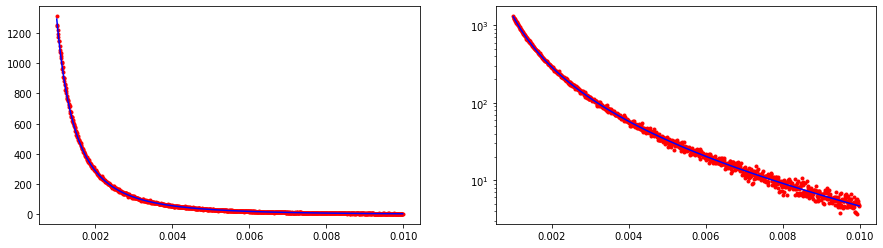

15642.65345498456


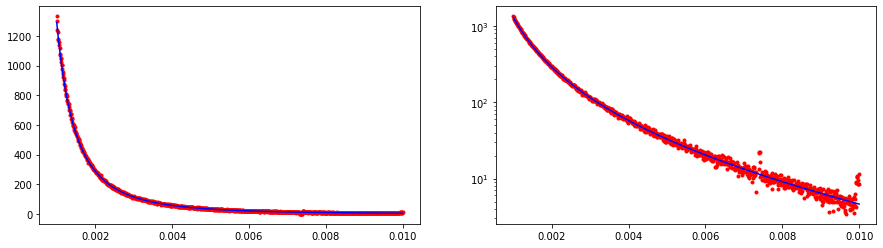

CPU times: user 2.33 s, sys: 7.97 ms, total: 2.34 s
Wall time: 2.34 s
CPU times: user 1.93 s, sys: 10 ms, total: 1.94 s
Wall time: 1.94 s
14077.297962433437


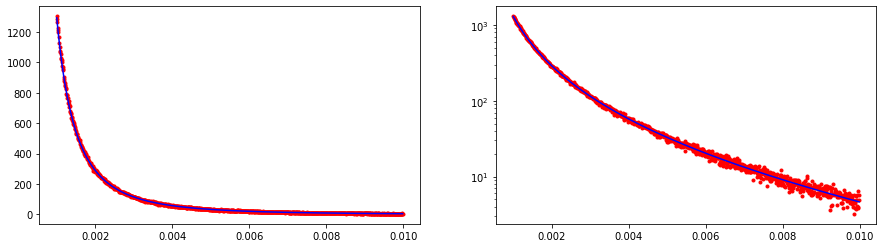

14839.187798936526


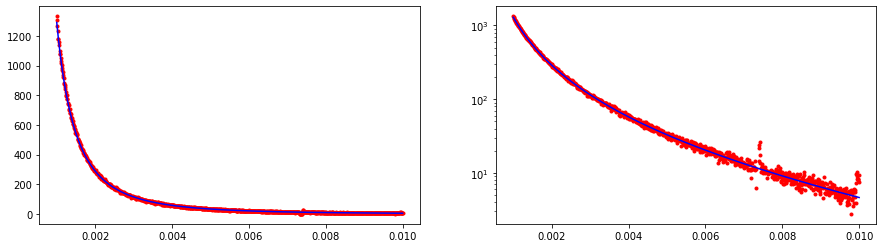

CPU times: user 2.32 s, sys: 5.98 ms, total: 2.33 s
Wall time: 2.33 s
CPU times: user 1.88 s, sys: 4.99 ms, total: 1.89 s
Wall time: 1.89 s
11229.425766236522


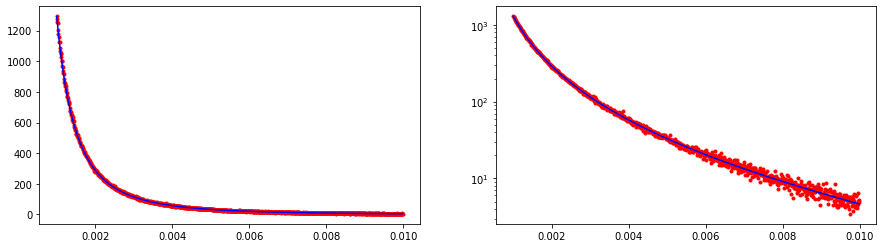

14037.70360967964


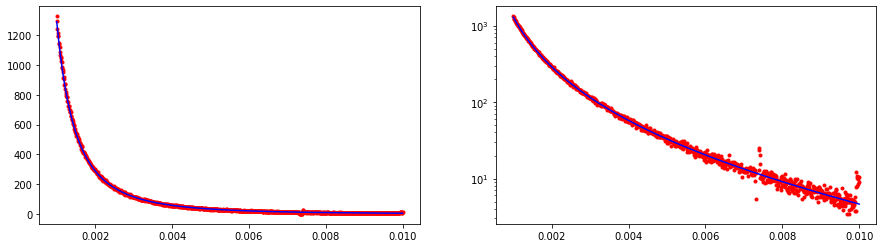

CPU times: user 2.33 s, sys: 8 ms, total: 2.34 s
Wall time: 2.34 s
CPU times: user 1.88 s, sys: 4.97 ms, total: 1.88 s
Wall time: 1.89 s
14393.501660401962


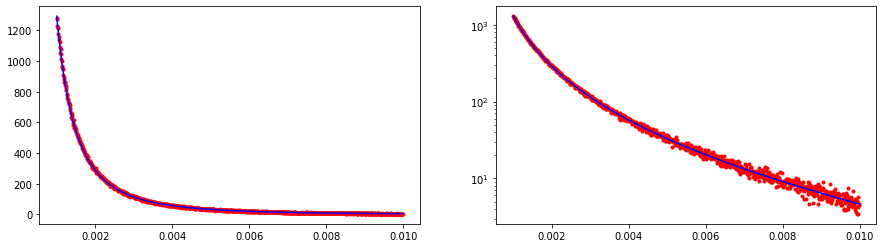

14218.419961939673


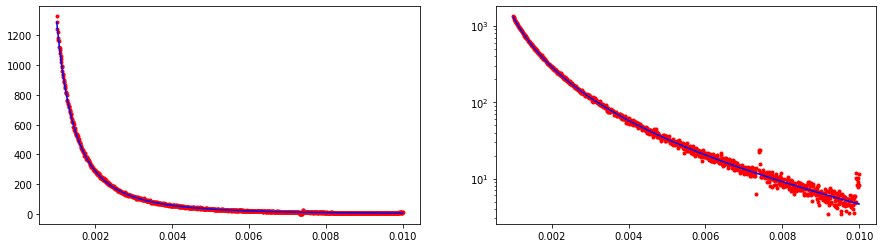

CPU times: user 2.39 s, sys: 11 ms, total: 2.4 s
Wall time: 2.4 s
CPU times: user 1.85 s, sys: 2.01 ms, total: 1.86 s
Wall time: 1.86 s
14109.202695478503


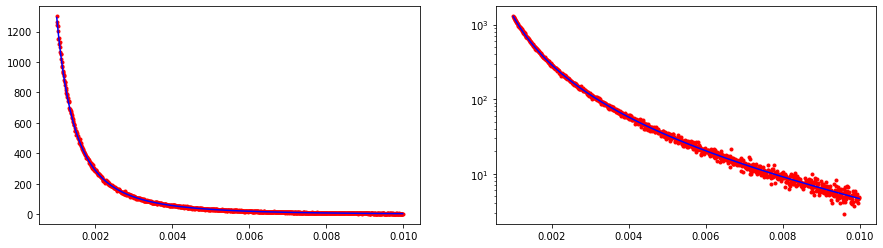

20455.046185282677


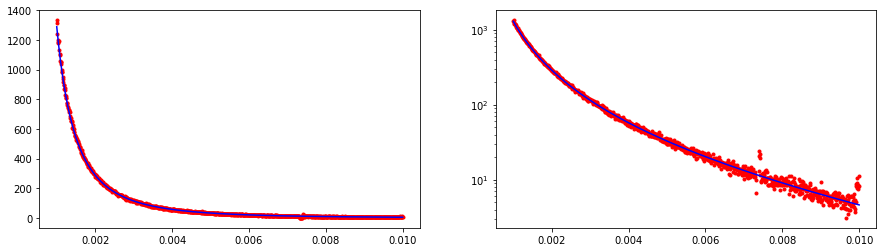

CPU times: user 2.33 s, sys: 4.96 ms, total: 2.34 s
Wall time: 2.34 s
CPU times: user 1.89 s, sys: 8.03 ms, total: 1.9 s
Wall time: 1.89 s
10815.727638981456


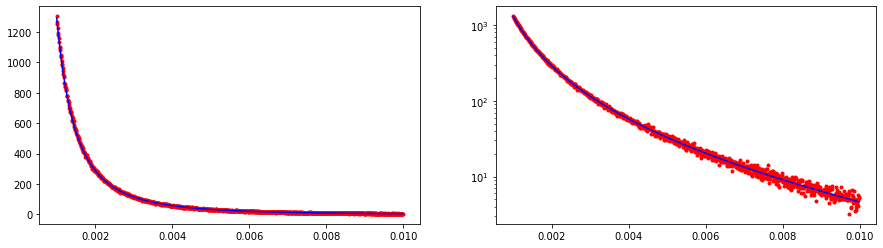

19583.954329371245


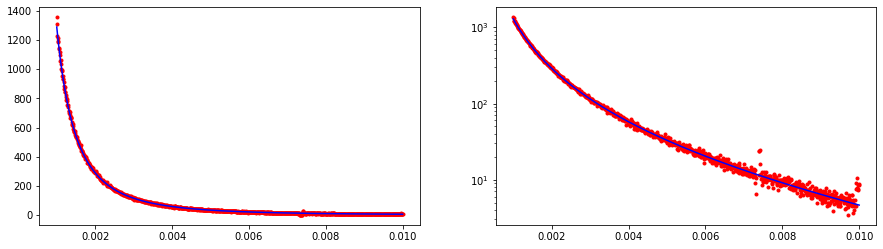

CPU times: user 2.33 s, sys: 10 ms, total: 2.34 s
Wall time: 2.34 s
CPU times: user 1.88 s, sys: 3.95 ms, total: 1.89 s
Wall time: 1.89 s
9754.137886392324


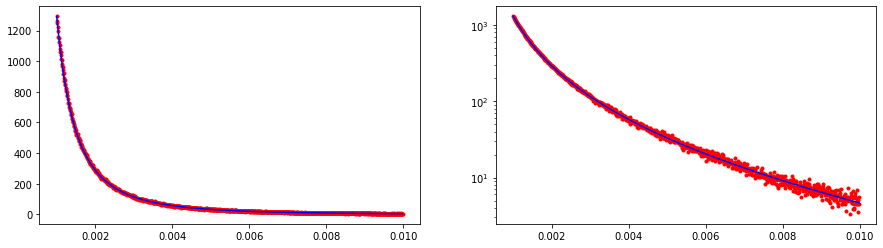

19029.108320926007


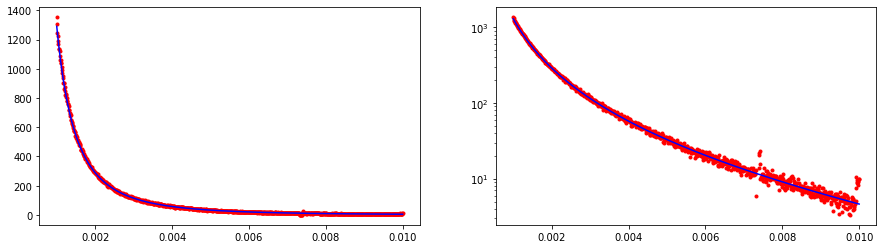

CPU times: user 2.34 s, sys: 3.99 ms, total: 2.34 s
Wall time: 2.34 s
CPU times: user 1.85 s, sys: 6 ms, total: 1.86 s
Wall time: 1.86 s
10721.827511617319


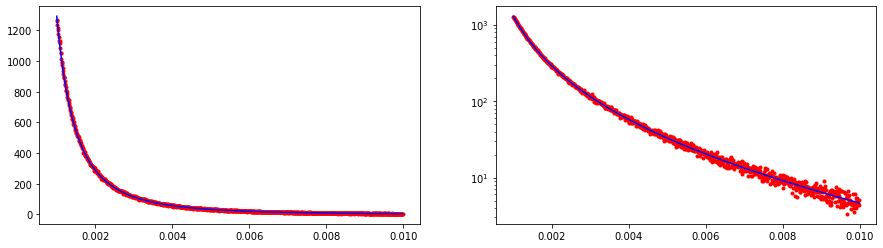

19593.500711759312


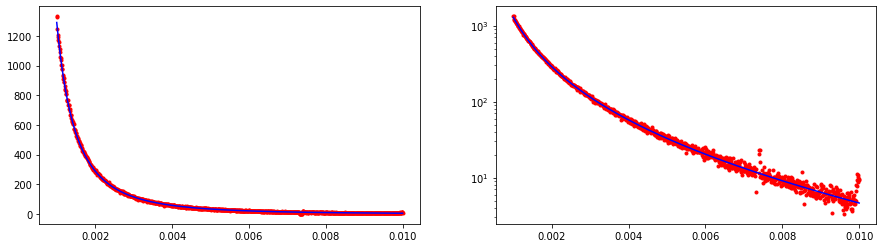

CPU times: user 2.32 s, sys: 4.98 ms, total: 2.32 s
Wall time: 2.32 s
CPU times: user 1.85 s, sys: 4.98 ms, total: 1.86 s
Wall time: 1.86 s
11878.656964672304


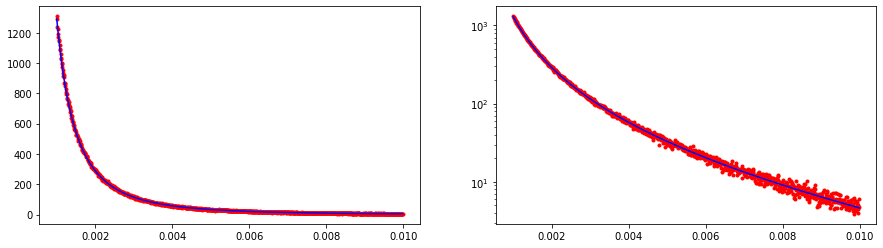

19345.30617063155


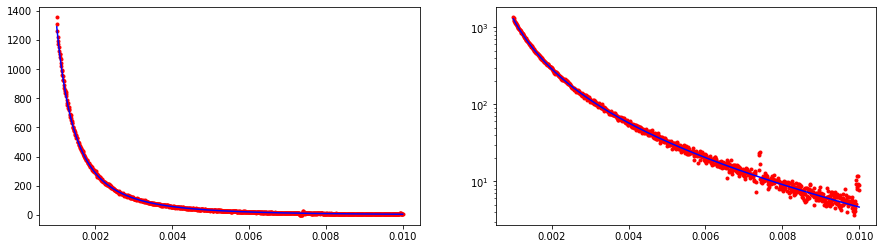

CPU times: user 2.33 s, sys: 10.9 ms, total: 2.34 s
Wall time: 2.34 s
CPU times: user 1.87 s, sys: 3.98 ms, total: 1.88 s
Wall time: 1.88 s
13558.79234828559


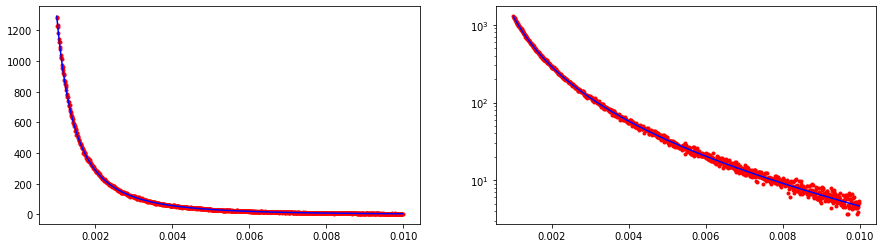

15442.778898482997


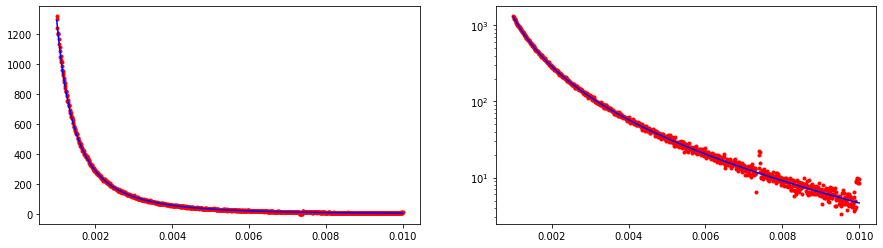

CPU times: user 2.32 s, sys: 6.97 ms, total: 2.33 s
Wall time: 2.33 s
CPU times: user 1.85 s, sys: 4.99 ms, total: 1.85 s
Wall time: 1.85 s
11889.810620236323


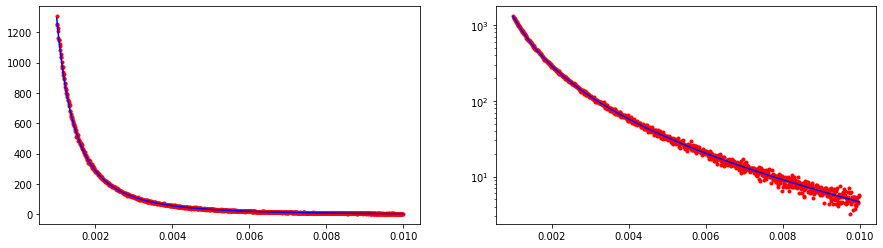

18228.395233013234


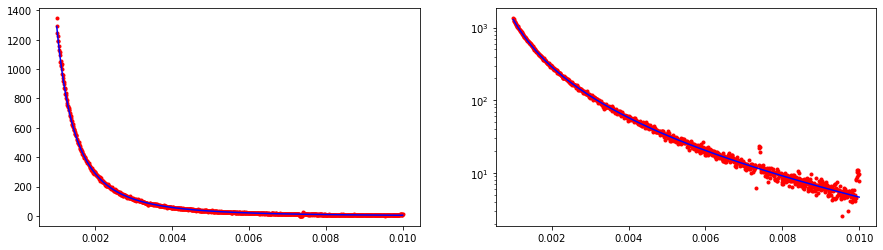

CPU times: user 2.4 s, sys: 3.83 ms, total: 2.41 s
Wall time: 2.41 s
CPU times: user 1.89 s, sys: 8.4 ms, total: 1.9 s
Wall time: 1.9 s
12323.017001359693


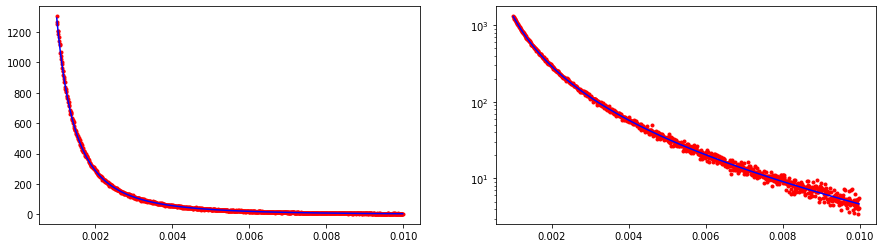

20008.87446400572


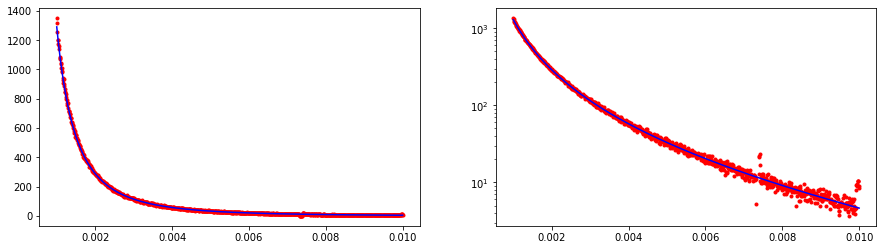

CPU times: user 2.32 s, sys: 8.99 ms, total: 2.33 s
Wall time: 2.34 s
CPU times: user 1.87 s, sys: 12.1 ms, total: 1.88 s
Wall time: 1.87 s
12760.154819885587


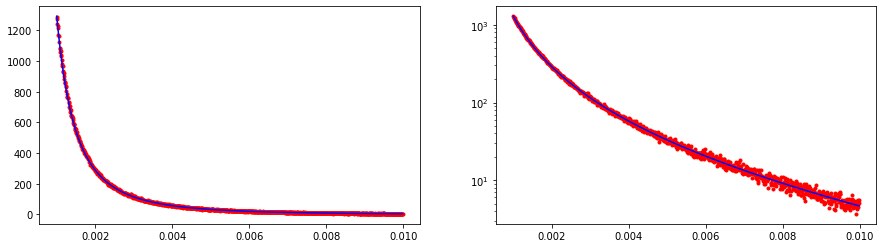

16103.606822844826


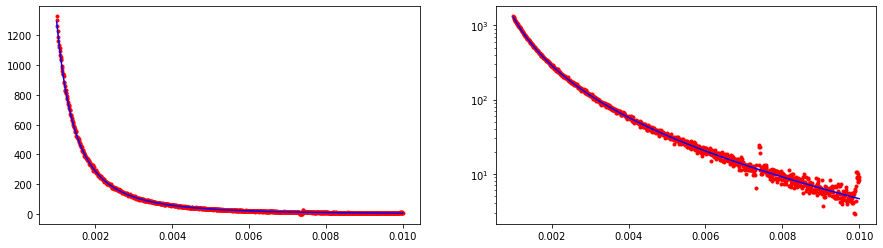

CPU times: user 2.33 s, sys: 4.98 ms, total: 2.33 s
Wall time: 2.33 s
CPU times: user 1.86 s, sys: 11.9 ms, total: 1.87 s
Wall time: 1.88 s
11047.929263535934


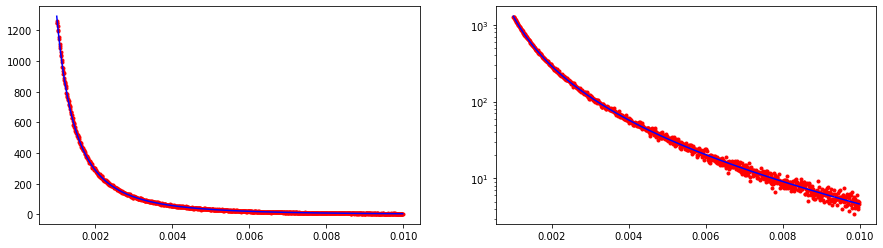

19751.82434727221


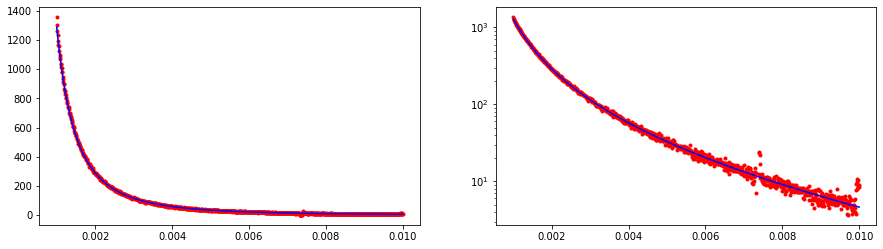

CPU times: user 2.4 s, sys: 3.93 ms, total: 2.41 s
Wall time: 2.41 s
CPU times: user 1.92 s, sys: 10.9 ms, total: 1.93 s
Wall time: 1.93 s
13471.081157643262


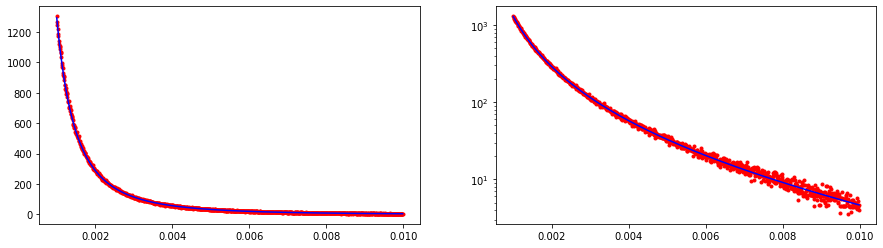

18865.069133299894


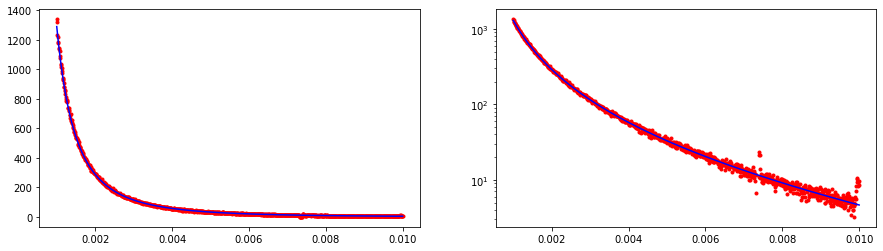

In [30]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [31]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

110.95433745976186
132.16188343963125
[0.88313806 0.81258032 0.81367673 0.8599493  0.89535742 0.83596598
 0.81528786 0.94243408 0.9739902  0.89439784 1.00613802 0.83052174
 0.74315205 0.71595418 0.73973878 0.7836026  0.93701766 0.8076315
 0.78477868 0.89015655 0.74788847 0.8450298 ]
0.8470246964110895


In [12]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 1000000
evran.set_rutherford_iterations(20)
bins = 1000

loops = 20
S_everest = []
S_K2 = []

f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 5.53 s, sys: 22.9 ms, total: 5.55 s
Wall time: 5.56 s
CPU times: user 2.41 s, sys: 19.5 ms, total: 2.43 s
Wall time: 2.42 s
2432.6600823354015


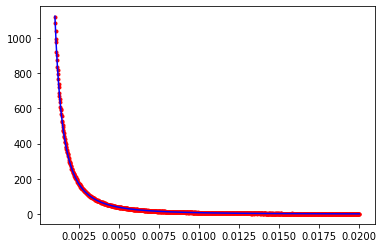

4399.146948352193


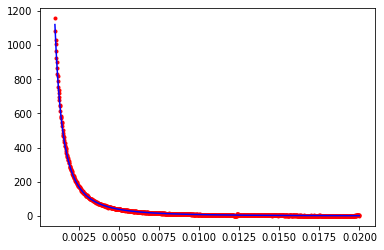

CPU times: user 5.62 s, sys: 40.8 ms, total: 5.66 s
Wall time: 5.57 s
CPU times: user 2.38 s, sys: 24.8 ms, total: 2.4 s
Wall time: 2.4 s
2574.557269228166


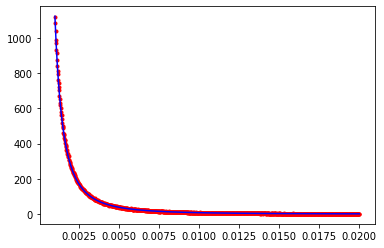

4903.51687546539


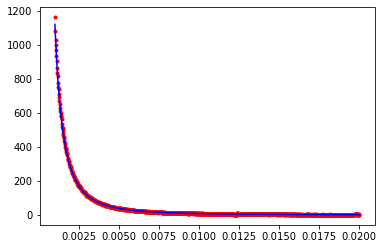

CPU times: user 5.63 s, sys: 38.1 ms, total: 5.67 s
Wall time: 5.61 s
CPU times: user 2.47 s, sys: 29.4 ms, total: 2.5 s
Wall time: 2.5 s
2683.4569332961883


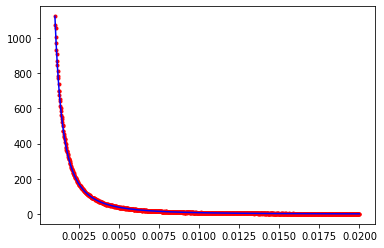

3939.101876583609


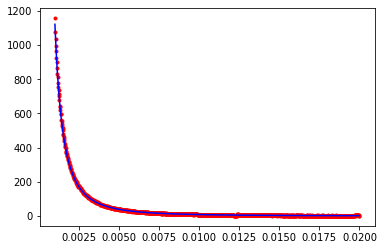

CPU times: user 5.7 s, sys: 48.3 ms, total: 5.75 s
Wall time: 5.67 s
CPU times: user 2.45 s, sys: 64 ms, total: 2.51 s
Wall time: 2.47 s
3175.805668783736


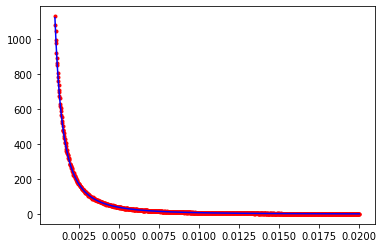

4412.787307992524


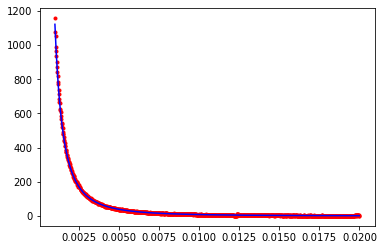

CPU times: user 5.72 s, sys: 50.9 ms, total: 5.77 s
Wall time: 5.68 s
CPU times: user 2.4 s, sys: 62.8 ms, total: 2.47 s
Wall time: 2.43 s
2731.8352832359633


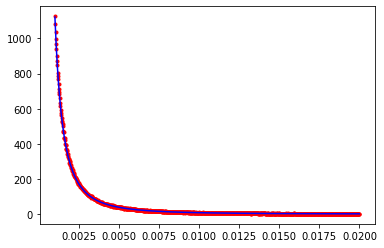

5819.9289400759835


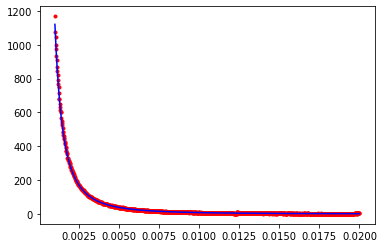

CPU times: user 5.64 s, sys: 40.8 ms, total: 5.69 s
Wall time: 5.59 s
CPU times: user 2.46 s, sys: 28.3 ms, total: 2.49 s
Wall time: 2.49 s
2413.0828259468417


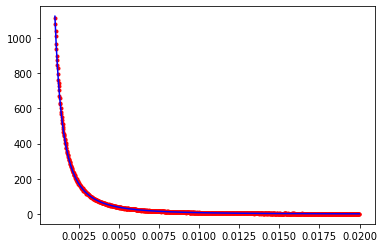

4467.256837898976


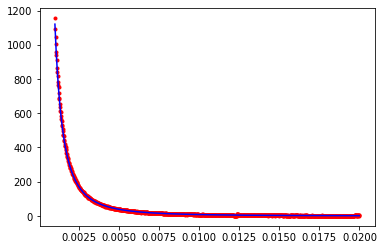

CPU times: user 5.74 s, sys: 46.4 ms, total: 5.79 s
Wall time: 5.7 s
CPU times: user 2.49 s, sys: 53.3 ms, total: 2.55 s
Wall time: 2.53 s
2994.4382103402368


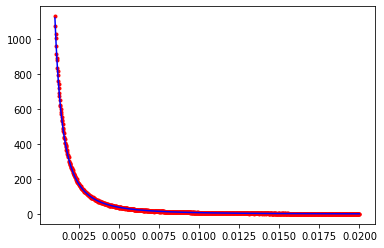

3439.7698968684936


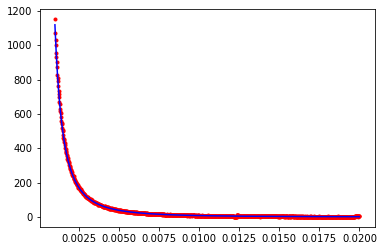

CPU times: user 5.63 s, sys: 42.1 ms, total: 5.68 s
Wall time: 5.59 s
CPU times: user 2.5 s, sys: 42.5 ms, total: 2.54 s
Wall time: 2.53 s
2719.62709801307


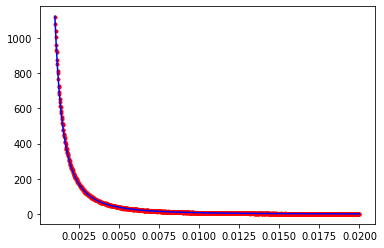

4683.786078811651


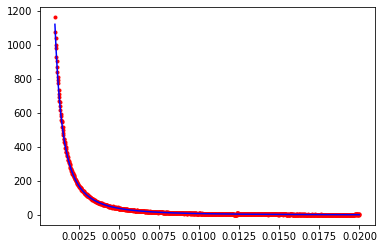

CPU times: user 5.68 s, sys: 41.5 ms, total: 5.72 s
Wall time: 5.68 s
CPU times: user 2.48 s, sys: 25.6 ms, total: 2.51 s
Wall time: 2.51 s
2717.0174126940433


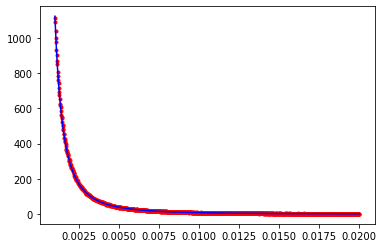

3734.6171926993884


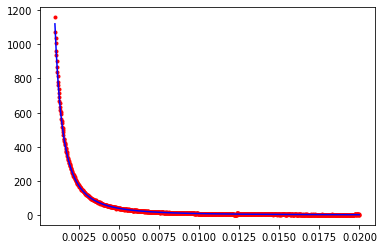

CPU times: user 5.67 s, sys: 41.2 ms, total: 5.71 s
Wall time: 5.61 s
CPU times: user 2.43 s, sys: 25.3 ms, total: 2.45 s
Wall time: 2.45 s
2288.9461223265203


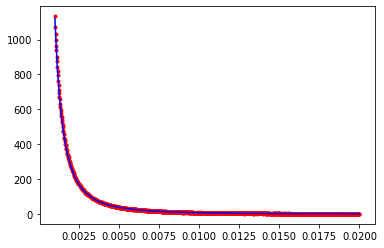

4138.257941320924


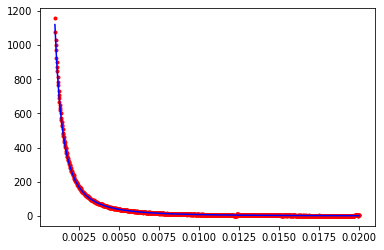

CPU times: user 5.68 s, sys: 41.4 ms, total: 5.72 s
Wall time: 5.65 s
CPU times: user 2.48 s, sys: 65.1 ms, total: 2.55 s
Wall time: 2.52 s
3036.247770770301


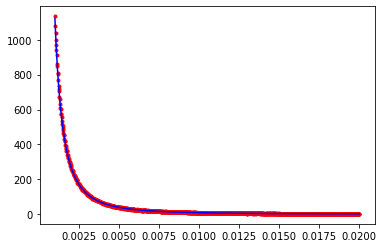

3985.4456036490947


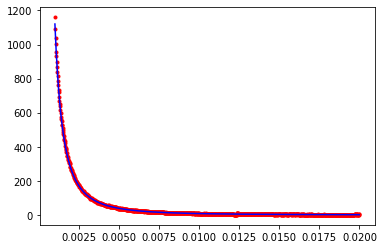

CPU times: user 5.48 s, sys: 28.8 ms, total: 5.51 s
Wall time: 5.42 s
CPU times: user 2.38 s, sys: 21.8 ms, total: 2.4 s
Wall time: 2.39 s
2179.8556601699133


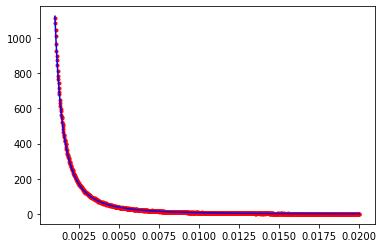

4097.775082518947


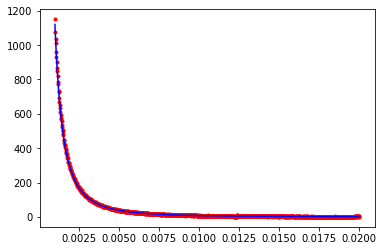

CPU times: user 5.67 s, sys: 45.1 ms, total: 5.72 s
Wall time: 5.64 s
CPU times: user 2.43 s, sys: 34.1 ms, total: 2.46 s
Wall time: 2.45 s
3084.524890873192


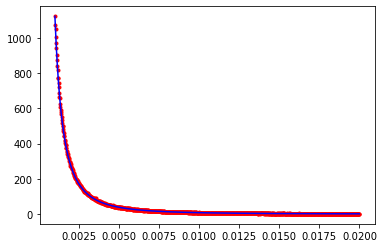

3990.417428384167


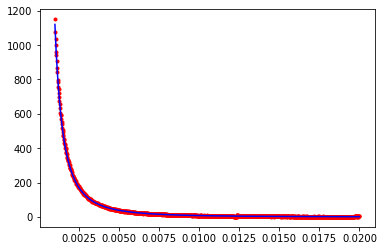

CPU times: user 5.54 s, sys: 38.9 ms, total: 5.58 s
Wall time: 5.48 s
CPU times: user 2.47 s, sys: 30.6 ms, total: 2.5 s
Wall time: 2.49 s
2176.112466633181


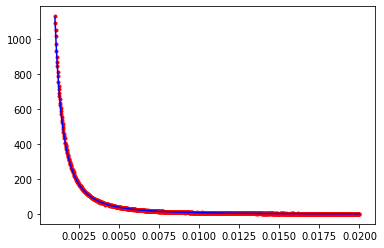

4547.805765766224


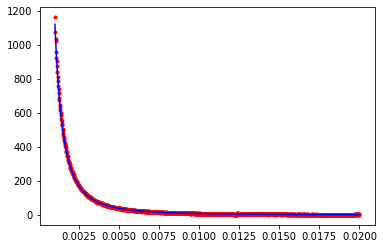

CPU times: user 5.49 s, sys: 32.1 ms, total: 5.52 s
Wall time: 5.42 s
CPU times: user 2.46 s, sys: 26.8 ms, total: 2.49 s
Wall time: 2.49 s
2902.2747285070304


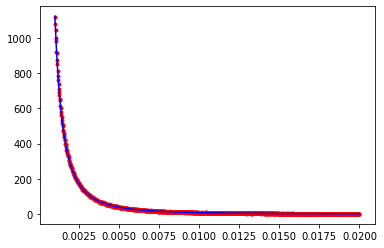

5623.579603739755


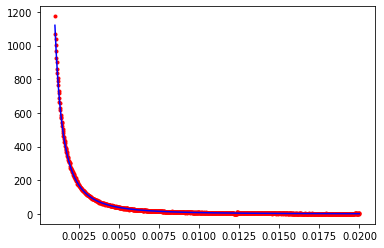

CPU times: user 5.62 s, sys: 40.4 ms, total: 5.66 s
Wall time: 5.56 s
CPU times: user 2.39 s, sys: 25 ms, total: 2.42 s
Wall time: 2.41 s
2862.910368641669


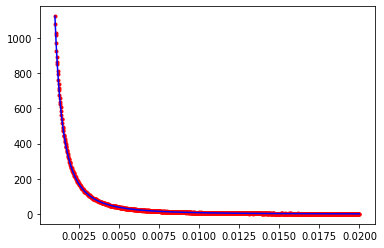

5416.611157684611


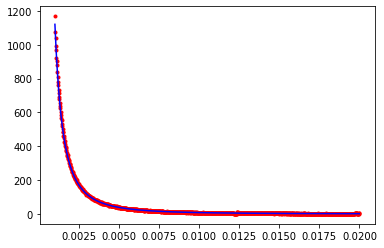

CPU times: user 5.47 s, sys: 35.3 ms, total: 5.51 s
Wall time: 5.41 s
CPU times: user 2.35 s, sys: 20.7 ms, total: 2.37 s
Wall time: 2.37 s
2896.6729932245084


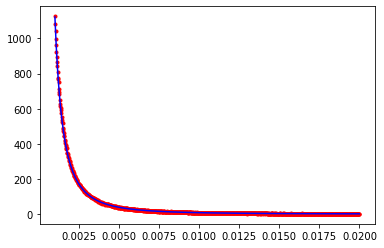

5013.062653666839


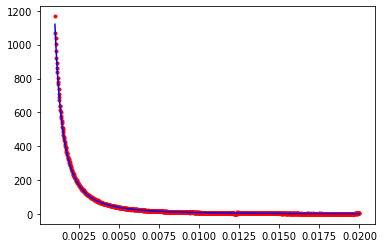

CPU times: user 5.56 s, sys: 34 ms, total: 5.59 s
Wall time: 5.49 s
CPU times: user 2.37 s, sys: 24.5 ms, total: 2.4 s
Wall time: 2.4 s
2798.230540134354


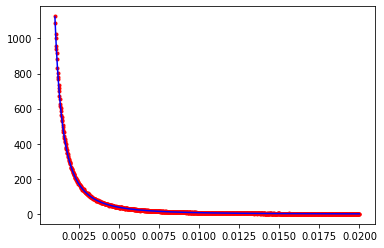

5987.30757650346


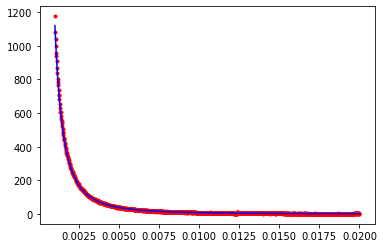

CPU times: user 5.5 s, sys: 31.3 ms, total: 5.53 s
Wall time: 5.43 s
CPU times: user 2.37 s, sys: 20.3 ms, total: 2.39 s
Wall time: 2.38 s
2934.9727237258353


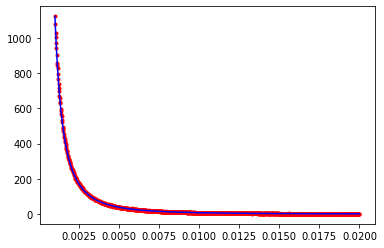

3860.9928485730316


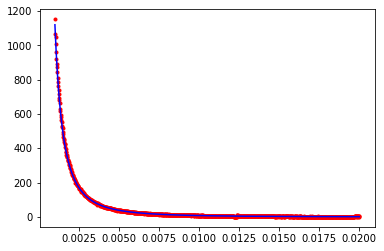

CPU times: user 5.67 s, sys: 50 ms, total: 5.72 s
Wall time: 5.63 s
CPU times: user 2.5 s, sys: 32 ms, total: 2.53 s
Wall time: 2.53 s
3497.953856371402


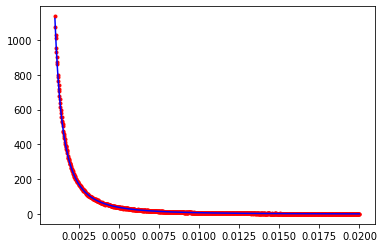

4670.812441559477


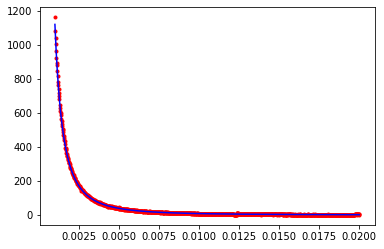

In [13]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [14]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

52.48865730100721
67.50258515720519
[0.74362928 0.72459852 0.82537005 0.84834101 0.68512279 0.7349633
 0.93302436 0.76200208 0.8529492  0.74371922 0.872831   0.72935642
 0.87919453 0.69173494 0.71839423 0.72700943 0.76014802 0.68363763
 0.87187161 0.86538791]
0.786272280075917


In [15]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 1000000
evran.set_rutherford_iterations(20)
bins = 1000

loops = 20
S_everest = []
S_K2 = []

f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 6.04 s, sys: 19.2 ms, total: 6.06 s
Wall time: 6.06 s
CPU times: user 2.49 s, sys: 34.2 ms, total: 2.53 s
Wall time: 2.53 s
11094.807837934271


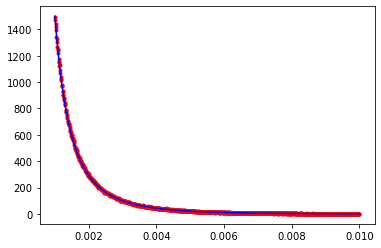

16921.23804475148


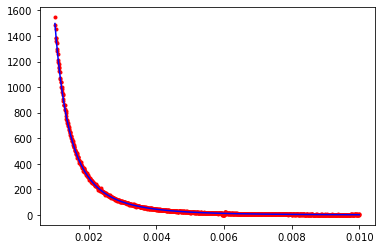

CPU times: user 6.08 s, sys: 34.4 ms, total: 6.11 s
Wall time: 6.02 s
CPU times: user 2.41 s, sys: 39.2 ms, total: 2.44 s
Wall time: 2.43 s
12198.156657769525


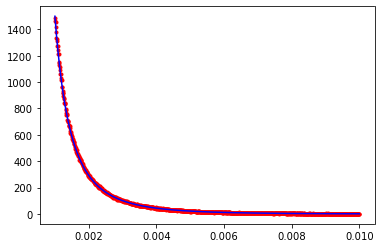

18262.128472395678


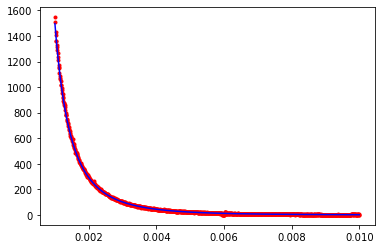

CPU times: user 6.25 s, sys: 46 ms, total: 6.3 s
Wall time: 6.2 s
CPU times: user 2.49 s, sys: 61.4 ms, total: 2.55 s
Wall time: 2.53 s
13624.189830508687


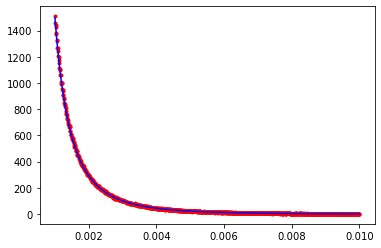

14681.415447170097


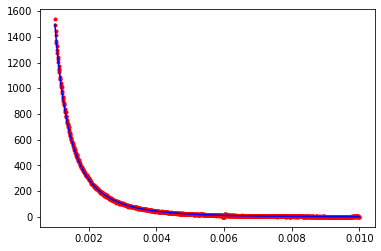

CPU times: user 6.22 s, sys: 44.1 ms, total: 6.26 s
Wall time: 6.17 s
CPU times: user 2.45 s, sys: 40.9 ms, total: 2.5 s
Wall time: 2.48 s
14187.307557596974


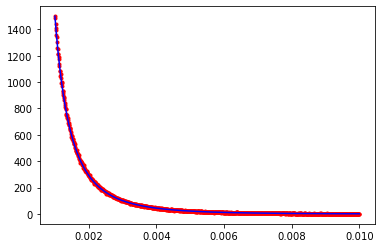

15575.272712226451


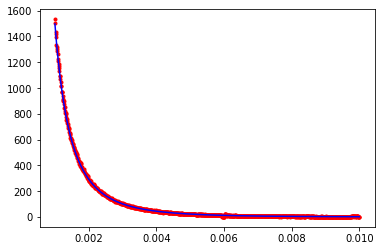

CPU times: user 6.25 s, sys: 47.1 ms, total: 6.29 s
Wall time: 6.2 s
CPU times: user 2.49 s, sys: 41.3 ms, total: 2.53 s
Wall time: 2.52 s
11657.78267321746


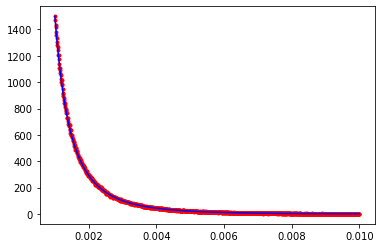

18558.524905072903


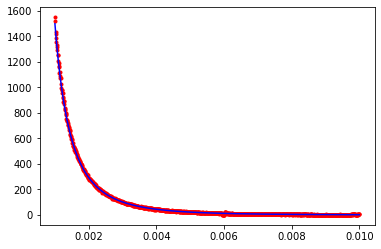

CPU times: user 6.22 s, sys: 47.6 ms, total: 6.27 s
Wall time: 6.17 s
CPU times: user 2.48 s, sys: 27.1 ms, total: 2.5 s
Wall time: 2.51 s
9561.610189726223


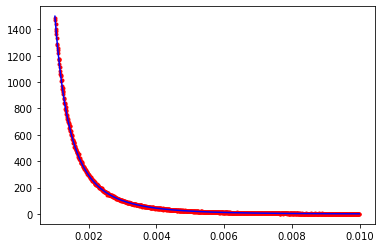

16129.980635996642


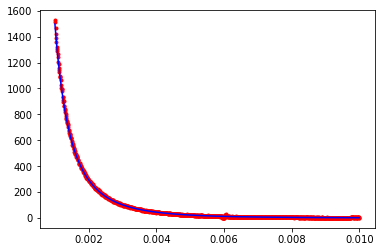

CPU times: user 6.27 s, sys: 44.1 ms, total: 6.32 s
Wall time: 6.24 s
CPU times: user 2.48 s, sys: 40.7 ms, total: 2.52 s
Wall time: 2.52 s
12504.486722852875


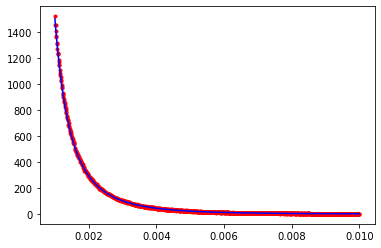

15028.288041413736


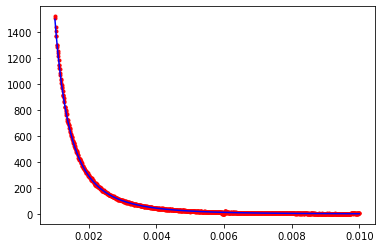

CPU times: user 6.17 s, sys: 42.8 ms, total: 6.21 s
Wall time: 6.11 s
CPU times: user 2.5 s, sys: 27 ms, total: 2.53 s
Wall time: 2.53 s
11327.161853550515


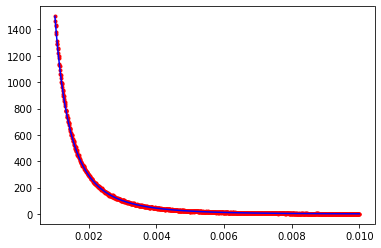

17508.489642207485


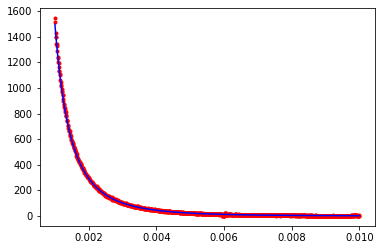

CPU times: user 6.09 s, sys: 34.8 ms, total: 6.12 s
Wall time: 6.05 s
CPU times: user 2.35 s, sys: 22.3 ms, total: 2.38 s
Wall time: 2.37 s
10877.28604924866


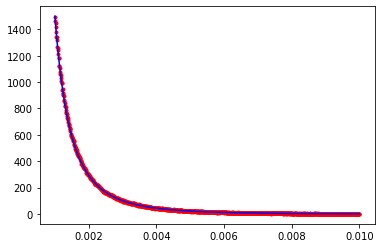

16883.64055984698


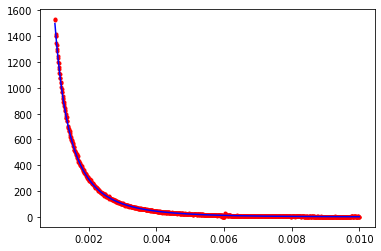

CPU times: user 6.14 s, sys: 33 ms, total: 6.17 s
Wall time: 6.08 s
CPU times: user 2.46 s, sys: 27.6 ms, total: 2.49 s
Wall time: 2.49 s
10365.10406408762


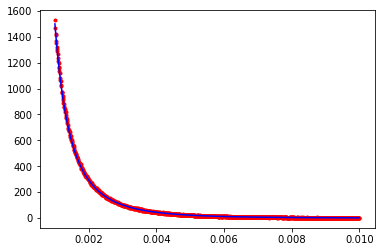

15636.266795341044


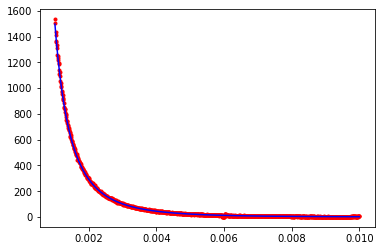

CPU times: user 6.22 s, sys: 41.7 ms, total: 6.26 s
Wall time: 6.18 s
CPU times: user 2.45 s, sys: 72.3 ms, total: 2.52 s
Wall time: 2.48 s
13755.082426900002


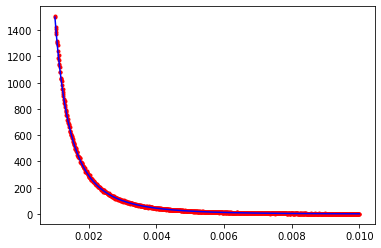

16713.19289306574


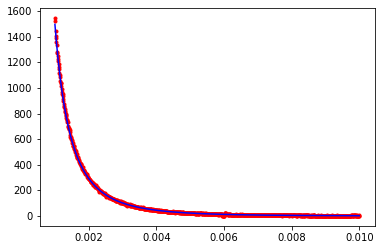

CPU times: user 6.07 s, sys: 37 ms, total: 6.11 s
Wall time: 6 s
CPU times: user 2.35 s, sys: 24.1 ms, total: 2.37 s
Wall time: 2.37 s
10245.37829949718


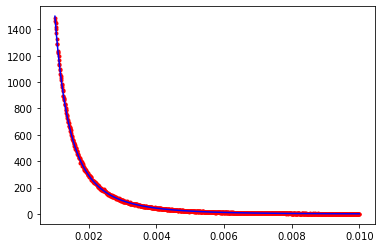

16380.250860775144


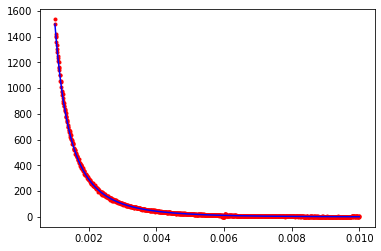

CPU times: user 6 s, sys: 29 ms, total: 6.03 s
Wall time: 5.92 s
CPU times: user 2.33 s, sys: 18.6 ms, total: 2.35 s
Wall time: 2.35 s
13740.150413009427


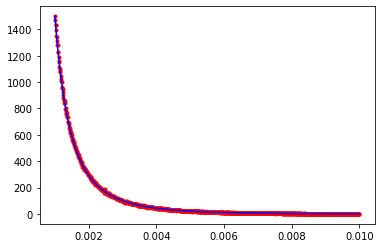

13419.985919736855


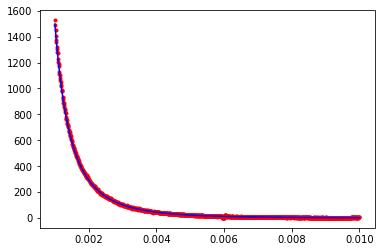

CPU times: user 6.02 s, sys: 30 ms, total: 6.05 s
Wall time: 5.94 s
CPU times: user 2.34 s, sys: 18.5 ms, total: 2.36 s
Wall time: 2.35 s
9778.047983016151


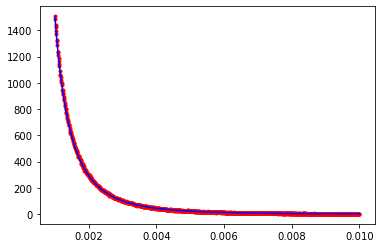

17891.77456168265


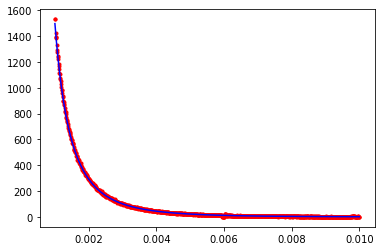

CPU times: user 6.09 s, sys: 39.7 ms, total: 6.13 s
Wall time: 6.03 s
CPU times: user 2.68 s, sys: 42 ms, total: 2.73 s
Wall time: 2.74 s
14055.796169461126


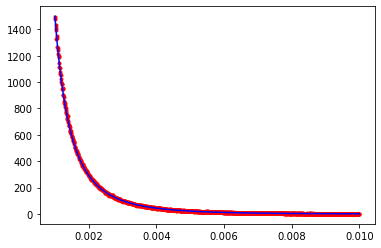

19029.802763989497


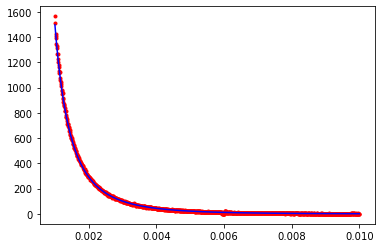

CPU times: user 6.24 s, sys: 42.1 ms, total: 6.28 s
Wall time: 6.19 s
CPU times: user 2.48 s, sys: 32.2 ms, total: 2.52 s
Wall time: 2.52 s
12984.852709627736


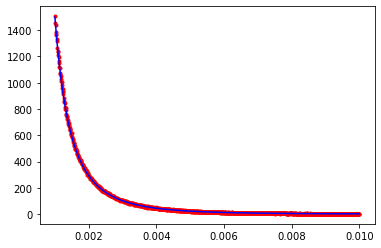

19062.520538312885


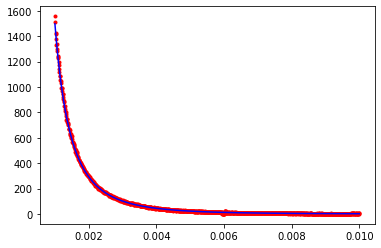

CPU times: user 6.2 s, sys: 39.5 ms, total: 6.24 s
Wall time: 6.21 s
CPU times: user 2.52 s, sys: 28.6 ms, total: 2.55 s
Wall time: 2.55 s
13772.463338320547


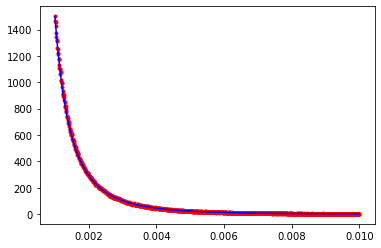

16719.67854976641


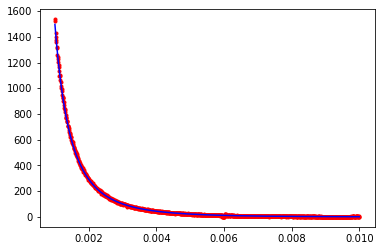

CPU times: user 6.23 s, sys: 37 ms, total: 6.26 s
Wall time: 6.17 s
CPU times: user 2.45 s, sys: 34 ms, total: 2.49 s
Wall time: 2.48 s
12619.680389862915


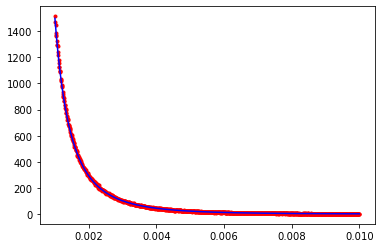

21181.063296702934


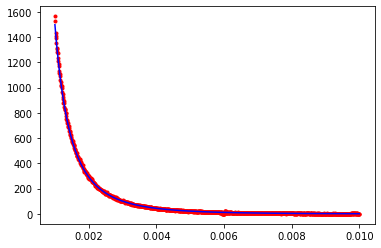

CPU times: user 6.2 s, sys: 41.7 ms, total: 6.25 s
Wall time: 6.18 s
CPU times: user 2.47 s, sys: 32.4 ms, total: 2.5 s
Wall time: 2.49 s
11998.196259267192


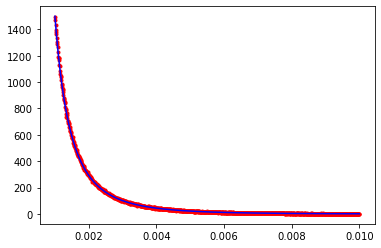

15485.935323445052


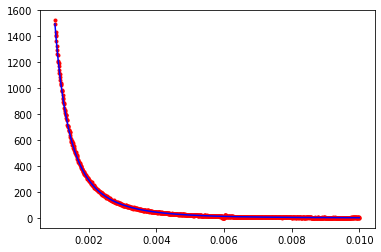

CPU times: user 6.06 s, sys: 29.7 ms, total: 6.09 s
Wall time: 5.98 s
CPU times: user 2.41 s, sys: 36.2 ms, total: 2.44 s
Wall time: 2.43 s
14932.251940149958


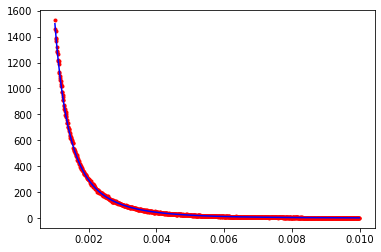

18044.56855255246


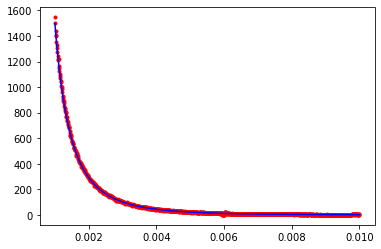

In [16]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [17]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

110.74289895194298
130.21405809597752
[0.8097367  0.81728101 0.96332178 0.9544038  0.79256748 0.76992531
 0.91217503 0.8043336  0.80265188 0.81417975 0.90719759 0.79086749
 1.01185833 0.73926369 0.85943014 0.82533137 0.90759449 0.77188091
 0.880216   0.90968158]
0.855279709675336


## 5000 samples, 20 iterations

In [18]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(20)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 35.4 ms, sys: 3.15 ms, total: 38.5 ms
Wall time: 38 ms
CPU times: user 24.2 ms, sys: 8.82 ms, total: 33 ms
Wall time: 28.6 ms
30975.527654890047


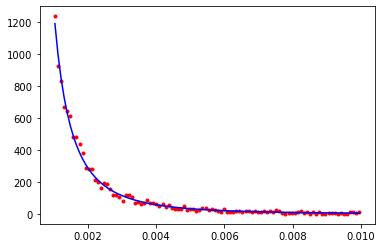

16326.253888455087


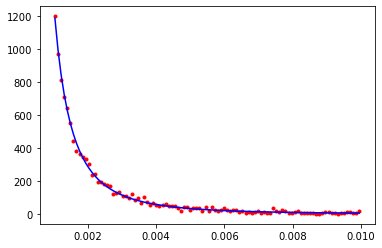

CPU times: user 78.6 ms, sys: 10.7 ms, total: 89.3 ms
Wall time: 30.1 ms
CPU times: user 40.8 ms, sys: 24.8 ms, total: 65.7 ms
Wall time: 21.1 ms
19761.519417502786


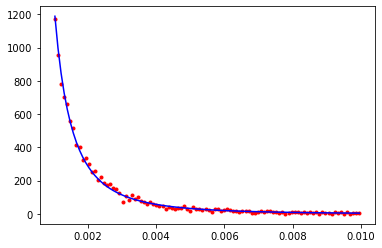

23262.532401250377


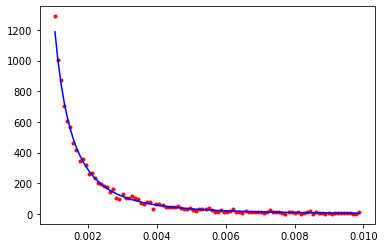

CPU times: user 79.4 ms, sys: 10.2 ms, total: 89.6 ms
Wall time: 30 ms
CPU times: user 34.6 ms, sys: 7 ms, total: 41.6 ms
Wall time: 13.9 ms
31838.57837341277


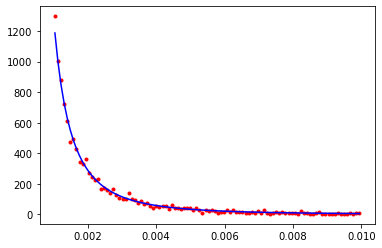

15796.700082084046


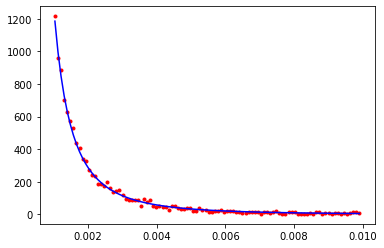

CPU times: user 77 ms, sys: 11.9 ms, total: 88.9 ms
Wall time: 30.3 ms
CPU times: user 33.8 ms, sys: 8.77 ms, total: 42.5 ms
Wall time: 14.5 ms
23946.487098849302


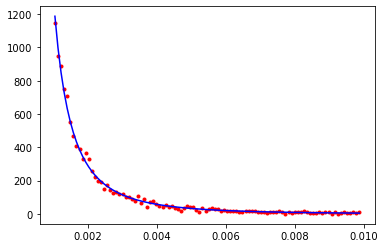

16050.625972424821


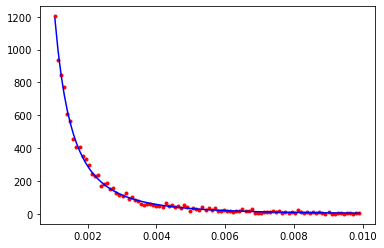

CPU times: user 78 ms, sys: 11.3 ms, total: 89.3 ms
Wall time: 30.3 ms
CPU times: user 37 ms, sys: 13.3 ms, total: 50.3 ms
Wall time: 16.8 ms
41962.56481555434


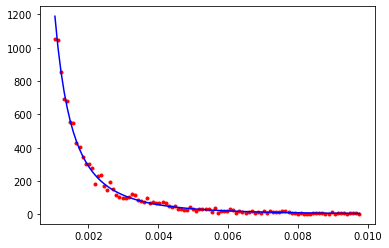

21224.72300801168


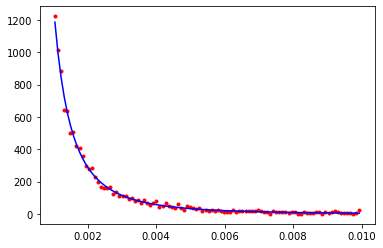

CPU times: user 78.7 ms, sys: 10.8 ms, total: 89.5 ms
Wall time: 30.2 ms
CPU times: user 43.7 ms, sys: 42.7 ms, total: 86.3 ms
Wall time: 27.8 ms
18895.306858960925


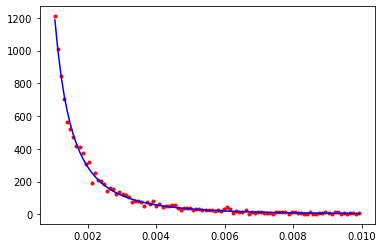

24334.16320841606


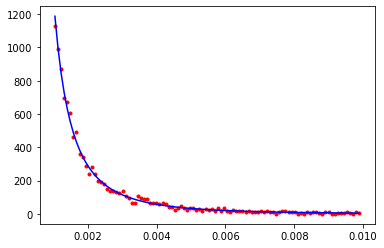

CPU times: user 78.6 ms, sys: 11.6 ms, total: 90.2 ms
Wall time: 30.6 ms
CPU times: user 34.8 ms, sys: 8.44 ms, total: 43.3 ms
Wall time: 14.6 ms
29814.396168289844


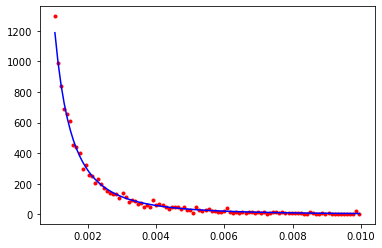

17340.067152407246


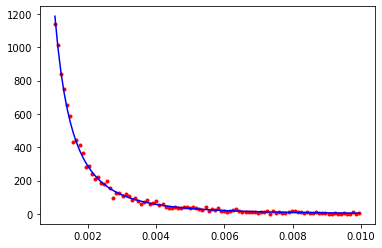

CPU times: user 77.5 ms, sys: 11.8 ms, total: 89.3 ms
Wall time: 30.4 ms
CPU times: user 35.4 ms, sys: 8.5 ms, total: 43.9 ms
Wall time: 14.8 ms
18336.063514777394


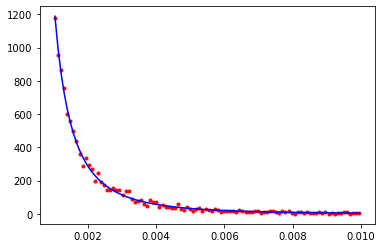

22794.749343411833


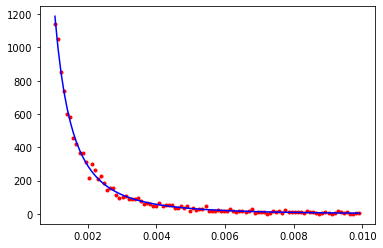

CPU times: user 77.7 ms, sys: 11.8 ms, total: 89.5 ms
Wall time: 30.5 ms
CPU times: user 35.5 ms, sys: 7.94 ms, total: 43.4 ms
Wall time: 14.6 ms
12001.392392149139


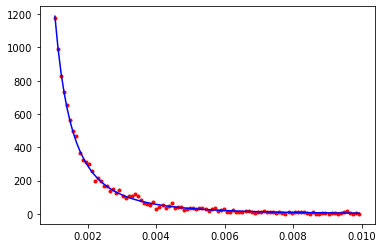

16193.329812112608


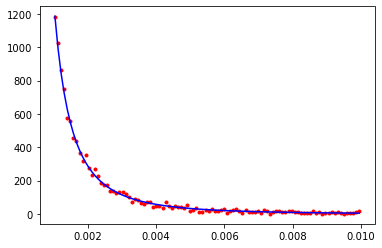

CPU times: user 77.7 ms, sys: 11.6 ms, total: 89.3 ms
Wall time: 30.4 ms
CPU times: user 34.9 ms, sys: 8.05 ms, total: 43 ms
Wall time: 14.6 ms
23265.74367445408


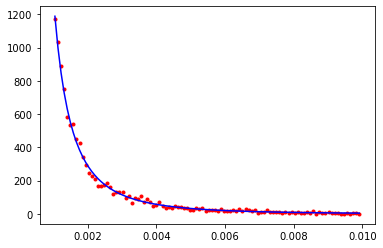

27831.15282156286


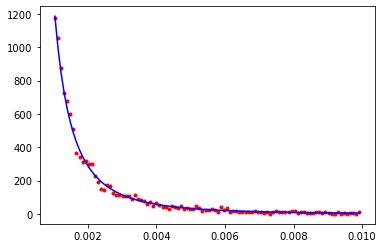

CPU times: user 79.2 ms, sys: 10.5 ms, total: 89.7 ms
Wall time: 30.1 ms
CPU times: user 35.5 ms, sys: 10.6 ms, total: 46.2 ms
Wall time: 15.5 ms
25428.935629793486


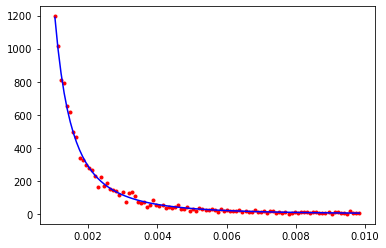

26753.905550980526


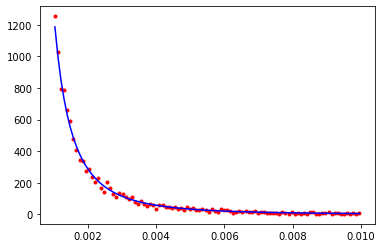

CPU times: user 80 ms, sys: 10.6 ms, total: 90.6 ms
Wall time: 30.5 ms
CPU times: user 35 ms, sys: 7.52 ms, total: 42.5 ms
Wall time: 14.2 ms
29765.812444656654


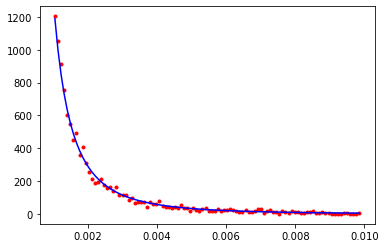

23840.76089012738


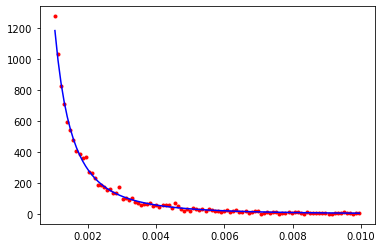

CPU times: user 79.6 ms, sys: 10.1 ms, total: 89.7 ms
Wall time: 30 ms
CPU times: user 35.4 ms, sys: 8.29 ms, total: 43.7 ms
Wall time: 14.5 ms
20702.267814359486


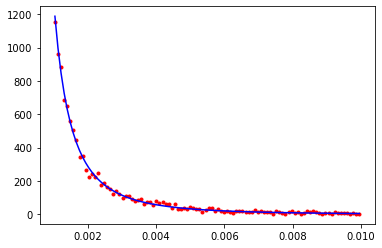

26529.892425471597


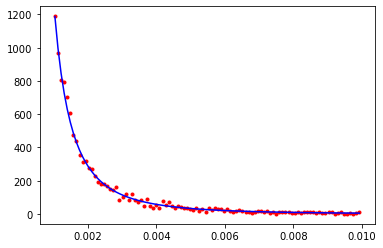

CPU times: user 79.3 ms, sys: 9.99 ms, total: 89.3 ms
Wall time: 29.9 ms
CPU times: user 34.9 ms, sys: 6.5 ms, total: 41.4 ms
Wall time: 13.8 ms
26214.232113333863


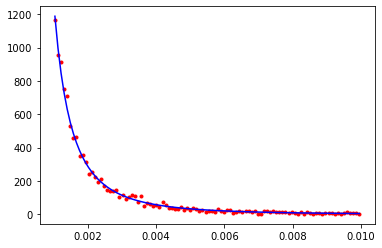

16962.603278815342


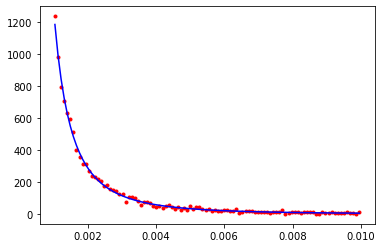

CPU times: user 79.7 ms, sys: 10 ms, total: 89.7 ms
Wall time: 30 ms
CPU times: user 34.9 ms, sys: 6.78 ms, total: 41.7 ms
Wall time: 13.9 ms
24860.60054201775


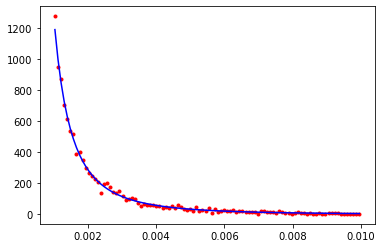

28281.79769832608


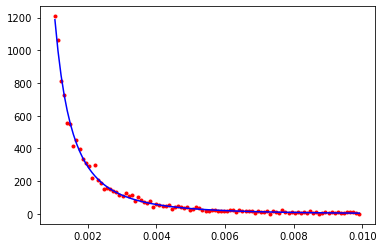

CPU times: user 78.5 ms, sys: 9.75 ms, total: 88.2 ms
Wall time: 29.5 ms
CPU times: user 35 ms, sys: 6.51 ms, total: 41.5 ms
Wall time: 13.9 ms
21800.05916278795


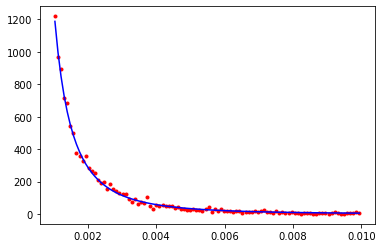

12820.303690006225


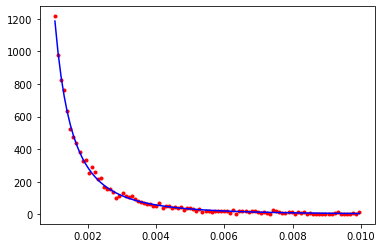

CPU times: user 79.8 ms, sys: 9.88 ms, total: 89.6 ms
Wall time: 29.9 ms
CPU times: user 42.3 ms, sys: 32.5 ms, total: 74.8 ms
Wall time: 23.6 ms
19524.46308056453


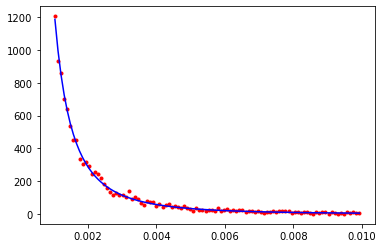

23148.44252267499


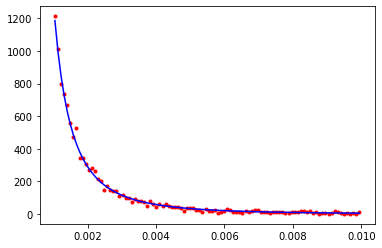

CPU times: user 79.5 ms, sys: 10.1 ms, total: 89.5 ms
Wall time: 30 ms
CPU times: user 35.2 ms, sys: 6.61 ms, total: 41.8 ms
Wall time: 14 ms
13003.648590482004


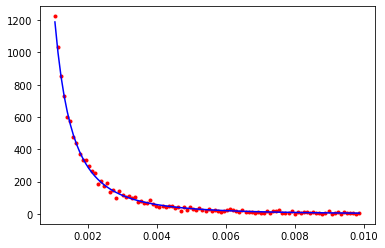

17329.163941793


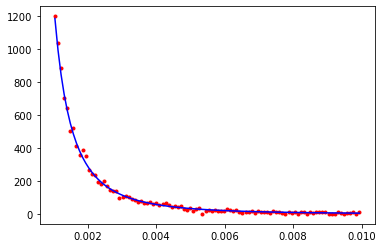

CPU times: user 79.8 ms, sys: 9.98 ms, total: 89.8 ms
Wall time: 30 ms
CPU times: user 35 ms, sys: 7.69 ms, total: 42.7 ms
Wall time: 14.2 ms
24186.757570729045


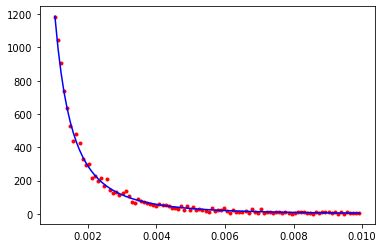

26059.43449973095


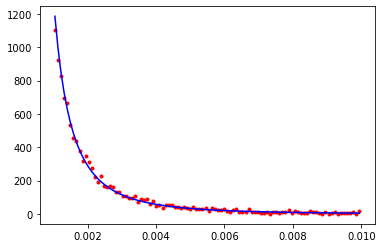

CPU times: user 78.8 ms, sys: 10.6 ms, total: 89.4 ms
Wall time: 30.1 ms
CPU times: user 35.2 ms, sys: 12 ms, total: 47.1 ms
Wall time: 16 ms
20032.354239625787


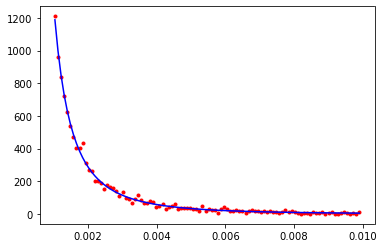

23704.474527562852


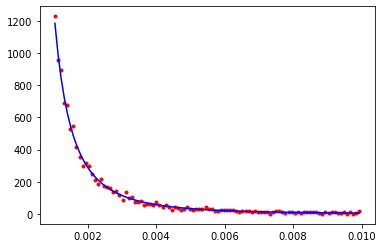

In [19]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [20]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

154.32380100898098
146.0453827951479
[1.37741905 0.9216832  1.41969041 1.22144782 1.40607989 0.88118839
 1.3112564  0.89688269 0.86089015 0.91430874 0.9749234  1.11737465
 0.88336709 1.24314652 0.93756698 1.30400627 0.91839321 0.86625112
 0.96339931 0.91928639]
1.085816652071524


In [21]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Beryliumrylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(20)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 29 ms, sys: 615 µs, total: 29.6 ms
Wall time: 29.1 ms
CPU times: user 20.5 ms, sys: 12.7 ms, total: 33.3 ms
Wall time: 23.8 ms
5330.881838678876


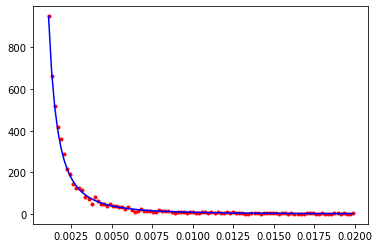

3809.430349078918


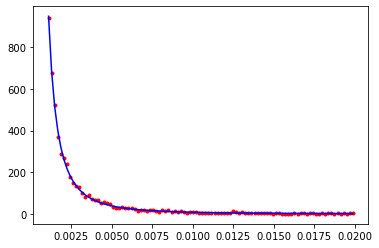

CPU times: user 74.5 ms, sys: 10.2 ms, total: 84.7 ms
Wall time: 28.5 ms
CPU times: user 34.5 ms, sys: 6.84 ms, total: 41.4 ms
Wall time: 13.9 ms
3705.5993373333854


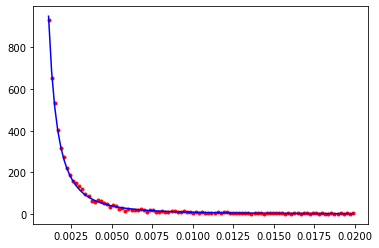

8049.421075785147


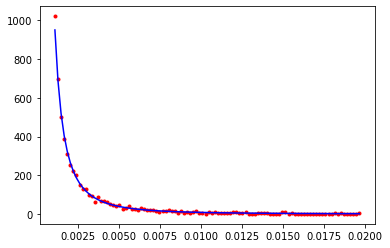

CPU times: user 75.7 ms, sys: 9.38 ms, total: 85.1 ms
Wall time: 28.4 ms
CPU times: user 34.8 ms, sys: 6.67 ms, total: 41.5 ms
Wall time: 13.8 ms
6534.792587092535


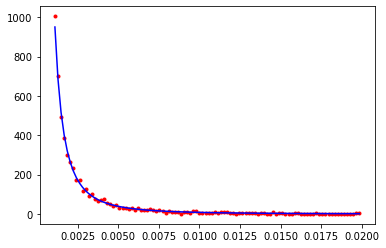

4040.211916427765


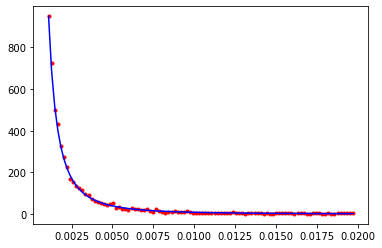

CPU times: user 73.4 ms, sys: 11.6 ms, total: 85 ms
Wall time: 29.3 ms
CPU times: user 36.6 ms, sys: 16.7 ms, total: 53.3 ms
Wall time: 18.3 ms
6073.678051070736


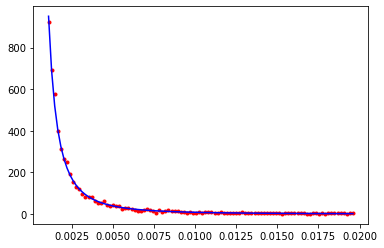

3053.130125369764


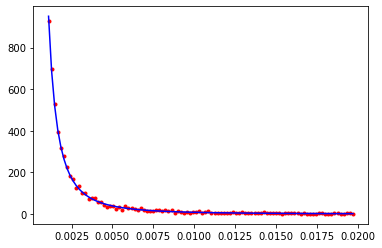

CPU times: user 74.3 ms, sys: 10.5 ms, total: 84.8 ms
Wall time: 28.7 ms
CPU times: user 36.1 ms, sys: 11.6 ms, total: 47.7 ms
Wall time: 16.1 ms
6746.690751930289


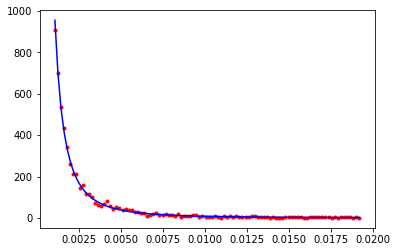

4299.280389212148


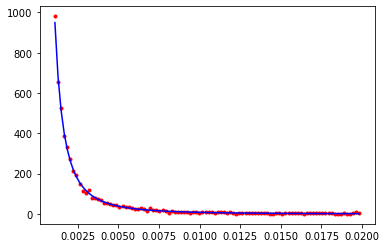

CPU times: user 73.1 ms, sys: 11.2 ms, total: 84.2 ms
Wall time: 28.7 ms
CPU times: user 35 ms, sys: 9.22 ms, total: 44.2 ms
Wall time: 14.9 ms
4181.177961439725


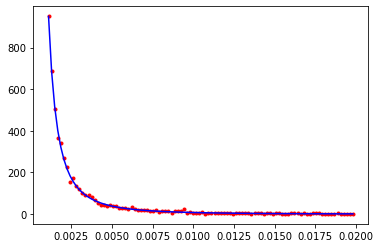

6572.52086294898


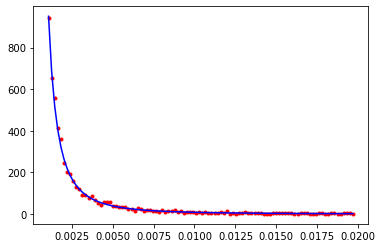

CPU times: user 74.2 ms, sys: 10.5 ms, total: 84.8 ms
Wall time: 28.7 ms
CPU times: user 38.2 ms, sys: 18.3 ms, total: 56.5 ms
Wall time: 18.4 ms
4147.413477729855


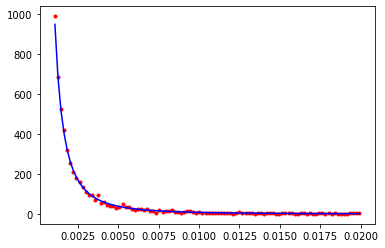

3360.382522453843


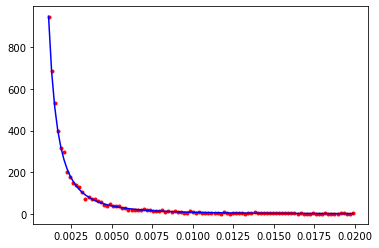

CPU times: user 85.6 ms, sys: 13.3 ms, total: 98.9 ms
Wall time: 33.8 ms
CPU times: user 16.9 ms, sys: 5.79 ms, total: 22.7 ms
Wall time: 15.9 ms
3468.73088059078


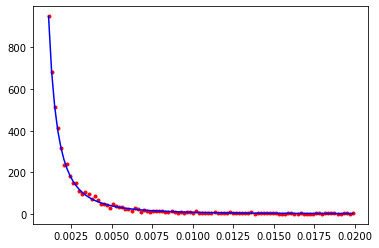

2264.544366001604


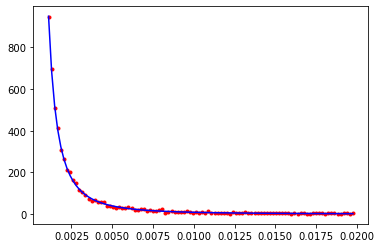

CPU times: user 74.6 ms, sys: 10.6 ms, total: 85.2 ms
Wall time: 28.8 ms
CPU times: user 42.4 ms, sys: 31.4 ms, total: 73.8 ms
Wall time: 24 ms
2512.26557084454


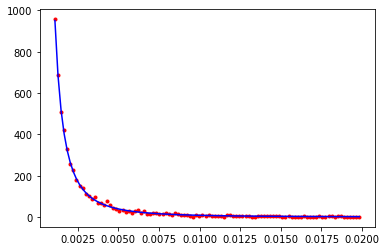

4348.553231115695


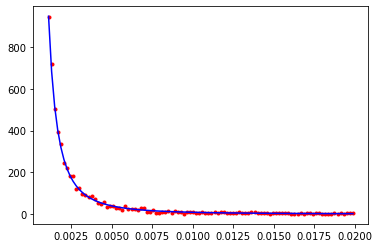

CPU times: user 75.2 ms, sys: 9.8 ms, total: 85 ms
Wall time: 28.5 ms
CPU times: user 35.4 ms, sys: 8.27 ms, total: 43.7 ms
Wall time: 14.6 ms
6183.474417996478


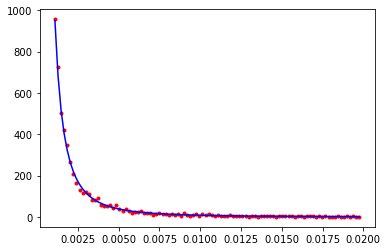

7816.105662493564


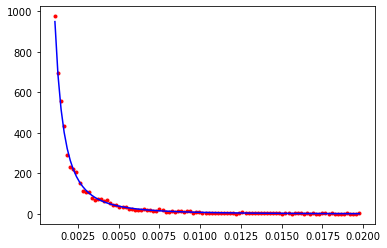

CPU times: user 73.9 ms, sys: 10.7 ms, total: 84.5 ms
Wall time: 28.6 ms
CPU times: user 35.1 ms, sys: 10.8 ms, total: 45.8 ms
Wall time: 15.4 ms
7862.445178643489


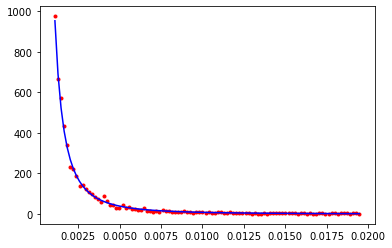

4968.642555534789


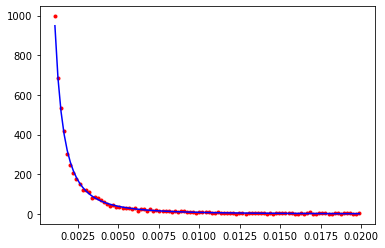

CPU times: user 74 ms, sys: 11 ms, total: 85 ms
Wall time: 28.9 ms
CPU times: user 35.5 ms, sys: 9.61 ms, total: 45.1 ms
Wall time: 15.2 ms
9335.849689908768


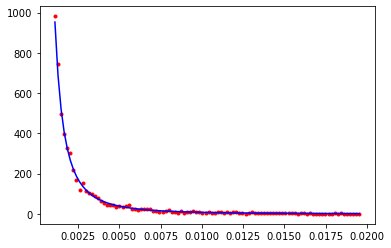

8763.142008667906


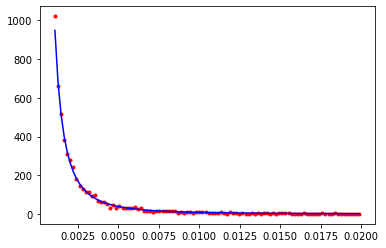

CPU times: user 76.3 ms, sys: 11.9 ms, total: 88.2 ms
Wall time: 30 ms
CPU times: user 17.4 ms, sys: 6.93 ms, total: 24.3 ms
Wall time: 17.8 ms
4194.559983335945


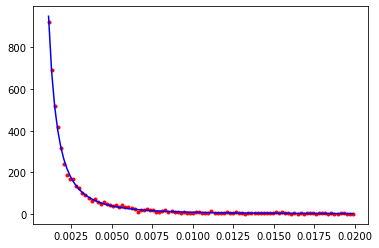

5265.754031214119


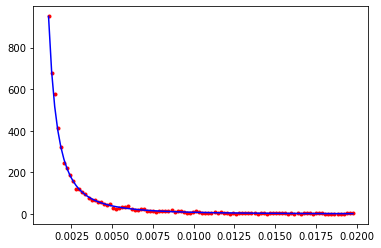

CPU times: user 71.1 ms, sys: 12.2 ms, total: 83.3 ms
Wall time: 28.6 ms
CPU times: user 35.7 ms, sys: 11.5 ms, total: 47.2 ms
Wall time: 15.9 ms
6483.624753456483


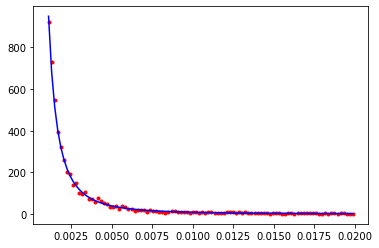

3820.7363042144752


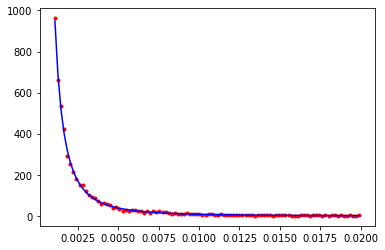

CPU times: user 33.6 ms, sys: 420 µs, total: 34 ms
Wall time: 34 ms
CPU times: user 15.8 ms, sys: 4.06 ms, total: 19.8 ms
Wall time: 17.1 ms
3129.614738452509


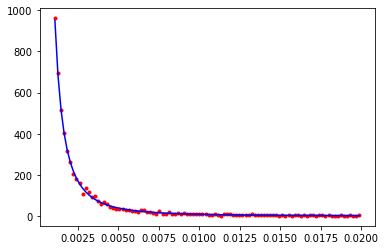

7770.40751905282


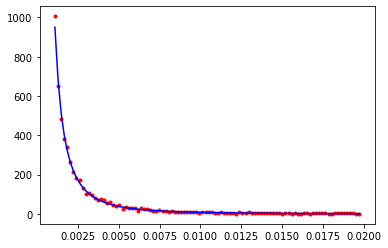

CPU times: user 71.9 ms, sys: 11.7 ms, total: 83.7 ms
Wall time: 28.6 ms
CPU times: user 35.3 ms, sys: 8.4 ms, total: 43.7 ms
Wall time: 14.6 ms
5845.083058715687


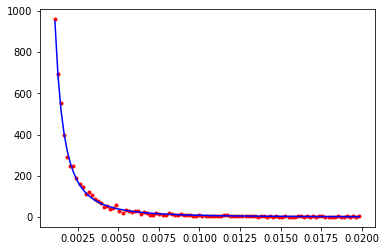

3549.7979181163114


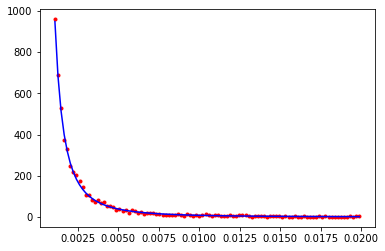

CPU times: user 73 ms, sys: 11.6 ms, total: 84.6 ms
Wall time: 28.9 ms
CPU times: user 34.8 ms, sys: 6.29 ms, total: 41.1 ms
Wall time: 13.8 ms
3909.2267403002547


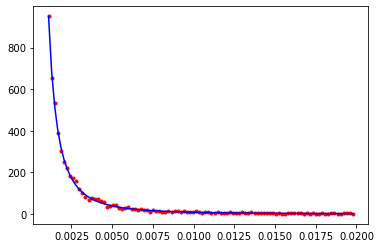

5932.726987248682


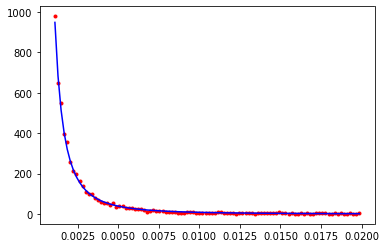

CPU times: user 71.9 ms, sys: 11.9 ms, total: 83.8 ms
Wall time: 28.7 ms
CPU times: user 40.1 ms, sys: 26.6 ms, total: 66.7 ms
Wall time: 21.4 ms
3204.2681880028576


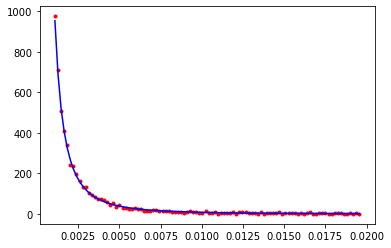

3514.6821553232826


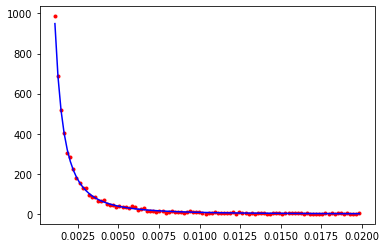

CPU times: user 73.7 ms, sys: 10.8 ms, total: 84.6 ms
Wall time: 28.6 ms
CPU times: user 35.2 ms, sys: 6.5 ms, total: 41.7 ms
Wall time: 13.9 ms
7016.116506995463


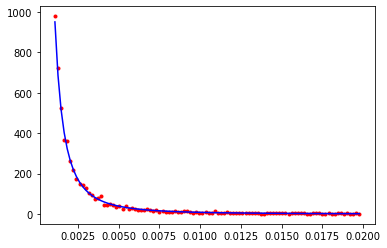

9798.431998292857


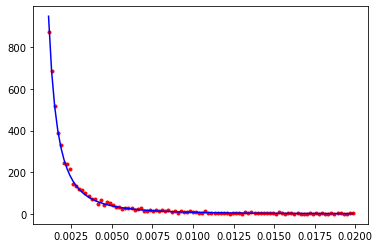

CPU times: user 74.6 ms, sys: 9.79 ms, total: 84.4 ms
Wall time: 28.3 ms
CPU times: user 35.7 ms, sys: 7.36 ms, total: 43 ms
Wall time: 14.4 ms
5672.235767381663


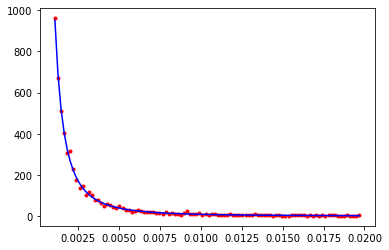

4993.422204725276


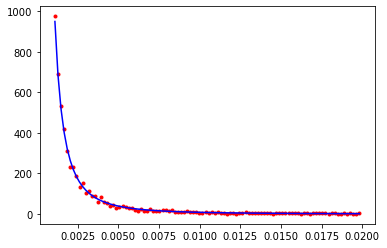

In [22]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [23]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

72.64218109332218
72.79811954414686
[1.1829585  0.6784954  1.27178539 1.41043549 1.25270127 0.79759668
 1.11094948 1.23764157 0.76008188 0.88944905 1.25794003 1.03215994
 0.89250965 1.30267297 0.6346343  1.28319757 0.81174243 0.95481977
 0.84619432 1.06580559]
1.0587726574806369


In [24]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(20)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 31 ms, sys: 541 µs, total: 31.5 ms
Wall time: 31 ms
CPU times: user 13.6 ms, sys: 1.46 ms, total: 15.1 ms
Wall time: 14.4 ms
29768.482651922266


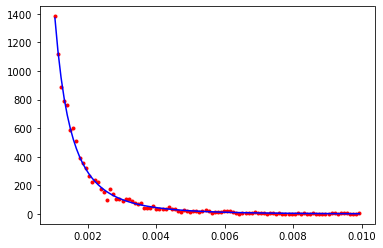

18942.76687605886


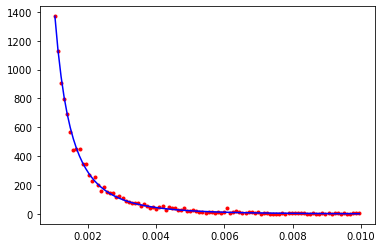

CPU times: user 83.6 ms, sys: 10.3 ms, total: 93.9 ms
Wall time: 31.4 ms
CPU times: user 43.7 ms, sys: 43 ms, total: 86.7 ms
Wall time: 27.6 ms
21834.064177152402


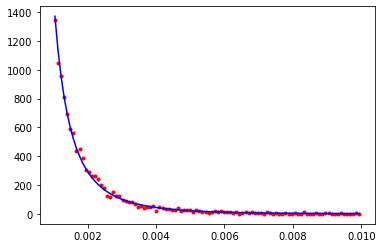

29059.18607822507


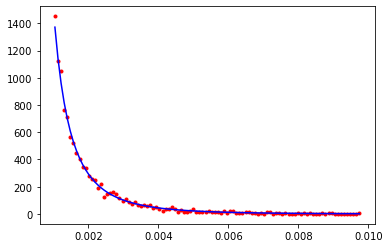

CPU times: user 83.2 ms, sys: 10.4 ms, total: 93.6 ms
Wall time: 31.3 ms
CPU times: user 41.7 ms, sys: 31.6 ms, total: 73.3 ms
Wall time: 23.2 ms
29093.713882094824


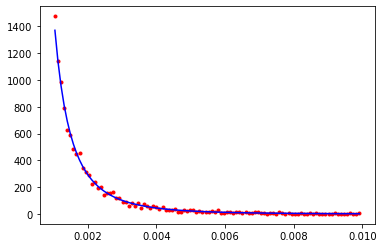

27949.533747491332


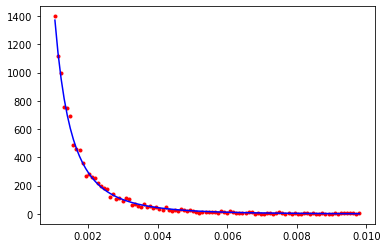

CPU times: user 81.7 ms, sys: 11.3 ms, total: 93 ms
Wall time: 31.3 ms
CPU times: user 34.3 ms, sys: 6.92 ms, total: 41.2 ms
Wall time: 13.7 ms
25406.569759544116


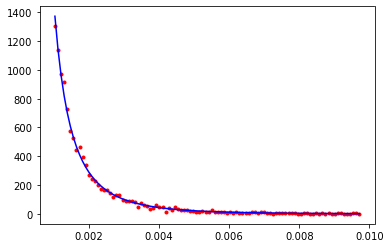

12581.235405347812


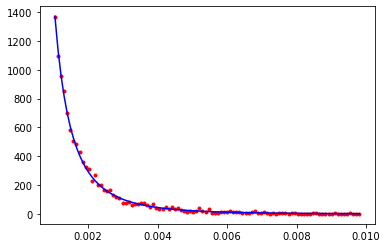

CPU times: user 83.3 ms, sys: 10.3 ms, total: 93.6 ms
Wall time: 31.3 ms
CPU times: user 34.1 ms, sys: 5.79 ms, total: 39.9 ms
Wall time: 13.3 ms
54835.92978093142


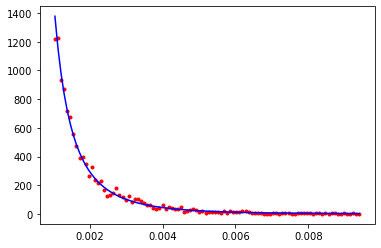

18641.04885358723


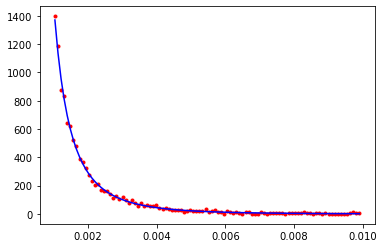

CPU times: user 82.2 ms, sys: 10.6 ms, total: 92.7 ms
Wall time: 31.1 ms
CPU times: user 34.2 ms, sys: 5.89 ms, total: 40.1 ms
Wall time: 13.4 ms
16322.818056003962


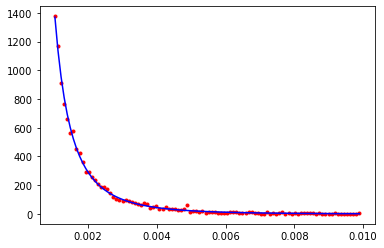

35761.85521772086


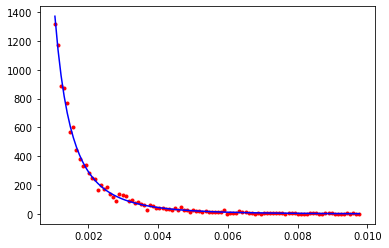

CPU times: user 83.4 ms, sys: 10.3 ms, total: 93.7 ms
Wall time: 31.3 ms
CPU times: user 35.1 ms, sys: 9.57 ms, total: 44.7 ms
Wall time: 14.9 ms
28738.81734331543


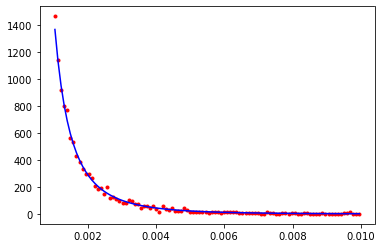

19047.63583076765


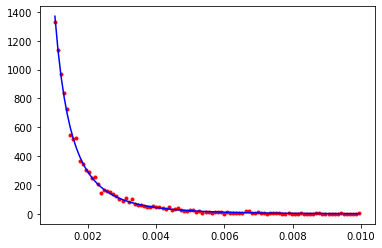

CPU times: user 82.9 ms, sys: 10.4 ms, total: 93.3 ms
Wall time: 31.2 ms
CPU times: user 41.7 ms, sys: 31.9 ms, total: 73.6 ms
Wall time: 23.3 ms
22987.587580519128


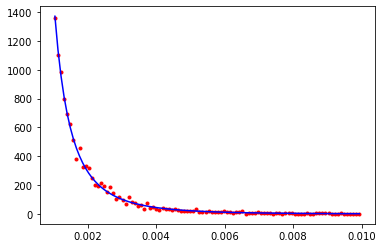

21100.902407674792


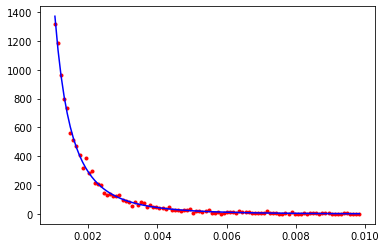

CPU times: user 82.4 ms, sys: 10.7 ms, total: 93.1 ms
Wall time: 31.2 ms
CPU times: user 35.3 ms, sys: 9.16 ms, total: 44.5 ms
Wall time: 14.8 ms
16180.778465308222


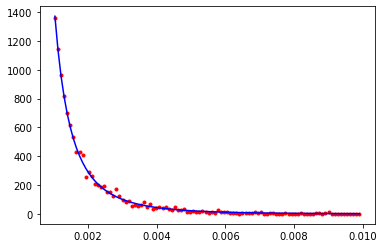

18244.668701735052


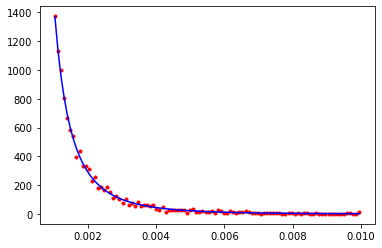

CPU times: user 82.2 ms, sys: 11.1 ms, total: 93.4 ms
Wall time: 31.6 ms
CPU times: user 35.3 ms, sys: 8.72 ms, total: 44 ms
Wall time: 14.7 ms
26994.341732610843


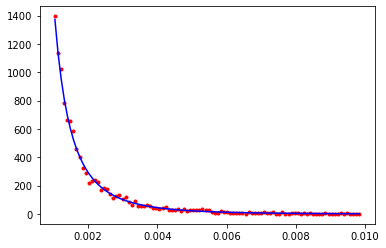

27067.2903726888


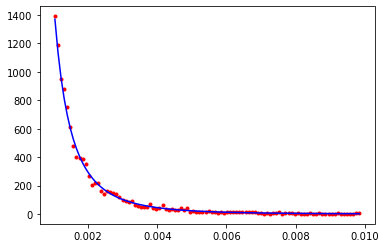

CPU times: user 82 ms, sys: 10.9 ms, total: 92.9 ms
Wall time: 31.1 ms
CPU times: user 34 ms, sys: 7.01 ms, total: 41 ms
Wall time: 13.8 ms
33262.48948756757


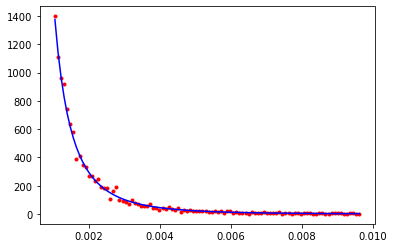

14945.077158618536


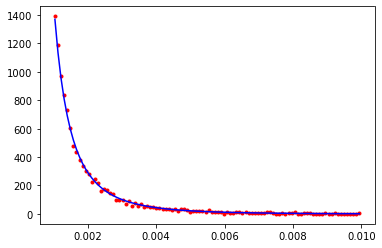

CPU times: user 81.4 ms, sys: 11.9 ms, total: 93.2 ms
Wall time: 31.6 ms
CPU times: user 33.7 ms, sys: 7.35 ms, total: 41 ms
Wall time: 14.1 ms
31190.032392319743


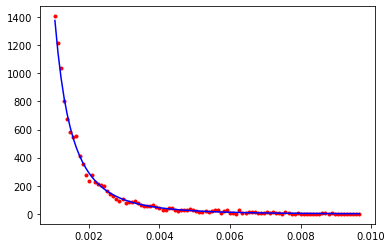

32076.722203812547


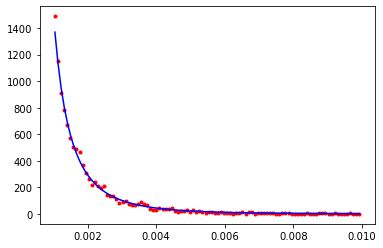

CPU times: user 80.6 ms, sys: 12.7 ms, total: 93.3 ms
Wall time: 31.8 ms
CPU times: user 33.3 ms, sys: 6.84 ms, total: 40.1 ms
Wall time: 13.7 ms
22028.015048612746


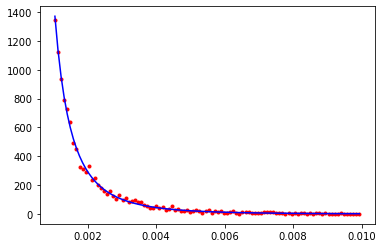

27298.016616461486


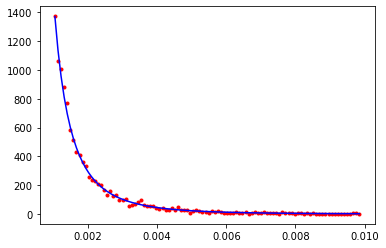

CPU times: user 82.2 ms, sys: 11 ms, total: 93.2 ms
Wall time: 31.4 ms
CPU times: user 34.2 ms, sys: 6.33 ms, total: 40.5 ms
Wall time: 13.6 ms
20588.35804928998


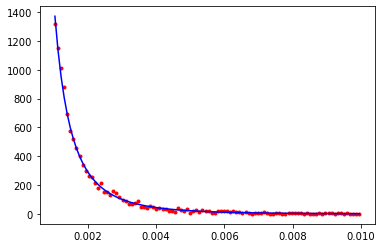

15333.639973815705


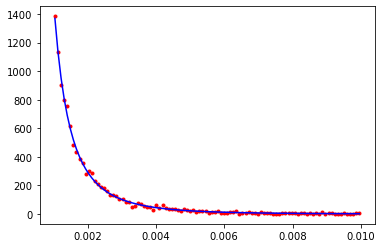

CPU times: user 81.4 ms, sys: 11.5 ms, total: 92.9 ms
Wall time: 31.5 ms
CPU times: user 35.1 ms, sys: 9.68 ms, total: 44.7 ms
Wall time: 15 ms
14728.026872568313


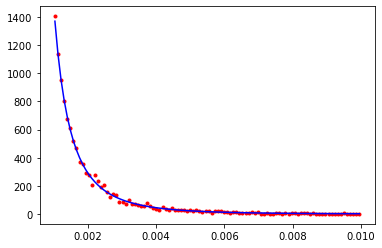

21849.958510791927


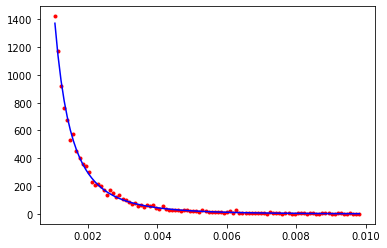

CPU times: user 80.8 ms, sys: 11.8 ms, total: 92.6 ms
Wall time: 31.4 ms
CPU times: user 43.3 ms, sys: 42.8 ms, total: 86 ms
Wall time: 27.8 ms
21446.293244880344


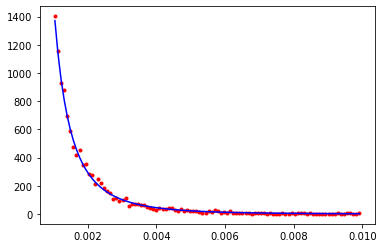

15219.941419949118


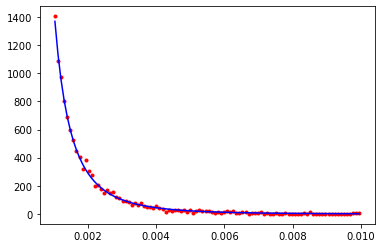

CPU times: user 81.3 ms, sys: 11.4 ms, total: 92.7 ms
Wall time: 31.3 ms
CPU times: user 34 ms, sys: 5.71 ms, total: 39.7 ms
Wall time: 13.4 ms
18003.95375323024


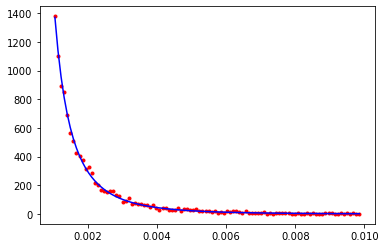

26677.497982442226


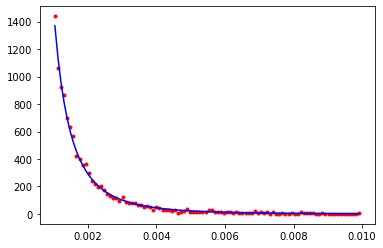

CPU times: user 81.5 ms, sys: 11.1 ms, total: 92.6 ms
Wall time: 31.2 ms
CPU times: user 35.3 ms, sys: 8.91 ms, total: 44.2 ms
Wall time: 14.7 ms
10443.475150483679


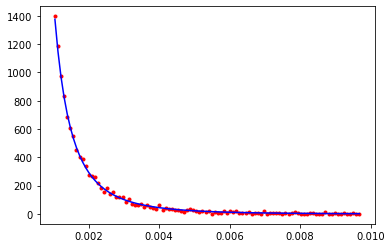

22051.666778752835


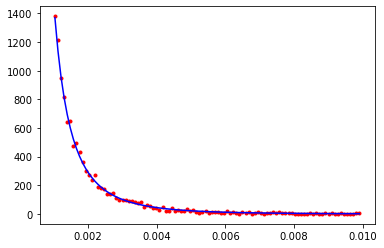

CPU times: user 91.1 ms, sys: 12.9 ms, total: 104 ms
Wall time: 35.1 ms
CPU times: user 40.6 ms, sys: 38.8 ms, total: 79.4 ms
Wall time: 27 ms
21713.656698883304


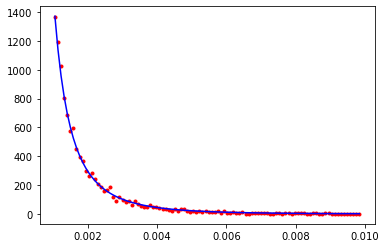

33697.07925694817


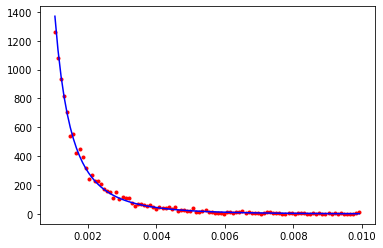

CPU times: user 82.8 ms, sys: 10.4 ms, total: 93.2 ms
Wall time: 31.2 ms
CPU times: user 34.2 ms, sys: 6.51 ms, total: 40.7 ms
Wall time: 13.6 ms
20943.98841280694


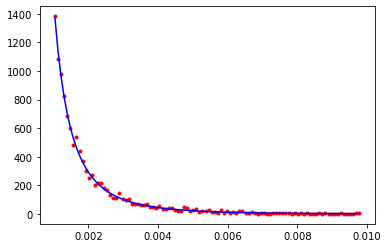

21571.49410833963


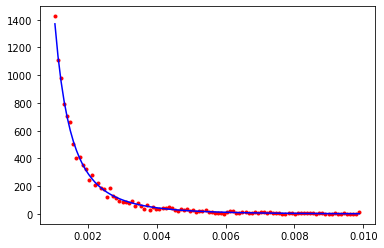

In [25]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [26]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

155.96656573446205
151.51191661074543
[1.25359324 0.8668133  1.02026338 1.42105659 1.71513154 0.67559675
 1.22832674 1.04374927 0.94174151 0.99865155 1.49186077 0.98608175
 0.89830152 1.15874594 0.82100722 1.18705169 0.82150724 0.68817962
 0.80273159 0.98534787]
1.0830104030746417


## 5000 samples, 10 iterations

In [27]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(10)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 15.5 ms, sys: 615 µs, total: 16.1 ms
Wall time: 15.5 ms
CPU times: user 14.3 ms, sys: 3.13 ms, total: 17.5 ms
Wall time: 15.4 ms
30975.52986393182


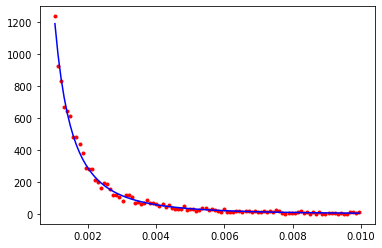

16326.253888455087


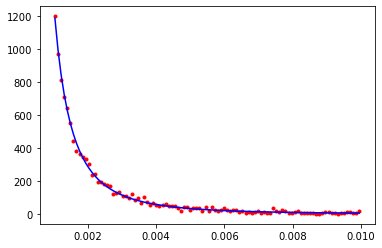

CPU times: user 40.9 ms, sys: 6.07 ms, total: 46.9 ms
Wall time: 15.9 ms
CPU times: user 36.5 ms, sys: 13 ms, total: 49.5 ms
Wall time: 16.4 ms
19761.521779061037


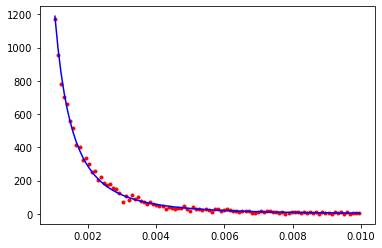

23262.532401250377


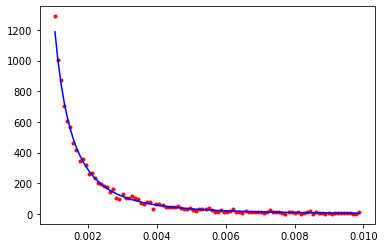

CPU times: user 41.6 ms, sys: 5.51 ms, total: 47.2 ms
Wall time: 15.8 ms
CPU times: user 43.3 ms, sys: 38.4 ms, total: 81.6 ms
Wall time: 25.5 ms
31838.602039256843


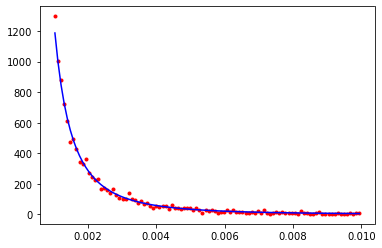

15796.700082084046


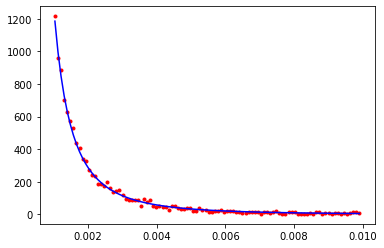

CPU times: user 40.5 ms, sys: 6.15 ms, total: 46.7 ms
Wall time: 15.8 ms
CPU times: user 42 ms, sys: 33.2 ms, total: 75.3 ms
Wall time: 23.9 ms
23946.488953264736


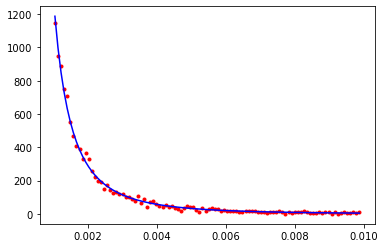

16050.625972424821


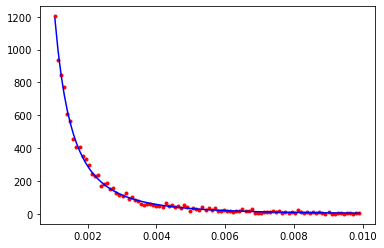

CPU times: user 40.9 ms, sys: 6.32 ms, total: 47.3 ms
Wall time: 16.2 ms
CPU times: user 34.9 ms, sys: 9.06 ms, total: 43.9 ms
Wall time: 14.7 ms
41962.563670355674


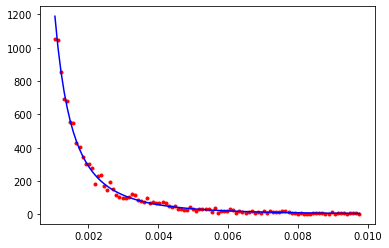

21224.72300801168


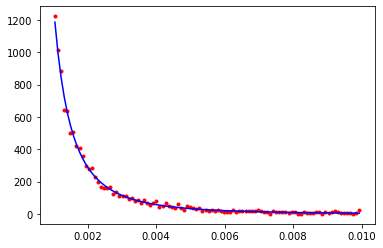

CPU times: user 40.3 ms, sys: 6.5 ms, total: 46.8 ms
Wall time: 16 ms
CPU times: user 34.6 ms, sys: 8.79 ms, total: 43.4 ms
Wall time: 14.7 ms
18895.30872787171


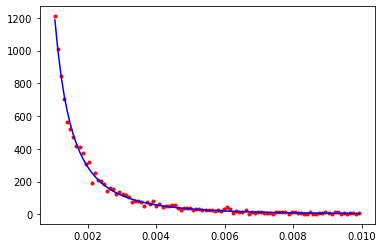

24334.16320841606


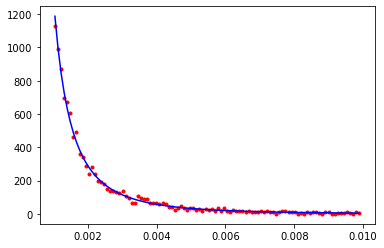

CPU times: user 40.7 ms, sys: 6.09 ms, total: 46.8 ms
Wall time: 15.9 ms
CPU times: user 34.7 ms, sys: 9.14 ms, total: 43.9 ms
Wall time: 14.9 ms
29814.388064335813


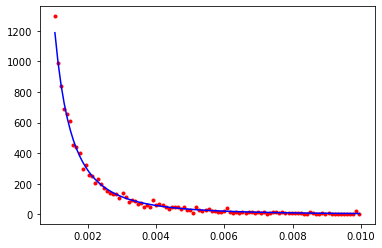

17340.067152407246


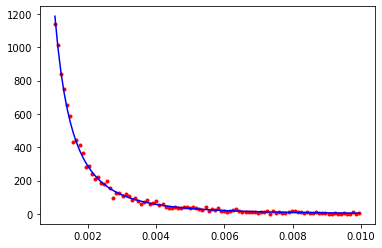

CPU times: user 41.4 ms, sys: 5.6 ms, total: 47 ms
Wall time: 15.7 ms
CPU times: user 36.6 ms, sys: 9.65 ms, total: 46.3 ms
Wall time: 15.3 ms
18336.068613893753


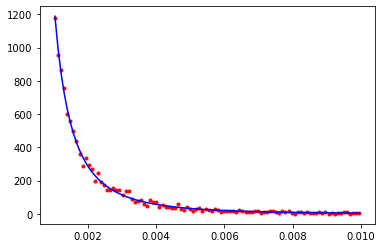

22794.749343411833


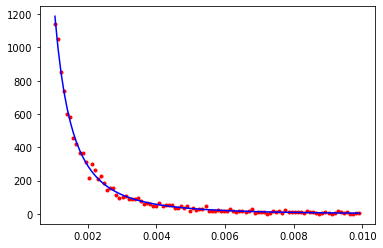

CPU times: user 39.3 ms, sys: 7.13 ms, total: 46.5 ms
Wall time: 16.1 ms
CPU times: user 36.6 ms, sys: 15.3 ms, total: 51.8 ms
Wall time: 17.5 ms
12001.392320137553


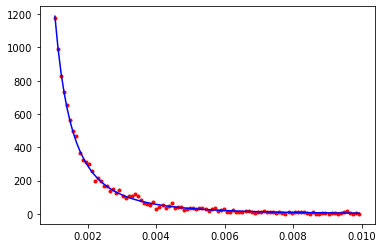

16193.329812112608


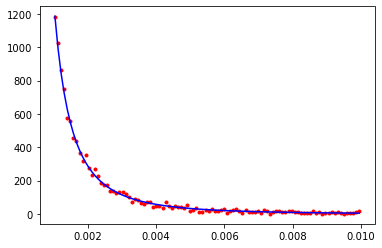

CPU times: user 41.2 ms, sys: 5.42 ms, total: 46.7 ms
Wall time: 15.7 ms
CPU times: user 35.4 ms, sys: 9.1 ms, total: 44.5 ms
Wall time: 14.7 ms
23265.75569113948


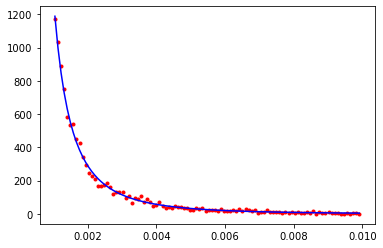

27831.15282156286


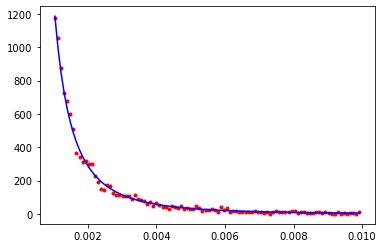

CPU times: user 40.5 ms, sys: 6.51 ms, total: 47 ms
Wall time: 16 ms
CPU times: user 34.4 ms, sys: 7.29 ms, total: 41.7 ms
Wall time: 14.1 ms
25428.94203568725


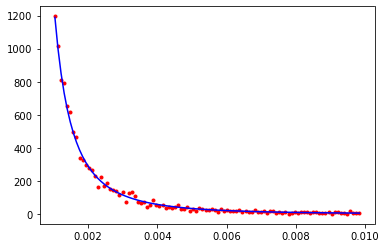

26753.905550980526


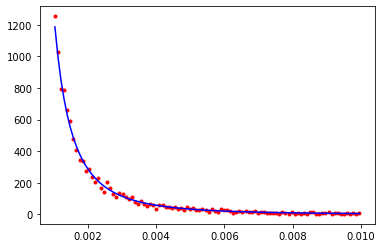

CPU times: user 40.5 ms, sys: 5.46 ms, total: 45.9 ms
Wall time: 15.9 ms
CPU times: user 34.2 ms, sys: 6.99 ms, total: 41.2 ms
Wall time: 13.8 ms
29765.84047266045


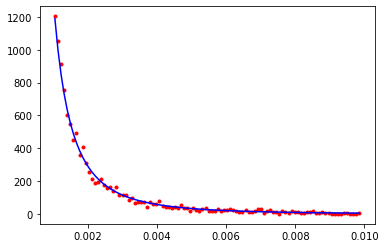

23840.76089012738


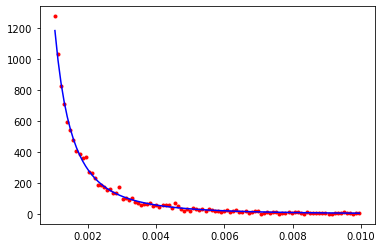

CPU times: user 40.1 ms, sys: 6.39 ms, total: 46.5 ms
Wall time: 15.9 ms
CPU times: user 36.2 ms, sys: 11.8 ms, total: 48 ms
Wall time: 15.8 ms
20702.273517298025


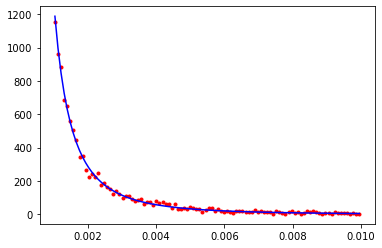

26529.892425471597


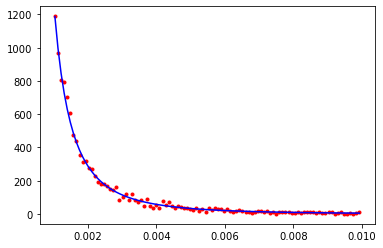

CPU times: user 40.3 ms, sys: 6.29 ms, total: 46.5 ms
Wall time: 15.9 ms
CPU times: user 33.3 ms, sys: 6.01 ms, total: 39.3 ms
Wall time: 13.4 ms
26214.236414579067


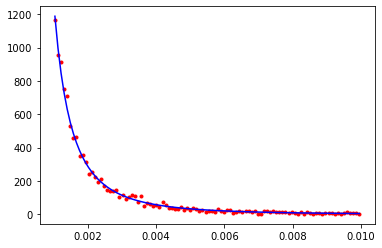

16962.603278815342


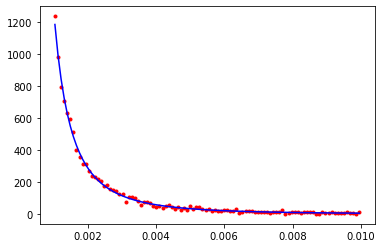

CPU times: user 40.8 ms, sys: 6.5 ms, total: 47.3 ms
Wall time: 16.1 ms
CPU times: user 34 ms, sys: 7.22 ms, total: 41.2 ms
Wall time: 14.2 ms
24860.59494934297


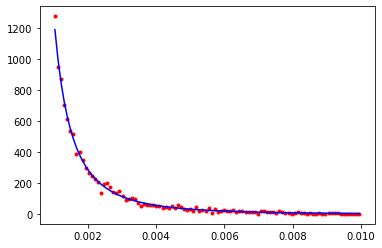

28281.79769832608


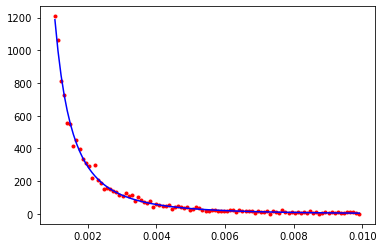

CPU times: user 41.2 ms, sys: 6.2 ms, total: 47.4 ms
Wall time: 16 ms
CPU times: user 34.9 ms, sys: 9.59 ms, total: 44.5 ms
Wall time: 15.1 ms
21800.0599572707


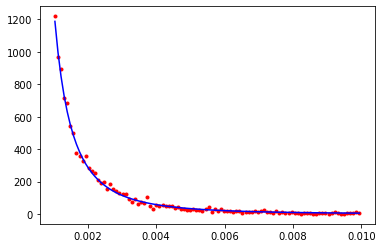

12820.303690006225


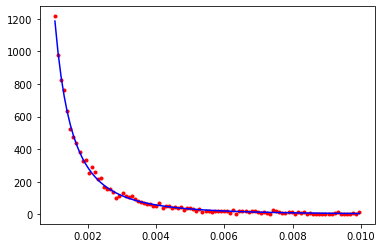

CPU times: user 41 ms, sys: 6.05 ms, total: 47 ms
Wall time: 15.8 ms
CPU times: user 35 ms, sys: 7.73 ms, total: 42.7 ms
Wall time: 14.4 ms
19533.387846279118


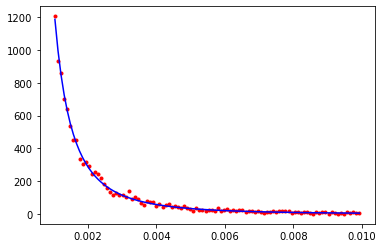

23148.44252267499


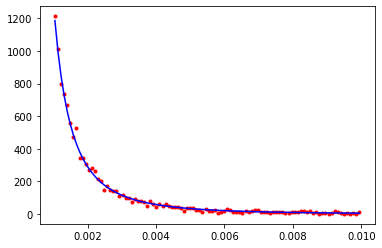

CPU times: user 40.4 ms, sys: 6.53 ms, total: 47 ms
Wall time: 16 ms
CPU times: user 34.6 ms, sys: 6.07 ms, total: 40.7 ms
Wall time: 13.7 ms
13043.850819205225


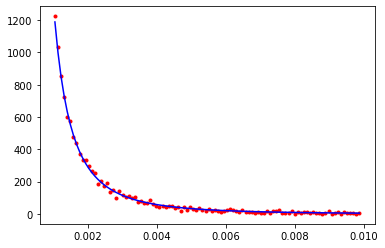

17329.163941793


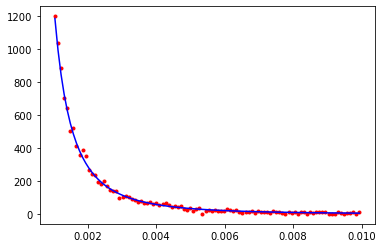

CPU times: user 40.8 ms, sys: 6.37 ms, total: 47.2 ms
Wall time: 16 ms
CPU times: user 40.8 ms, sys: 26.6 ms, total: 67.4 ms
Wall time: 21.6 ms
24186.728111507997


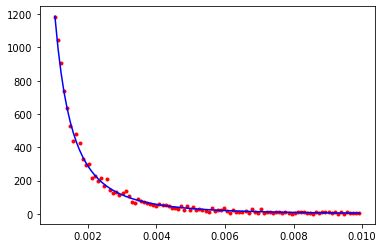

26059.43449973095


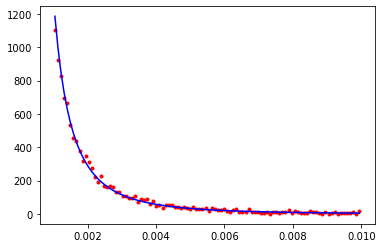

CPU times: user 40.5 ms, sys: 6.46 ms, total: 46.9 ms
Wall time: 16 ms
CPU times: user 34.9 ms, sys: 9.25 ms, total: 44.1 ms
Wall time: 14.8 ms
20032.35298422398


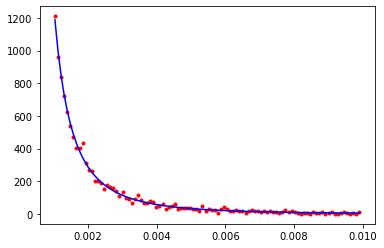

23704.474527562852


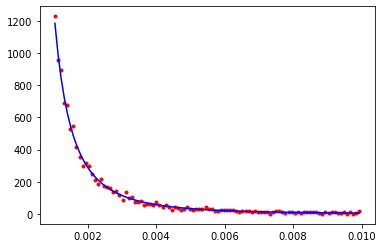

In [28]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [29]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

154.3317671173539
146.0453827951479
[1.37741909 0.92168325 1.41969093 1.22144787 1.40607987 0.88118843
 1.31125622 0.89688281 0.86089014 0.91430898 0.97492353 1.11737518
 0.88336721 1.24314662 0.93756687 1.30400629 0.91860308 0.86758914
 0.96339873 0.91928636]
1.0858790015951922


In [30]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(10)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 17.2 ms, sys: 780 µs, total: 18 ms
Wall time: 17.4 ms
CPU times: user 17.2 ms, sys: 6.88 ms, total: 24.1 ms
Wall time: 19.2 ms
5330.881825930372


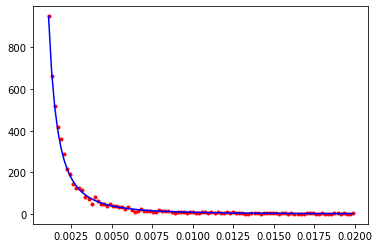

3809.430349078918


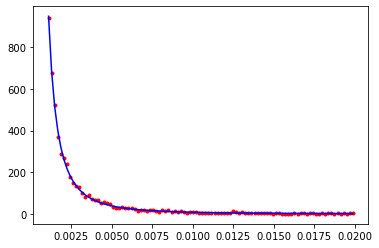

CPU times: user 39 ms, sys: 5.46 ms, total: 44.4 ms
Wall time: 15 ms
CPU times: user 34.8 ms, sys: 7.49 ms, total: 42.3 ms
Wall time: 14.1 ms
3705.5926056578865


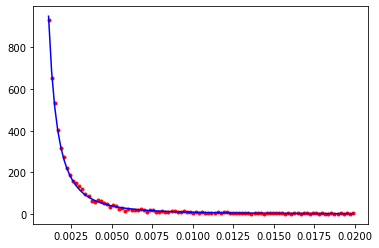

8049.421075785147


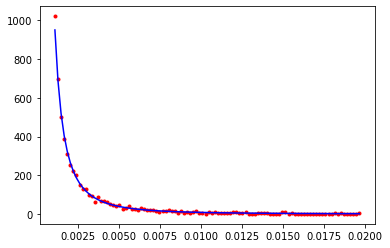

CPU times: user 37.8 ms, sys: 6.07 ms, total: 43.8 ms
Wall time: 15 ms
CPU times: user 35.3 ms, sys: 8.43 ms, total: 43.7 ms
Wall time: 14.5 ms
6534.797787727478


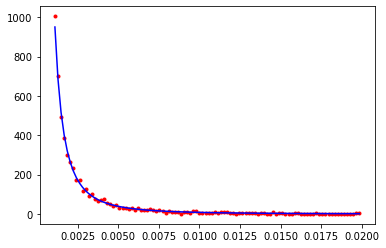

4040.211916427765


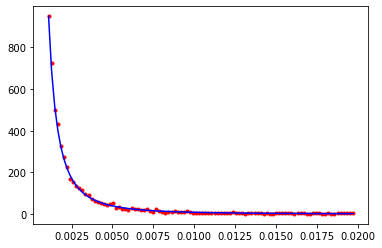

CPU times: user 39 ms, sys: 5.35 ms, total: 44.3 ms
Wall time: 14.9 ms
CPU times: user 34.6 ms, sys: 8.59 ms, total: 43.2 ms
Wall time: 14.6 ms
6073.676462283608


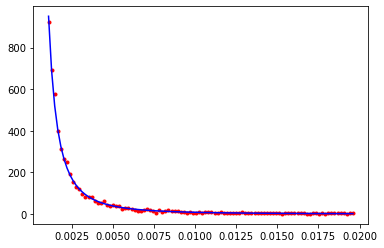

3053.130125369764


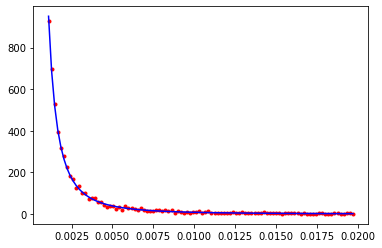

CPU times: user 39.1 ms, sys: 5.32 ms, total: 44.4 ms
Wall time: 14.9 ms
CPU times: user 35.2 ms, sys: 9.9 ms, total: 45.1 ms
Wall time: 15.1 ms
6746.689232136242


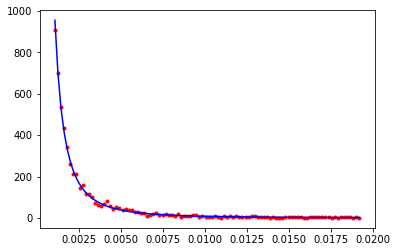

4299.280389212148


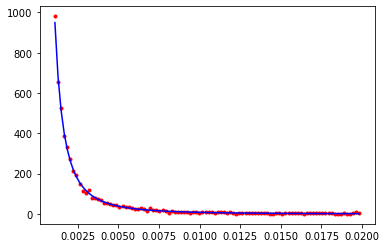

CPU times: user 39 ms, sys: 5.67 ms, total: 44.7 ms
Wall time: 15.1 ms
CPU times: user 36.7 ms, sys: 12.2 ms, total: 48.9 ms
Wall time: 16.1 ms
4181.179377016633


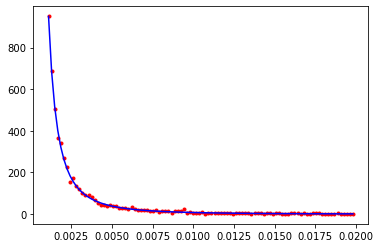

6572.52086294898


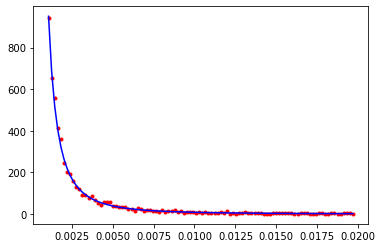

CPU times: user 38.7 ms, sys: 5.63 ms, total: 44.4 ms
Wall time: 15 ms
CPU times: user 35 ms, sys: 9.22 ms, total: 44.2 ms
Wall time: 14.8 ms
4147.407591993057


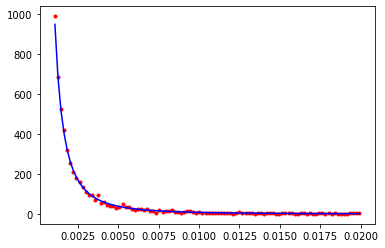

3360.382522453843


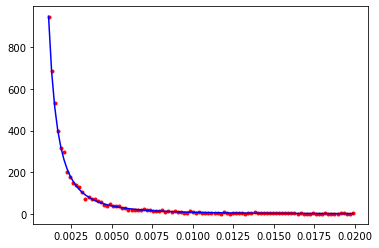

CPU times: user 39.2 ms, sys: 5.26 ms, total: 44.5 ms
Wall time: 14.9 ms
CPU times: user 35 ms, sys: 9.11 ms, total: 44.1 ms
Wall time: 14.8 ms
3468.7310815499404


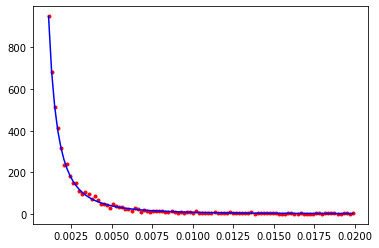

2264.544366001604


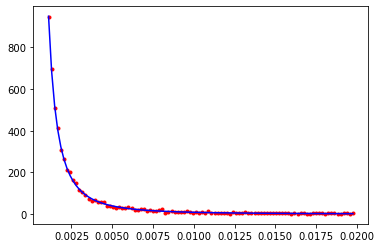

CPU times: user 37.9 ms, sys: 6.13 ms, total: 44.1 ms
Wall time: 15 ms
CPU times: user 37.9 ms, sys: 20 ms, total: 57.9 ms
Wall time: 18.8 ms
2512.270208150595


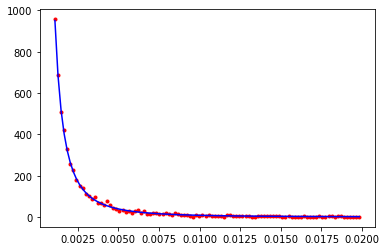

4348.553231115695


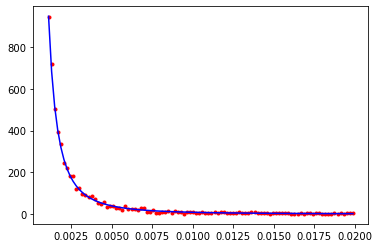

CPU times: user 38.7 ms, sys: 6.13 ms, total: 44.8 ms
Wall time: 15.3 ms
CPU times: user 35.2 ms, sys: 7.4 ms, total: 42.5 ms
Wall time: 14.2 ms
6183.46907170317


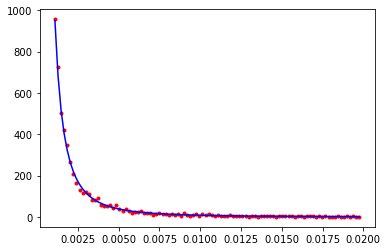

7816.105662493564


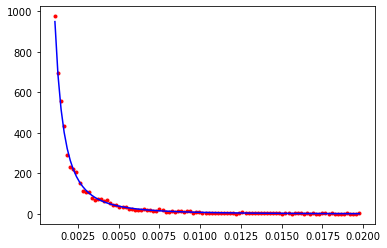

CPU times: user 38.2 ms, sys: 6.34 ms, total: 44.5 ms
Wall time: 15.2 ms
CPU times: user 34.6 ms, sys: 6.44 ms, total: 41 ms
Wall time: 13.8 ms
7862.440331591628


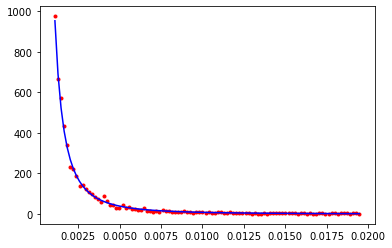

4968.642555534789


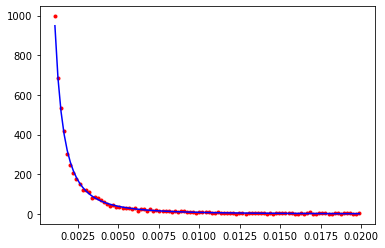

CPU times: user 39.1 ms, sys: 5.4 ms, total: 44.5 ms
Wall time: 15 ms
CPU times: user 41.3 ms, sys: 29.7 ms, total: 71 ms
Wall time: 22.7 ms
9335.856222459495


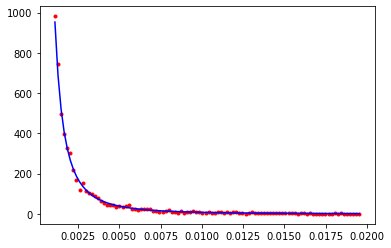

8763.142008667906


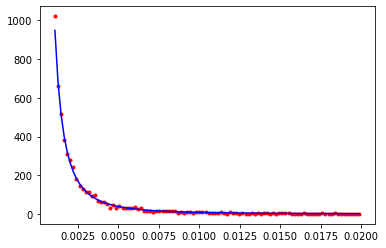

CPU times: user 37.8 ms, sys: 6.54 ms, total: 44.3 ms
Wall time: 15.2 ms
CPU times: user 43.9 ms, sys: 37.5 ms, total: 81.4 ms
Wall time: 25.7 ms
4194.550907039725


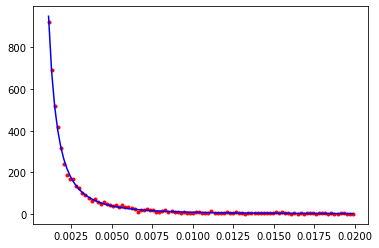

5265.754031214119


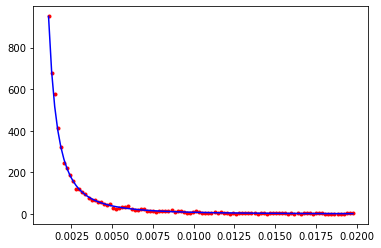

CPU times: user 39.8 ms, sys: 6.25 ms, total: 46.1 ms
Wall time: 15.6 ms
CPU times: user 34.3 ms, sys: 7.01 ms, total: 41.3 ms
Wall time: 13.9 ms
6483.623729252958


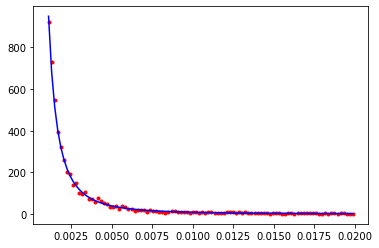

3820.7363042144752


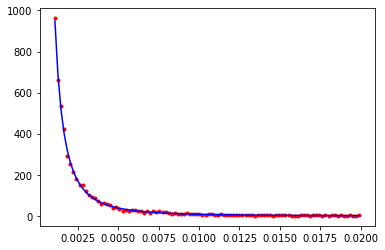

CPU times: user 38.8 ms, sys: 5.3 ms, total: 44.1 ms
Wall time: 14.8 ms
CPU times: user 34.3 ms, sys: 6.92 ms, total: 41.2 ms
Wall time: 13.9 ms
3129.6133139990043


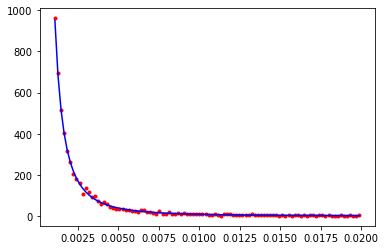

7770.40751905282


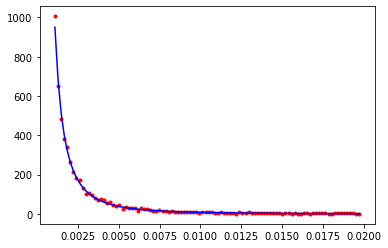

CPU times: user 39 ms, sys: 5.39 ms, total: 44.4 ms
Wall time: 14.9 ms
CPU times: user 34.5 ms, sys: 7.26 ms, total: 41.8 ms
Wall time: 14.1 ms
5845.082175948306


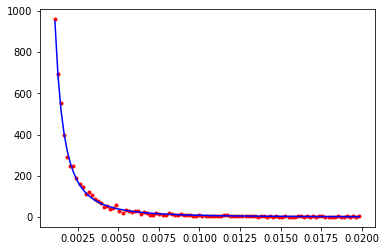

3549.7979181163114


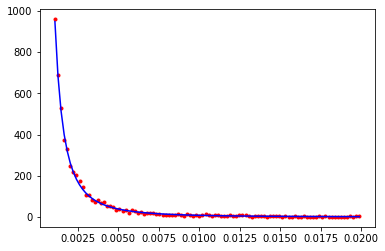

CPU times: user 39.1 ms, sys: 5.41 ms, total: 44.5 ms
Wall time: 15 ms
CPU times: user 34.5 ms, sys: 6.27 ms, total: 40.8 ms
Wall time: 13.7 ms
3909.221303266697


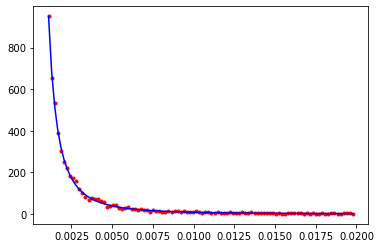

5932.726987248682


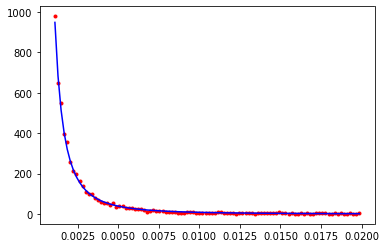

CPU times: user 38.3 ms, sys: 6.12 ms, total: 44.4 ms
Wall time: 15.1 ms
CPU times: user 35.8 ms, sys: 7.82 ms, total: 43.7 ms
Wall time: 14.6 ms
3204.2700041520657


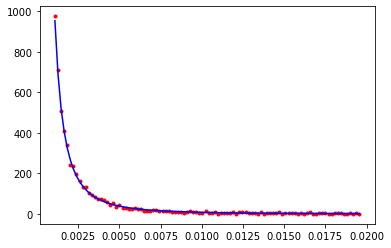

3514.6821553232826


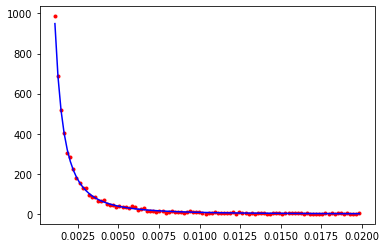

CPU times: user 38.5 ms, sys: 5.92 ms, total: 44.4 ms
Wall time: 15 ms
CPU times: user 34.2 ms, sys: 8.21 ms, total: 42.4 ms
Wall time: 14.3 ms
7016.124473286608


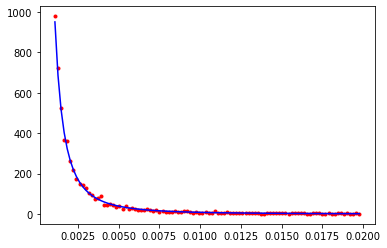

9798.431998292857


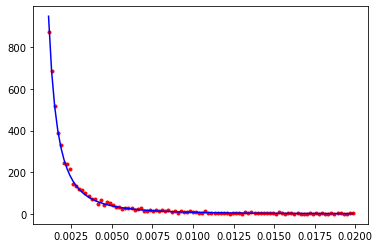

CPU times: user 39 ms, sys: 5.23 ms, total: 44.2 ms
Wall time: 14.8 ms
CPU times: user 44.9 ms, sys: 44.8 ms, total: 89.7 ms
Wall time: 28.1 ms
5672.235780878364


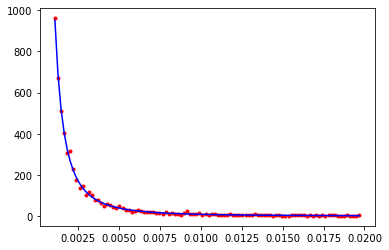

4993.422204725276


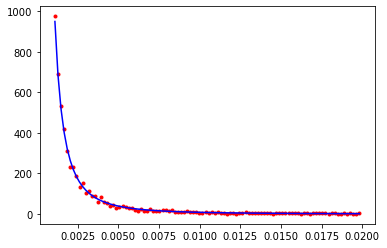

In [31]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [32]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

72.6421755889868
72.79811954414686
[1.1829585  0.67849478 1.2717859  1.4104353  1.25270113 0.79759682
 1.11094869 1.2376416  0.76008258 0.88944866 1.25793964 1.0321603
 0.89250868 1.30267287 0.63463416 1.28319747 0.81174187 0.95482004
 0.8461948  1.06580559]
1.0587725694288548


In [33]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(10)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 18.6 ms, sys: 717 µs, total: 19.3 ms
Wall time: 18.7 ms
CPU times: user 14.3 ms, sys: 2.28 ms, total: 16.5 ms
Wall time: 15.1 ms
29768.480672518148


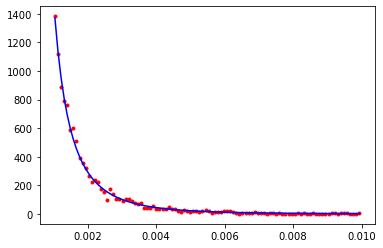

18942.76687605886


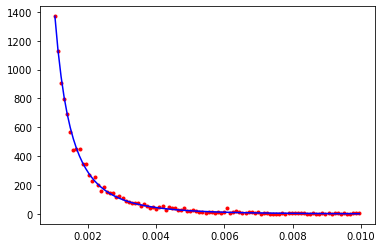

CPU times: user 43.7 ms, sys: 6.1 ms, total: 49.8 ms
Wall time: 16.8 ms
CPU times: user 46.6 ms, sys: 46 ms, total: 92.6 ms
Wall time: 28.9 ms
21834.07296374382


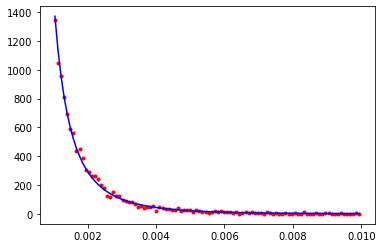

29059.18607822507


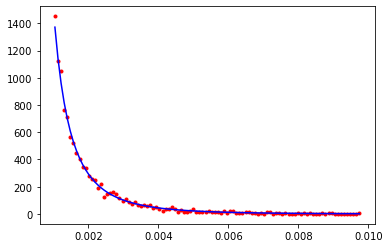

CPU times: user 42.5 ms, sys: 7.02 ms, total: 49.5 ms
Wall time: 16.9 ms
CPU times: user 34.7 ms, sys: 10.3 ms, total: 45 ms
Wall time: 15.2 ms
29093.73925329267


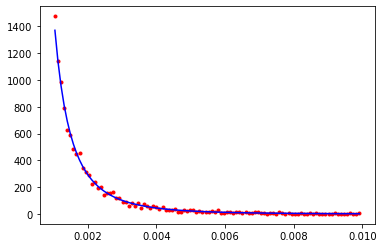

27949.533747491332


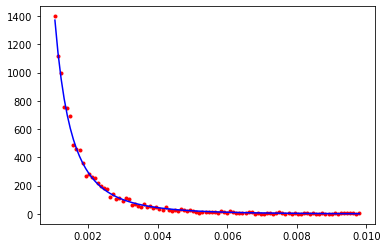

CPU times: user 41.9 ms, sys: 7.14 ms, total: 49.1 ms
Wall time: 16.9 ms
CPU times: user 36 ms, sys: 14 ms, total: 50 ms
Wall time: 16.8 ms
25406.569729432184


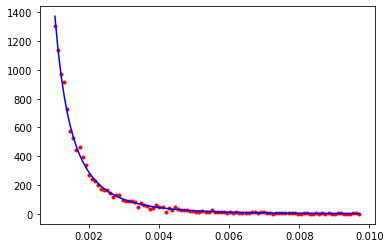

12581.235405347812


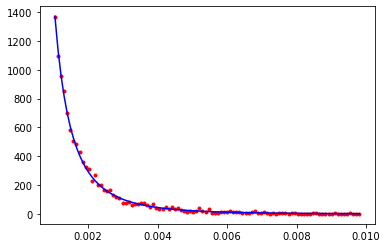

CPU times: user 42.5 ms, sys: 6.05 ms, total: 48.5 ms
Wall time: 16.4 ms
CPU times: user 33.8 ms, sys: 7.93 ms, total: 41.7 ms
Wall time: 14.2 ms
54835.990176865394


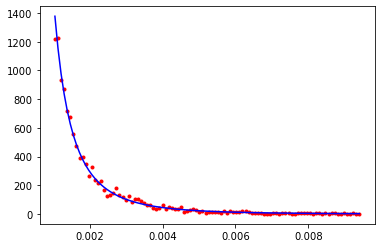

18641.04885358723


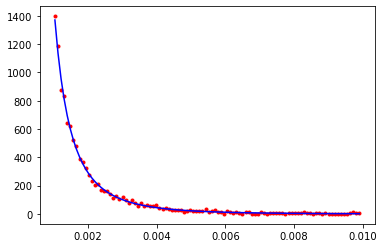

CPU times: user 41.9 ms, sys: 6.7 ms, total: 48.6 ms
Wall time: 16.5 ms
CPU times: user 36 ms, sys: 11.9 ms, total: 47.9 ms
Wall time: 15.8 ms
16322.813209358805


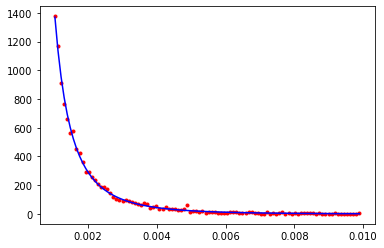

35761.85521772086


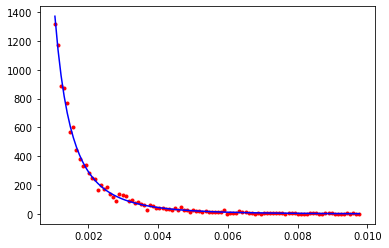

CPU times: user 41.8 ms, sys: 6.63 ms, total: 48.5 ms
Wall time: 16.5 ms
CPU times: user 36.4 ms, sys: 13 ms, total: 49.4 ms
Wall time: 16.3 ms
28738.798795870753


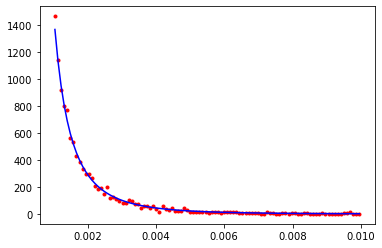

19047.63583076765


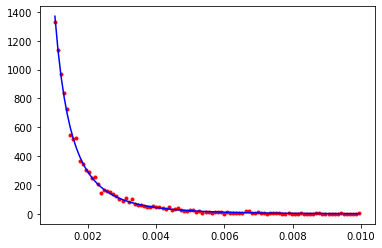

CPU times: user 41.7 ms, sys: 7.23 ms, total: 48.9 ms
Wall time: 16.8 ms
CPU times: user 33.9 ms, sys: 8.29 ms, total: 42.2 ms
Wall time: 14.6 ms
22987.59091574002


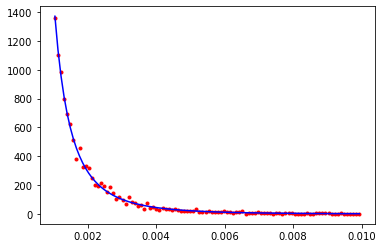

21100.902407674792


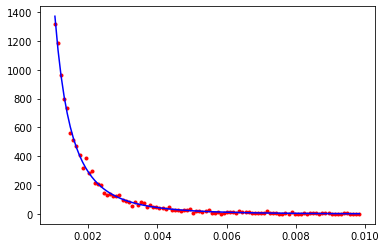

CPU times: user 43.1 ms, sys: 5.64 ms, total: 48.7 ms
Wall time: 16.3 ms
CPU times: user 35.2 ms, sys: 8.56 ms, total: 43.8 ms
Wall time: 14.6 ms
16180.77808290812


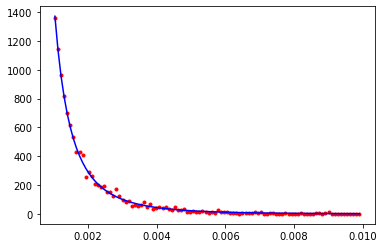

18244.668701735052


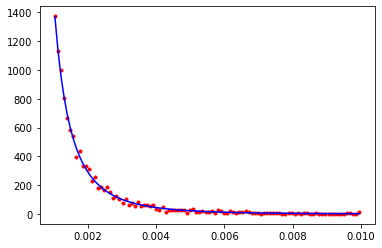

CPU times: user 43.3 ms, sys: 5.62 ms, total: 48.9 ms
Wall time: 16.4 ms
CPU times: user 45 ms, sys: 42.3 ms, total: 87.2 ms
Wall time: 27.3 ms
26994.346511865548


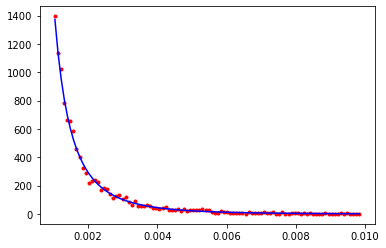

27067.2903726888


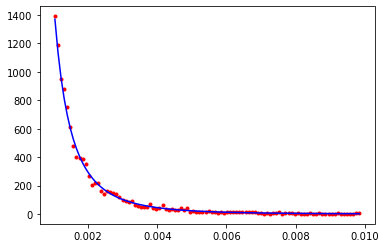

CPU times: user 43.3 ms, sys: 5.72 ms, total: 49 ms
Wall time: 16.4 ms
CPU times: user 45.6 ms, sys: 44.8 ms, total: 90.3 ms
Wall time: 28.3 ms
33262.49229662372


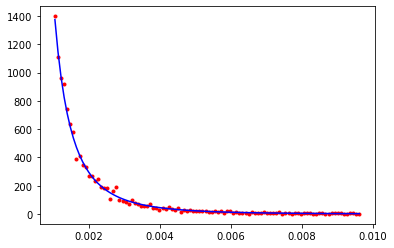

14945.077158618536


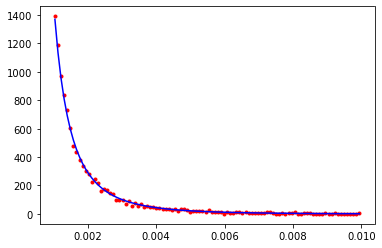

CPU times: user 43.1 ms, sys: 5.64 ms, total: 48.8 ms
Wall time: 16.3 ms
CPU times: user 34.5 ms, sys: 7.15 ms, total: 41.7 ms
Wall time: 13.9 ms
31190.068740513478


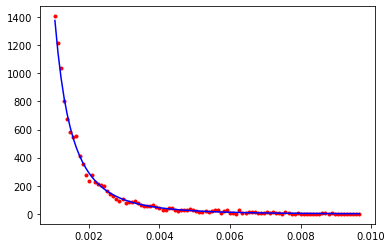

32076.722203812547


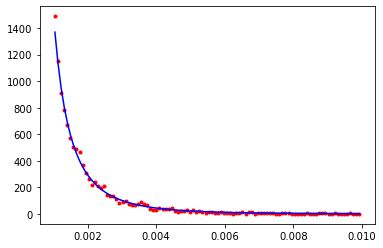

CPU times: user 46.1 ms, sys: 7.84 ms, total: 53.9 ms
Wall time: 18.5 ms
CPU times: user 34.7 ms, sys: 7.76 ms, total: 42.5 ms
Wall time: 14.4 ms
22028.0390607176


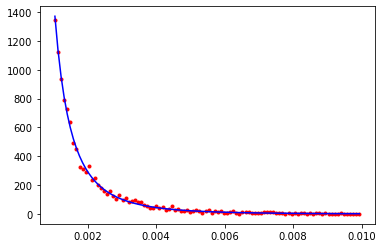

27298.016616461486


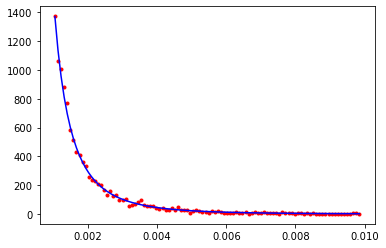

CPU times: user 42.6 ms, sys: 6.44 ms, total: 49 ms
Wall time: 16.7 ms
CPU times: user 34.4 ms, sys: 8.37 ms, total: 42.8 ms
Wall time: 14.3 ms
20588.360766261827


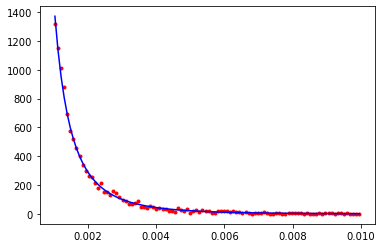

15333.639973815705


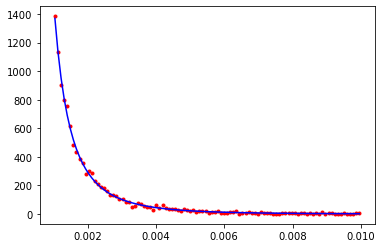

CPU times: user 43.5 ms, sys: 6.6 ms, total: 50.1 ms
Wall time: 17 ms
CPU times: user 37.2 ms, sys: 10.4 ms, total: 47.6 ms
Wall time: 15.9 ms
14728.026125911078


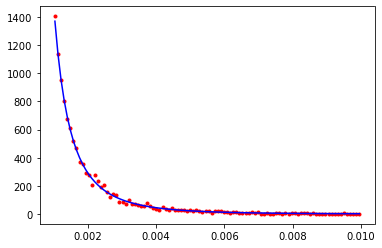

21849.958510791927


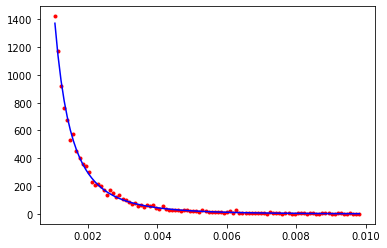

CPU times: user 43.1 ms, sys: 5.68 ms, total: 48.8 ms
Wall time: 16.3 ms
CPU times: user 36 ms, sys: 9.83 ms, total: 45.8 ms
Wall time: 15.2 ms
21446.324121592163


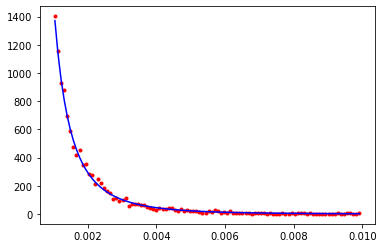

15219.941419949118


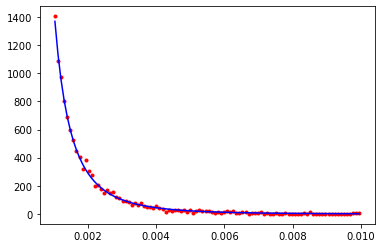

CPU times: user 43.2 ms, sys: 5.76 ms, total: 48.9 ms
Wall time: 16.4 ms
CPU times: user 28.8 ms, sys: 8.87 ms, total: 37.7 ms
Wall time: 15.9 ms
18003.954625649872


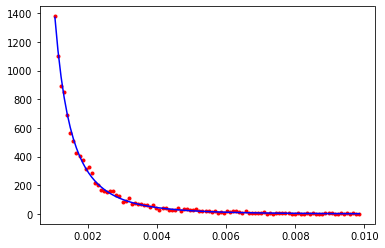

26677.497982442226


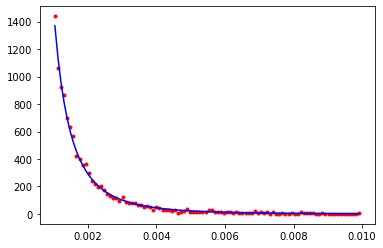

CPU times: user 42.8 ms, sys: 5.56 ms, total: 48.4 ms
Wall time: 16.2 ms
CPU times: user 45.1 ms, sys: 45.2 ms, total: 90.2 ms
Wall time: 28.2 ms
10443.51294418681


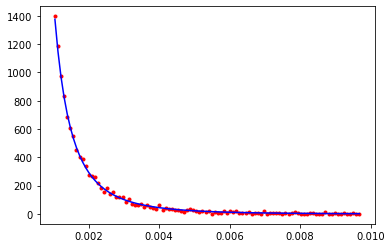

22051.666778752835


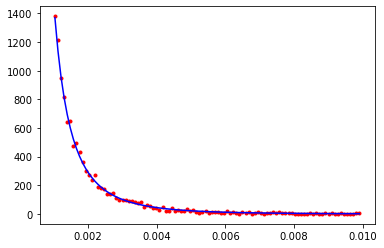

CPU times: user 43.1 ms, sys: 5.78 ms, total: 48.9 ms
Wall time: 16.4 ms
CPU times: user 35.1 ms, sys: 11.2 ms, total: 46.3 ms
Wall time: 15.7 ms
21713.655734095013


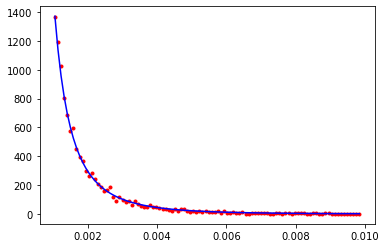

33697.07925694817


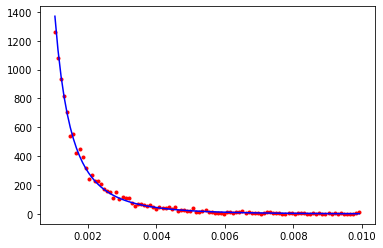

CPU times: user 43 ms, sys: 5.57 ms, total: 48.6 ms
Wall time: 16.3 ms
CPU times: user 34.5 ms, sys: 6.28 ms, total: 40.8 ms
Wall time: 13.6 ms
20943.990678151695


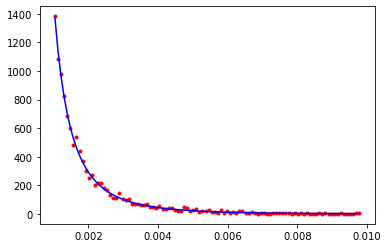

21571.49410833963


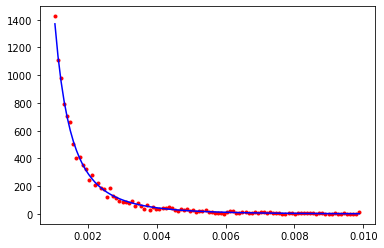

In [34]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [35]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

155.96659985479243
151.51191661074543
[1.2535932  0.86681348 1.02026382 1.42105659 1.71513249 0.67559665
 1.22832634 1.04374934 0.9417415  0.99865164 1.49186083 0.98608233
 0.89830201 1.15874602 0.8210072  1.18705254 0.82150726 0.68818087
 0.80273157 0.98534792]
1.0830106279802933


## 5000 samples, 5 iterations

In [36]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(5)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 8.24 ms, sys: 557 µs, total: 8.8 ms
Wall time: 8.27 ms
CPU times: user 14.1 ms, sys: 2.74 ms, total: 16.9 ms
Wall time: 15 ms
51296.815718420235


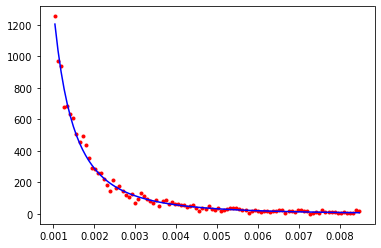

16326.253888455087


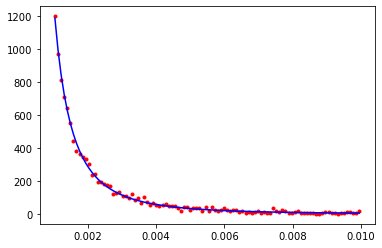

CPU times: user 22 ms, sys: 3.05 ms, total: 25.1 ms
Wall time: 8.4 ms
CPU times: user 34.4 ms, sys: 6.22 ms, total: 40.7 ms
Wall time: 13.6 ms
33909.04222194936


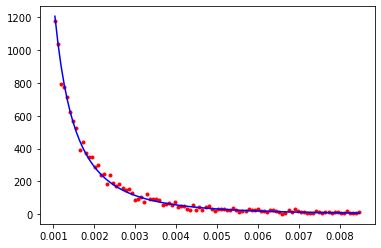

23262.532401250377


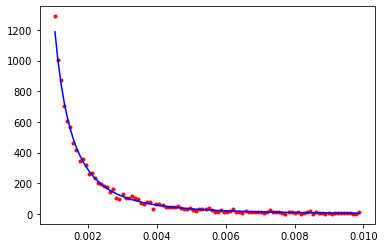

CPU times: user 22.4 ms, sys: 3.39 ms, total: 25.8 ms
Wall time: 8.71 ms
CPU times: user 34.9 ms, sys: 10.2 ms, total: 45.1 ms
Wall time: 15.2 ms
44174.923832349166


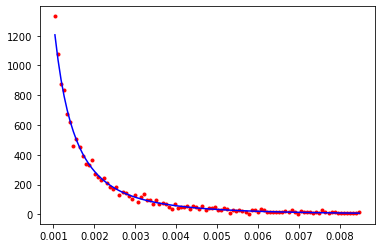

15796.700082084046


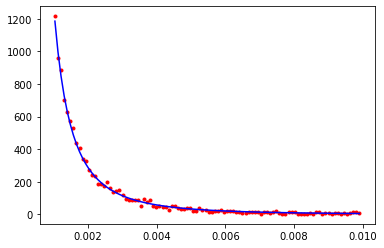

CPU times: user 20.9 ms, sys: 4.13 ms, total: 25 ms
Wall time: 8.65 ms
CPU times: user 34 ms, sys: 6.28 ms, total: 40.3 ms
Wall time: 13.5 ms
30201.894552153655


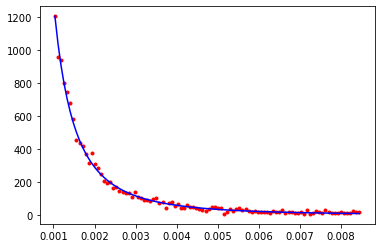

16050.625972424821


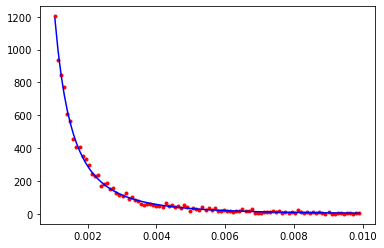

CPU times: user 21.9 ms, sys: 3.44 ms, total: 25.3 ms
Wall time: 8.59 ms
CPU times: user 34.5 ms, sys: 6.98 ms, total: 41.5 ms
Wall time: 13.9 ms
53121.932728405765


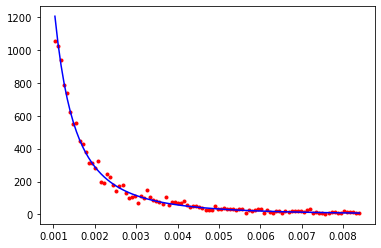

21224.72300801168


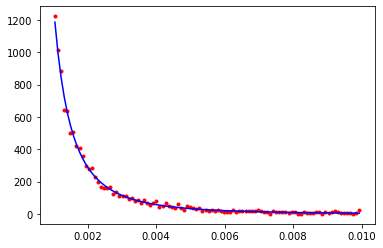

CPU times: user 22.2 ms, sys: 3.54 ms, total: 25.8 ms
Wall time: 8.73 ms
CPU times: user 34 ms, sys: 7.03 ms, total: 41 ms
Wall time: 13.7 ms
31091.80189542188


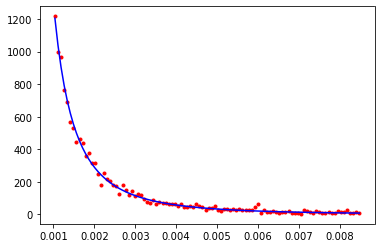

24334.16320841606


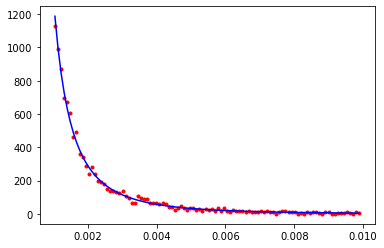

CPU times: user 20.9 ms, sys: 4.19 ms, total: 25.1 ms
Wall time: 8.73 ms
CPU times: user 36.5 ms, sys: 18.7 ms, total: 55.2 ms
Wall time: 18.4 ms
39457.57239748426


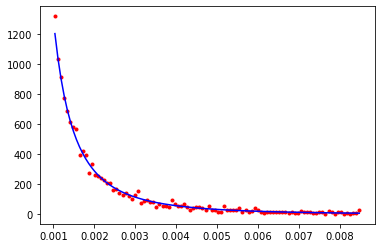

17340.067152407246


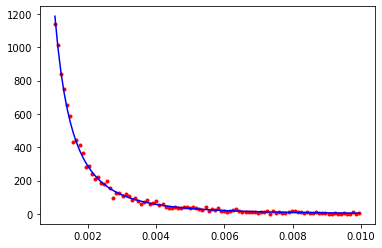

CPU times: user 22.6 ms, sys: 3.38 ms, total: 26 ms
Wall time: 8.74 ms
CPU times: user 44.2 ms, sys: 36.7 ms, total: 81 ms
Wall time: 25.6 ms
38817.699987408494


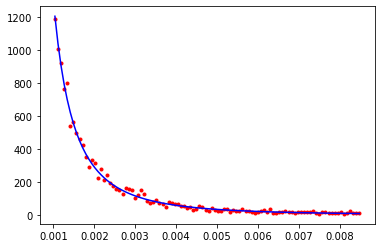

22794.749343411833


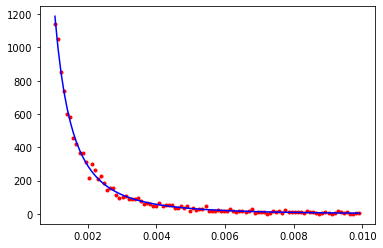

CPU times: user 22.2 ms, sys: 3.23 ms, total: 25.4 ms
Wall time: 8.55 ms
CPU times: user 35.1 ms, sys: 8.55 ms, total: 43.6 ms
Wall time: 14.4 ms
24777.080188647513


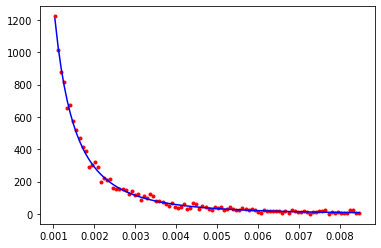

16193.329812112608


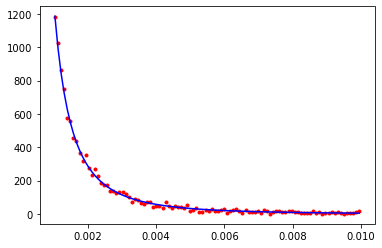

CPU times: user 21.8 ms, sys: 3.36 ms, total: 25.2 ms
Wall time: 8.53 ms
CPU times: user 35.2 ms, sys: 9.34 ms, total: 44.6 ms
Wall time: 14.8 ms
28618.112246165456


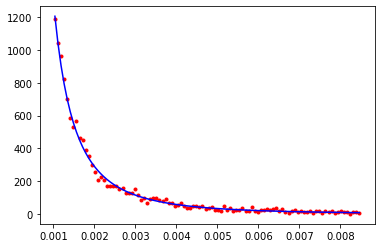

27831.15282156286


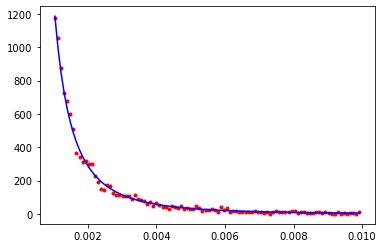

CPU times: user 22.3 ms, sys: 3.27 ms, total: 25.6 ms
Wall time: 8.6 ms
CPU times: user 34.3 ms, sys: 6.53 ms, total: 40.9 ms
Wall time: 13.6 ms
50213.70792954454


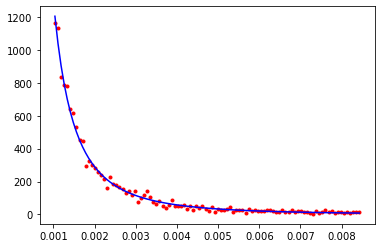

26753.905550980526


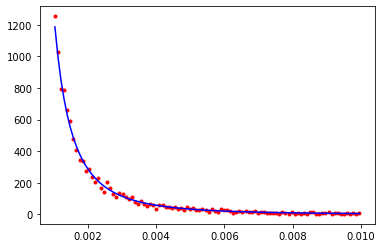

CPU times: user 22.4 ms, sys: 3.17 ms, total: 25.6 ms
Wall time: 8.6 ms
CPU times: user 34.2 ms, sys: 6.71 ms, total: 41 ms
Wall time: 13.8 ms
38903.00648334486


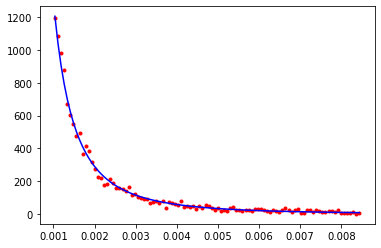

23840.76089012738


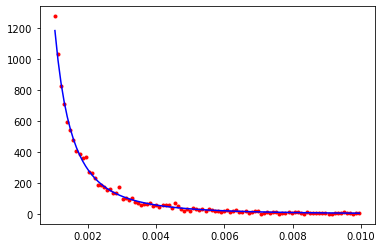

CPU times: user 22.3 ms, sys: 3.3 ms, total: 25.6 ms
Wall time: 8.62 ms
CPU times: user 40.1 ms, sys: 26.2 ms, total: 66.3 ms
Wall time: 21.9 ms
25104.33338569265


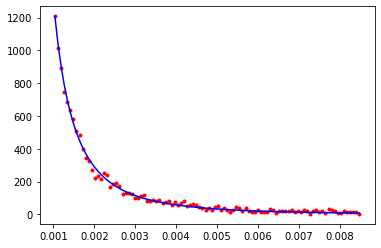

26529.892425471597


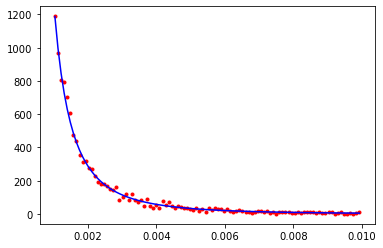

CPU times: user 22.2 ms, sys: 3.17 ms, total: 25.4 ms
Wall time: 8.5 ms
CPU times: user 41.6 ms, sys: 31.3 ms, total: 73 ms
Wall time: 23.1 ms
45354.86655702312


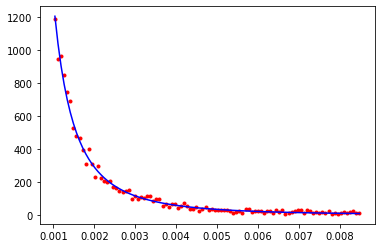

16962.603278815342


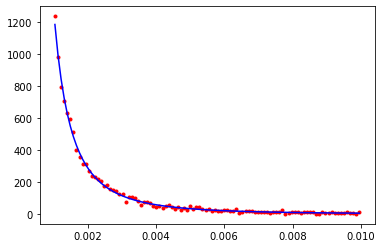

CPU times: user 22 ms, sys: 3.21 ms, total: 25.2 ms
Wall time: 8.5 ms
CPU times: user 34.8 ms, sys: 8.85 ms, total: 43.7 ms
Wall time: 14.5 ms
38175.4608204718


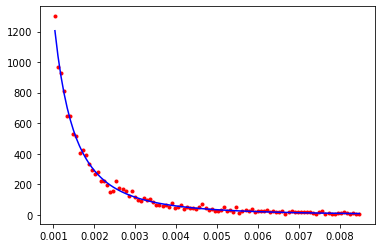

28281.79769832608


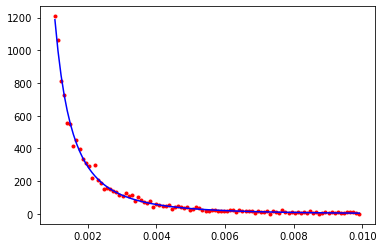

CPU times: user 22.4 ms, sys: 3.12 ms, total: 25.5 ms
Wall time: 8.54 ms
CPU times: user 46.5 ms, sys: 45.2 ms, total: 91.7 ms
Wall time: 28.6 ms
27238.38996947073


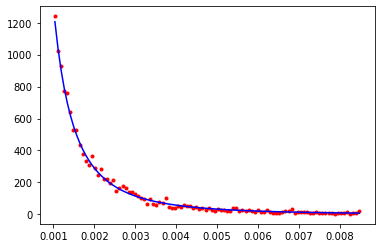

12820.303690006225


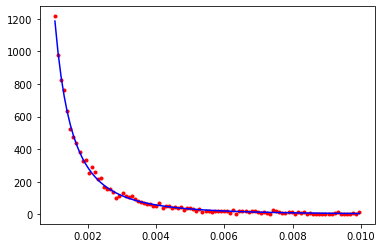

CPU times: user 21.8 ms, sys: 3.8 ms, total: 25.6 ms
Wall time: 8.74 ms
CPU times: user 33.4 ms, sys: 6.18 ms, total: 39.6 ms
Wall time: 13.4 ms
28300.58679949206


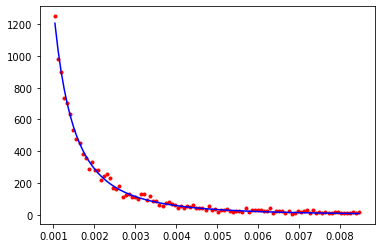

23148.44252267499


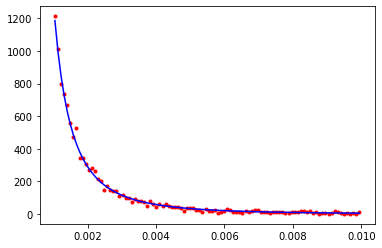

CPU times: user 22.3 ms, sys: 3.18 ms, total: 25.5 ms
Wall time: 8.55 ms
CPU times: user 45.1 ms, sys: 44.8 ms, total: 89.9 ms
Wall time: 28 ms
31022.085222785132


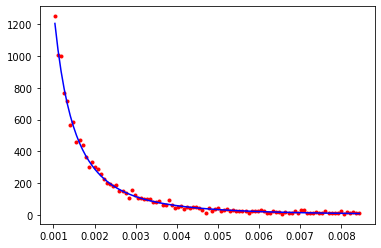

17329.163941793


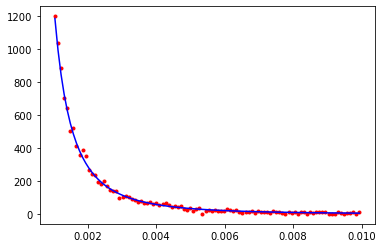

CPU times: user 21.9 ms, sys: 3.5 ms, total: 25.4 ms
Wall time: 8.64 ms
CPU times: user 33.7 ms, sys: 6.9 ms, total: 40.6 ms
Wall time: 13.7 ms
23254.553859628602


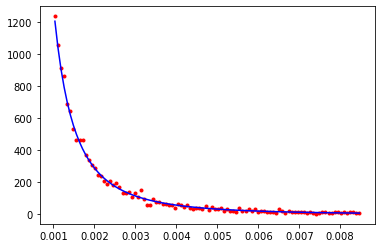

26059.43449973095


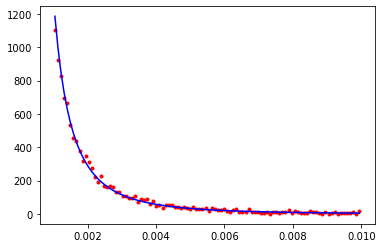

CPU times: user 22.6 ms, sys: 3.91 ms, total: 26.5 ms
Wall time: 9.05 ms
CPU times: user 34 ms, sys: 6.91 ms, total: 40.9 ms
Wall time: 13.7 ms
29176.604327453133


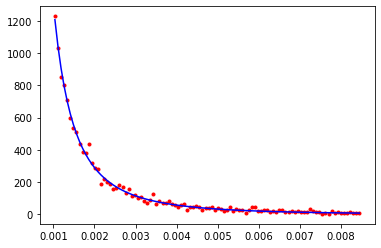

23704.474527562852


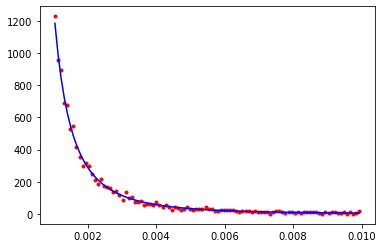

In [37]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [38]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

188.70750794858594
146.0453827951479
[1.77256402 1.2073391  1.67226353 1.3717378  1.58203438 1.13035468
 1.50848082 1.30496087 1.23696378 1.01403955 1.36999049 1.27741357
 0.97276201 1.63518048 1.16181944 1.45761074 1.10569878 1.33797096
 0.94465127 1.10943588]
1.3291774197649409


In [39]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(5)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 9.82 ms, sys: 792 µs, total: 10.6 ms
Wall time: 9.85 ms
CPU times: user 22.6 ms, sys: 14.4 ms, total: 37 ms
Wall time: 25.4 ms
14444.800191440407


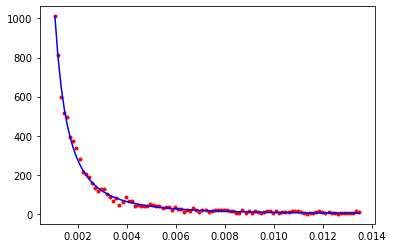

3809.430349078918


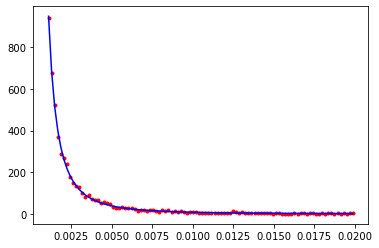

CPU times: user 20.7 ms, sys: 3.19 ms, total: 23.9 ms
Wall time: 8.07 ms
CPU times: user 34.3 ms, sys: 7.37 ms, total: 41.6 ms
Wall time: 14.1 ms
10766.84301978348


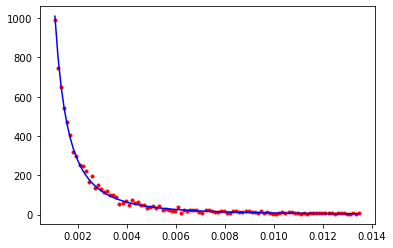

8049.421075785147


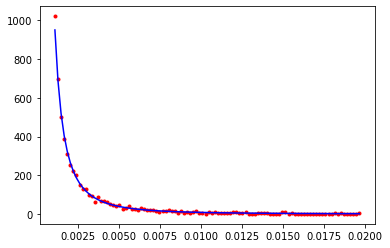

CPU times: user 20.6 ms, sys: 3.76 ms, total: 24.3 ms
Wall time: 8.34 ms
CPU times: user 34.2 ms, sys: 7.27 ms, total: 41.4 ms
Wall time: 14 ms
14196.15895239967


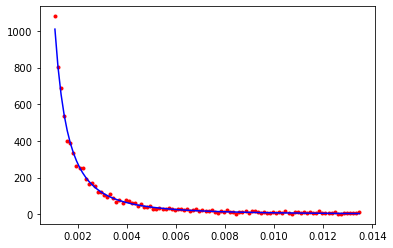

4040.211916427765


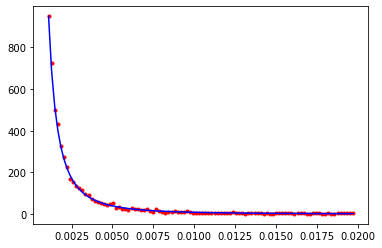

CPU times: user 19.8 ms, sys: 4.38 ms, total: 24.2 ms
Wall time: 8.49 ms
CPU times: user 38.1 ms, sys: 18.3 ms, total: 56.4 ms
Wall time: 18.5 ms
18657.17793135939


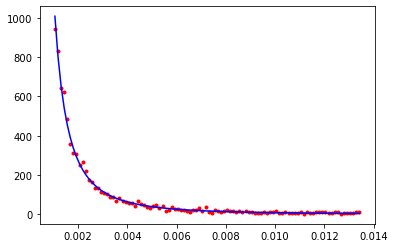

3053.130125369764


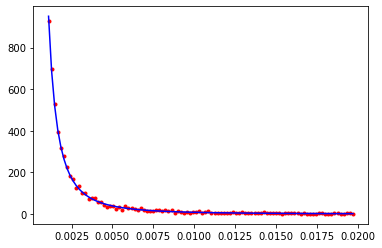

CPU times: user 22.2 ms, sys: 5.05 ms, total: 27.2 ms
Wall time: 9.58 ms
CPU times: user 35.4 ms, sys: 7.51 ms, total: 42.9 ms
Wall time: 15 ms
25637.77923573579


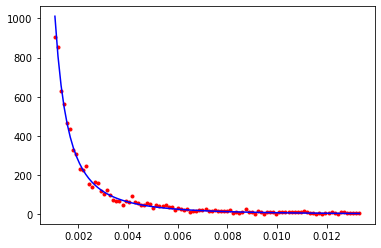

4299.280389212148


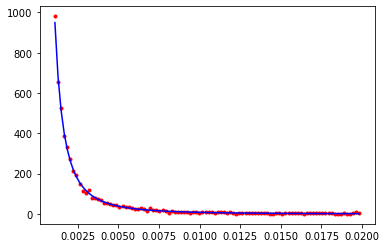

CPU times: user 20.4 ms, sys: 3.32 ms, total: 23.7 ms
Wall time: 8.11 ms
CPU times: user 34.3 ms, sys: 7.51 ms, total: 41.8 ms
Wall time: 14.1 ms
11221.87796110817


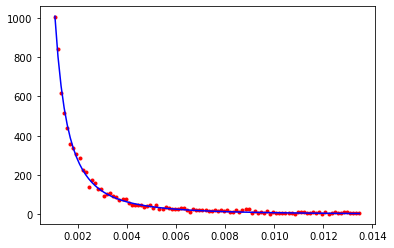

6572.52086294898


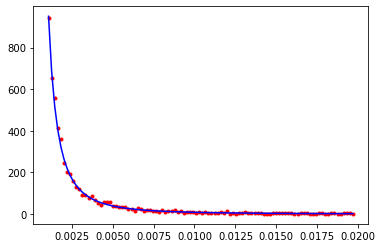

CPU times: user 20.2 ms, sys: 3.85 ms, total: 24.1 ms
Wall time: 8.32 ms
CPU times: user 34 ms, sys: 5.74 ms, total: 39.8 ms
Wall time: 13.3 ms
11738.261846146912


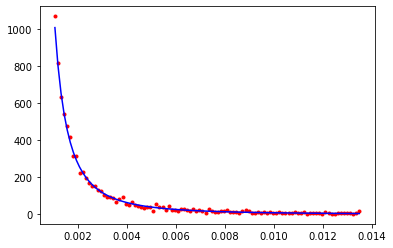

3360.382522453843


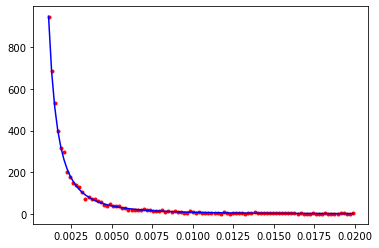

CPU times: user 20.9 ms, sys: 3.29 ms, total: 24.2 ms
Wall time: 8.18 ms
CPU times: user 38.1 ms, sys: 21 ms, total: 59.1 ms
Wall time: 19.2 ms
7661.722319066356


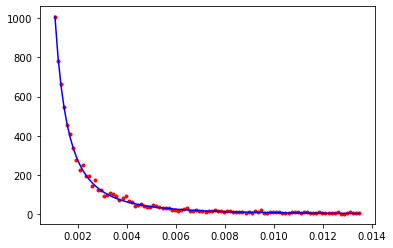

2264.544366001604


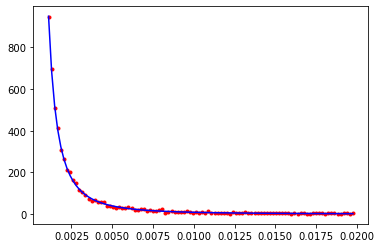

CPU times: user 21.1 ms, sys: 3.08 ms, total: 24.1 ms
Wall time: 8.1 ms
CPU times: user 35.9 ms, sys: 10 ms, total: 46 ms
Wall time: 15.2 ms
7714.161817366228


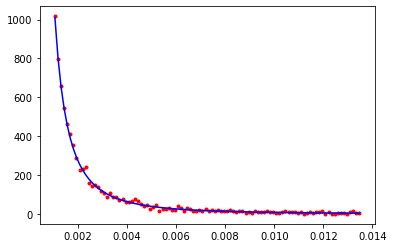

4348.553231115695


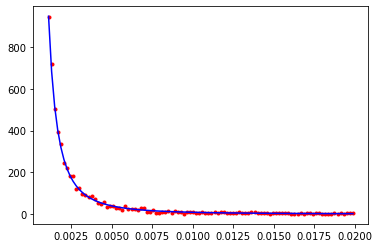

CPU times: user 20.9 ms, sys: 3.14 ms, total: 24 ms
Wall time: 8.1 ms
CPU times: user 33.8 ms, sys: 7.18 ms, total: 41 ms
Wall time: 13.8 ms
13980.605702761592


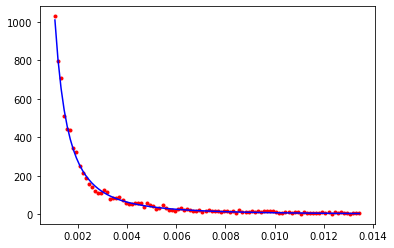

7816.105662493564


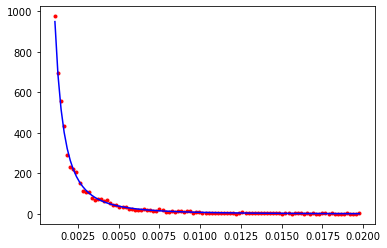

CPU times: user 19.7 ms, sys: 3.82 ms, total: 23.5 ms
Wall time: 8.15 ms
CPU times: user 34.5 ms, sys: 7.51 ms, total: 42 ms
Wall time: 14 ms
17558.59726794741


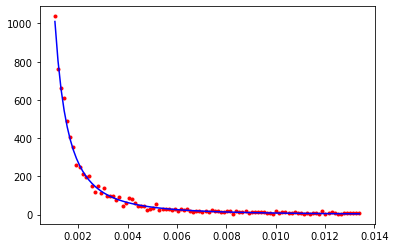

4968.642555534789


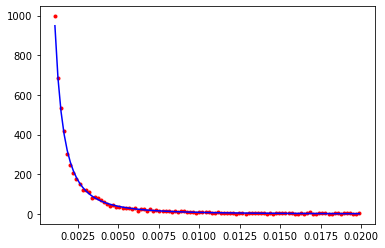

CPU times: user 21 ms, sys: 3.16 ms, total: 24.1 ms
Wall time: 8.14 ms
CPU times: user 34.2 ms, sys: 8.13 ms, total: 42.4 ms
Wall time: 14.4 ms
19047.12278341749


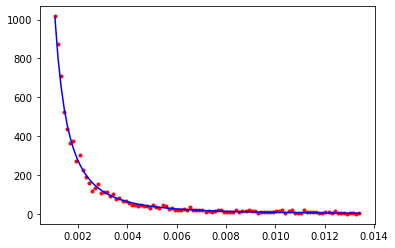

8763.142008667906


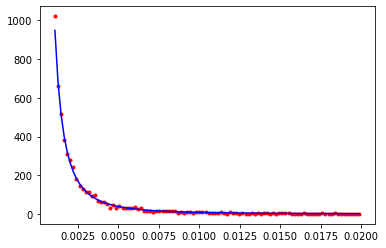

CPU times: user 20.5 ms, sys: 3.99 ms, total: 24.5 ms
Wall time: 8.43 ms
CPU times: user 40.9 ms, sys: 30.2 ms, total: 71.1 ms
Wall time: 22.7 ms
10063.109741819922


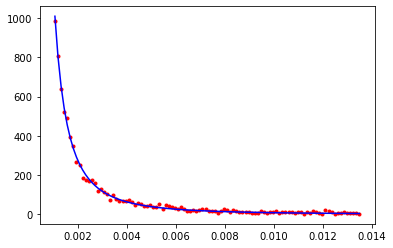

5265.754031214119


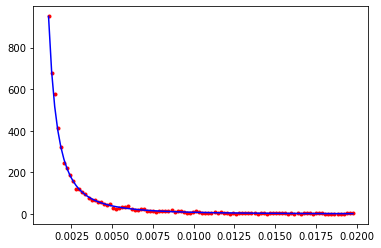

CPU times: user 20.3 ms, sys: 3.64 ms, total: 23.9 ms
Wall time: 8.19 ms
CPU times: user 37.4 ms, sys: 16.6 ms, total: 53.9 ms
Wall time: 17.7 ms
11545.971103126889


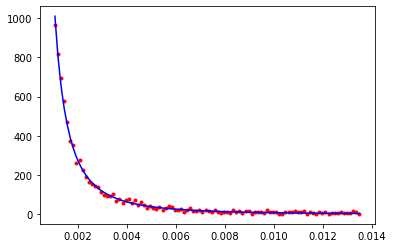

3820.7363042144752


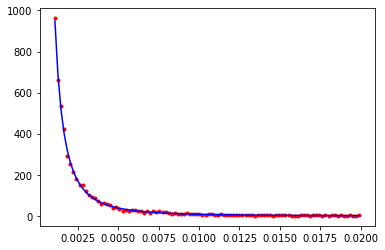

CPU times: user 20.8 ms, sys: 3.11 ms, total: 23.9 ms
Wall time: 8.05 ms
CPU times: user 34 ms, sys: 7.92 ms, total: 41.9 ms
Wall time: 14.2 ms
7689.712088622769


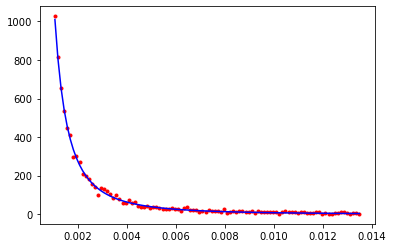

7770.40751905282


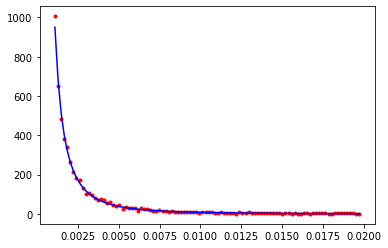

CPU times: user 20.9 ms, sys: 3.22 ms, total: 24.1 ms
Wall time: 8.14 ms
CPU times: user 39.6 ms, sys: 24.6 ms, total: 64.2 ms
Wall time: 20.8 ms
11795.797188329268


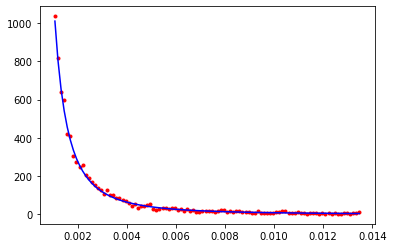

3549.7979181163114


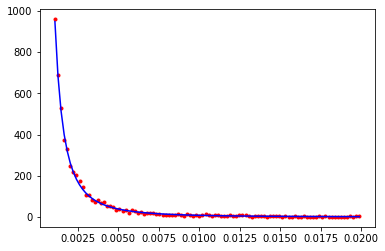

CPU times: user 20.2 ms, sys: 3.52 ms, total: 23.7 ms
Wall time: 8.12 ms
CPU times: user 34.5 ms, sys: 8.7 ms, total: 43.2 ms
Wall time: 14.7 ms
12202.581979137818


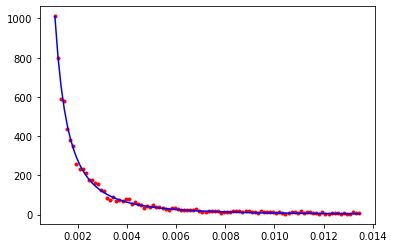

5932.726987248682


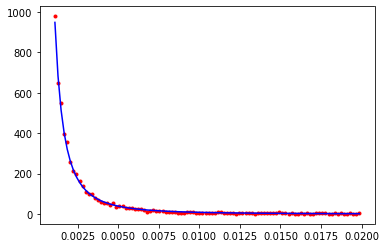

CPU times: user 20.5 ms, sys: 3.91 ms, total: 24.4 ms
Wall time: 8.42 ms
CPU times: user 34.5 ms, sys: 7.29 ms, total: 41.8 ms
Wall time: 14.1 ms
7588.644385136038


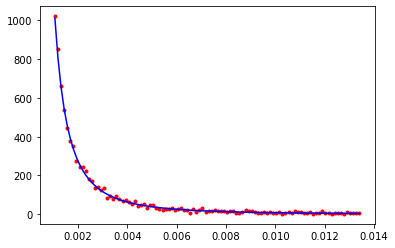

3514.6821553232826


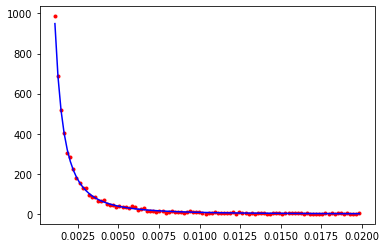

CPU times: user 20.6 ms, sys: 3.35 ms, total: 23.9 ms
Wall time: 8.14 ms
CPU times: user 34.2 ms, sys: 7.61 ms, total: 41.8 ms
Wall time: 14.2 ms
11902.866840601835


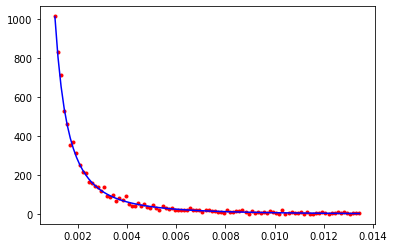

9798.431998292857


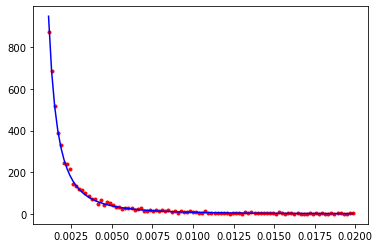

CPU times: user 20.7 ms, sys: 3.48 ms, total: 24.2 ms
Wall time: 8.24 ms
CPU times: user 34.5 ms, sys: 7.07 ms, total: 41.6 ms
Wall time: 14.2 ms
10922.383657164251


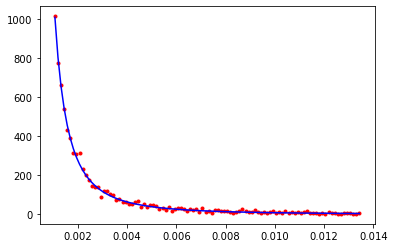

4993.422204725276


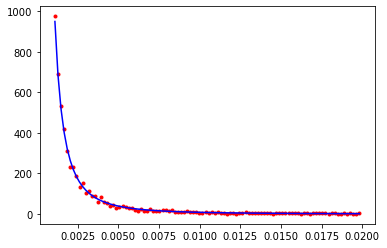

In [40]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [41]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

113.21134572393169
72.79811954414686
[1.94726811 1.15654322 1.87449098 2.47201055 2.4419812  1.3066726
 1.86899241 1.83938562 1.3319011  1.33741991 1.87986227 1.47429627
 1.38240667 1.73836793 0.99479396 1.82289575 1.43416357 1.46939674
 1.10216723 1.4789707 ]
1.6648548538474415


In [42]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 5000
evran.set_rutherford_iterations(5)
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 10.5 ms, sys: 819 µs, total: 11.3 ms
Wall time: 10.6 ms
CPU times: user 22.7 ms, sys: 13.4 ms, total: 36.2 ms
Wall time: 25.9 ms
69446.89177815162


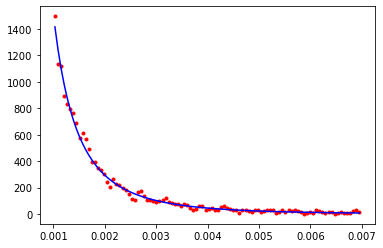

18942.76687605886


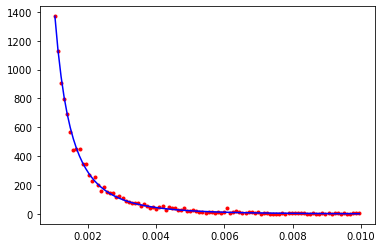

CPU times: user 22.3 ms, sys: 3.78 ms, total: 26.1 ms
Wall time: 8.91 ms
CPU times: user 35.3 ms, sys: 10.6 ms, total: 45.9 ms
Wall time: 15.4 ms
61594.3988785426


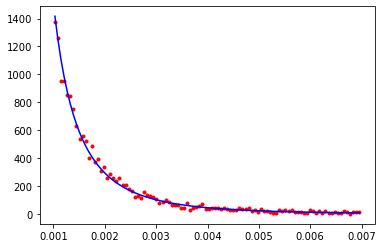

29059.18607822507


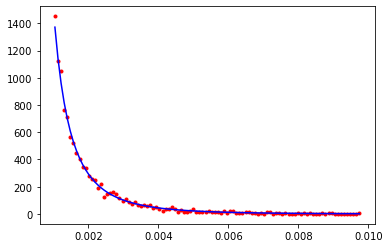

CPU times: user 22.7 ms, sys: 3.79 ms, total: 26.5 ms
Wall time: 9.04 ms
CPU times: user 34 ms, sys: 5.74 ms, total: 39.8 ms
Wall time: 13.5 ms
64995.28771319562


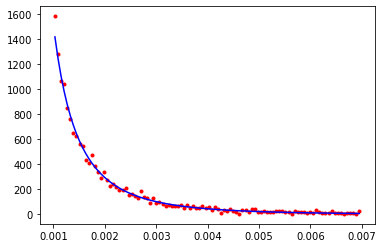

27949.533747491332


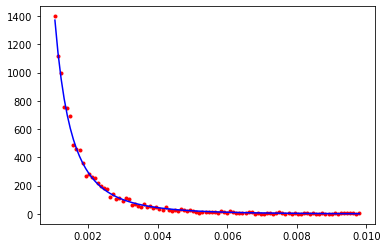

CPU times: user 22.5 ms, sys: 4.05 ms, total: 26.6 ms
Wall time: 9.11 ms
CPU times: user 33.9 ms, sys: 8.09 ms, total: 42 ms
Wall time: 14.3 ms
56325.12809849233


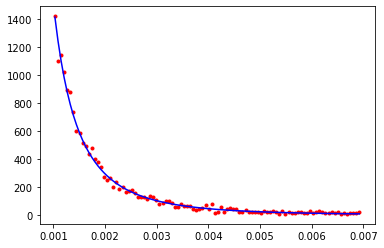

12581.235405347812


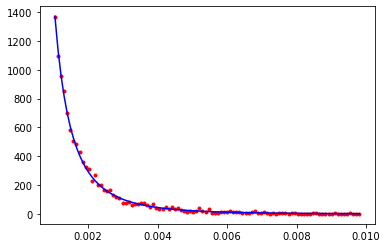

CPU times: user 22.1 ms, sys: 4.36 ms, total: 26.4 ms
Wall time: 9.19 ms
CPU times: user 33.6 ms, sys: 5.35 ms, total: 38.9 ms
Wall time: 13.1 ms
87006.93115524048


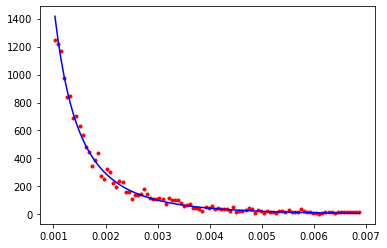

18641.04885358723


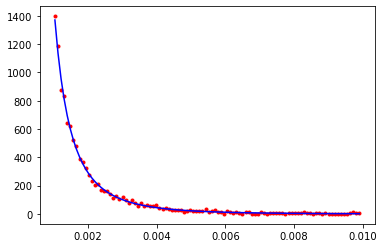

CPU times: user 22.6 ms, sys: 3.46 ms, total: 26 ms
Wall time: 8.82 ms
CPU times: user 38.5 ms, sys: 17.8 ms, total: 56.3 ms
Wall time: 18.5 ms
71646.46823416141


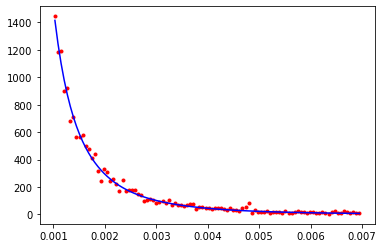

35761.85521772086


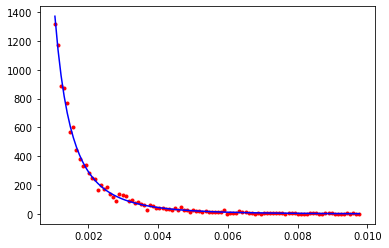

CPU times: user 23.1 ms, sys: 3.65 ms, total: 26.8 ms
Wall time: 9.06 ms
CPU times: user 34.6 ms, sys: 7.82 ms, total: 42.4 ms
Wall time: 14.5 ms
88967.30735927809


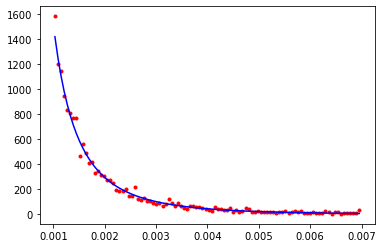

19047.63583076765


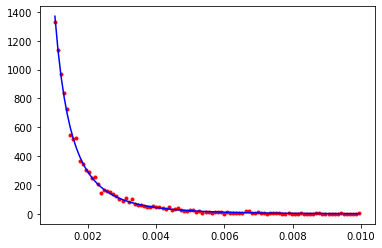

CPU times: user 22.7 ms, sys: 3.81 ms, total: 26.5 ms
Wall time: 9.08 ms
CPU times: user 36.3 ms, sys: 14.1 ms, total: 50.4 ms
Wall time: 16.7 ms
53335.76016712722


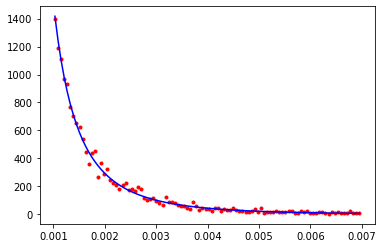

21100.902407674792


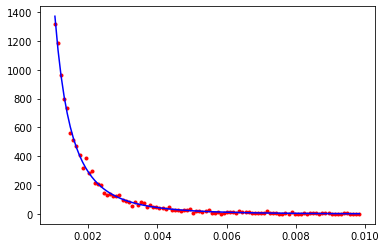

CPU times: user 22.1 ms, sys: 4.13 ms, total: 26.2 ms
Wall time: 9.06 ms
CPU times: user 37.6 ms, sys: 17.6 ms, total: 55.1 ms
Wall time: 18.1 ms
48978.565531921566


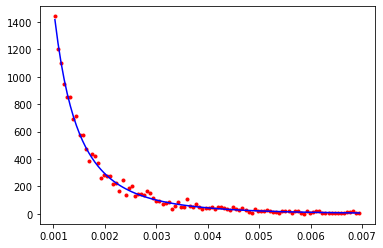

18244.668701735052


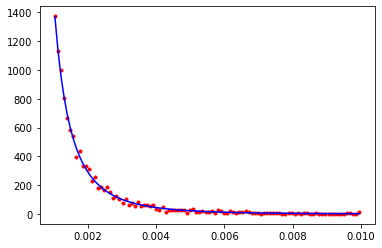

CPU times: user 12.5 ms, sys: 1.71 ms, total: 14.2 ms
Wall time: 11.4 ms
CPU times: user 43 ms, sys: 13.3 ms, total: 56.3 ms
Wall time: 19 ms
51462.69200831508


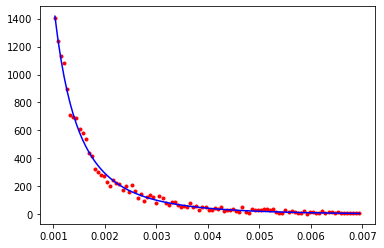

27067.2903726888


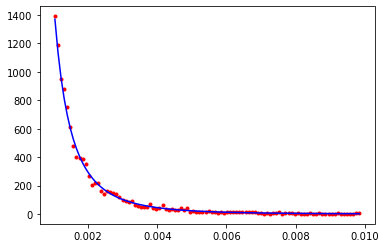

CPU times: user 22.8 ms, sys: 3.42 ms, total: 26.2 ms
Wall time: 8.83 ms
CPU times: user 35.7 ms, sys: 9.58 ms, total: 45.3 ms
Wall time: 15 ms
69886.92996180801


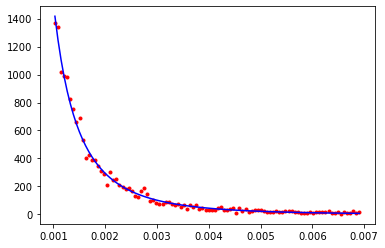

14945.077158618536


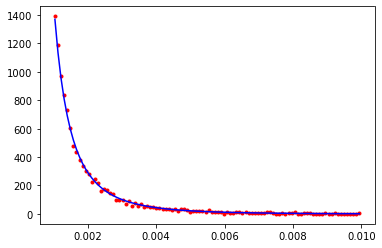

CPU times: user 22.1 ms, sys: 4.21 ms, total: 26.3 ms
Wall time: 9.08 ms
CPU times: user 34.3 ms, sys: 7.06 ms, total: 41.3 ms
Wall time: 13.8 ms
58460.38000433793


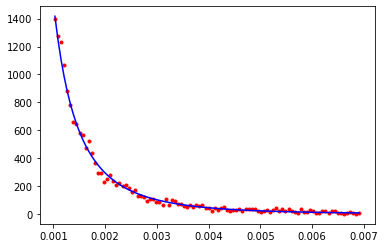

32076.722203812547


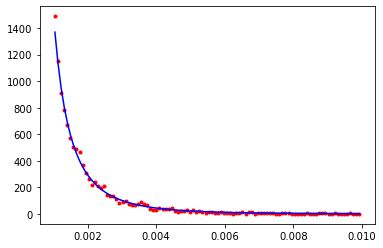

CPU times: user 23.1 ms, sys: 3.37 ms, total: 26.5 ms
Wall time: 8.91 ms
CPU times: user 36.1 ms, sys: 10.4 ms, total: 46.5 ms
Wall time: 15.5 ms
49833.52239278652


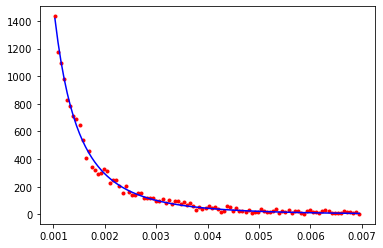

27298.016616461486


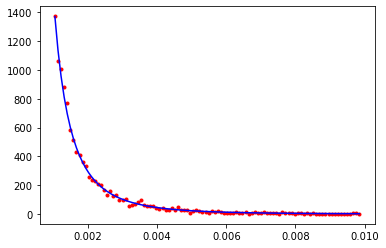

CPU times: user 23 ms, sys: 3.48 ms, total: 26.5 ms
Wall time: 8.94 ms
CPU times: user 34.1 ms, sys: 5.41 ms, total: 39.5 ms
Wall time: 13.3 ms
56443.5189463934


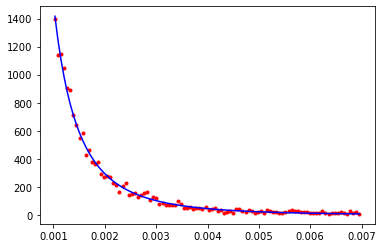

15333.639973815705


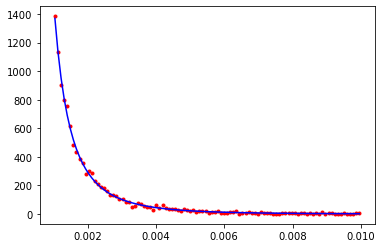

CPU times: user 23 ms, sys: 3.29 ms, total: 26.3 ms
Wall time: 8.85 ms
CPU times: user 37.2 ms, sys: 15.5 ms, total: 52.6 ms
Wall time: 17.3 ms
55409.33958418035


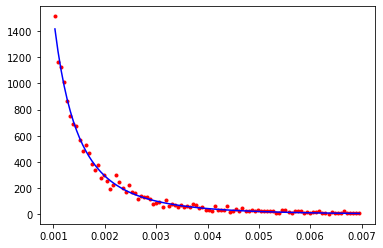

21849.958510791927


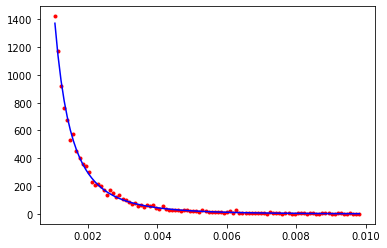

CPU times: user 22.9 ms, sys: 3.33 ms, total: 26.2 ms
Wall time: 8.85 ms
CPU times: user 34.6 ms, sys: 8.53 ms, total: 43.1 ms
Wall time: 14.4 ms
48552.37973776588


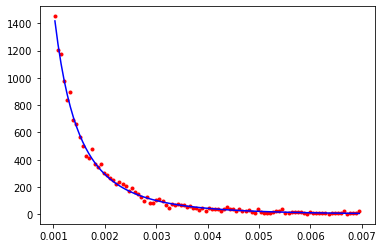

15219.941419949118


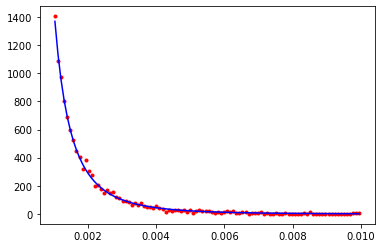

CPU times: user 23.3 ms, sys: 3.51 ms, total: 26.8 ms
Wall time: 9 ms
CPU times: user 38.4 ms, sys: 19.9 ms, total: 58.2 ms
Wall time: 18.9 ms
47999.37820703229


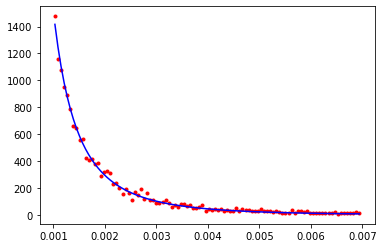

26677.497982442226


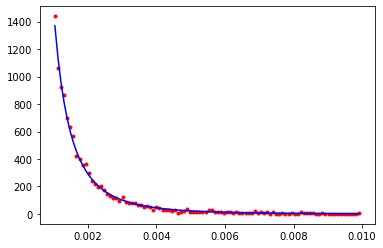

CPU times: user 23.1 ms, sys: 3.36 ms, total: 26.5 ms
Wall time: 8.9 ms
CPU times: user 38 ms, sys: 17.1 ms, total: 55.2 ms
Wall time: 18 ms
43861.544412617484


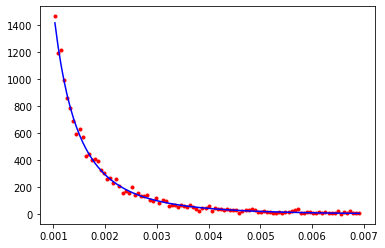

22051.666778752835


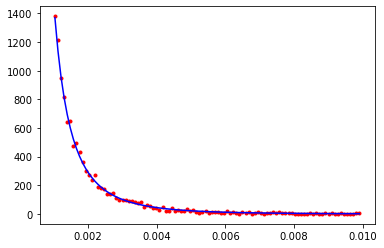

CPU times: user 22.8 ms, sys: 3.53 ms, total: 26.4 ms
Wall time: 8.93 ms
CPU times: user 37.7 ms, sys: 17.2 ms, total: 54.8 ms
Wall time: 17.9 ms
39167.91896115043


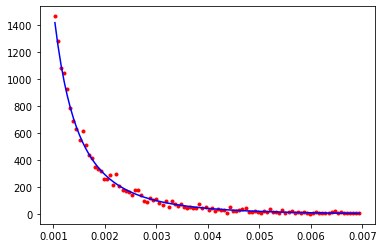

33697.07925694817


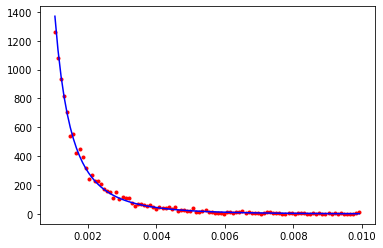

CPU times: user 22.6 ms, sys: 3.78 ms, total: 26.4 ms
Wall time: 8.99 ms
CPU times: user 39.7 ms, sys: 23.7 ms, total: 63.4 ms
Wall time: 20.5 ms
54332.48092969466


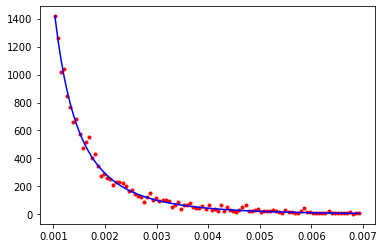

21571.49410833963


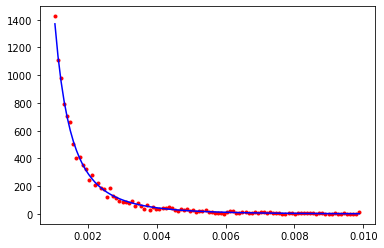

In [43]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
    %time r_k2      = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [44]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

242.66301985079977
151.51191661074543
[1.91471747 1.45589109 1.52494314 2.11587228 2.16043773 1.41542667
 2.16119863 1.58985944 1.63845697 1.3788717  2.16246407 1.35000639
 1.35112412 1.91859987 1.59245137 1.78607121 1.34135971 1.41033164
 1.07812501 1.58704651]
1.6769607450993895


## 100 samples, loop over iterations

In [34]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 100
n_iter = [5, 6, 7, 8, 9, 10, 15, 20, 25, 30, 35, 40, 45, 50]
bins = 15

loops = 20
S_everest = { nn: [] for nn in n_iter }
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 472 µs, sys: 31 µs, total: 503 µs
Wall time: 302 µs
38492.907618947145


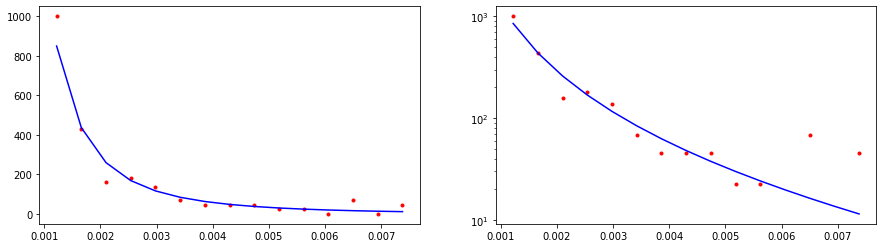

CPU times: user 441 µs, sys: 29 µs, total: 470 µs
Wall time: 346 µs
77192.70153907372


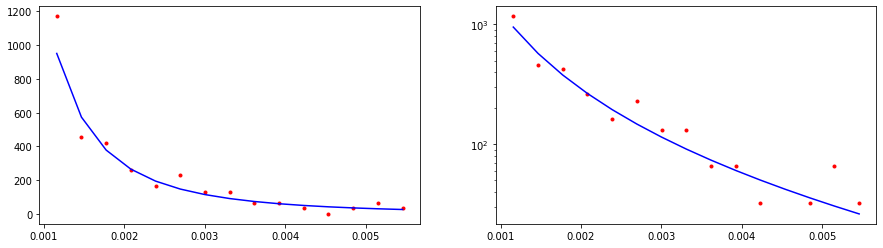

CPU times: user 454 µs, sys: 0 ns, total: 454 µs
Wall time: 360 µs
12739.030837278358


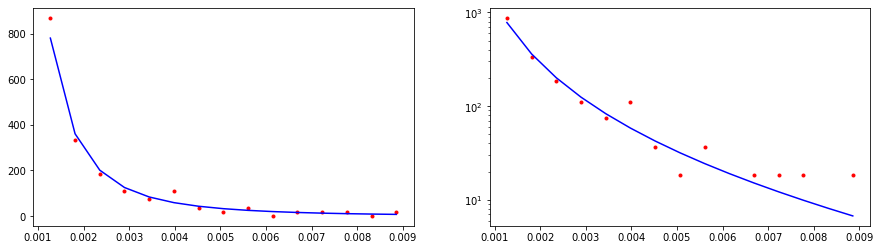

CPU times: user 563 µs, sys: 38 µs, total: 601 µs
Wall time: 425 µs
22559.91378069005


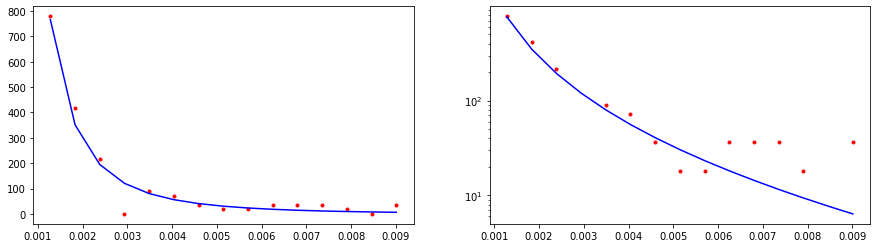

CPU times: user 628 µs, sys: 43 µs, total: 671 µs
Wall time: 482 µs
55233.02946127744


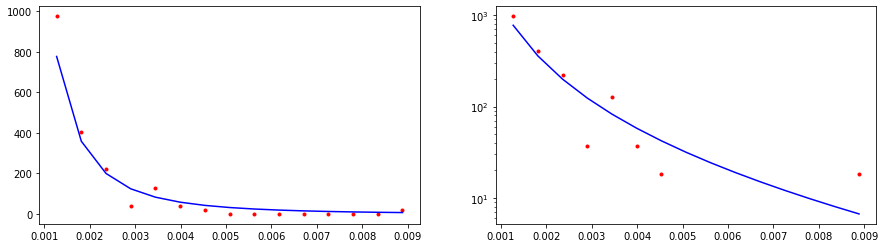

CPU times: user 604 µs, sys: 41 µs, total: 645 µs
Wall time: 535 µs
11040.31069302383


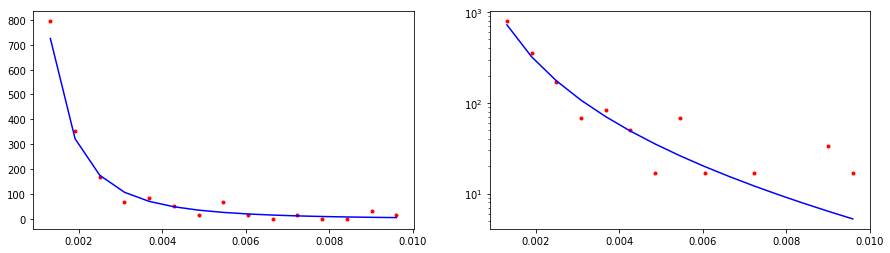

CPU times: user 817 µs, sys: 0 ns, total: 817 µs
Wall time: 642 µs
28955.693401569493


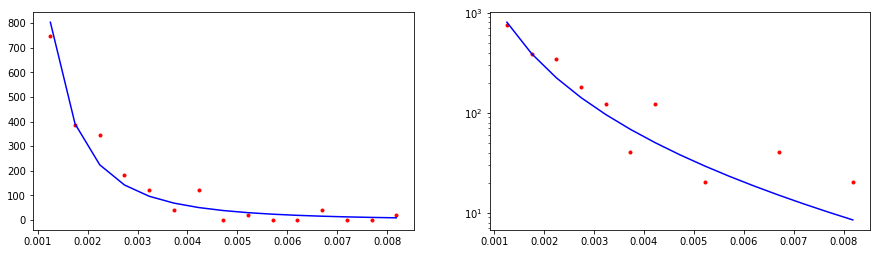

CPU times: user 975 µs, sys: 9 µs, total: 984 µs
Wall time: 867 µs
46657.941589883725


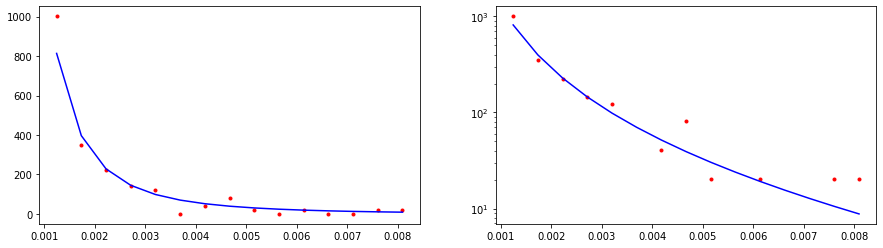

CPU times: user 1.23 ms, sys: 16 µs, total: 1.24 ms
Wall time: 1.03 ms
38050.93759361935


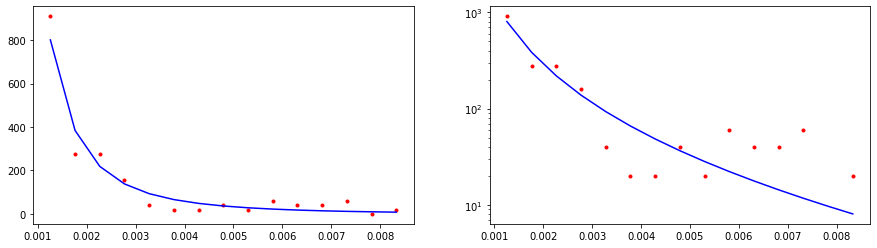

CPU times: user 1.37 ms, sys: 25 µs, total: 1.4 ms
Wall time: 1.2 ms
32839.798968111136


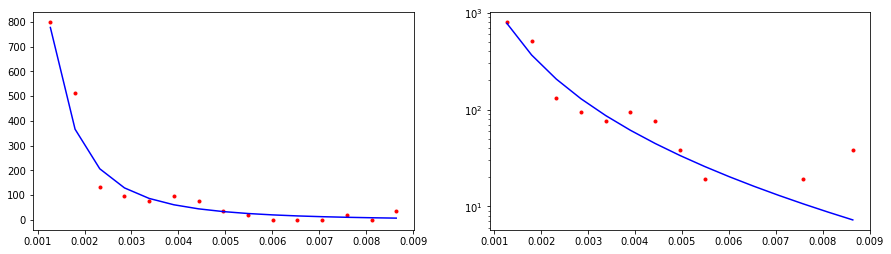

CPU times: user 1.54 ms, sys: 37 µs, total: 1.57 ms
Wall time: 1.36 ms
16667.283365513063


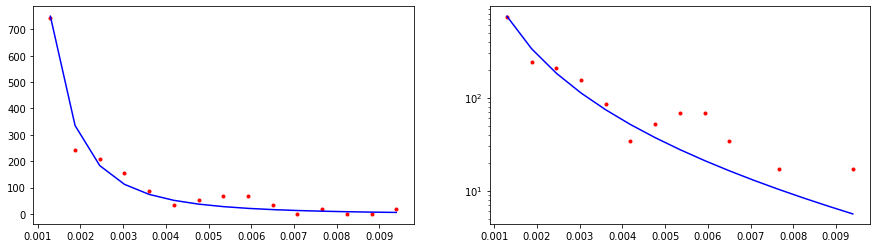

CPU times: user 1.59 ms, sys: 0 ns, total: 1.59 ms
Wall time: 1.38 ms
23336.00847761043


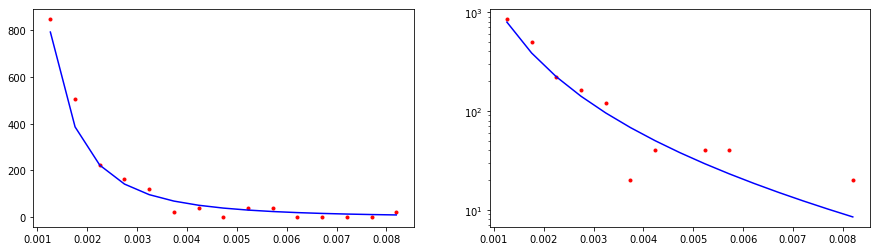

CPU times: user 1.85 ms, sys: 0 ns, total: 1.85 ms
Wall time: 1.67 ms
16388.419804695615


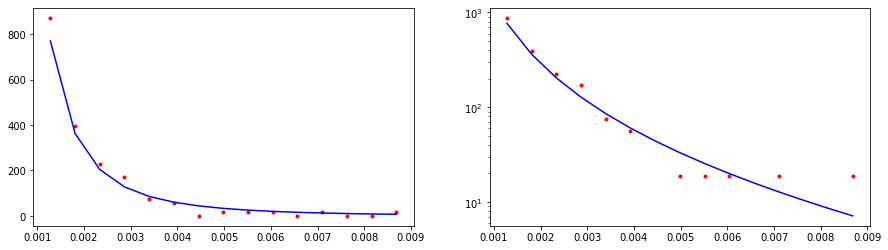

CPU times: user 2.03 ms, sys: 2 µs, total: 2.03 ms
Wall time: 1.83 ms
44272.62186059987


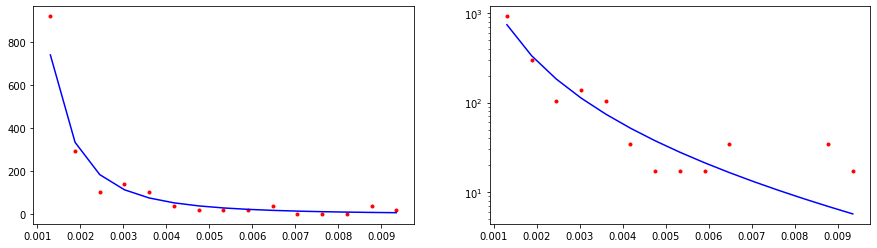

CPU times: user 712 µs, sys: 0 ns, total: 712 µs
Wall time: 458 µs
25643.8289258997


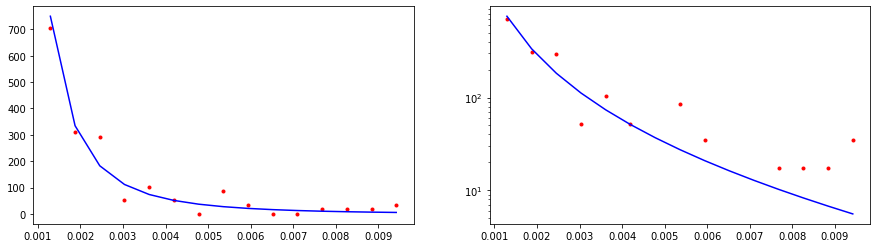

CPU times: user 0 ns, sys: 535 µs, total: 535 µs
Wall time: 360 µs
28117.82023491863


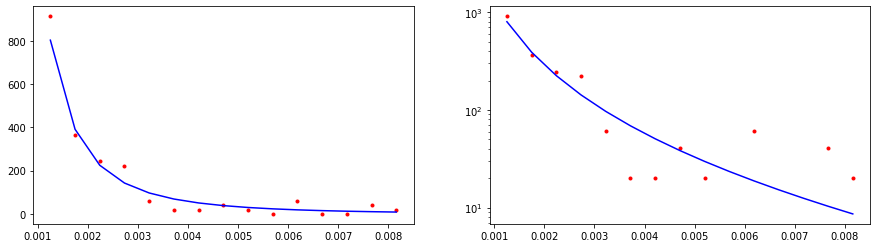

CPU times: user 435 µs, sys: 30 µs, total: 465 µs
Wall time: 350 µs
52773.23177236913


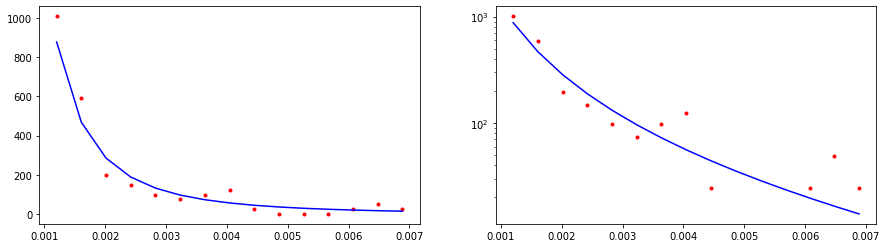

CPU times: user 568 µs, sys: 40 µs, total: 608 µs
Wall time: 433 µs
43896.73100116979


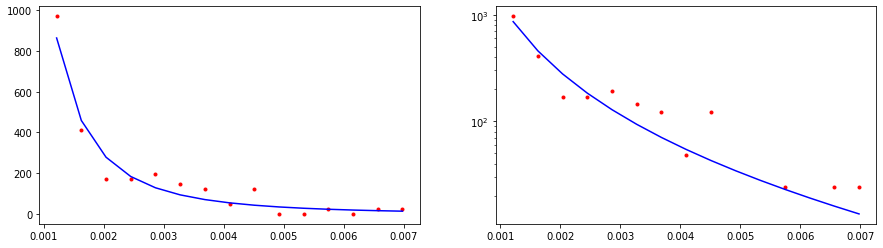

CPU times: user 627 µs, sys: 0 ns, total: 627 µs
Wall time: 437 µs
11507.51974504687


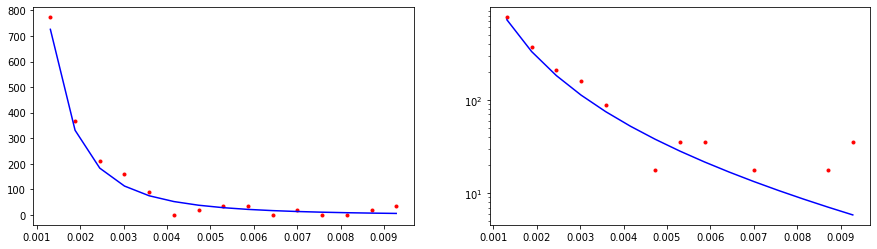

CPU times: user 582 µs, sys: 40 µs, total: 622 µs
Wall time: 443 µs
24190.986953730287


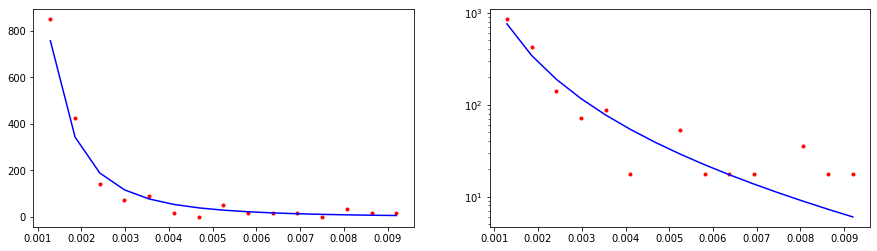

CPU times: user 647 µs, sys: 45 µs, total: 692 µs
Wall time: 512 µs
18483.041342711018


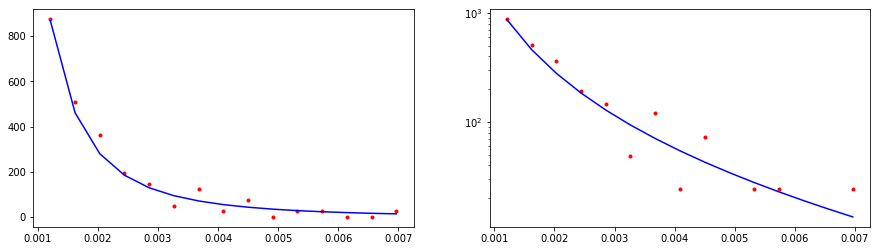

CPU times: user 839 µs, sys: 0 ns, total: 839 µs
Wall time: 666 µs
35893.11295785093


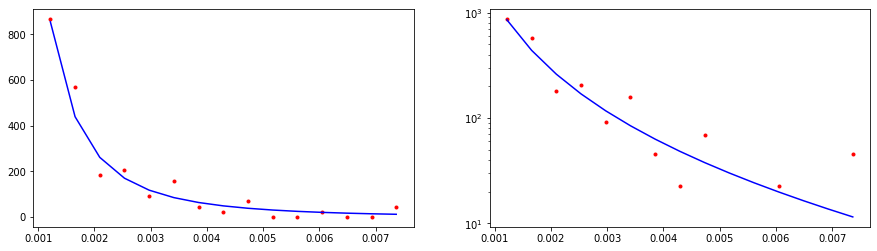

CPU times: user 966 µs, sys: 0 ns, total: 966 µs
Wall time: 776 µs
20931.18308121409


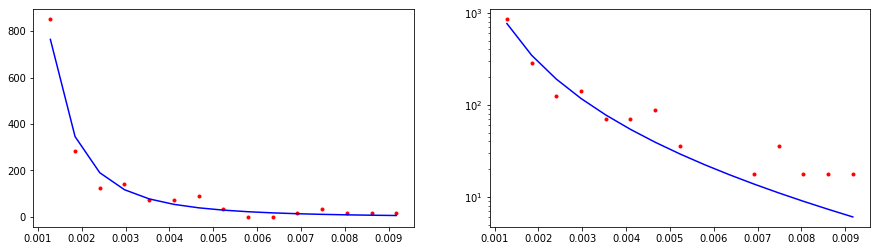

CPU times: user 1.15 ms, sys: 11 µs, total: 1.16 ms
Wall time: 995 µs
32436.640846197693


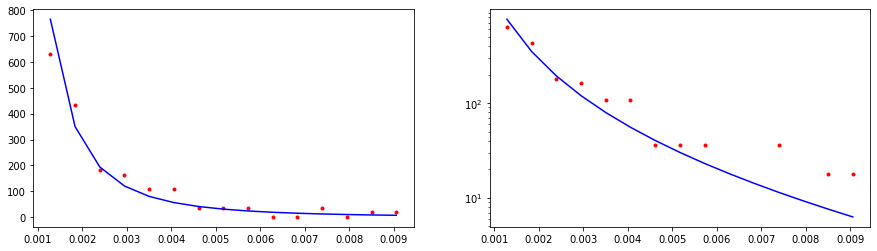

CPU times: user 1.27 ms, sys: 20 µs, total: 1.29 ms
Wall time: 1.08 ms
19966.305508717847


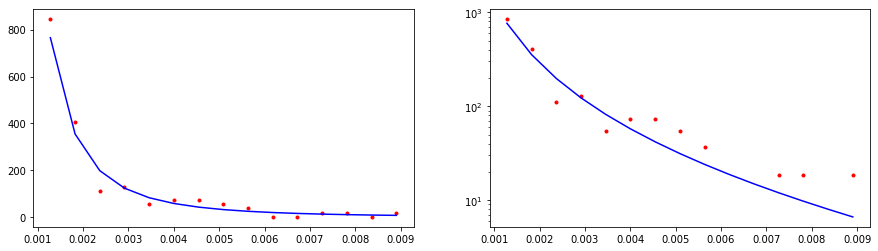

CPU times: user 1.53 ms, sys: 0 ns, total: 1.53 ms
Wall time: 1.34 ms
32193.603921678645


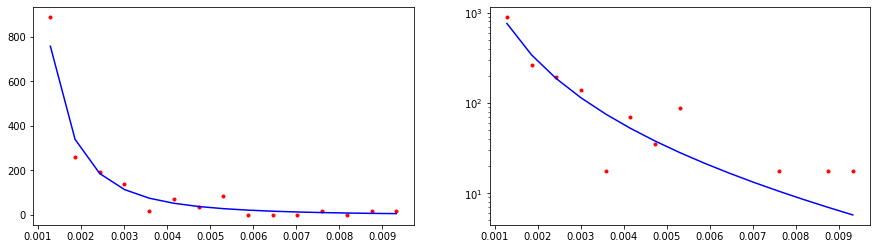

CPU times: user 811 µs, sys: 884 µs, total: 1.69 ms
Wall time: 1.49 ms
113063.99918386858


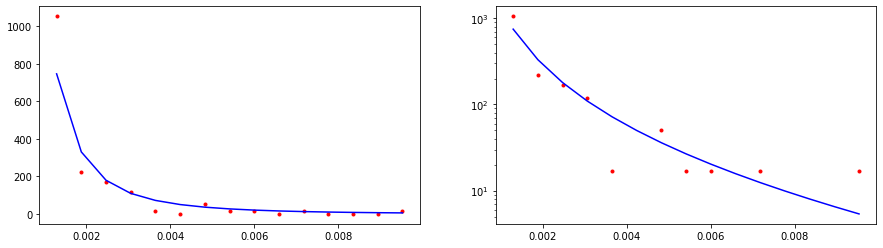

CPU times: user 1.75 ms, sys: 0 ns, total: 1.75 ms
Wall time: 1.56 ms
27521.7527213049


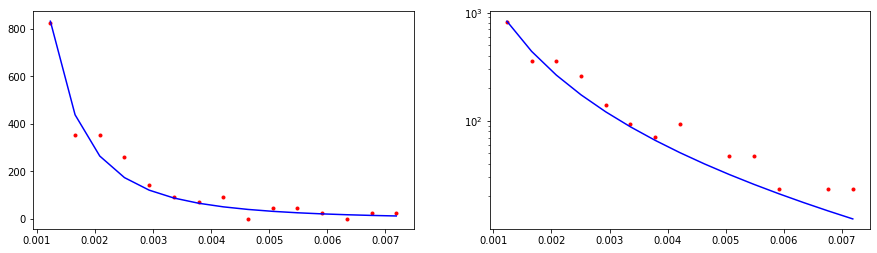

CPU times: user 2 ms, sys: 0 ns, total: 2 ms
Wall time: 1.81 ms
25199.14348792767


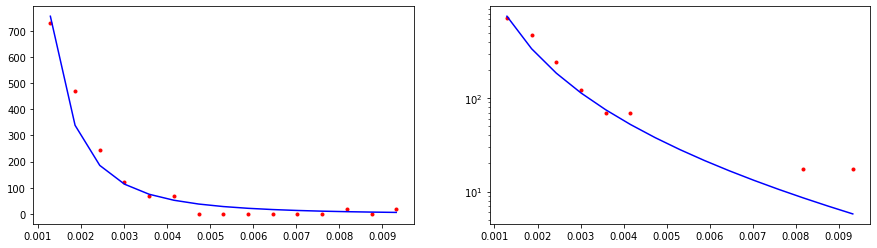

CPU times: user 646 µs, sys: 46 µs, total: 692 µs
Wall time: 443 µs
31282.125344171473


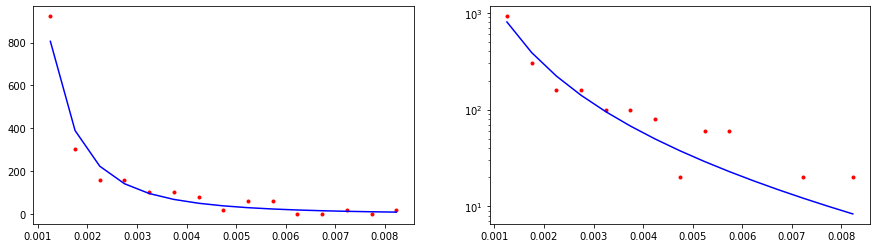

CPU times: user 0 ns, sys: 539 µs, total: 539 µs
Wall time: 353 µs
27079.533400344375


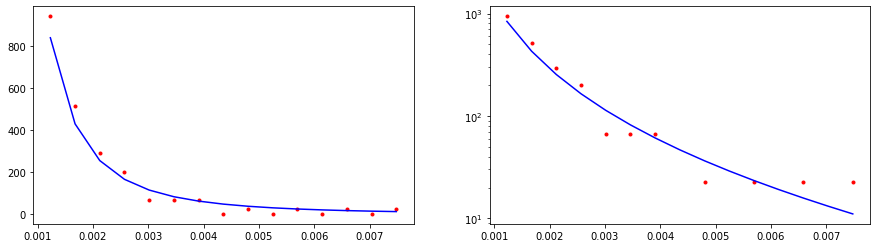

CPU times: user 499 µs, sys: 36 µs, total: 535 µs
Wall time: 362 µs
17072.623270559787


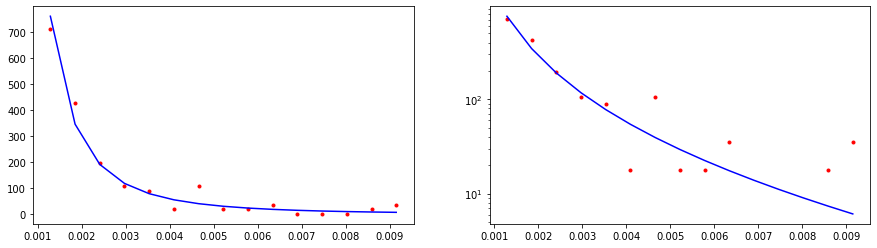

CPU times: user 453 µs, sys: 32 µs, total: 485 µs
Wall time: 323 µs
23076.962542786387


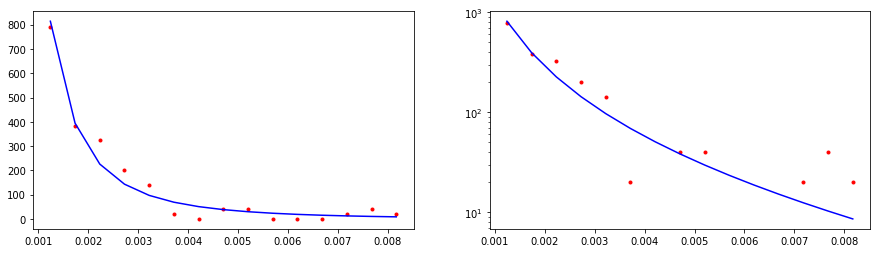

CPU times: user 556 µs, sys: 40 µs, total: 596 µs
Wall time: 418 µs
20167.7824076207


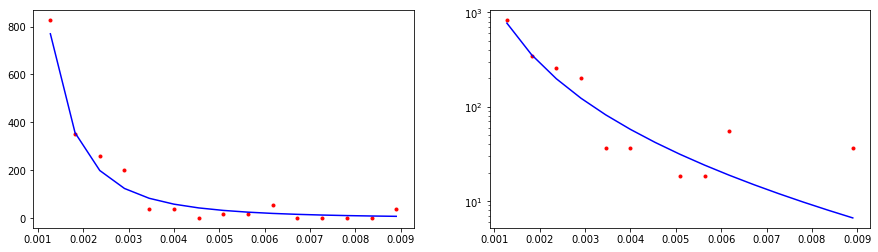

CPU times: user 646 µs, sys: 0 ns, total: 646 µs
Wall time: 475 µs
26056.714956249296


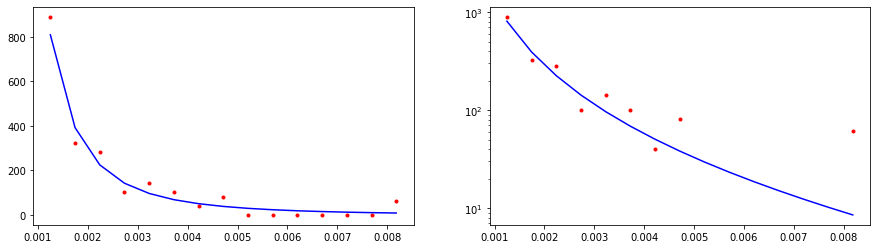

CPU times: user 689 µs, sys: 0 ns, total: 689 µs
Wall time: 516 µs
21903.85625819307


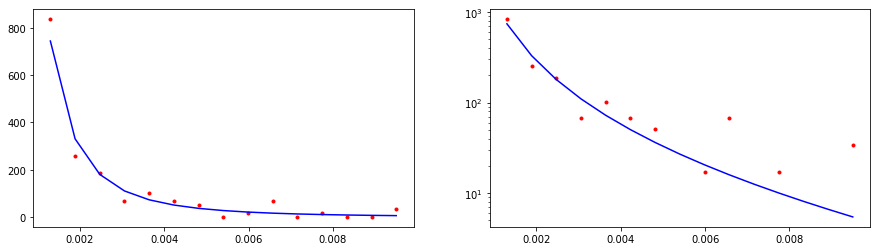

CPU times: user 867 µs, sys: 0 ns, total: 867 µs
Wall time: 696 µs
23743.541487265033


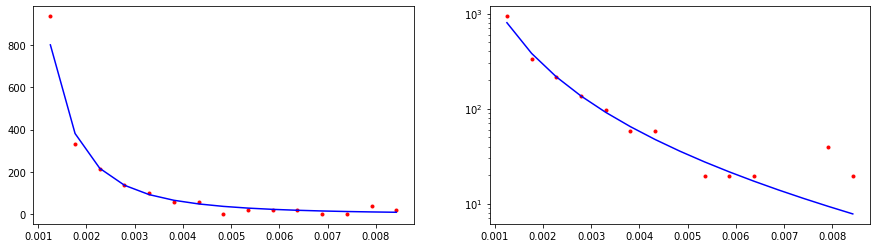

CPU times: user 965 µs, sys: 0 ns, total: 965 µs
Wall time: 851 µs
44720.71285976851


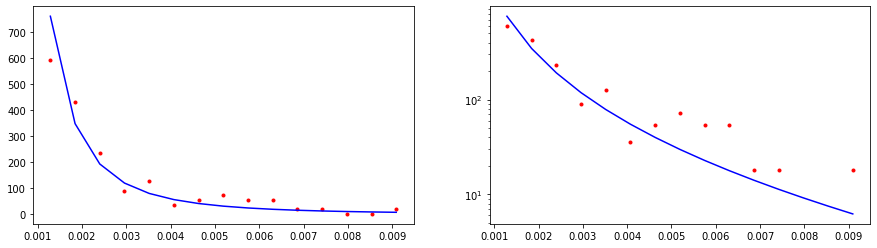

CPU times: user 164 µs, sys: 1.01 ms, total: 1.17 ms
Wall time: 978 µs
57901.4285750037


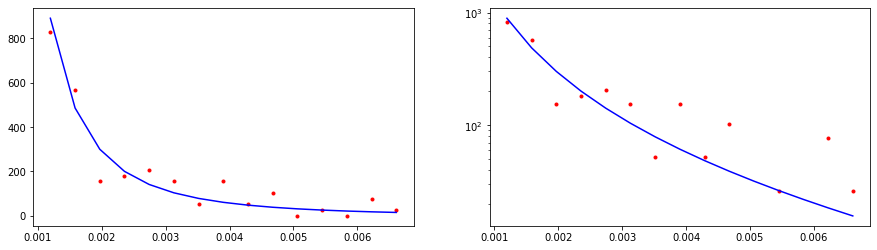

CPU times: user 1.22 ms, sys: 16 µs, total: 1.23 ms
Wall time: 1.14 ms
89211.424424043


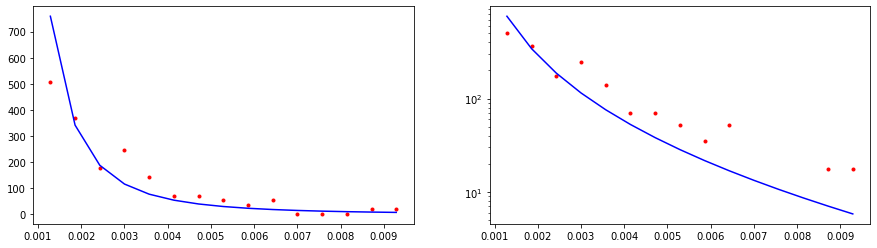

CPU times: user 1.41 ms, sys: 0 ns, total: 1.41 ms
Wall time: 1.24 ms
9459.280591415849


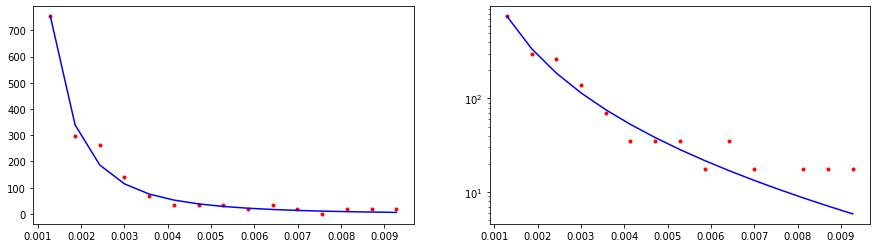

CPU times: user 1.58 ms, sys: 42 µs, total: 1.62 ms
Wall time: 1.44 ms
74877.94094661948


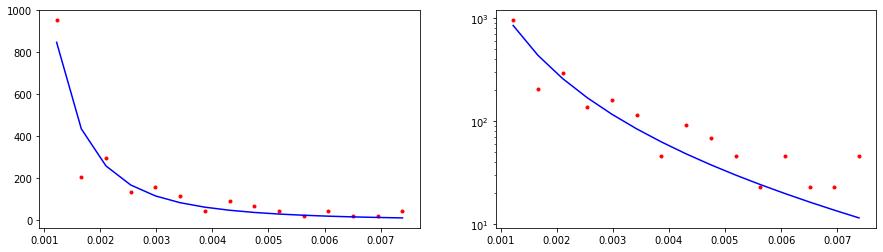

CPU times: user 862 µs, sys: 924 µs, total: 1.79 ms
Wall time: 1.62 ms
16529.465032010317


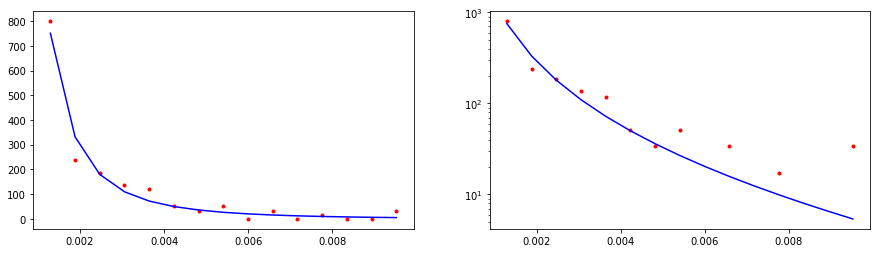

CPU times: user 1.99 ms, sys: 12 µs, total: 2 ms
Wall time: 1.77 ms
95181.78821424028


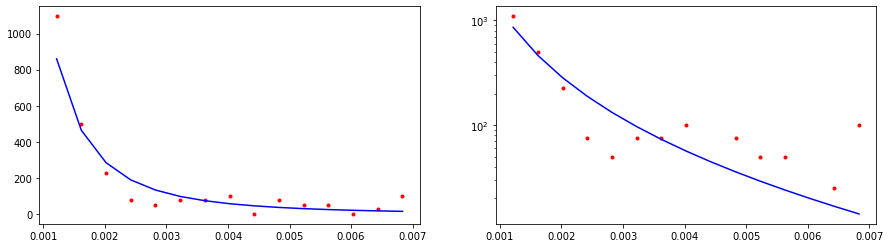

CPU times: user 686 µs, sys: 0 ns, total: 686 µs
Wall time: 447 µs
12140.301381051255


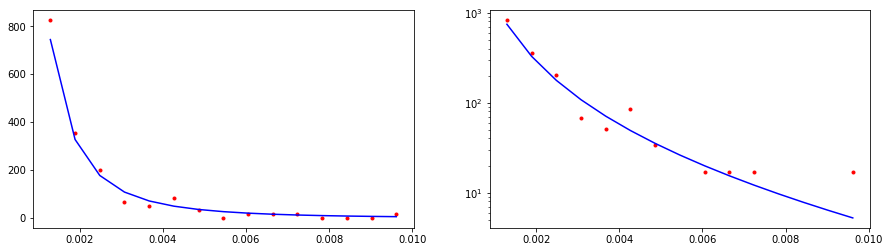

CPU times: user 0 ns, sys: 512 µs, total: 512 µs
Wall time: 341 µs
22307.150707482335


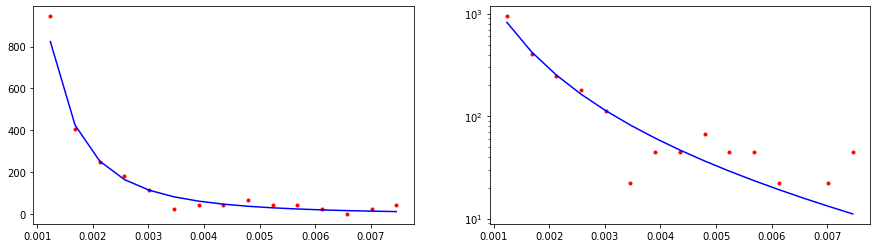

CPU times: user 508 µs, sys: 37 µs, total: 545 µs
Wall time: 369 µs
16564.10685511324


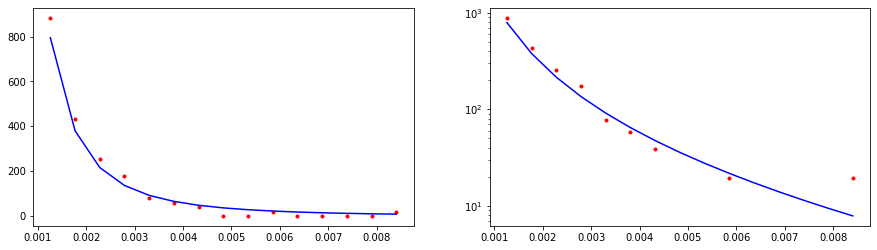

CPU times: user 528 µs, sys: 38 µs, total: 566 µs
Wall time: 383 µs
53314.68860236913


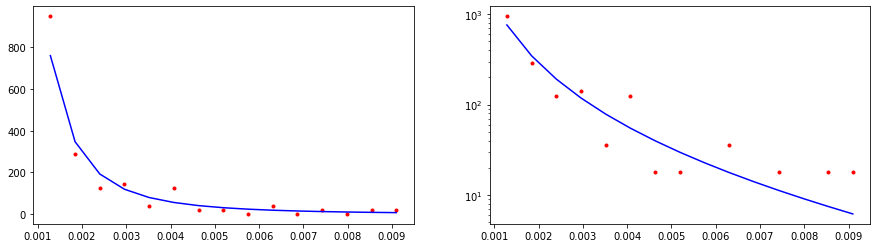

CPU times: user 616 µs, sys: 0 ns, total: 616 µs
Wall time: 443 µs
39495.669564766955


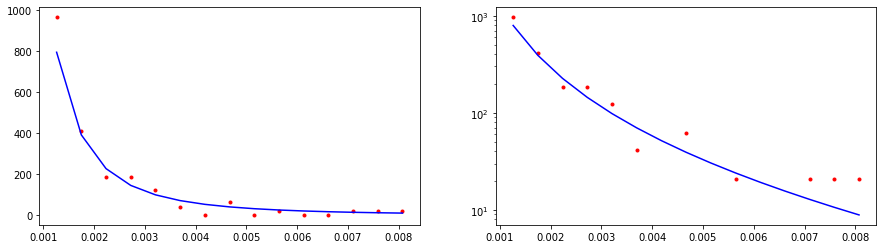

CPU times: user 595 µs, sys: 43 µs, total: 638 µs
Wall time: 465 µs
36804.484497037156


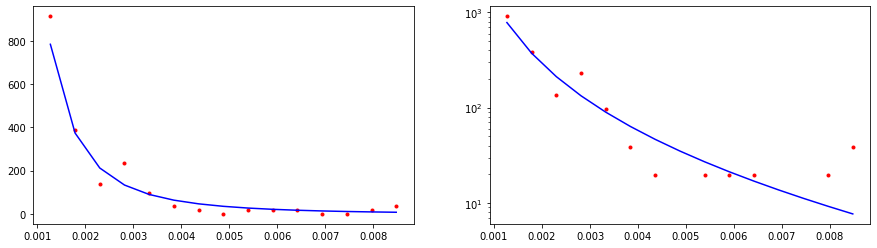

CPU times: user 690 µs, sys: 0 ns, total: 690 µs
Wall time: 519 µs
43441.75739610705


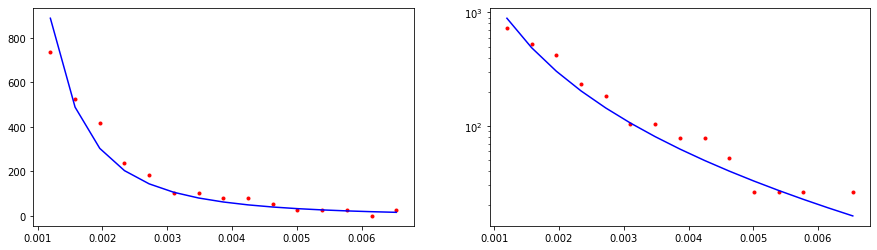

CPU times: user 729 µs, sys: 0 ns, total: 729 µs
Wall time: 616 µs
34533.17326297307


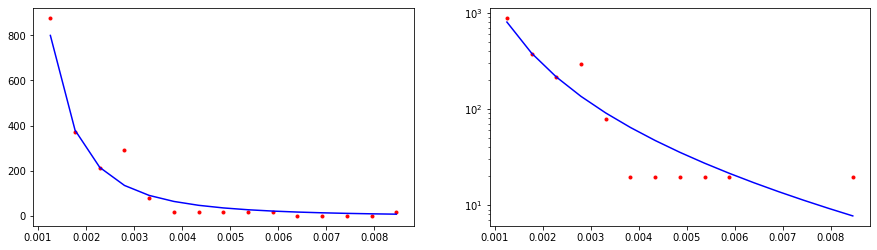

CPU times: user 61 µs, sys: 993 µs, total: 1.05 ms
Wall time: 873 µs
30814.027340506553


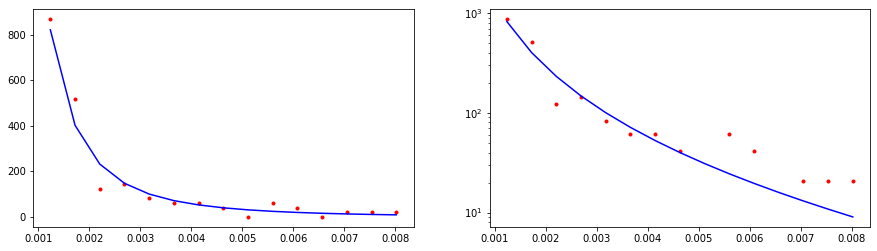

CPU times: user 326 µs, sys: 869 µs, total: 1.2 ms
Wall time: 1.01 ms
89875.49602550194


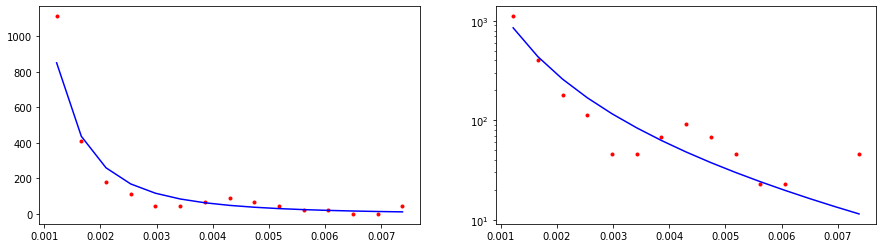

CPU times: user 1.37 ms, sys: 27 µs, total: 1.39 ms
Wall time: 1.21 ms
119871.48953271864


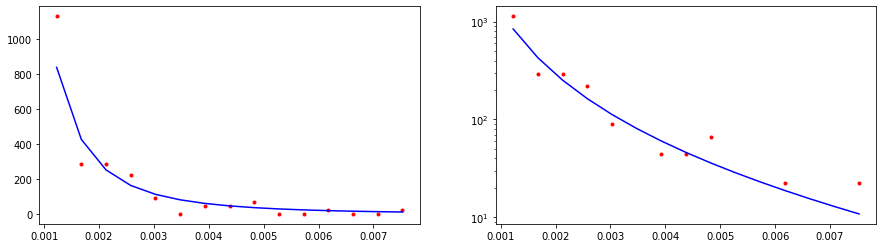

CPU times: user 1.52 ms, sys: 38 µs, total: 1.56 ms
Wall time: 1.37 ms
50894.86126558636


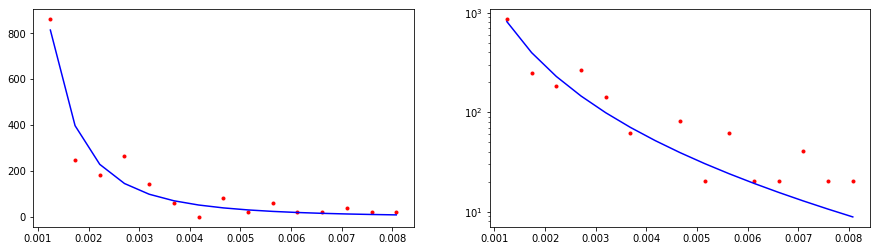

CPU times: user 1.66 ms, sys: 0 ns, total: 1.66 ms
Wall time: 1.47 ms
46652.84711533627


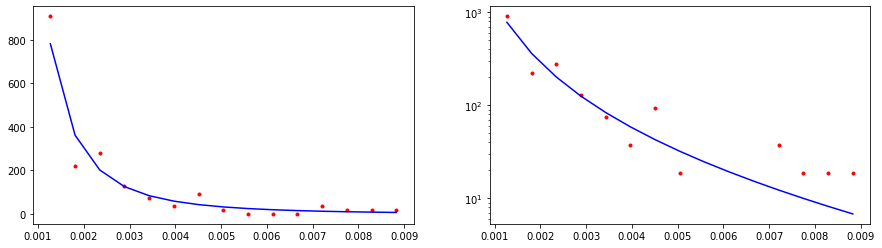

CPU times: user 1.84 ms, sys: 0 ns, total: 1.84 ms
Wall time: 1.66 ms
24971.3212833865


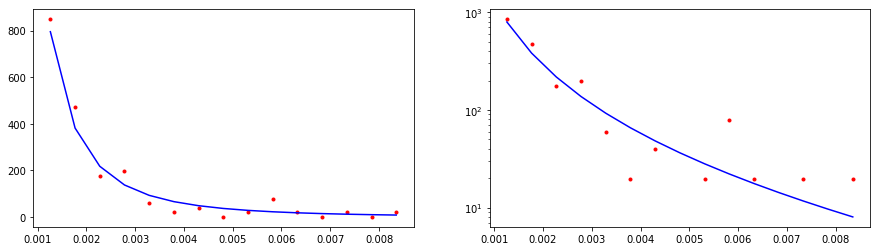

CPU times: user 1.99 ms, sys: 0 ns, total: 1.99 ms
Wall time: 1.78 ms
40194.709419463376


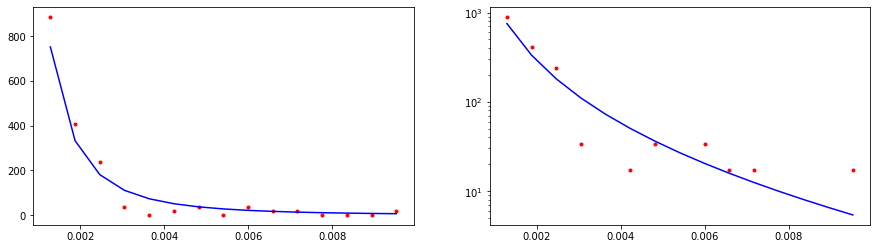

CPU times: user 0 ns, sys: 684 µs, total: 684 µs
Wall time: 437 µs
38938.68748600606


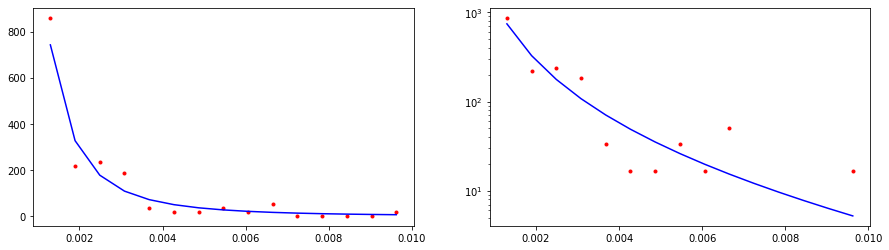

CPU times: user 515 µs, sys: 0 ns, total: 515 µs
Wall time: 343 µs
66790.02495691826


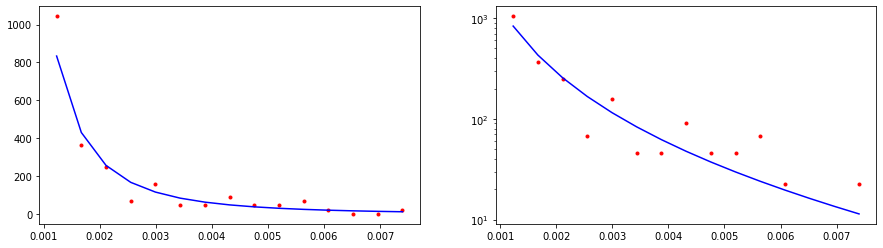

CPU times: user 497 µs, sys: 37 µs, total: 534 µs
Wall time: 359 µs
16681.031962429286


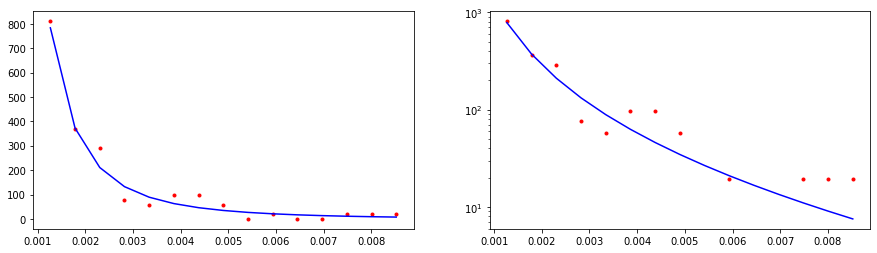

CPU times: user 0 ns, sys: 587 µs, total: 587 µs
Wall time: 417 µs
20907.036169555457


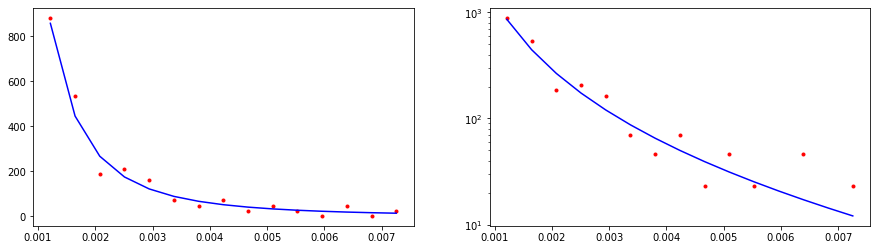

CPU times: user 638 µs, sys: 0 ns, total: 638 µs
Wall time: 456 µs
32446.730768203153


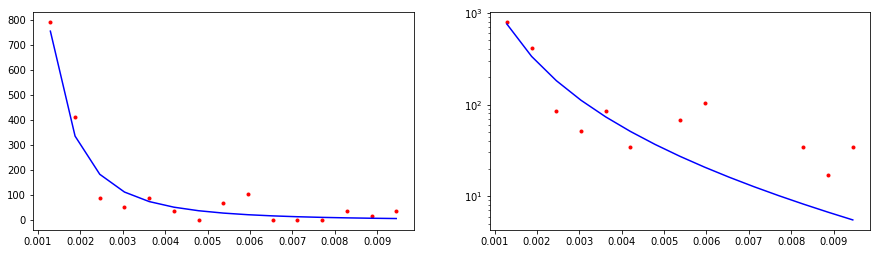

CPU times: user 613 µs, sys: 46 µs, total: 659 µs
Wall time: 470 µs
6180.09795174285


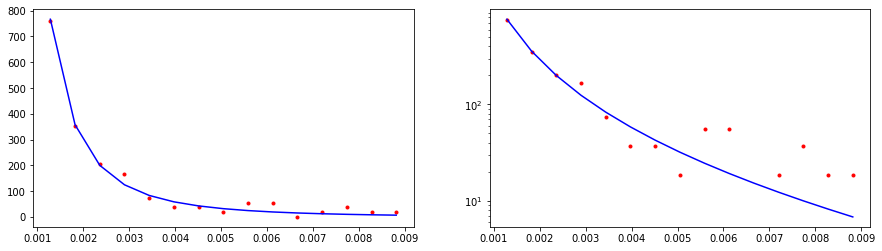

CPU times: user 679 µs, sys: 0 ns, total: 679 µs
Wall time: 494 µs
35189.49695627341


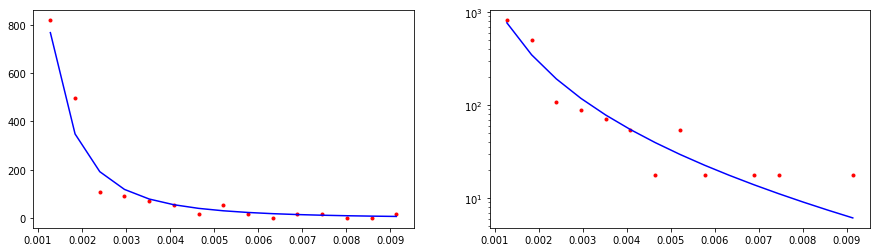

CPU times: user 764 µs, sys: 57 µs, total: 821 µs
Wall time: 640 µs
147534.92646693942


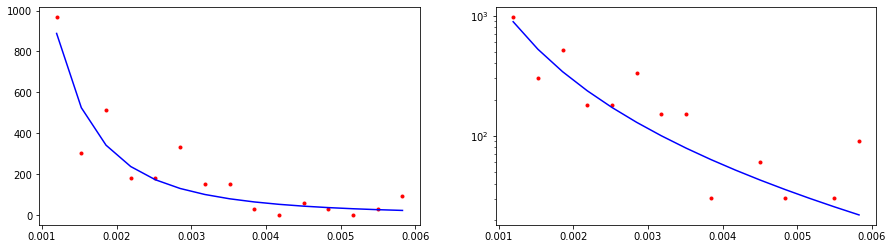

CPU times: user 952 µs, sys: 0 ns, total: 952 µs
Wall time: 783 µs
82432.37255409348


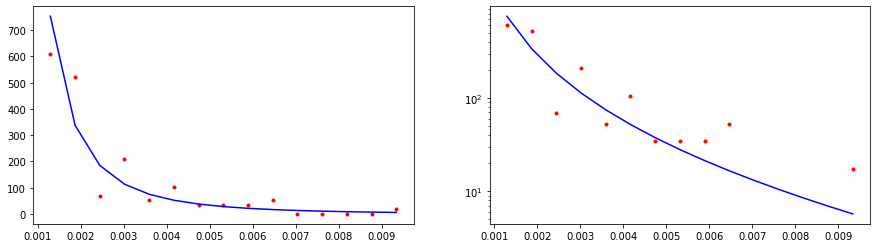

CPU times: user 257 µs, sys: 790 µs, total: 1.05 ms
Wall time: 870 µs
7844.366043023561


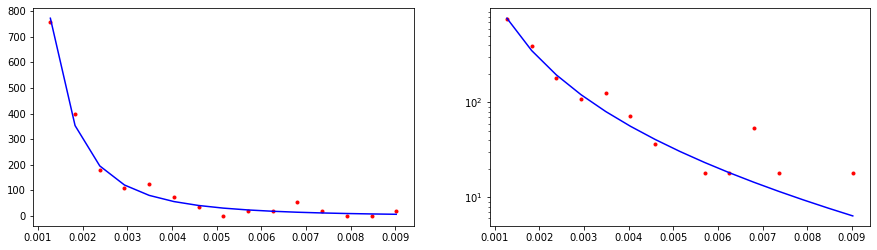

CPU times: user 417 µs, sys: 922 µs, total: 1.34 ms
Wall time: 1.13 ms
20590.18296112108


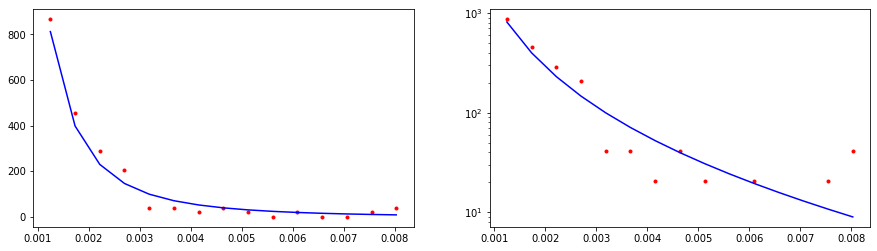

CPU times: user 1.53 ms, sys: 41 µs, total: 1.58 ms
Wall time: 1.39 ms
18875.036254807146


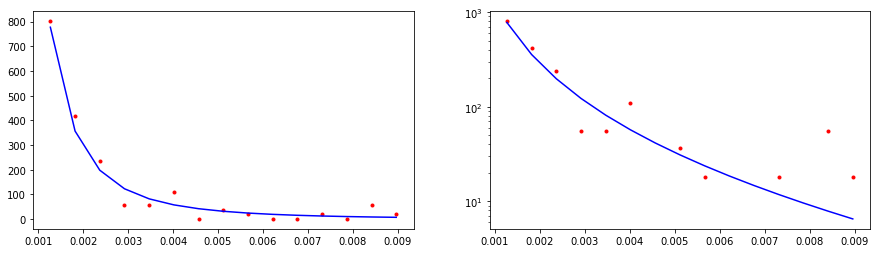

CPU times: user 1.73 ms, sys: 0 ns, total: 1.73 ms
Wall time: 1.54 ms
25335.35969611928


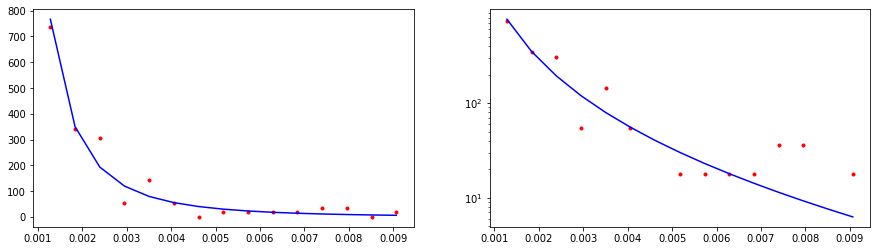

CPU times: user 1.85 ms, sys: 0 ns, total: 1.85 ms
Wall time: 1.63 ms
33824.314229288495


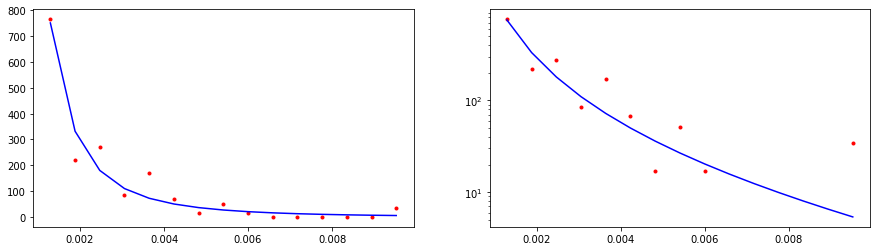

CPU times: user 1.89 ms, sys: 3 µs, total: 1.89 ms
Wall time: 1.71 ms
45728.302790094865


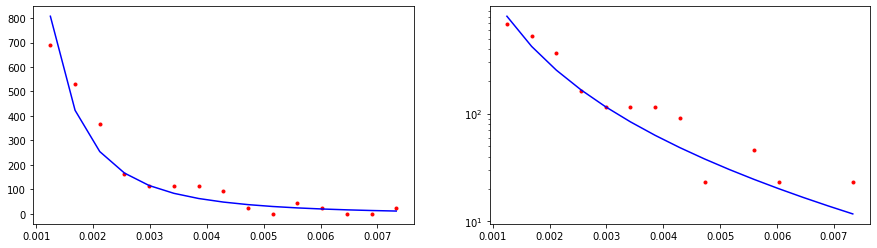

CPU times: user 479 µs, sys: 37 µs, total: 516 µs
Wall time: 405 µs
29771.842600037693


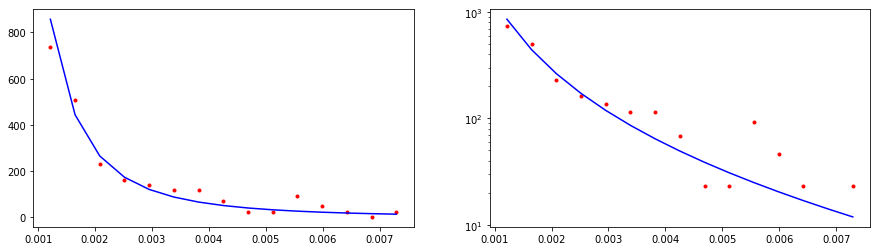

CPU times: user 524 µs, sys: 0 ns, total: 524 µs
Wall time: 340 µs
42229.91868909498


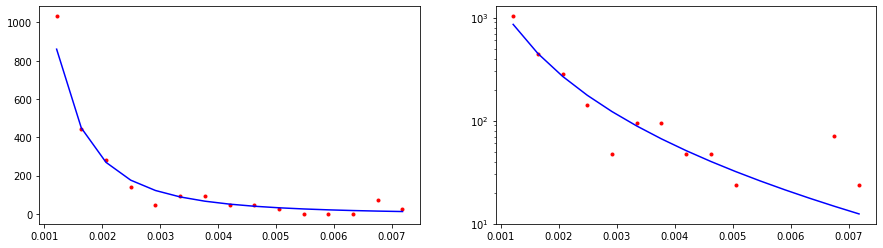

CPU times: user 531 µs, sys: 0 ns, total: 531 µs
Wall time: 345 µs
80710.71964287927


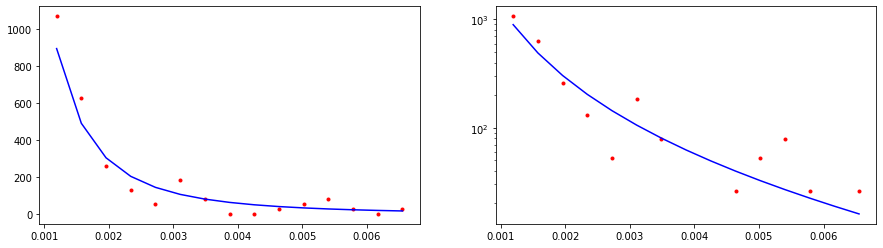

CPU times: user 0 ns, sys: 565 µs, total: 565 µs
Wall time: 392 µs
12122.728095173585


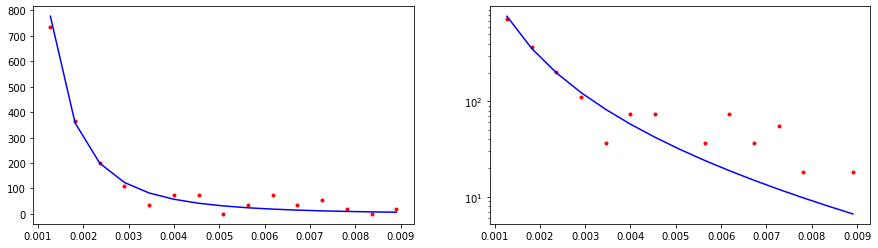

CPU times: user 528 µs, sys: 41 µs, total: 569 µs
Wall time: 399 µs
10580.750728851817


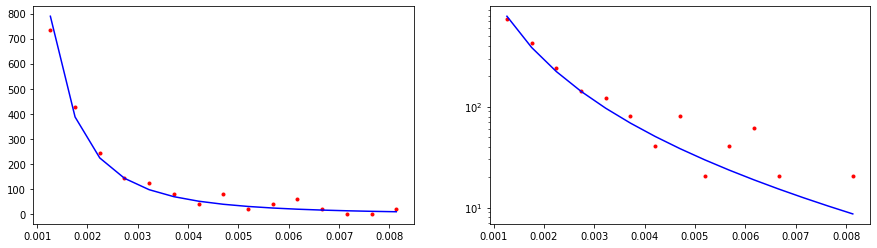

CPU times: user 0 ns, sys: 682 µs, total: 682 µs
Wall time: 503 µs
12486.149743221828


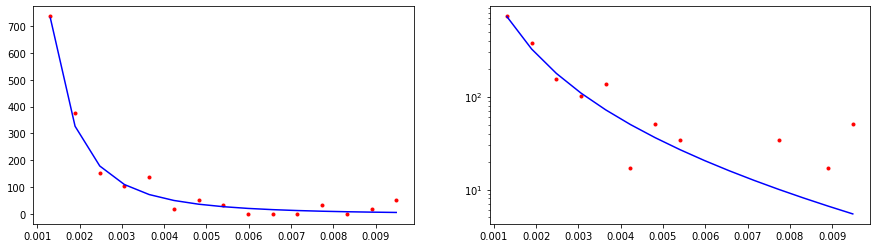

CPU times: user 0 ns, sys: 721 µs, total: 721 µs
Wall time: 526 µs
28751.137953638456


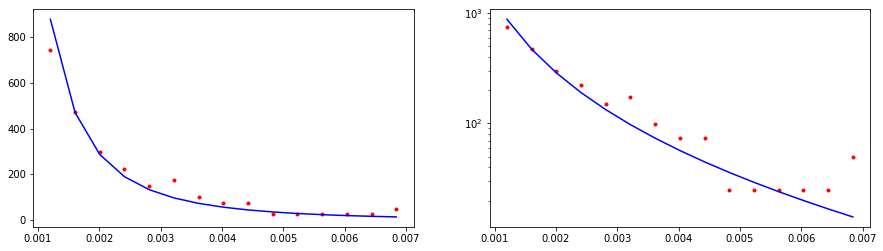

CPU times: user 819 µs, sys: 0 ns, total: 819 µs
Wall time: 628 µs
10812.797334883122


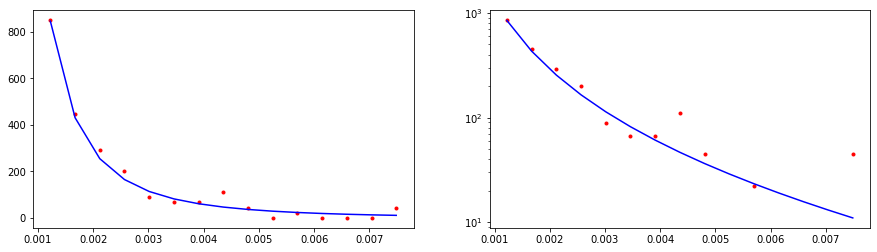

CPU times: user 1.05 ms, sys: 10 µs, total: 1.06 ms
Wall time: 874 µs
30908.44731898794


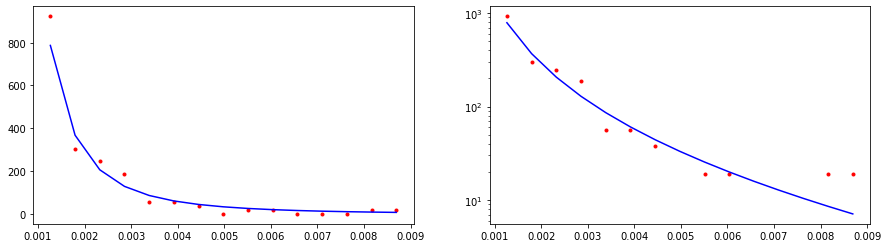

CPU times: user 1.11 ms, sys: 9 µs, total: 1.12 ms
Wall time: 934 µs
20669.446182636868


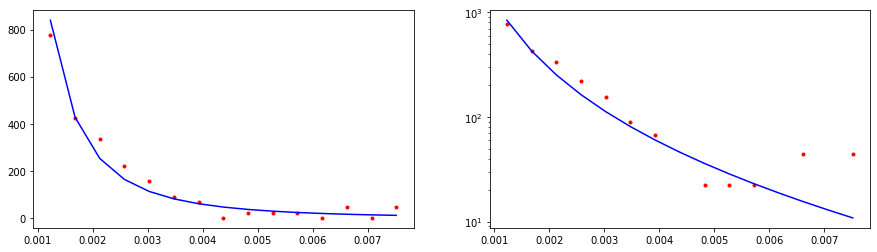

CPU times: user 1.33 ms, sys: 25 µs, total: 1.35 ms
Wall time: 1.13 ms
63852.99312316882


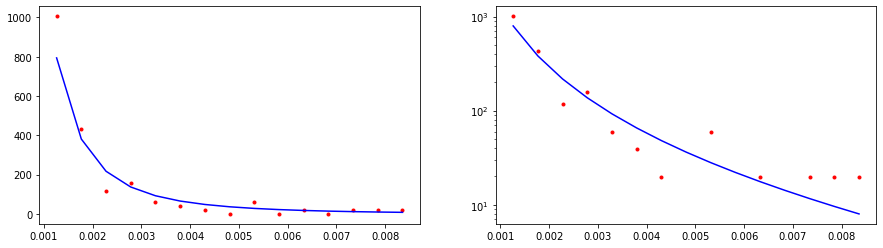

CPU times: user 1.52 ms, sys: 40 µs, total: 1.56 ms
Wall time: 1.37 ms
10361.325958536561


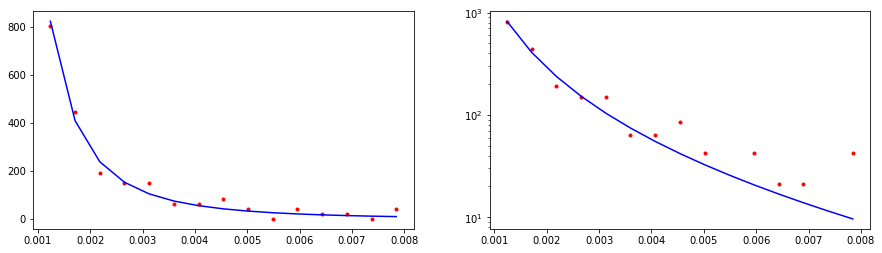

CPU times: user 1.67 ms, sys: 0 ns, total: 1.67 ms
Wall time: 1.48 ms
18829.920715658543


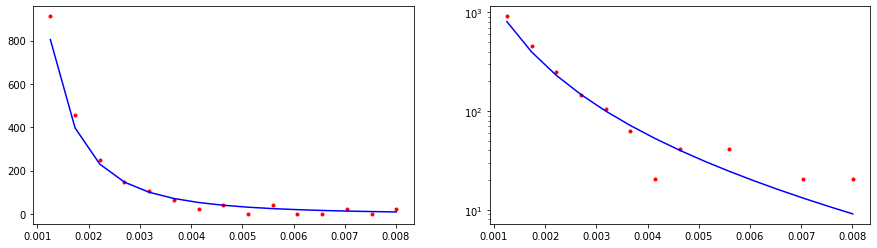

CPU times: user 1.68 ms, sys: 53 µs, total: 1.73 ms
Wall time: 1.54 ms
17095.691512318812


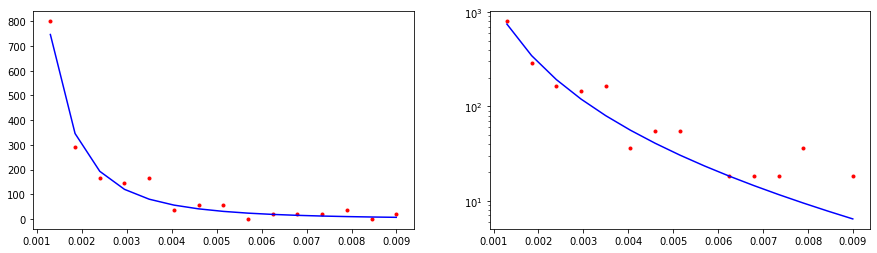

CPU times: user 1.82 ms, sys: 64 µs, total: 1.88 ms
Wall time: 1.68 ms
23198.874266590105


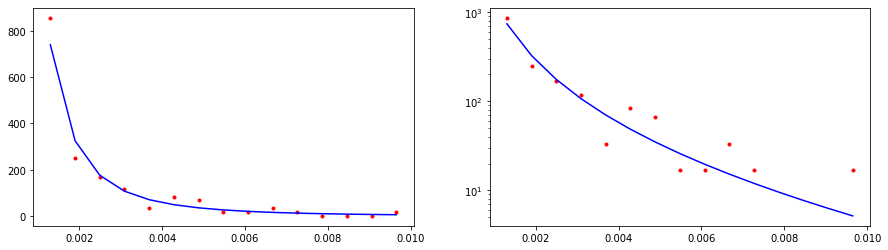

CPU times: user 642 µs, sys: 50 µs, total: 692 µs
Wall time: 451 µs
18649.760250166106


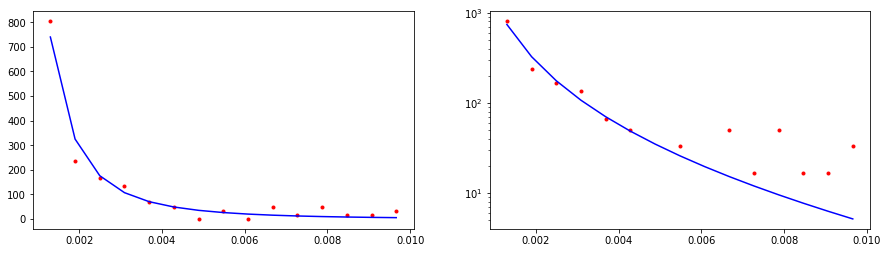

CPU times: user 445 µs, sys: 34 µs, total: 479 µs
Wall time: 306 µs
25006.476002693977


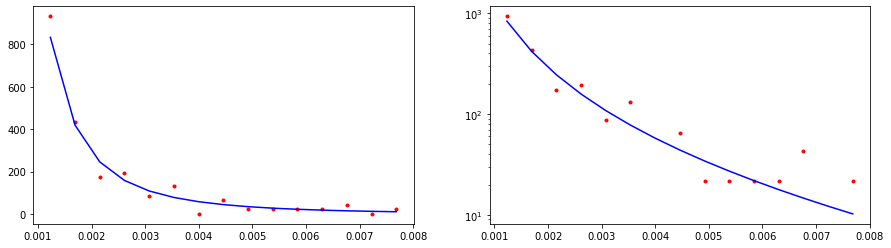

CPU times: user 0 ns, sys: 586 µs, total: 586 µs
Wall time: 365 µs
38643.784509069585


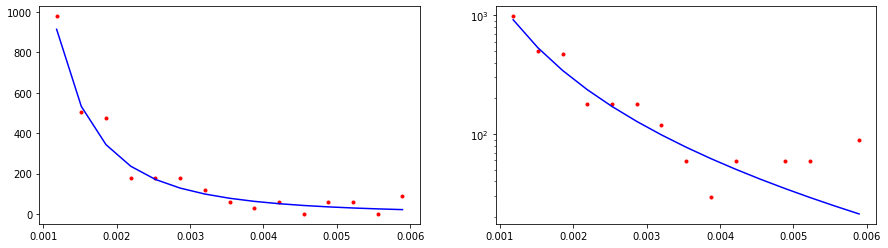

CPU times: user 481 µs, sys: 38 µs, total: 519 µs
Wall time: 362 µs
16625.77450660902


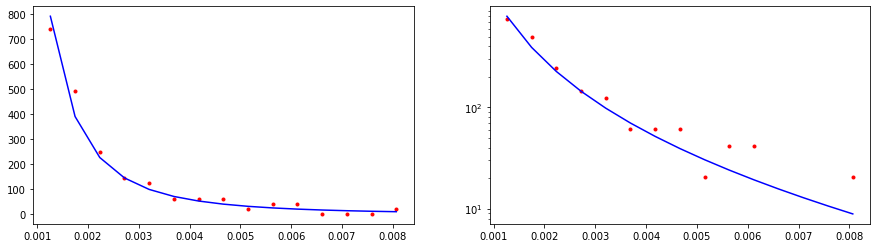

CPU times: user 610 µs, sys: 0 ns, total: 610 µs
Wall time: 421 µs
21581.075453175414


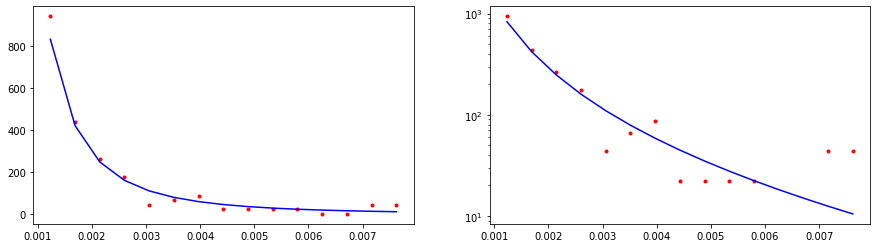

CPU times: user 593 µs, sys: 46 µs, total: 639 µs
Wall time: 467 µs
54710.394701764504


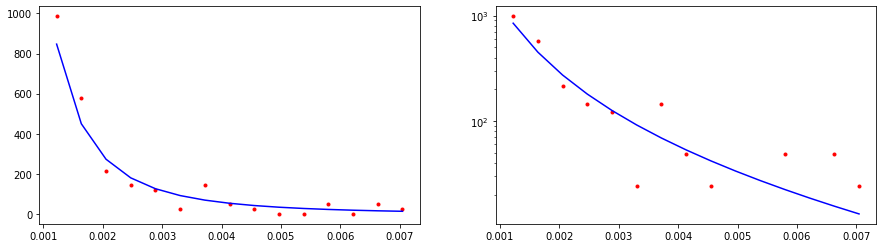

CPU times: user 630 µs, sys: 0 ns, total: 630 µs
Wall time: 470 µs
177681.397280842


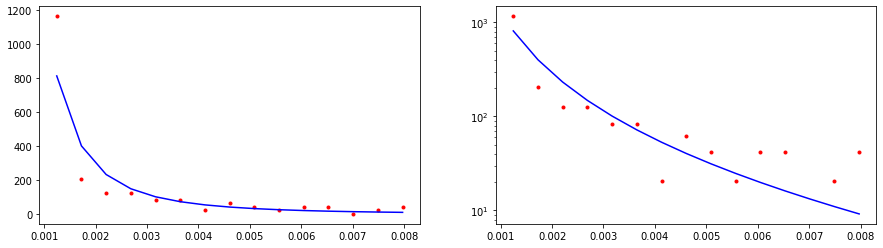

CPU times: user 45 µs, sys: 831 µs, total: 876 µs
Wall time: 693 µs
45668.205191353896


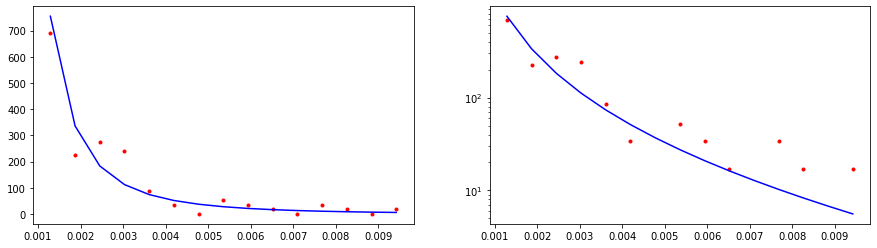

CPU times: user 986 µs, sys: 0 ns, total: 986 µs
Wall time: 811 µs
10563.600953613426


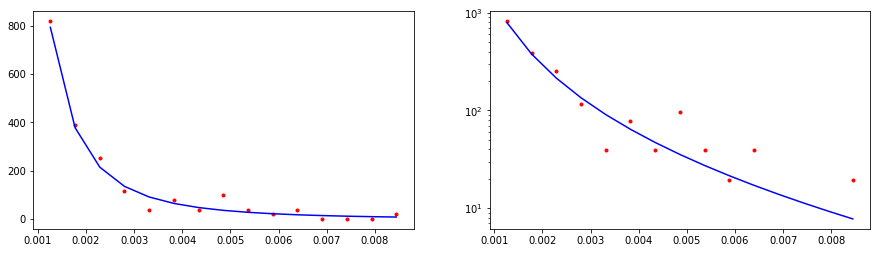

CPU times: user 1.2 ms, sys: 16 µs, total: 1.21 ms
Wall time: 1.04 ms
28044.56050200874


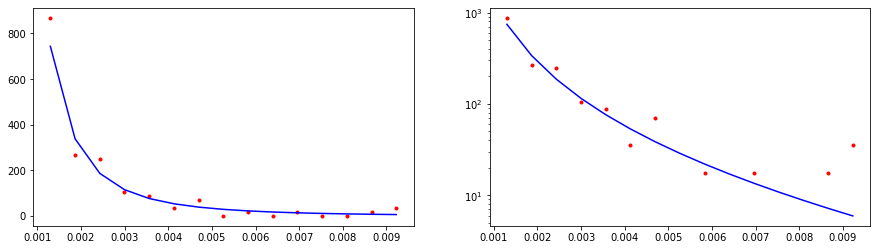

CPU times: user 1.37 ms, sys: 0 ns, total: 1.37 ms
Wall time: 1.18 ms
9563.525957034668


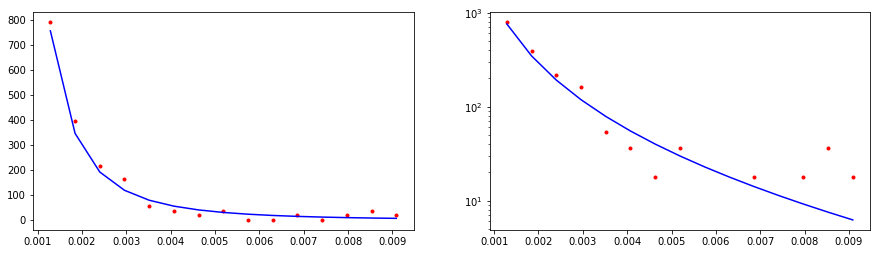

CPU times: user 1.53 ms, sys: 42 µs, total: 1.57 ms
Wall time: 1.39 ms
14471.49649036573


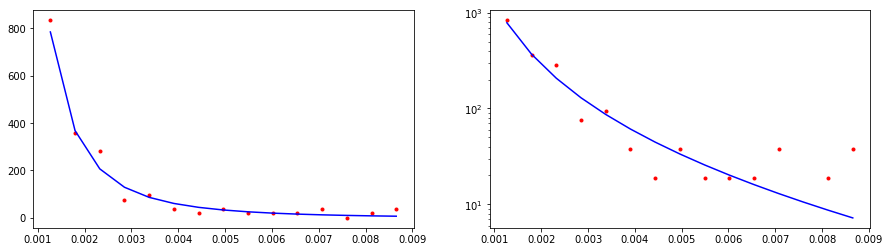

CPU times: user 785 µs, sys: 895 µs, total: 1.68 ms
Wall time: 1.49 ms
33251.781920827205


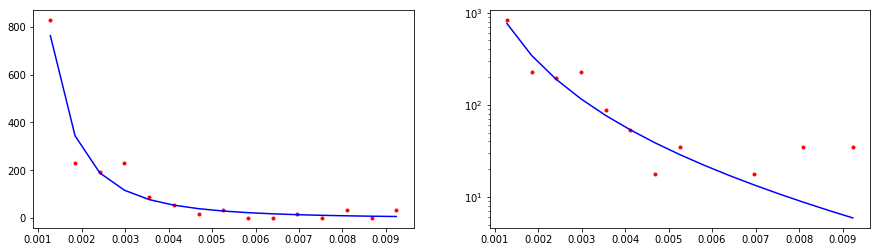

CPU times: user 946 µs, sys: 895 µs, total: 1.84 ms
Wall time: 1.64 ms
6613.4362922093915


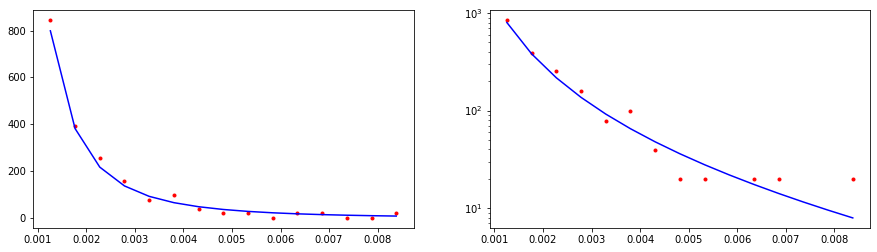

CPU times: user 1.98 ms, sys: 0 ns, total: 1.98 ms
Wall time: 1.79 ms
38716.31521444048


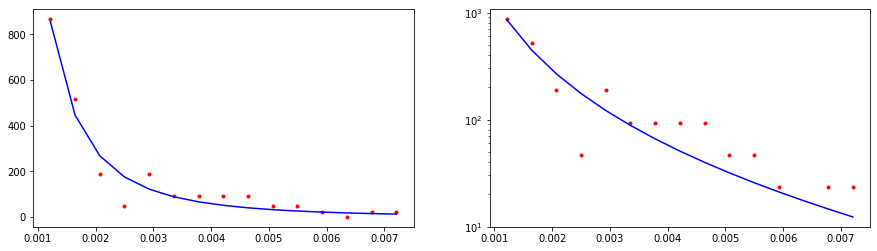

CPU times: user 682 µs, sys: 54 µs, total: 736 µs
Wall time: 473 µs
12856.844196460639


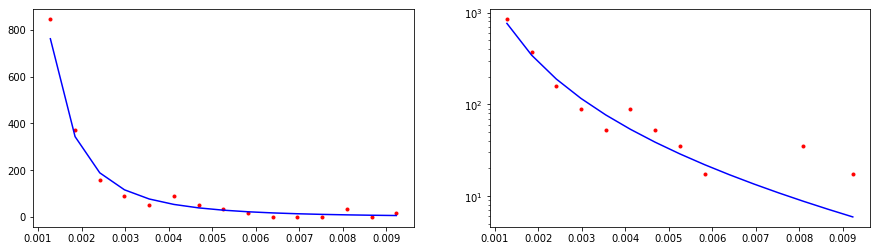

CPU times: user 444 µs, sys: 35 µs, total: 479 µs
Wall time: 304 µs
18836.38308125442


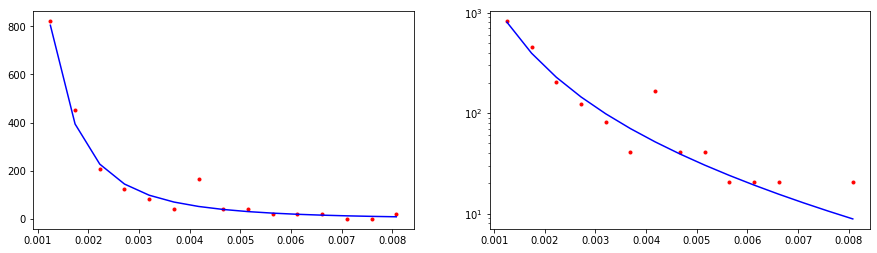

CPU times: user 462 µs, sys: 37 µs, total: 499 µs
Wall time: 334 µs
49764.87320419139


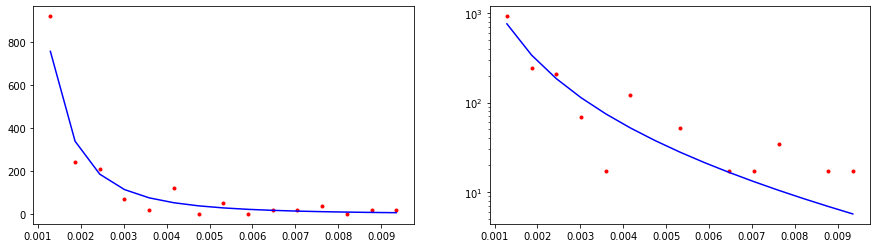

CPU times: user 576 µs, sys: 46 µs, total: 622 µs
Wall time: 409 µs
27249.615300996724


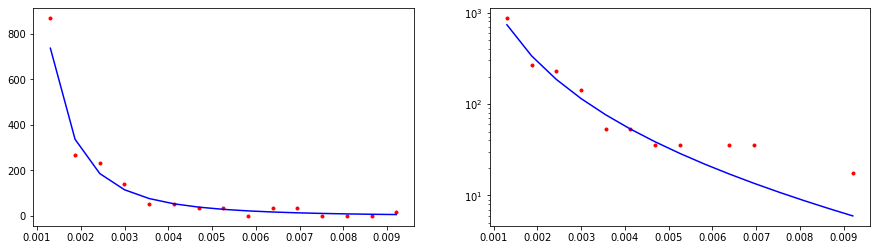

CPU times: user 512 µs, sys: 41 µs, total: 553 µs
Wall time: 392 µs
59169.71206189678


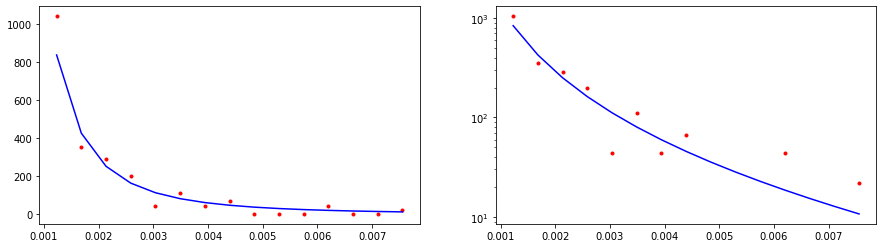

CPU times: user 660 µs, sys: 0 ns, total: 660 µs
Wall time: 483 µs
9539.673724242664


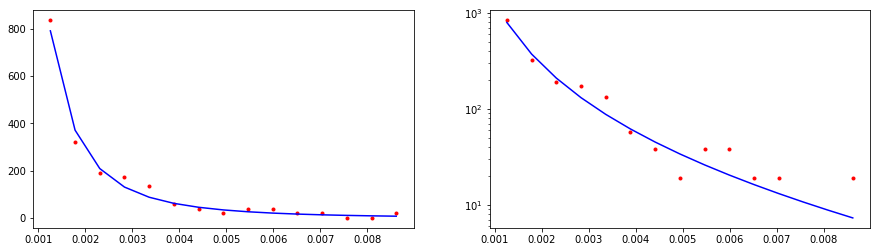

CPU times: user 648 µs, sys: 52 µs, total: 700 µs
Wall time: 523 µs
80281.7726279274


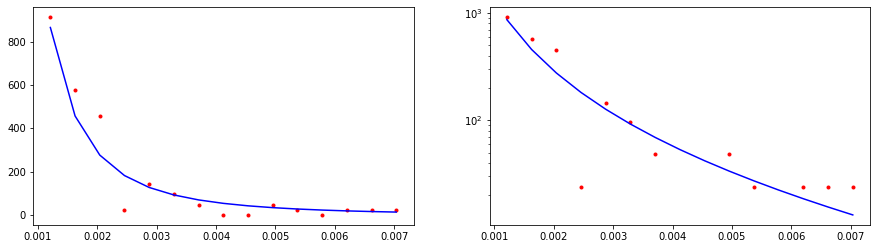

CPU times: user 719 µs, sys: 0 ns, total: 719 µs
Wall time: 621 µs
15884.717717435255


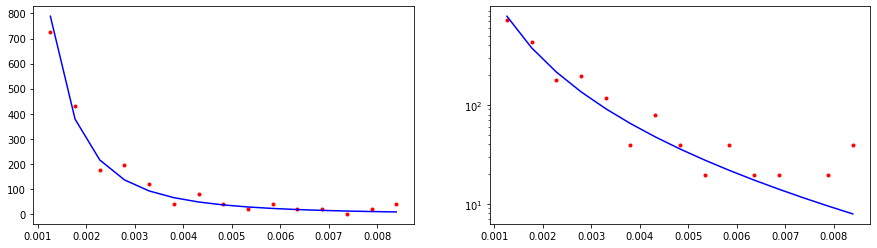

CPU times: user 970 µs, sys: 0 ns, total: 970 µs
Wall time: 789 µs
19540.73290967443


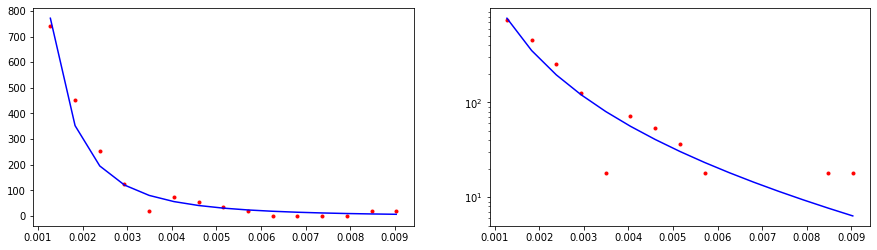

CPU times: user 192 µs, sys: 926 µs, total: 1.12 ms
Wall time: 935 µs
12875.568464425043


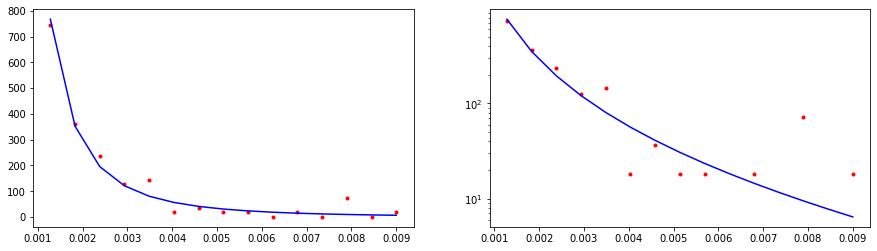

CPU times: user 1.26 ms, sys: 0 ns, total: 1.26 ms
Wall time: 1.08 ms
40501.88353368183


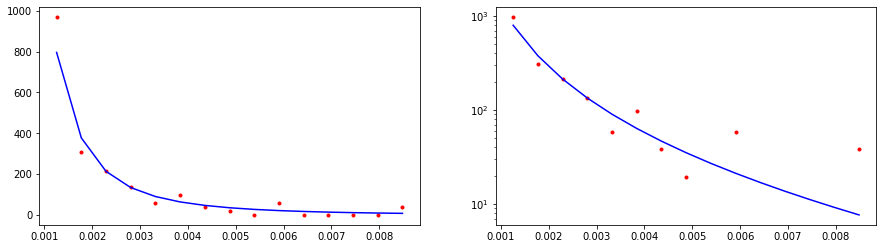

CPU times: user 1.41 ms, sys: 33 µs, total: 1.44 ms
Wall time: 1.25 ms
22611.09638476421


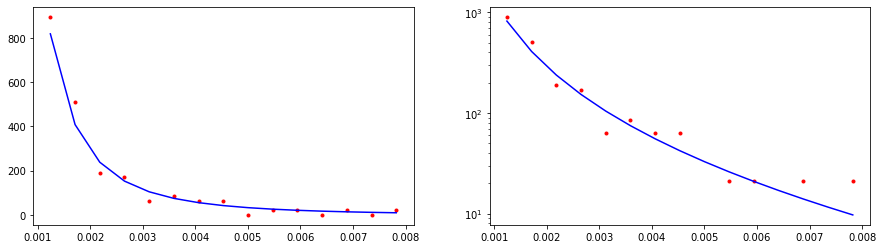

CPU times: user 774 µs, sys: 902 µs, total: 1.68 ms
Wall time: 1.48 ms
17070.934274845044


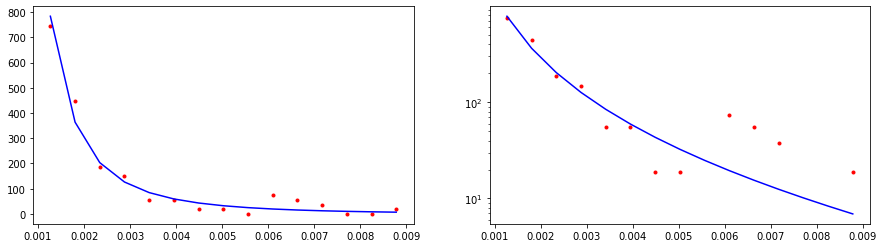

CPU times: user 1.82 ms, sys: 0 ns, total: 1.82 ms
Wall time: 1.61 ms
14294.040416606573


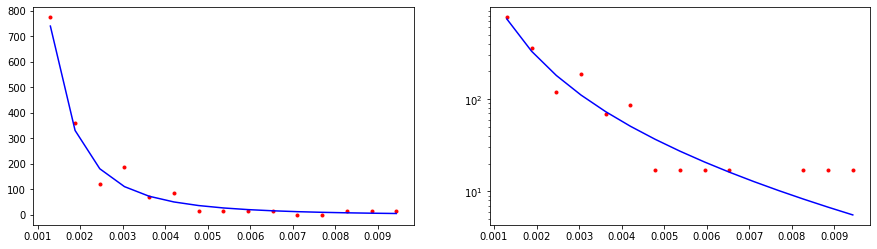

CPU times: user 1.82 ms, sys: 66 µs, total: 1.88 ms
Wall time: 1.69 ms
15989.485484627443


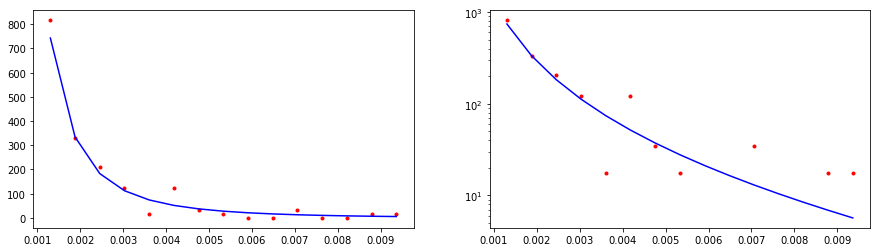

CPU times: user 642 µs, sys: 0 ns, total: 642 µs
Wall time: 408 µs
27140.156103688205


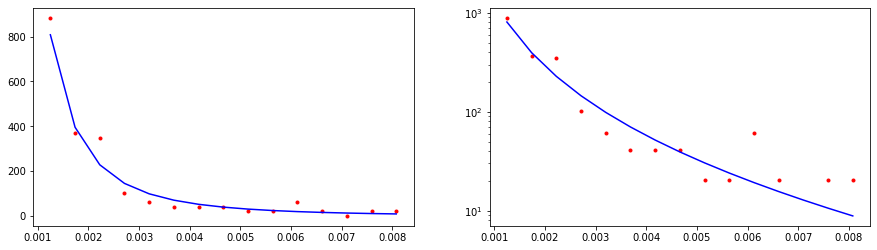

CPU times: user 480 µs, sys: 0 ns, total: 480 µs
Wall time: 343 µs
34603.899944071374


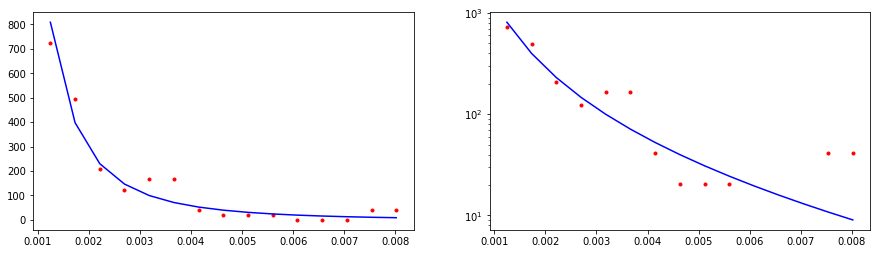

CPU times: user 531 µs, sys: 43 µs, total: 574 µs
Wall time: 390 µs
28040.041718705575


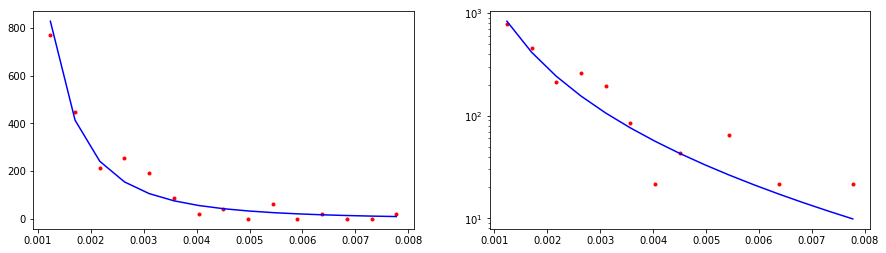

CPU times: user 522 µs, sys: 43 µs, total: 565 µs
Wall time: 390 µs
21248.753901258715


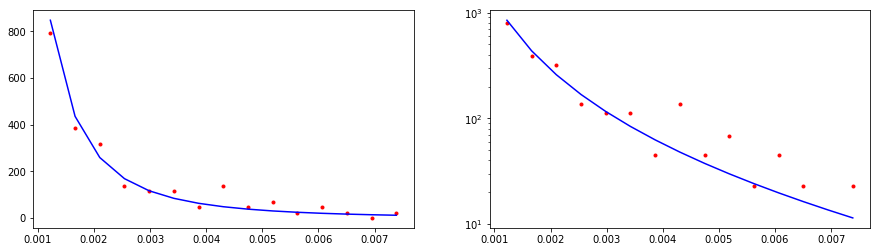

CPU times: user 563 µs, sys: 46 µs, total: 609 µs
Wall time: 431 µs
109976.4417860052


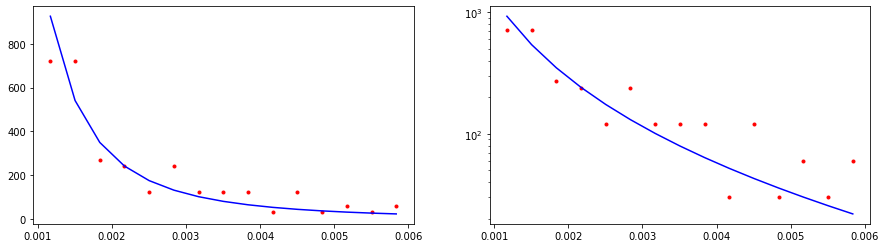

CPU times: user 610 µs, sys: 0 ns, total: 610 µs
Wall time: 439 µs
54390.16288358832


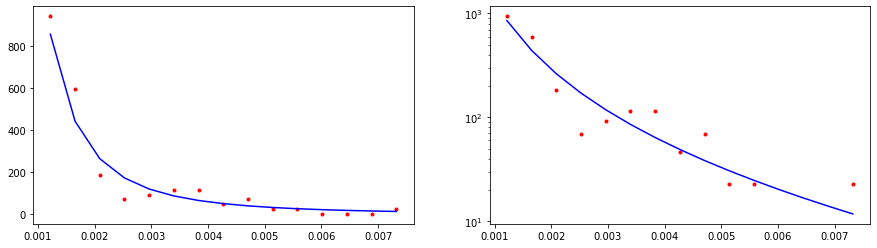

CPU times: user 0 ns, sys: 705 µs, total: 705 µs
Wall time: 518 µs
15066.209934930579


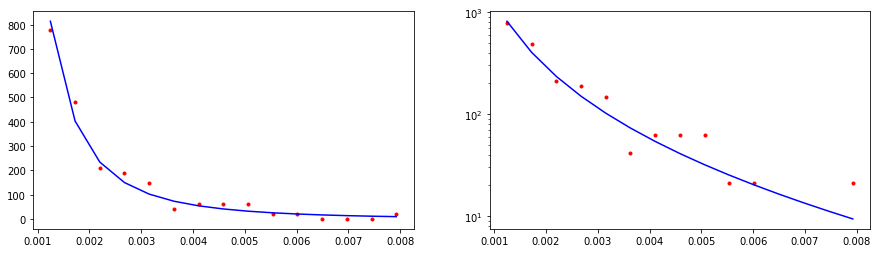

CPU times: user 860 µs, sys: 0 ns, total: 860 µs
Wall time: 673 µs
58846.839426226994


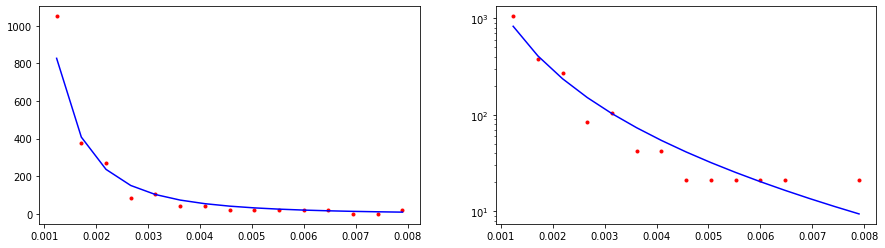

CPU times: user 982 µs, sys: 0 ns, total: 982 µs
Wall time: 828 µs
30700.61059930804


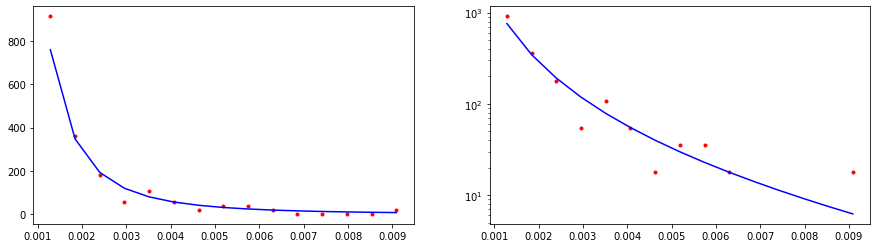

CPU times: user 1.2 ms, sys: 16 µs, total: 1.21 ms
Wall time: 1.03 ms
59647.24133148716


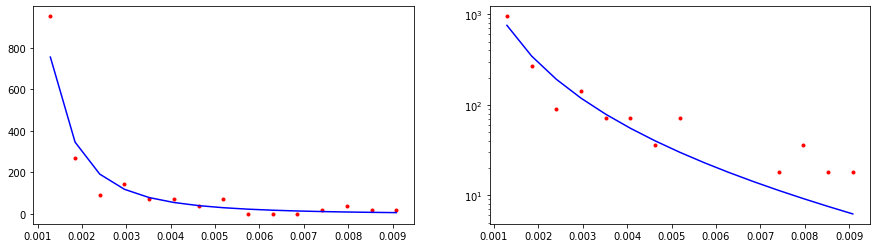

CPU times: user 1.35 ms, sys: 30 µs, total: 1.38 ms
Wall time: 1.2 ms
172810.59636945062


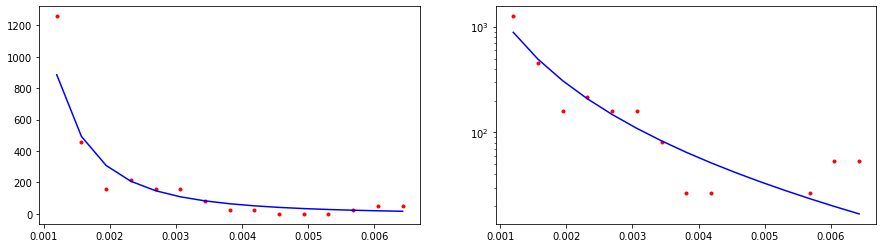

CPU times: user 1.44 ms, sys: 36 µs, total: 1.48 ms
Wall time: 1.29 ms
65098.87124186136


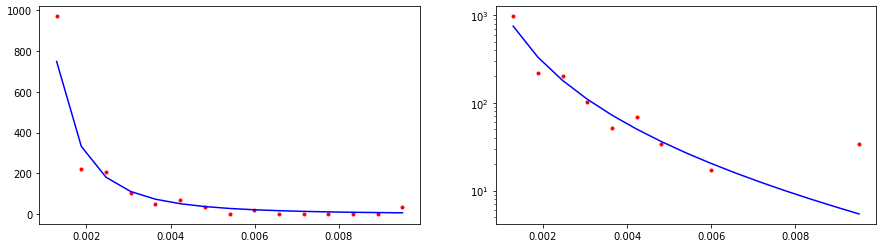

CPU times: user 1.69 ms, sys: 57 µs, total: 1.75 ms
Wall time: 1.56 ms
37198.93744075931


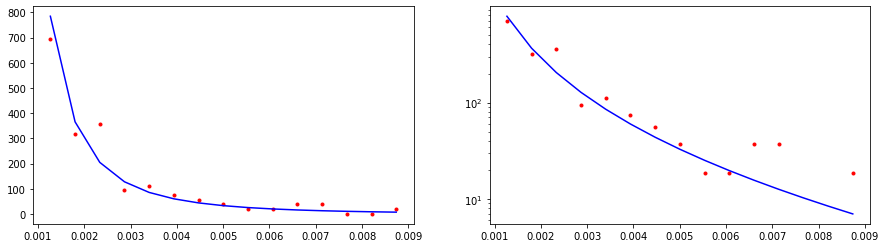

CPU times: user 1.8 ms, sys: 0 ns, total: 1.8 ms
Wall time: 1.59 ms
13668.858177730137


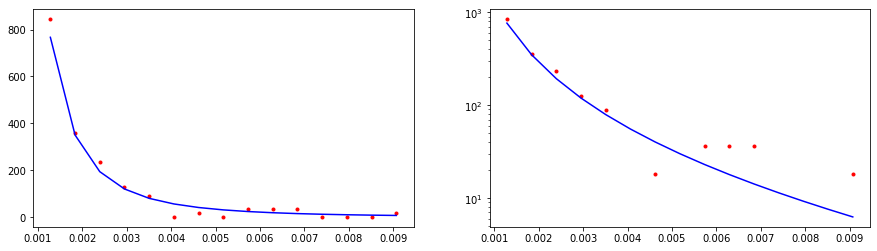

CPU times: user 1.96 ms, sys: 11 µs, total: 1.97 ms
Wall time: 1.78 ms
26159.260359668555


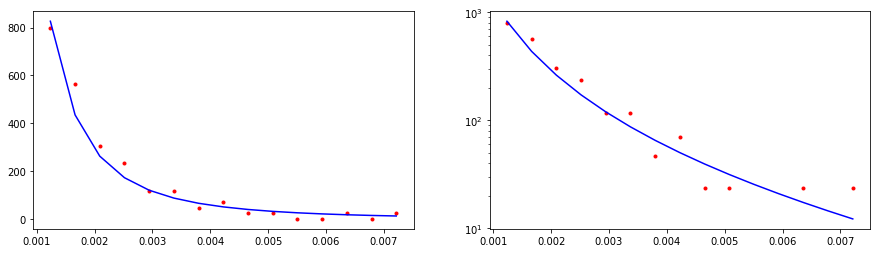

CPU times: user 593 µs, sys: 49 µs, total: 642 µs
Wall time: 399 µs
39988.25086139711


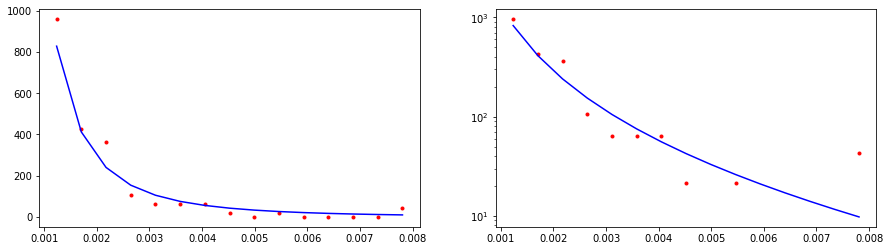

CPU times: user 0 ns, sys: 493 µs, total: 493 µs
Wall time: 334 µs
23625.753496432742


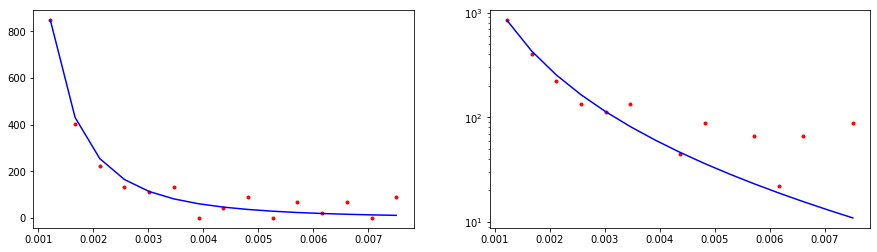

CPU times: user 543 µs, sys: 0 ns, total: 543 µs
Wall time: 367 µs
53579.16234630209


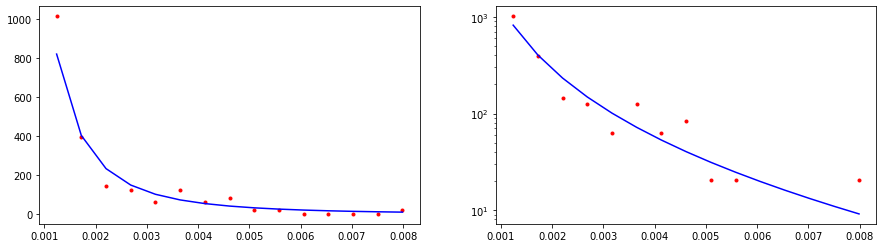

CPU times: user 541 µs, sys: 45 µs, total: 586 µs
Wall time: 414 µs
21537.09428283874


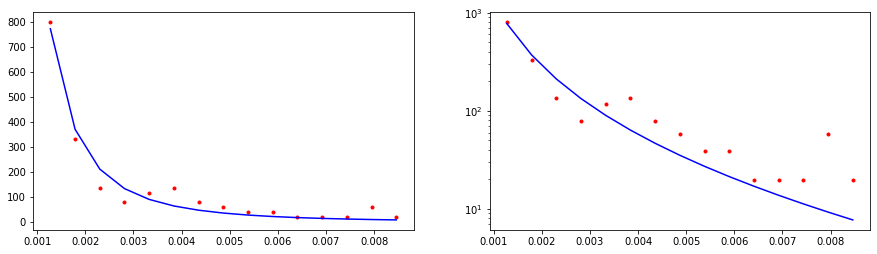

CPU times: user 563 µs, sys: 47 µs, total: 610 µs
Wall time: 424 µs
30699.869479573787


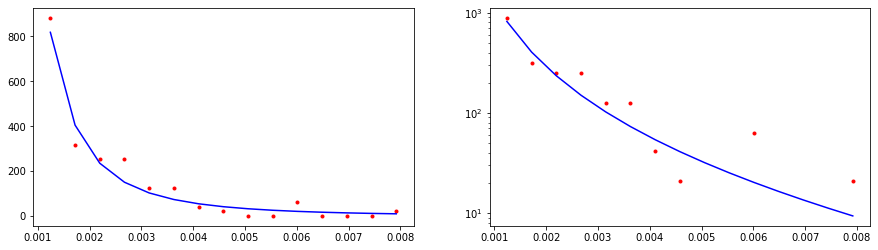

CPU times: user 603 µs, sys: 50 µs, total: 653 µs
Wall time: 474 µs
28238.129919912546


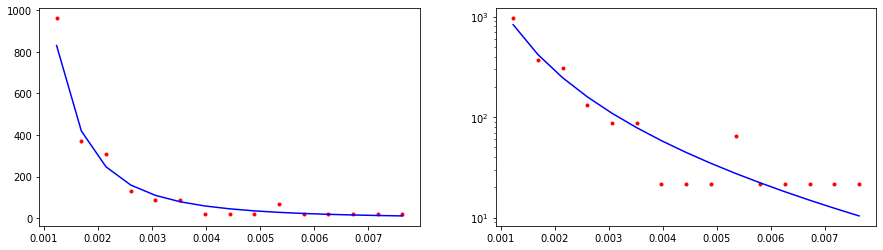

CPU times: user 717 µs, sys: 0 ns, total: 717 µs
Wall time: 517 µs
15988.360349484288


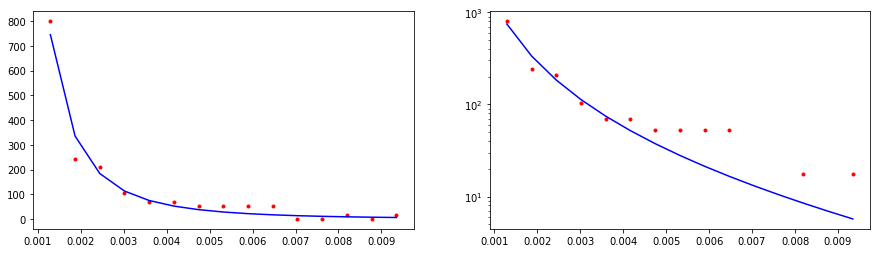

CPU times: user 852 µs, sys: 0 ns, total: 852 µs
Wall time: 679 µs
130371.20526093262


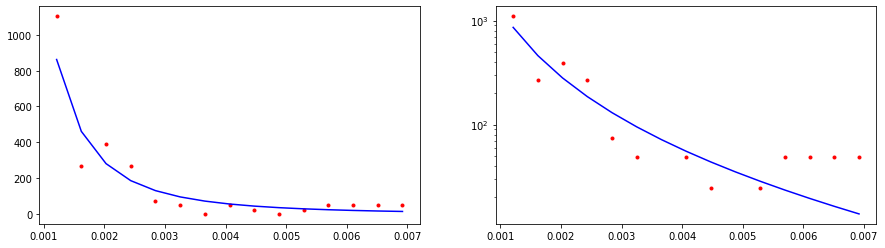

CPU times: user 965 µs, sys: 0 ns, total: 965 µs
Wall time: 790 µs
42822.70735925399


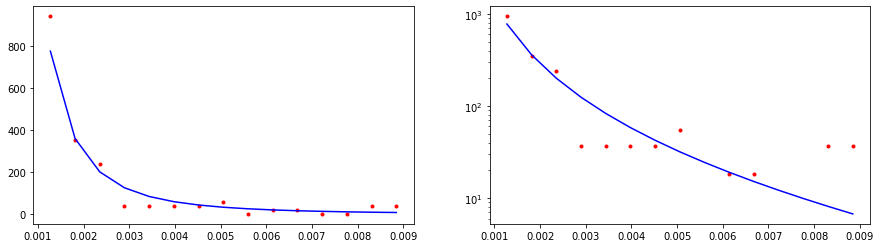

CPU times: user 1.21 ms, sys: 18 µs, total: 1.23 ms
Wall time: 1.02 ms
51850.94871268976


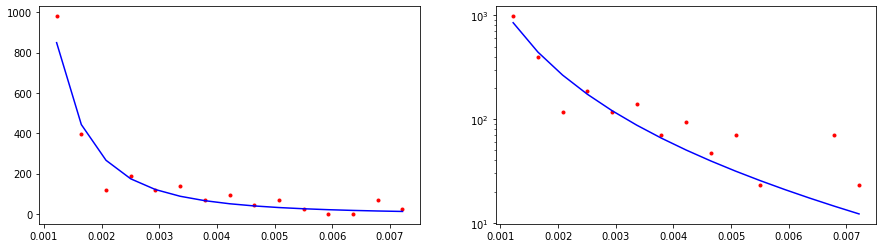

CPU times: user 1.34 ms, sys: 28 µs, total: 1.37 ms
Wall time: 1.19 ms
40950.353158121245


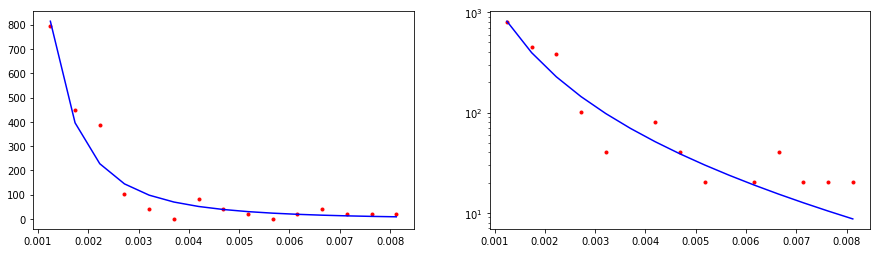

CPU times: user 1.49 ms, sys: 41 µs, total: 1.53 ms
Wall time: 1.34 ms
46856.16862734246


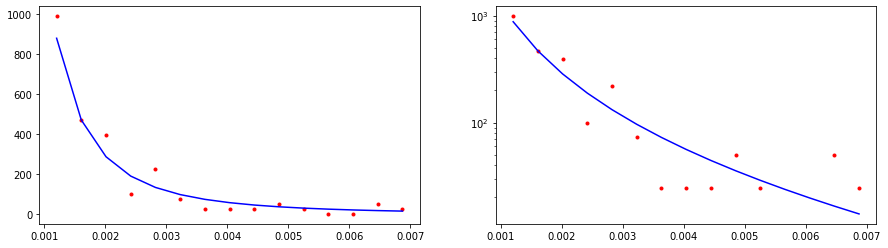

CPU times: user 1.52 ms, sys: 44 µs, total: 1.57 ms
Wall time: 1.38 ms
115733.73406251964


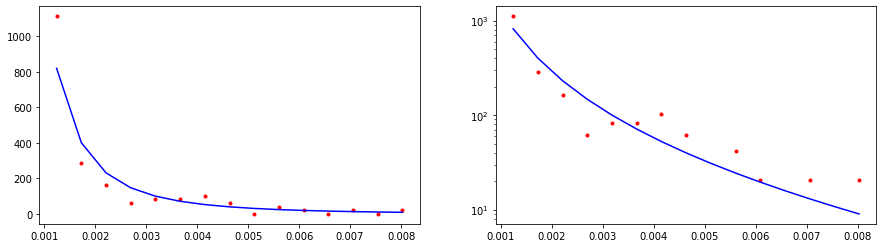

CPU times: user 934 µs, sys: 907 µs, total: 1.84 ms
Wall time: 1.62 ms
62174.570871072065


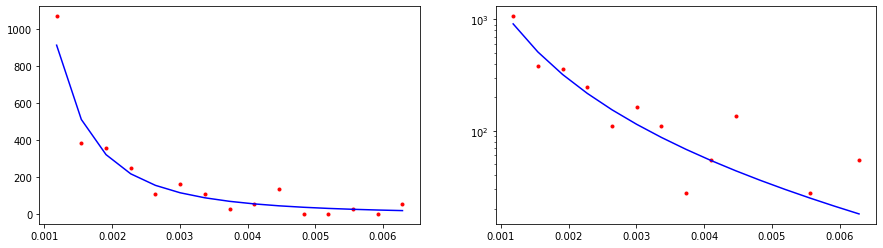

CPU times: user 1.94 ms, sys: 0 ns, total: 1.94 ms
Wall time: 1.74 ms
16989.7205738921


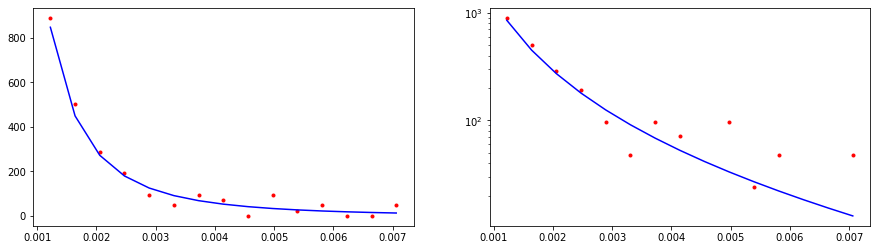

CPU times: user 0 ns, sys: 720 µs, total: 720 µs
Wall time: 448 µs
21334.786708161468


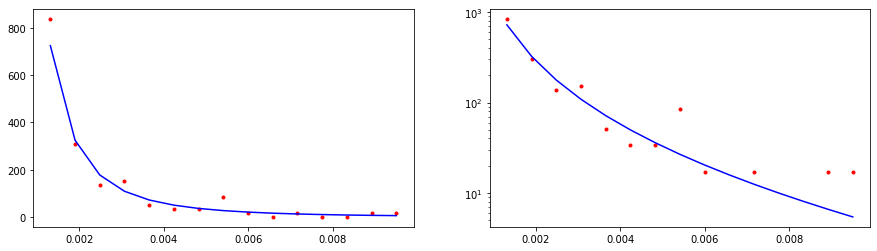

CPU times: user 500 µs, sys: 0 ns, total: 500 µs
Wall time: 330 µs
55258.64198001305


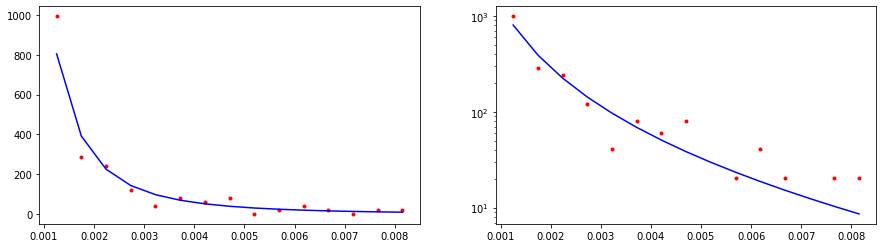

CPU times: user 0 ns, sys: 540 µs, total: 540 µs
Wall time: 364 µs
13586.857291501652


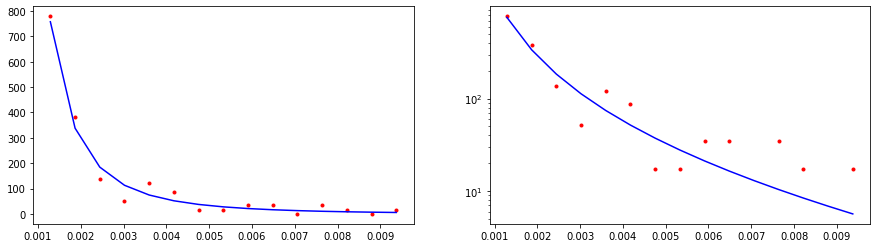

CPU times: user 598 µs, sys: 0 ns, total: 598 µs
Wall time: 421 µs
28258.753471639506


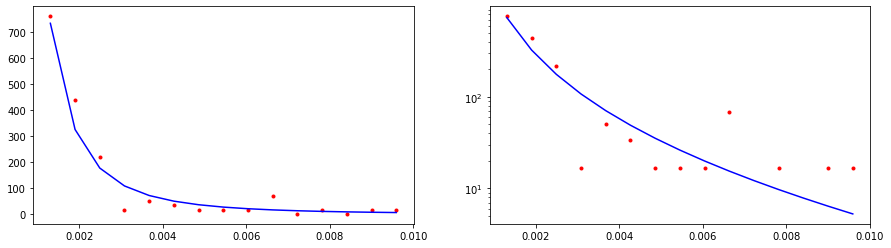

CPU times: user 515 µs, sys: 44 µs, total: 559 µs
Wall time: 389 µs
34901.78556739252


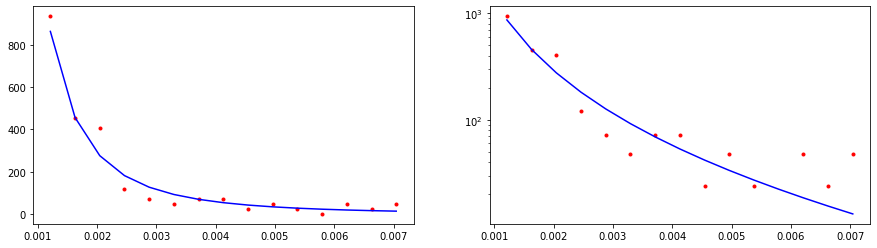

CPU times: user 603 µs, sys: 0 ns, total: 603 µs
Wall time: 427 µs
40205.99787109603


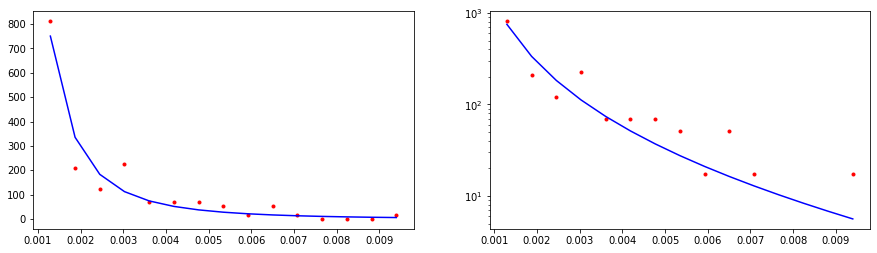

CPU times: user 615 µs, sys: 52 µs, total: 667 µs
Wall time: 481 µs
30011.49988583819


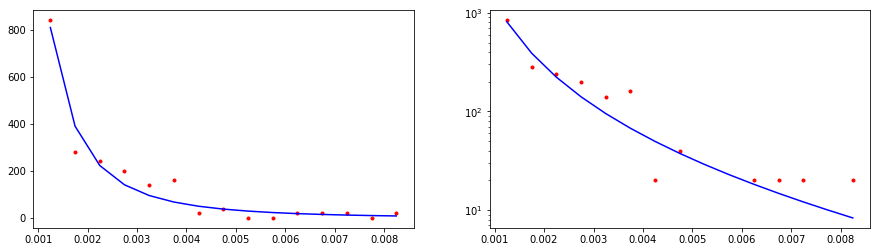

CPU times: user 812 µs, sys: 0 ns, total: 812 µs
Wall time: 688 µs
50726.17740230798


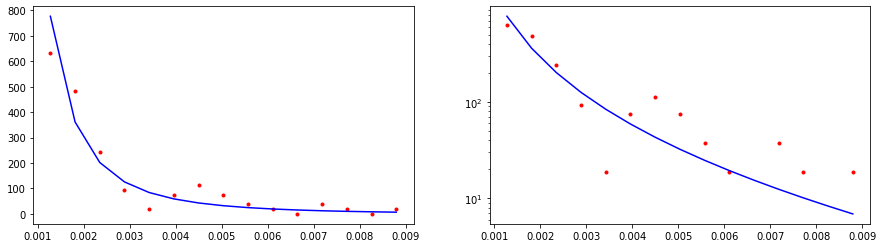

CPU times: user 81 µs, sys: 897 µs, total: 978 µs
Wall time: 784 µs
79810.41246203973


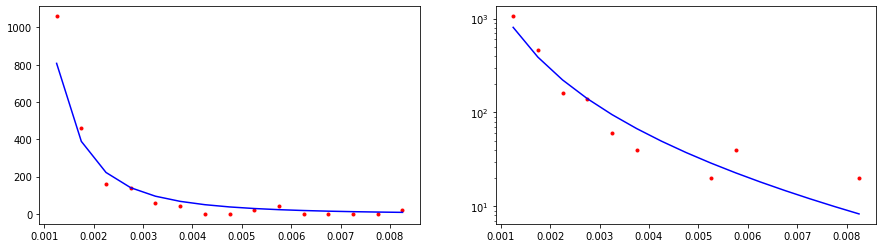

CPU times: user 1.16 ms, sys: 14 µs, total: 1.18 ms
Wall time: 1.01 ms
8818.462046243641


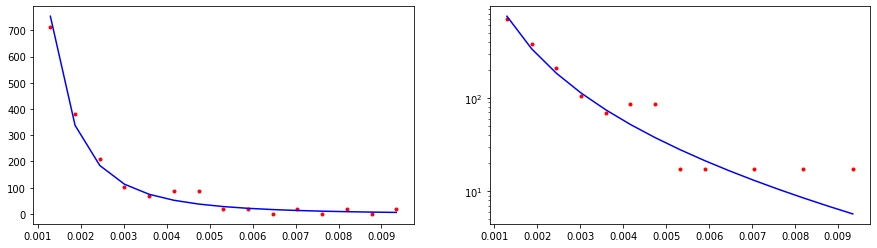

CPU times: user 1.26 ms, sys: 22 µs, total: 1.28 ms
Wall time: 1.09 ms
13125.992545273164


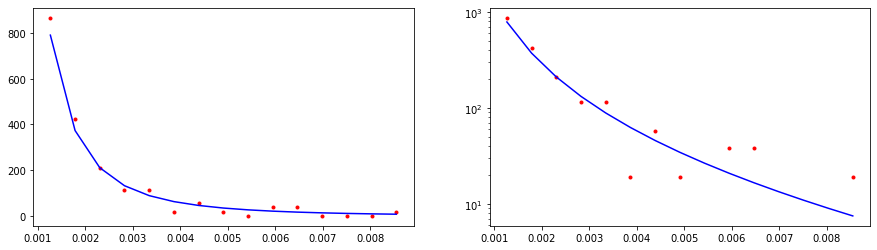

CPU times: user 1.54 ms, sys: 47 µs, total: 1.59 ms
Wall time: 1.41 ms
77948.5683103169


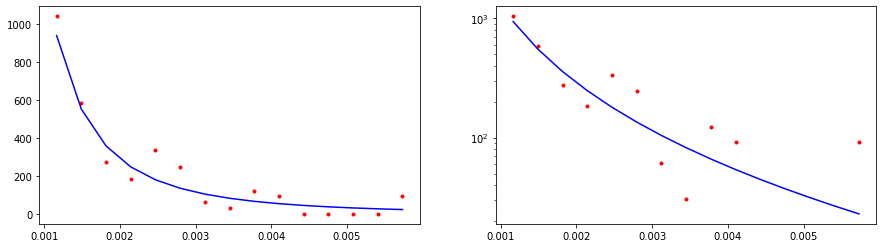

CPU times: user 1.51 ms, sys: 0 ns, total: 1.51 ms
Wall time: 1.36 ms
34515.868621538575


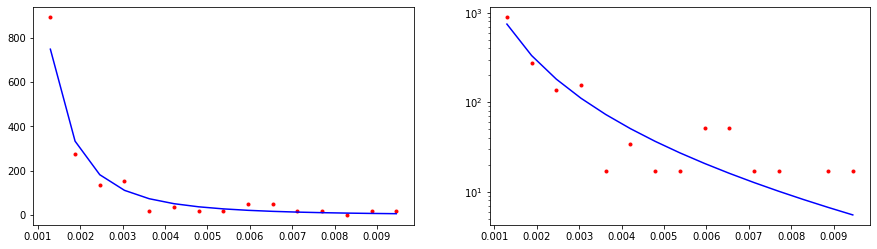

CPU times: user 1.87 ms, sys: 0 ns, total: 1.87 ms
Wall time: 1.68 ms
22607.82628213909


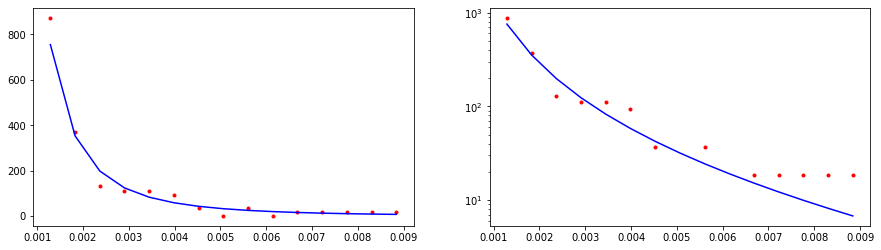

CPU times: user 997 µs, sys: 987 µs, total: 1.98 ms
Wall time: 1.77 ms
25335.916015673487


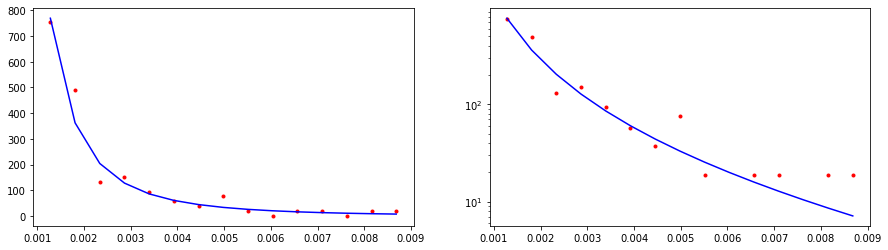

CPU times: user 712 µs, sys: 0 ns, total: 712 µs
Wall time: 443 µs
17689.203311118836


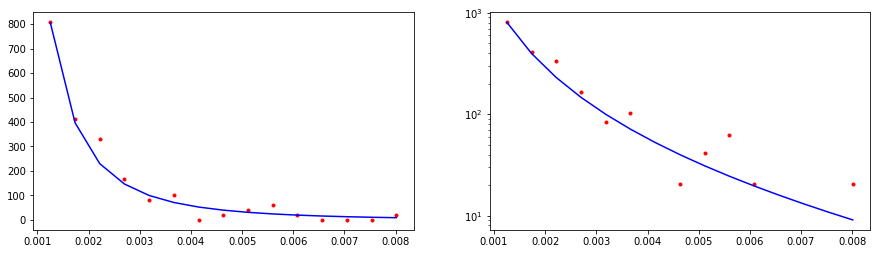

CPU times: user 398 µs, sys: 34 µs, total: 432 µs
Wall time: 318 µs
33995.319345462754


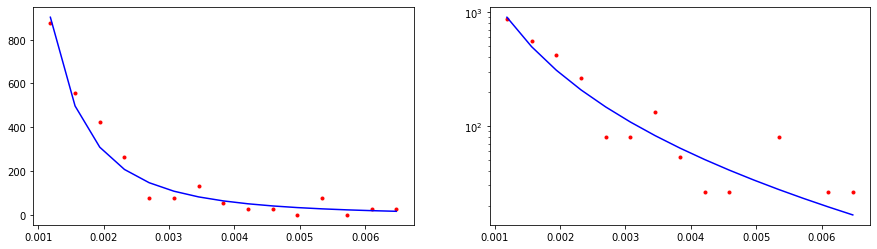

CPU times: user 436 µs, sys: 0 ns, total: 436 µs
Wall time: 330 µs
16725.239277725046


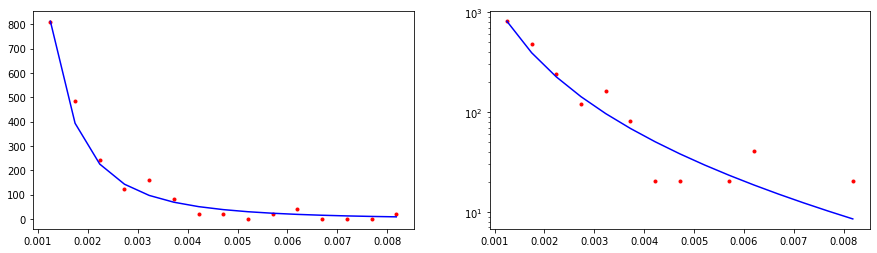

CPU times: user 584 µs, sys: 0 ns, total: 584 µs
Wall time: 416 µs
28140.845276703356


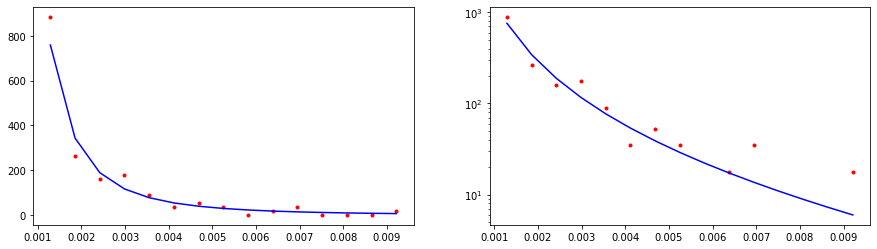

CPU times: user 0 ns, sys: 622 µs, total: 622 µs
Wall time: 446 µs
58278.43608299278


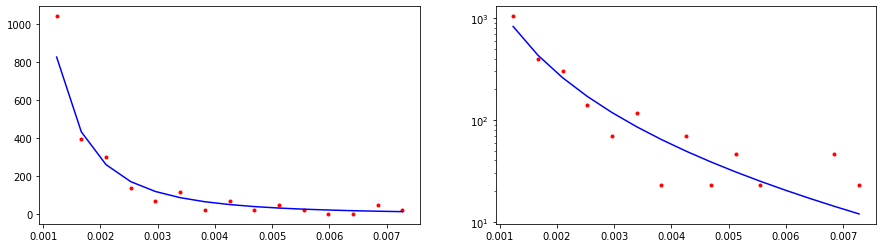

CPU times: user 654 µs, sys: 0 ns, total: 654 µs
Wall time: 484 µs
6065.886033073166


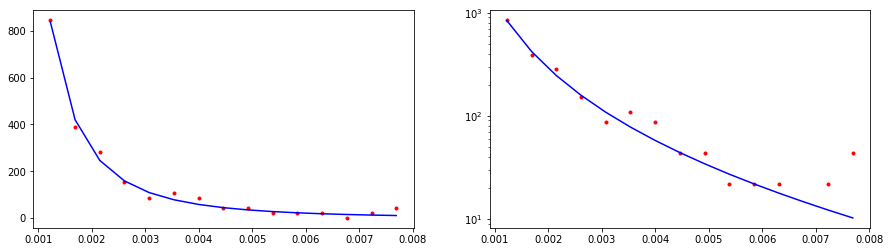

CPU times: user 684 µs, sys: 0 ns, total: 684 µs
Wall time: 525 µs
32202.761887195757


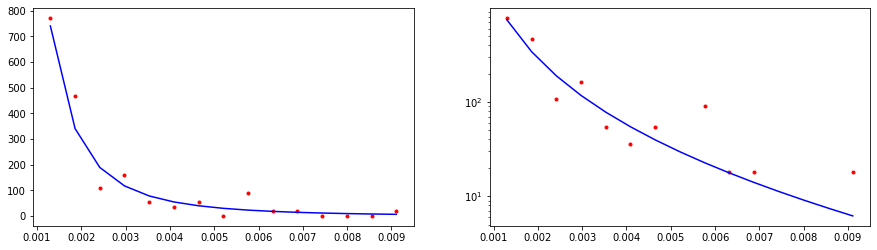

CPU times: user 802 µs, sys: 0 ns, total: 802 µs
Wall time: 636 µs
20890.93671991373


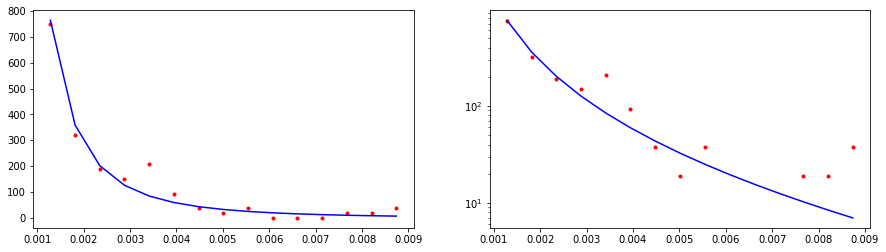

CPU times: user 959 µs, sys: 0 ns, total: 959 µs
Wall time: 774 µs
14455.1233825139


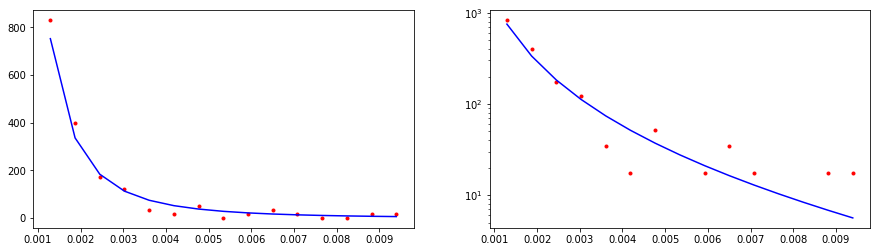

CPU times: user 293 µs, sys: 936 µs, total: 1.23 ms
Wall time: 1.03 ms
63050.83739266008


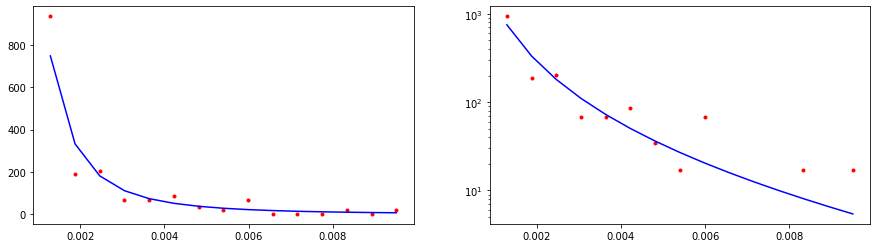

CPU times: user 1.24 ms, sys: 21 µs, total: 1.26 ms
Wall time: 1.09 ms
77086.21220571008


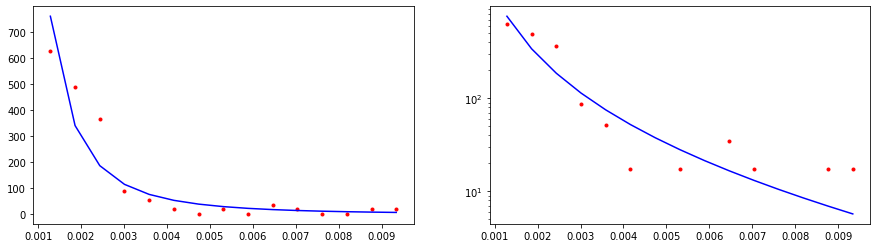

CPU times: user 1.43 ms, sys: 36 µs, total: 1.46 ms
Wall time: 1.27 ms
17568.34652503185


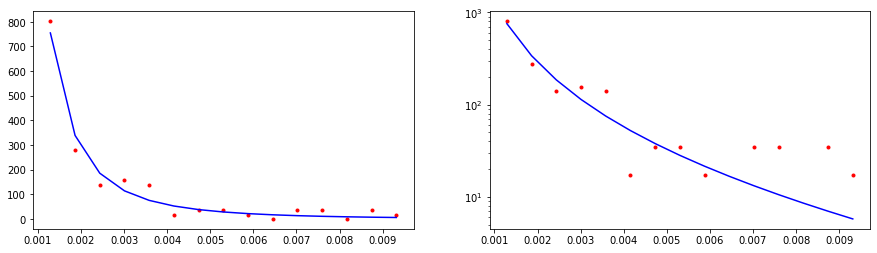

CPU times: user 1.69 ms, sys: 0 ns, total: 1.69 ms
Wall time: 1.51 ms
43414.78268669719


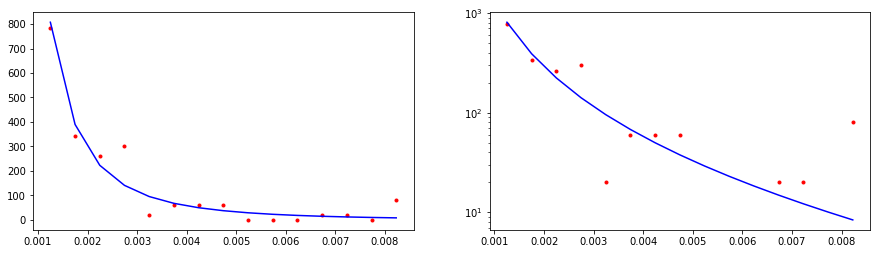

CPU times: user 1.74 ms, sys: 0 ns, total: 1.74 ms
Wall time: 1.56 ms
34447.29434024998


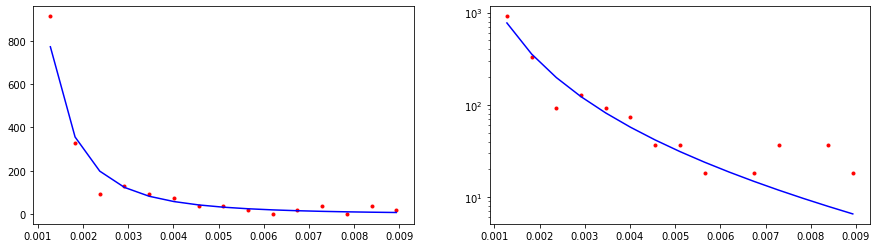

CPU times: user 1.89 ms, sys: 77 µs, total: 1.97 ms
Wall time: 1.77 ms
14279.7165390665


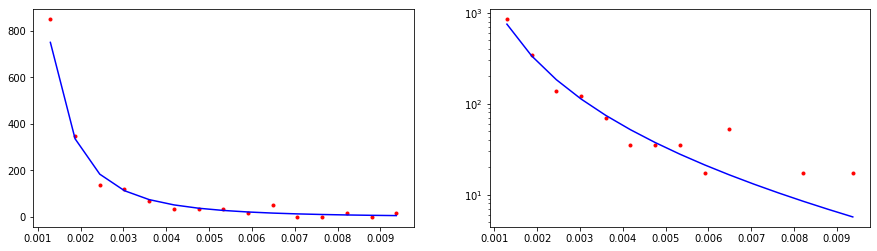

CPU times: user 0 ns, sys: 635 µs, total: 635 µs
Wall time: 400 µs
17977.96826040432


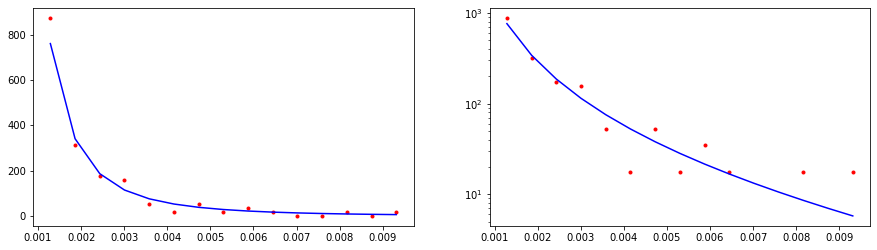

CPU times: user 0 ns, sys: 505 µs, total: 505 µs
Wall time: 335 µs
187196.43258369813


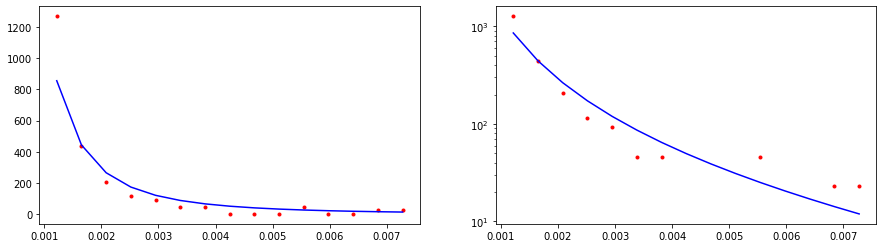

CPU times: user 541 µs, sys: 0 ns, total: 541 µs
Wall time: 386 µs
30655.285903501874


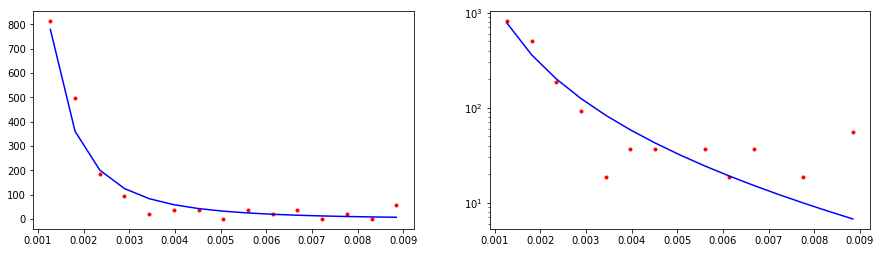

CPU times: user 478 µs, sys: 42 µs, total: 520 µs
Wall time: 366 µs
104217.34522353519


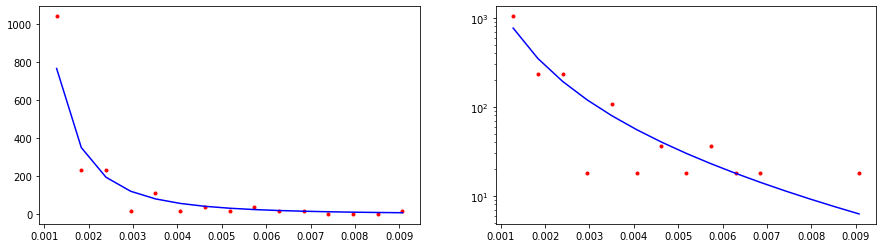

CPU times: user 0 ns, sys: 604 µs, total: 604 µs
Wall time: 441 µs
12700.28671568857


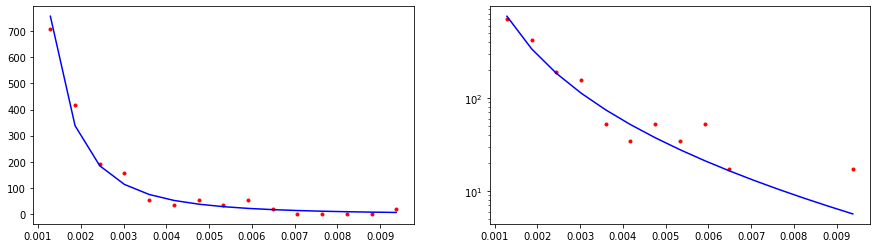

CPU times: user 610 µs, sys: 53 µs, total: 663 µs
Wall time: 467 µs
87260.50664168783


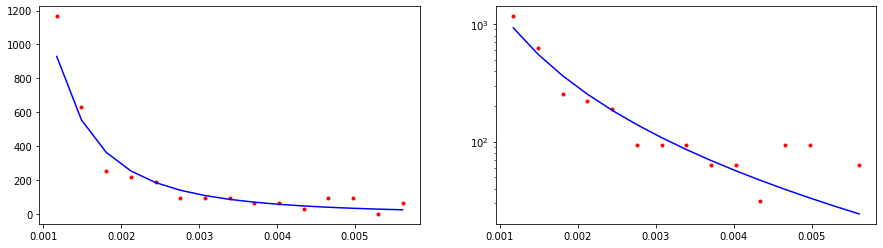

CPU times: user 580 µs, sys: 0 ns, total: 580 µs
Wall time: 429 µs
5641.481722669756


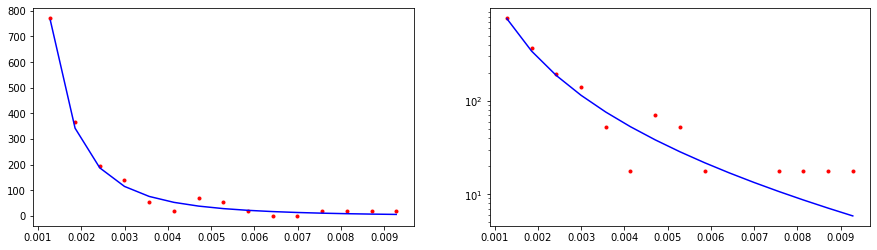

CPU times: user 711 µs, sys: 0 ns, total: 711 µs
Wall time: 602 µs
94195.93838154034


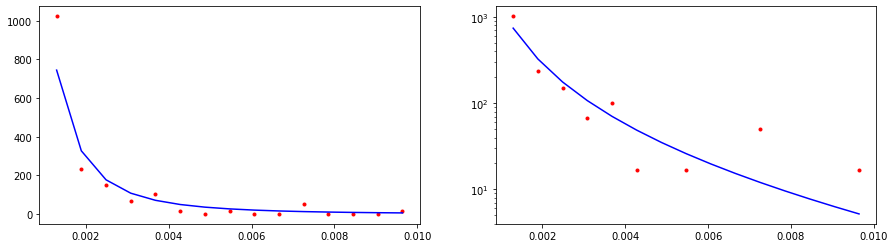

CPU times: user 1.04 ms, sys: 4 µs, total: 1.05 ms
Wall time: 875 µs
11492.488521266234


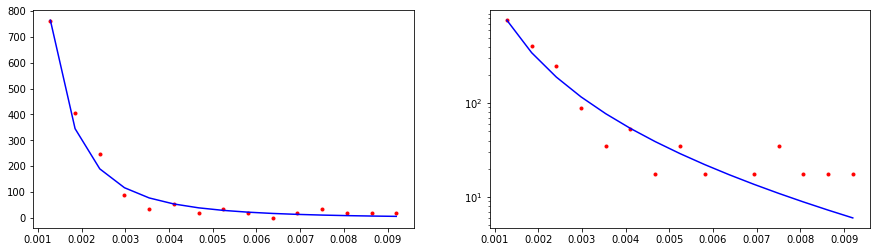

CPU times: user 248 µs, sys: 915 µs, total: 1.16 ms
Wall time: 982 µs
10523.234929654525


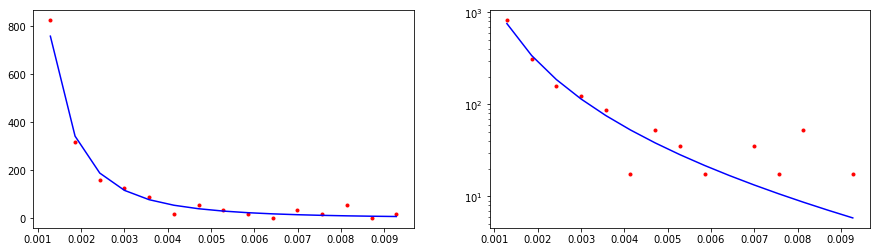

CPU times: user 1.35 ms, sys: 31 µs, total: 1.38 ms
Wall time: 1.22 ms
10191.79525972076


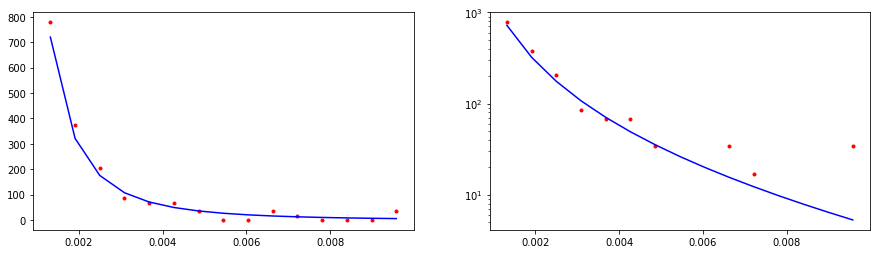

CPU times: user 1.33 ms, sys: 28 µs, total: 1.35 ms
Wall time: 1.23 ms
20245.40205340211


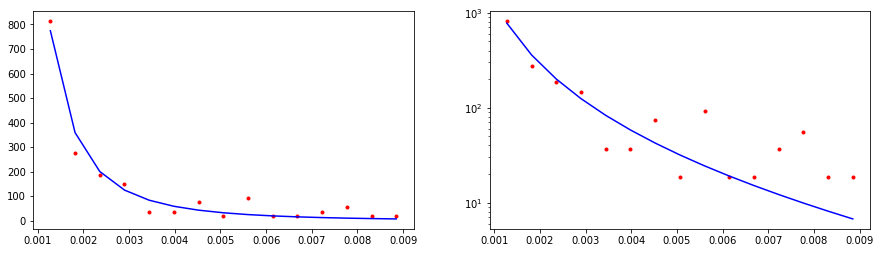

CPU times: user 719 µs, sys: 964 µs, total: 1.68 ms
Wall time: 1.49 ms
102036.4667504606


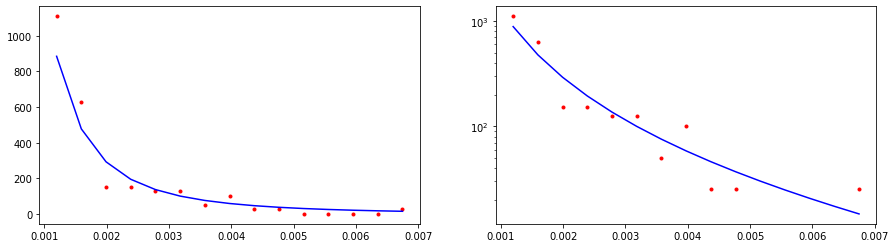

CPU times: user 1.81 ms, sys: 0 ns, total: 1.81 ms
Wall time: 1.64 ms
6779.3896265632475


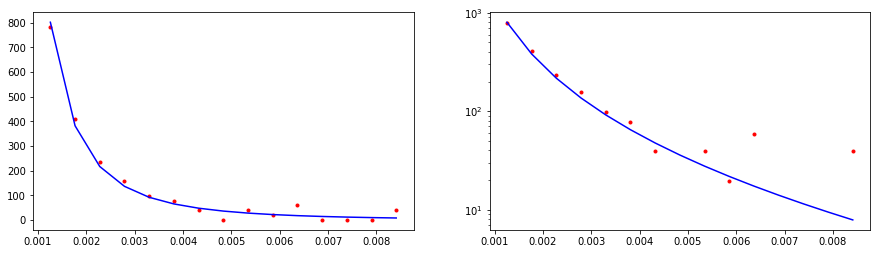

CPU times: user 2 ms, sys: 1 µs, total: 2 ms
Wall time: 1.82 ms
47713.25528769969


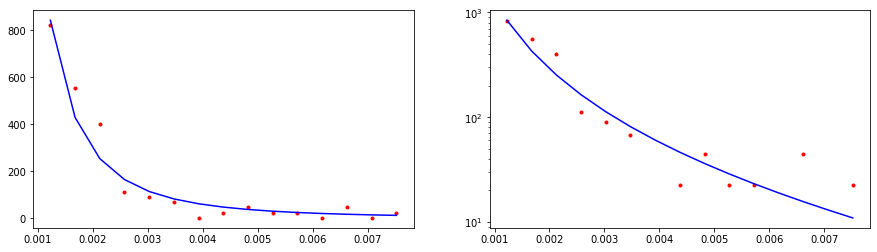

CPU times: user 658 µs, sys: 0 ns, total: 658 µs
Wall time: 417 µs
25463.31468661094


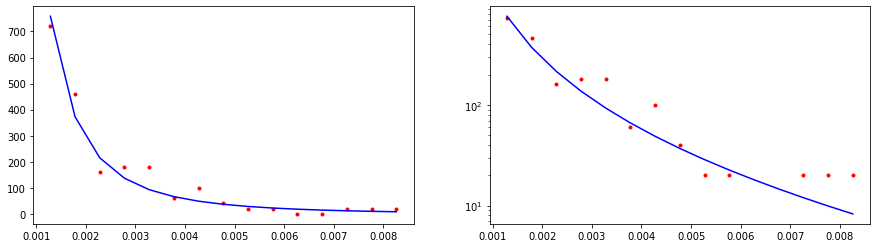

CPU times: user 418 µs, sys: 37 µs, total: 455 µs
Wall time: 300 µs
39340.8347782442


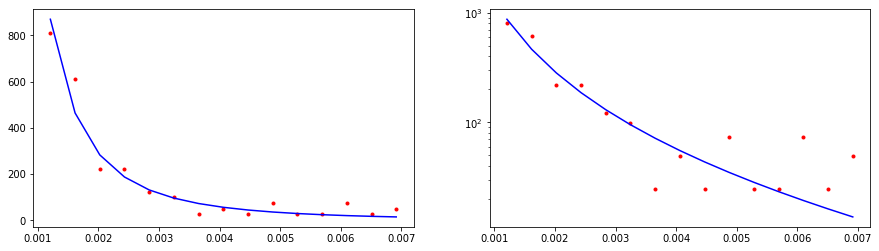

CPU times: user 502 µs, sys: 0 ns, total: 502 µs
Wall time: 355 µs
10395.42486049515


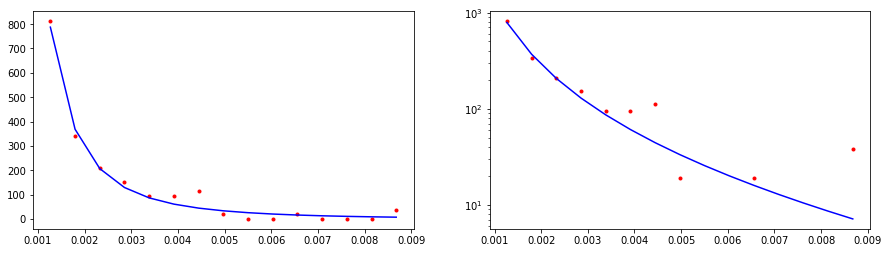

CPU times: user 613 µs, sys: 0 ns, total: 613 µs
Wall time: 438 µs
18893.836637431516


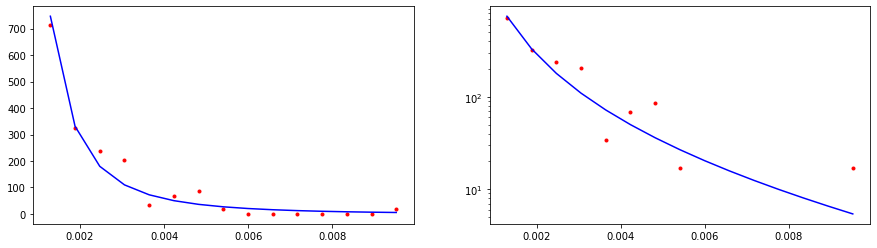

CPU times: user 509 µs, sys: 45 µs, total: 554 µs
Wall time: 402 µs
33654.65829012218


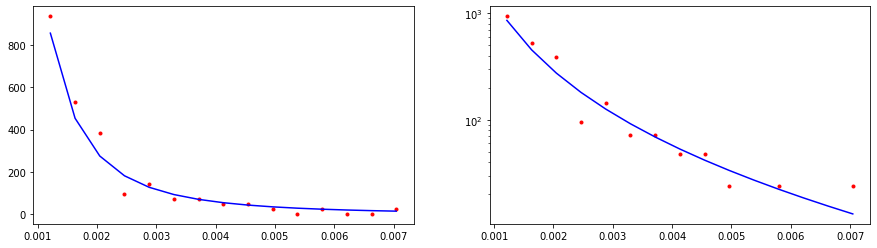

CPU times: user 0 ns, sys: 658 µs, total: 658 µs
Wall time: 480 µs
23198.848546484372


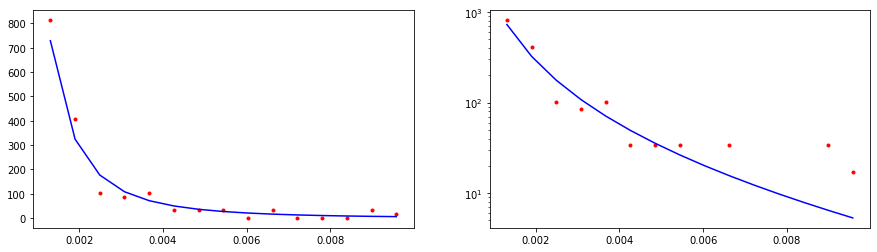

CPU times: user 705 µs, sys: 0 ns, total: 705 µs
Wall time: 512 µs
94983.40654552748


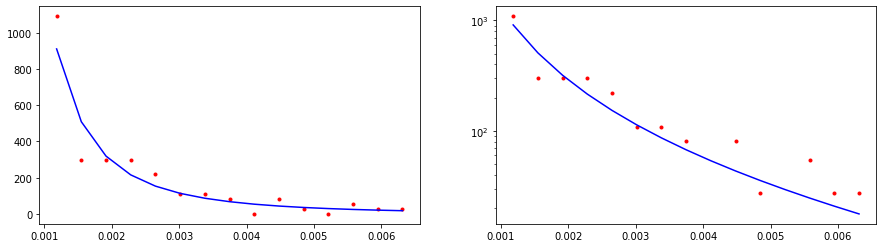

CPU times: user 735 µs, sys: 65 µs, total: 800 µs
Wall time: 624 µs
21191.60145062442


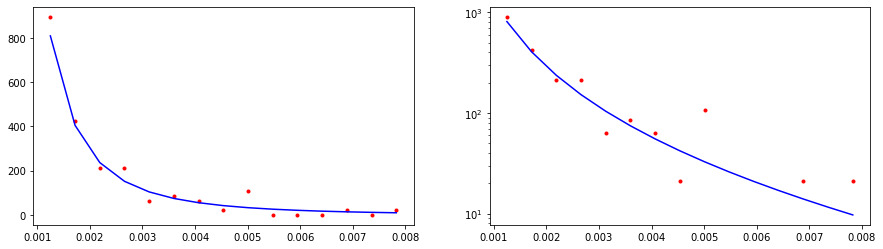

CPU times: user 1.04 ms, sys: 4 µs, total: 1.04 ms
Wall time: 847 µs
37514.5493847227


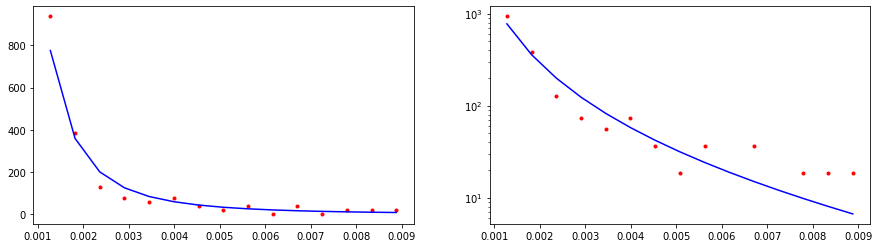

CPU times: user 1.14 ms, sys: 13 µs, total: 1.15 ms
Wall time: 995 µs
14562.852539726131


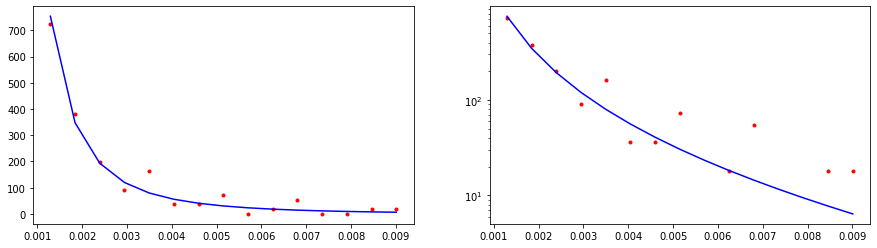

CPU times: user 1.27 ms, sys: 25 µs, total: 1.3 ms
Wall time: 1.14 ms
52521.907507966374


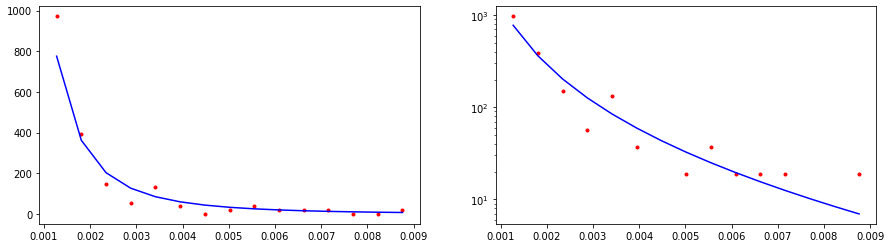

CPU times: user 492 µs, sys: 955 µs, total: 1.45 ms
Wall time: 1.27 ms
26567.086784034134


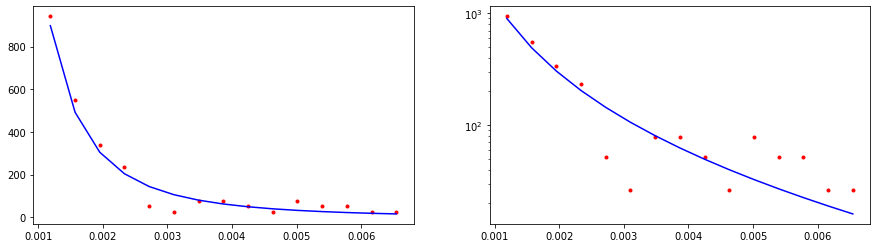

CPU times: user 689 µs, sys: 959 µs, total: 1.65 ms
Wall time: 1.48 ms
72567.12846238112


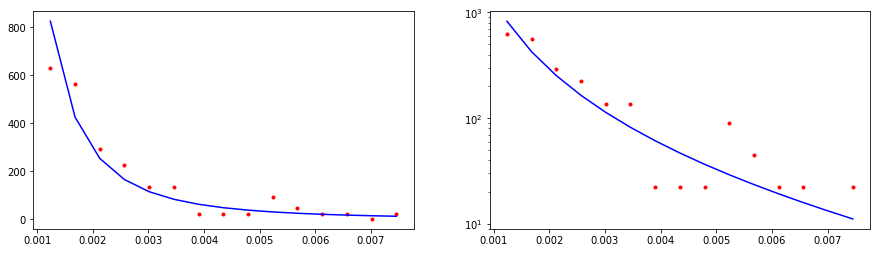

CPU times: user 1.83 ms, sys: 0 ns, total: 1.83 ms
Wall time: 1.69 ms
11799.065323387116


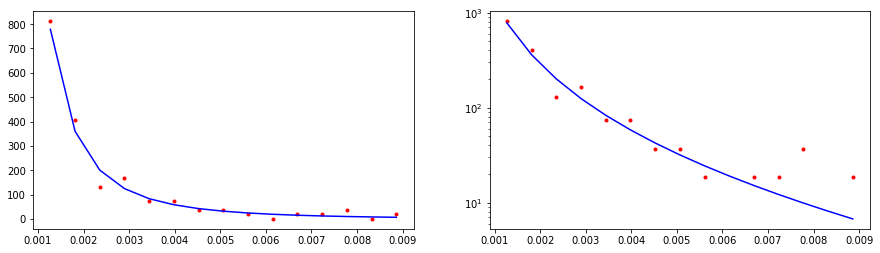

CPU times: user 2.01 ms, sys: 2 µs, total: 2.02 ms
Wall time: 1.83 ms
26806.542105409208


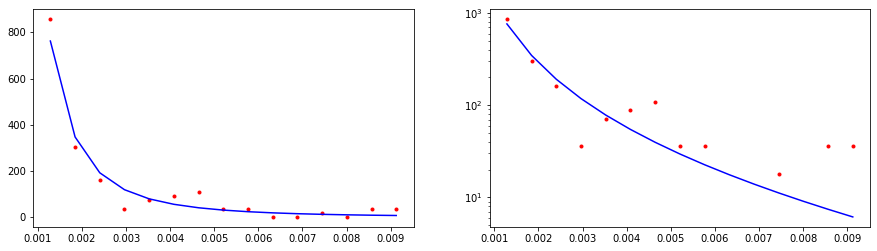

CPU times: user 601 µs, sys: 54 µs, total: 655 µs
Wall time: 416 µs
43532.45059544188


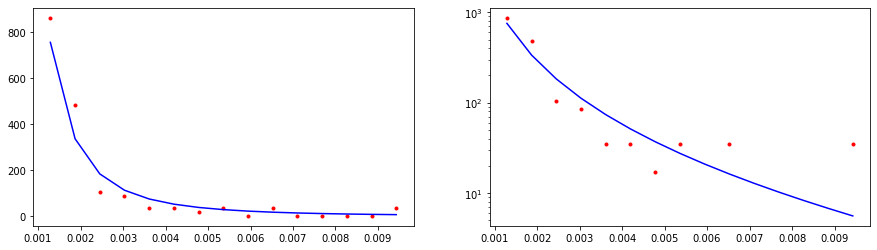

CPU times: user 467 µs, sys: 42 µs, total: 509 µs
Wall time: 341 µs
18761.549084803704


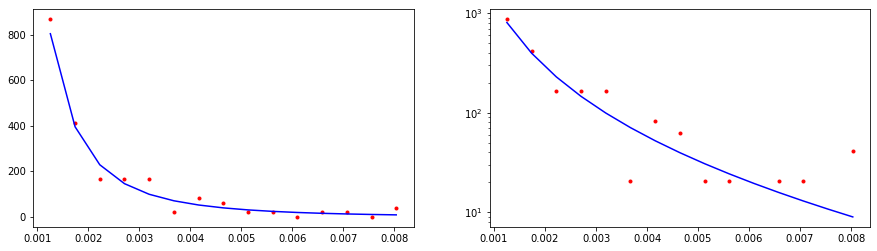

CPU times: user 472 µs, sys: 42 µs, total: 514 µs
Wall time: 343 µs
15762.834680079091


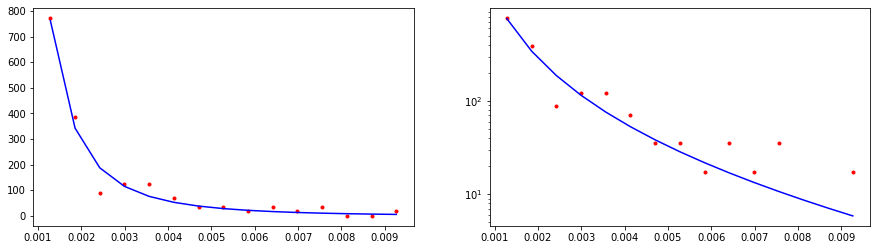

CPU times: user 483 µs, sys: 44 µs, total: 527 µs
Wall time: 360 µs
42002.3409959755


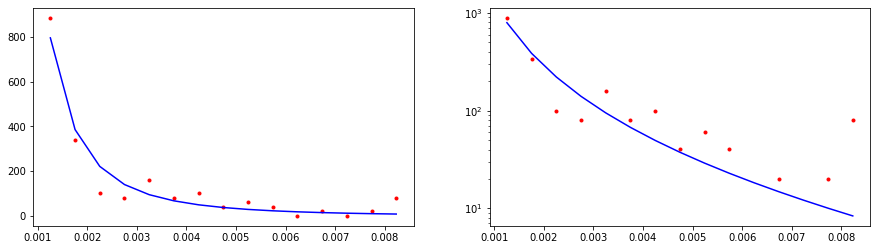

CPU times: user 627 µs, sys: 0 ns, total: 627 µs
Wall time: 459 µs
16976.070077360288


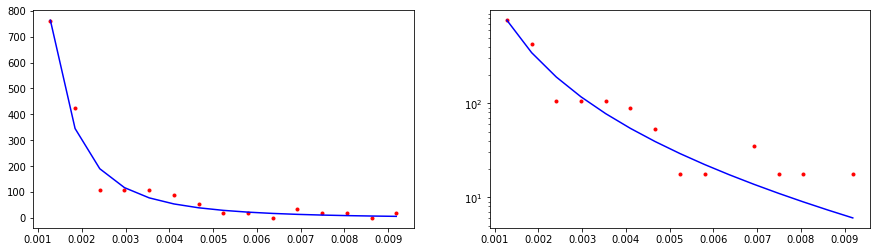

CPU times: user 568 µs, sys: 51 µs, total: 619 µs
Wall time: 464 µs
81346.11023178286


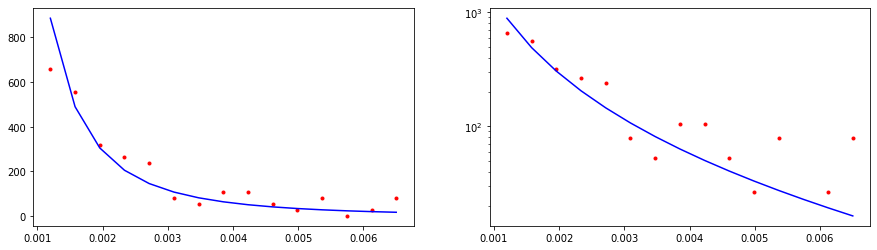

CPU times: user 649 µs, sys: 0 ns, total: 649 µs
Wall time: 488 µs
22894.5891381781


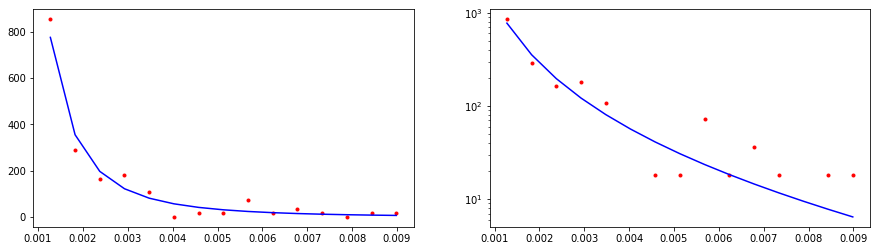

CPU times: user 0 ns, sys: 853 µs, total: 853 µs
Wall time: 685 µs
18538.047127827605


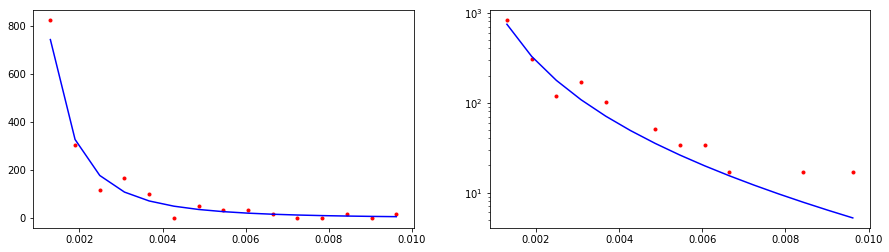

CPU times: user 1.01 ms, sys: 1e+03 ns, total: 1.01 ms
Wall time: 843 µs
114000.61902689985


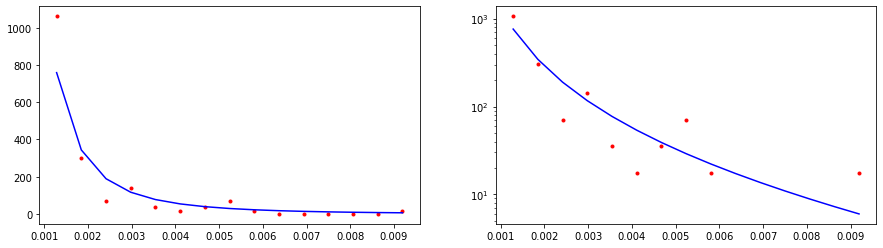

CPU times: user 1.18 ms, sys: 16 µs, total: 1.2 ms
Wall time: 1.02 ms
22920.73560069889


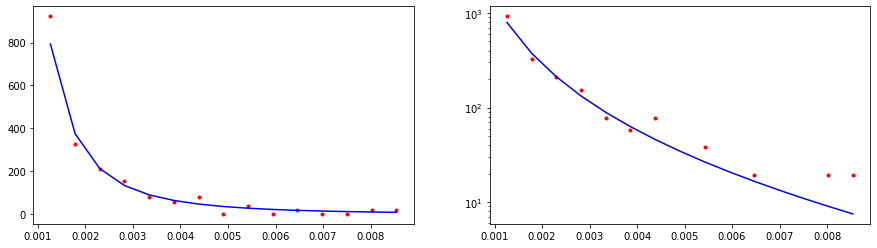

CPU times: user 1.33 ms, sys: 0 ns, total: 1.33 ms
Wall time: 1.16 ms
30540.419759247397


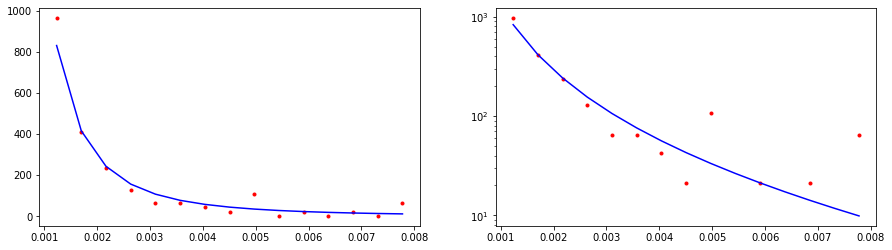

CPU times: user 1.5 ms, sys: 46 µs, total: 1.55 ms
Wall time: 1.37 ms
40246.43320899486


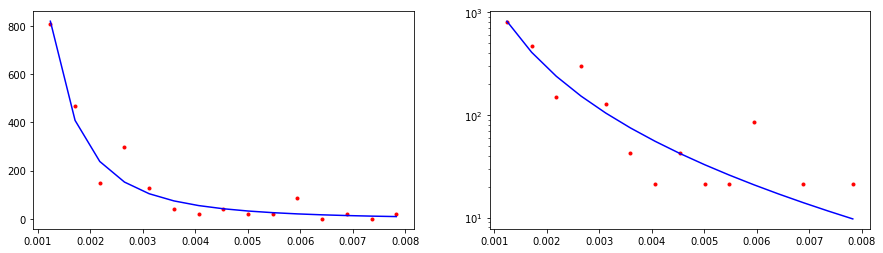

CPU times: user 1.71 ms, sys: 0 ns, total: 1.71 ms
Wall time: 1.51 ms
32062.659402962054


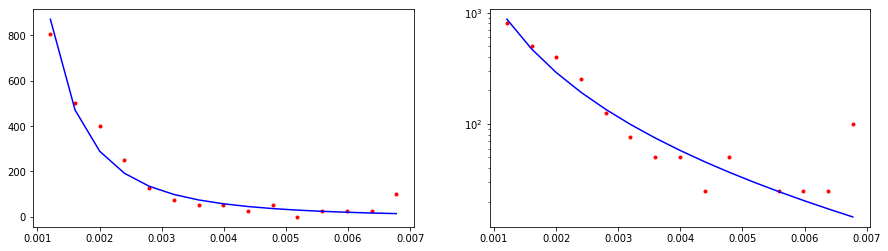

CPU times: user 1.71 ms, sys: 0 ns, total: 1.71 ms
Wall time: 1.55 ms
12609.223656054084


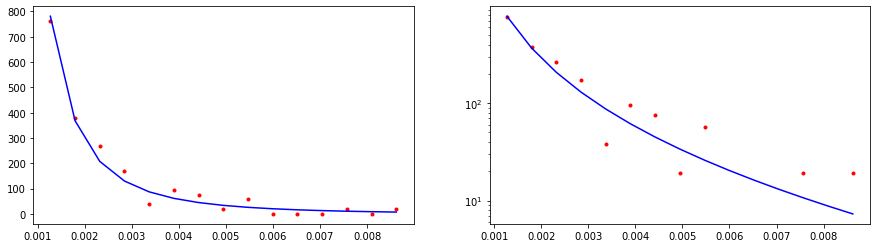

CPU times: user 1.87 ms, sys: 0 ns, total: 1.87 ms
Wall time: 1.69 ms
52810.42854732829


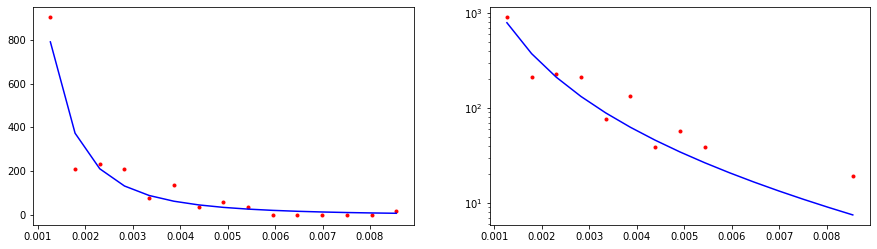

CPU times: user 681 µs, sys: 0 ns, total: 681 µs
Wall time: 408 µs
23803.28477287032


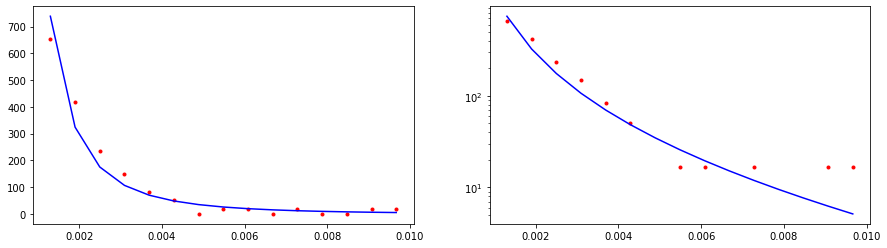

CPU times: user 407 µs, sys: 37 µs, total: 444 µs
Wall time: 309 µs
23323.31501737088


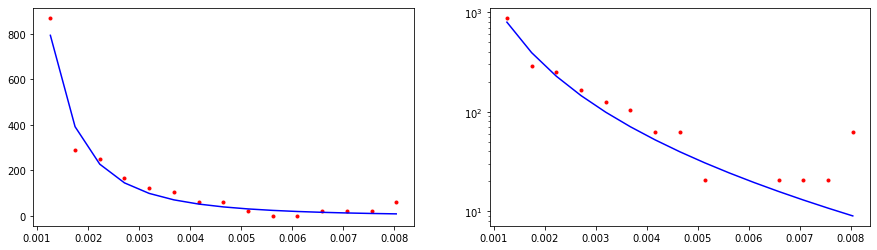

CPU times: user 488 µs, sys: 44 µs, total: 532 µs
Wall time: 376 µs
41436.50254370159


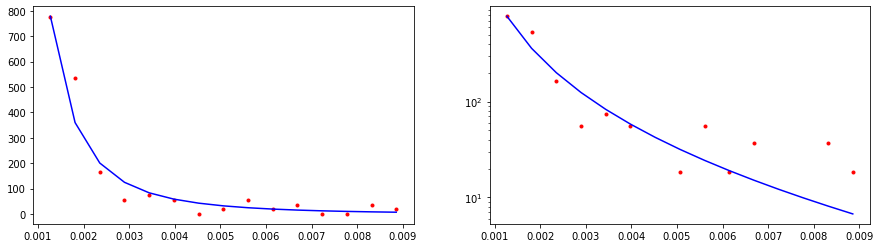

CPU times: user 552 µs, sys: 50 µs, total: 602 µs
Wall time: 422 µs
46524.33855444027


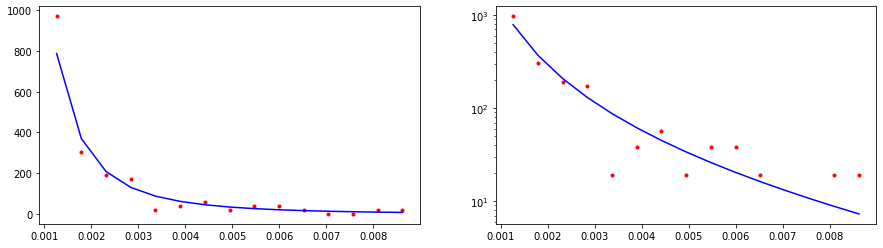

CPU times: user 560 µs, sys: 51 µs, total: 611 µs
Wall time: 438 µs
21091.818789986188


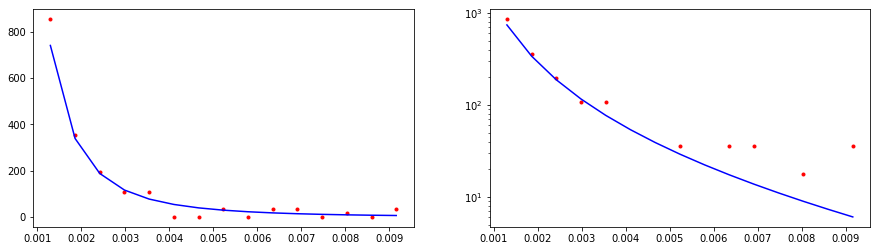

CPU times: user 595 µs, sys: 54 µs, total: 649 µs
Wall time: 476 µs
17202.51399791167


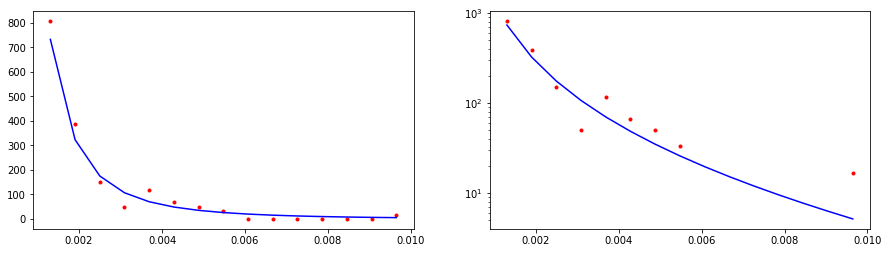

CPU times: user 630 µs, sys: 57 µs, total: 687 µs
Wall time: 508 µs
95179.91501876942


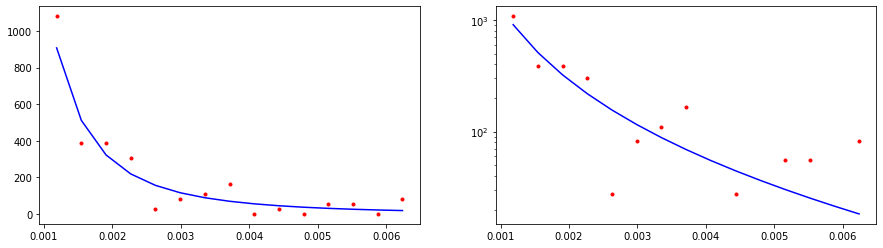

CPU times: user 833 µs, sys: 0 ns, total: 833 µs
Wall time: 676 µs
45840.83374439526


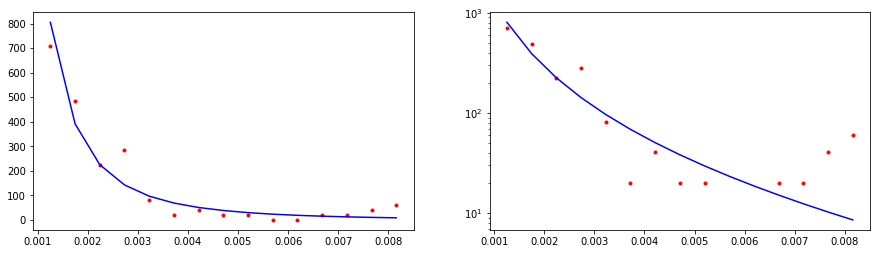

CPU times: user 1.01 ms, sys: 1 µs, total: 1.01 ms
Wall time: 823 µs
14478.966401850494


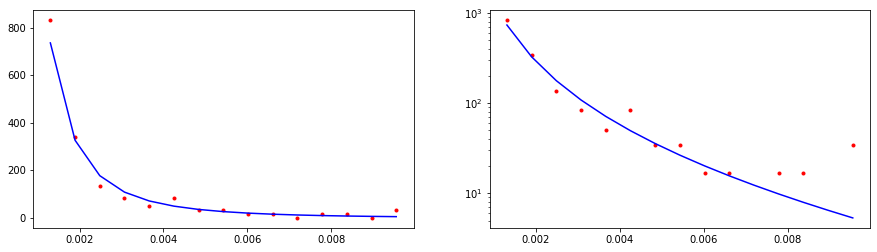

CPU times: user 1.1 ms, sys: 10 µs, total: 1.11 ms
Wall time: 938 µs
52933.01493676612


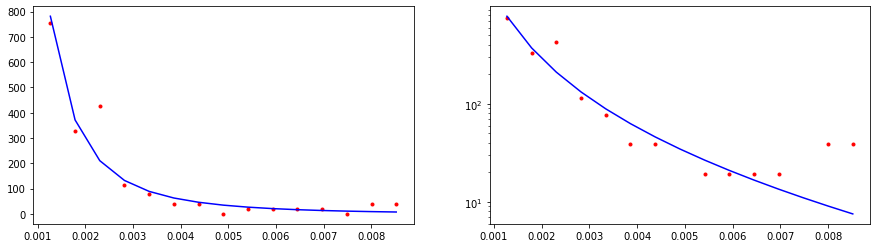

CPU times: user 1.33 ms, sys: 0 ns, total: 1.33 ms
Wall time: 1.14 ms
19703.863217428352


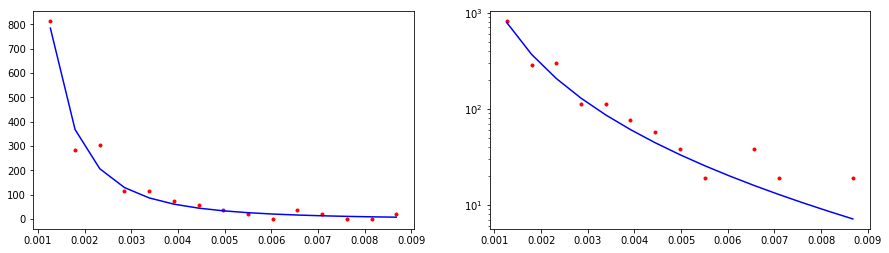

CPU times: user 1.49 ms, sys: 46 µs, total: 1.54 ms
Wall time: 1.35 ms
82770.28721170413


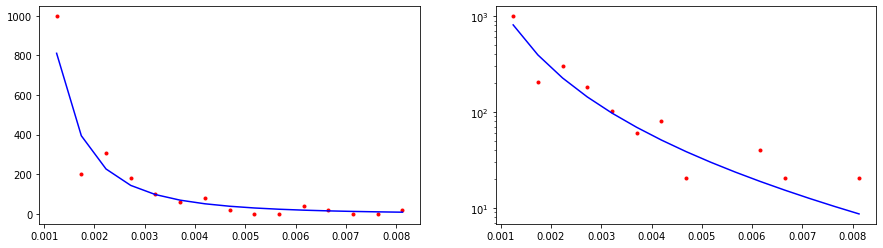

CPU times: user 1.66 ms, sys: 0 ns, total: 1.66 ms
Wall time: 1.47 ms
43837.469500556486


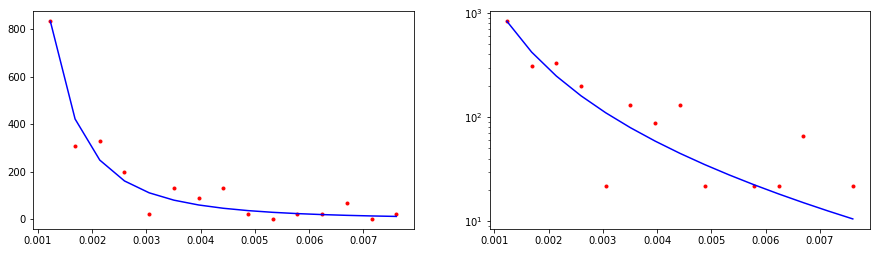

CPU times: user 1.66 ms, sys: 61 µs, total: 1.72 ms
Wall time: 1.53 ms
35677.61894755515


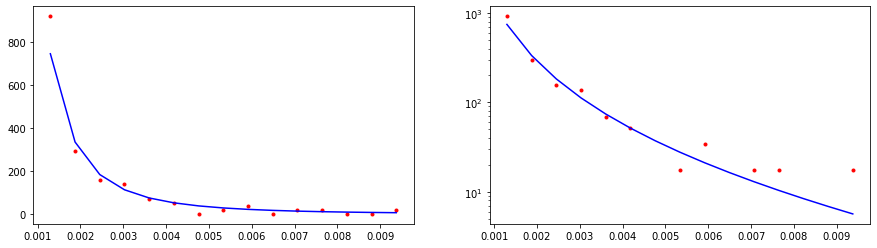

CPU times: user 2.01 ms, sys: 2 µs, total: 2.02 ms
Wall time: 1.8 ms
36435.46315165329


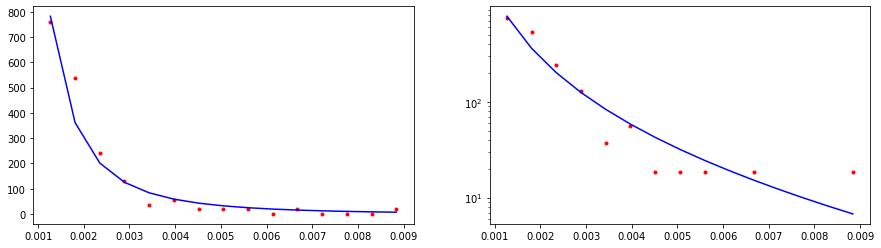

CPU times: user 611 µs, sys: 57 µs, total: 668 µs
Wall time: 421 µs
19789.92092124069


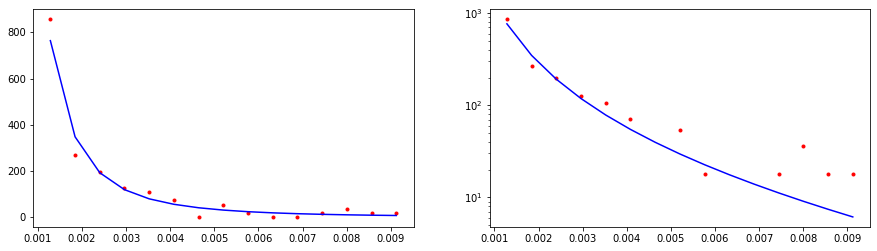

CPU times: user 466 µs, sys: 43 µs, total: 509 µs
Wall time: 332 µs
40132.928592068434


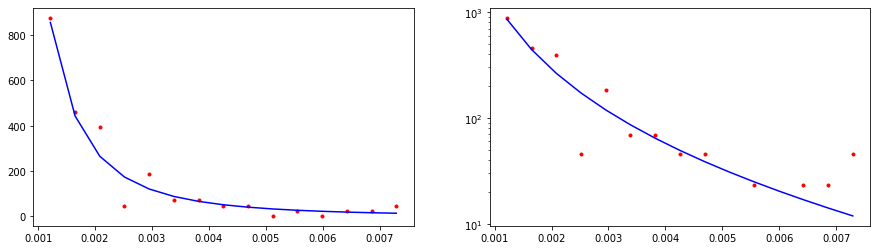

CPU times: user 495 µs, sys: 45 µs, total: 540 µs
Wall time: 354 µs
20579.52135901552


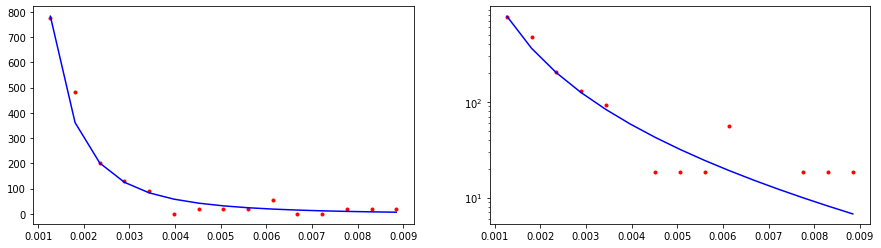

CPU times: user 469 µs, sys: 44 µs, total: 513 µs
Wall time: 382 µs
31603.04076945878


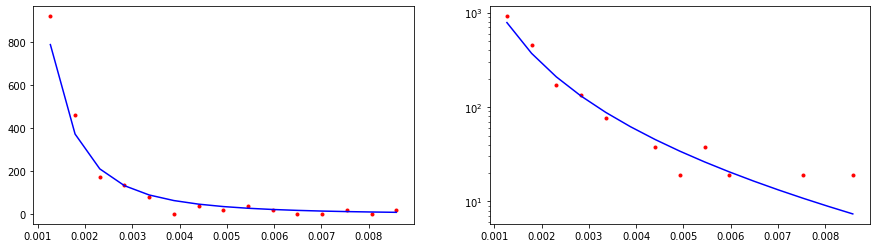

CPU times: user 505 µs, sys: 46 µs, total: 551 µs
Wall time: 390 µs
13449.878066359017


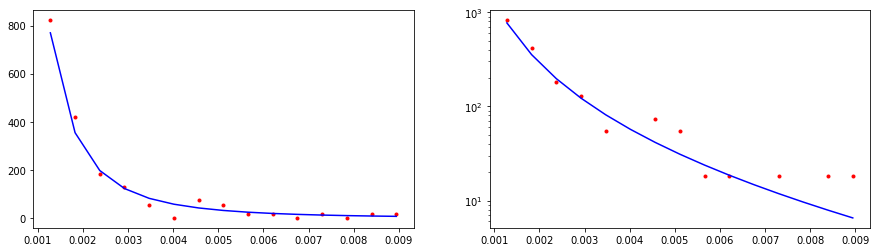

CPU times: user 0 ns, sys: 643 µs, total: 643 µs
Wall time: 480 µs
7103.22717641366


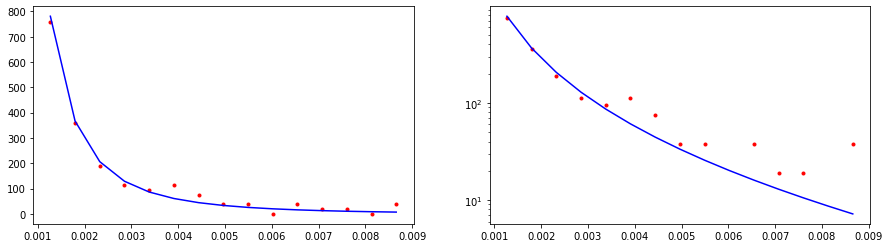

CPU times: user 0 ns, sys: 628 µs, total: 628 µs
Wall time: 475 µs
32837.16609488142


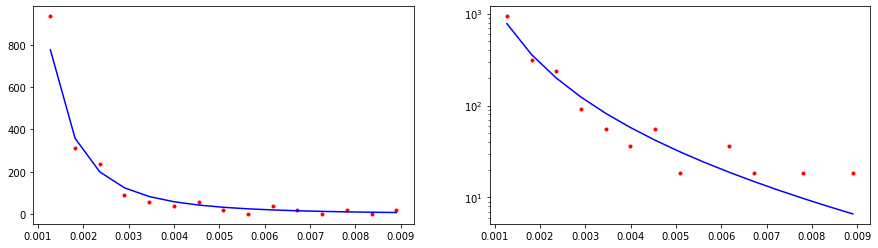

CPU times: user 667 µs, sys: 62 µs, total: 729 µs
Wall time: 609 µs
187753.35435419471


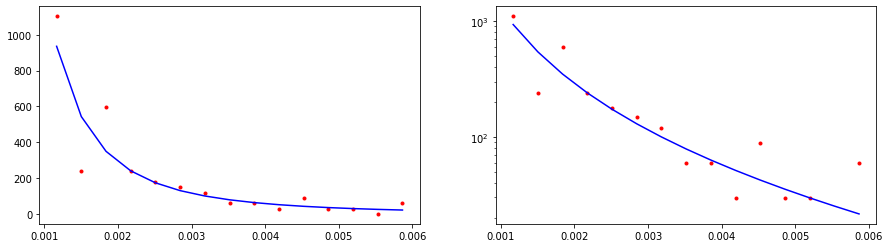

CPU times: user 966 µs, sys: 0 ns, total: 966 µs
Wall time: 783 µs
33354.60747134934


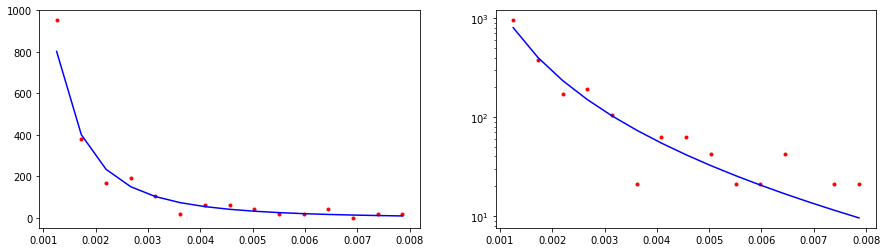

CPU times: user 1.08 ms, sys: 7 µs, total: 1.08 ms
Wall time: 984 µs
13634.590156579672


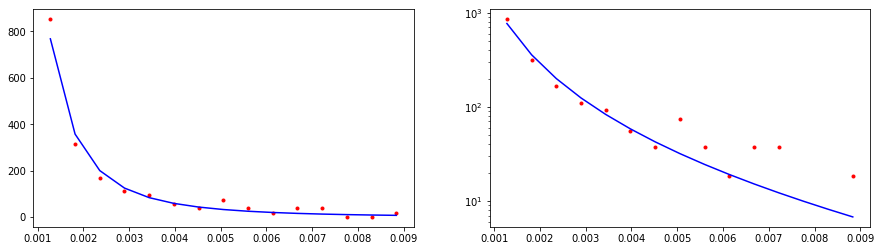

CPU times: user 1.35 ms, sys: 33 µs, total: 1.39 ms
Wall time: 1.2 ms
30039.174544286114


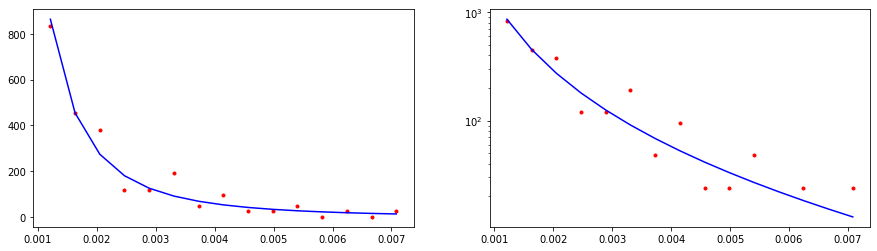

CPU times: user 1.52 ms, sys: 0 ns, total: 1.52 ms
Wall time: 1.35 ms
44265.25392867114


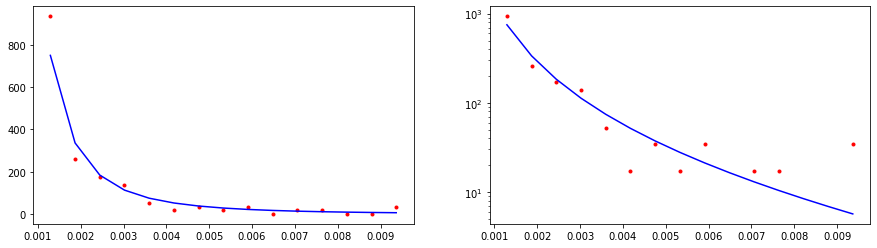

CPU times: user 1.68 ms, sys: 0 ns, total: 1.68 ms
Wall time: 1.5 ms
31051.213295446498


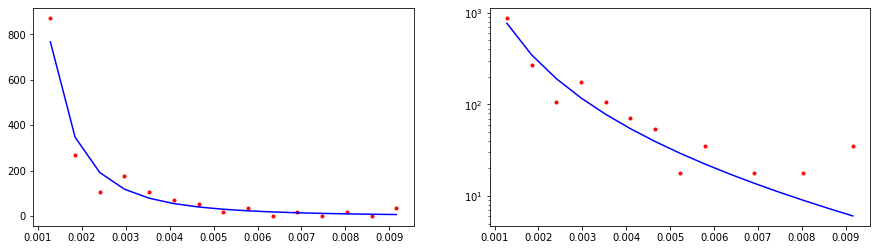

CPU times: user 1.77 ms, sys: 72 µs, total: 1.84 ms
Wall time: 1.62 ms
19242.99358011137


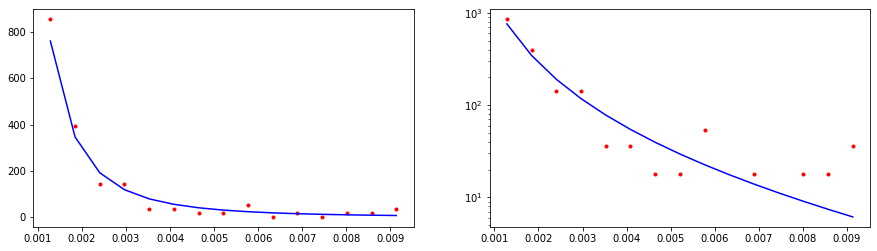

CPU times: user 1.94 ms, sys: 9 µs, total: 1.95 ms
Wall time: 1.76 ms
9929.969583351118


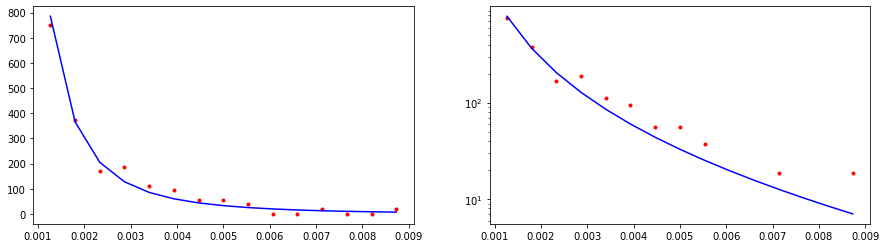

CPU times: user 486 µs, sys: 45 µs, total: 531 µs
Wall time: 318 µs
24910.116816362948


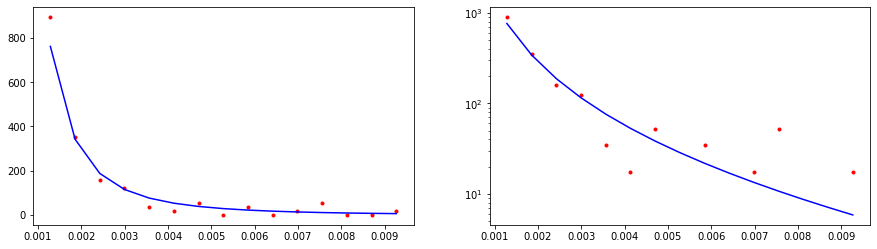

CPU times: user 436 µs, sys: 0 ns, total: 436 µs
Wall time: 329 µs
68396.63966059823


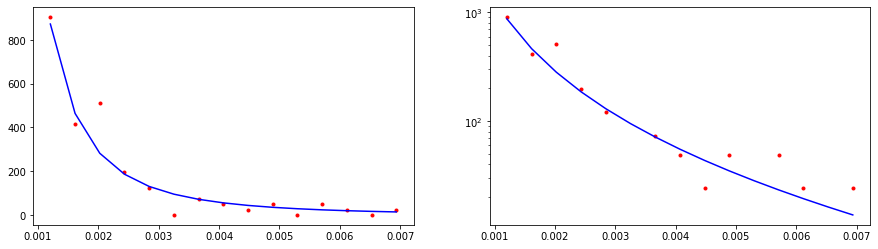

CPU times: user 472 µs, sys: 0 ns, total: 472 µs
Wall time: 380 µs
10582.642021449125


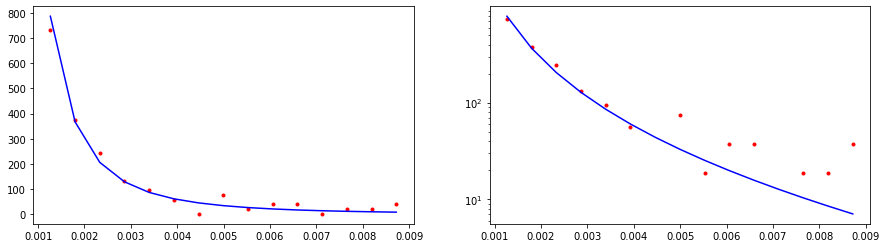

CPU times: user 0 ns, sys: 493 µs, total: 493 µs
Wall time: 336 µs
25249.65916644649


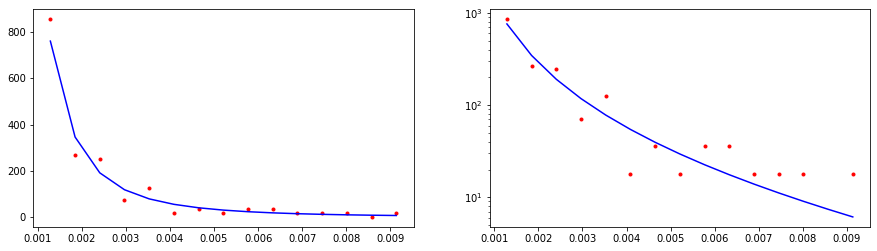

CPU times: user 0 ns, sys: 551 µs, total: 551 µs
Wall time: 403 µs
16828.900975538712


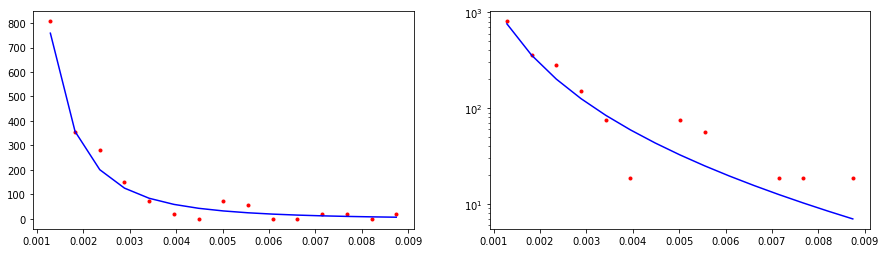

CPU times: user 548 µs, sys: 51 µs, total: 599 µs
Wall time: 441 µs
64628.956372024404


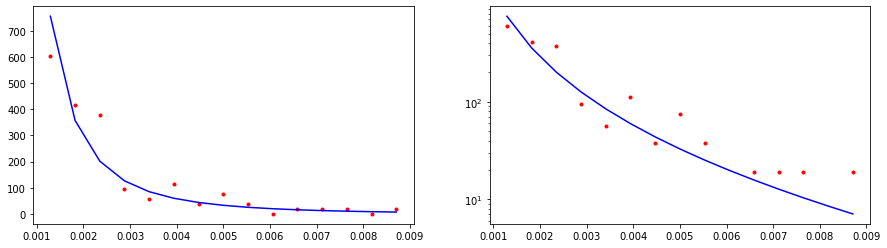

CPU times: user 581 µs, sys: 0 ns, total: 581 µs
Wall time: 434 µs
61208.00495082827


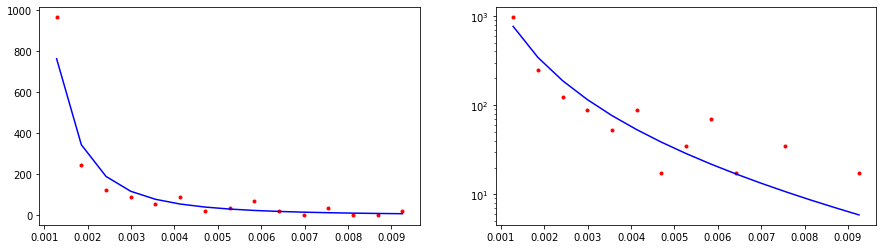

CPU times: user 850 µs, sys: 0 ns, total: 850 µs
Wall time: 690 µs
35848.27408026507


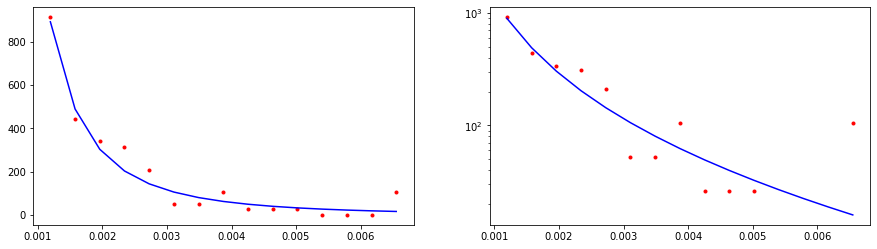

CPU times: user 861 µs, sys: 0 ns, total: 861 µs
Wall time: 765 µs
25100.631417666213


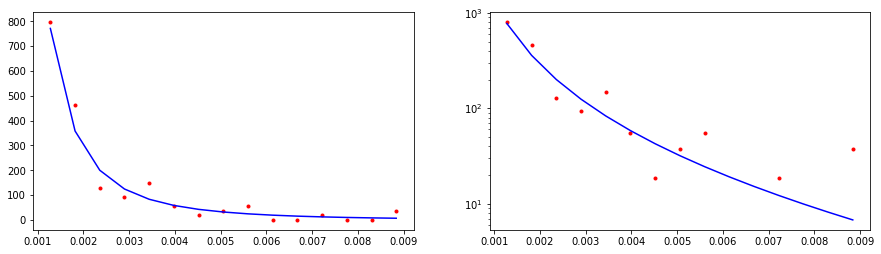

CPU times: user 1.17 ms, sys: 17 µs, total: 1.19 ms
Wall time: 1.03 ms
31410.298507826188


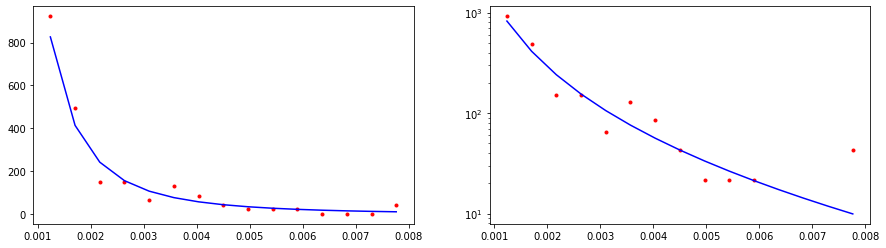

CPU times: user 464 µs, sys: 912 µs, total: 1.38 ms
Wall time: 1.19 ms
7526.629061970148


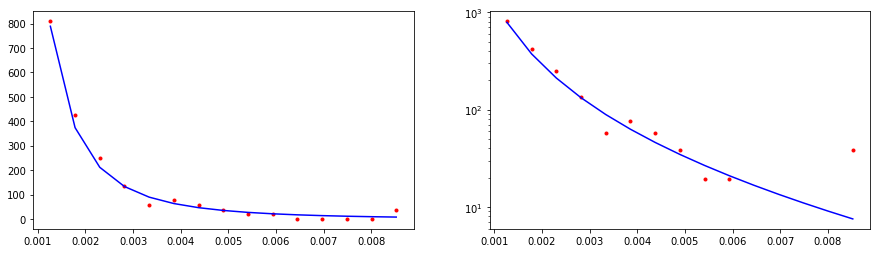

CPU times: user 666 µs, sys: 851 µs, total: 1.52 ms
Wall time: 1.34 ms
17074.972616403098


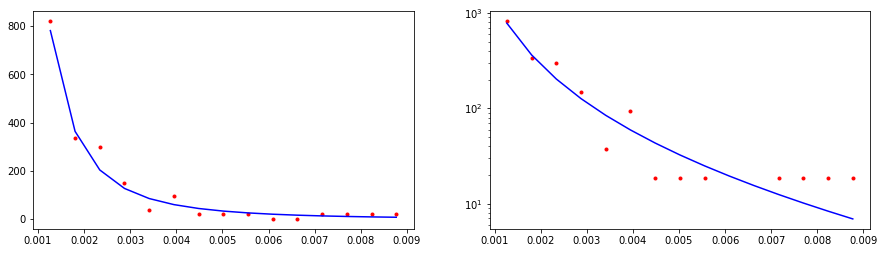

CPU times: user 1.69 ms, sys: 0 ns, total: 1.69 ms
Wall time: 1.51 ms
10462.916402174633


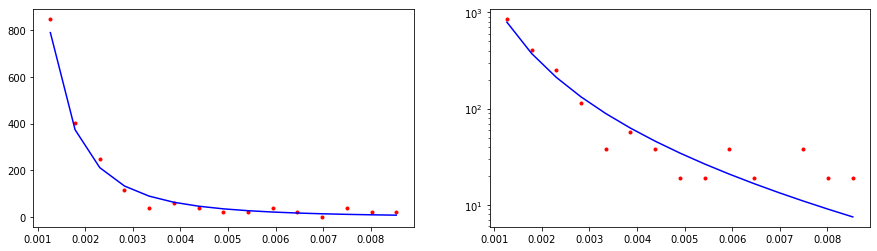

CPU times: user 1.76 ms, sys: 0 ns, total: 1.76 ms
Wall time: 1.59 ms
79475.84875137433


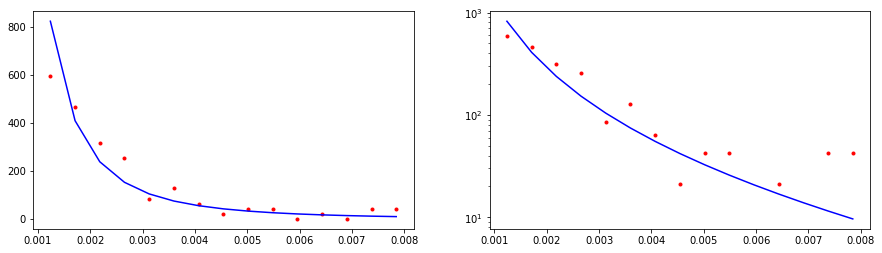

CPU times: user 2.03 ms, sys: 3 µs, total: 2.03 ms
Wall time: 1.85 ms
23439.12729664349


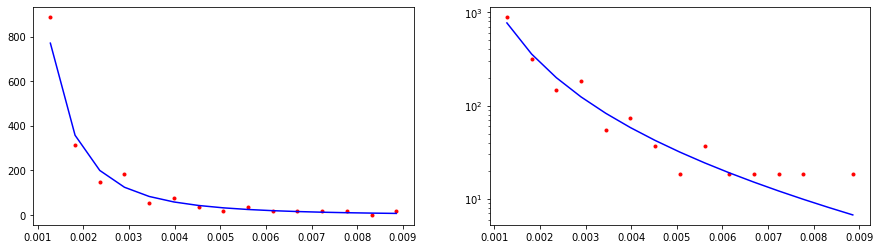

CPU times: user 645 µs, sys: 0 ns, total: 645 µs
Wall time: 403 µs
38532.828296567


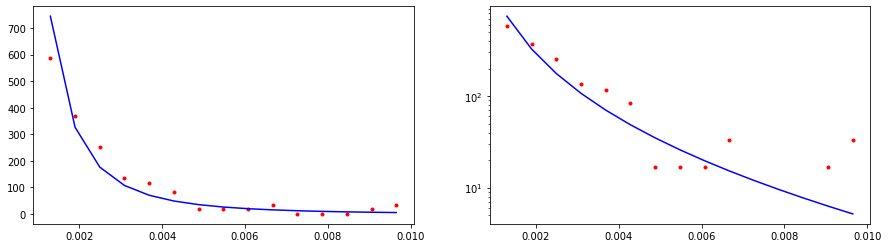

CPU times: user 409 µs, sys: 39 µs, total: 448 µs
Wall time: 291 µs
104309.22490563216


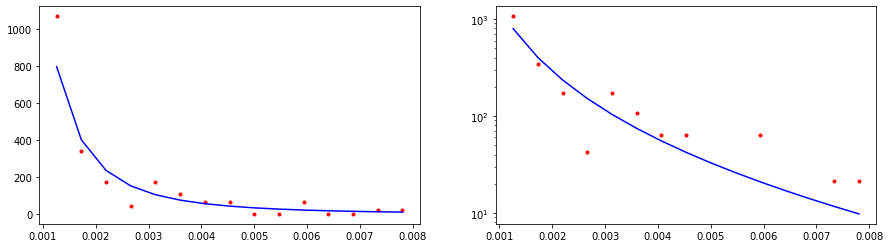

CPU times: user 0 ns, sys: 539 µs, total: 539 µs
Wall time: 381 µs
91406.30875036649


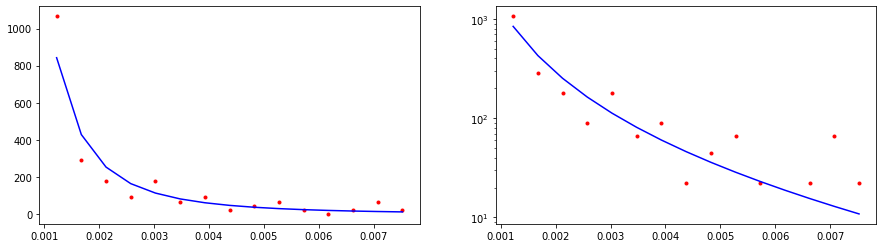

CPU times: user 523 µs, sys: 0 ns, total: 523 µs
Wall time: 407 µs
41800.65113103563


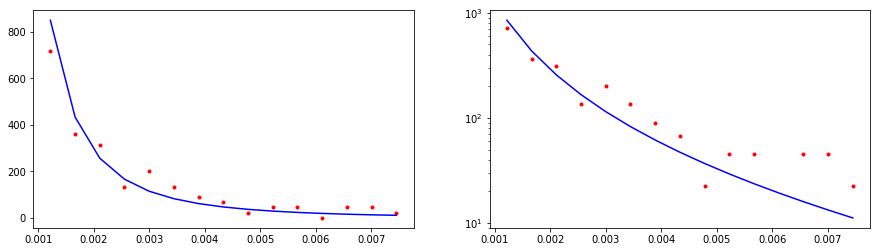

CPU times: user 0 ns, sys: 607 µs, total: 607 µs
Wall time: 441 µs
22569.76324521735


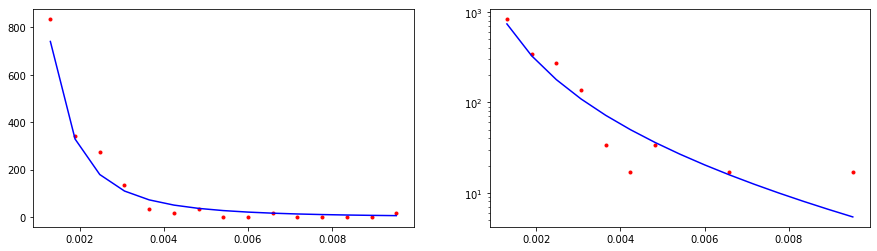

CPU times: user 578 µs, sys: 55 µs, total: 633 µs
Wall time: 479 µs
102207.33143378313


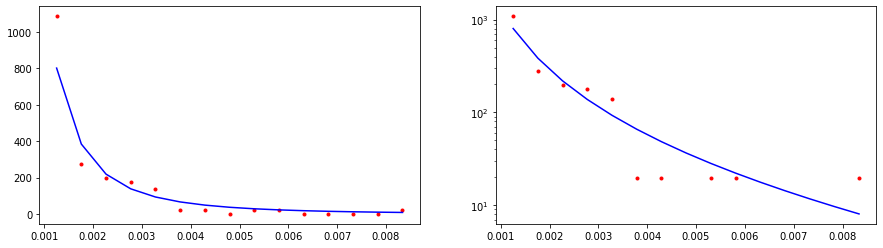

CPU times: user 558 µs, sys: 53 µs, total: 611 µs
Wall time: 454 µs
41871.381375676894


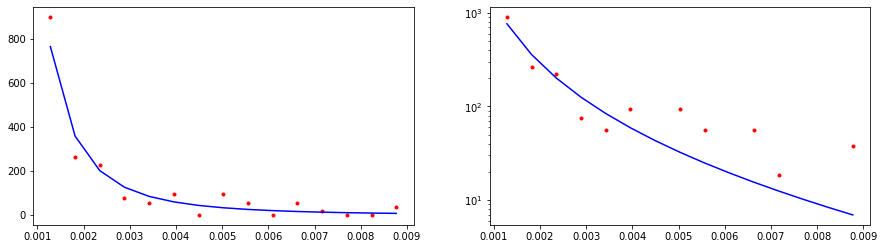

CPU times: user 802 µs, sys: 0 ns, total: 802 µs
Wall time: 685 µs
17406.7527313988


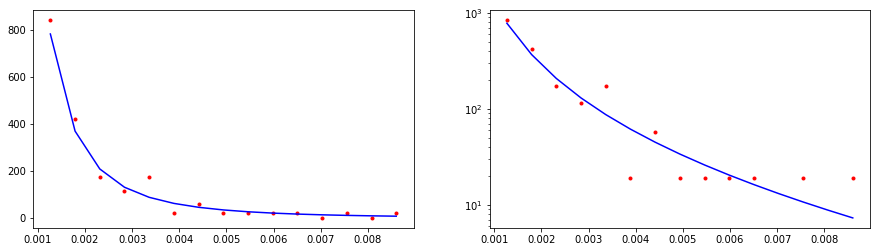

CPU times: user 1.01 ms, sys: 9 µs, total: 1.02 ms
Wall time: 849 µs
27091.995581969615


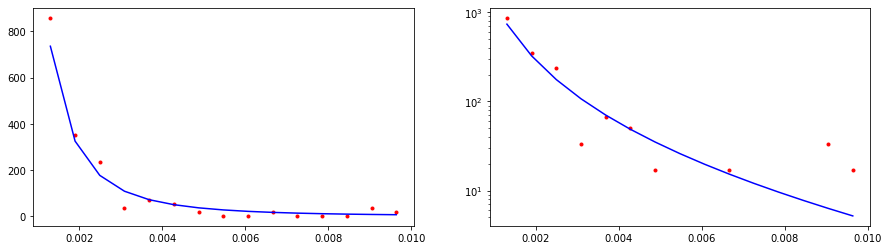

CPU times: user 1.17 ms, sys: 16 µs, total: 1.18 ms
Wall time: 1.02 ms
58195.30034395305


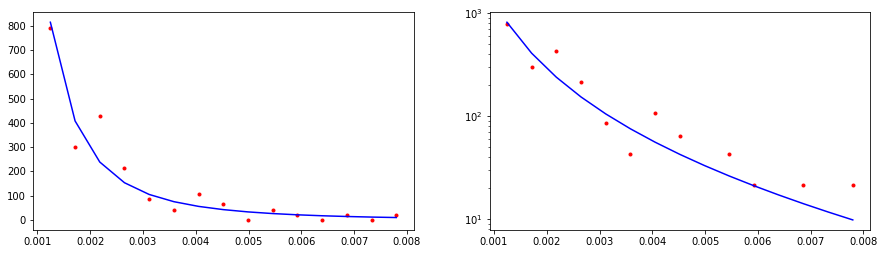

CPU times: user 1.34 ms, sys: 0 ns, total: 1.34 ms
Wall time: 1.17 ms
93394.00249748431


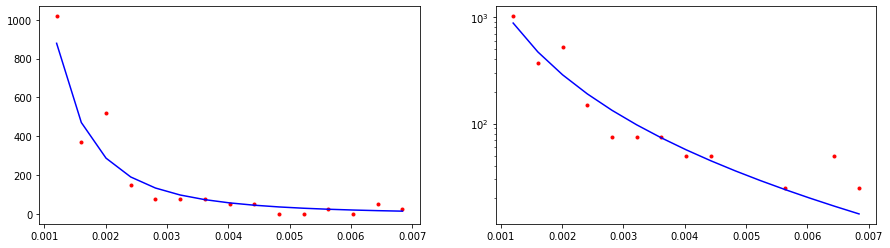

CPU times: user 1.48 ms, sys: 45 µs, total: 1.52 ms
Wall time: 1.37 ms
27673.067810250133


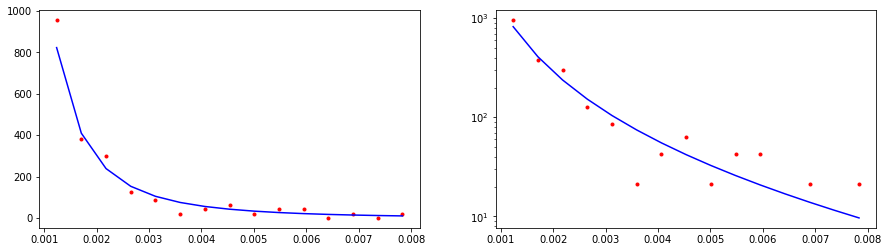

CPU times: user 1.52 ms, sys: 50 µs, total: 1.57 ms
Wall time: 1.39 ms
10104.088324066994


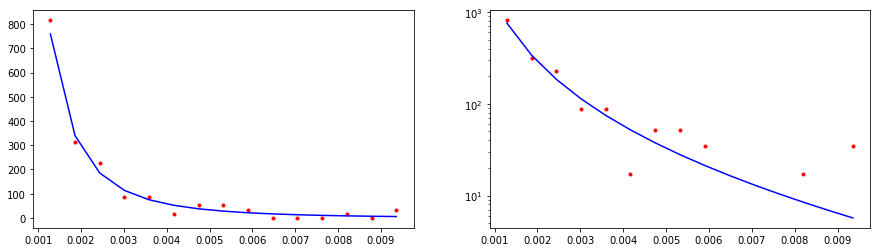

CPU times: user 931 µs, sys: 881 µs, total: 1.81 ms
Wall time: 1.64 ms
46264.72211046273


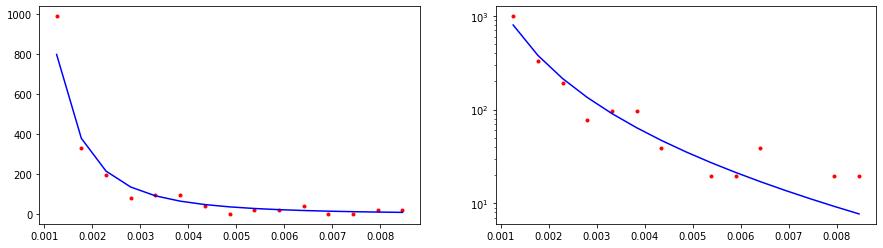

CPU times: user 1.98 ms, sys: 0 ns, total: 1.98 ms
Wall time: 1.8 ms
8981.579274262813


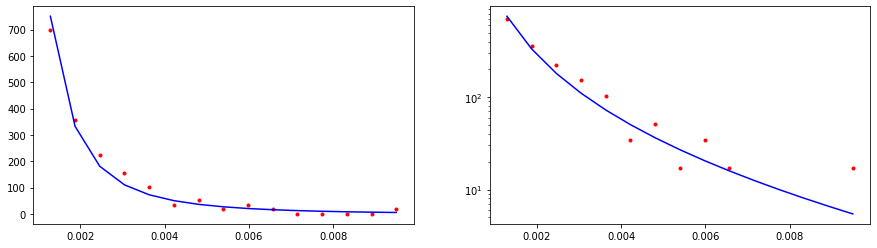

CPU times: user 667 µs, sys: 0 ns, total: 667 µs
Wall time: 421 µs
21208.671618887944


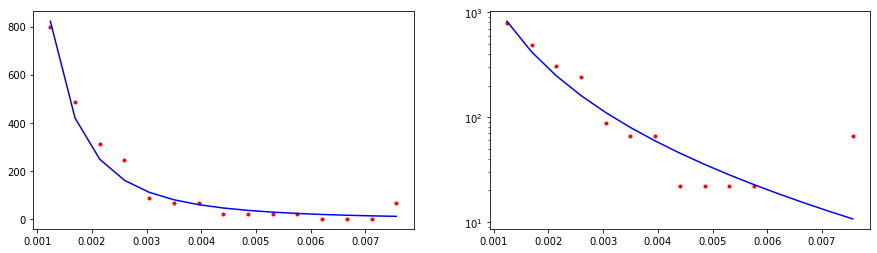

CPU times: user 441 µs, sys: 42 µs, total: 483 µs
Wall time: 329 µs
53482.3160182743


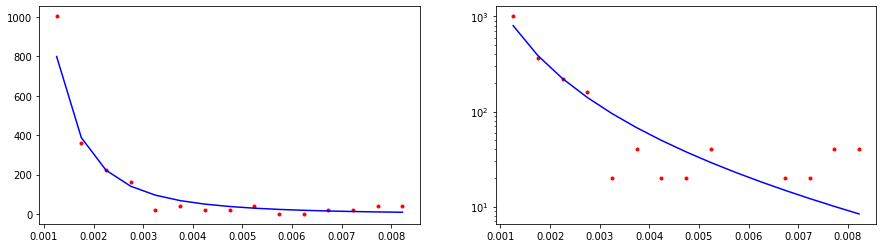

CPU times: user 0 ns, sys: 523 µs, total: 523 µs
Wall time: 363 µs
43203.43656700792


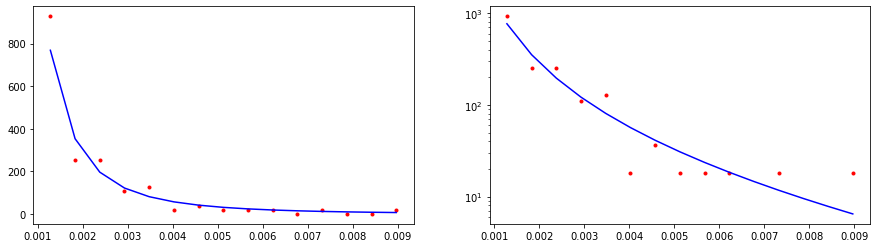

CPU times: user 504 µs, sys: 48 µs, total: 552 µs
Wall time: 382 µs
7659.809068261991


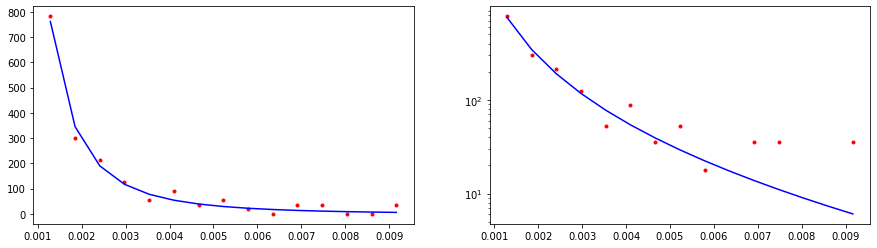

CPU times: user 515 µs, sys: 49 µs, total: 564 µs
Wall time: 402 µs
26181.023935807996


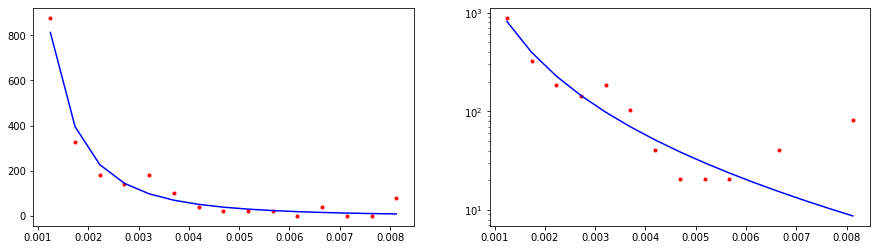

CPU times: user 645 µs, sys: 0 ns, total: 645 µs
Wall time: 478 µs
40531.281999587176


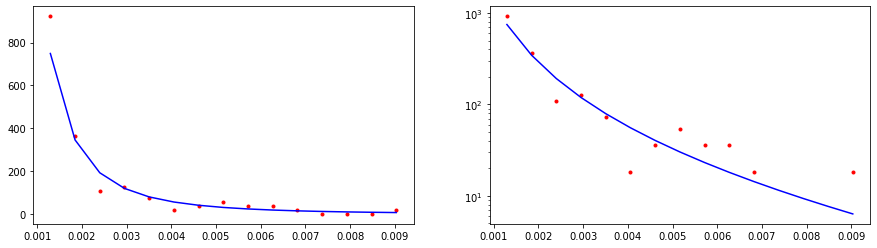

CPU times: user 612 µs, sys: 59 µs, total: 671 µs
Wall time: 499 µs
28794.86988986127


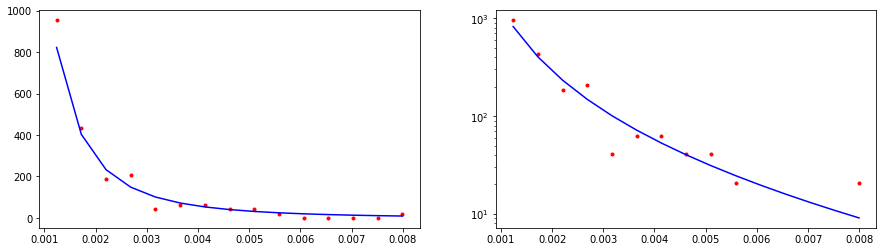

CPU times: user 873 µs, sys: 0 ns, total: 873 µs
Wall time: 712 µs
10892.505716915493


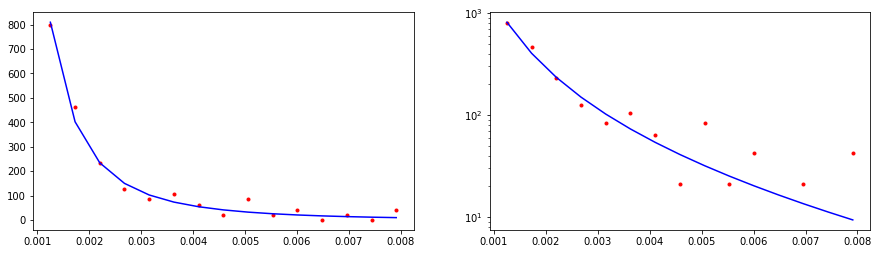

CPU times: user 977 µs, sys: 0 ns, total: 977 µs
Wall time: 827 µs
32481.126315624253


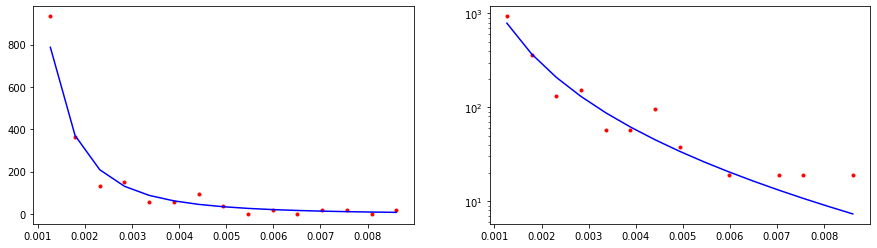

CPU times: user 1.18 ms, sys: 18 µs, total: 1.19 ms
Wall time: 1.02 ms
19813.887456219967


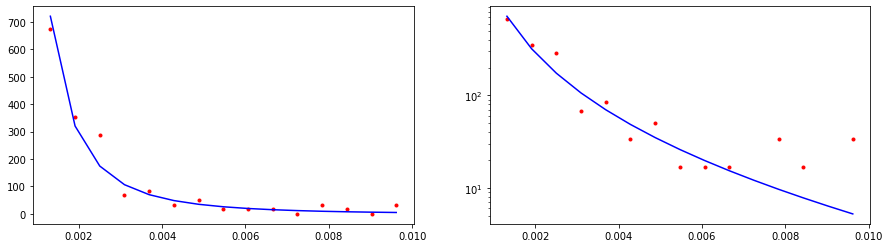

CPU times: user 398 µs, sys: 939 µs, total: 1.34 ms
Wall time: 1.18 ms
6838.249222971531


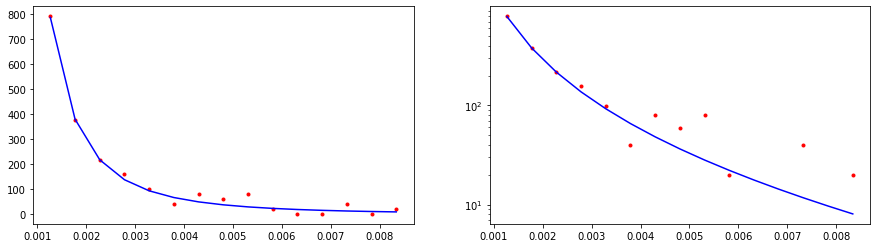

CPU times: user 1.43 ms, sys: 42 µs, total: 1.47 ms
Wall time: 1.29 ms
4216.4566186748


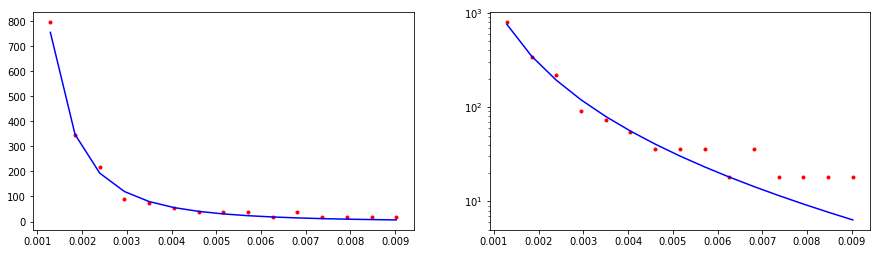

CPU times: user 1.64 ms, sys: 62 µs, total: 1.7 ms
Wall time: 1.52 ms
20134.45007193829


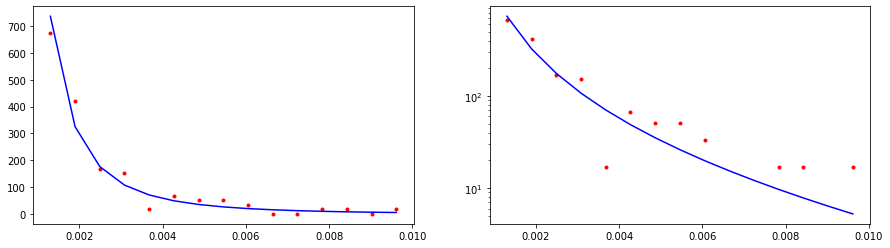

CPU times: user 1.71 ms, sys: 68 µs, total: 1.77 ms
Wall time: 1.61 ms
6552.022502024773


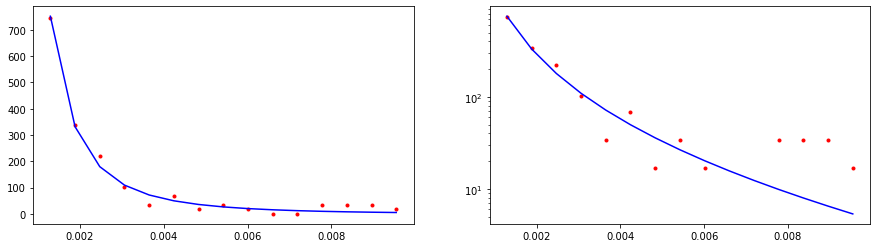

CPU times: user 1.78 ms, sys: 75 µs, total: 1.85 ms
Wall time: 1.68 ms
12536.454635659284


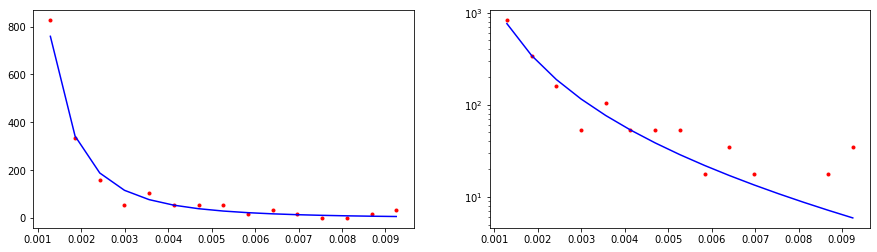

CPU times: user 730 µs, sys: 71 µs, total: 801 µs
Wall time: 508 µs
22668.180264052608


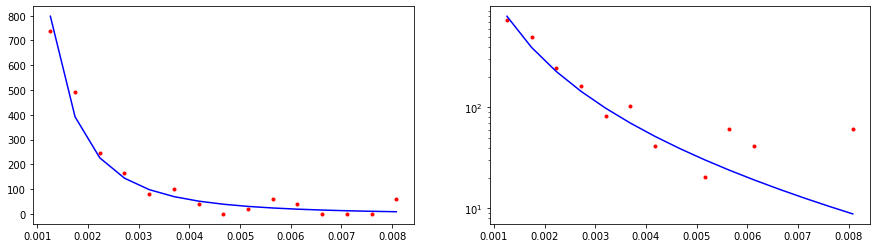

In [35]:
for _ in range(loops):
    for nn_iter in n_iter:
        evran.set_rutherford_iterations(nn_iter)
        %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
        S_everest[nn_iter] = np.array([ *S_everest[nn_iter], test_random(r_everest, bins, f) ])
    %time r_k2 = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_K2 = np.array([ *S_K2, test_random(r_k2, bins, f) ])

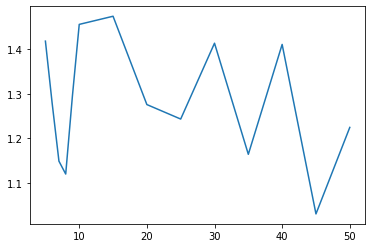

In [36]:
plt.plot(n_iter, [ np.sqrt((S_everest[nn_iter] / S_K2).mean()) for nn_iter in n_iter ])

In [43]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 100
n_iter = list(range(1,31))#[5, 6, 7, 8, 9, 10, 15, 20, 25, 30, 35, 40, 45, 50]
bins = 15

loops = 20
S_everest = { nn: [] for nn in n_iter }
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 72 µs, sys: 10 µs, total: 82 µs
Wall time: 161 µs
6203740.265806977


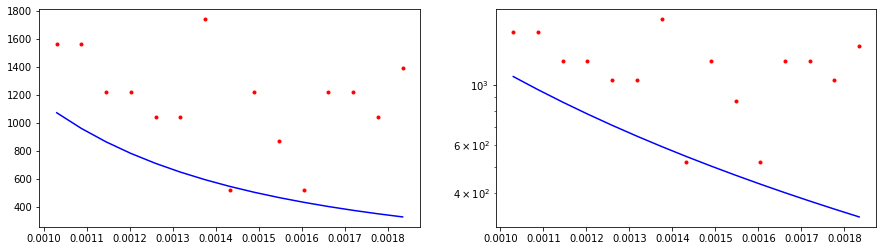

CPU times: user 295 µs, sys: 0 ns, total: 295 µs
Wall time: 208 µs
564476.5071307922


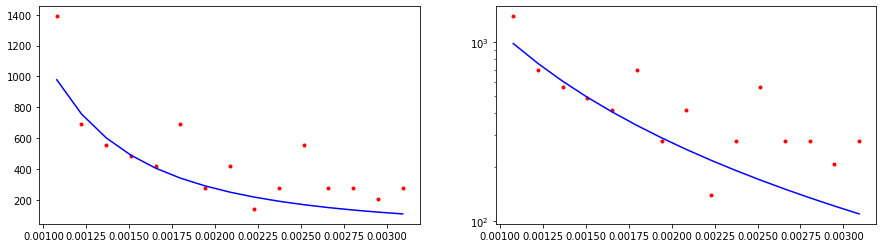

CPU times: user 333 µs, sys: 0 ns, total: 333 µs
Wall time: 223 µs
176840.4570696998


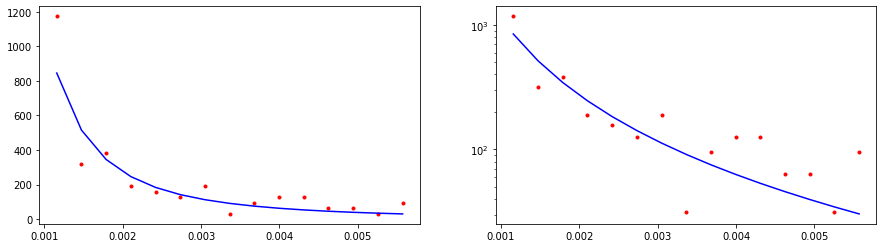

CPU times: user 272 µs, sys: 36 µs, total: 308 µs
Wall time: 273 µs
20783.21562864567


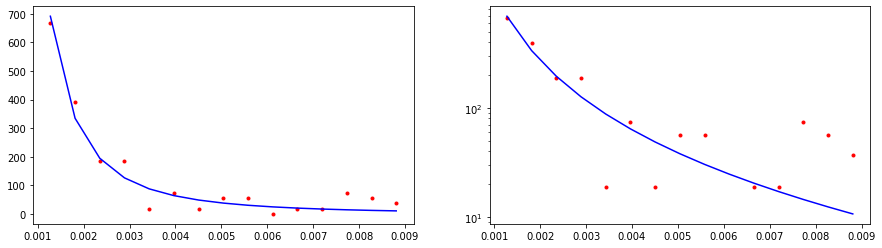

CPU times: user 488 µs, sys: 64 µs, total: 552 µs
Wall time: 362 µs
33176.9112495765


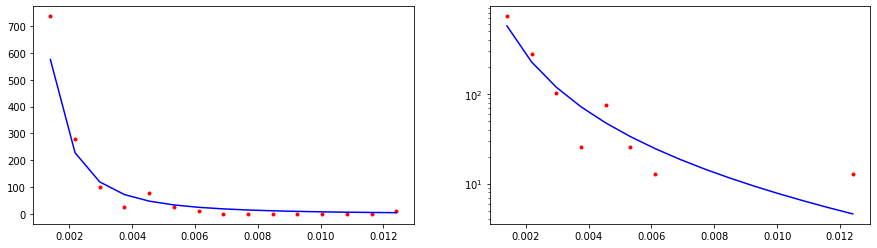

CPU times: user 605 µs, sys: 0 ns, total: 605 µs
Wall time: 441 µs
6434.19681636698


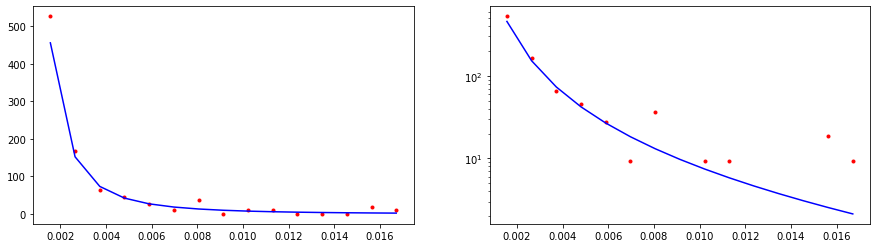

CPU times: user 0 ns, sys: 603 µs, total: 603 µs
Wall time: 423 µs
5629.3113539657


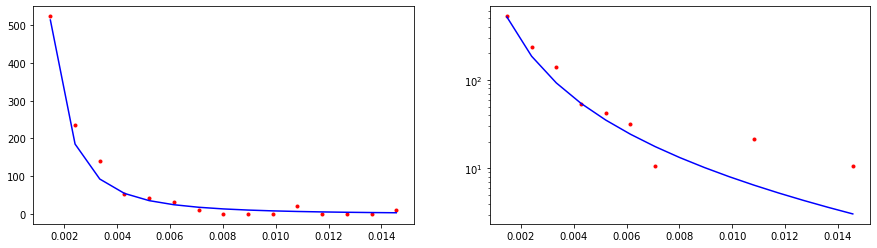

CPU times: user 574 µs, sys: 0 ns, total: 574 µs
Wall time: 393 µs
15552.870507644926


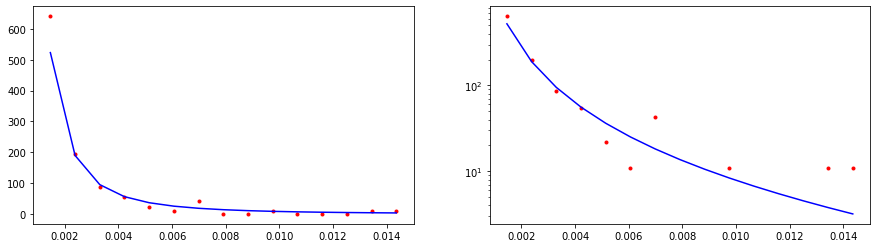

CPU times: user 544 µs, sys: 0 ns, total: 544 µs
Wall time: 389 µs
6565.230285792288


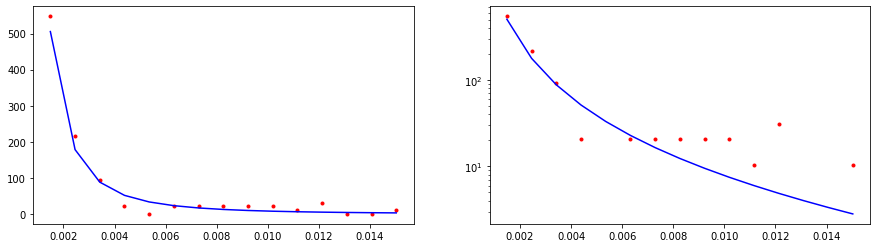

CPU times: user 634 µs, sys: 0 ns, total: 634 µs
Wall time: 472 µs
24342.804765968758


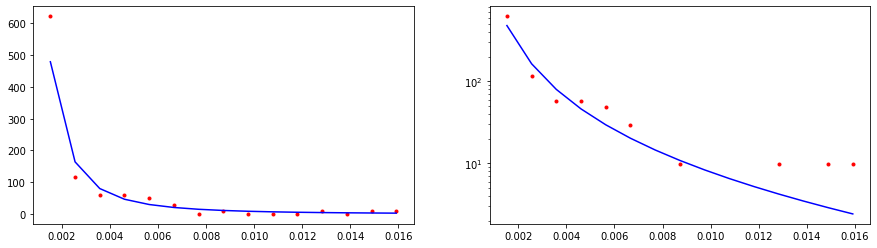

CPU times: user 575 µs, sys: 76 µs, total: 651 µs
Wall time: 474 µs
2496.465598343173


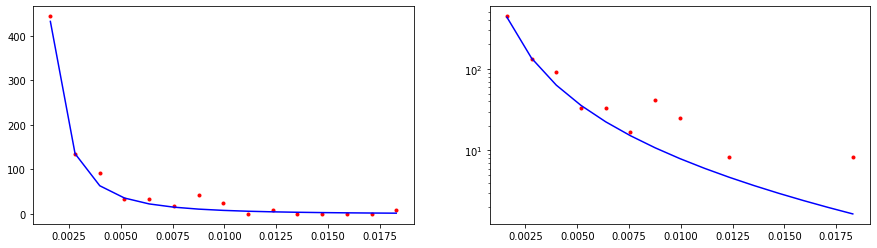

CPU times: user 593 µs, sys: 78 µs, total: 671 µs
Wall time: 508 µs
19494.389549149873


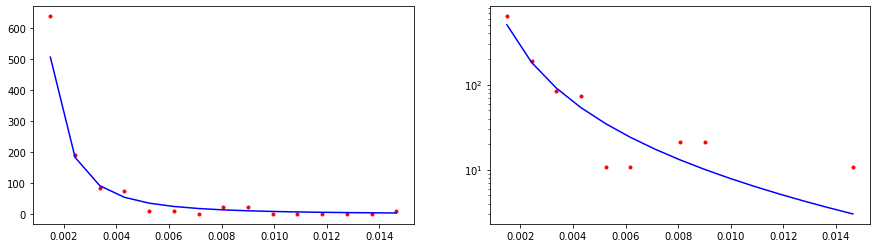

CPU times: user 588 µs, sys: 77 µs, total: 665 µs
Wall time: 546 µs
9456.402235321026


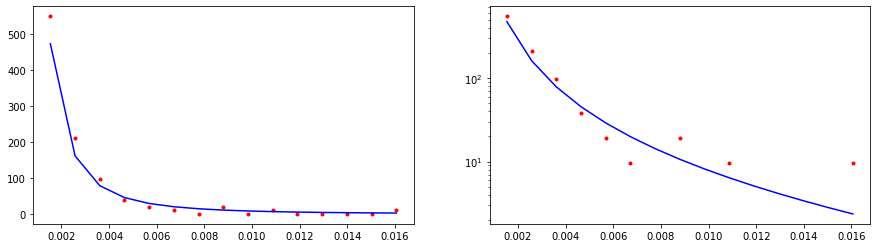

CPU times: user 597 µs, sys: 78 µs, total: 675 µs
Wall time: 569 µs
10219.563446174476


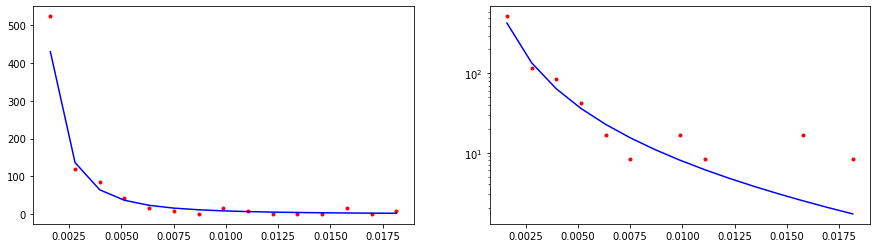

CPU times: user 815 µs, sys: 0 ns, total: 815 µs
Wall time: 642 µs
12062.605286144968


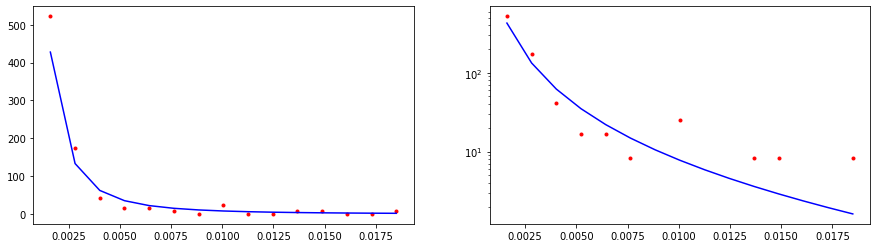

CPU times: user 0 ns, sys: 792 µs, total: 792 µs
Wall time: 609 µs
18370.081831403128


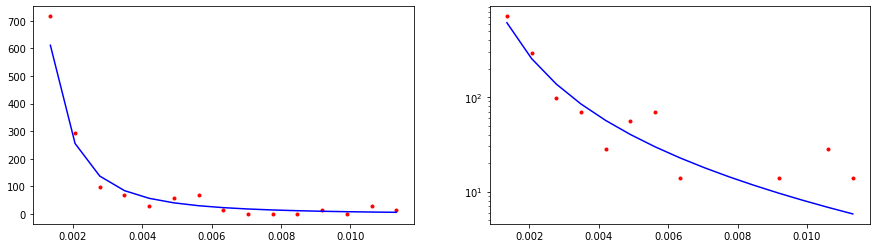

CPU times: user 0 ns, sys: 842 µs, total: 842 µs
Wall time: 675 µs
32458.82544060172


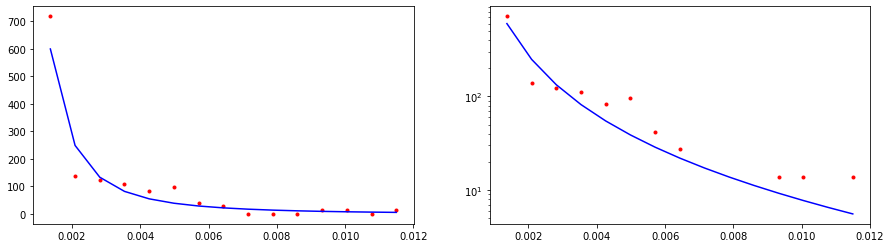

CPU times: user 916 µs, sys: 0 ns, total: 916 µs
Wall time: 738 µs
8336.23442877404


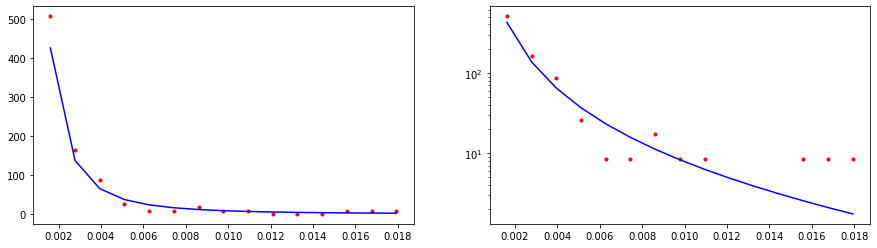

CPU times: user 872 µs, sys: 0 ns, total: 872 µs
Wall time: 700 µs
22157.531697032166


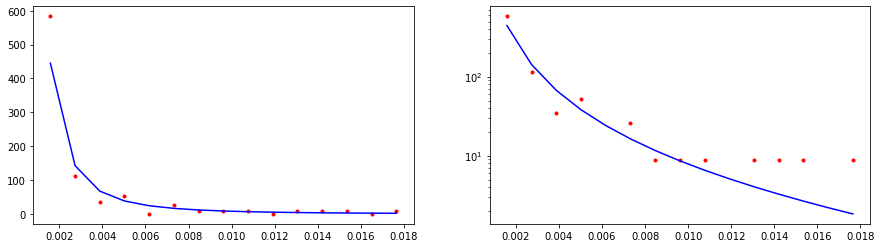

CPU times: user 993 µs, sys: 0 ns, total: 993 µs
Wall time: 802 µs
9701.621936628428


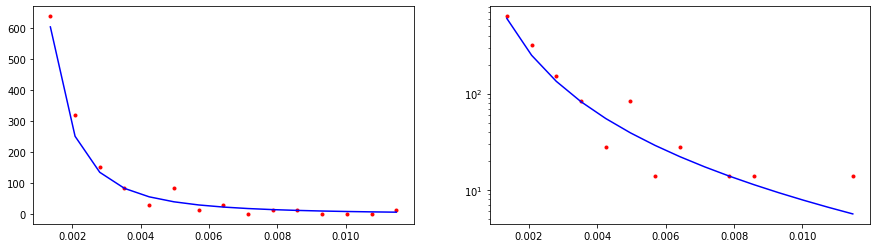

CPU times: user 84 µs, sys: 865 µs, total: 949 µs
Wall time: 778 µs
9017.064091980334


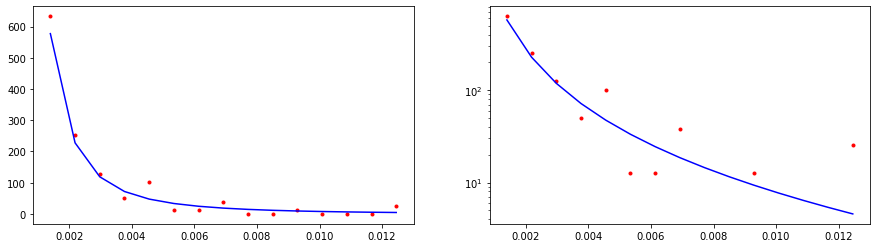

CPU times: user 955 µs, sys: 2 µs, total: 957 µs
Wall time: 788 µs
8317.723821379112


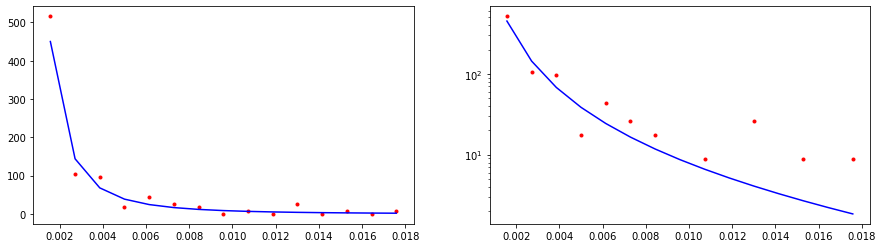

CPU times: user 1.07 ms, sys: 9 µs, total: 1.08 ms
Wall time: 890 µs
1929.3148389114308


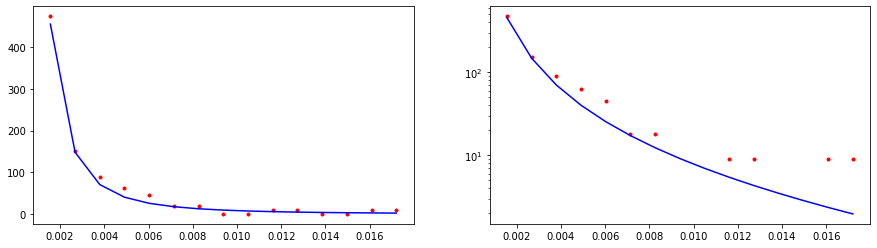

CPU times: user 1.06 ms, sys: 0 ns, total: 1.06 ms
Wall time: 870 µs
3788.6413814437965


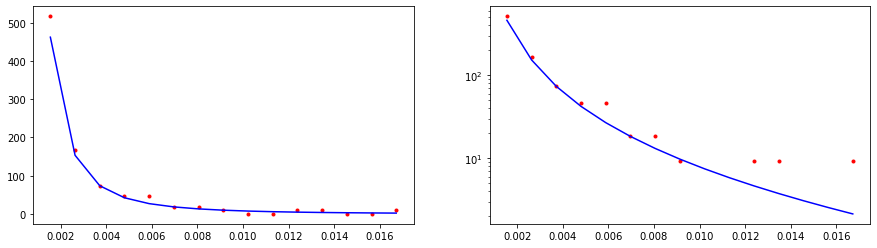

CPU times: user 1.26 ms, sys: 0 ns, total: 1.26 ms
Wall time: 986 µs
8204.285222705423


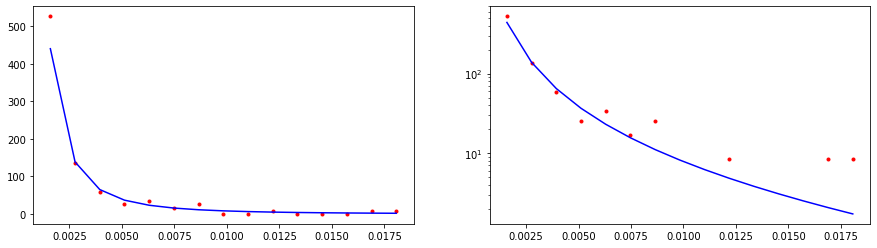

CPU times: user 1.06 ms, sys: 9 µs, total: 1.07 ms
Wall time: 902 µs
27940.3745475527


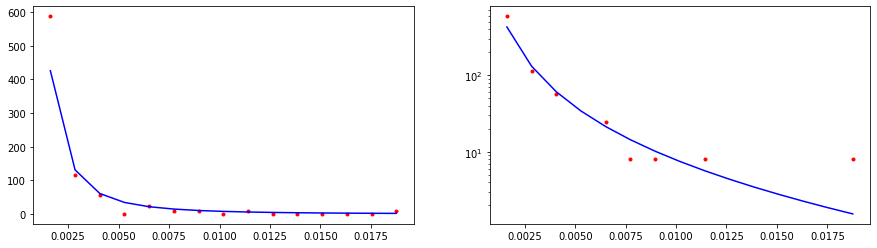

CPU times: user 1.09 ms, sys: 12 µs, total: 1.1 ms
Wall time: 932 µs
11395.059153986986


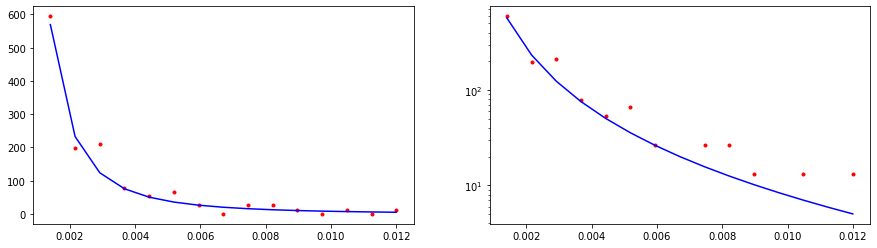

CPU times: user 1.11 ms, sys: 15 µs, total: 1.12 ms
Wall time: 950 µs
12339.366629379645


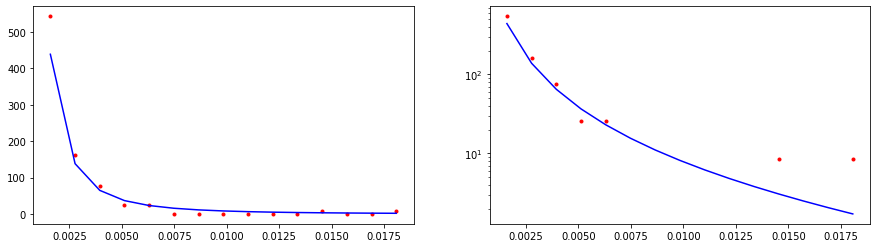

CPU times: user 1.1 ms, sys: 13 µs, total: 1.11 ms
Wall time: 995 µs
26668.566041471695


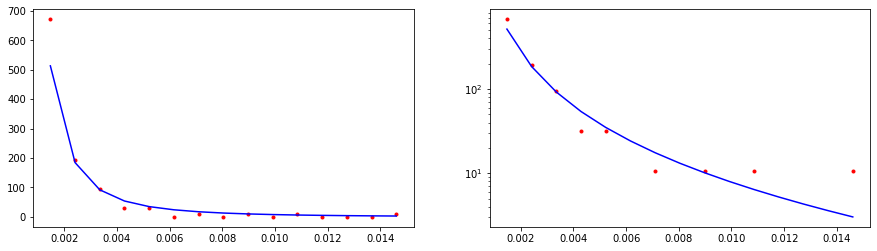

CPU times: user 1.32 ms, sys: 0 ns, total: 1.32 ms
Wall time: 1.14 ms
6210.100825589601


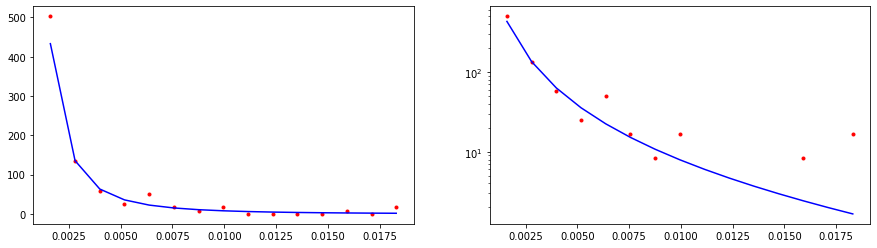

CPU times: user 570 µs, sys: 0 ns, total: 570 µs
Wall time: 368 µs
5094.127945784004


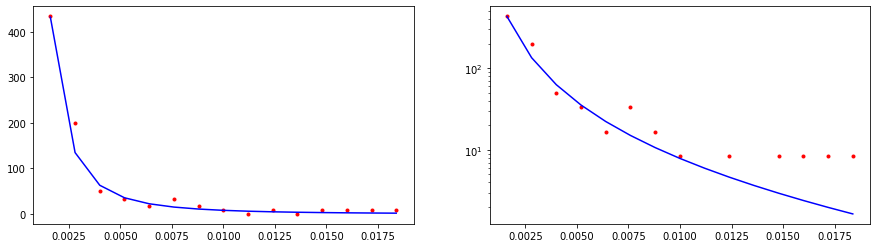

CPU times: user 190 µs, sys: 25 µs, total: 215 µs
Wall time: 175 µs
9266000.784032071


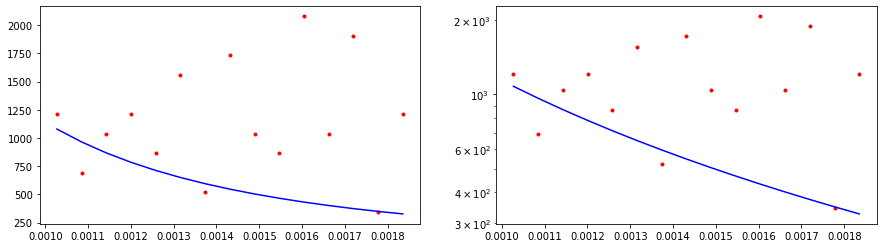

CPU times: user 255 µs, sys: 0 ns, total: 255 µs
Wall time: 218 µs
414806.65751841955


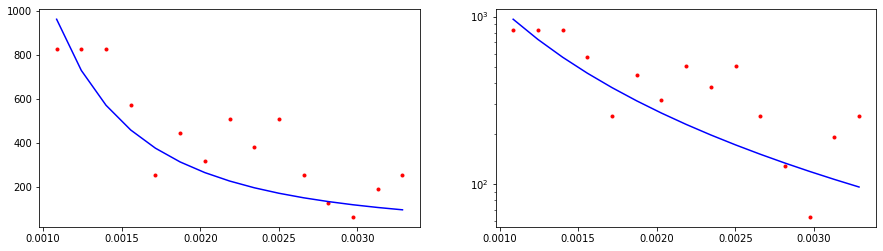

CPU times: user 229 µs, sys: 30 µs, total: 259 µs
Wall time: 224 µs
68333.73541785203


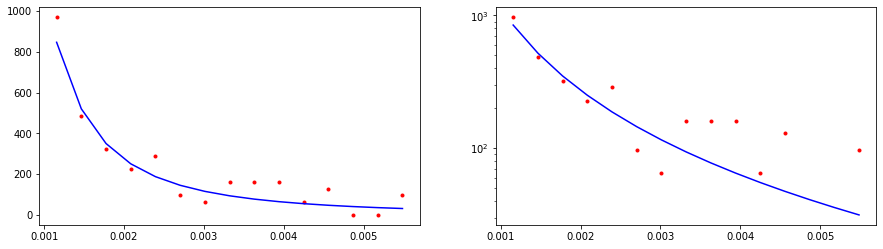

CPU times: user 212 µs, sys: 28 µs, total: 240 µs
Wall time: 214 µs
27666.896080573057


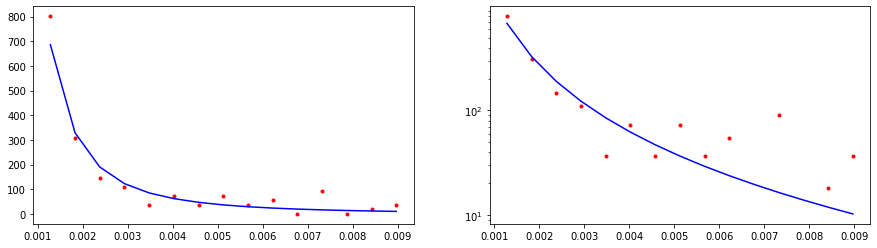

CPU times: user 368 µs, sys: 48 µs, total: 416 µs
Wall time: 254 µs
21902.472952207052


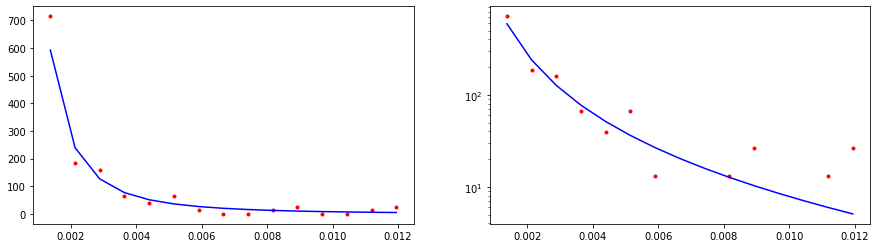

CPU times: user 462 µs, sys: 61 µs, total: 523 µs
Wall time: 344 µs
9701.524798030858


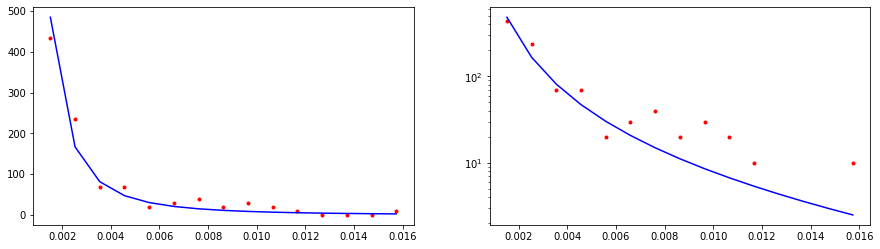

CPU times: user 493 µs, sys: 66 µs, total: 559 µs
Wall time: 366 µs
29546.459135653568


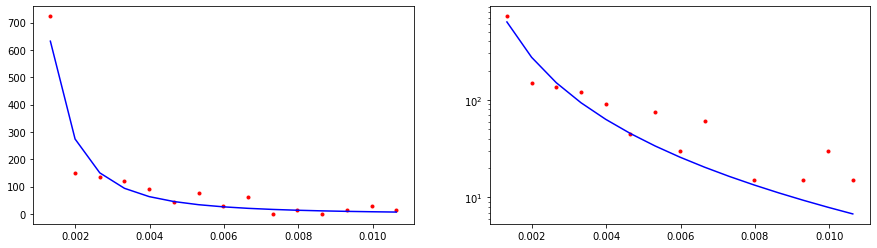

CPU times: user 671 µs, sys: 0 ns, total: 671 µs
Wall time: 479 µs
10045.3062268782


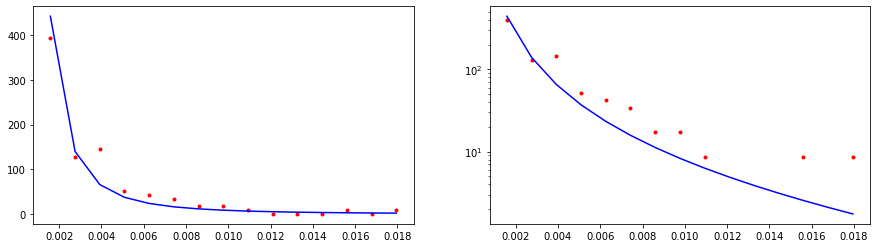

CPU times: user 0 ns, sys: 609 µs, total: 609 µs
Wall time: 439 µs
3573.3922960692353


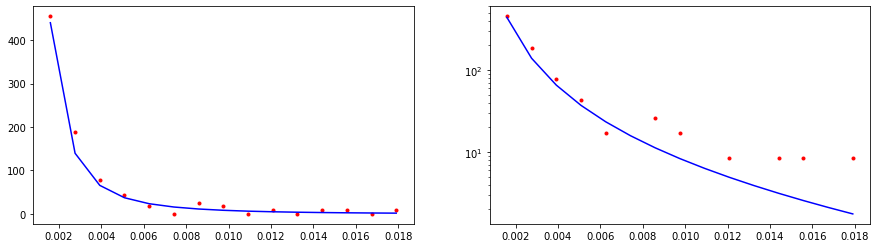

CPU times: user 490 µs, sys: 65 µs, total: 555 µs
Wall time: 446 µs
5130.5109505735745


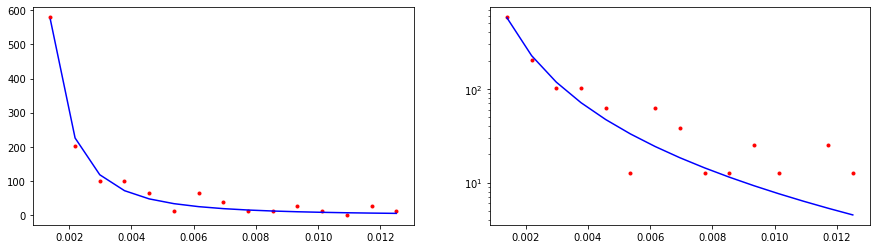

CPU times: user 796 µs, sys: 0 ns, total: 796 µs
Wall time: 588 µs
2623.1503083268713


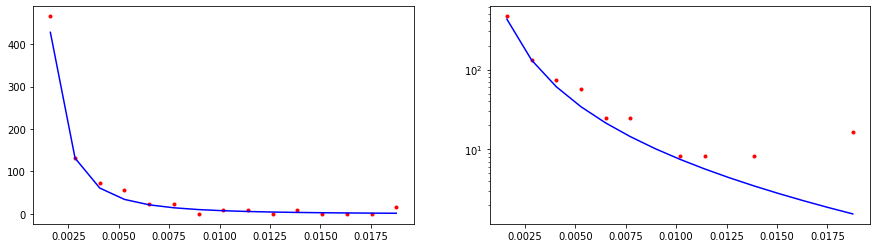

CPU times: user 643 µs, sys: 85 µs, total: 728 µs
Wall time: 559 µs
31658.177732772463


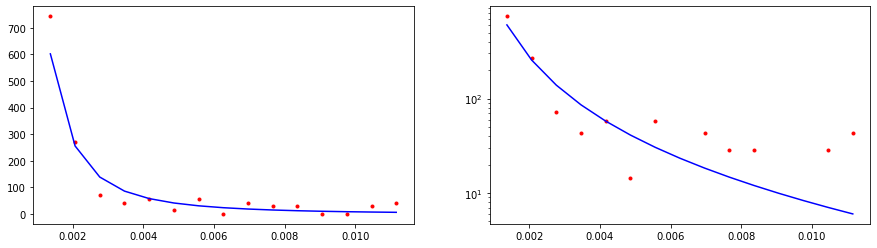

CPU times: user 639 µs, sys: 84 µs, total: 723 µs
Wall time: 546 µs
19415.551968439664


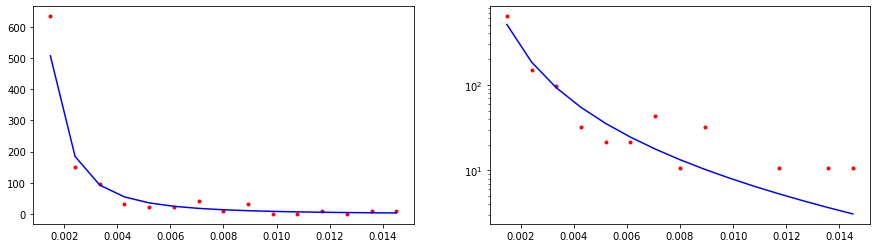

CPU times: user 687 µs, sys: 0 ns, total: 687 µs
Wall time: 531 µs
13355.359329621937


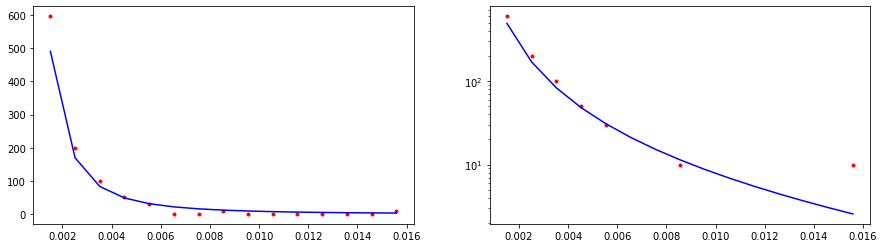

CPU times: user 782 µs, sys: 0 ns, total: 782 µs
Wall time: 606 µs
18188.474763253733


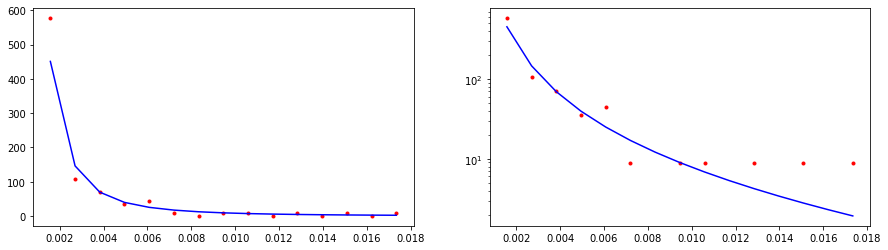

CPU times: user 861 µs, sys: 0 ns, total: 861 µs
Wall time: 674 µs
20685.016991766755


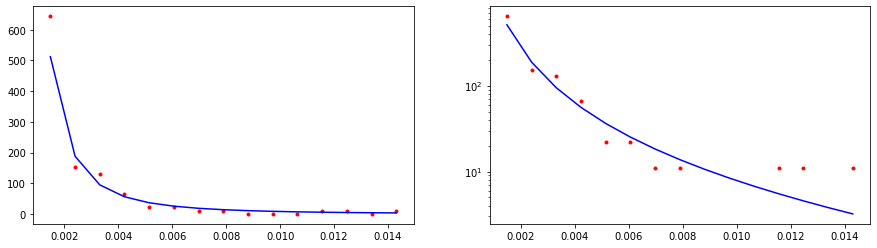

CPU times: user 836 µs, sys: 0 ns, total: 836 µs
Wall time: 671 µs
18934.387799114018


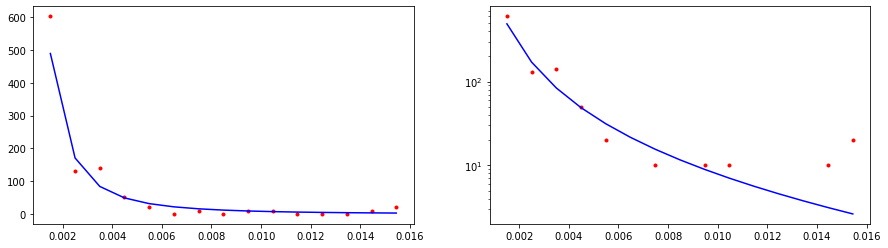

CPU times: user 871 µs, sys: 0 ns, total: 871 µs
Wall time: 679 µs
19514.697177121216


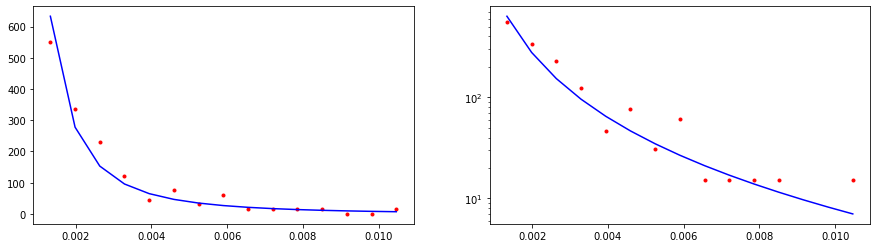

CPU times: user 731 µs, sys: 97 µs, total: 828 µs
Wall time: 709 µs
11582.440164806389


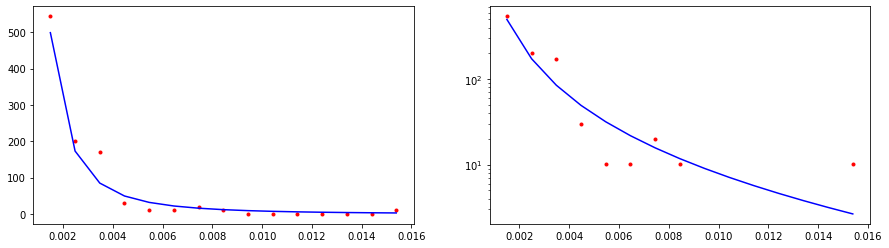

CPU times: user 978 µs, sys: 0 ns, total: 978 µs
Wall time: 801 µs
28143.665109687194


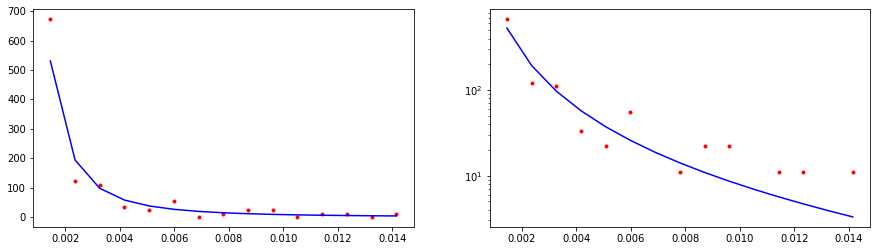

CPU times: user 1.01 ms, sys: 2 µs, total: 1.01 ms
Wall time: 829 µs
35671.16269310534


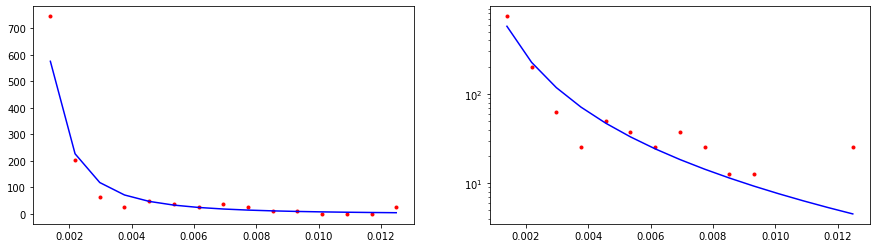

CPU times: user 985 µs, sys: 0 ns, total: 985 µs
Wall time: 807 µs
31872.99647687696


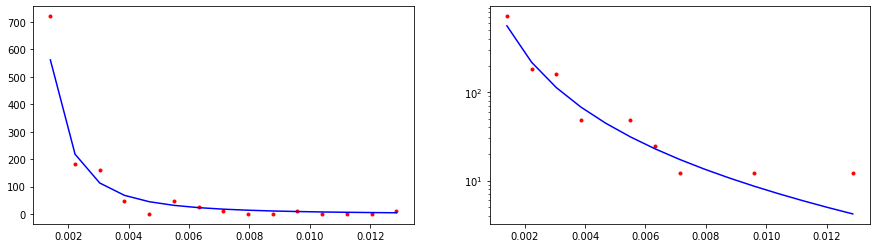

CPU times: user 1.03 ms, sys: 4 µs, total: 1.03 ms
Wall time: 855 µs
9008.202681660292


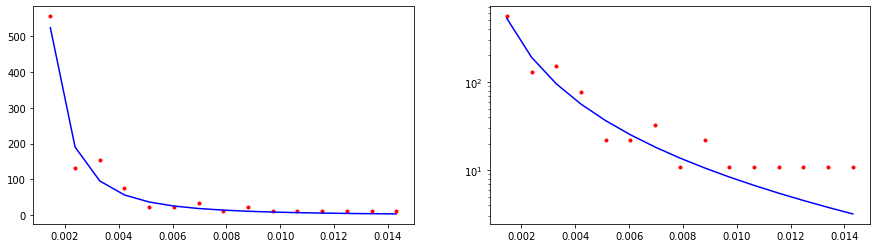

CPU times: user 1.05 ms, sys: 15 µs, total: 1.06 ms
Wall time: 877 µs
4074.246118865646


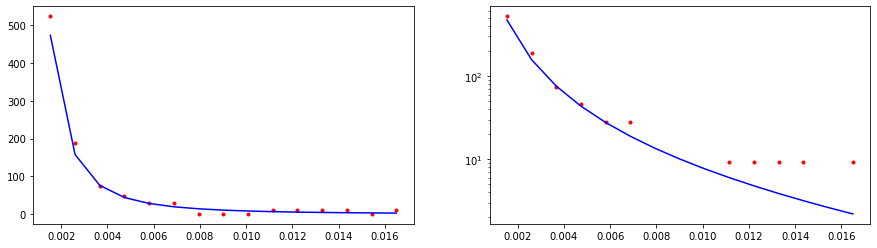

CPU times: user 1.08 ms, sys: 0 ns, total: 1.08 ms
Wall time: 902 µs
22693.995012514548


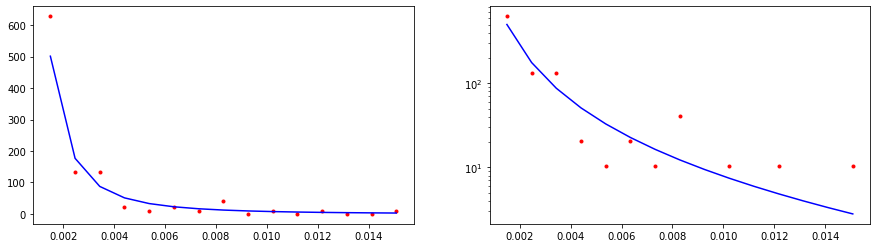

CPU times: user 1.08 ms, sys: 11 µs, total: 1.09 ms
Wall time: 909 µs
23086.8621855603


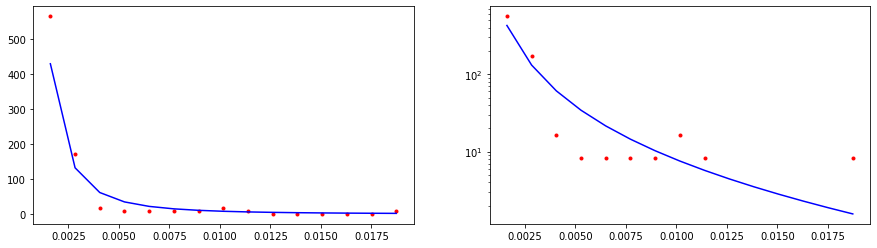

CPU times: user 1.12 ms, sys: 17 µs, total: 1.14 ms
Wall time: 962 µs
11265.07433707204


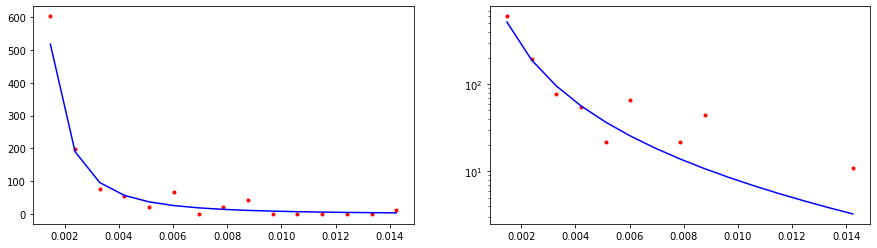

CPU times: user 1.14 ms, sys: 19 µs, total: 1.16 ms
Wall time: 991 µs
5989.8192114574085


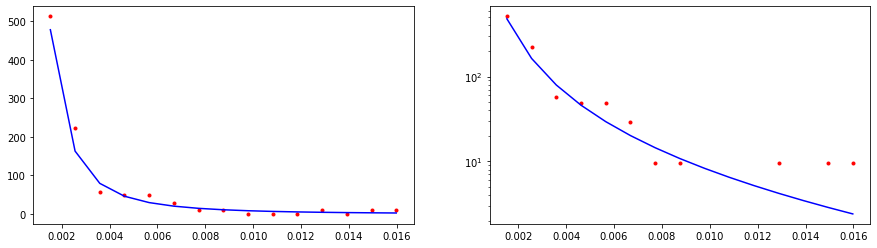

CPU times: user 1.25 ms, sys: 34 µs, total: 1.29 ms
Wall time: 1.11 ms
3785.815584826225


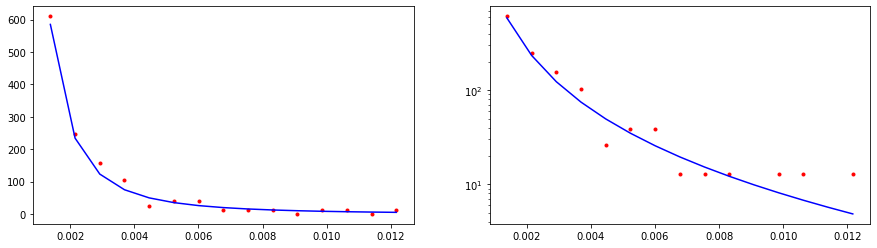

CPU times: user 1.2 ms, sys: 27 µs, total: 1.23 ms
Wall time: 1.13 ms
11998.490391007035


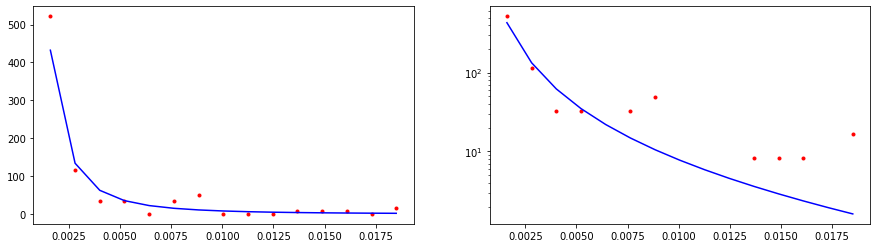

CPU times: user 549 µs, sys: 73 µs, total: 622 µs
Wall time: 389 µs
14686.01344266294


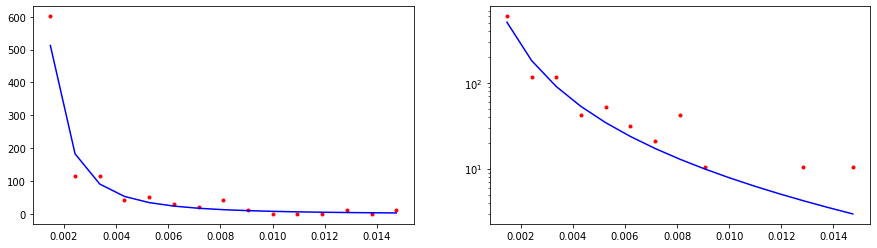

CPU times: user 183 µs, sys: 25 µs, total: 208 µs
Wall time: 173 µs
9989984.605945975


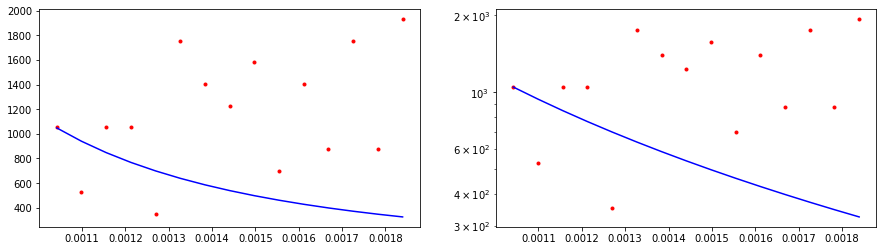

CPU times: user 0 ns, sys: 356 µs, total: 356 µs
Wall time: 225 µs
389061.89114152105


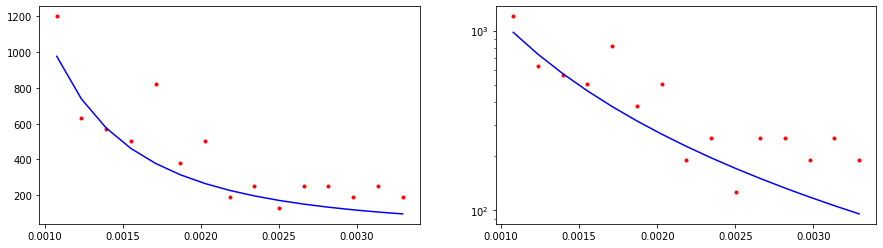

CPU times: user 282 µs, sys: 0 ns, total: 282 µs
Wall time: 246 µs
175879.33749710137


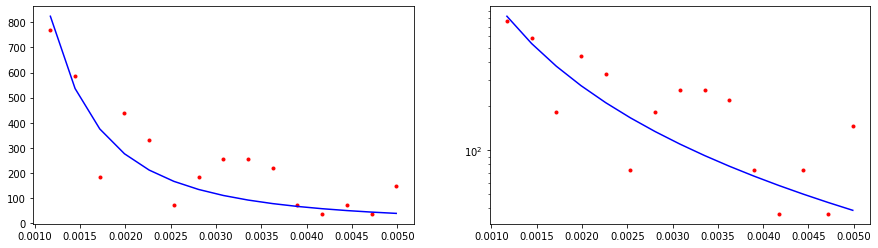

CPU times: user 311 µs, sys: 0 ns, total: 311 µs
Wall time: 276 µs
32789.94235445318


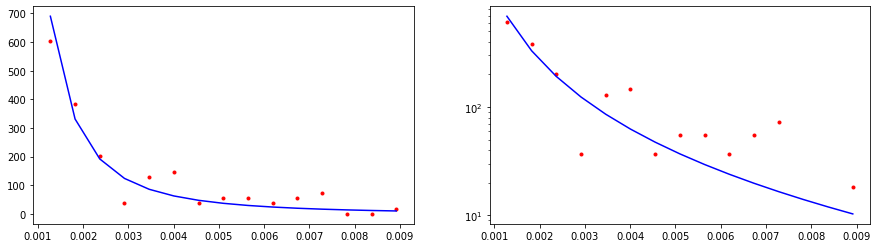

CPU times: user 0 ns, sys: 562 µs, total: 562 µs
Wall time: 371 µs
6022.888254152522


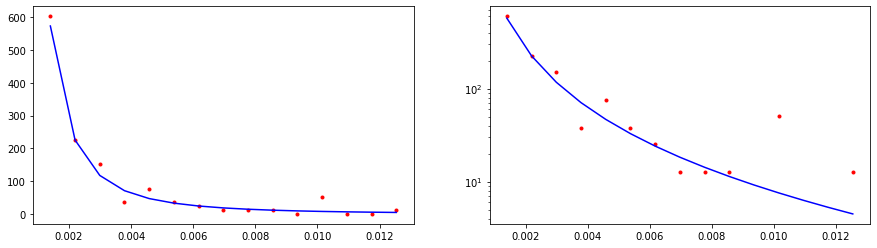

CPU times: user 430 µs, sys: 0 ns, total: 430 µs
Wall time: 328 µs
17984.66071297427


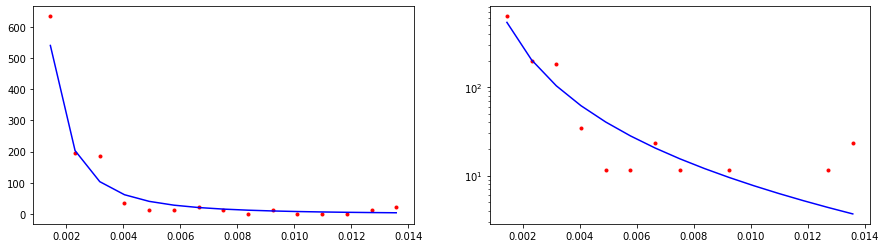

CPU times: user 459 µs, sys: 0 ns, total: 459 µs
Wall time: 351 µs
12543.914622291844


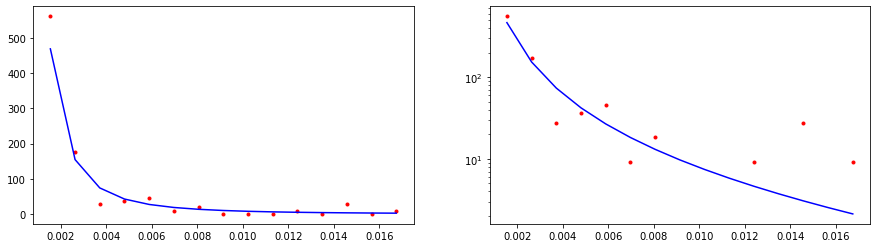

CPU times: user 502 µs, sys: 67 µs, total: 569 µs
Wall time: 395 µs
8664.667956010026


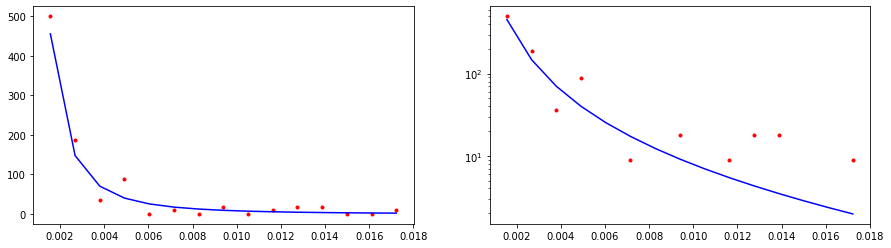

CPU times: user 568 µs, sys: 0 ns, total: 568 µs
Wall time: 458 µs
2496.0767093038507


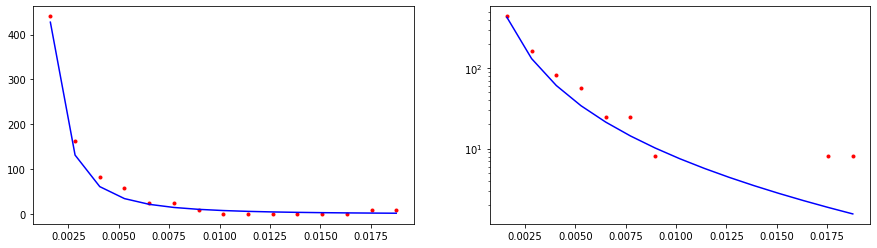

CPU times: user 509 µs, sys: 68 µs, total: 577 µs
Wall time: 414 µs
8662.354204598842


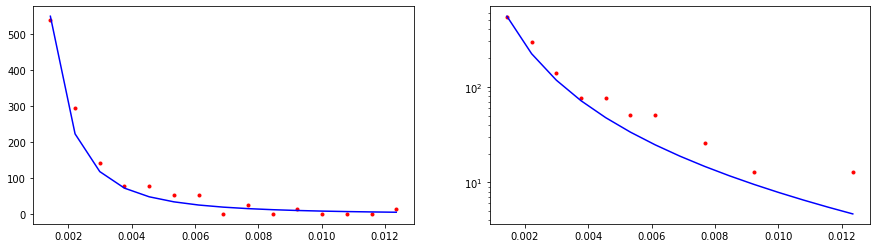

CPU times: user 0 ns, sys: 676 µs, total: 676 µs
Wall time: 489 µs
14076.723412928643


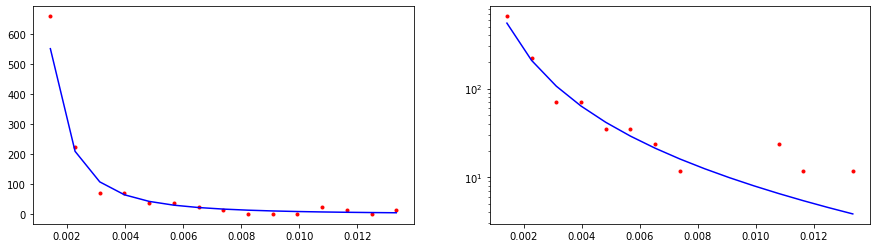

CPU times: user 696 µs, sys: 0 ns, total: 696 µs
Wall time: 523 µs
44618.76796547613


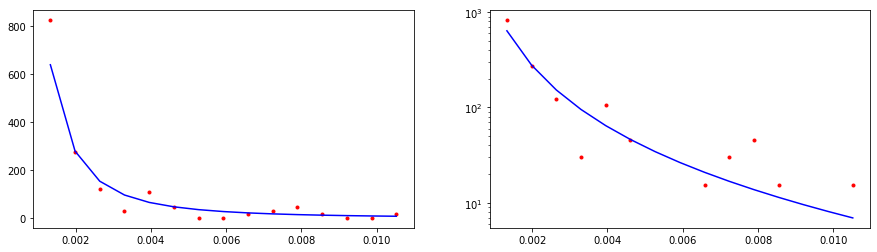

CPU times: user 679 µs, sys: 91 µs, total: 770 µs
Wall time: 594 µs
3930.5261279790666


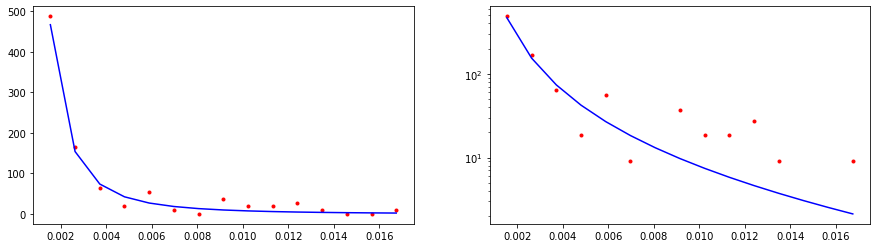

CPU times: user 0 ns, sys: 753 µs, total: 753 µs
Wall time: 588 µs
4889.456366027612


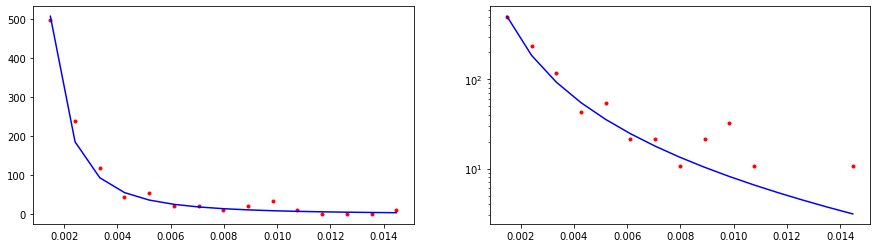

CPU times: user 690 µs, sys: 92 µs, total: 782 µs
Wall time: 601 µs
9258.407062575985


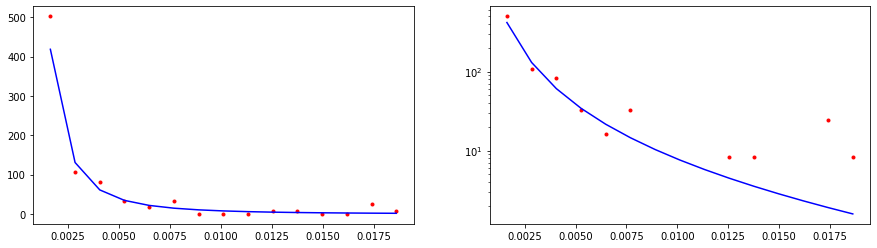

CPU times: user 873 µs, sys: 0 ns, total: 873 µs
Wall time: 693 µs
16994.45558097894


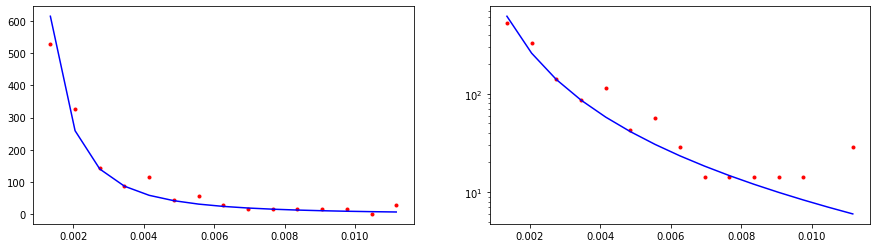

CPU times: user 836 µs, sys: 0 ns, total: 836 µs
Wall time: 669 µs
10207.230714688576


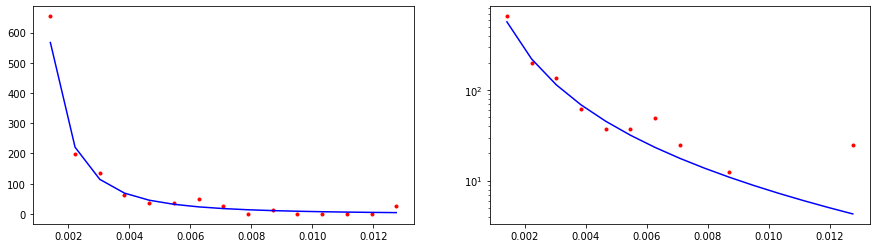

CPU times: user 862 µs, sys: 0 ns, total: 862 µs
Wall time: 694 µs
11569.82478689088


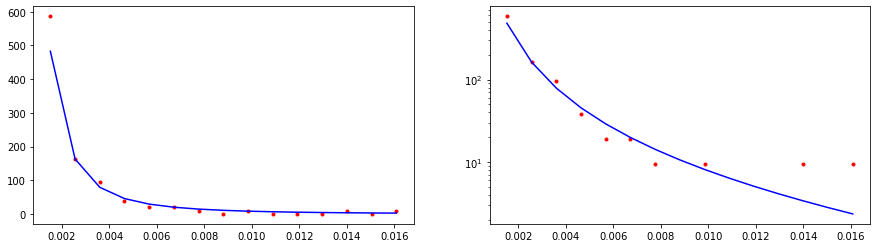

CPU times: user 965 µs, sys: 0 ns, total: 965 µs
Wall time: 767 µs
4064.494950818784


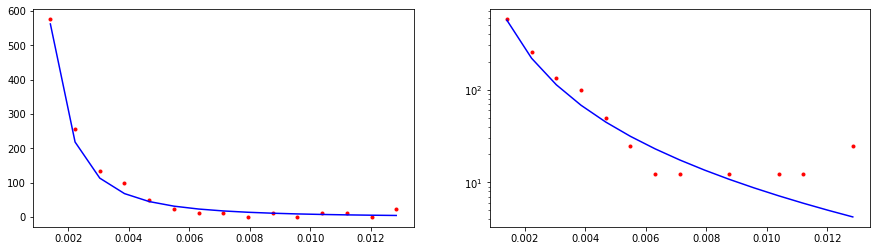

CPU times: user 934 µs, sys: 0 ns, total: 934 µs
Wall time: 726 µs
51092.245396126826


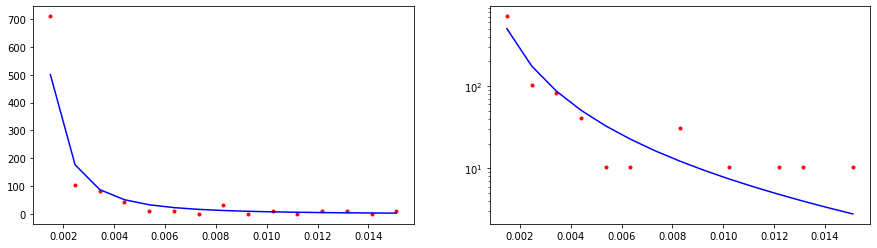

CPU times: user 1.01 ms, sys: 1e+03 ns, total: 1.01 ms
Wall time: 780 µs
9154.678604071607


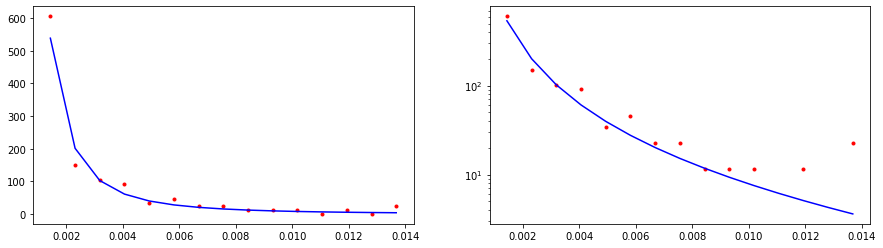

CPU times: user 969 µs, sys: 0 ns, total: 969 µs
Wall time: 796 µs
16612.608151230386


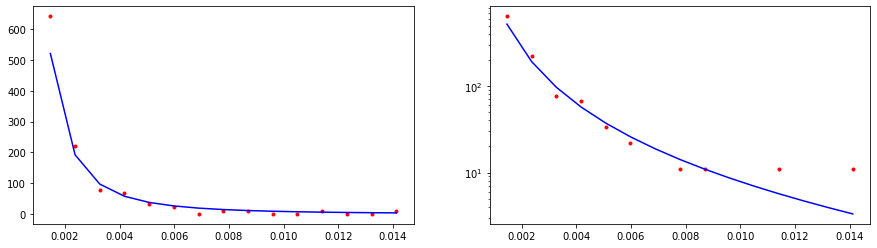

CPU times: user 990 µs, sys: 19 µs, total: 1.01 ms
Wall time: 835 µs
3116.506404111976


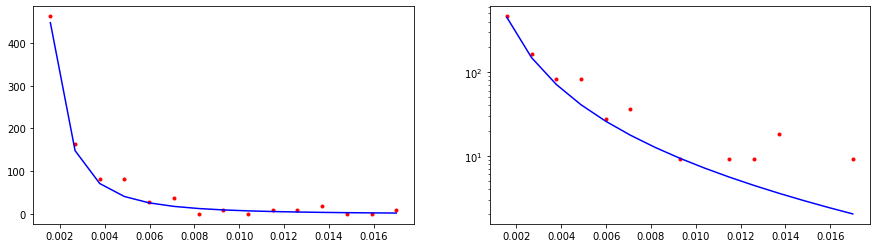

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 882 µs
6602.618718415619


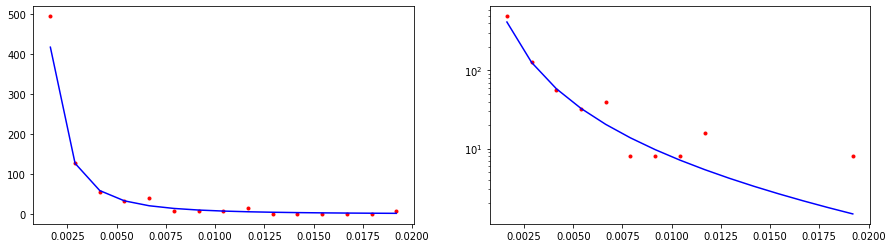

CPU times: user 1.11 ms, sys: 16 µs, total: 1.13 ms
Wall time: 956 µs
19405.20632718207


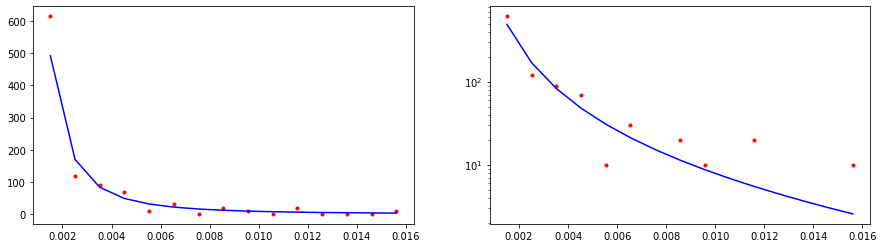

CPU times: user 1.13 ms, sys: 17 µs, total: 1.15 ms
Wall time: 971 µs
13472.901843115726


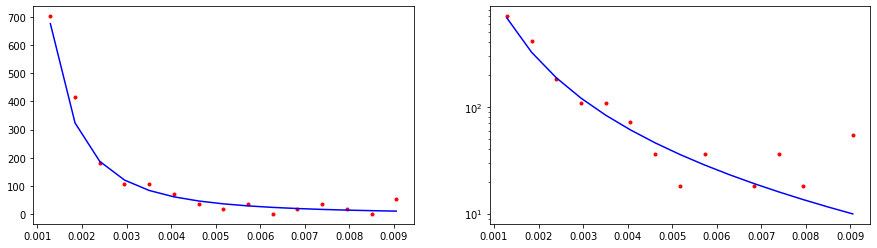

CPU times: user 1.2 ms, sys: 0 ns, total: 1.2 ms
Wall time: 1.02 ms
4303.07846702023


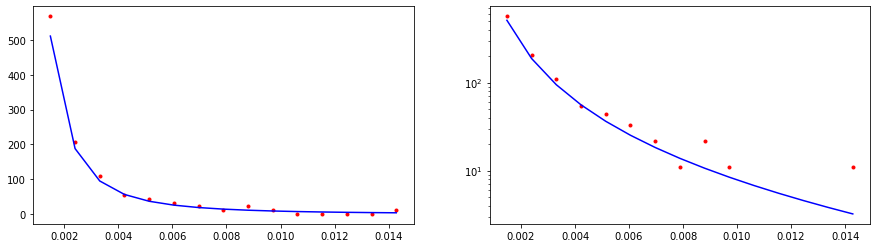

CPU times: user 1.13 ms, sys: 18 µs, total: 1.15 ms
Wall time: 985 µs
14135.387690801868


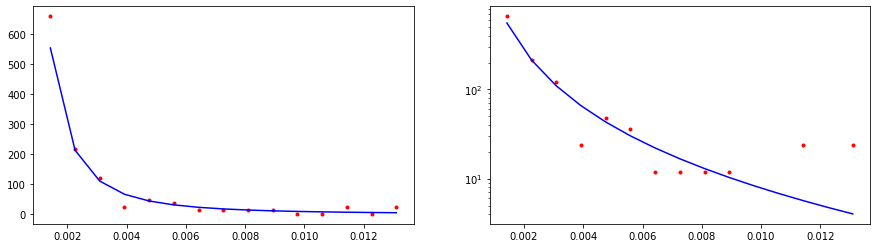

CPU times: user 1.23 ms, sys: 31 µs, total: 1.26 ms
Wall time: 1.1 ms
17759.818541989185


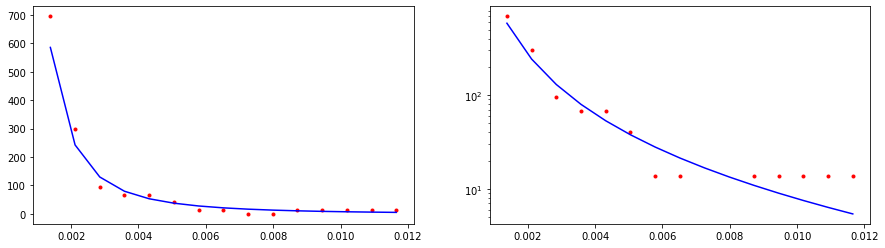

CPU times: user 1.17 ms, sys: 24 µs, total: 1.2 ms
Wall time: 1.03 ms
42390.55209055657


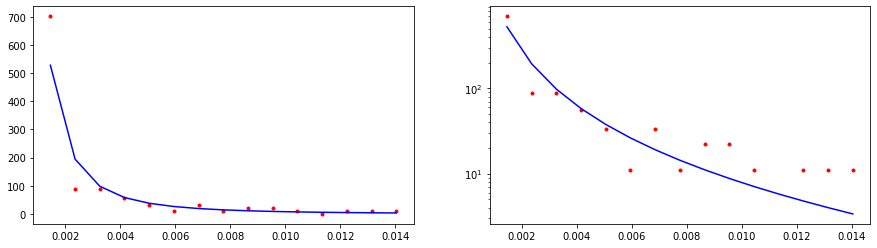

CPU times: user 0 ns, sys: 618 µs, total: 618 µs
Wall time: 415 µs
8283.541443550172


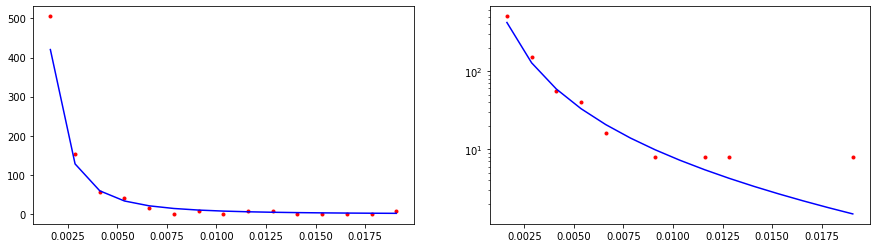

CPU times: user 178 µs, sys: 24 µs, total: 202 µs
Wall time: 169 µs
12405483.233269127


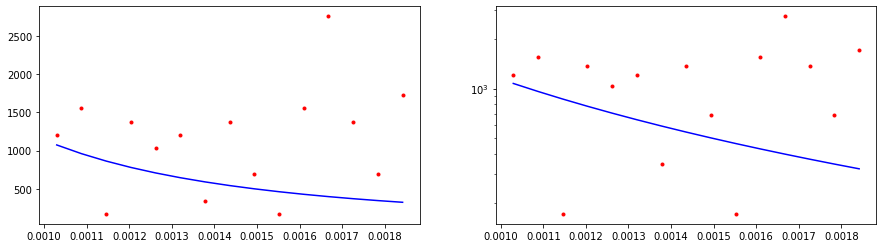

CPU times: user 244 µs, sys: 33 µs, total: 277 µs
Wall time: 207 µs
359082.3681593742


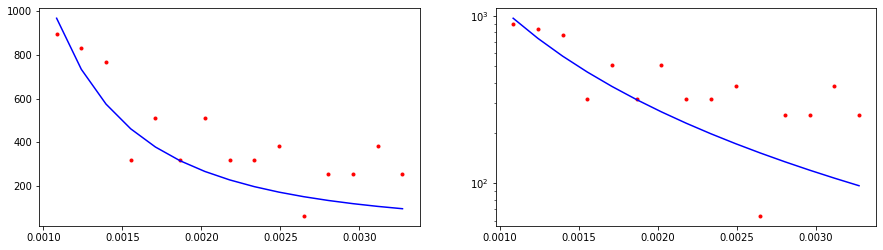

CPU times: user 234 µs, sys: 31 µs, total: 265 µs
Wall time: 232 µs
67823.77659017085


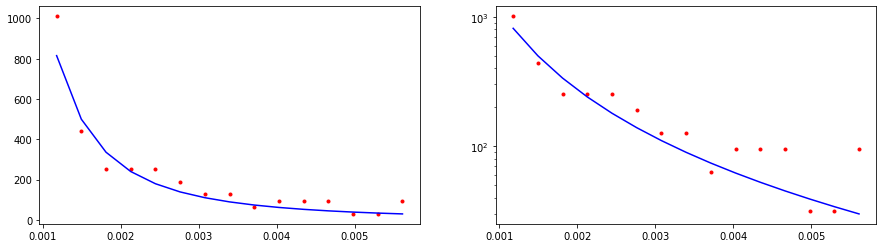

CPU times: user 0 ns, sys: 372 µs, total: 372 µs
Wall time: 278 µs
17085.637813333684


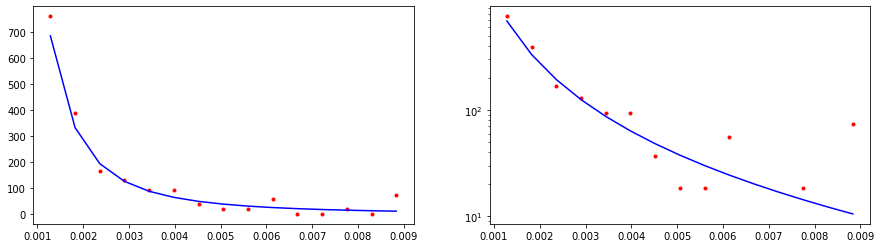

CPU times: user 497 µs, sys: 0 ns, total: 497 µs
Wall time: 325 µs
5495.205365143707


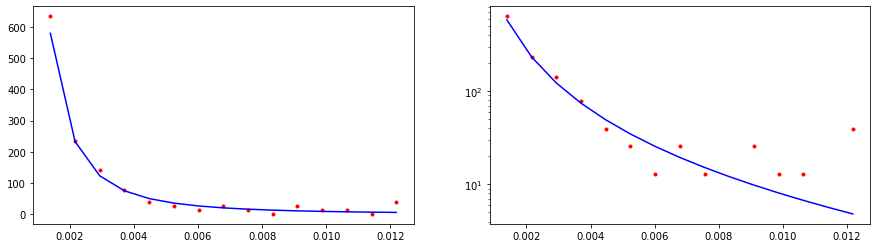

CPU times: user 489 µs, sys: 66 µs, total: 555 µs
Wall time: 372 µs
8757.694113630088


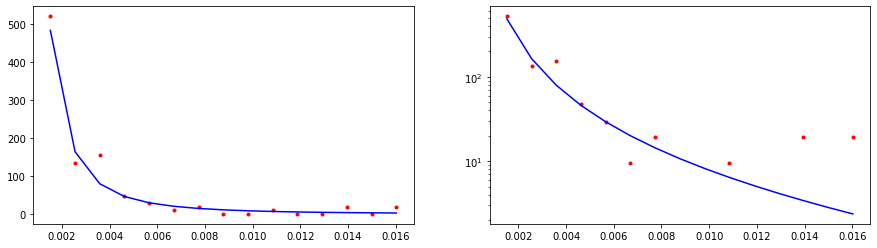

CPU times: user 638 µs, sys: 0 ns, total: 638 µs
Wall time: 459 µs
5617.778358819512


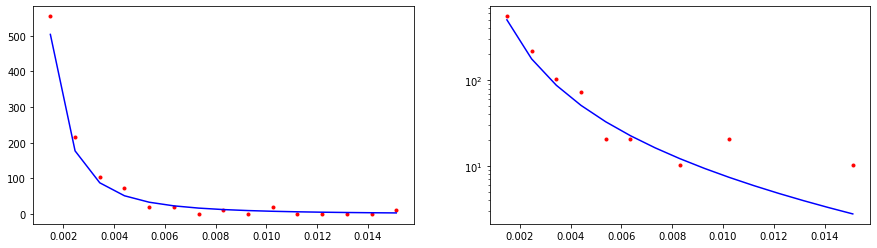

CPU times: user 498 µs, sys: 67 µs, total: 565 µs
Wall time: 403 µs
12990.958367972029


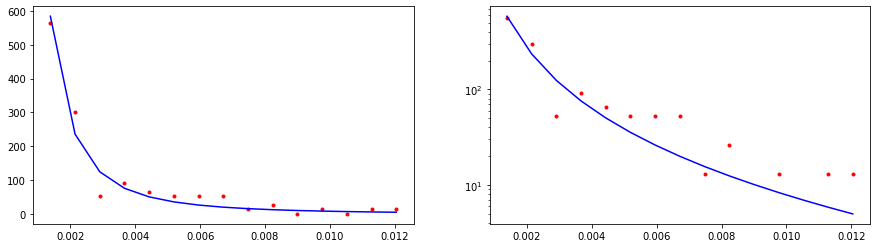

CPU times: user 0 ns, sys: 645 µs, total: 645 µs
Wall time: 480 µs
10791.41297768099


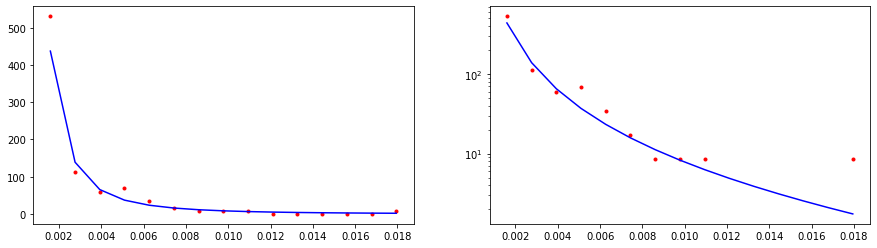

CPU times: user 642 µs, sys: 0 ns, total: 642 µs
Wall time: 479 µs
12512.283015102901


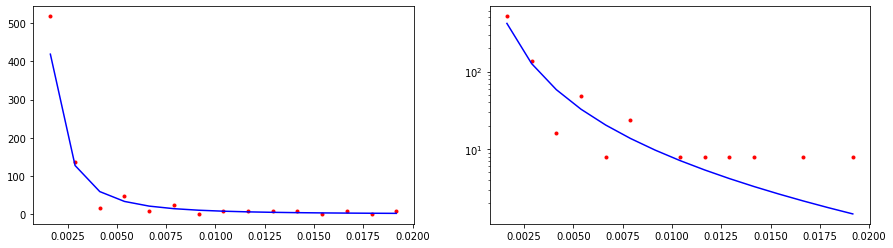

CPU times: user 534 µs, sys: 72 µs, total: 606 µs
Wall time: 448 µs
10233.463016997806


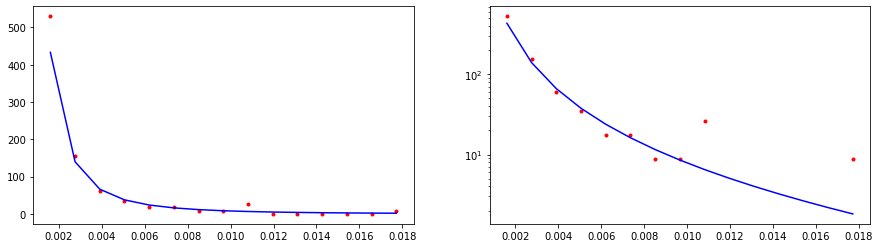

CPU times: user 675 µs, sys: 0 ns, total: 675 µs
Wall time: 510 µs
26811.491279994338


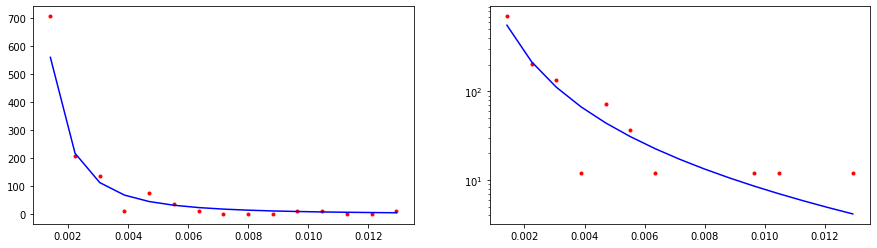

CPU times: user 730 µs, sys: 0 ns, total: 730 µs
Wall time: 555 µs
3124.88689287314


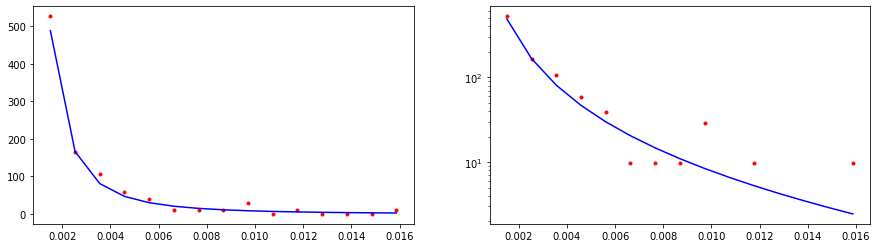

CPU times: user 725 µs, sys: 0 ns, total: 725 µs
Wall time: 563 µs
45720.49102745495


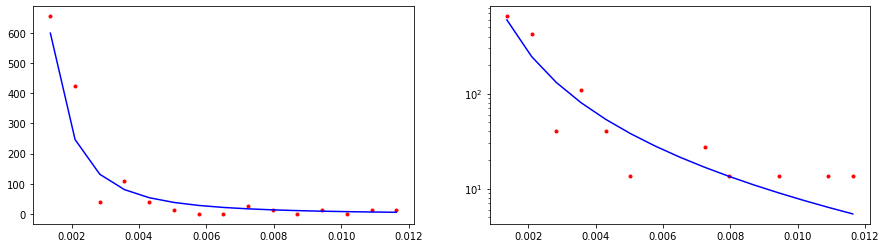

CPU times: user 744 µs, sys: 101 µs, total: 845 µs
Wall time: 666 µs
1694.0682279250614


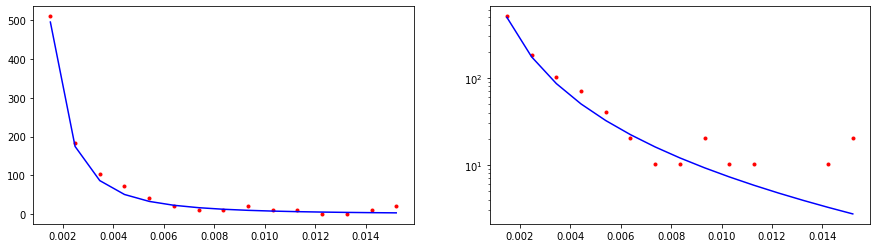

CPU times: user 828 µs, sys: 0 ns, total: 828 µs
Wall time: 647 µs
7807.931403995969


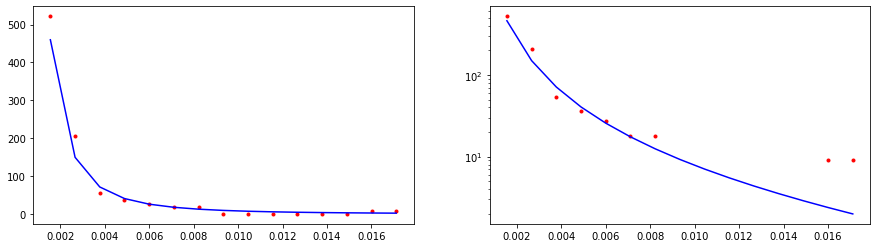

CPU times: user 838 µs, sys: 0 ns, total: 838 µs
Wall time: 665 µs
3562.669613021267


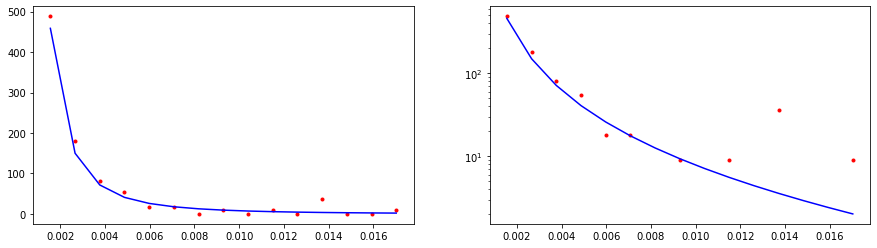

CPU times: user 883 µs, sys: 0 ns, total: 883 µs
Wall time: 721 µs
8899.282822728372


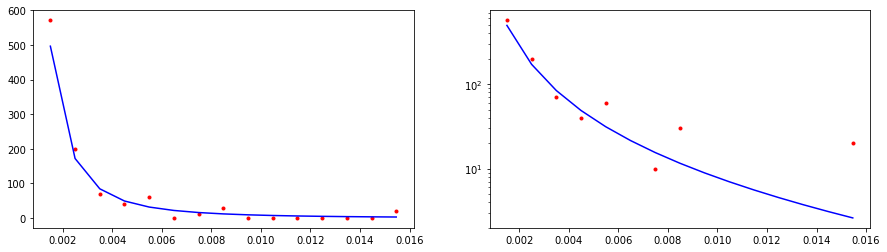

CPU times: user 983 µs, sys: 0 ns, total: 983 µs
Wall time: 806 µs
8199.958190850932


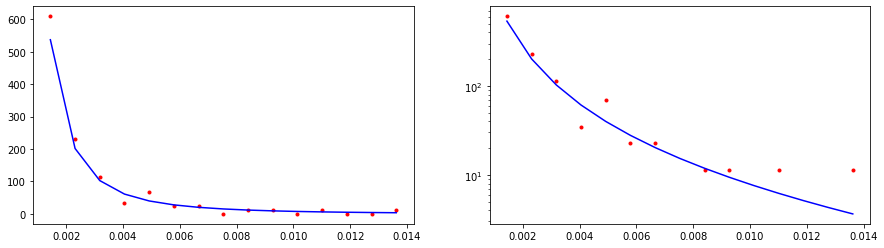

CPU times: user 927 µs, sys: 0 ns, total: 927 µs
Wall time: 749 µs
7608.698323573531


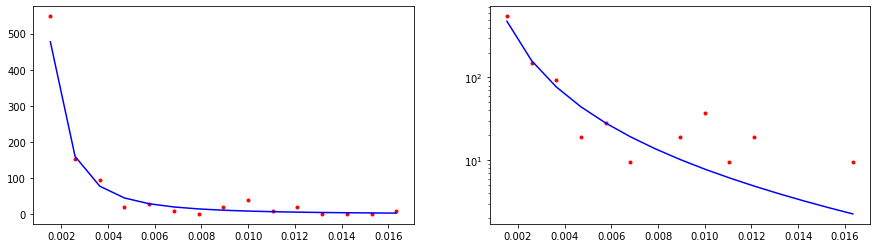

CPU times: user 956 µs, sys: 0 ns, total: 956 µs
Wall time: 786 µs
9647.952284253932


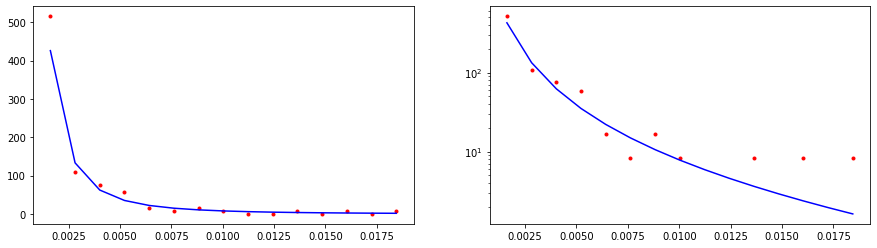

CPU times: user 982 µs, sys: 0 ns, total: 982 µs
Wall time: 810 µs
7813.119703357508


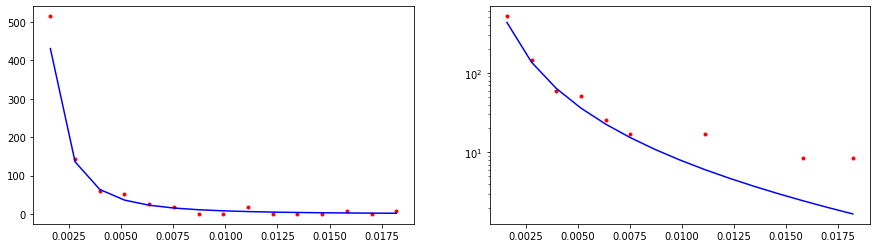

CPU times: user 1.01 ms, sys: 1 µs, total: 1.01 ms
Wall time: 882 µs
4189.719022469006


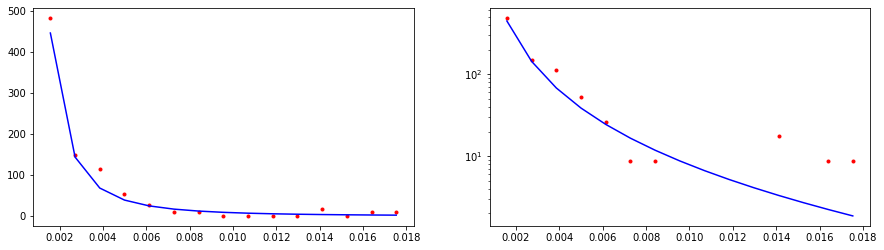

CPU times: user 1.01 ms, sys: 22 µs, total: 1.04 ms
Wall time: 853 µs
6170.15320249891


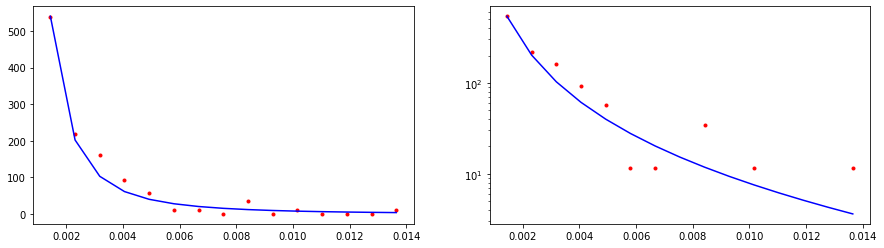

CPU times: user 147 µs, sys: 886 µs, total: 1.03 ms
Wall time: 869 µs
6939.3252388546325


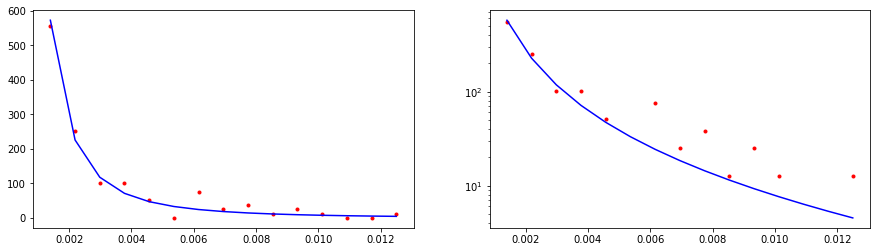

CPU times: user 1.1 ms, sys: 21 µs, total: 1.12 ms
Wall time: 923 µs
38964.48315271755


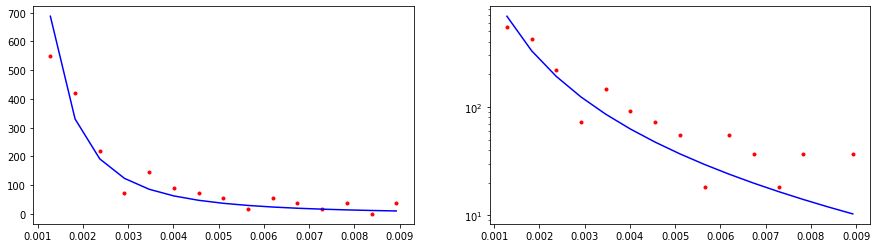

CPU times: user 1.12 ms, sys: 17 µs, total: 1.14 ms
Wall time: 947 µs
38363.43669268778


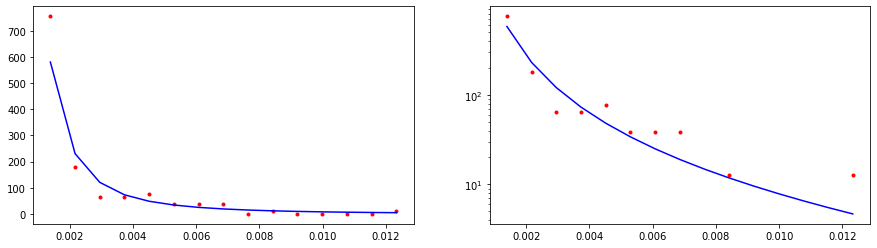

CPU times: user 303 µs, sys: 867 µs, total: 1.17 ms
Wall time: 989 µs
13068.050930389927


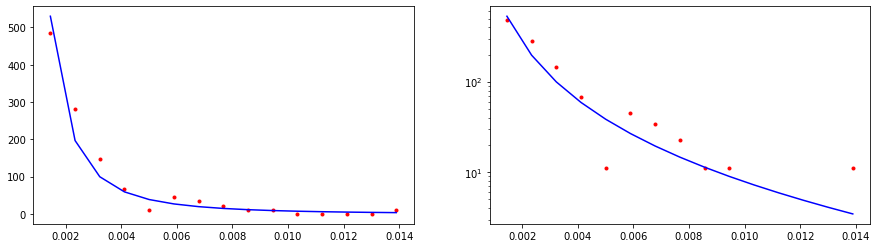

CPU times: user 1.17 ms, sys: 23 µs, total: 1.19 ms
Wall time: 1.02 ms
25781.297059697346


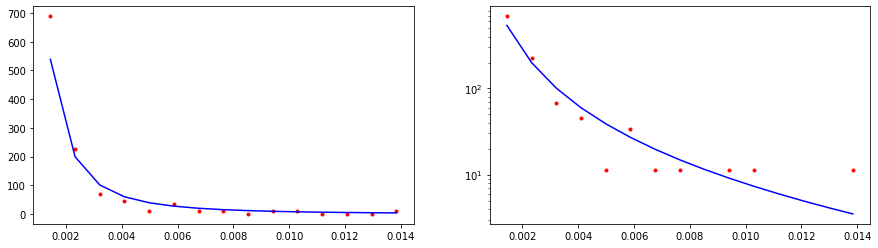

CPU times: user 1.24 ms, sys: 33 µs, total: 1.27 ms
Wall time: 1.09 ms
17437.167799461255


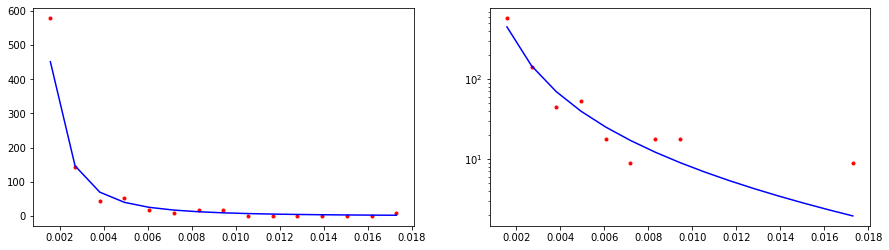

CPU times: user 546 µs, sys: 74 µs, total: 620 µs
Wall time: 389 µs
7864.935178612398


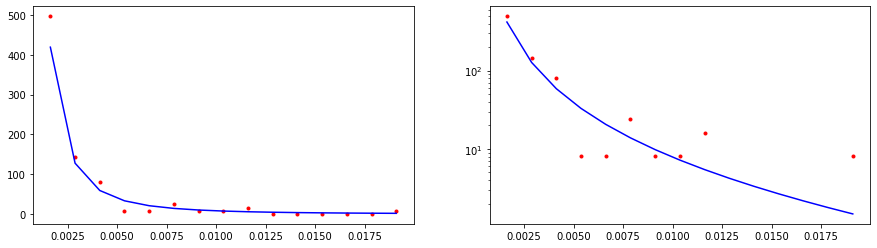

CPU times: user 209 µs, sys: 0 ns, total: 209 µs
Wall time: 178 µs
6949454.703471279


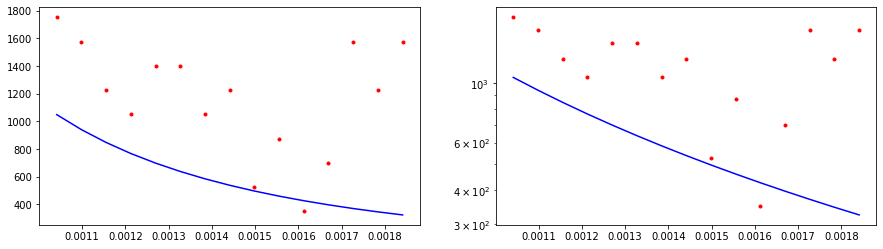

CPU times: user 216 µs, sys: 29 µs, total: 245 µs
Wall time: 211 µs
554198.2513154855


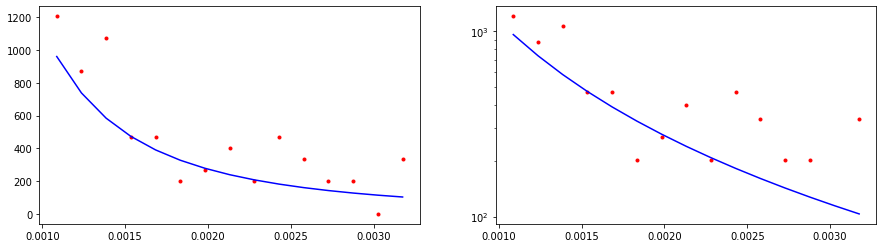

CPU times: user 189 µs, sys: 25 µs, total: 214 µs
Wall time: 187 µs
104898.7909670158


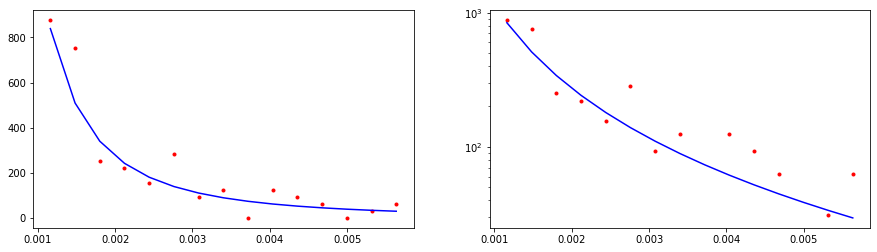

CPU times: user 0 ns, sys: 443 µs, total: 443 µs
Wall time: 277 µs
54732.204700594186


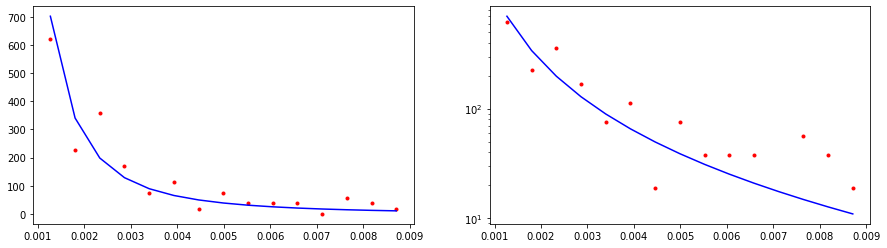

CPU times: user 0 ns, sys: 500 µs, total: 500 µs
Wall time: 318 µs
15739.142419766908


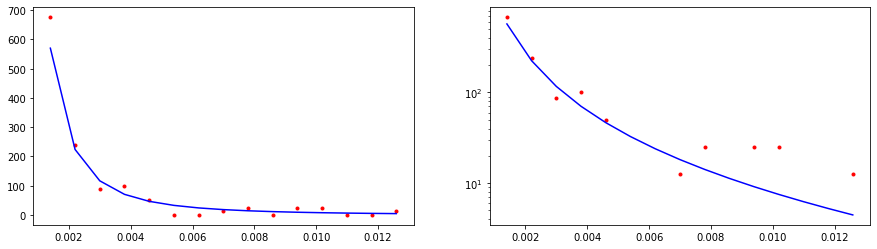

CPU times: user 0 ns, sys: 539 µs, total: 539 µs
Wall time: 350 µs
9477.79166591492


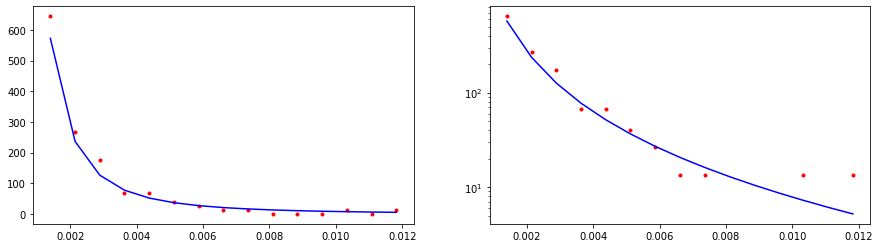

CPU times: user 417 µs, sys: 57 µs, total: 474 µs
Wall time: 318 µs
5061.383216272787


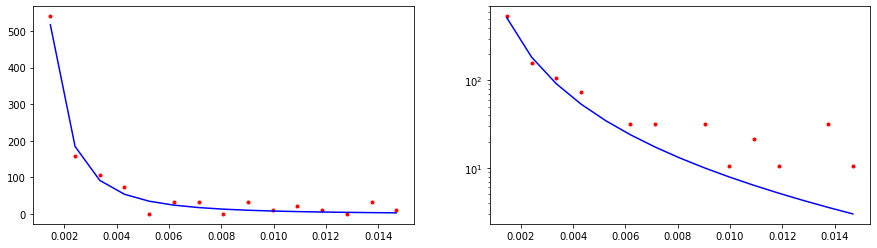

CPU times: user 490 µs, sys: 67 µs, total: 557 µs
Wall time: 388 µs
28895.195813300994


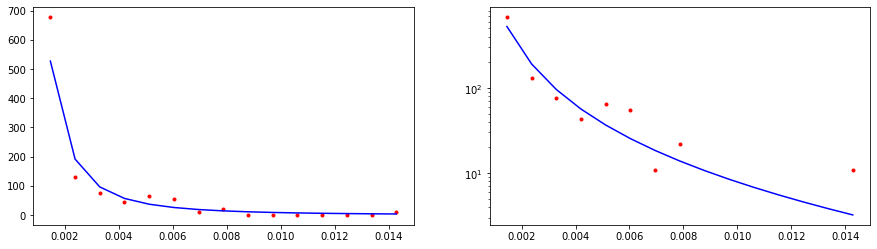

CPU times: user 556 µs, sys: 76 µs, total: 632 µs
Wall time: 461 µs
10426.071309368357


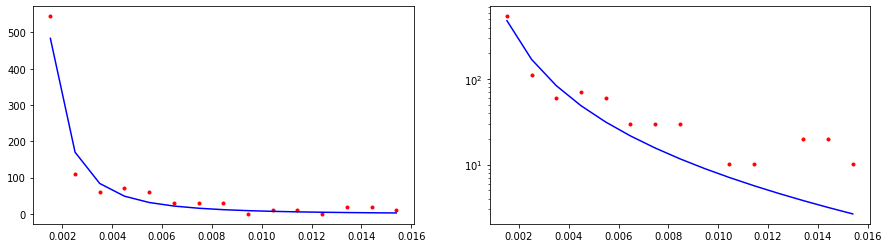

CPU times: user 610 µs, sys: 0 ns, total: 610 µs
Wall time: 465 µs
9762.615608602513


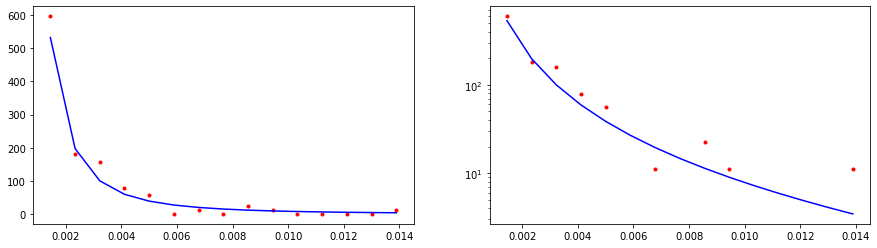

CPU times: user 566 µs, sys: 77 µs, total: 643 µs
Wall time: 473 µs
11385.331444674972


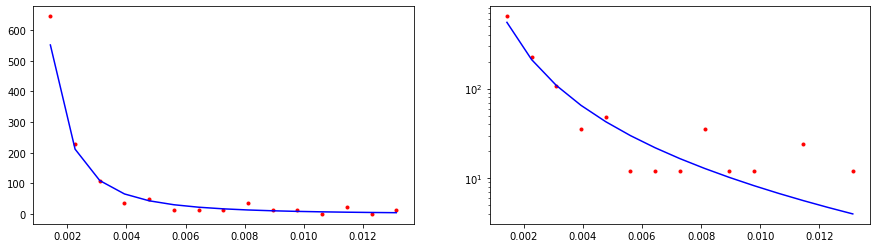

CPU times: user 659 µs, sys: 90 µs, total: 749 µs
Wall time: 574 µs
2763.4524673321566


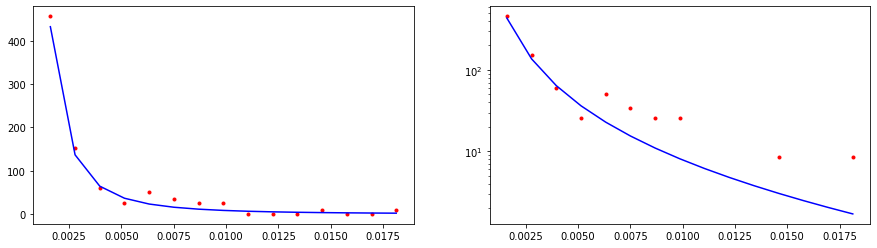

CPU times: user 721 µs, sys: 0 ns, total: 721 µs
Wall time: 547 µs
25404.14454913332


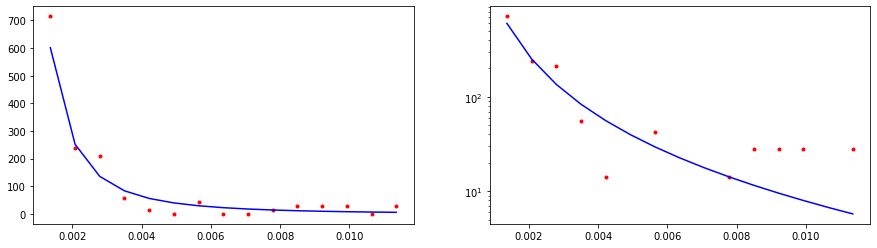

CPU times: user 712 µs, sys: 97 µs, total: 809 µs
Wall time: 629 µs
20450.876576393493


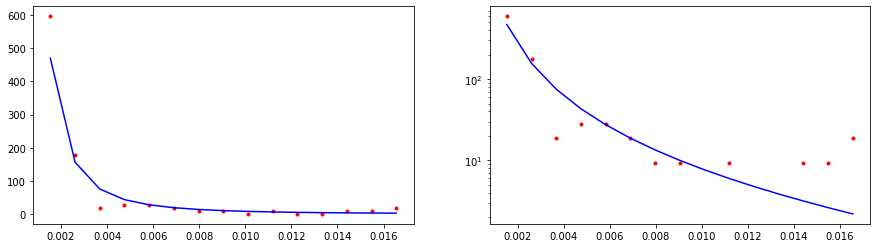

CPU times: user 854 µs, sys: 0 ns, total: 854 µs
Wall time: 660 µs
16033.950838102388


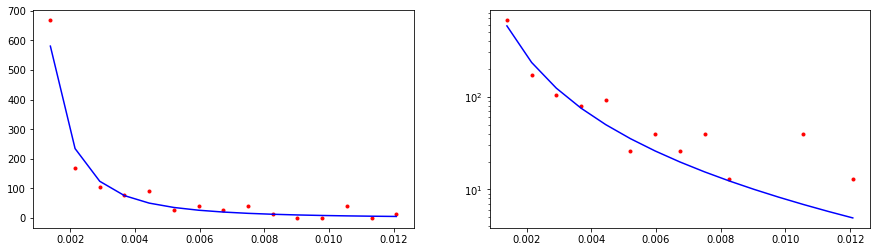

CPU times: user 0 ns, sys: 820 µs, total: 820 µs
Wall time: 642 µs
18372.018899421444


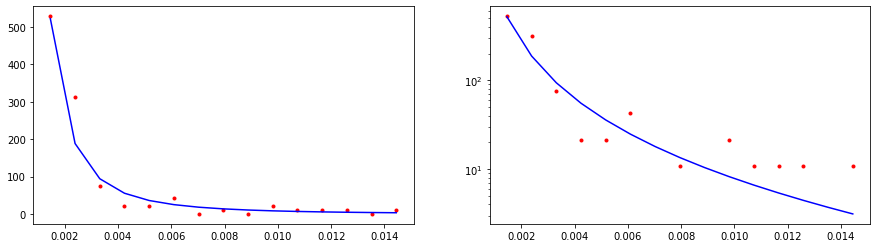

CPU times: user 19 µs, sys: 731 µs, total: 750 µs
Wall time: 638 µs
18840.69422534362


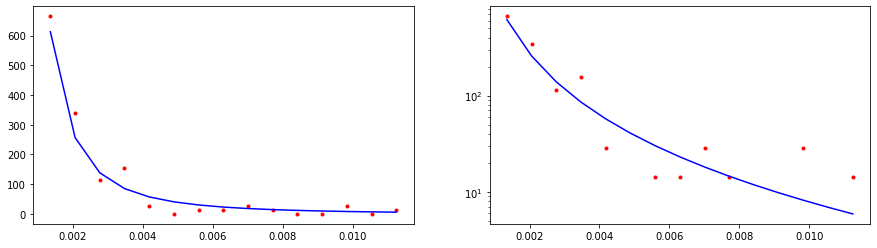

CPU times: user 25 µs, sys: 868 µs, total: 893 µs
Wall time: 706 µs
39149.142297645405


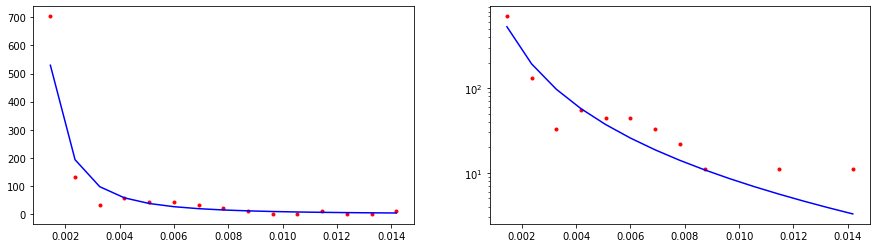

CPU times: user 939 µs, sys: 0 ns, total: 939 µs
Wall time: 759 µs
17370.84966412699


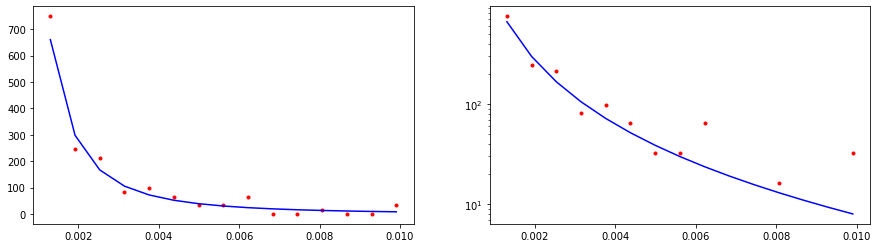

CPU times: user 936 µs, sys: 0 ns, total: 936 µs
Wall time: 769 µs
8544.897025533042


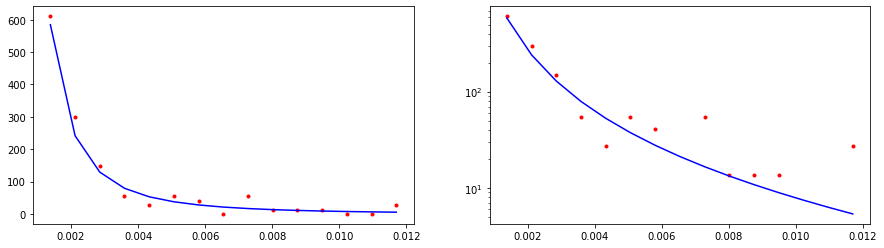

CPU times: user 1.1 ms, sys: 0 ns, total: 1.1 ms
Wall time: 918 µs
9913.344201257698


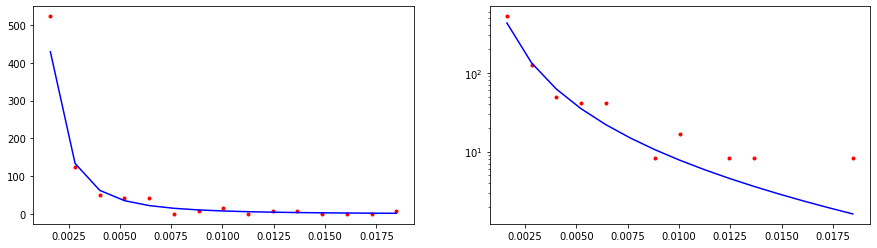

CPU times: user 969 µs, sys: 0 ns, total: 969 µs
Wall time: 797 µs
12502.79188939137


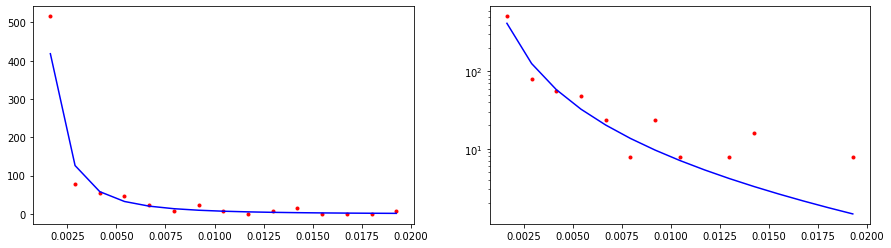

CPU times: user 1.07 ms, sys: 10 µs, total: 1.08 ms
Wall time: 863 µs
11681.345665757772


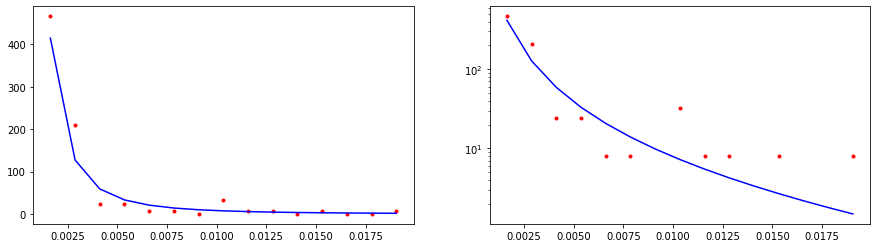

CPU times: user 1.02 ms, sys: 3 µs, total: 1.02 ms
Wall time: 854 µs
15747.091028709576


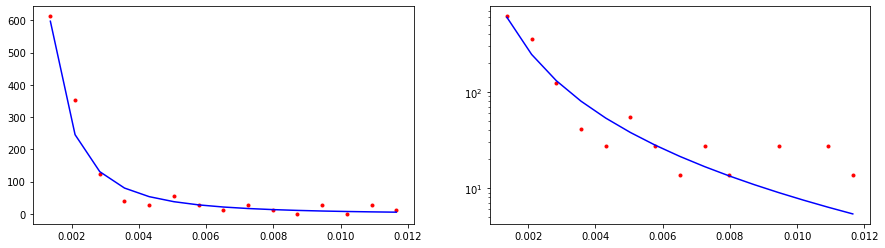

CPU times: user 1.05 ms, sys: 8 µs, total: 1.06 ms
Wall time: 894 µs
8385.908783825018


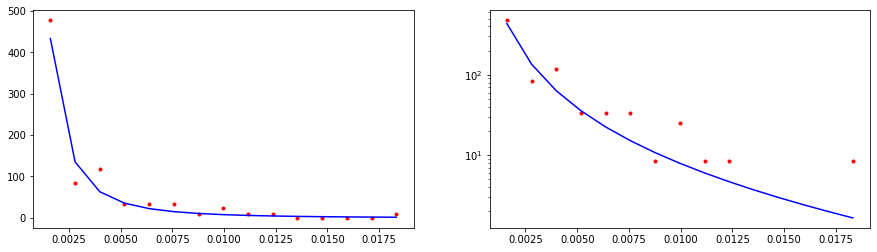

CPU times: user 339 µs, sys: 746 µs, total: 1.08 ms
Wall time: 914 µs
5092.014948822603


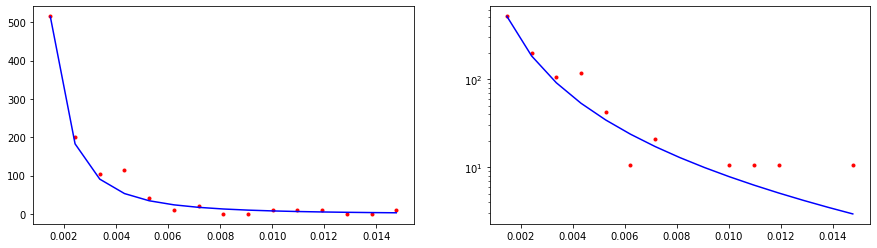

CPU times: user 1.17 ms, sys: 24 µs, total: 1.2 ms
Wall time: 996 µs
4970.969970900478


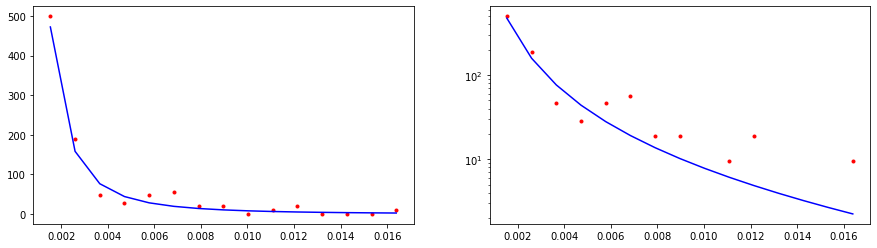

CPU times: user 1.13 ms, sys: 18 µs, total: 1.15 ms
Wall time: 973 µs
28556.376480630657


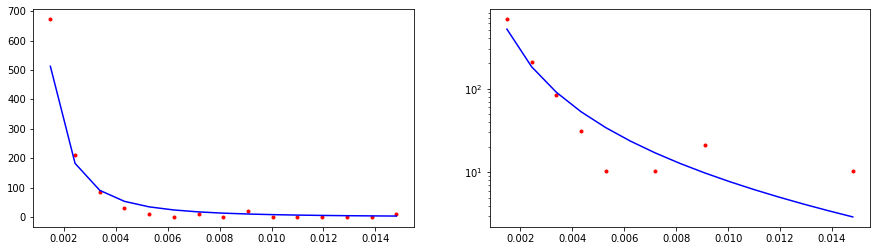

CPU times: user 1.21 ms, sys: 29 µs, total: 1.23 ms
Wall time: 1.06 ms
3936.7520352812867


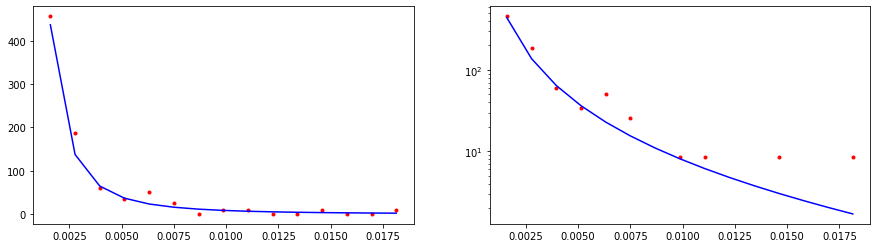

CPU times: user 346 µs, sys: 863 µs, total: 1.21 ms
Wall time: 1.09 ms
13818.188074003045


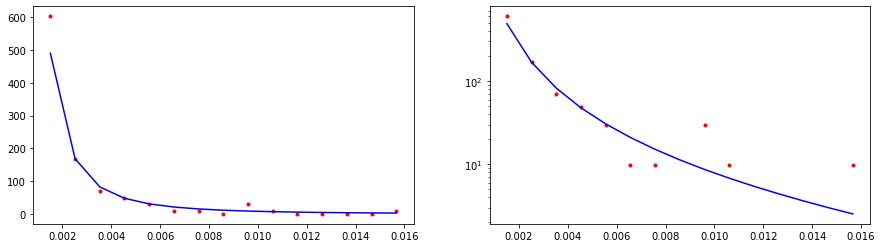

CPU times: user 575 µs, sys: 0 ns, total: 575 µs
Wall time: 350 µs
6654.184100574167


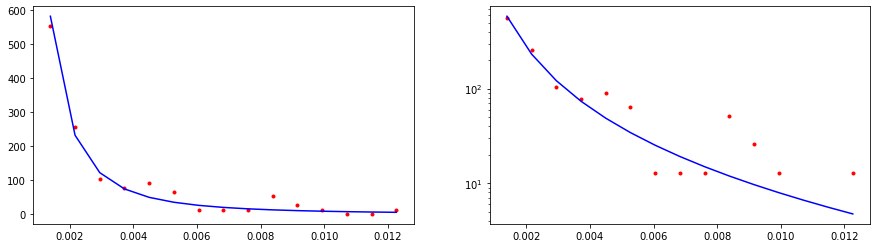

CPU times: user 231 µs, sys: 31 µs, total: 262 µs
Wall time: 226 µs
9123455.633626817


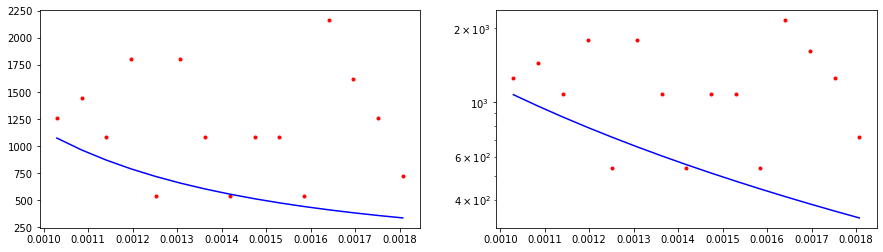

CPU times: user 213 µs, sys: 29 µs, total: 242 µs
Wall time: 207 µs
410642.4411274087


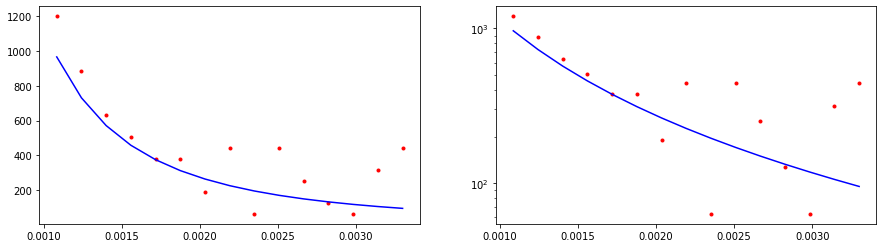

CPU times: user 0 ns, sys: 381 µs, total: 381 µs
Wall time: 277 µs
105741.90482076844


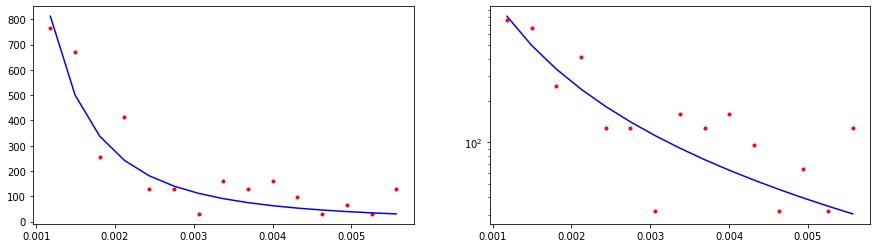

CPU times: user 0 ns, sys: 336 µs, total: 336 µs
Wall time: 264 µs
30928.39962958522


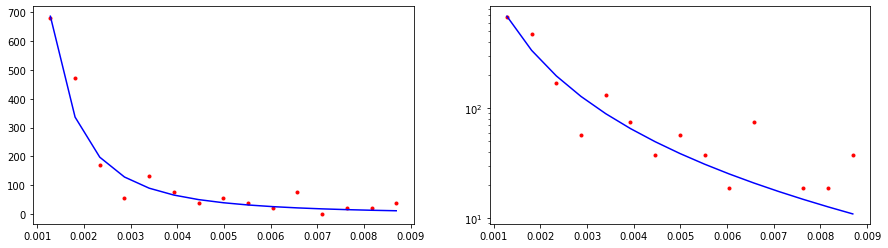

CPU times: user 527 µs, sys: 0 ns, total: 527 µs
Wall time: 365 µs
18871.073699661265


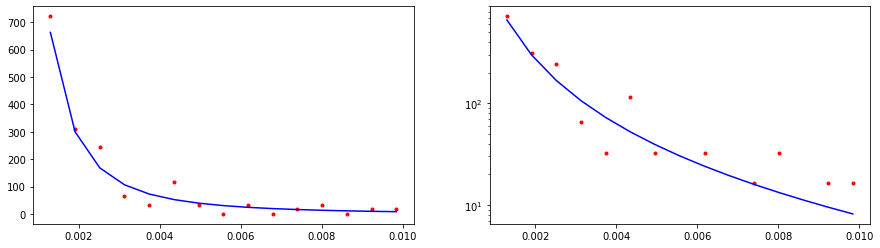

CPU times: user 545 µs, sys: 0 ns, total: 545 µs
Wall time: 360 µs
17424.255717149645


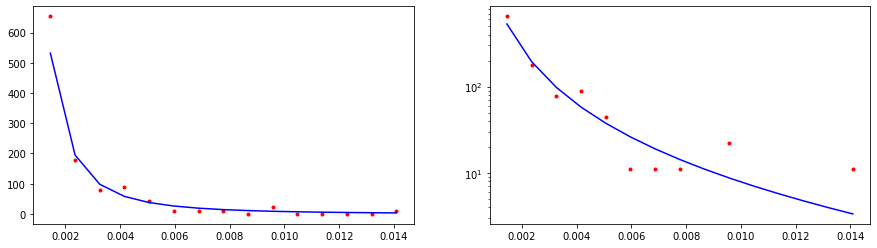

CPU times: user 517 µs, sys: 71 µs, total: 588 µs
Wall time: 373 µs
11583.737126329177


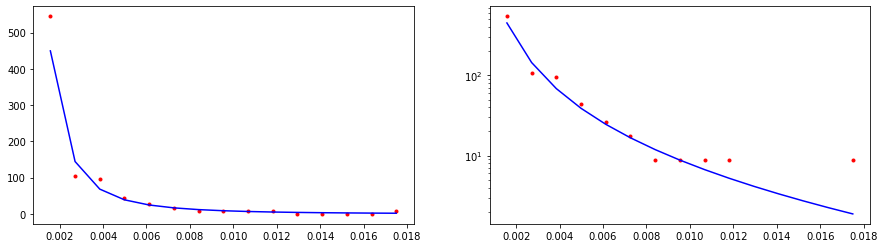

CPU times: user 0 ns, sys: 597 µs, total: 597 µs
Wall time: 410 µs
18444.674173851145


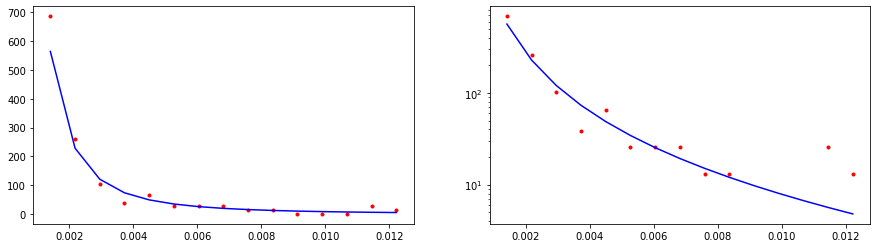

CPU times: user 525 µs, sys: 72 µs, total: 597 µs
Wall time: 425 µs
3932.419104562704


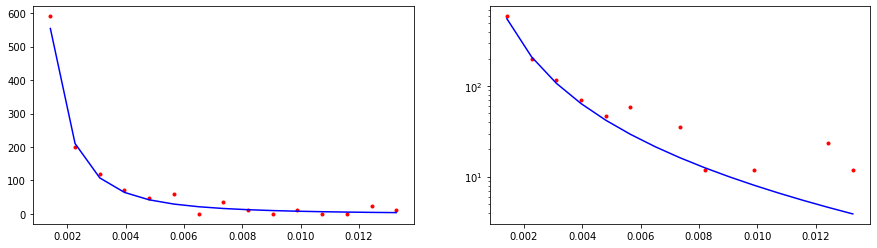

CPU times: user 610 µs, sys: 0 ns, total: 610 µs
Wall time: 448 µs
8272.044743811854


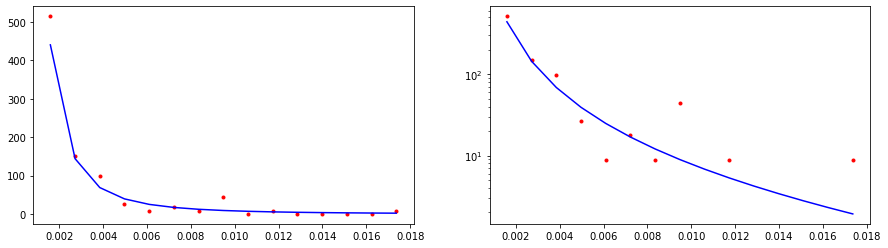

CPU times: user 726 µs, sys: 0 ns, total: 726 µs
Wall time: 536 µs
8965.091664287742


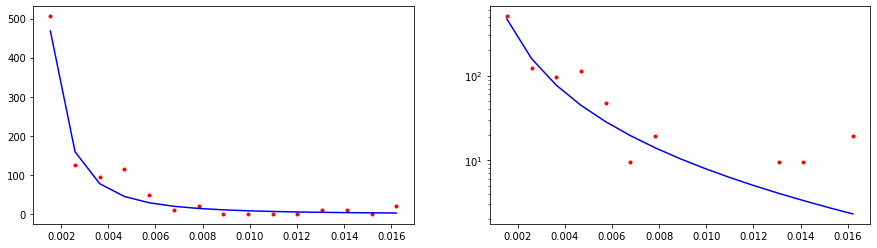

CPU times: user 675 µs, sys: 0 ns, total: 675 µs
Wall time: 515 µs
13073.042424588775


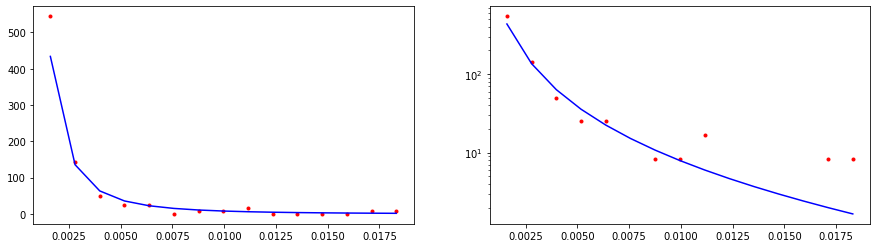

CPU times: user 0 ns, sys: 684 µs, total: 684 µs
Wall time: 517 µs
10678.652640071774


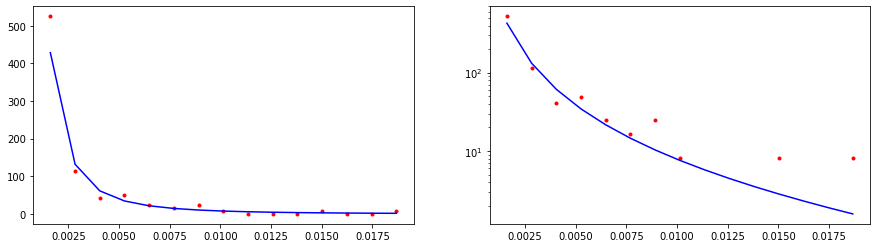

CPU times: user 789 µs, sys: 0 ns, total: 789 µs
Wall time: 616 µs
13940.953710649348


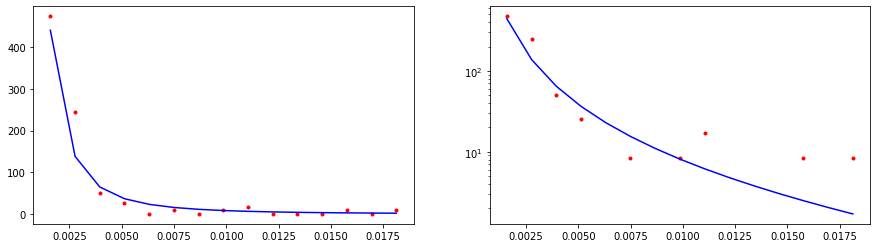

CPU times: user 832 µs, sys: 0 ns, total: 832 µs
Wall time: 666 µs
5112.759927410872


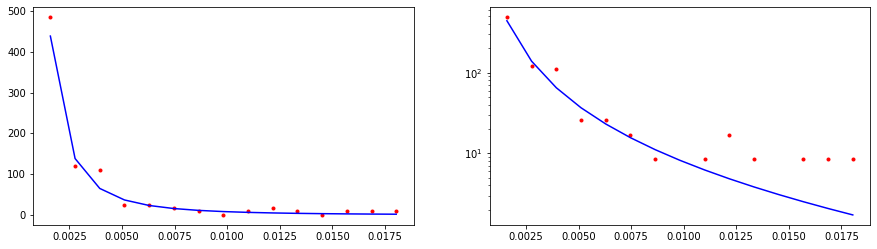

CPU times: user 0 ns, sys: 789 µs, total: 789 µs
Wall time: 617 µs
9084.043317486417


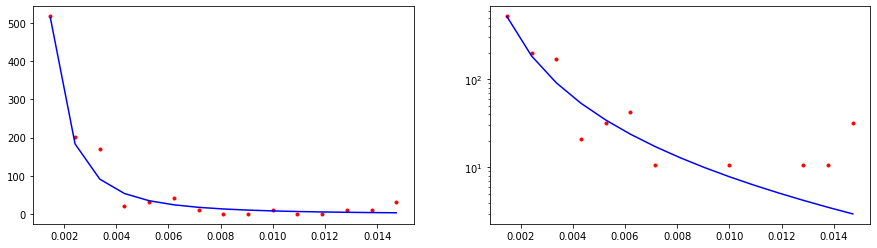

CPU times: user 851 µs, sys: 0 ns, total: 851 µs
Wall time: 679 µs
9915.663959491932


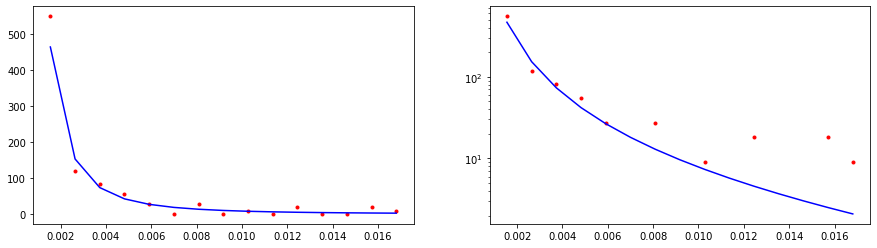

CPU times: user 0 ns, sys: 856 µs, total: 856 µs
Wall time: 679 µs
8230.94728391309


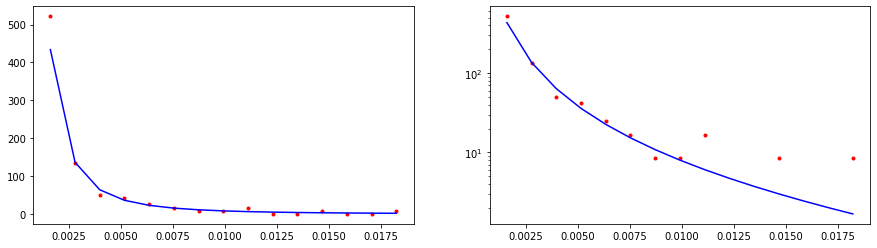

CPU times: user 948 µs, sys: 0 ns, total: 948 µs
Wall time: 775 µs
65149.368571031584


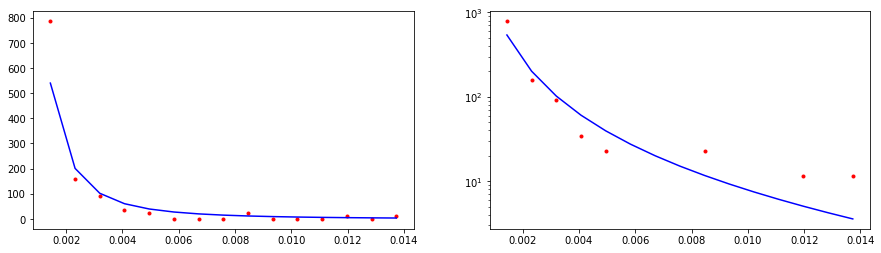

CPU times: user 1.01 ms, sys: 2 µs, total: 1.01 ms
Wall time: 831 µs
15072.303697844745


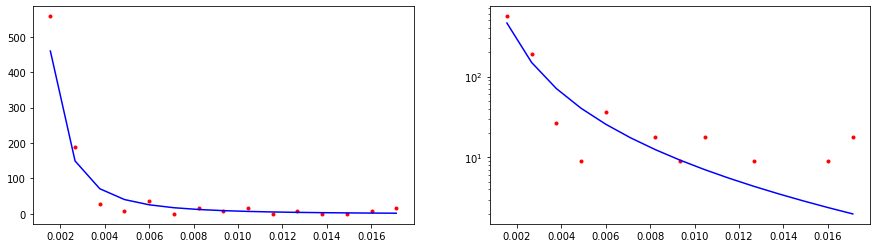

CPU times: user 943 µs, sys: 13 µs, total: 956 µs
Wall time: 771 µs
22745.203639072646


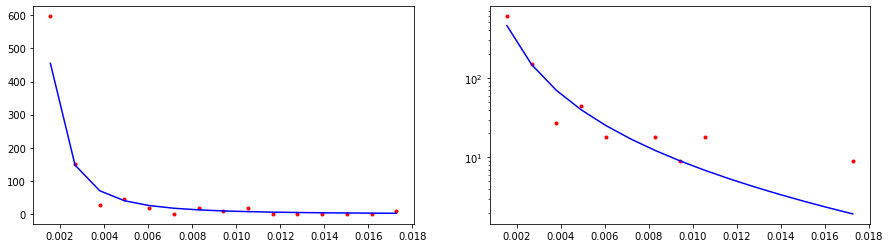

CPU times: user 194 µs, sys: 873 µs, total: 1.07 ms
Wall time: 866 µs
3893.792989591065


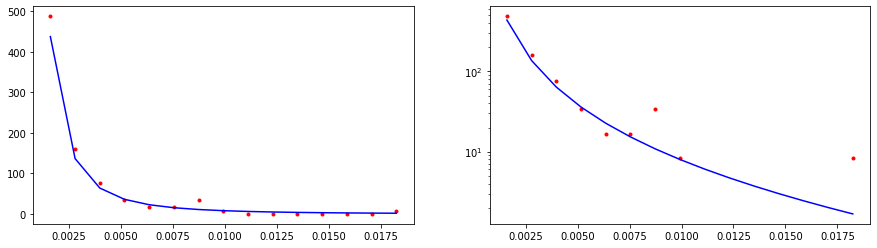

CPU times: user 991 µs, sys: 0 ns, total: 991 µs
Wall time: 823 µs
32284.347620580338


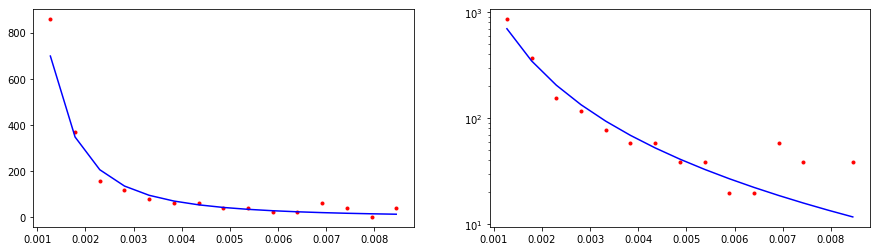

CPU times: user 1.12 ms, sys: 17 µs, total: 1.13 ms
Wall time: 957 µs
3863.81092927962


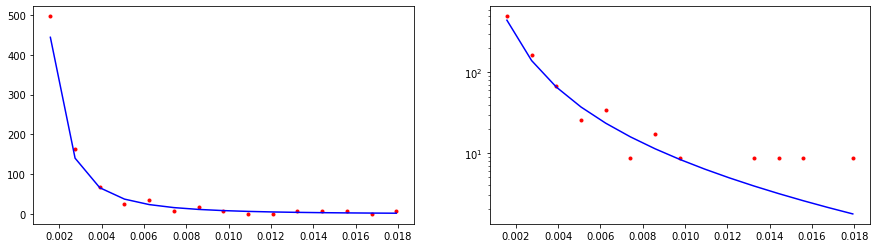

CPU times: user 1.02 ms, sys: 2 µs, total: 1.02 ms
Wall time: 911 µs
25758.93476881704


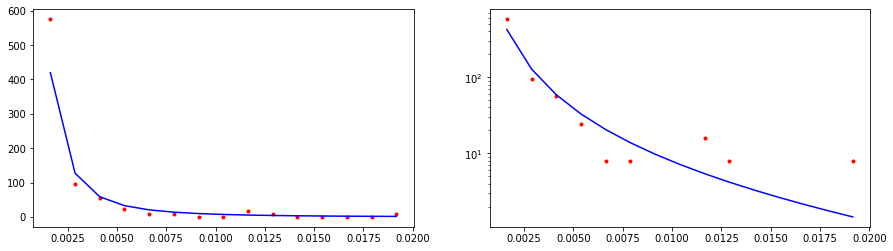

CPU times: user 1.19 ms, sys: 27 µs, total: 1.22 ms
Wall time: 1.01 ms
7151.0068829096135


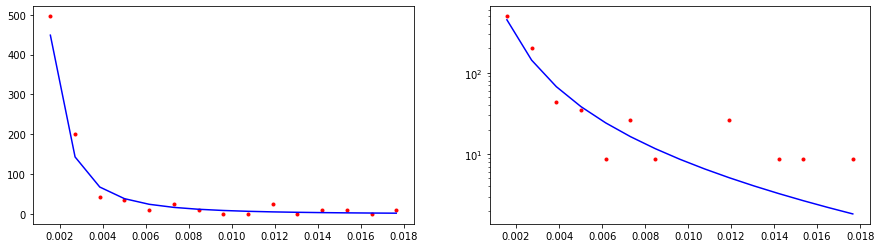

CPU times: user 308 µs, sys: 864 µs, total: 1.17 ms
Wall time: 986 µs
2569.2799434756857


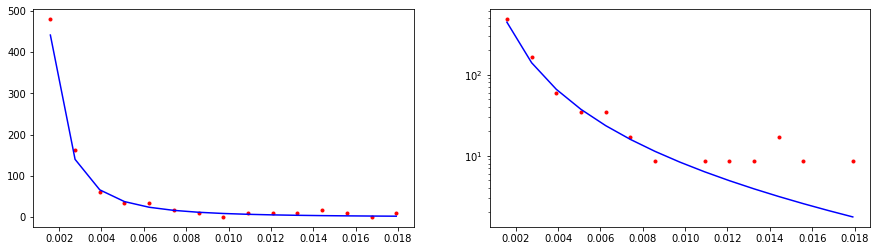

CPU times: user 1.18 ms, sys: 25 µs, total: 1.21 ms
Wall time: 1.02 ms
9365.25944521539


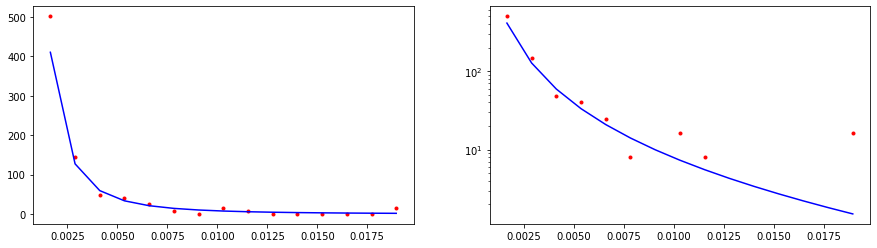

CPU times: user 1.19 ms, sys: 26 µs, total: 1.22 ms
Wall time: 1.04 ms
5759.950870362133


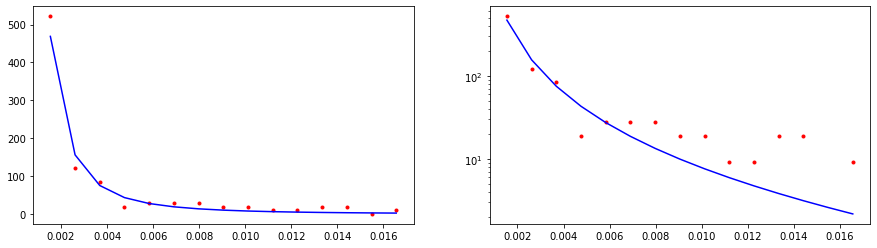

CPU times: user 1.23 ms, sys: 32 µs, total: 1.26 ms
Wall time: 1.09 ms
62122.820614217795


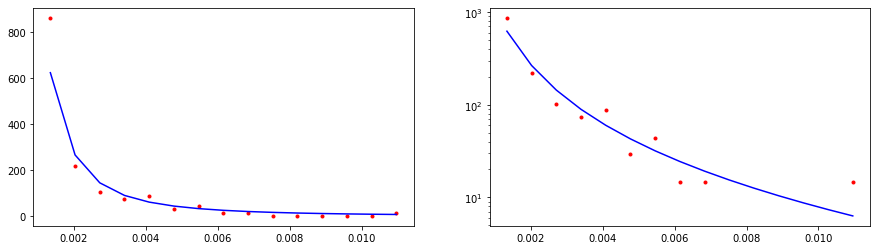

CPU times: user 690 µs, sys: 0 ns, total: 690 µs
Wall time: 437 µs
2416.8421972977876


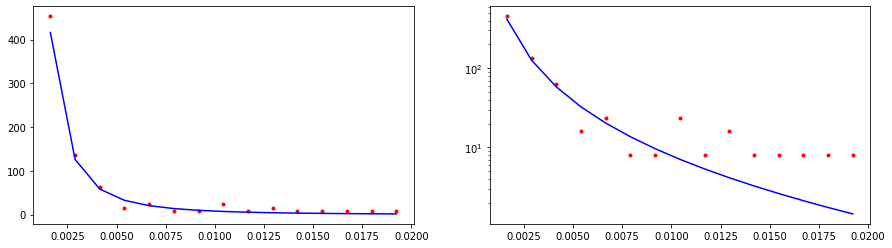

CPU times: user 129 µs, sys: 18 µs, total: 147 µs
Wall time: 120 µs
6810190.851864271


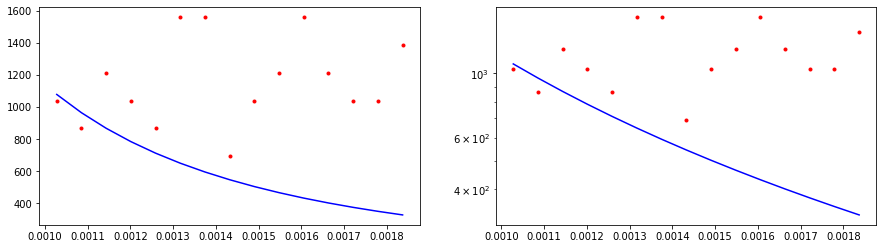

CPU times: user 263 µs, sys: 36 µs, total: 299 µs
Wall time: 249 µs
785547.228494544


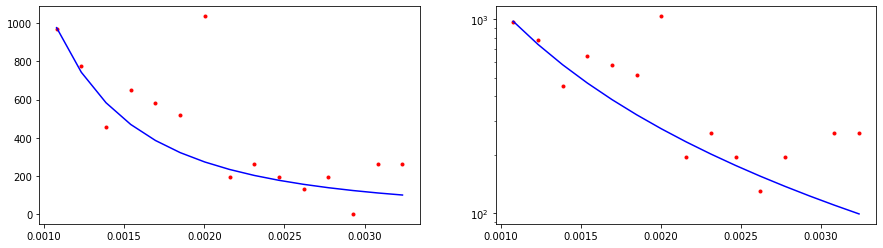

CPU times: user 299 µs, sys: 0 ns, total: 299 µs
Wall time: 215 µs
149572.40377304528


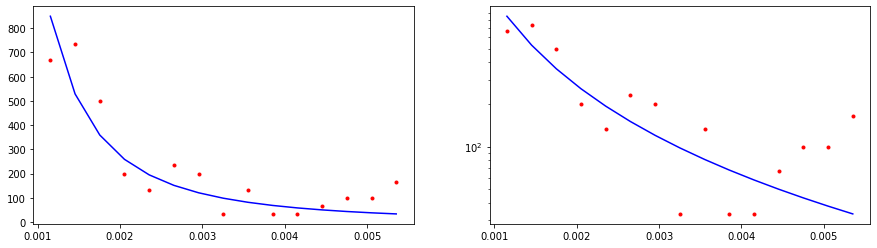

CPU times: user 0 ns, sys: 480 µs, total: 480 µs
Wall time: 327 µs
12970.84026251757


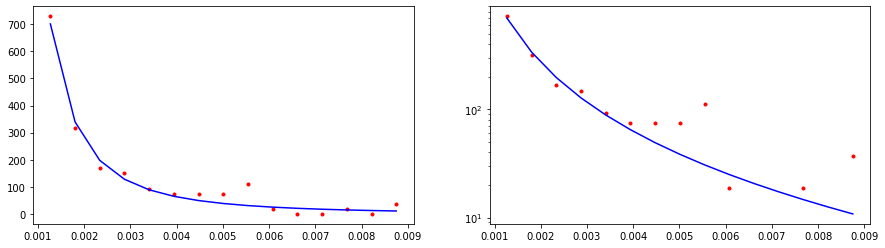

CPU times: user 474 µs, sys: 0 ns, total: 474 µs
Wall time: 300 µs
8225.064791777362


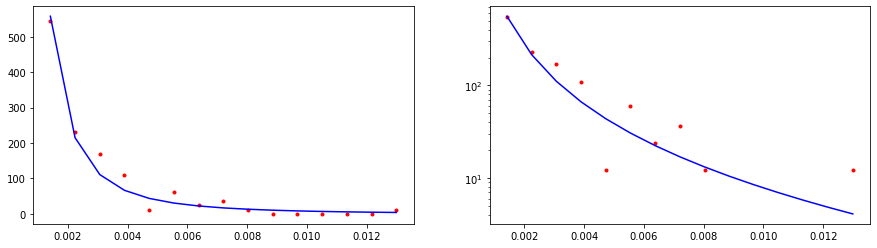

CPU times: user 533 µs, sys: 0 ns, total: 533 µs
Wall time: 348 µs
16714.57710638598


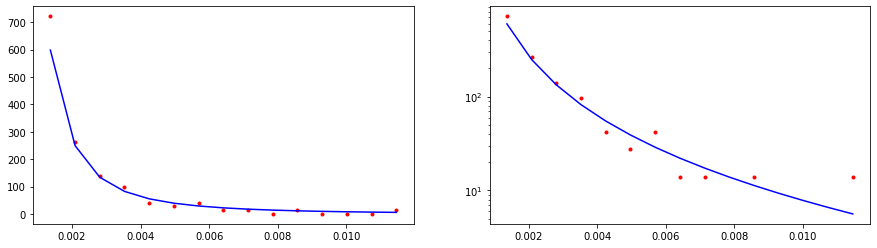

CPU times: user 586 µs, sys: 0 ns, total: 586 µs
Wall time: 421 µs
16926.625086996275


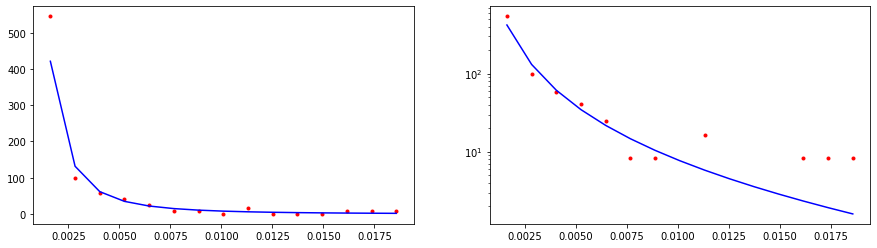

CPU times: user 0 ns, sys: 583 µs, total: 583 µs
Wall time: 397 µs
9646.493799485459


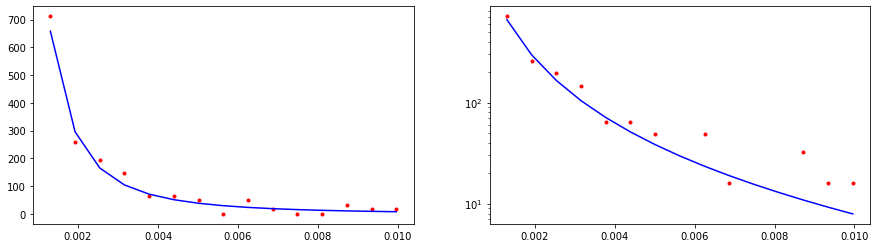

CPU times: user 650 µs, sys: 0 ns, total: 650 µs
Wall time: 480 µs
7350.236349974505


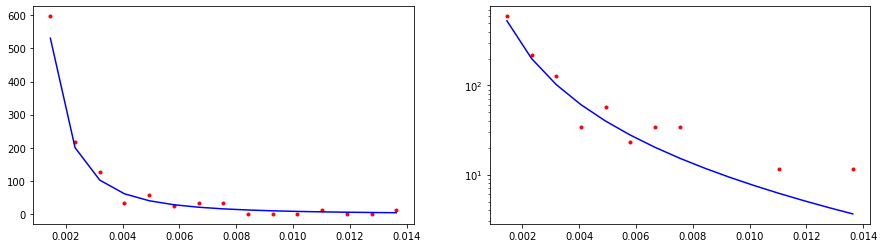

CPU times: user 691 µs, sys: 0 ns, total: 691 µs
Wall time: 518 µs
39611.63744245922


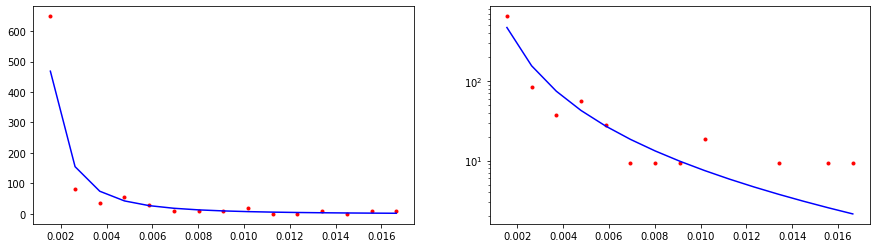

CPU times: user 0 ns, sys: 726 µs, total: 726 µs
Wall time: 536 µs
4266.094684461261


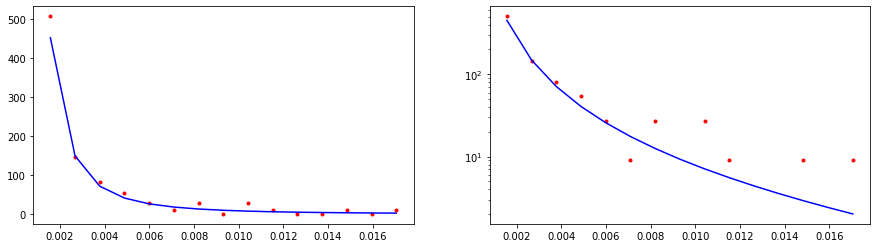

CPU times: user 0 ns, sys: 718 µs, total: 718 µs
Wall time: 533 µs
20595.98823672398


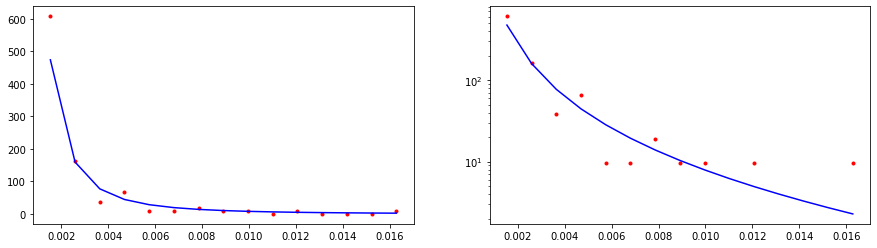

CPU times: user 673 µs, sys: 93 µs, total: 766 µs
Wall time: 584 µs
19835.708925822884


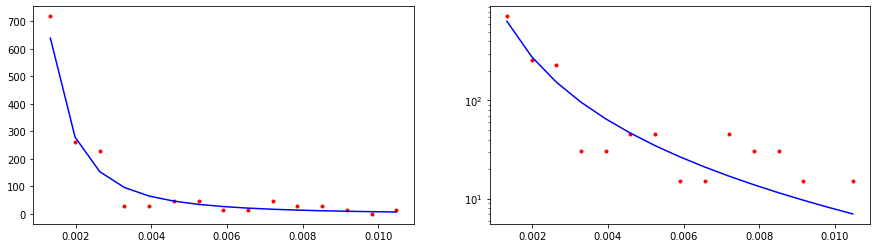

CPU times: user 815 µs, sys: 0 ns, total: 815 µs
Wall time: 628 µs
4878.613086694204


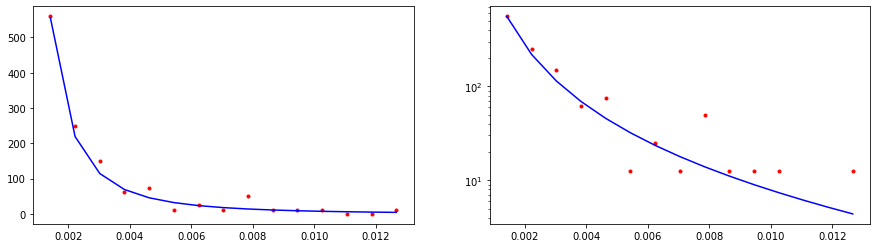

CPU times: user 821 µs, sys: 0 ns, total: 821 µs
Wall time: 653 µs
4840.125453705315


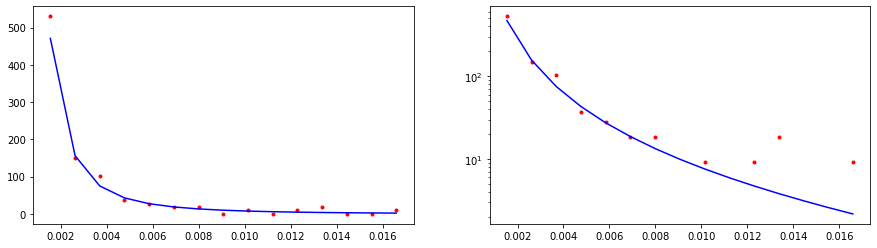

CPU times: user 764 µs, sys: 105 µs, total: 869 µs
Wall time: 685 µs
10473.046402792346


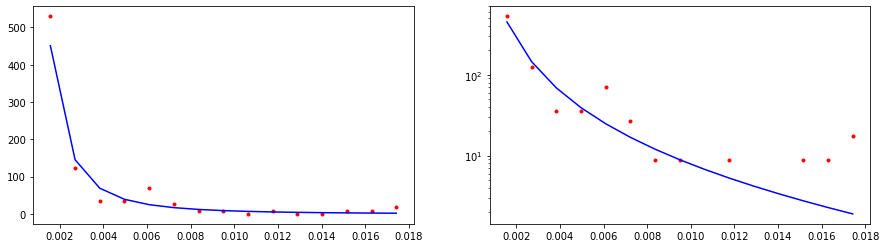

CPU times: user 849 µs, sys: 0 ns, total: 849 µs
Wall time: 681 µs
10869.426471873843


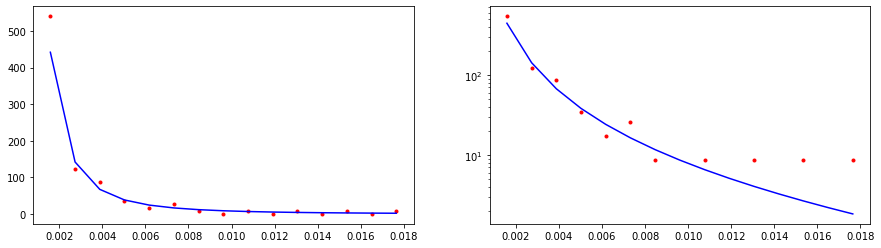

CPU times: user 761 µs, sys: 106 µs, total: 867 µs
Wall time: 695 µs
9351.1549333749


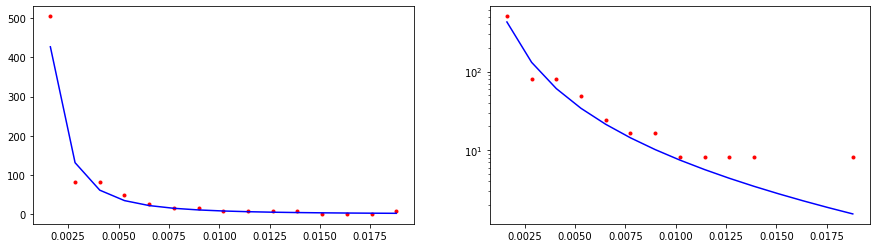

CPU times: user 819 µs, sys: 0 ns, total: 819 µs
Wall time: 709 µs
17158.67233971512


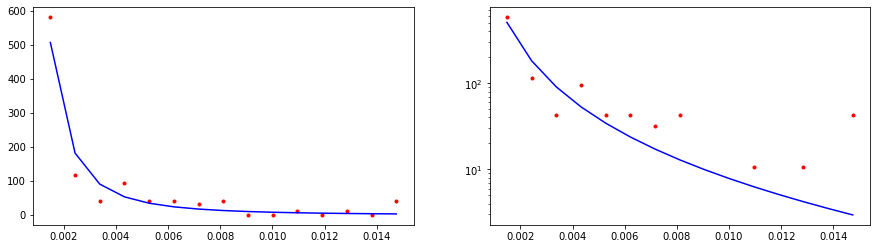

CPU times: user 924 µs, sys: 0 ns, total: 924 µs
Wall time: 754 µs
7365.9120561972595


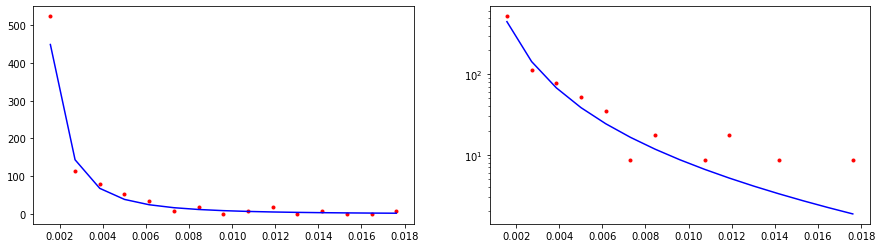

CPU times: user 942 µs, sys: 0 ns, total: 942 µs
Wall time: 772 µs
18021.937303590188


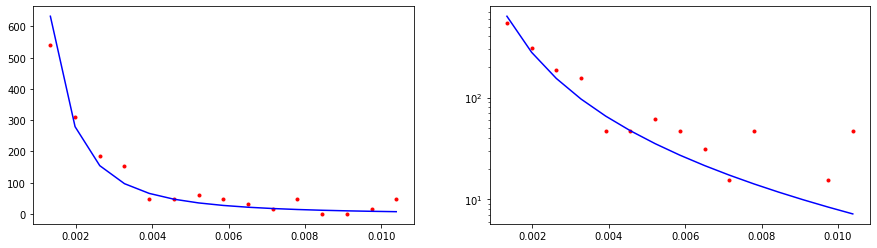

CPU times: user 984 µs, sys: 0 ns, total: 984 µs
Wall time: 789 µs
7308.161155833447


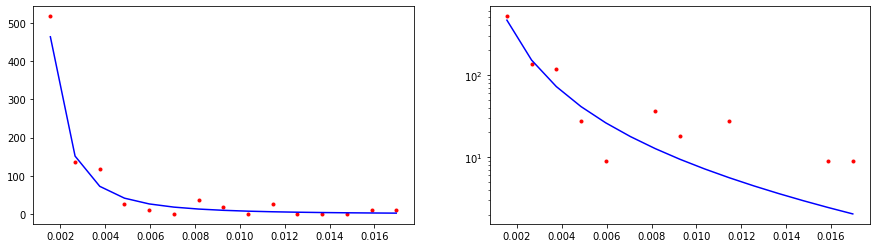

CPU times: user 1.03 ms, sys: 5 µs, total: 1.03 ms
Wall time: 852 µs
13885.510680960593


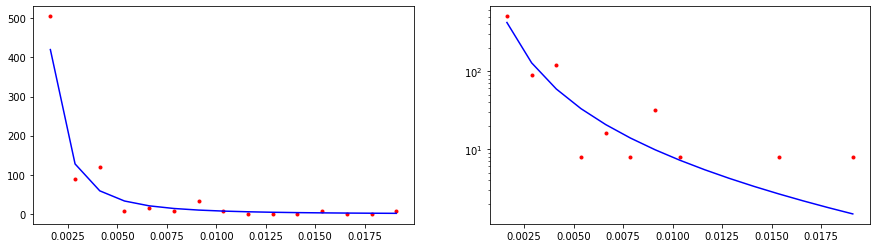

CPU times: user 1.02 ms, sys: 3 µs, total: 1.02 ms
Wall time: 851 µs
47906.61504846954


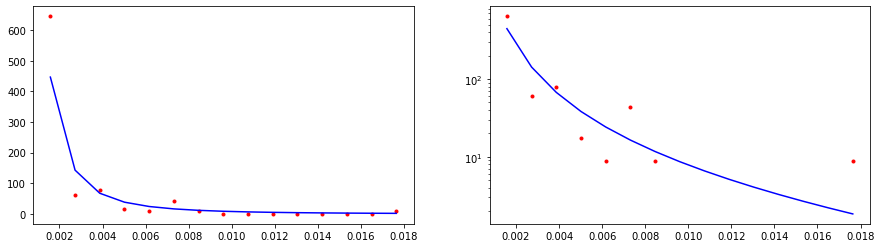

CPU times: user 1.13 ms, sys: 19 µs, total: 1.15 ms
Wall time: 965 µs
10172.960580571858


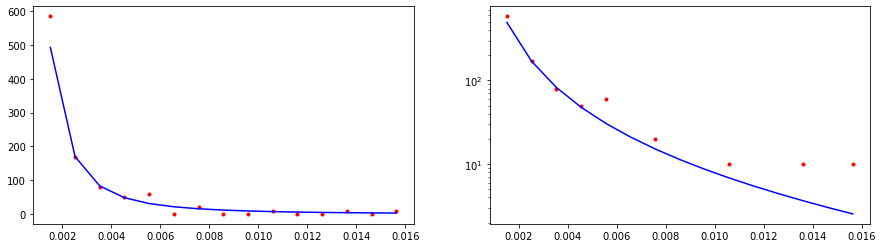

CPU times: user 1.1 ms, sys: 14 µs, total: 1.11 ms
Wall time: 941 µs
12056.281100550304


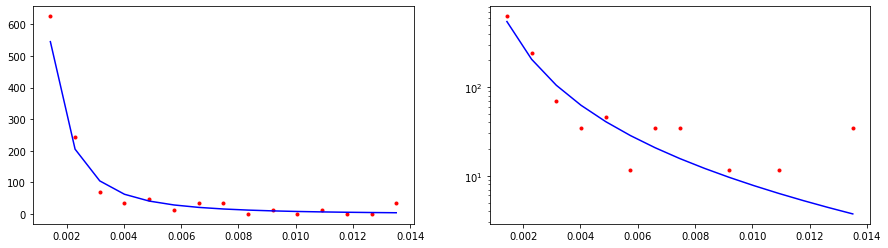

CPU times: user 1.08 ms, sys: 12 µs, total: 1.09 ms
Wall time: 917 µs
19626.849107231486


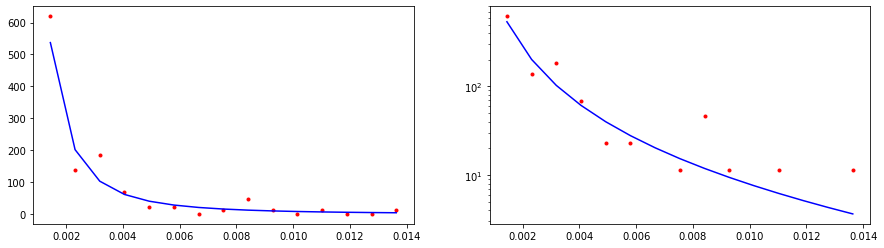

CPU times: user 1.17 ms, sys: 0 ns, total: 1.17 ms
Wall time: 990 µs
20694.664657425783


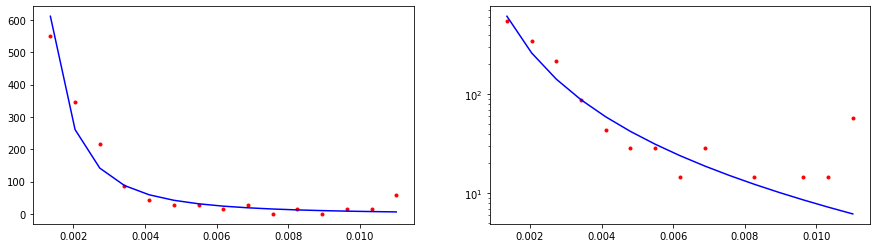

CPU times: user 1.17 ms, sys: 24 µs, total: 1.2 ms
Wall time: 1.02 ms
6194.084374707019


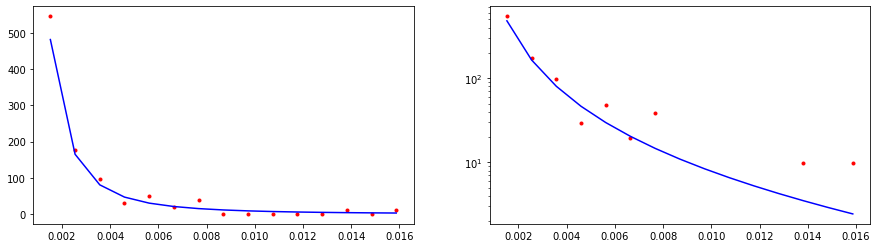

CPU times: user 1.24 ms, sys: 34 µs, total: 1.28 ms
Wall time: 1.09 ms
11616.876791957899


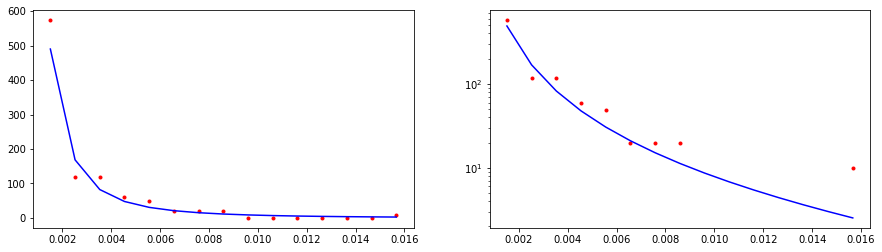

CPU times: user 639 µs, sys: 89 µs, total: 728 µs
Wall time: 474 µs
13574.350345150011


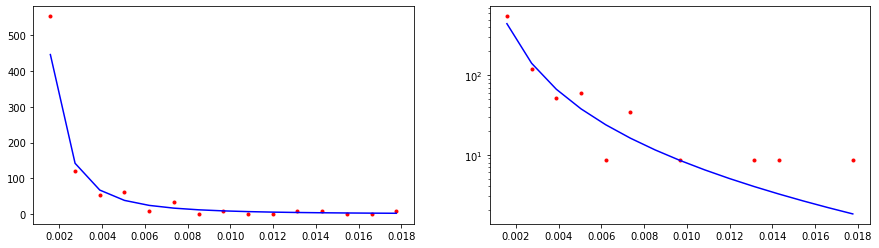

CPU times: user 228 µs, sys: 0 ns, total: 228 µs
Wall time: 191 µs
9252070.133390982


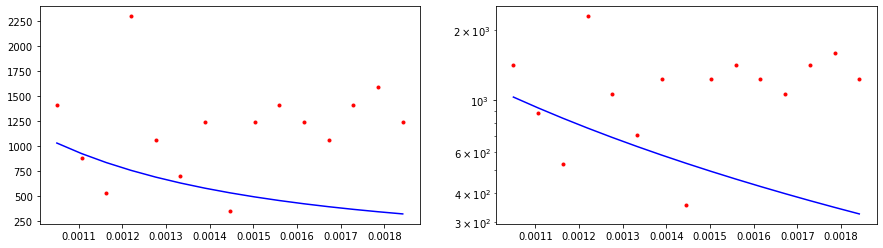

CPU times: user 218 µs, sys: 30 µs, total: 248 µs
Wall time: 217 µs
843279.0704193052


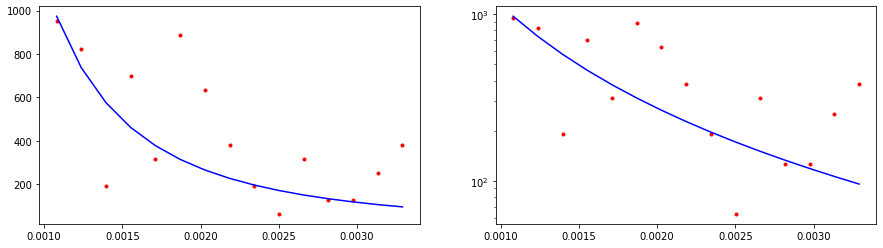

CPU times: user 279 µs, sys: 39 µs, total: 318 µs
Wall time: 266 µs
183869.14459002842


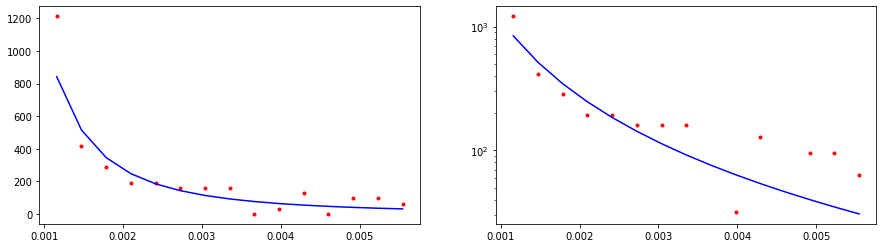

CPU times: user 368 µs, sys: 51 µs, total: 419 µs
Wall time: 309 µs
26038.678986764327


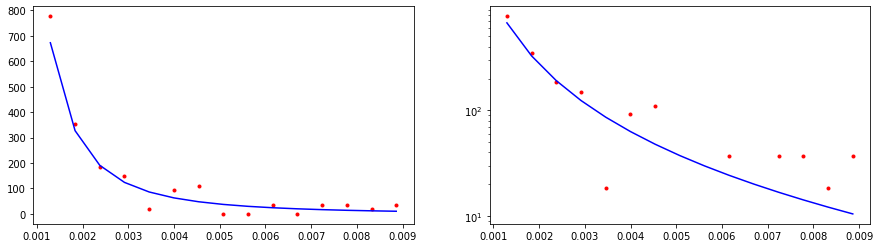

CPU times: user 0 ns, sys: 582 µs, total: 582 µs
Wall time: 384 µs
14245.835589423812


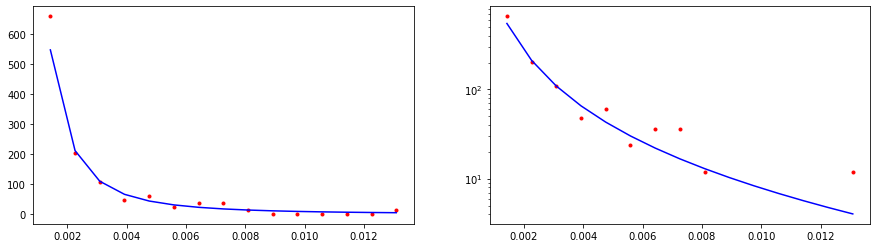

CPU times: user 444 µs, sys: 62 µs, total: 506 µs
Wall time: 338 µs
21608.198919186554


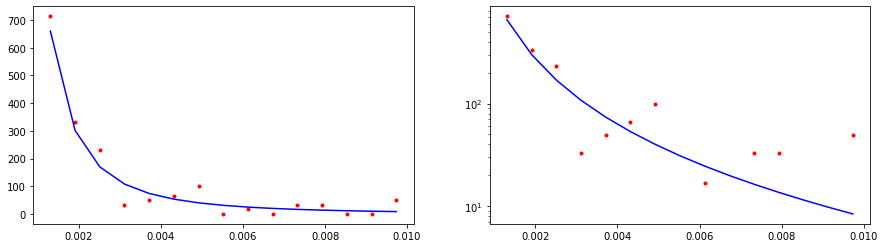

CPU times: user 562 µs, sys: 0 ns, total: 562 µs
Wall time: 369 µs
10891.258682215752


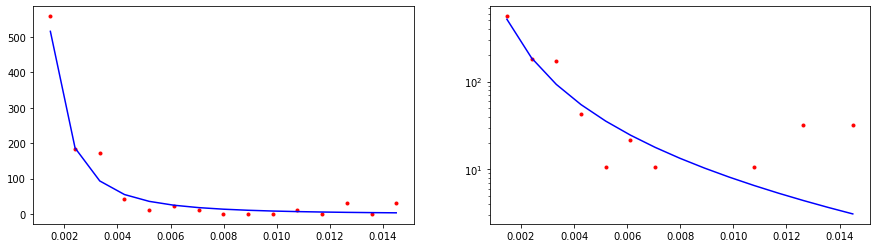

CPU times: user 600 µs, sys: 0 ns, total: 600 µs
Wall time: 416 µs
16458.43871218733


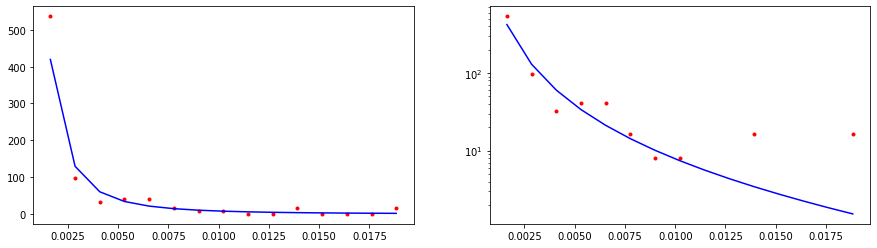

CPU times: user 616 µs, sys: 0 ns, total: 616 µs
Wall time: 436 µs
11459.886843551714


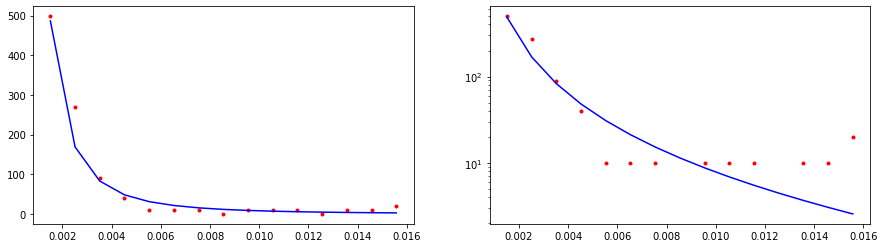

CPU times: user 556 µs, sys: 78 µs, total: 634 µs
Wall time: 466 µs
3854.3167579435803


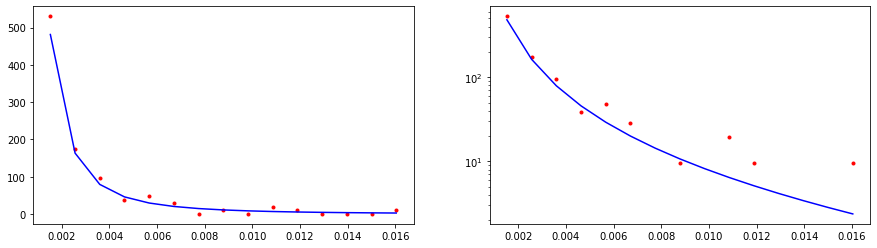

CPU times: user 0 ns, sys: 668 µs, total: 668 µs
Wall time: 490 µs
6057.395008615456


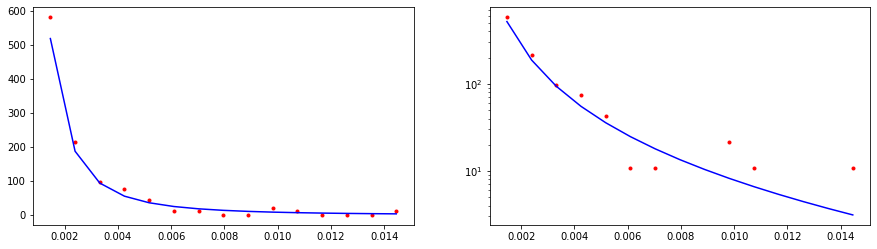

CPU times: user 697 µs, sys: 0 ns, total: 697 µs
Wall time: 524 µs
6521.385739935168


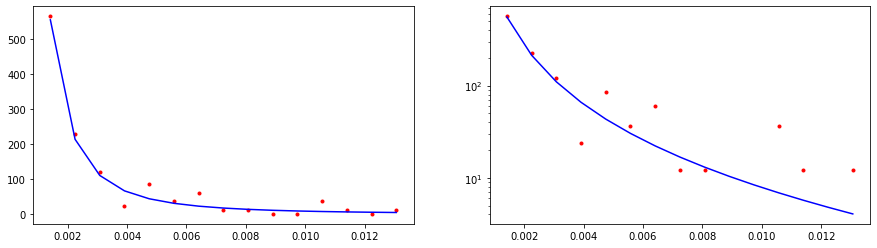

CPU times: user 673 µs, sys: 94 µs, total: 767 µs
Wall time: 590 µs
19849.092139733817


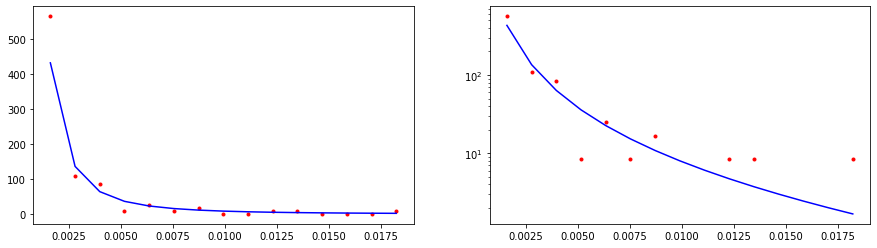

CPU times: user 0 ns, sys: 672 µs, total: 672 µs
Wall time: 565 µs
11781.253205743273


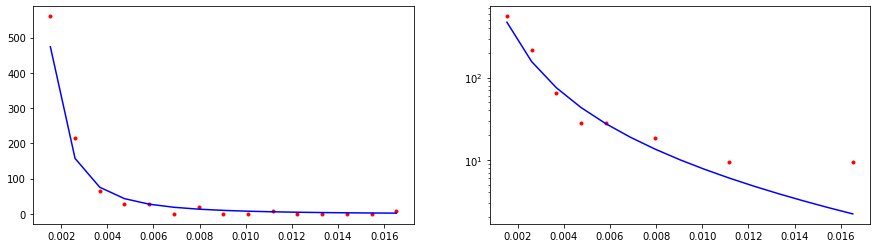

CPU times: user 823 µs, sys: 0 ns, total: 823 µs
Wall time: 675 µs
10543.587821564297


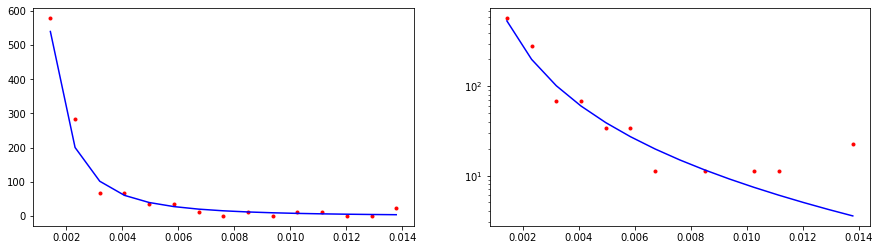

CPU times: user 777 µs, sys: 0 ns, total: 777 µs
Wall time: 609 µs
8323.558473227846


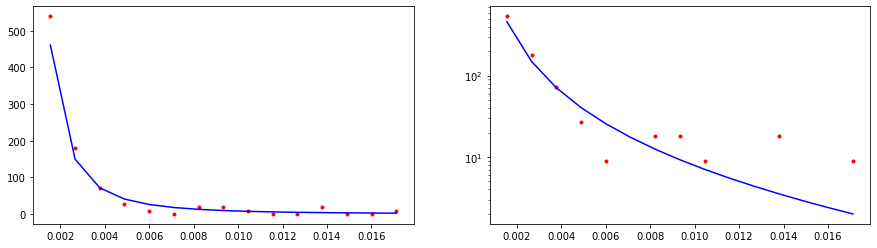

CPU times: user 879 µs, sys: 0 ns, total: 879 µs
Wall time: 712 µs
24147.868150861977


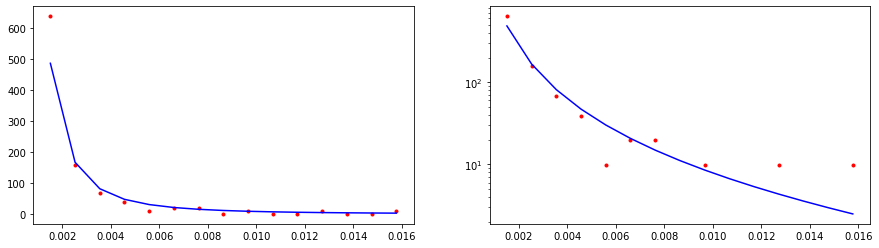

CPU times: user 812 µs, sys: 0 ns, total: 812 µs
Wall time: 656 µs
13963.225709860722


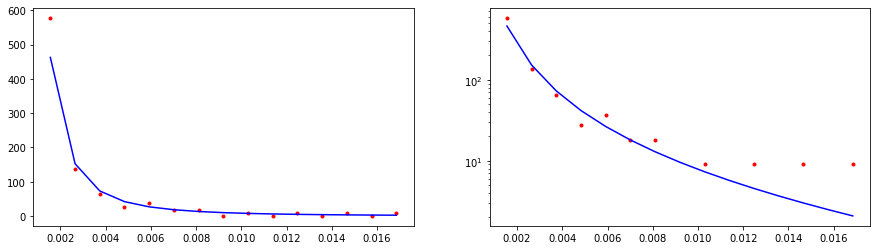

CPU times: user 847 µs, sys: 0 ns, total: 847 µs
Wall time: 683 µs
4089.7025483876837


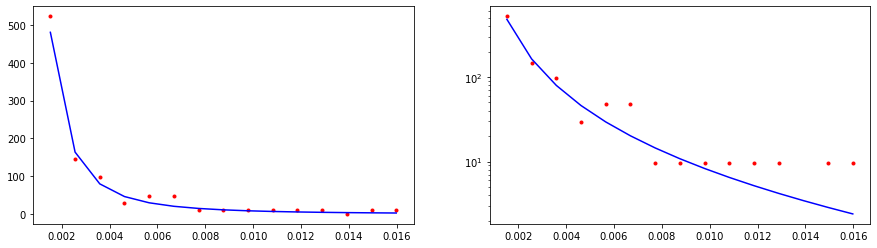

CPU times: user 991 µs, sys: 0 ns, total: 991 µs
Wall time: 814 µs
16500.914720617435


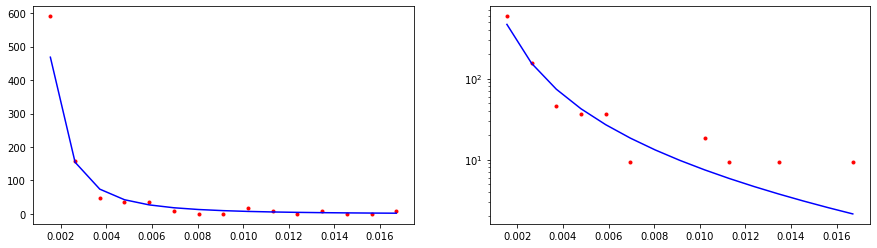

CPU times: user 996 µs, sys: 0 ns, total: 996 µs
Wall time: 829 µs
15054.595642549479


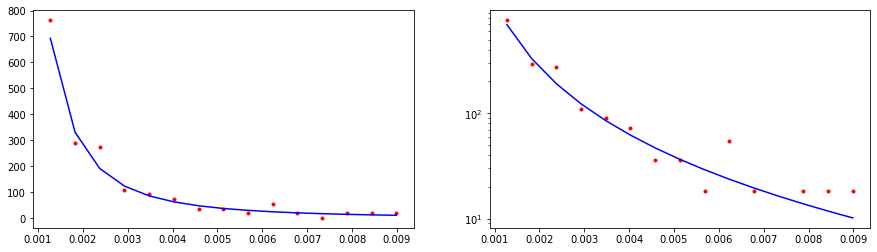

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 870 µs
7631.139498496767


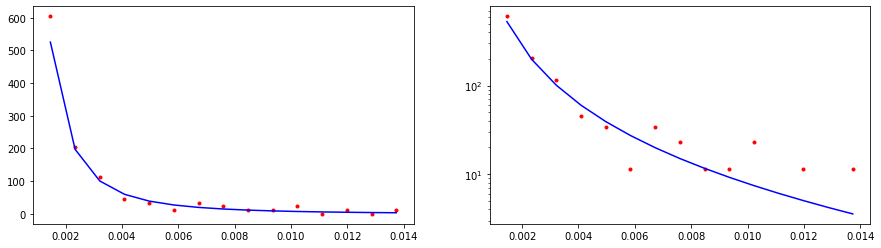

CPU times: user 164 µs, sys: 859 µs, total: 1.02 ms
Wall time: 844 µs
5549.098325659749


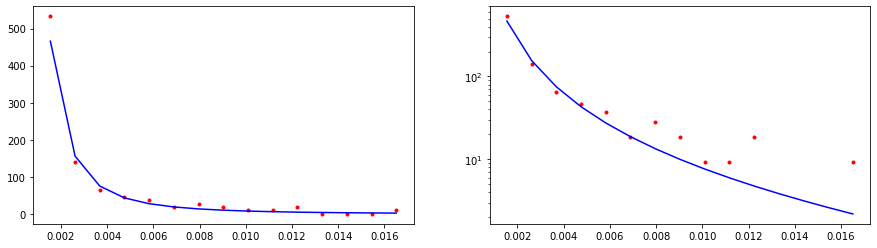

CPU times: user 1.02 ms, sys: 4 µs, total: 1.03 ms
Wall time: 852 µs
11059.759711955472


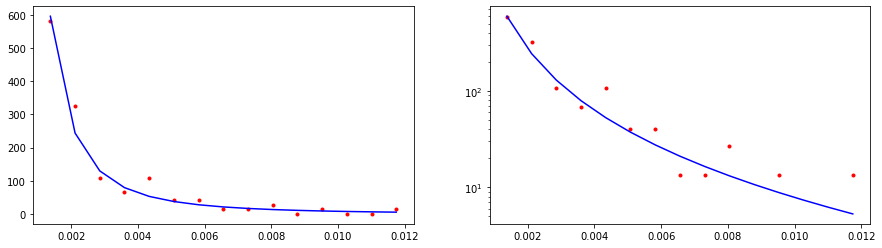

CPU times: user 1.05 ms, sys: 7 µs, total: 1.06 ms
Wall time: 884 µs
14209.413528573908


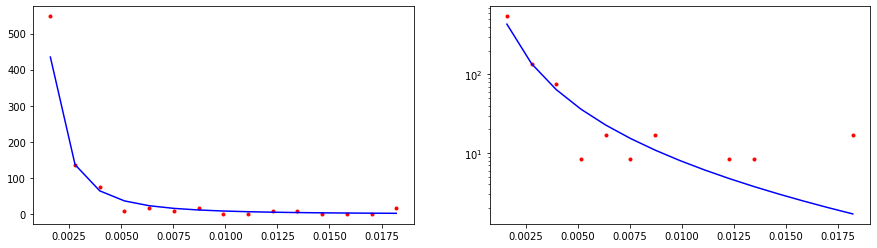

CPU times: user 206 µs, sys: 870 µs, total: 1.08 ms
Wall time: 941 µs
4517.360000485309


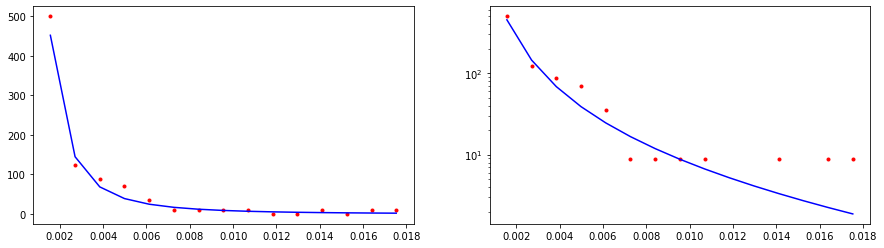

CPU times: user 1.26 ms, sys: 37 µs, total: 1.3 ms
Wall time: 1.11 ms
13956.435130954296


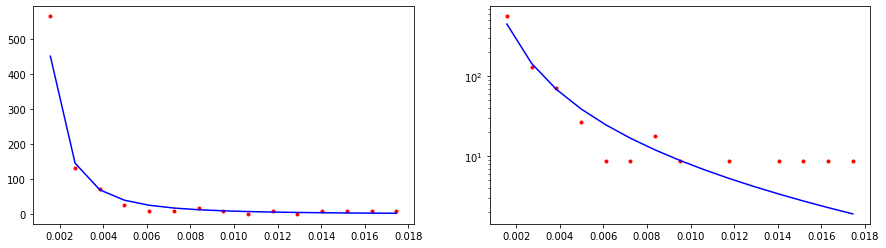

CPU times: user 1.17 ms, sys: 24 µs, total: 1.19 ms
Wall time: 998 µs
5741.4865643507


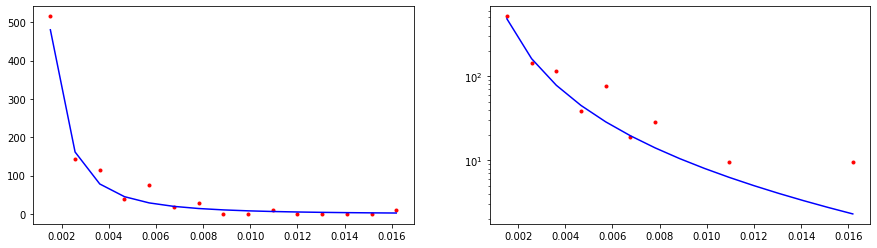

CPU times: user 1.22 ms, sys: 31 µs, total: 1.25 ms
Wall time: 1.07 ms
15997.677671731299


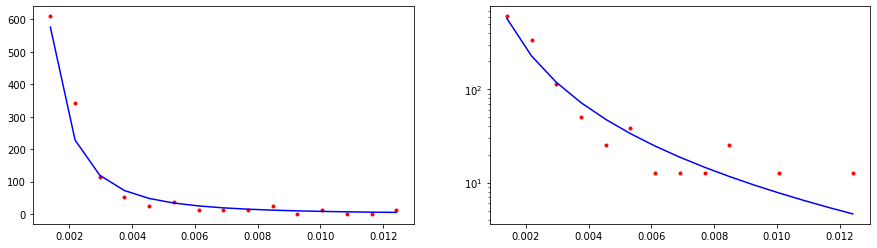

CPU times: user 1.2 ms, sys: 29 µs, total: 1.23 ms
Wall time: 1.05 ms
3075.8230131192577


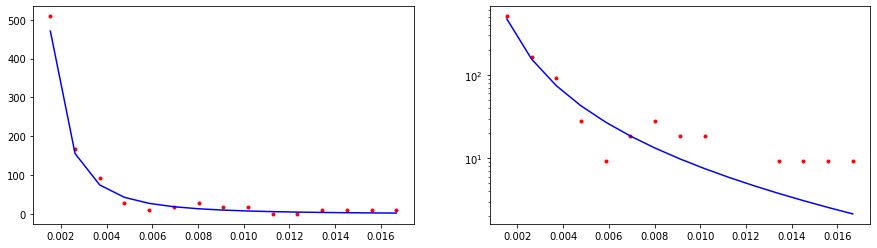

CPU times: user 591 µs, sys: 83 µs, total: 674 µs
Wall time: 429 µs
8841.04861849868


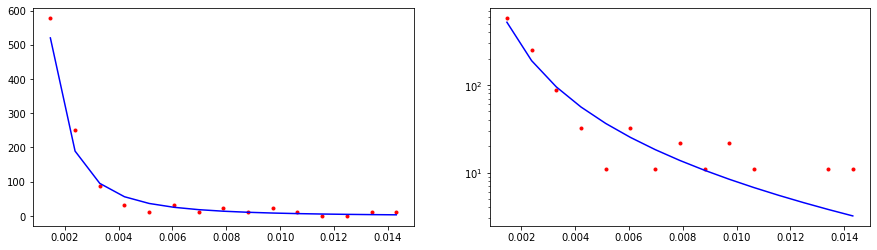

CPU times: user 259 µs, sys: 0 ns, total: 259 µs
Wall time: 223 µs
9630236.441012854


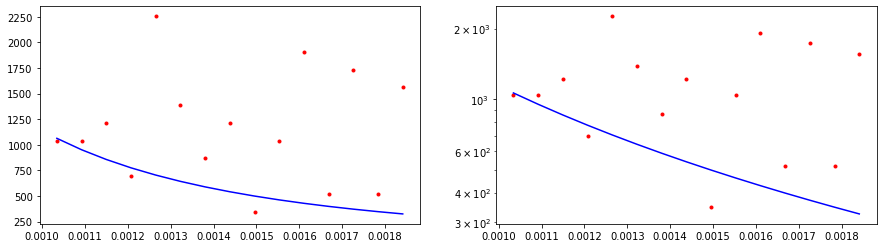

CPU times: user 182 µs, sys: 26 µs, total: 208 µs
Wall time: 179 µs
474943.89239753236


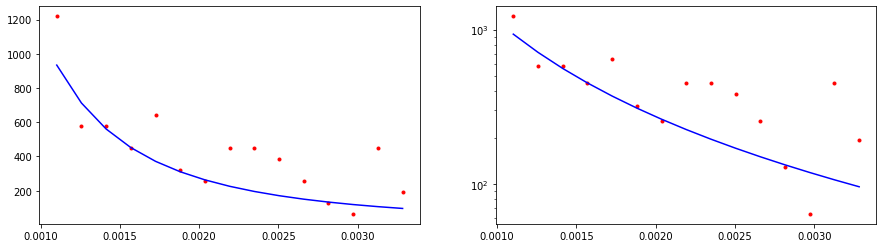

CPU times: user 333 µs, sys: 46 µs, total: 379 µs
Wall time: 288 µs
135891.64107676447


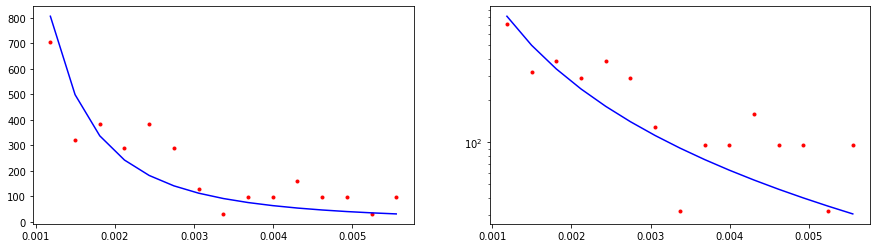

CPU times: user 490 µs, sys: 0 ns, total: 490 µs
Wall time: 359 µs
71055.13946360852


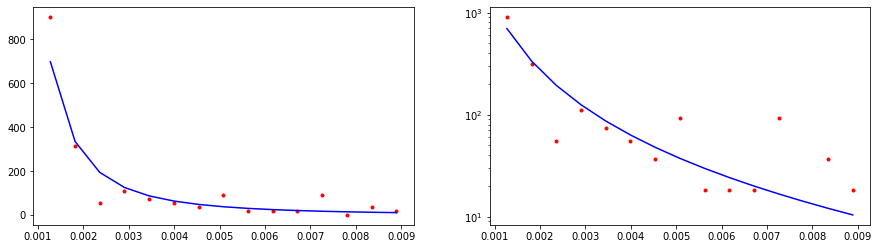

CPU times: user 419 µs, sys: 59 µs, total: 478 µs
Wall time: 313 µs
16487.612503038697


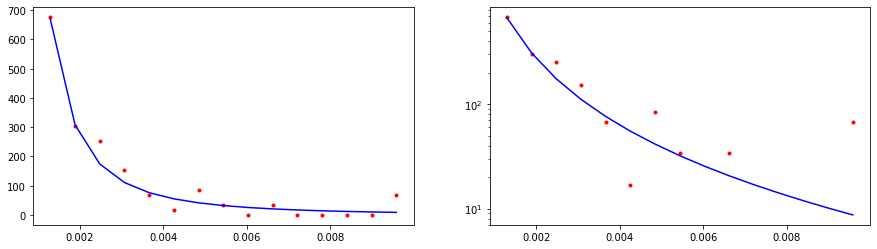

CPU times: user 440 µs, sys: 62 µs, total: 502 µs
Wall time: 335 µs
8195.901420276698


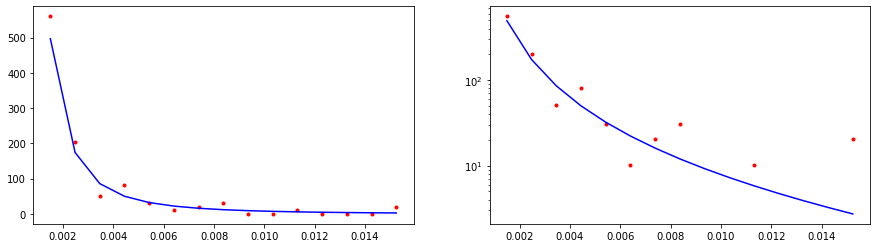

CPU times: user 482 µs, sys: 67 µs, total: 549 µs
Wall time: 365 µs
26817.25319751468


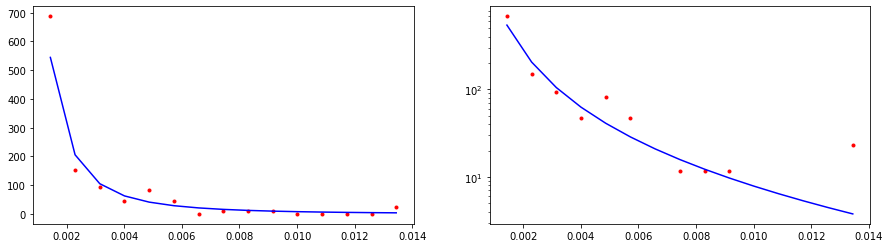

CPU times: user 541 µs, sys: 76 µs, total: 617 µs
Wall time: 434 µs
5908.930727553407


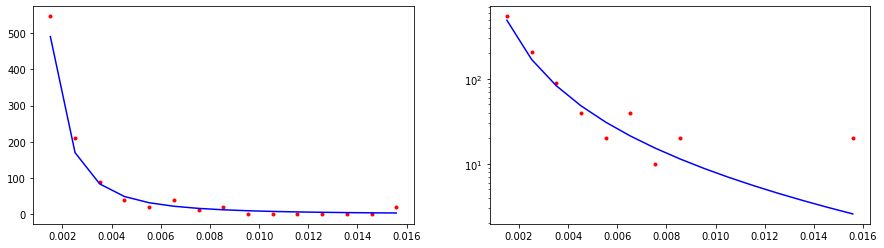

CPU times: user 534 µs, sys: 75 µs, total: 609 µs
Wall time: 434 µs
6245.417213393685


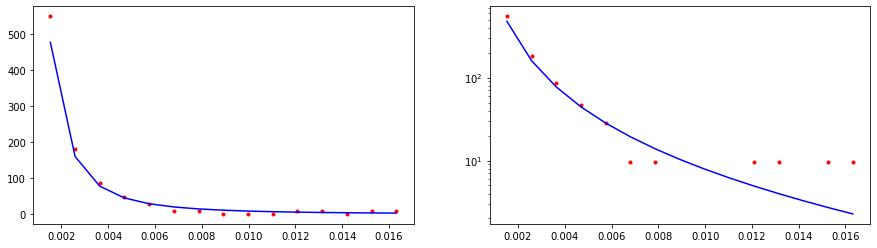

CPU times: user 579 µs, sys: 81 µs, total: 660 µs
Wall time: 484 µs
12114.701909099243


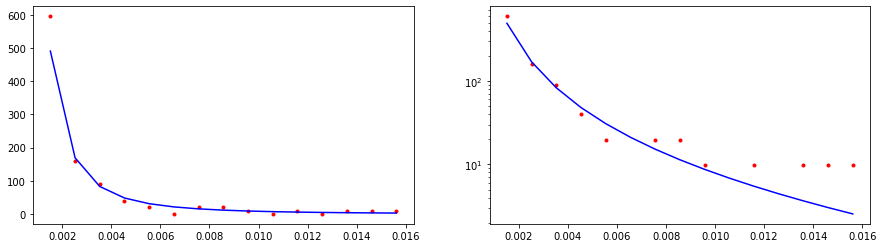

CPU times: user 679 µs, sys: 96 µs, total: 775 µs
Wall time: 578 µs
13475.473087803523


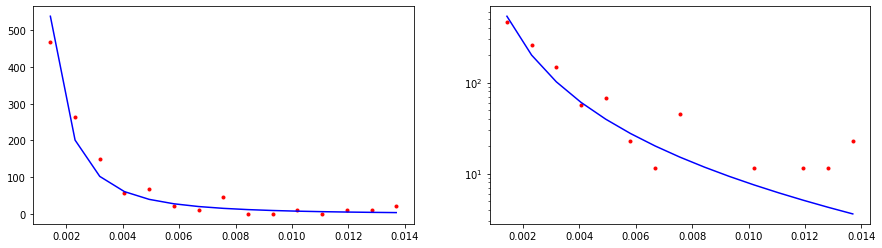

CPU times: user 596 µs, sys: 84 µs, total: 680 µs
Wall time: 502 µs
10273.570497698027


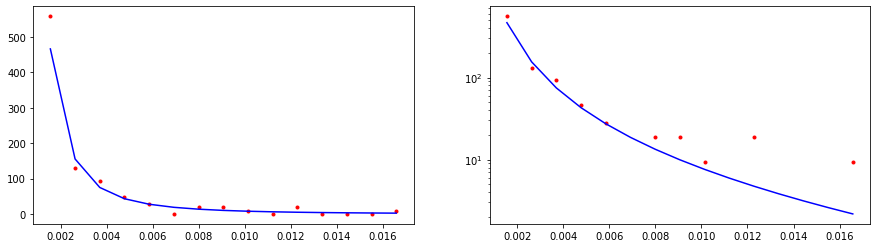

CPU times: user 720 µs, sys: 0 ns, total: 720 µs
Wall time: 542 µs
25181.007392587602


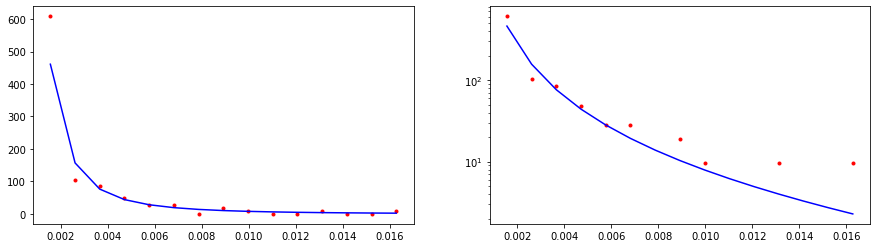

CPU times: user 791 µs, sys: 0 ns, total: 791 µs
Wall time: 617 µs
39672.76105095407


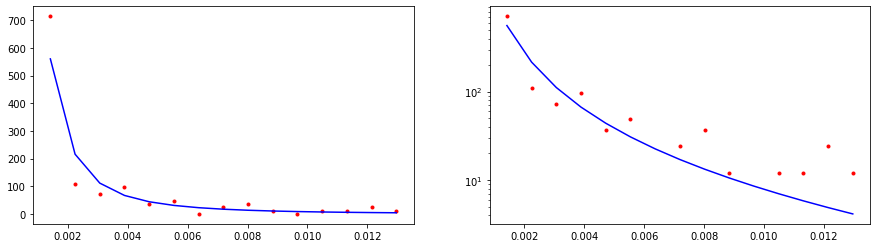

CPU times: user 840 µs, sys: 0 ns, total: 840 µs
Wall time: 653 µs
10531.116407604948


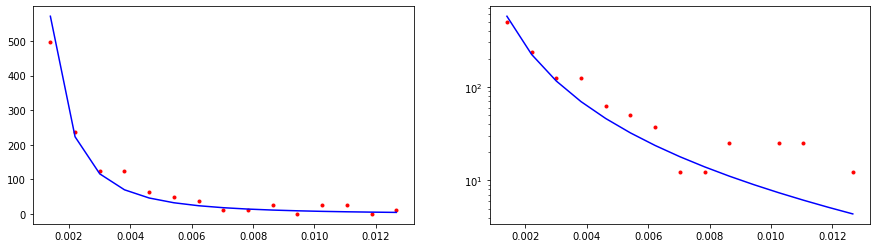

CPU times: user 827 µs, sys: 0 ns, total: 827 µs
Wall time: 657 µs
14322.978594688057


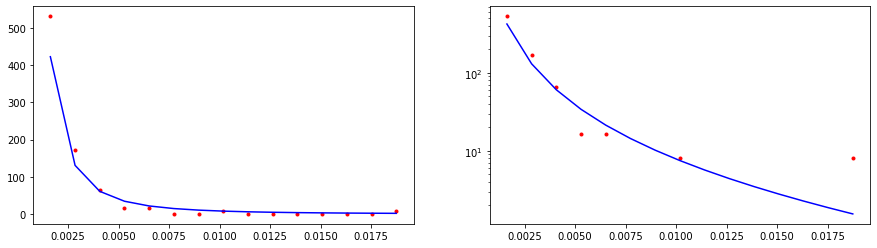

CPU times: user 748 µs, sys: 0 ns, total: 748 µs
Wall time: 642 µs
30941.458401768345


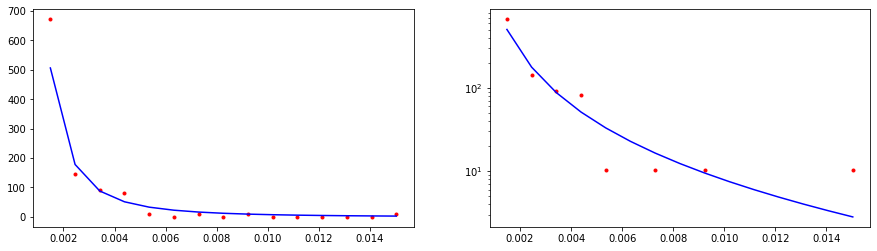

CPU times: user 690 µs, sys: 97 µs, total: 787 µs
Wall time: 673 µs
8596.163044597877


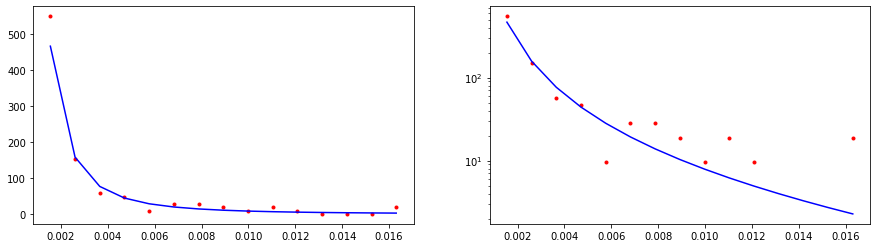

CPU times: user 898 µs, sys: 0 ns, total: 898 µs
Wall time: 728 µs
11607.227181832057


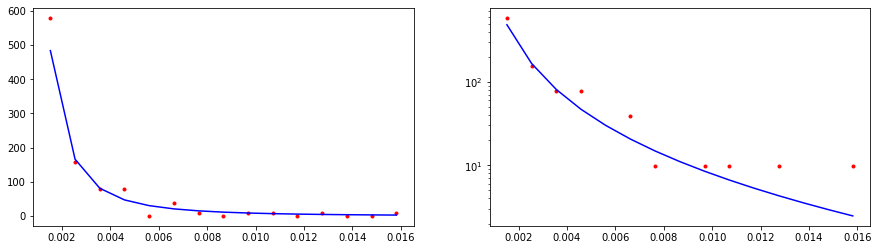

CPU times: user 751 µs, sys: 105 µs, total: 856 µs
Wall time: 732 µs
14019.632471375768


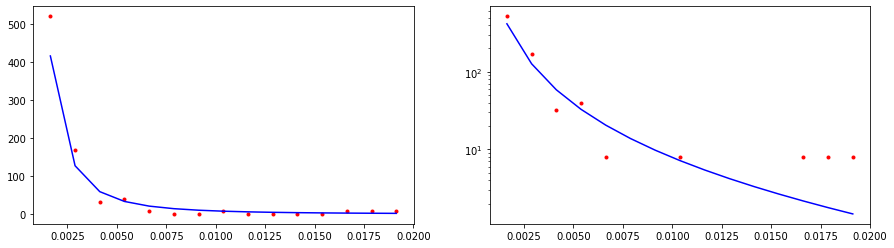

CPU times: user 897 µs, sys: 0 ns, total: 897 µs
Wall time: 778 µs
12222.571680330586


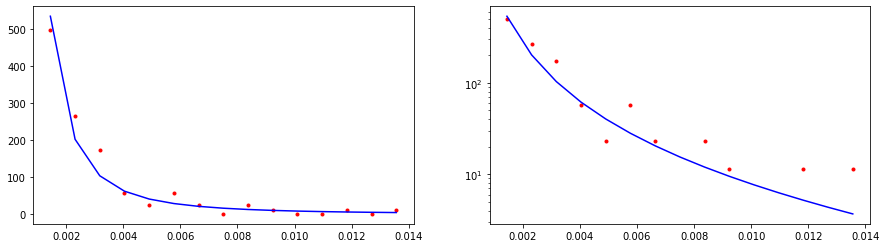

CPU times: user 934 µs, sys: 0 ns, total: 934 µs
Wall time: 772 µs
15751.043569103558


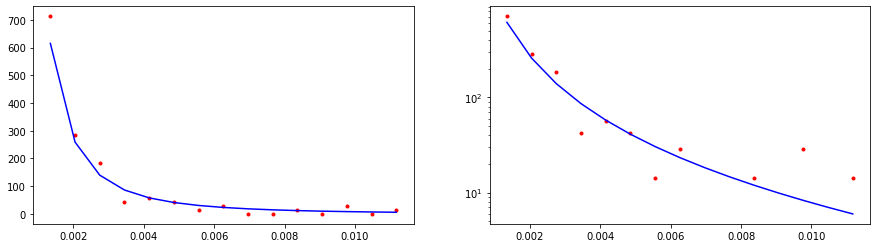

CPU times: user 872 µs, sys: 6 µs, total: 878 µs
Wall time: 783 µs
14688.686350799357


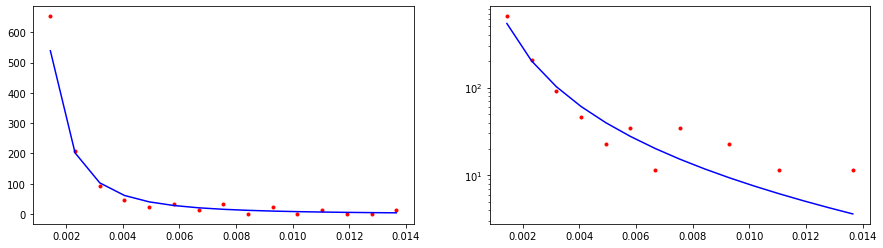

CPU times: user 1.11 ms, sys: 15 µs, total: 1.12 ms
Wall time: 926 µs
8197.593214037806


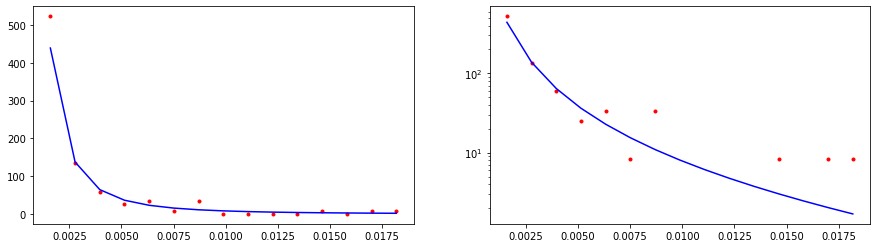

CPU times: user 338 µs, sys: 756 µs, total: 1.09 ms
Wall time: 915 µs
15315.261913975064


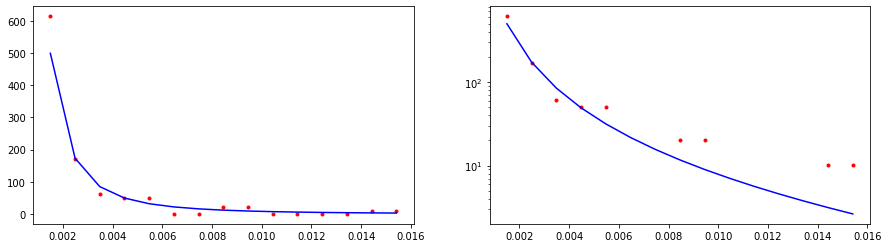

CPU times: user 1.16 ms, sys: 23 µs, total: 1.19 ms
Wall time: 982 µs
3653.7247357114993


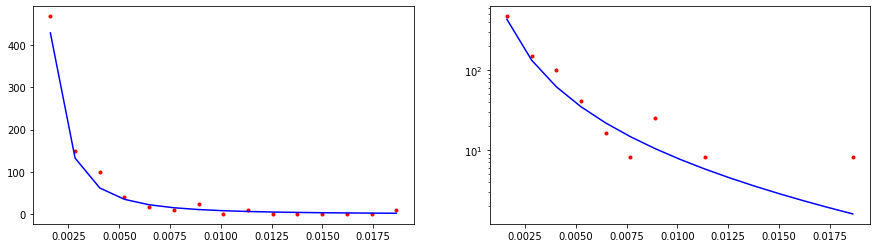

CPU times: user 1.14 ms, sys: 20 µs, total: 1.16 ms
Wall time: 969 µs
17668.297579502636


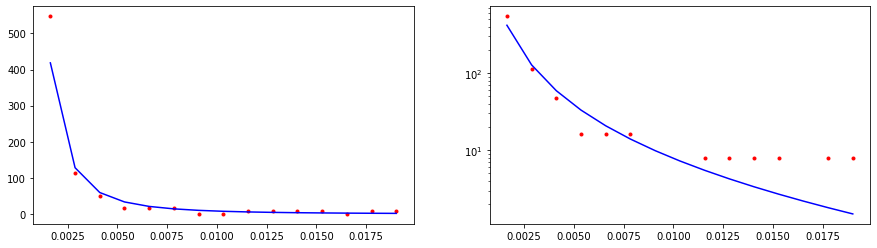

CPU times: user 1.14 ms, sys: 20 µs, total: 1.16 ms
Wall time: 982 µs
6439.179204952131


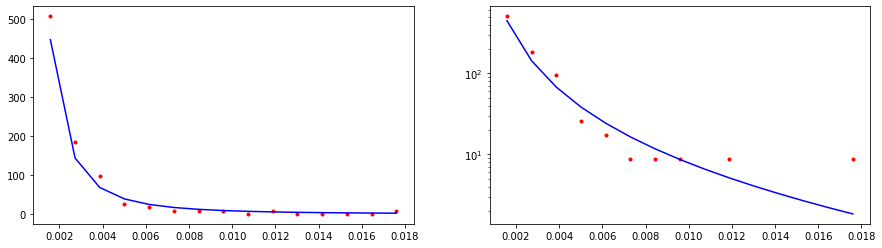

CPU times: user 1.24 ms, sys: 0 ns, total: 1.24 ms
Wall time: 1.03 ms
4741.802585445737


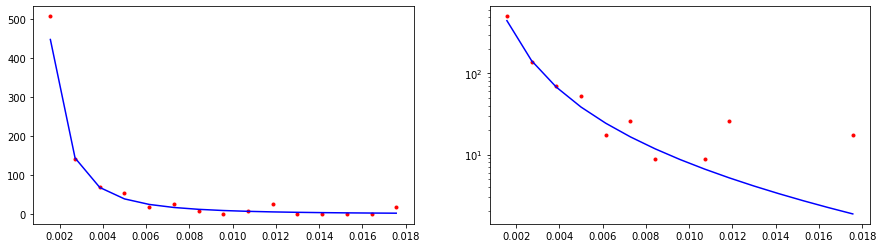

CPU times: user 1.17 ms, sys: 24 µs, total: 1.19 ms
Wall time: 1.07 ms
8721.172658822044


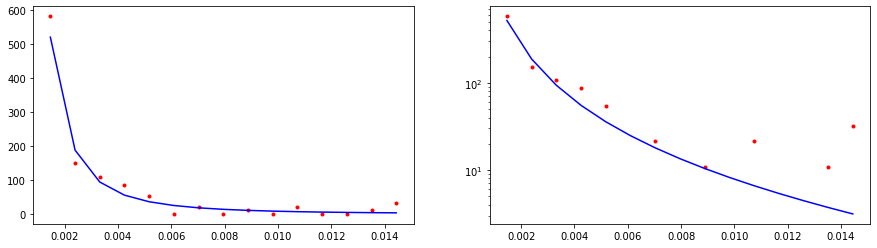

CPU times: user 0 ns, sys: 677 µs, total: 677 µs
Wall time: 431 µs
22071.8519158084


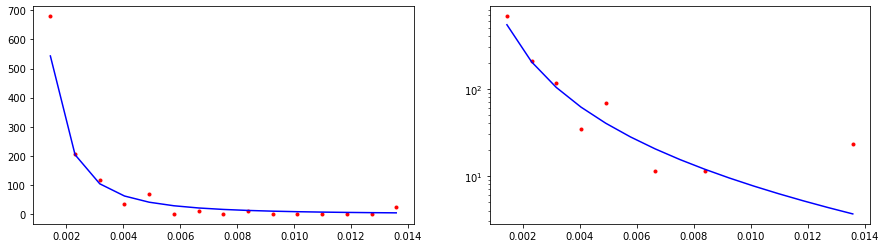

CPU times: user 176 µs, sys: 25 µs, total: 201 µs
Wall time: 182 µs
10139968.329465106


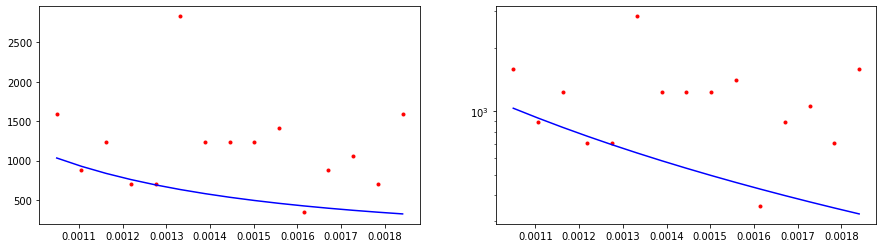

CPU times: user 310 µs, sys: 44 µs, total: 354 µs
Wall time: 267 µs
479599.72818234755


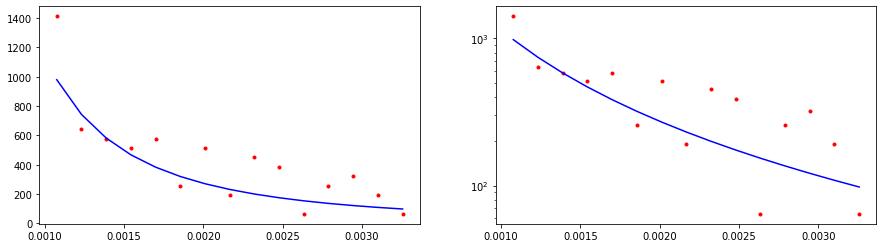

CPU times: user 280 µs, sys: 39 µs, total: 319 µs
Wall time: 282 µs
71478.54051980609


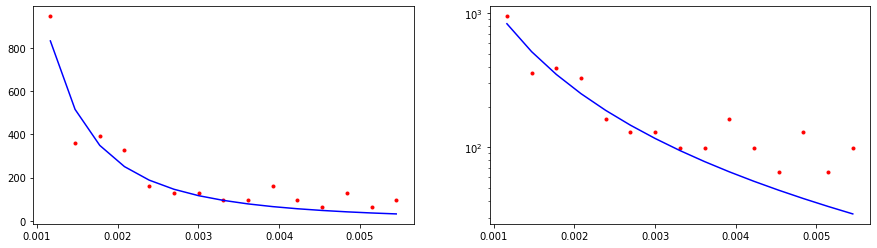

CPU times: user 0 ns, sys: 476 µs, total: 476 µs
Wall time: 316 µs
29461.566372435598


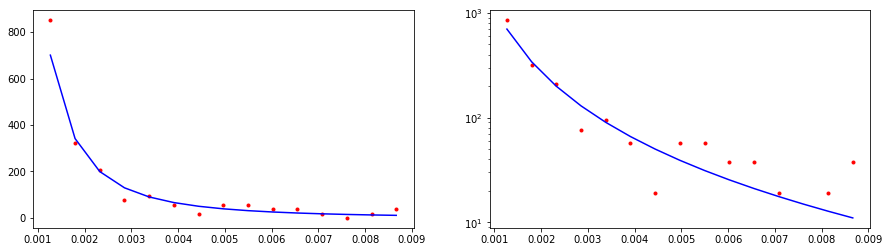

CPU times: user 0 ns, sys: 500 µs, total: 500 µs
Wall time: 335 µs
6804.524687144624


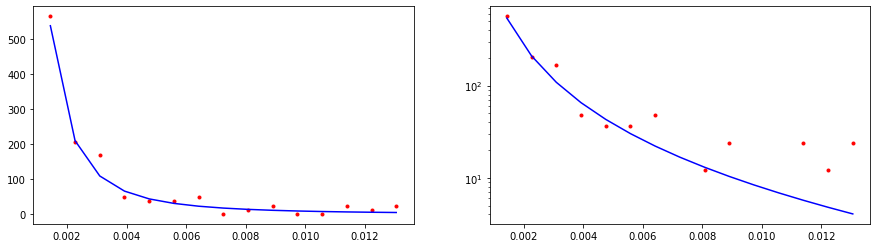

CPU times: user 441 µs, sys: 62 µs, total: 503 µs
Wall time: 331 µs
2918.9233454036494


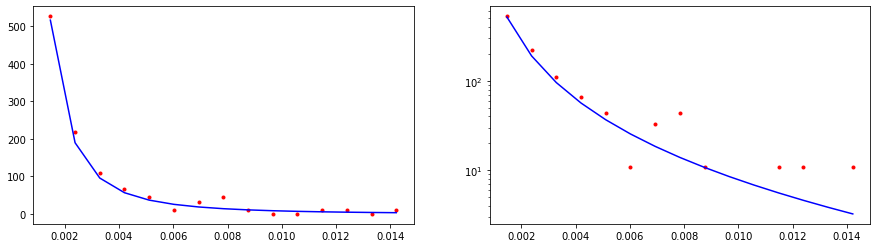

CPU times: user 522 µs, sys: 74 µs, total: 596 µs
Wall time: 405 µs
4463.7596266438


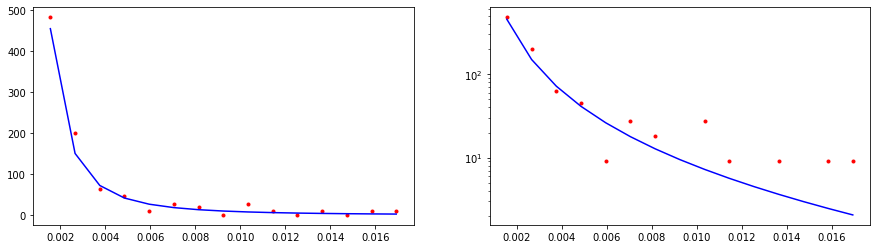

CPU times: user 503 µs, sys: 71 µs, total: 574 µs
Wall time: 400 µs
3864.1181060379745


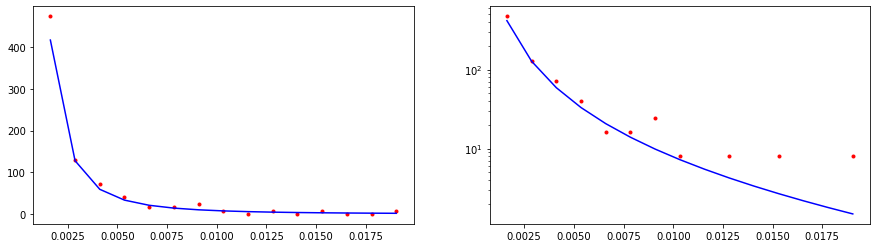

CPU times: user 0 ns, sys: 620 µs, total: 620 µs
Wall time: 437 µs
5358.91636799179


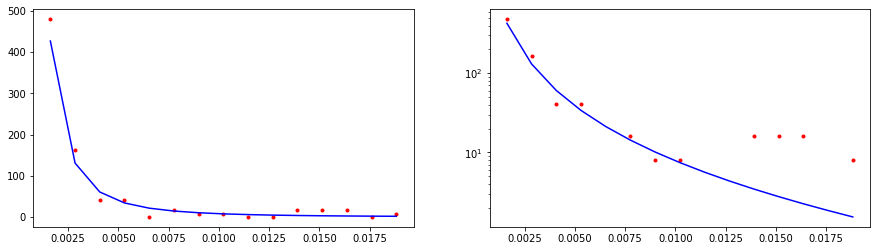

CPU times: user 0 ns, sys: 634 µs, total: 634 µs
Wall time: 464 µs
6655.937579415837


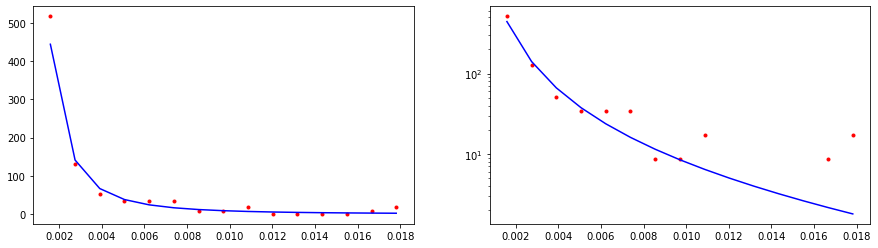

CPU times: user 673 µs, sys: 96 µs, total: 769 µs
Wall time: 574 µs
13318.648941614803


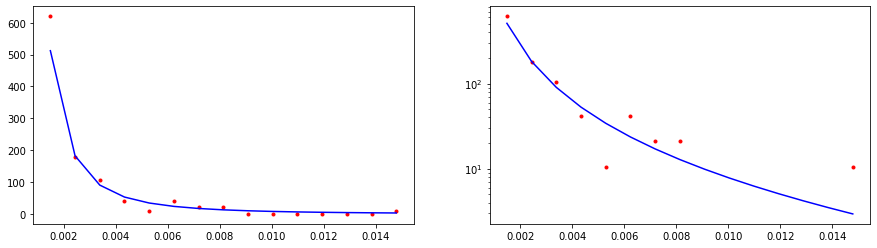

CPU times: user 731 µs, sys: 0 ns, total: 731 µs
Wall time: 555 µs
7527.61990498237


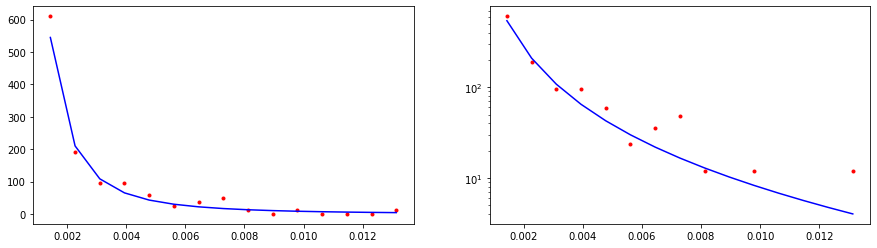

CPU times: user 774 µs, sys: 0 ns, total: 774 µs
Wall time: 566 µs
14742.435219579464


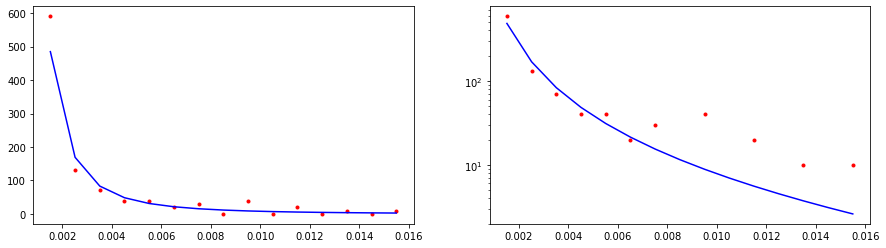

CPU times: user 0 ns, sys: 703 µs, total: 703 µs
Wall time: 540 µs
7925.073068938042


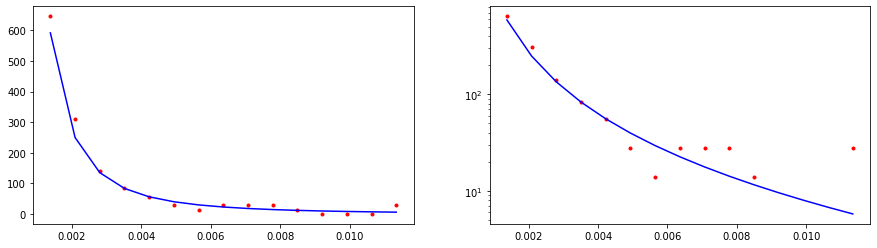

CPU times: user 771 µs, sys: 0 ns, total: 771 µs
Wall time: 596 µs
11751.125092530727


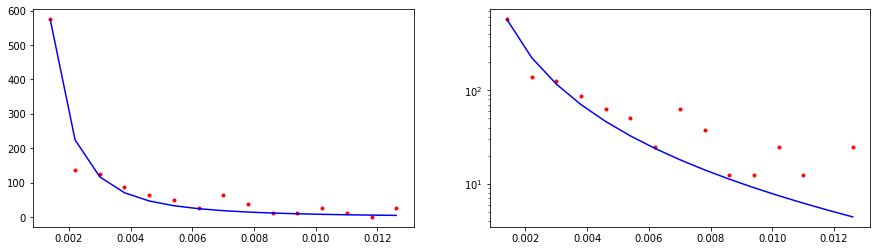

CPU times: user 707 µs, sys: 100 µs, total: 807 µs
Wall time: 633 µs
8386.352093894493


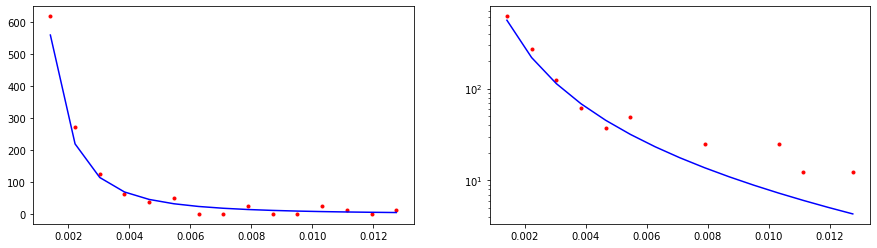

CPU times: user 869 µs, sys: 0 ns, total: 869 µs
Wall time: 660 µs
31446.9045805372


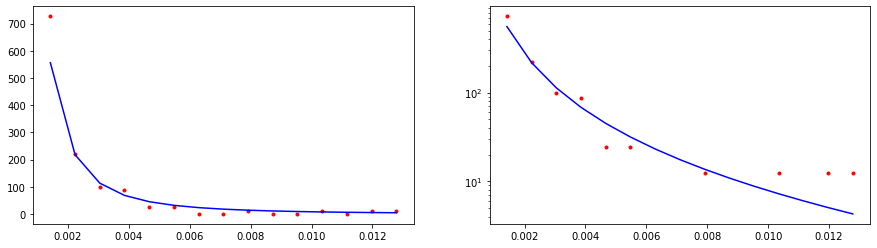

CPU times: user 870 µs, sys: 0 ns, total: 870 µs
Wall time: 690 µs
3905.675411731567


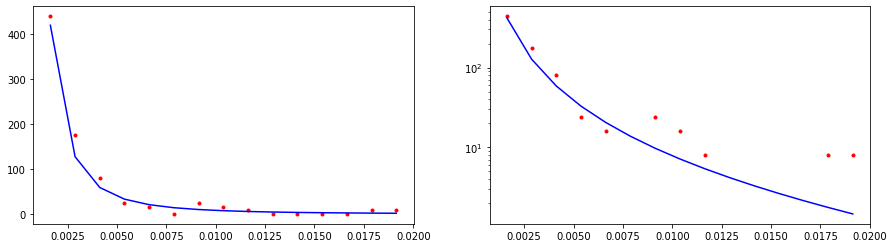

CPU times: user 0 ns, sys: 932 µs, total: 932 µs
Wall time: 726 µs
38352.42377945404


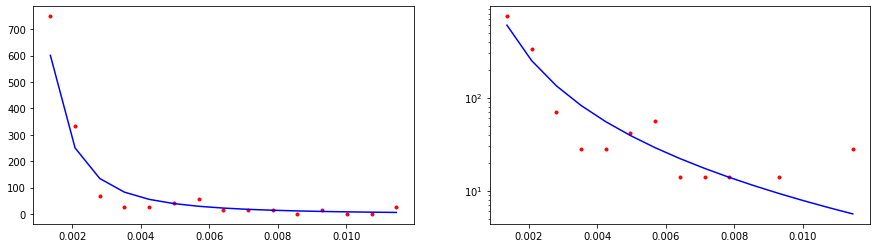

CPU times: user 929 µs, sys: 0 ns, total: 929 µs
Wall time: 755 µs
13212.538679037696


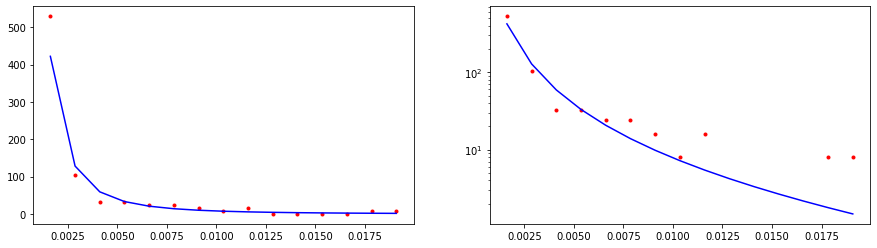

CPU times: user 881 µs, sys: 0 ns, total: 881 µs
Wall time: 729 µs
7455.074232027985


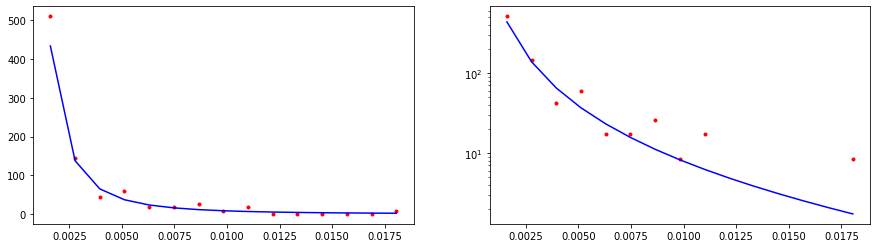

CPU times: user 969 µs, sys: 0 ns, total: 969 µs
Wall time: 800 µs
18060.090359693124


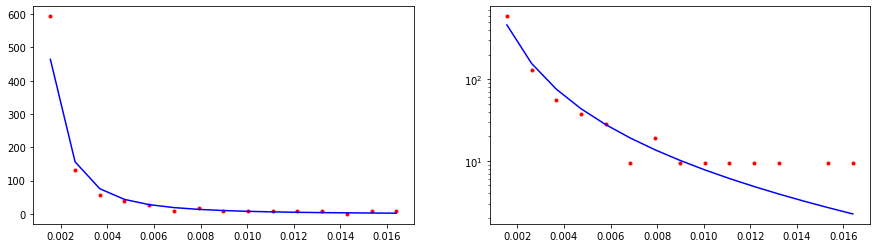

CPU times: user 60 µs, sys: 870 µs, total: 930 µs
Wall time: 817 µs
2333.1006319264498


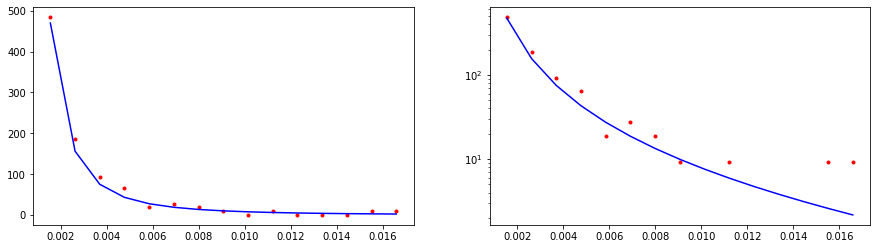

CPU times: user 789 µs, sys: 111 µs, total: 900 µs
Wall time: 797 µs
42272.15275119136


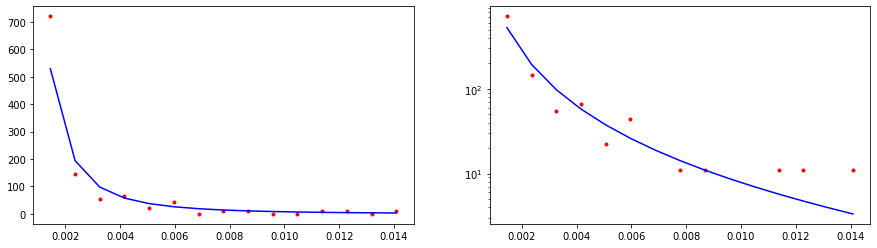

CPU times: user 1.03 ms, sys: 4 µs, total: 1.03 ms
Wall time: 917 µs
5738.5873401839235


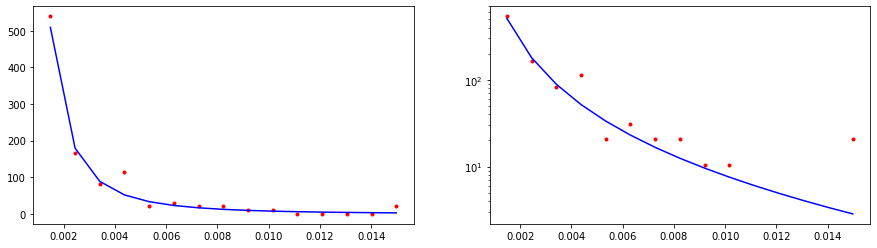

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 884 µs
20428.464570198797


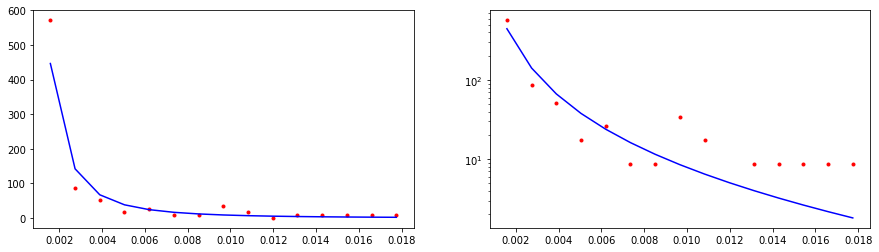

CPU times: user 1.12 ms, sys: 18 µs, total: 1.14 ms
Wall time: 964 µs
5546.776674950756


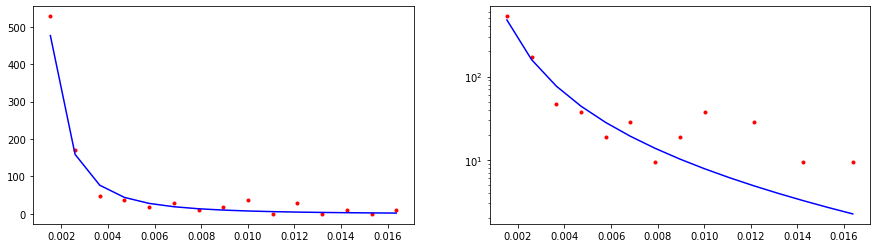

CPU times: user 1.14 ms, sys: 20 µs, total: 1.16 ms
Wall time: 983 µs
6051.386707258301


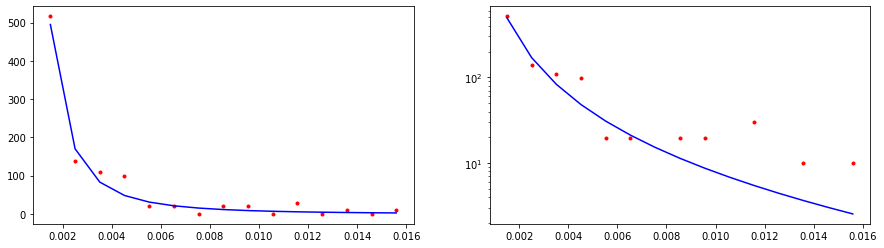

CPU times: user 1.17 ms, sys: 24 µs, total: 1.19 ms
Wall time: 1.02 ms
3898.649799070656


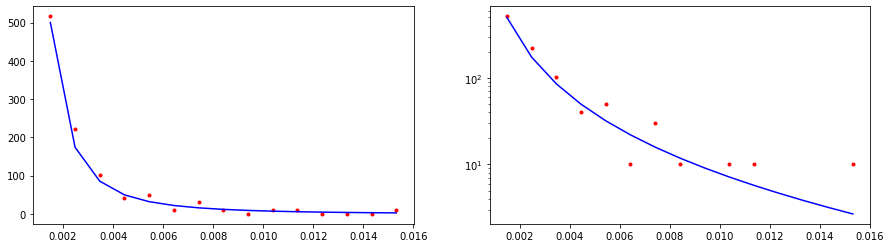

CPU times: user 1.22 ms, sys: 32 µs, total: 1.25 ms
Wall time: 1.04 ms
48996.366623833084


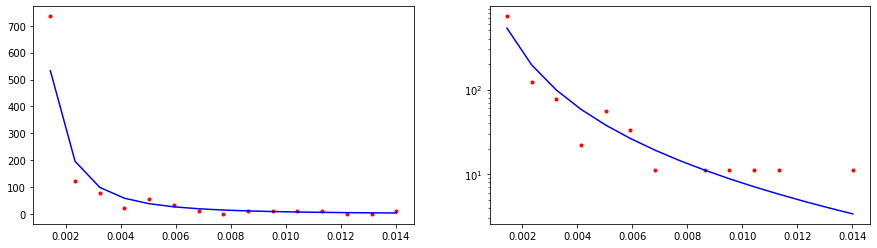

CPU times: user 649 µs, sys: 0 ns, total: 649 µs
Wall time: 420 µs
7399.188668481473


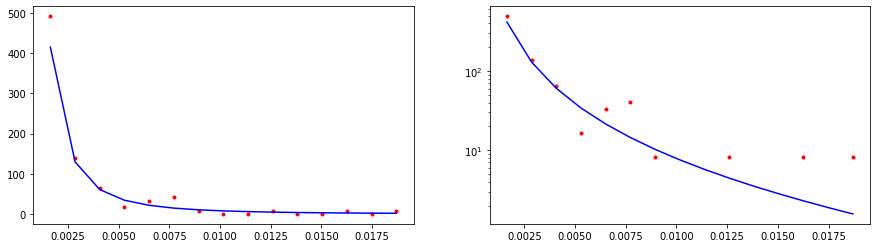

CPU times: user 218 µs, sys: 31 µs, total: 249 µs
Wall time: 215 µs
7643145.948312113


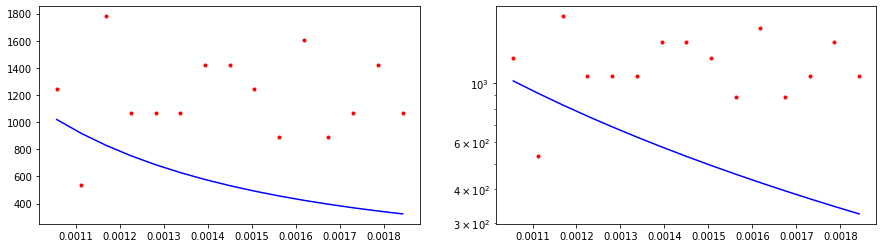

CPU times: user 0 ns, sys: 246 µs, total: 246 µs
Wall time: 209 µs
661562.4785856408


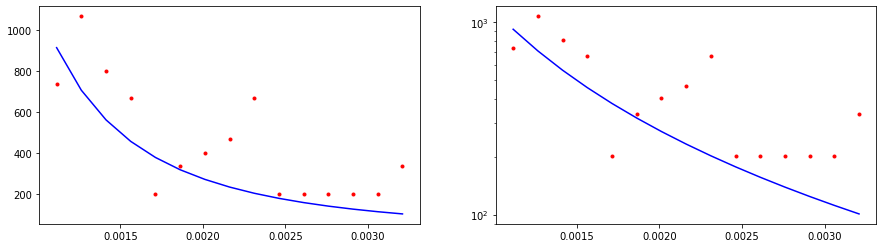

CPU times: user 272 µs, sys: 39 µs, total: 311 µs
Wall time: 233 µs
64038.30167062959


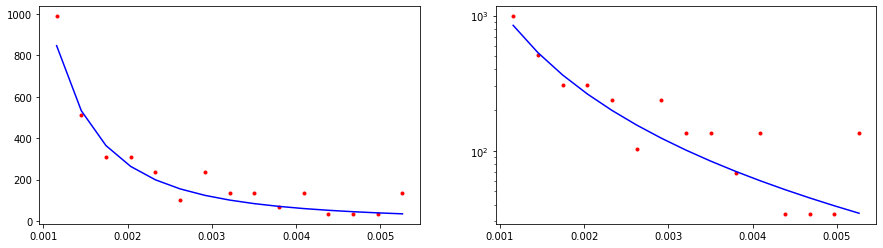

CPU times: user 318 µs, sys: 45 µs, total: 363 µs
Wall time: 264 µs
15832.78116703503


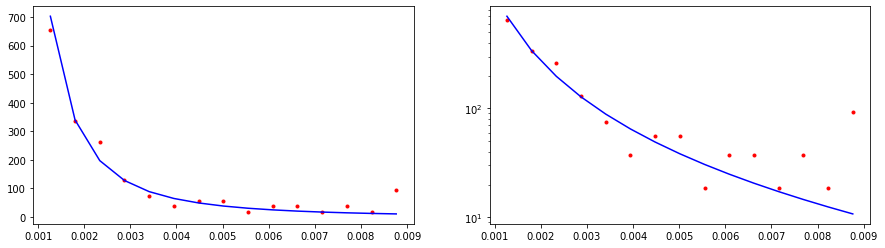

CPU times: user 447 µs, sys: 63 µs, total: 510 µs
Wall time: 327 µs
4473.905910533502


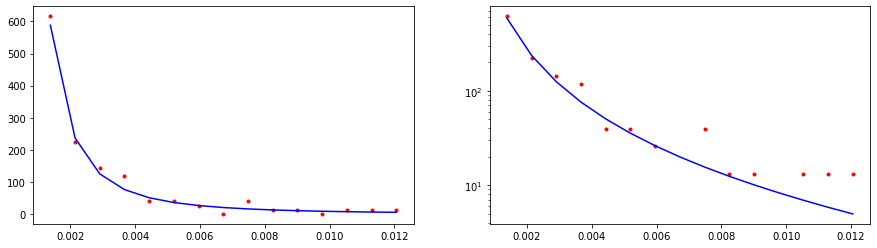

CPU times: user 405 µs, sys: 58 µs, total: 463 µs
Wall time: 349 µs
4663.733074319404


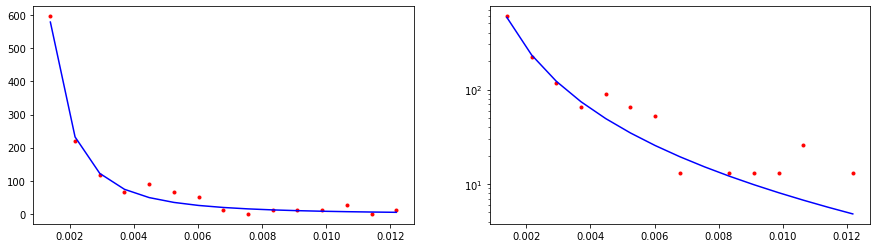

CPU times: user 459 µs, sys: 65 µs, total: 524 µs
Wall time: 354 µs
4151.203265480033


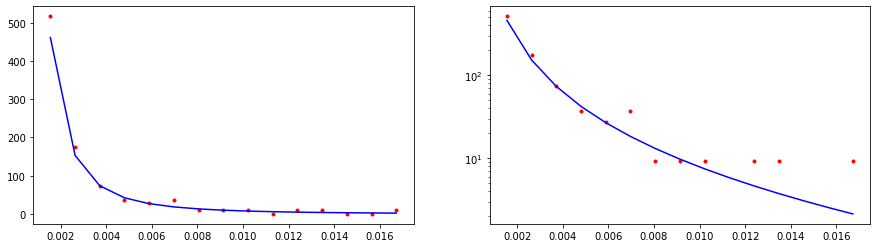

CPU times: user 500 µs, sys: 71 µs, total: 571 µs
Wall time: 398 µs
15233.077314840606


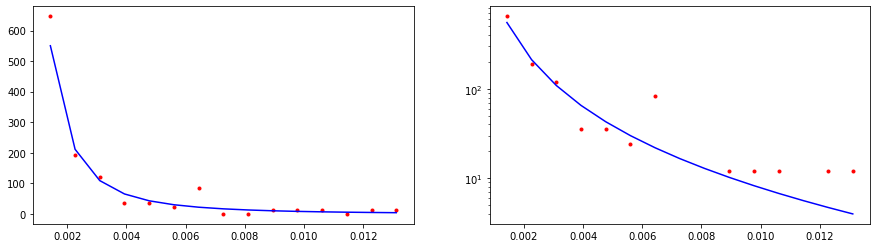

CPU times: user 0 ns, sys: 590 µs, total: 590 µs
Wall time: 418 µs
19751.40921292353


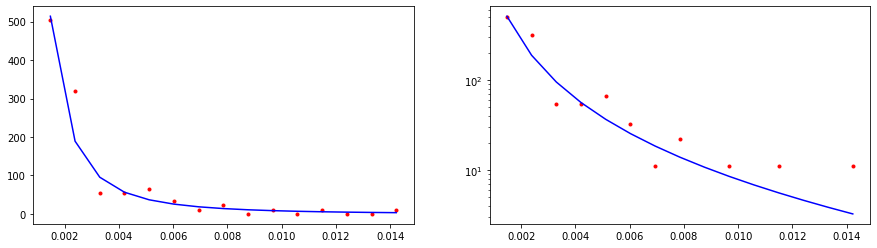

CPU times: user 609 µs, sys: 86 µs, total: 695 µs
Wall time: 504 µs
12420.591034200459


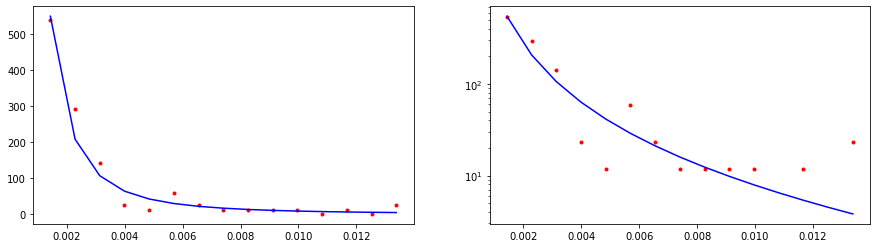

CPU times: user 566 µs, sys: 80 µs, total: 646 µs
Wall time: 461 µs
11591.76607745451


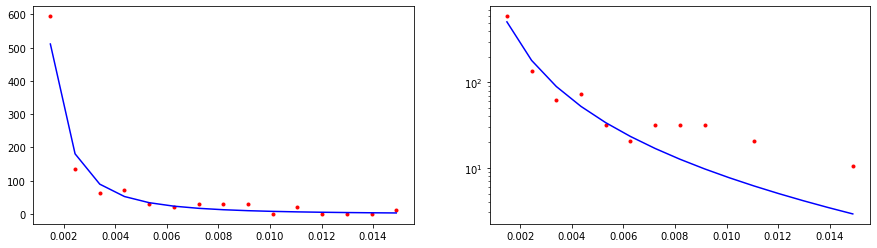

CPU times: user 678 µs, sys: 0 ns, total: 678 µs
Wall time: 500 µs
7960.349817188681


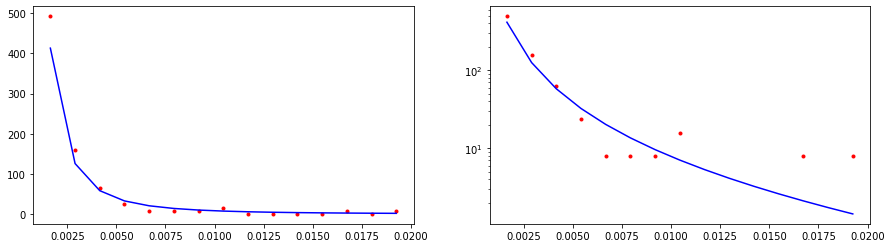

CPU times: user 751 µs, sys: 0 ns, total: 751 µs
Wall time: 610 µs
6432.542554673298


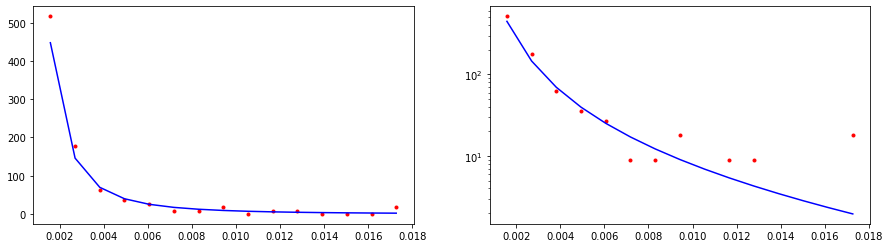

CPU times: user 0 ns, sys: 740 µs, total: 740 µs
Wall time: 619 µs
12933.681047199656


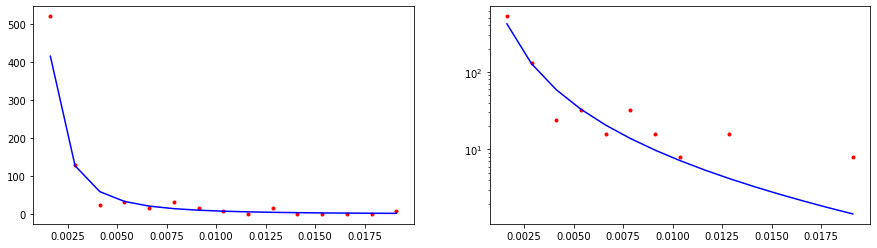

CPU times: user 806 µs, sys: 0 ns, total: 806 µs
Wall time: 603 µs
6436.277458936408


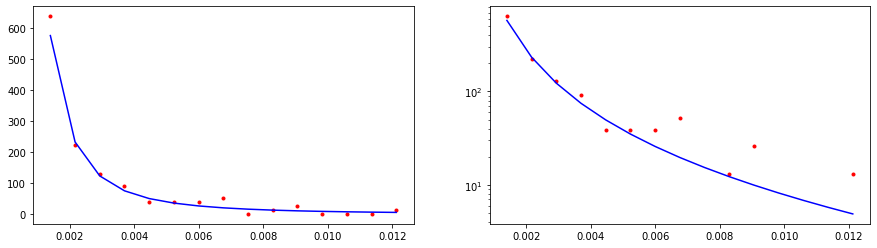

CPU times: user 0 ns, sys: 799 µs, total: 799 µs
Wall time: 619 µs
23624.191709925424


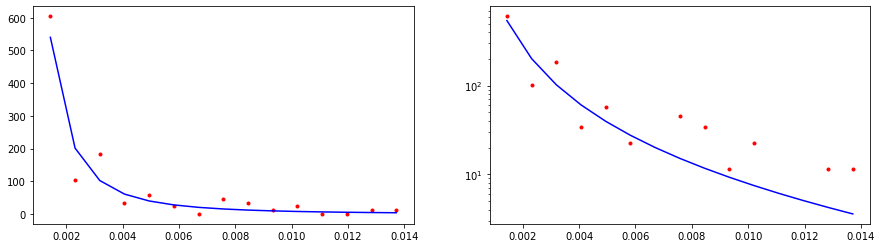

CPU times: user 827 µs, sys: 0 ns, total: 827 µs
Wall time: 656 µs
6131.543933611952


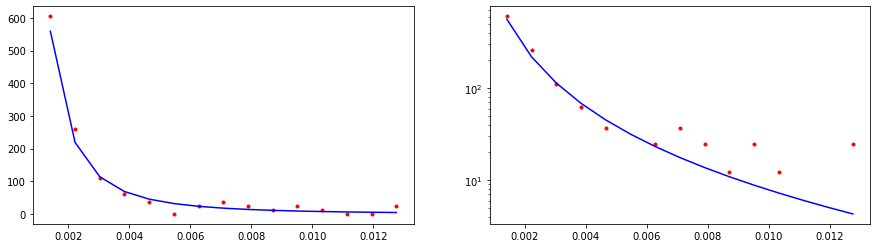

CPU times: user 880 µs, sys: 0 ns, total: 880 µs
Wall time: 695 µs
8653.223733970774


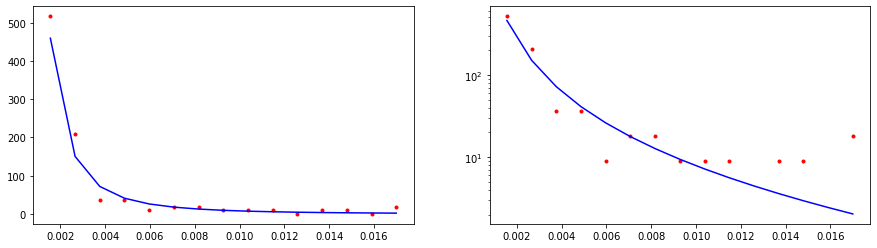

CPU times: user 905 µs, sys: 8 µs, total: 913 µs
Wall time: 728 µs
7912.041950156964


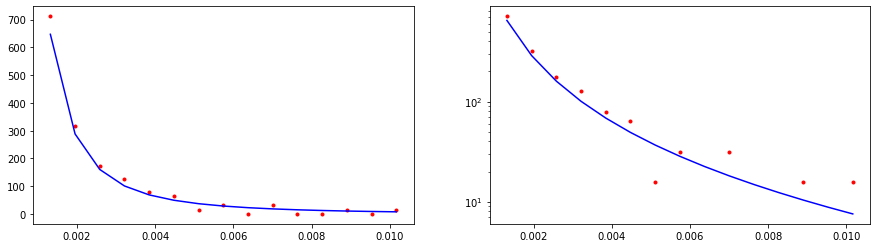

CPU times: user 917 µs, sys: 0 ns, total: 917 µs
Wall time: 744 µs
8456.52364625152


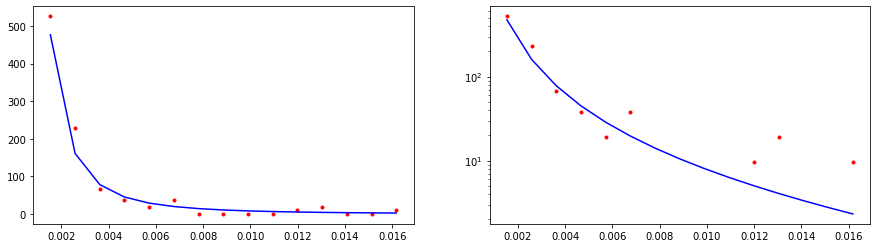

CPU times: user 987 µs, sys: 0 ns, total: 987 µs
Wall time: 803 µs
13214.579791858567


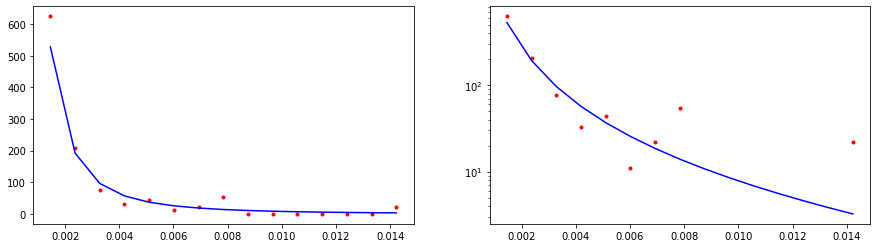

CPU times: user 969 µs, sys: 18 µs, total: 987 µs
Wall time: 811 µs
23127.754650574338


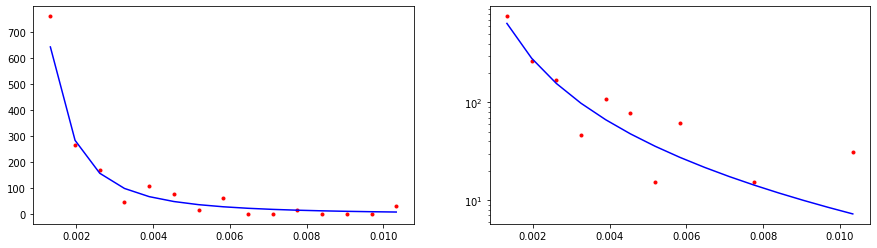

CPU times: user 1.05 ms, sys: 7 µs, total: 1.06 ms
Wall time: 886 µs
25734.093503466203


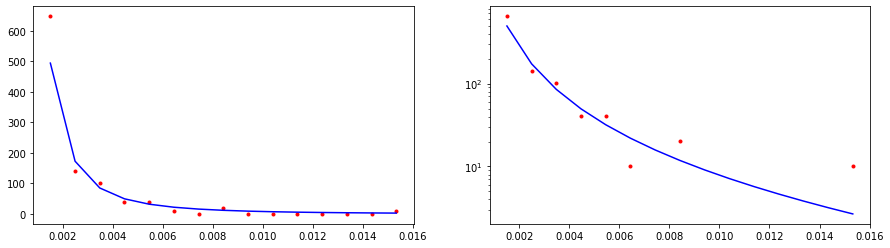

CPU times: user 1.05 ms, sys: 8 µs, total: 1.06 ms
Wall time: 875 µs
23290.253661678584


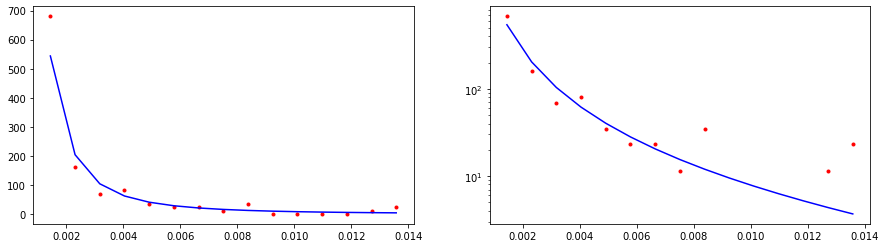

CPU times: user 232 µs, sys: 891 µs, total: 1.12 ms
Wall time: 944 µs
6345.241073066586


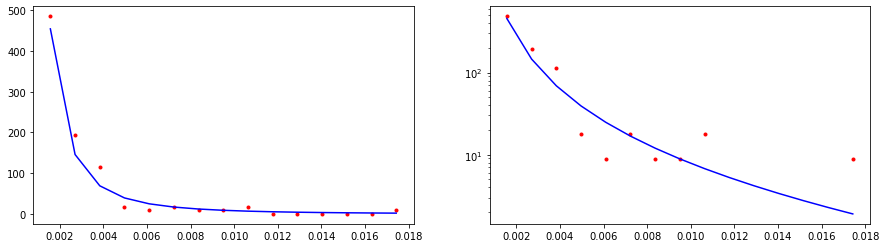

CPU times: user 1.22 ms, sys: 31 µs, total: 1.25 ms
Wall time: 1.02 ms
2827.3585992385506


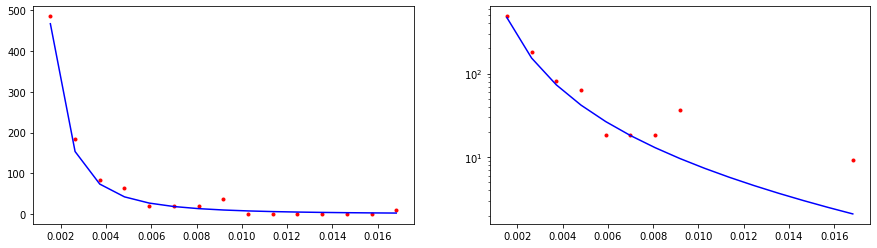

CPU times: user 1.21 ms, sys: 31 µs, total: 1.24 ms
Wall time: 1.06 ms
7428.127497826355


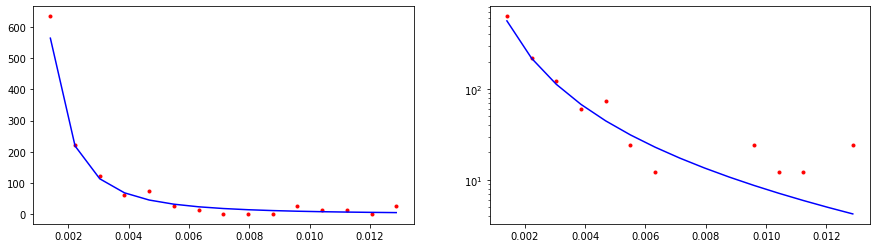

CPU times: user 1.2 ms, sys: 0 ns, total: 1.2 ms
Wall time: 1.02 ms
11206.0480715435


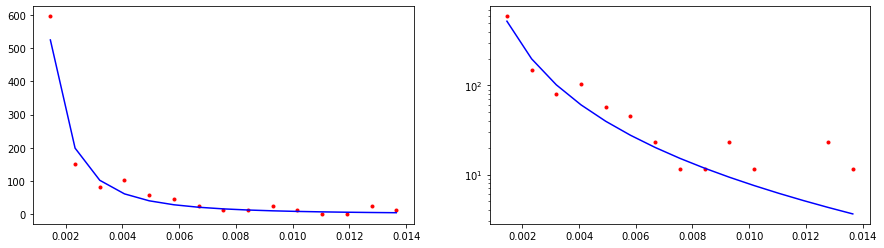

CPU times: user 1.22 ms, sys: 0 ns, total: 1.22 ms
Wall time: 1.03 ms
7188.6238521171545


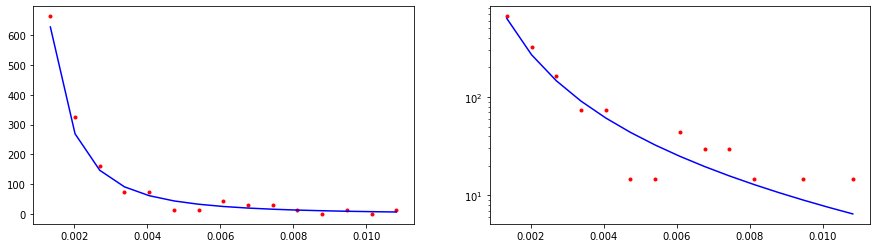

CPU times: user 1.25 ms, sys: 0 ns, total: 1.25 ms
Wall time: 1.04 ms
9500.733364432377


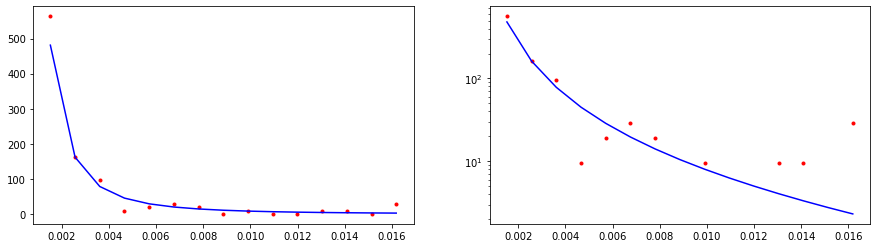

CPU times: user 0 ns, sys: 743 µs, total: 743 µs
Wall time: 463 µs
7490.896252749108


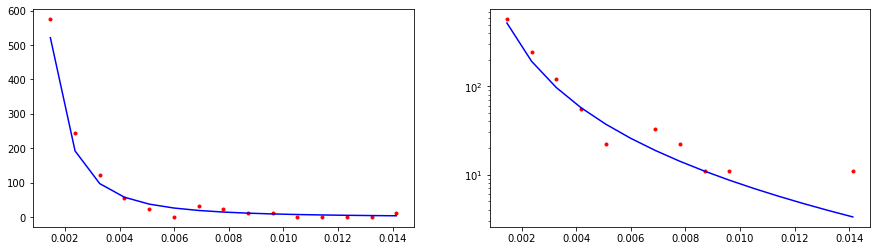

CPU times: user 180 µs, sys: 25 µs, total: 205 µs
Wall time: 177 µs
7523076.247342204


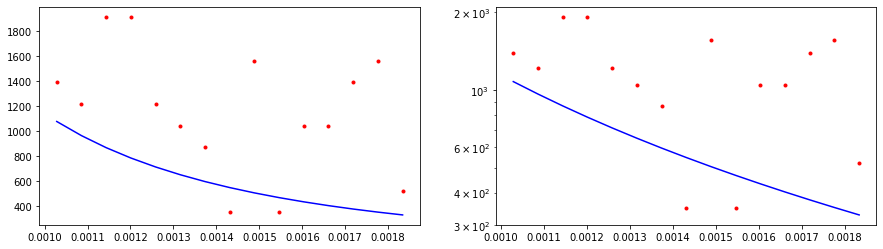

CPU times: user 222 µs, sys: 32 µs, total: 254 µs
Wall time: 217 µs
593961.9522592182


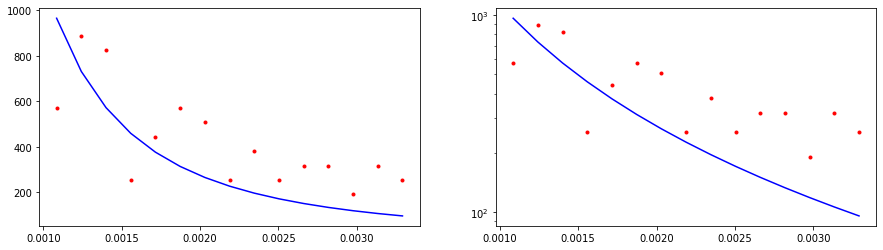

CPU times: user 364 µs, sys: 0 ns, total: 364 µs
Wall time: 336 µs
59573.036378468925


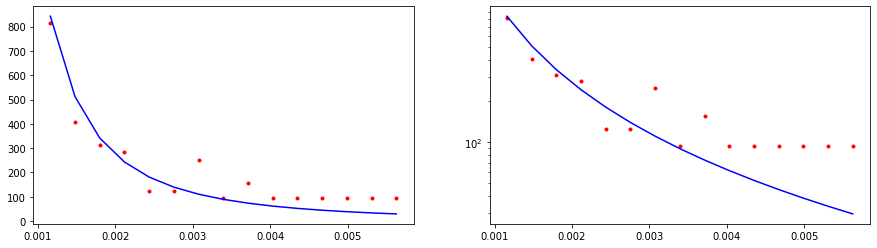

CPU times: user 357 µs, sys: 51 µs, total: 408 µs
Wall time: 253 µs
78307.41182768143


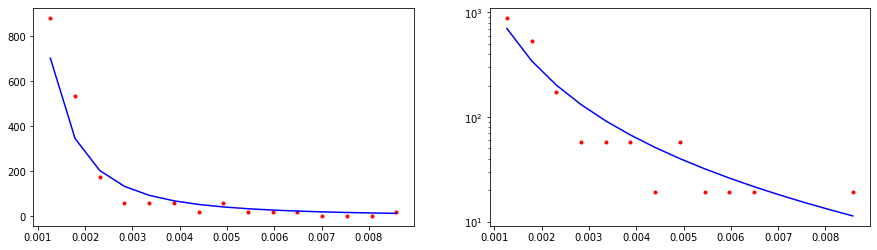

CPU times: user 450 µs, sys: 65 µs, total: 515 µs
Wall time: 335 µs
22377.41687221798


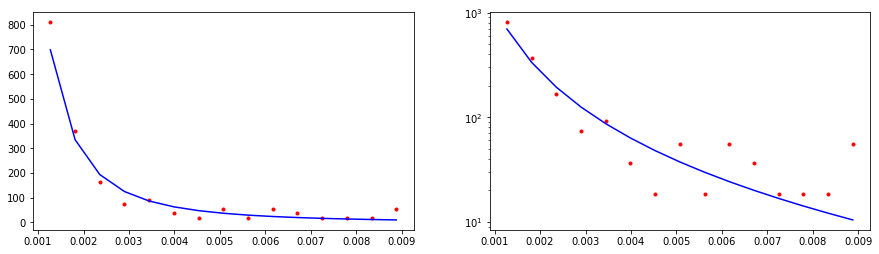

CPU times: user 565 µs, sys: 0 ns, total: 565 µs
Wall time: 385 µs
6406.7542533862315


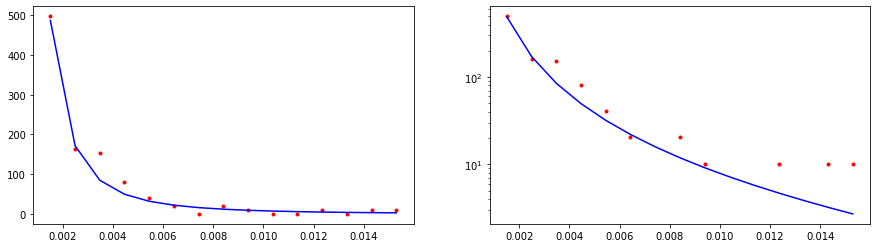

CPU times: user 487 µs, sys: 70 µs, total: 557 µs
Wall time: 379 µs
3532.695282782417


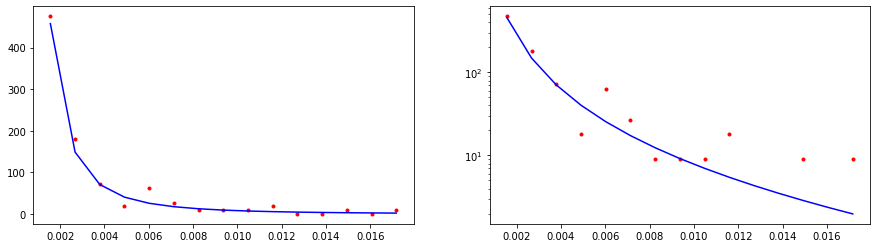

CPU times: user 0 ns, sys: 492 µs, total: 492 µs
Wall time: 385 µs
9678.681102442679


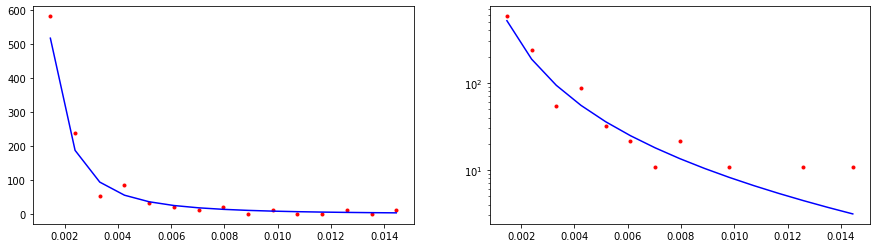

CPU times: user 564 µs, sys: 0 ns, total: 564 µs
Wall time: 384 µs
17557.138781141297


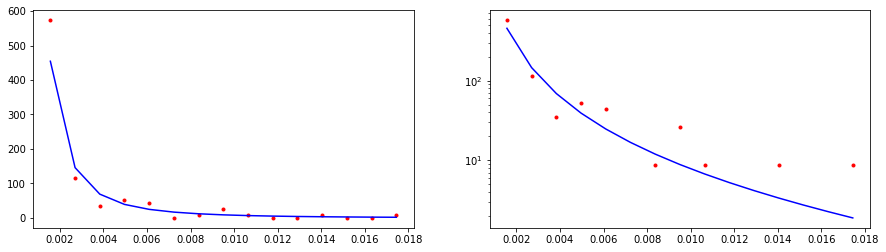

CPU times: user 661 µs, sys: 0 ns, total: 661 µs
Wall time: 530 µs
11240.66101477956


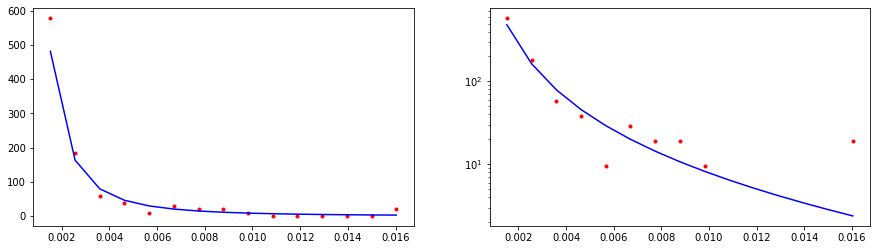

CPU times: user 707 µs, sys: 0 ns, total: 707 µs
Wall time: 512 µs
7406.152740547941


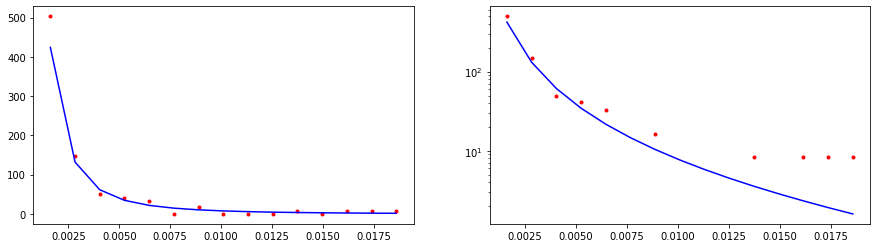

CPU times: user 695 µs, sys: 100 µs, total: 795 µs
Wall time: 573 µs
6784.393259756217


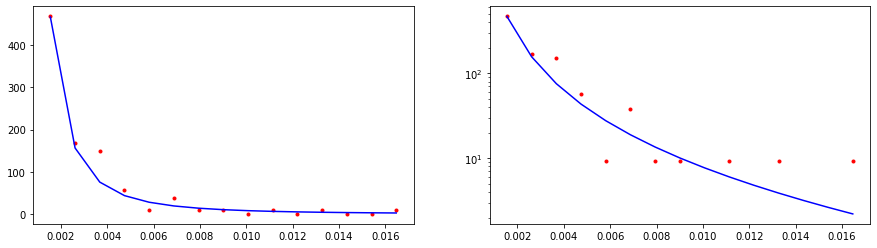

CPU times: user 742 µs, sys: 0 ns, total: 742 µs
Wall time: 556 µs
6374.307709691843


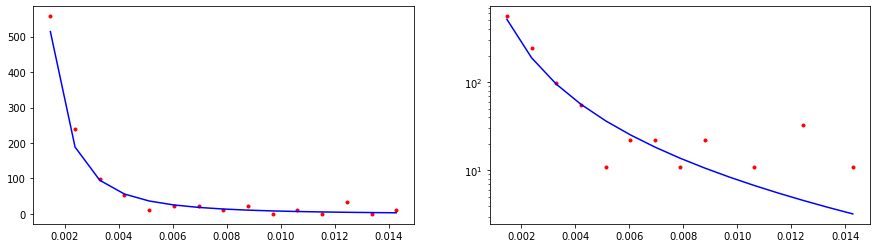

CPU times: user 0 ns, sys: 784 µs, total: 784 µs
Wall time: 611 µs
4759.1273880980725


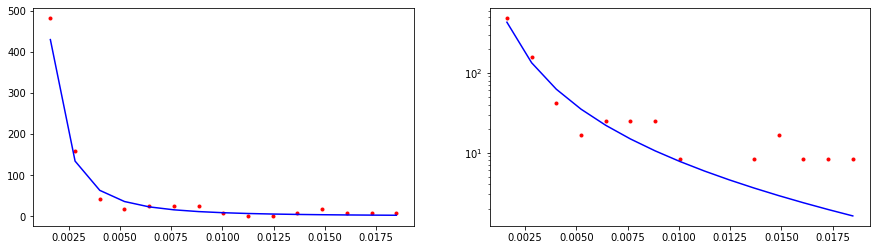

CPU times: user 762 µs, sys: 0 ns, total: 762 µs
Wall time: 588 µs
18075.682852596878


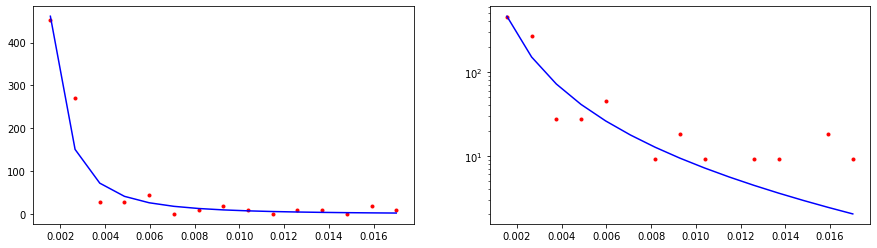

CPU times: user 794 µs, sys: 0 ns, total: 794 µs
Wall time: 618 µs
6236.352628883088


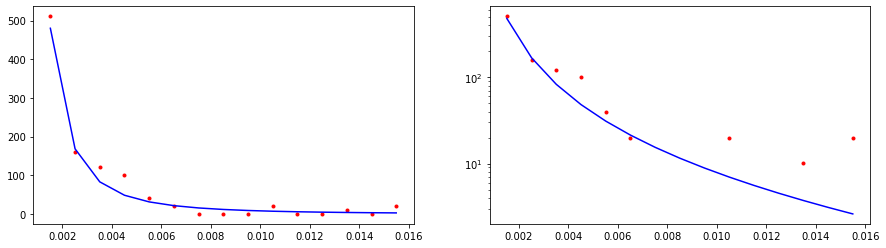

CPU times: user 906 µs, sys: 0 ns, total: 906 µs
Wall time: 729 µs
5642.496700085264


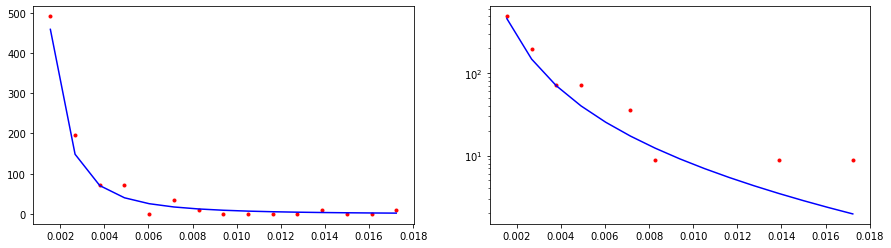

CPU times: user 888 µs, sys: 0 ns, total: 888 µs
Wall time: 753 µs
8012.169030917552


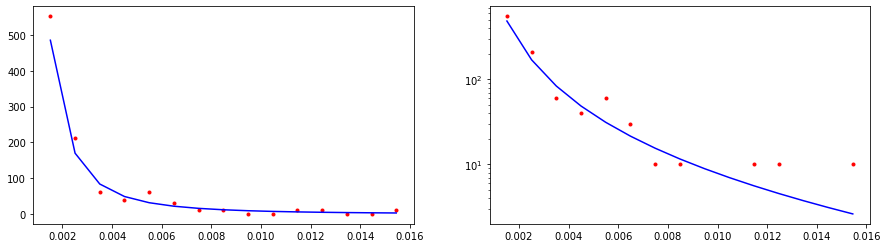

CPU times: user 904 µs, sys: 0 ns, total: 904 µs
Wall time: 722 µs
7029.722136343354


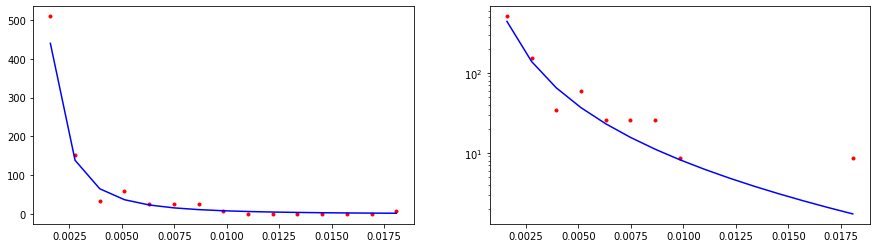

CPU times: user 939 µs, sys: 0 ns, total: 939 µs
Wall time: 765 µs
8324.201222180724


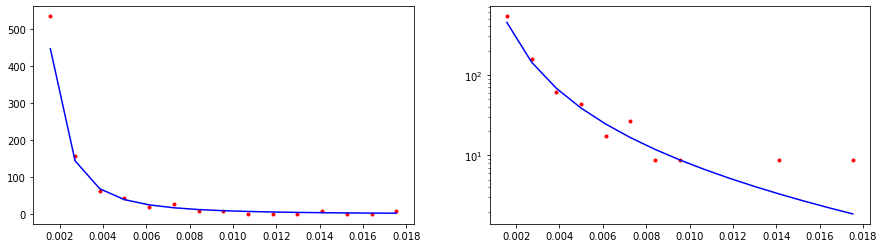

CPU times: user 1.02 ms, sys: 3 µs, total: 1.02 ms
Wall time: 837 µs
4736.0493538589235


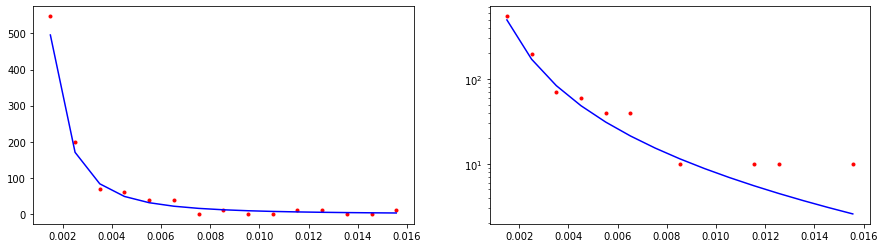

CPU times: user 1.04 ms, sys: 6 µs, total: 1.05 ms
Wall time: 867 µs
5524.7709983816885


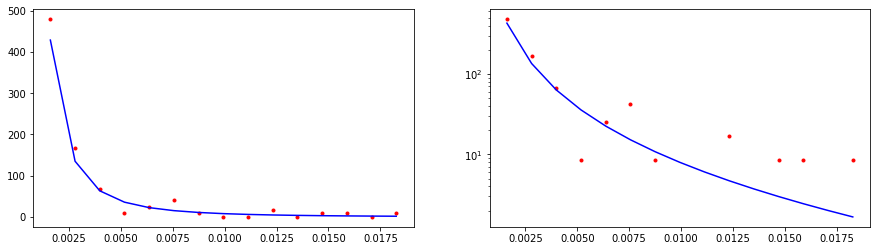

CPU times: user 1.13 ms, sys: 19 µs, total: 1.15 ms
Wall time: 967 µs
26507.30815700983


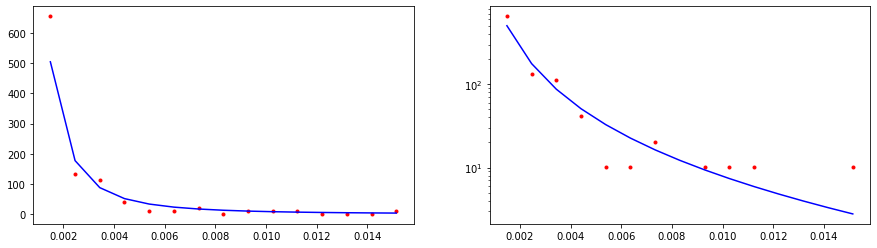

CPU times: user 1.04 ms, sys: 6 µs, total: 1.04 ms
Wall time: 865 µs
24632.68788247574


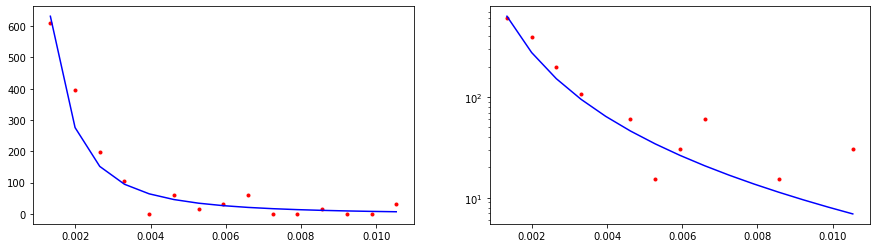

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 878 µs
11328.365415242068


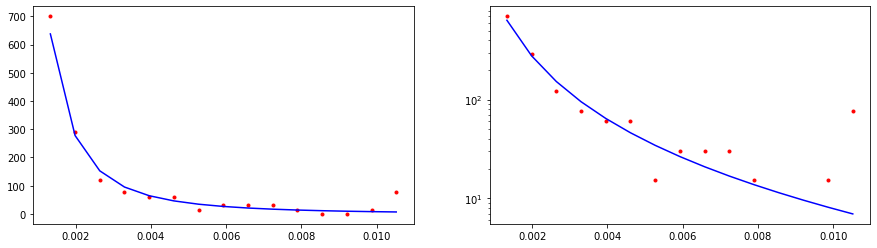

CPU times: user 1.1 ms, sys: 15 µs, total: 1.11 ms
Wall time: 995 µs
17223.09120587287


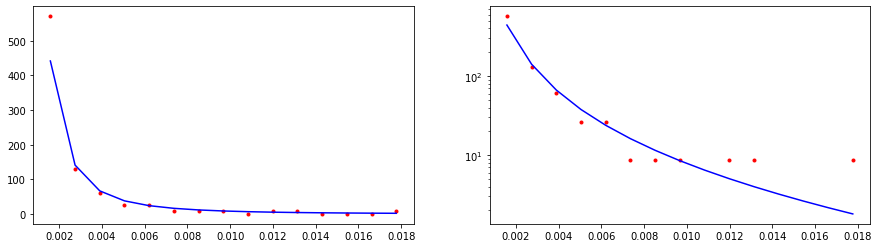

CPU times: user 1.14 ms, sys: 21 µs, total: 1.16 ms
Wall time: 971 µs
11653.548001604206


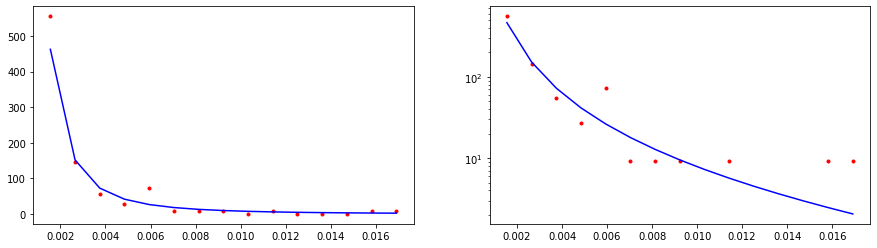

CPU times: user 248 µs, sys: 847 µs, total: 1.1 ms
Wall time: 943 µs
10685.683209641025


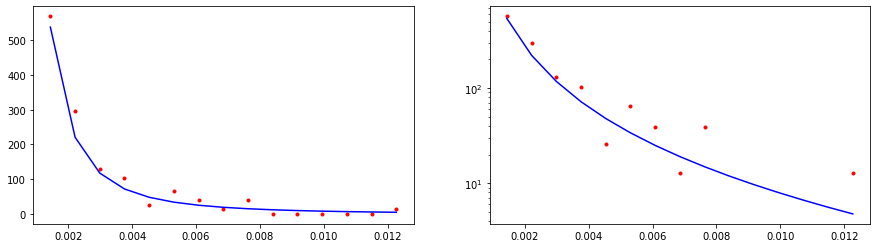

CPU times: user 1.11 ms, sys: 16 µs, total: 1.13 ms
Wall time: 1.02 ms
28123.124197275072


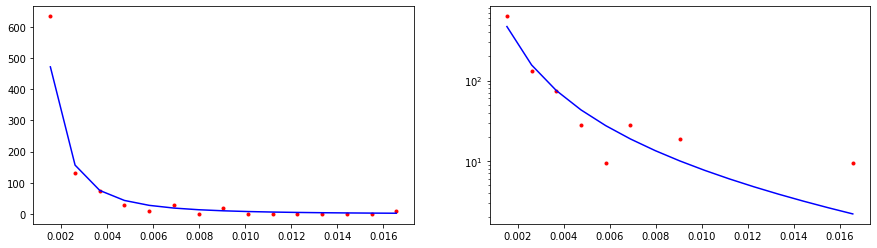

CPU times: user 1.2 ms, sys: 29 µs, total: 1.23 ms
Wall time: 1.06 ms
10301.53598395174


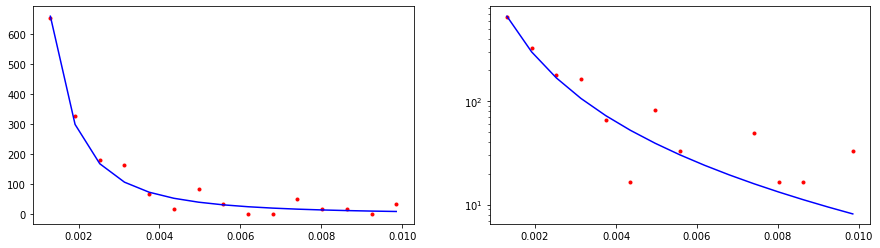

CPU times: user 680 µs, sys: 0 ns, total: 680 µs
Wall time: 428 µs
5791.423959073275


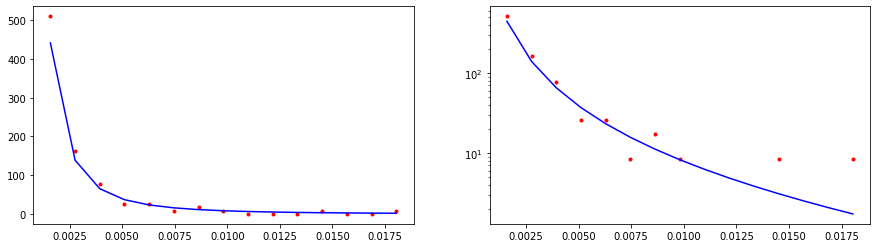

CPU times: user 190 µs, sys: 27 µs, total: 217 µs
Wall time: 179 µs
9726342.854505222


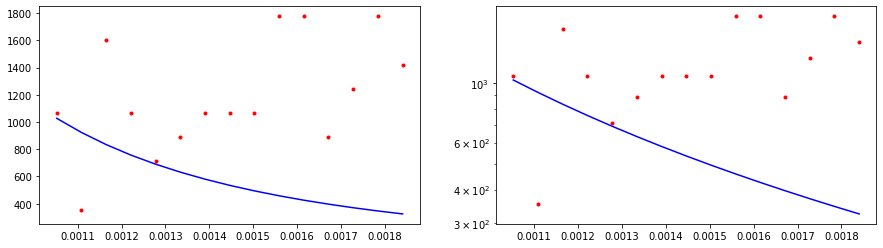

CPU times: user 179 µs, sys: 26 µs, total: 205 µs
Wall time: 181 µs
689283.8398970262


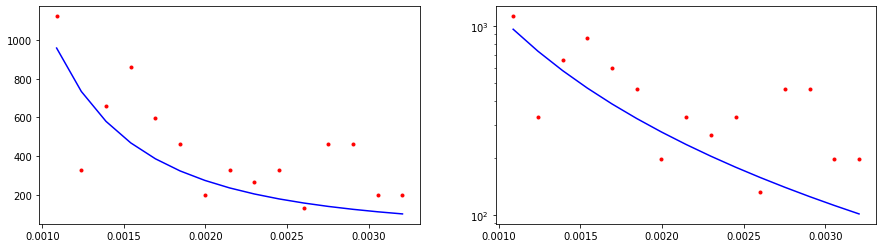

CPU times: user 319 µs, sys: 46 µs, total: 365 µs
Wall time: 271 µs
91749.48827590379


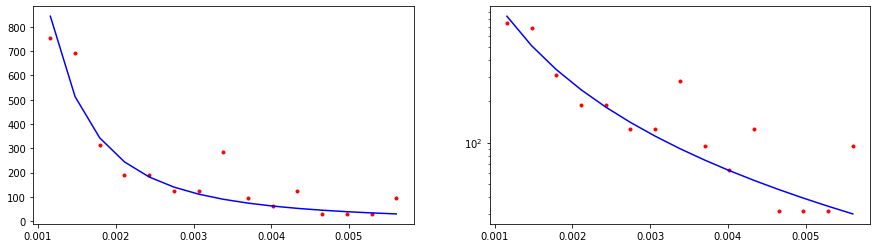

CPU times: user 424 µs, sys: 61 µs, total: 485 µs
Wall time: 331 µs
38213.14265860058


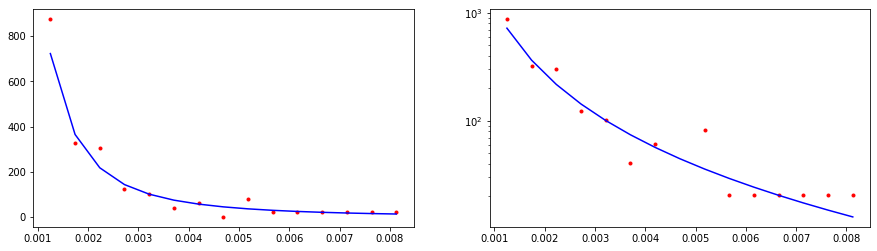

CPU times: user 464 µs, sys: 0 ns, total: 464 µs
Wall time: 297 µs
17323.8181940783


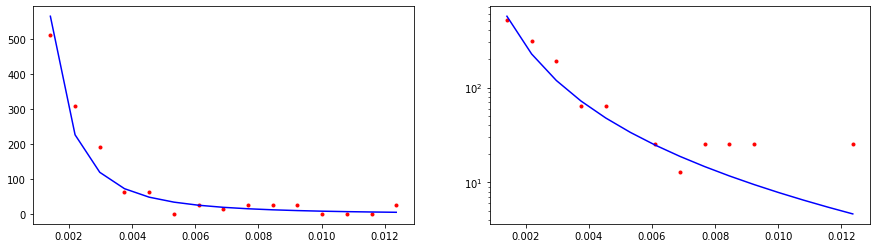

CPU times: user 550 µs, sys: 0 ns, total: 550 µs
Wall time: 398 µs
8188.190792323343


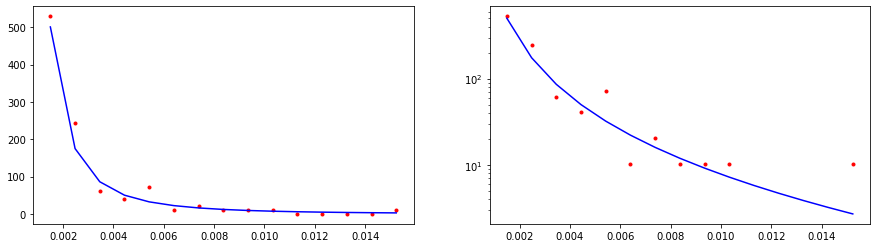

CPU times: user 483 µs, sys: 69 µs, total: 552 µs
Wall time: 380 µs
11521.783821139421


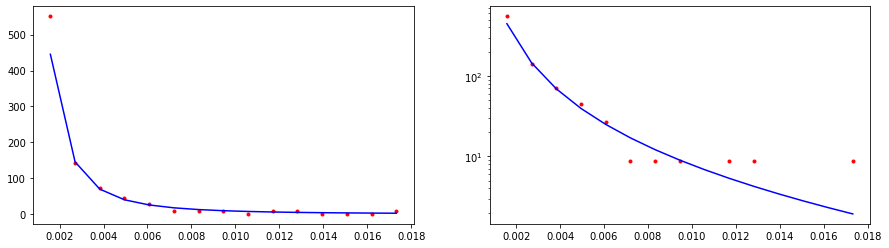

CPU times: user 609 µs, sys: 0 ns, total: 609 µs
Wall time: 431 µs
29085.989562743835


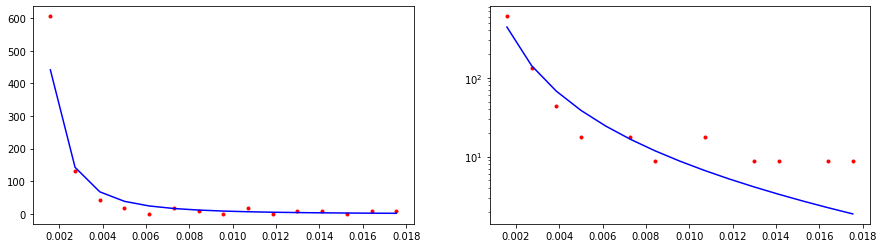

CPU times: user 0 ns, sys: 556 µs, total: 556 µs
Wall time: 394 µs
6729.66064574951


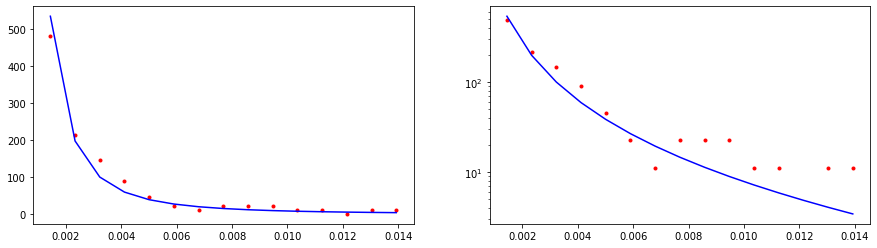

CPU times: user 676 µs, sys: 0 ns, total: 676 µs
Wall time: 503 µs
17831.115882165064


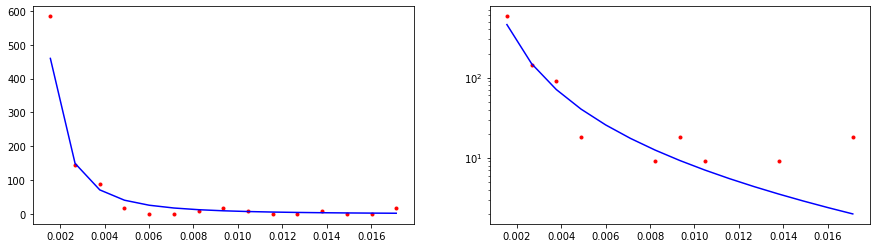

CPU times: user 678 µs, sys: 0 ns, total: 678 µs
Wall time: 503 µs
18411.20259517299


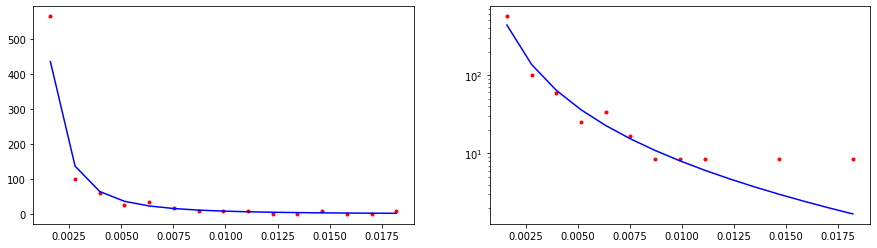

CPU times: user 629 µs, sys: 90 µs, total: 719 µs
Wall time: 547 µs
20608.715719631695


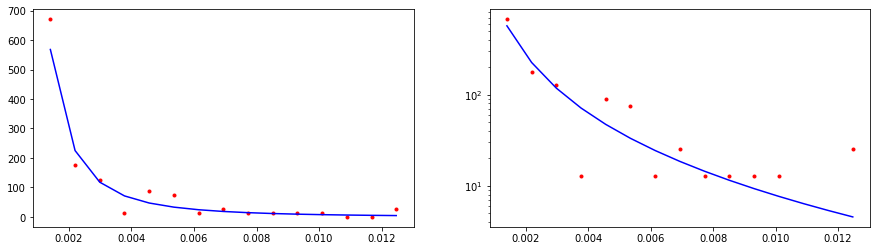

CPU times: user 764 µs, sys: 0 ns, total: 764 µs
Wall time: 600 µs
2683.46983686954


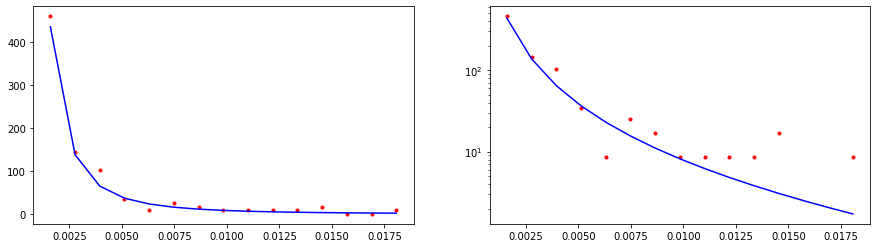

CPU times: user 752 µs, sys: 0 ns, total: 752 µs
Wall time: 579 µs
35464.86880487298


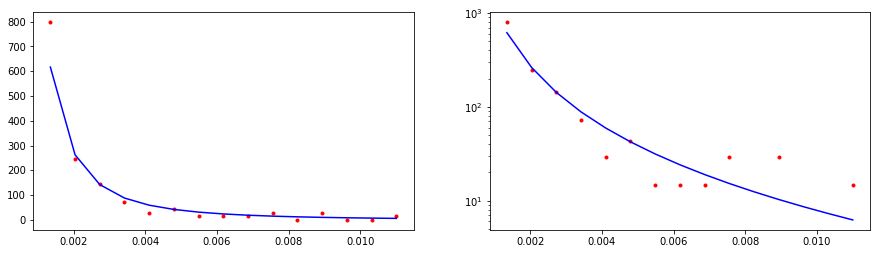

CPU times: user 832 µs, sys: 0 ns, total: 832 µs
Wall time: 659 µs
7196.7183116189435


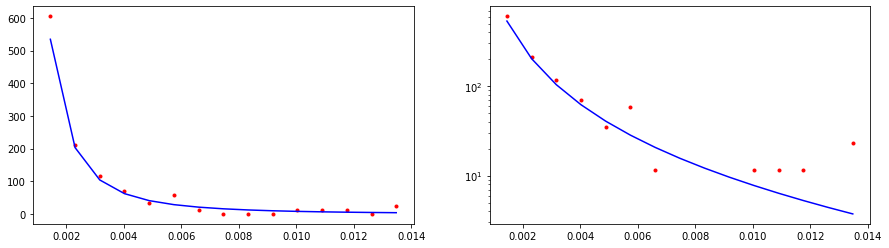

CPU times: user 637 µs, sys: 91 µs, total: 728 µs
Wall time: 612 µs
5133.622691624124


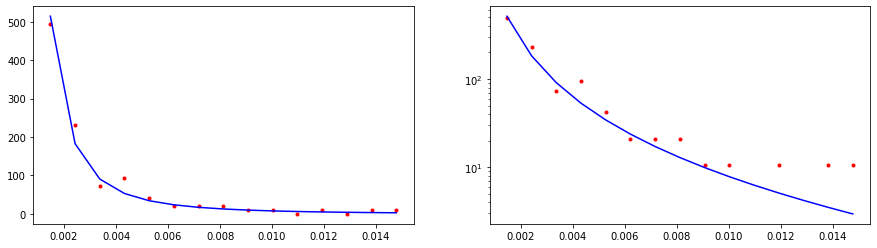

CPU times: user 840 µs, sys: 0 ns, total: 840 µs
Wall time: 663 µs
14126.674981760203


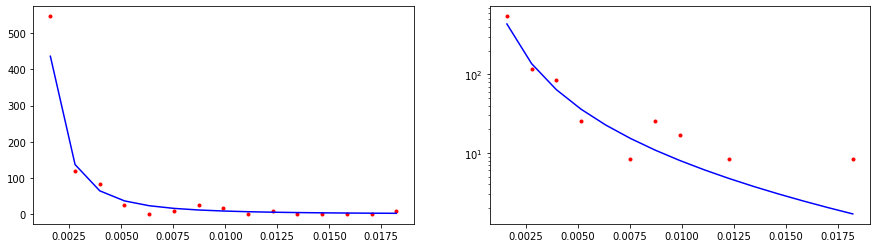

CPU times: user 869 µs, sys: 0 ns, total: 869 µs
Wall time: 701 µs
3979.0937445748445


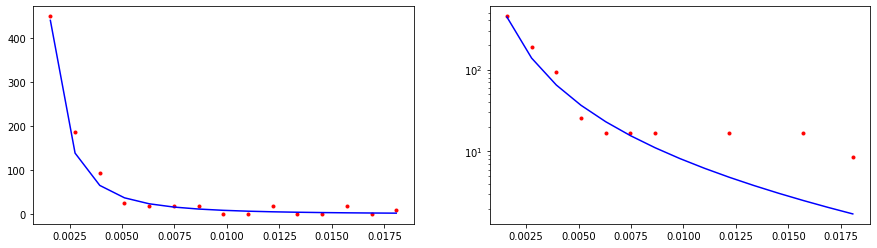

CPU times: user 839 µs, sys: 0 ns, total: 839 µs
Wall time: 721 µs
11384.460758721141


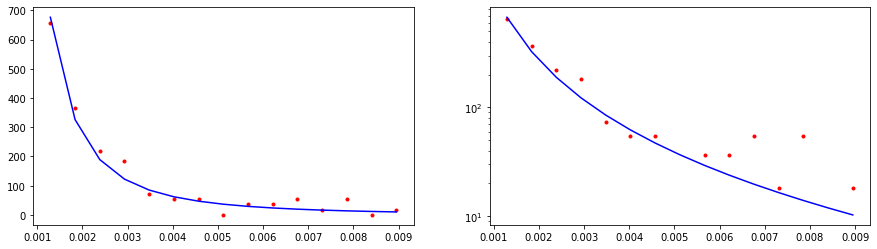

CPU times: user 980 µs, sys: 0 ns, total: 980 µs
Wall time: 805 µs
15769.674342677878


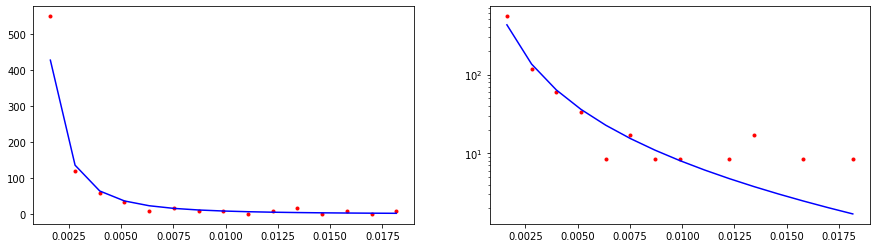

CPU times: user 944 µs, sys: 0 ns, total: 944 µs
Wall time: 776 µs
15636.879714720628


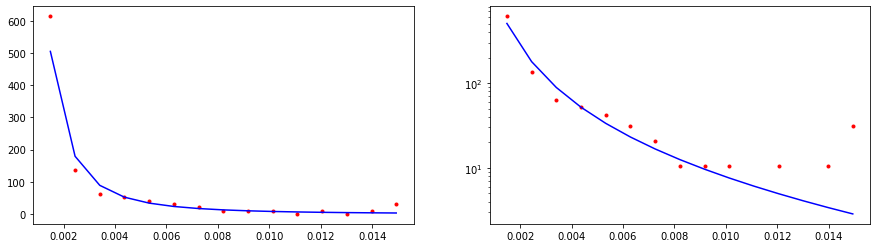

CPU times: user 1.03 ms, sys: 4 µs, total: 1.03 ms
Wall time: 861 µs
56741.778019907804


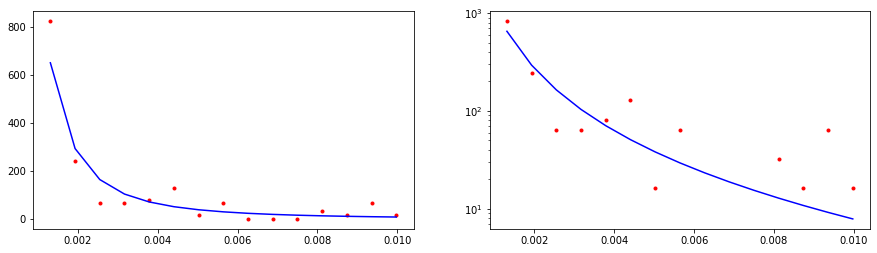

CPU times: user 1.04 ms, sys: 5 µs, total: 1.04 ms
Wall time: 880 µs
5911.565526608341


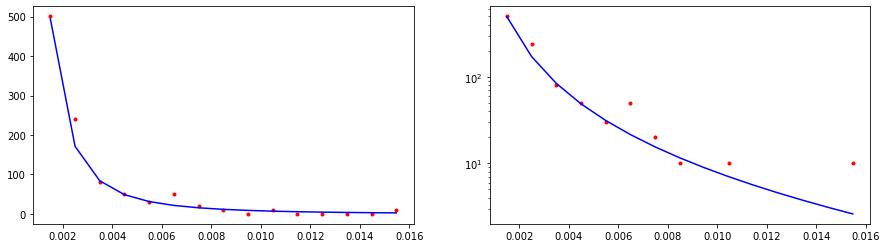

CPU times: user 134 µs, sys: 835 µs, total: 969 µs
Wall time: 852 µs
11279.680514533942


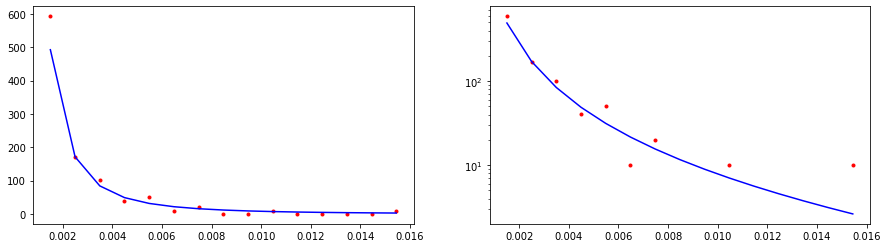

CPU times: user 1.06 ms, sys: 8 µs, total: 1.06 ms
Wall time: 942 µs
32202.148294130304


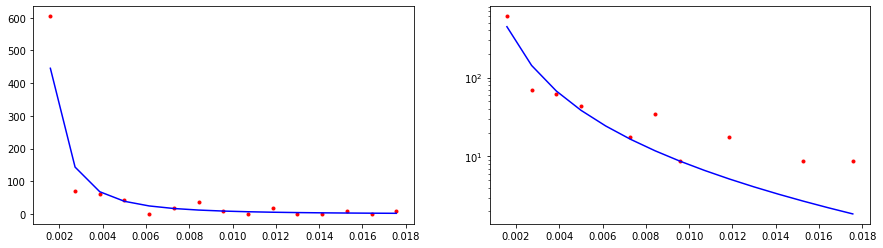

CPU times: user 1.12 ms, sys: 25 µs, total: 1.14 ms
Wall time: 962 µs
13655.963187488438


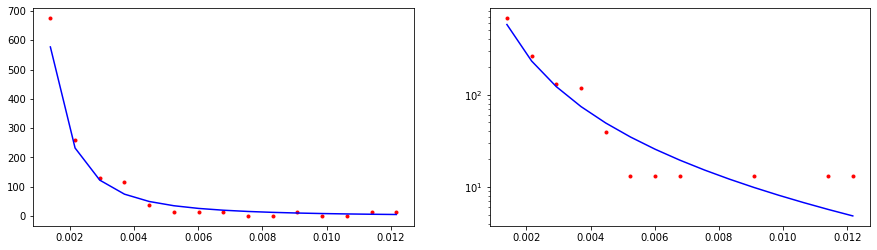

CPU times: user 1.11 ms, sys: 16 µs, total: 1.13 ms
Wall time: 956 µs
21421.916625933365


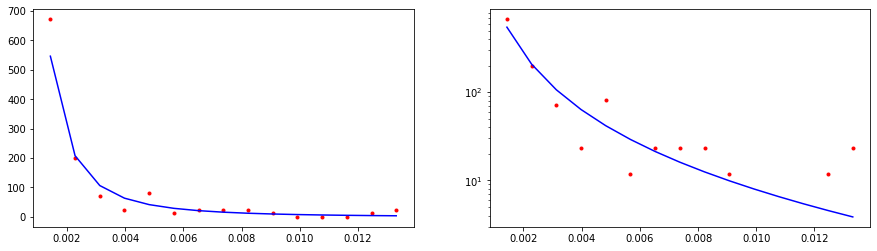

CPU times: user 1.28 ms, sys: 41 µs, total: 1.32 ms
Wall time: 1.14 ms
6266.91939758415


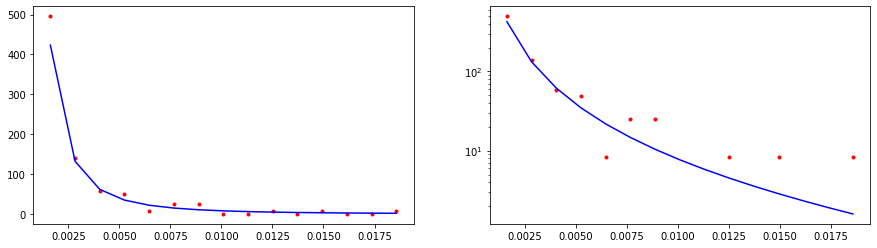

CPU times: user 1.22 ms, sys: 0 ns, total: 1.22 ms
Wall time: 1.03 ms
4462.224420740546


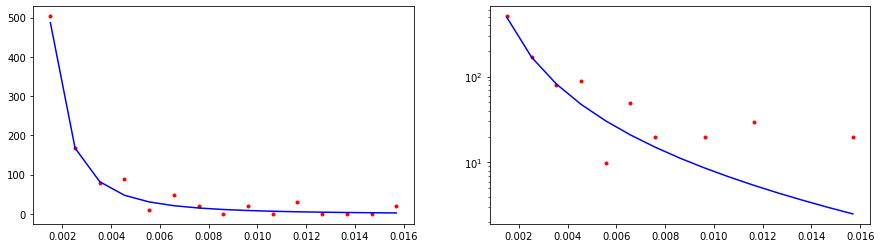

CPU times: user 1.19 ms, sys: 28 µs, total: 1.22 ms
Wall time: 1.04 ms
9156.81743170878


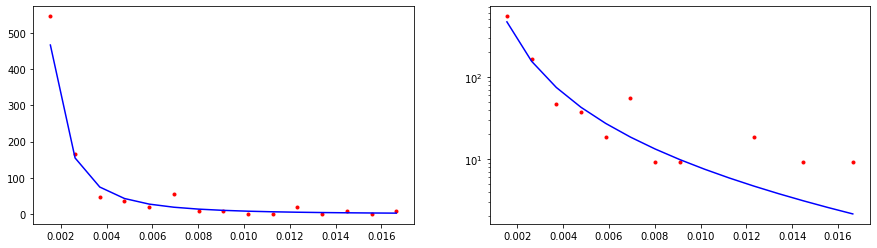

CPU times: user 624 µs, sys: 0 ns, total: 624 µs
Wall time: 449 µs
4781.6344766227


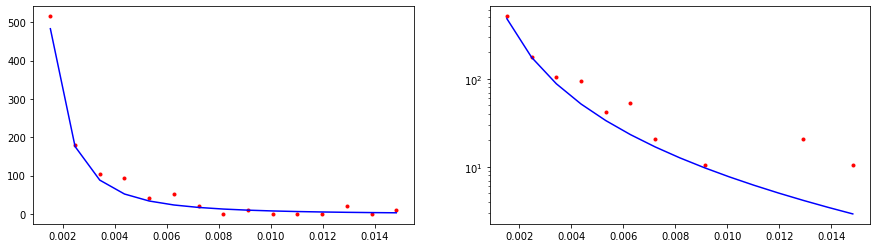

CPU times: user 174 µs, sys: 25 µs, total: 199 µs
Wall time: 166 µs
7451491.726138468


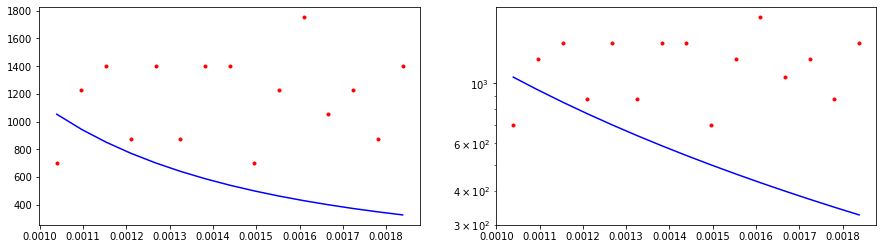

CPU times: user 0 ns, sys: 272 µs, total: 272 µs
Wall time: 232 µs
470868.6165975683


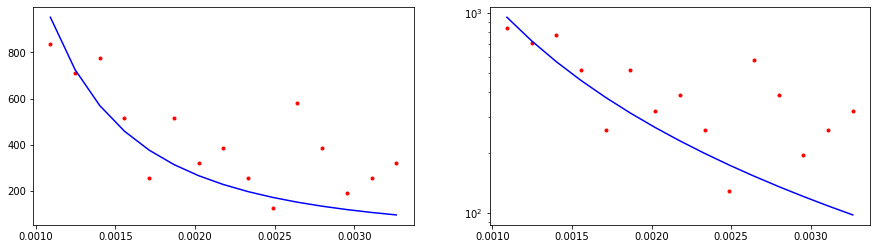

CPU times: user 193 µs, sys: 28 µs, total: 221 µs
Wall time: 197 µs
59908.98869375228


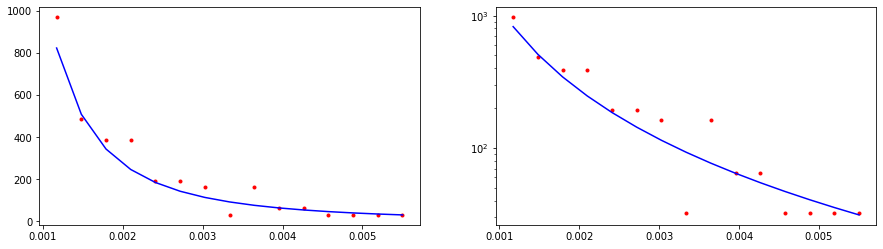

CPU times: user 0 ns, sys: 435 µs, total: 435 µs
Wall time: 333 µs
75881.0917212821


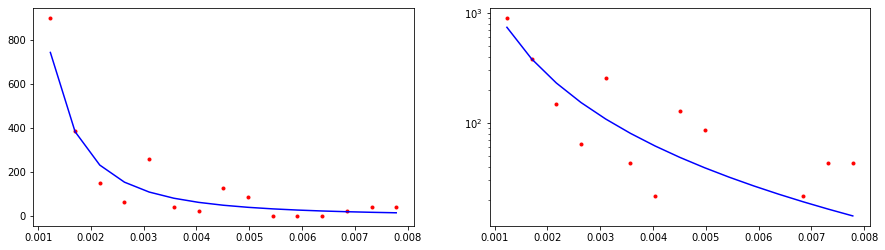

CPU times: user 407 µs, sys: 59 µs, total: 466 µs
Wall time: 300 µs
15481.743075784101


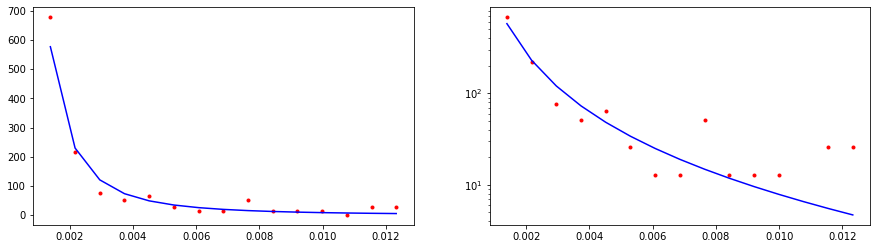

CPU times: user 409 µs, sys: 59 µs, total: 468 µs
Wall time: 350 µs
5944.3424954601405


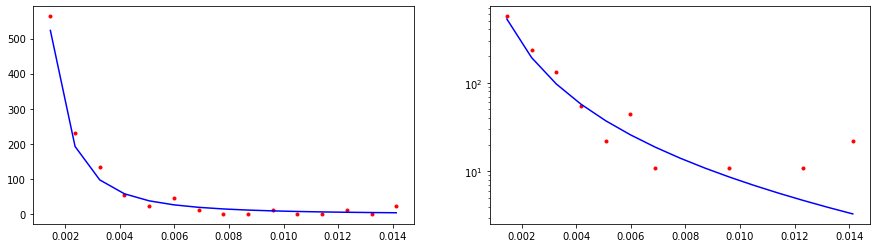

CPU times: user 0 ns, sys: 614 µs, total: 614 µs
Wall time: 411 µs
7594.825740577619


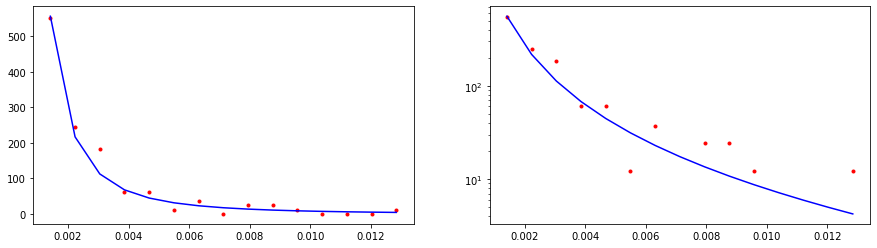

CPU times: user 504 µs, sys: 0 ns, total: 504 µs
Wall time: 401 µs
9350.716853406198


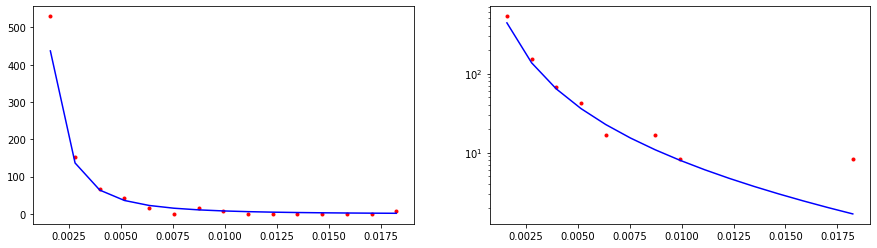

CPU times: user 615 µs, sys: 0 ns, total: 615 µs
Wall time: 430 µs
8746.775731541178


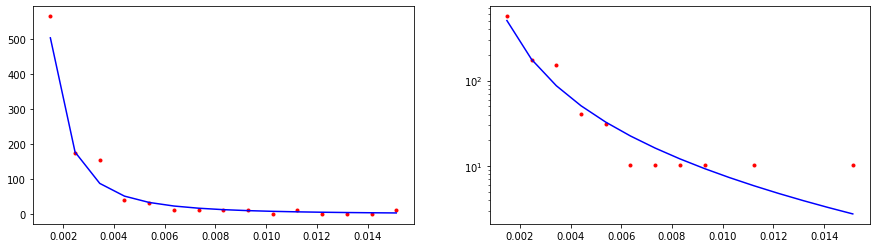

CPU times: user 558 µs, sys: 81 µs, total: 639 µs
Wall time: 464 µs
20305.954376657897


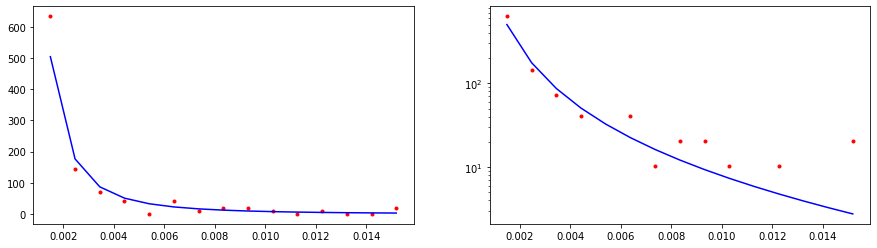

CPU times: user 669 µs, sys: 0 ns, total: 669 µs
Wall time: 494 µs
29502.297379395655


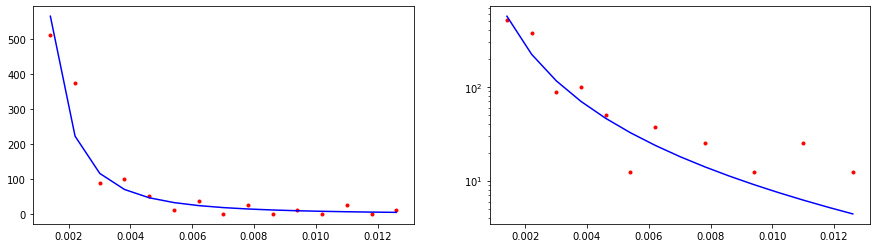

CPU times: user 704 µs, sys: 0 ns, total: 704 µs
Wall time: 537 µs
16294.12206884654


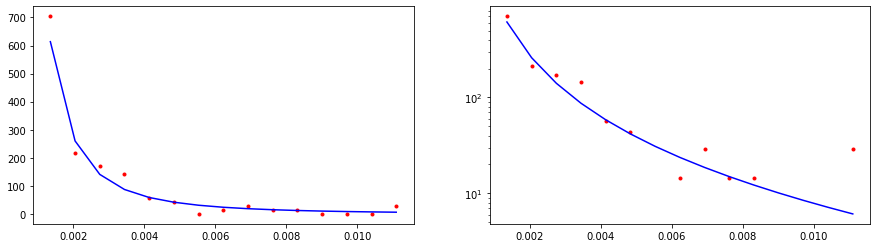

CPU times: user 650 µs, sys: 0 ns, total: 650 µs
Wall time: 549 µs
29597.5426277591


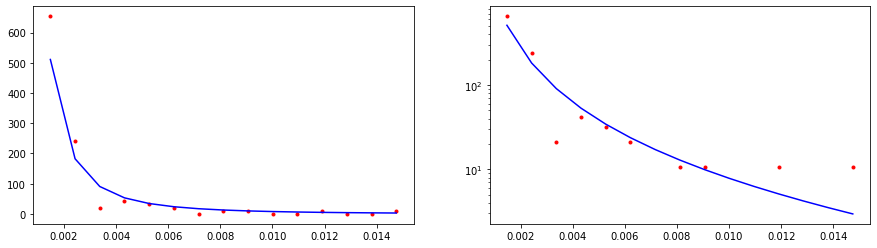

CPU times: user 0 ns, sys: 734 µs, total: 734 µs
Wall time: 561 µs
8987.477302877098


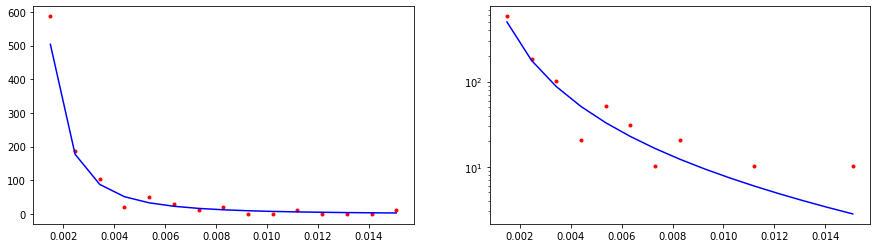

CPU times: user 811 µs, sys: 0 ns, total: 811 µs
Wall time: 618 µs
5845.609128759688


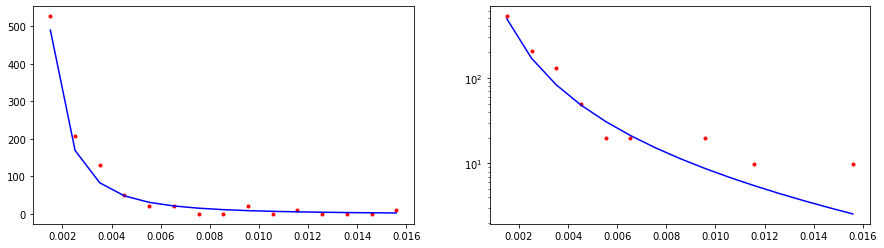

CPU times: user 757 µs, sys: 110 µs, total: 867 µs
Wall time: 731 µs
24392.73306963397


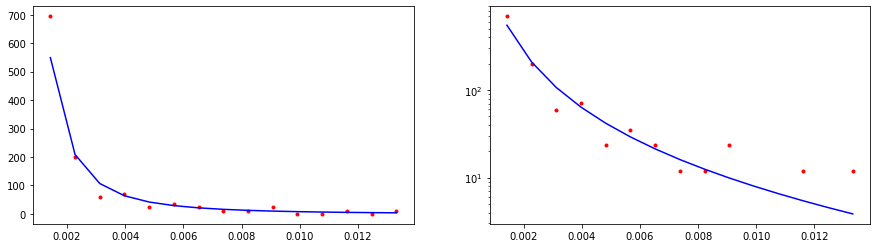

CPU times: user 721 µs, sys: 105 µs, total: 826 µs
Wall time: 650 µs
4786.057624504789


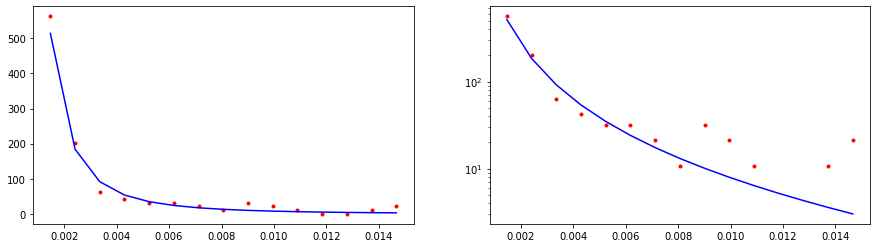

CPU times: user 736 µs, sys: 107 µs, total: 843 µs
Wall time: 672 µs
63448.9136464778


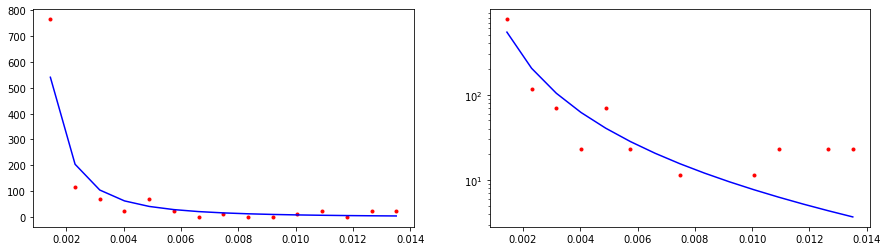

CPU times: user 870 µs, sys: 4 µs, total: 874 µs
Wall time: 705 µs
2716.458440856172


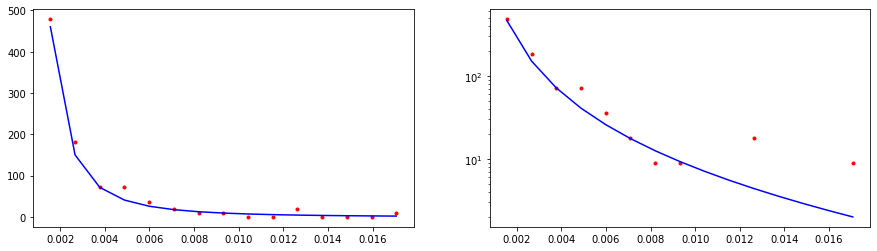

CPU times: user 977 µs, sys: 0 ns, total: 977 µs
Wall time: 811 µs
4601.098056018478


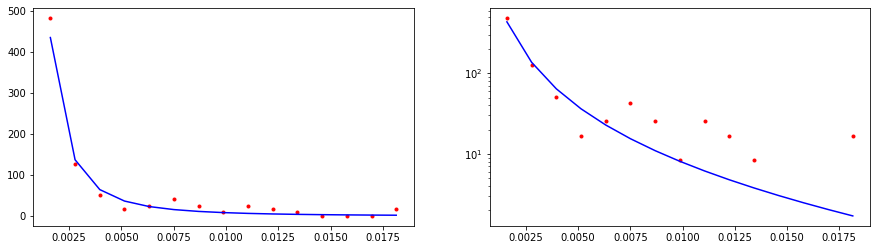

CPU times: user 70 µs, sys: 859 µs, total: 929 µs
Wall time: 756 µs
17355.124235105526


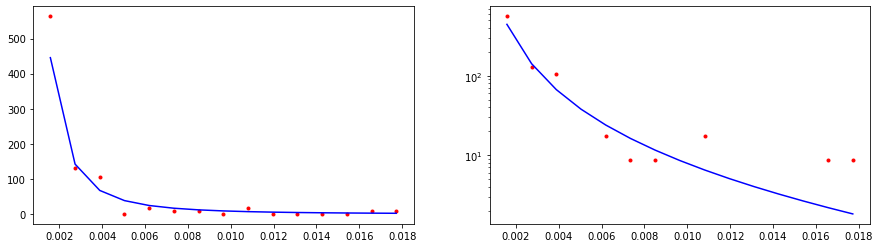

CPU times: user 899 µs, sys: 0 ns, total: 899 µs
Wall time: 789 µs
7858.465072916893


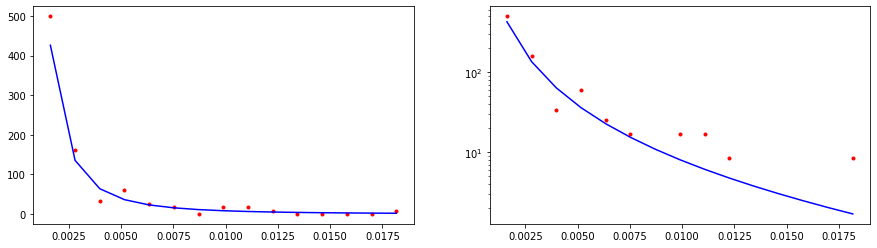

CPU times: user 1.09 ms, sys: 13 µs, total: 1.1 ms
Wall time: 893 µs
4505.830775778539


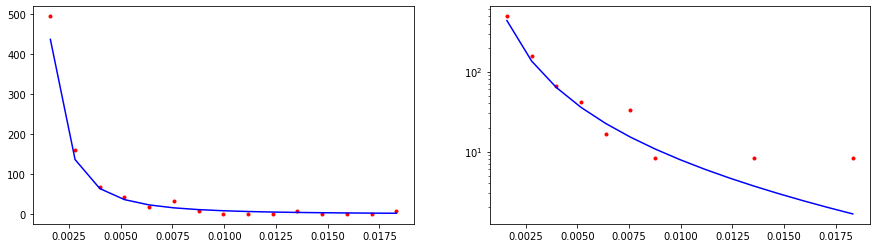

CPU times: user 908 µs, sys: 0 ns, total: 908 µs
Wall time: 810 µs
29132.75972507186


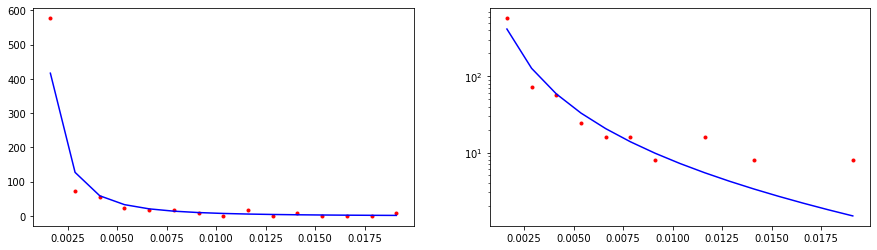

CPU times: user 1.03 ms, sys: 13 µs, total: 1.04 ms
Wall time: 928 µs
12310.673666135443


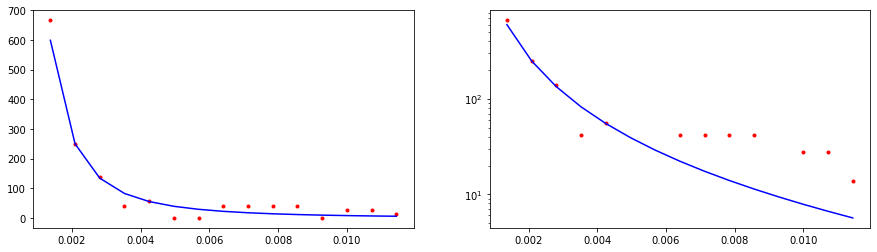

CPU times: user 1.09 ms, sys: 14 µs, total: 1.1 ms
Wall time: 939 µs
8994.73765326922


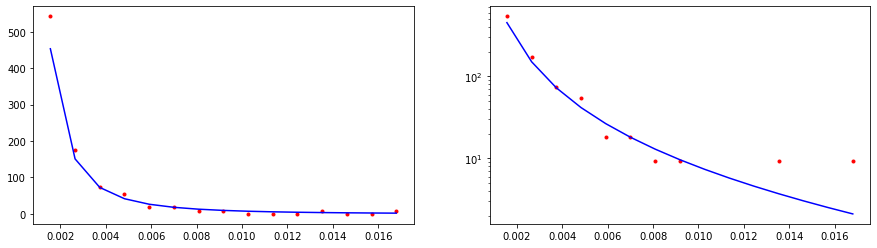

CPU times: user 1.12 ms, sys: 18 µs, total: 1.13 ms
Wall time: 962 µs
5735.052275486271


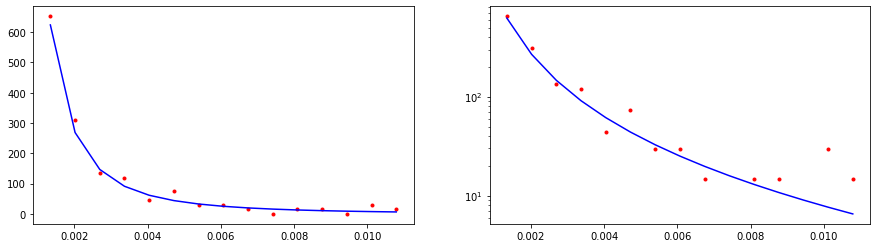

CPU times: user 1.08 ms, sys: 11 µs, total: 1.09 ms
Wall time: 977 µs
12732.93508762507


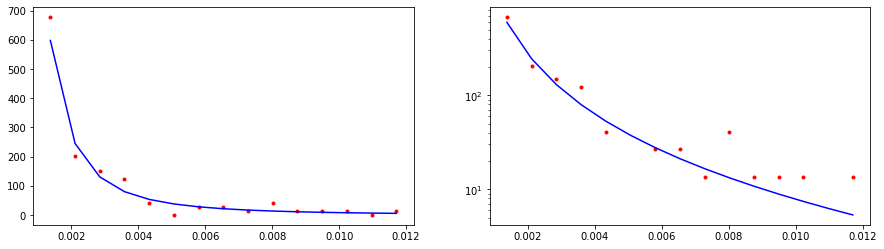

CPU times: user 336 µs, sys: 885 µs, total: 1.22 ms
Wall time: 1.03 ms
7581.860372819917


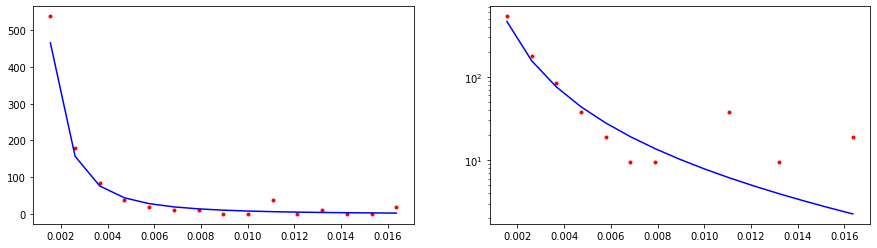

CPU times: user 318 µs, sys: 892 µs, total: 1.21 ms
Wall time: 1.03 ms
18780.61727913583


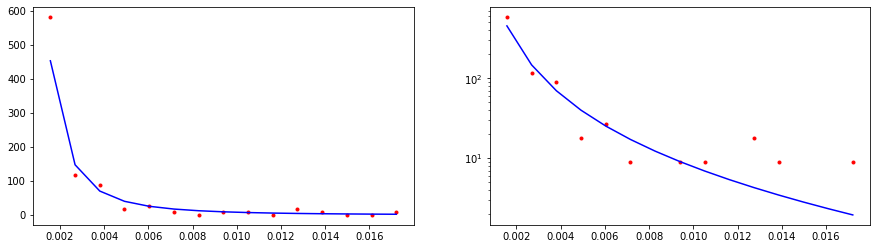

CPU times: user 601 µs, sys: 0 ns, total: 601 µs
Wall time: 392 µs
26503.71670632491


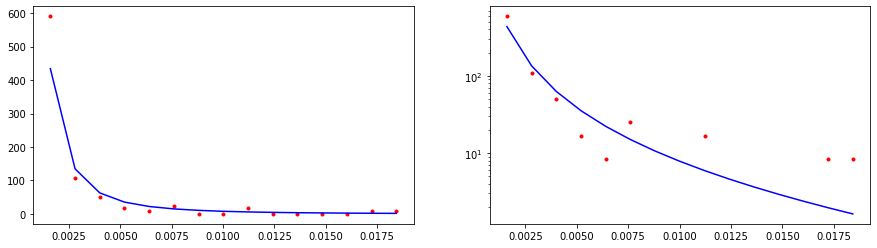

CPU times: user 214 µs, sys: 31 µs, total: 245 µs
Wall time: 215 µs
7612019.356963031


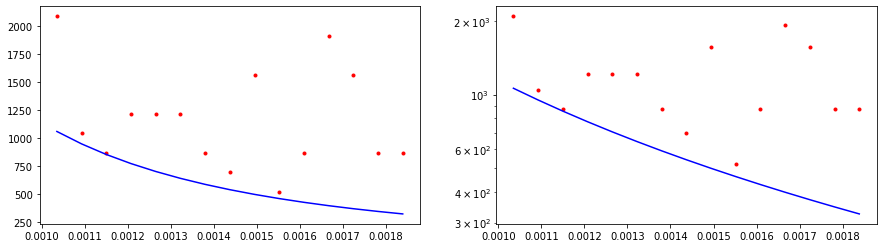

CPU times: user 178 µs, sys: 26 µs, total: 204 µs
Wall time: 178 µs
440723.4396781479


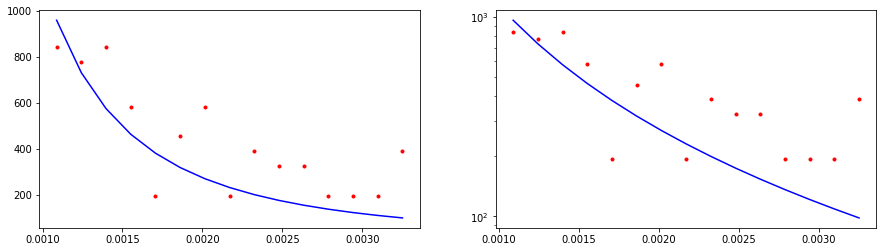

CPU times: user 0 ns, sys: 337 µs, total: 337 µs
Wall time: 245 µs
98595.78232079872


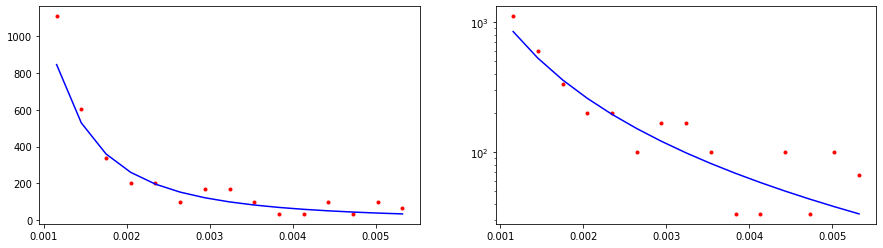

CPU times: user 260 µs, sys: 38 µs, total: 298 µs
Wall time: 265 µs
34838.45684192876


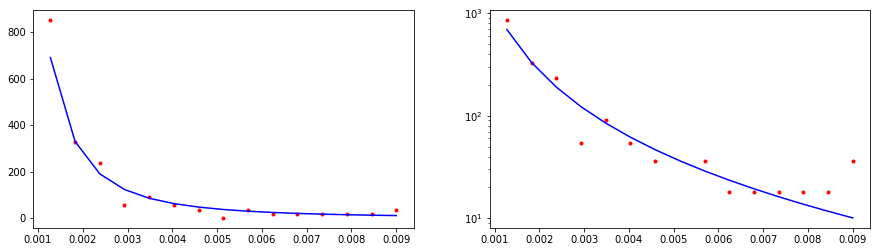

CPU times: user 382 µs, sys: 56 µs, total: 438 µs
Wall time: 309 µs
41152.981449871135


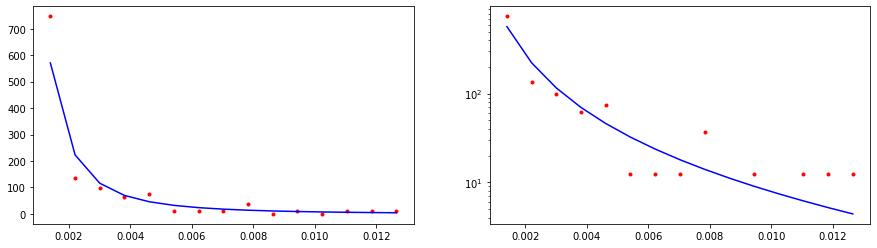

CPU times: user 543 µs, sys: 0 ns, total: 543 µs
Wall time: 348 µs
18130.581880455706


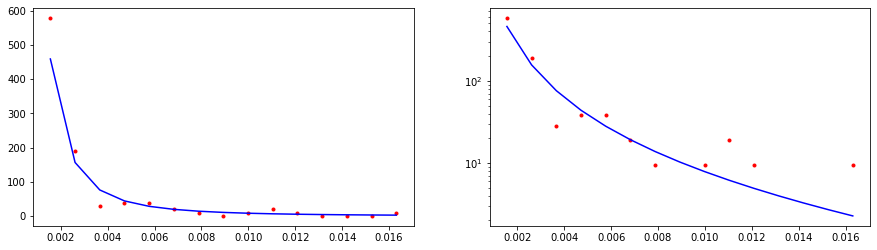

CPU times: user 536 µs, sys: 0 ns, total: 536 µs
Wall time: 365 µs
6361.479277216934


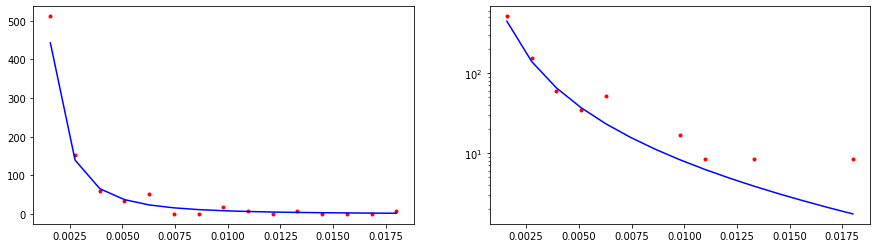

CPU times: user 499 µs, sys: 72 µs, total: 571 µs
Wall time: 397 µs
21325.861106109733


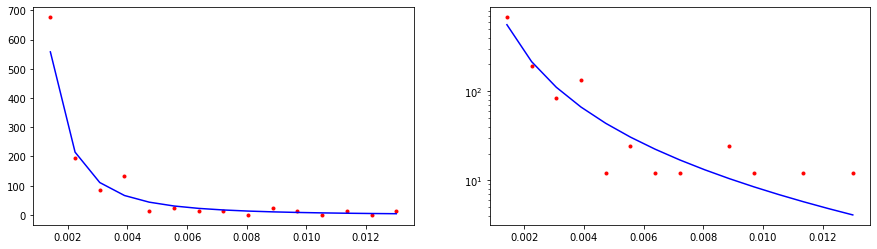

CPU times: user 604 µs, sys: 0 ns, total: 604 µs
Wall time: 490 µs
8035.446650229395


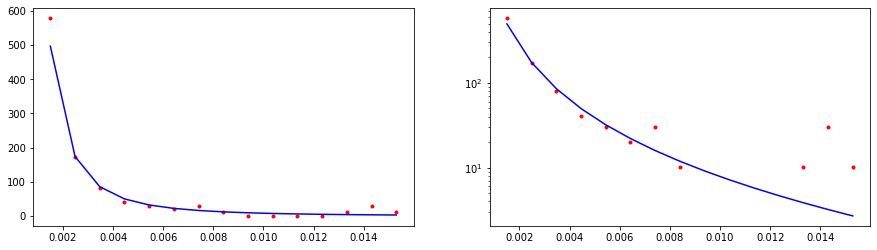

CPU times: user 612 µs, sys: 0 ns, total: 612 µs
Wall time: 449 µs
23087.20780581351


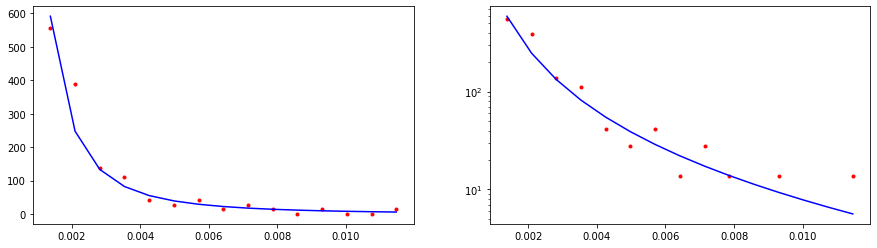

CPU times: user 717 µs, sys: 0 ns, total: 717 µs
Wall time: 532 µs
7050.1583720168765


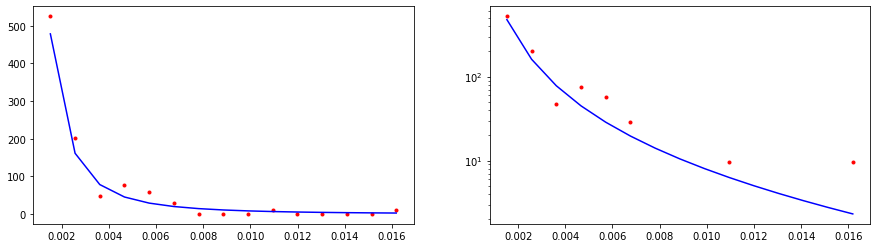

CPU times: user 747 µs, sys: 0 ns, total: 747 µs
Wall time: 575 µs
8141.156371608679


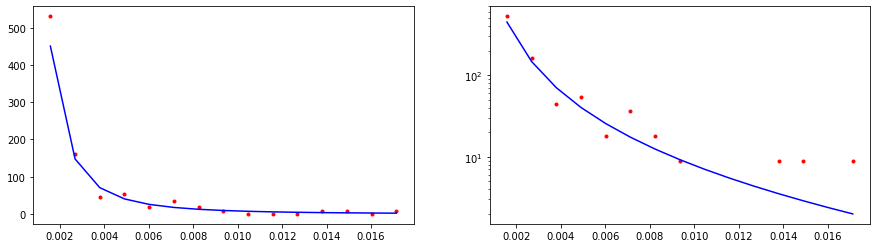

CPU times: user 774 µs, sys: 0 ns, total: 774 µs
Wall time: 602 µs
10106.675731545245


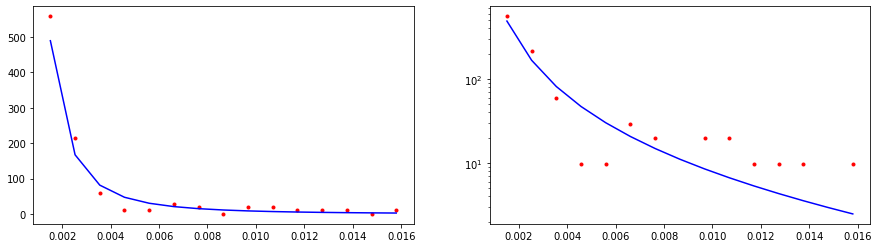

CPU times: user 810 µs, sys: 0 ns, total: 810 µs
Wall time: 591 µs
8886.135564003416


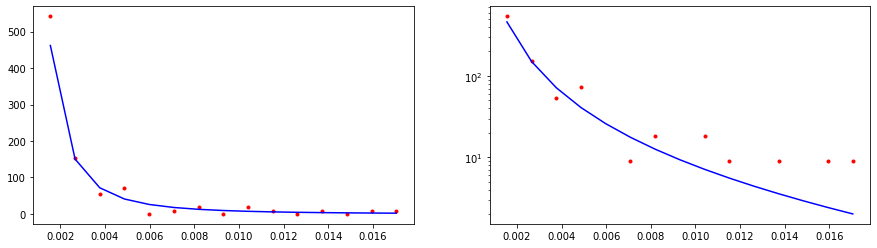

CPU times: user 790 µs, sys: 0 ns, total: 790 µs
Wall time: 586 µs
10332.220962352874


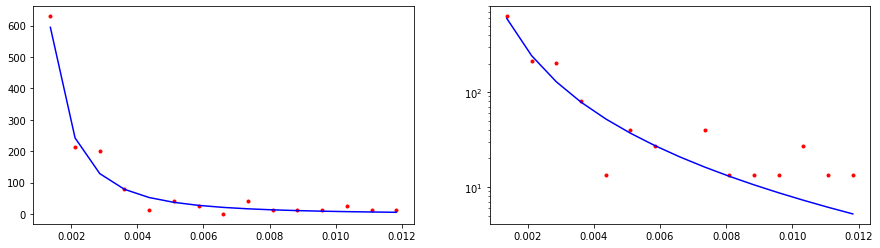

CPU times: user 802 µs, sys: 0 ns, total: 802 µs
Wall time: 638 µs
13227.697650902724


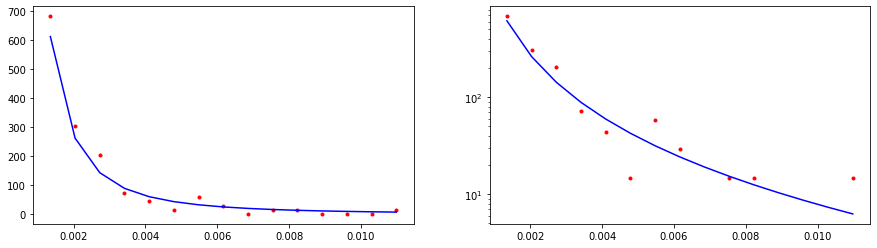

CPU times: user 882 µs, sys: 0 ns, total: 882 µs
Wall time: 675 µs
18711.658831026554


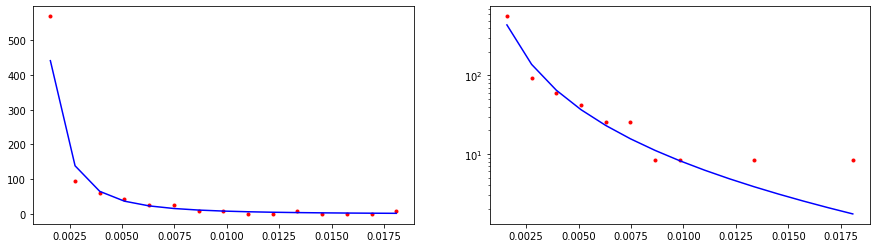

CPU times: user 897 µs, sys: 0 ns, total: 897 µs
Wall time: 701 µs
14814.411440219534


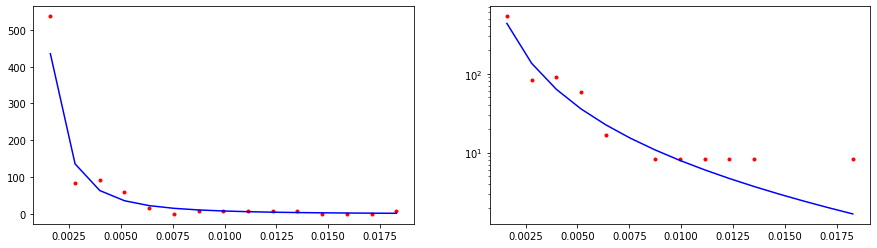

CPU times: user 906 µs, sys: 0 ns, total: 906 µs
Wall time: 703 µs
8935.996615185737


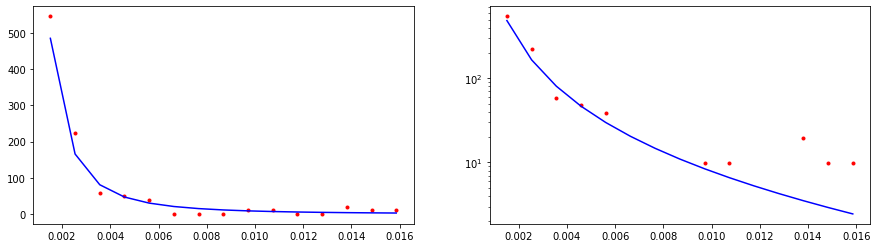

CPU times: user 977 µs, sys: 0 ns, total: 977 µs
Wall time: 792 µs
20812.78199271541


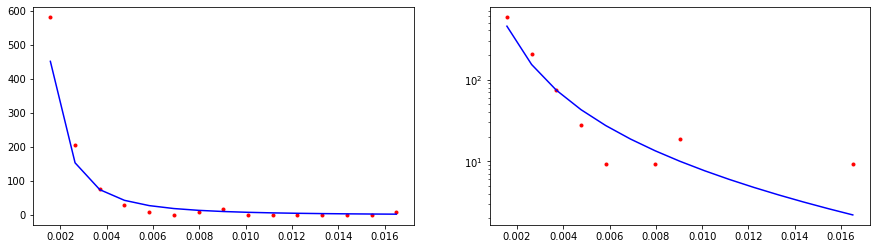

CPU times: user 992 µs, sys: 0 ns, total: 992 µs
Wall time: 821 µs
8142.930965052885


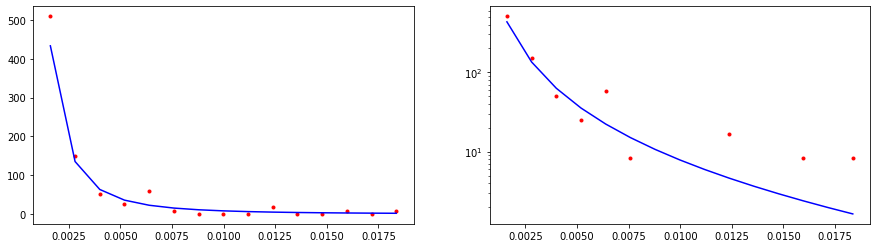

CPU times: user 978 µs, sys: 22 µs, total: 1 ms
Wall time: 820 µs
6524.228872364166


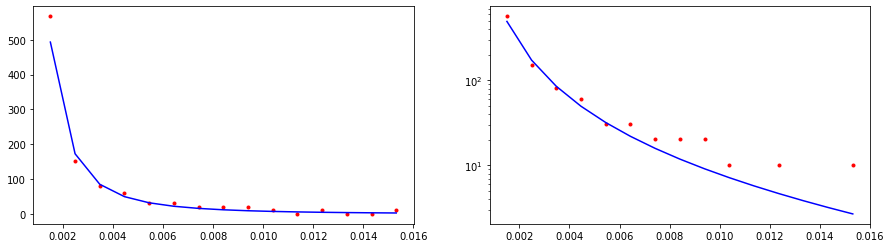

CPU times: user 1.01 ms, sys: 2 µs, total: 1.02 ms
Wall time: 843 µs
64416.21877588206


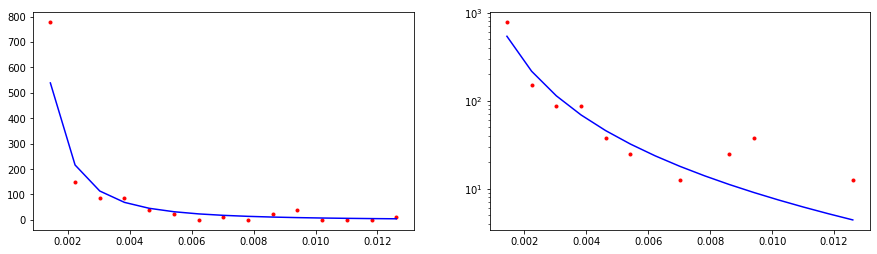

CPU times: user 1.09 ms, sys: 14 µs, total: 1.1 ms
Wall time: 944 µs
6954.073467000518


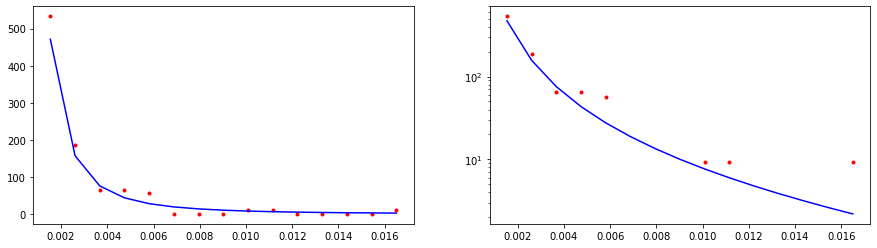

CPU times: user 245 µs, sys: 863 µs, total: 1.11 ms
Wall time: 923 µs
13525.1459163277


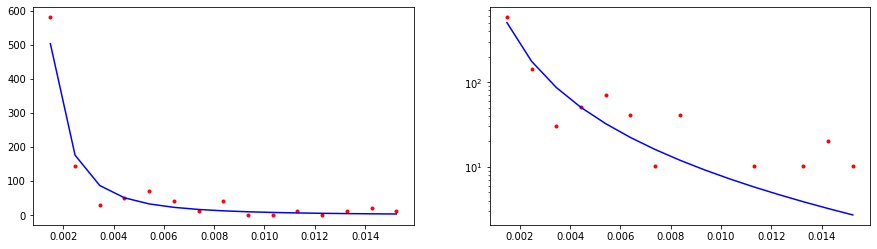

CPU times: user 1.15 ms, sys: 0 ns, total: 1.15 ms
Wall time: 963 µs
23572.532467247474


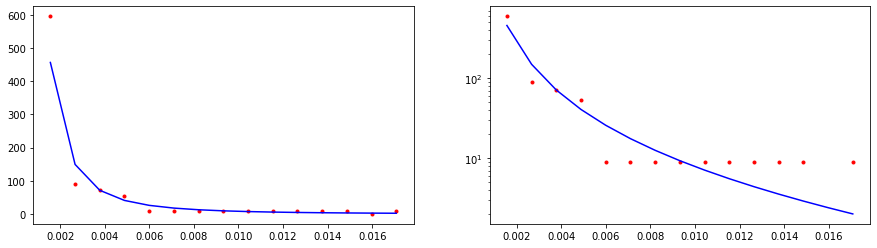

CPU times: user 1.12 ms, sys: 18 µs, total: 1.14 ms
Wall time: 966 µs
10245.859519603935


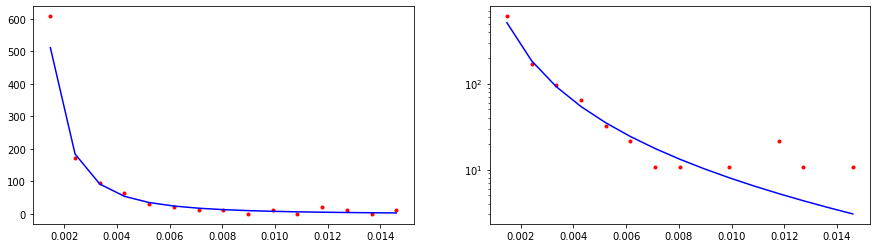

CPU times: user 1.17 ms, sys: 24 µs, total: 1.19 ms
Wall time: 993 µs
21212.050792596056


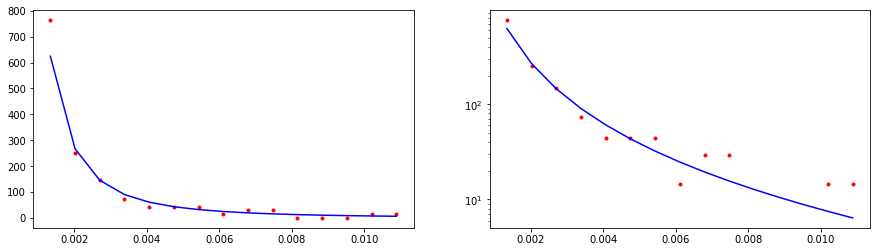

CPU times: user 1.17 ms, sys: 25 µs, total: 1.19 ms
Wall time: 1.02 ms
3850.1412368259303


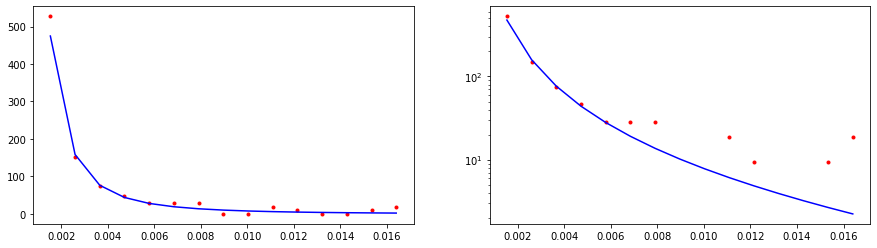

CPU times: user 1.13 ms, sys: 20 µs, total: 1.15 ms
Wall time: 995 µs
15892.87543538408


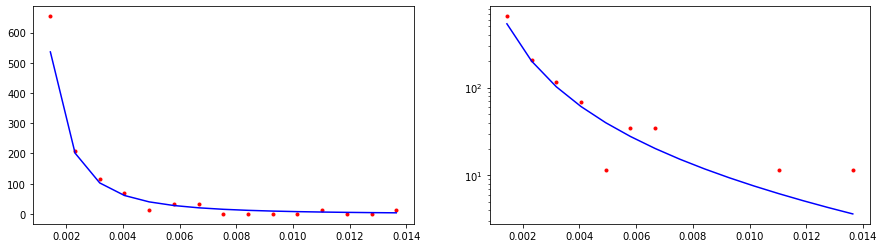

CPU times: user 571 µs, sys: 84 µs, total: 655 µs
Wall time: 416 µs
6294.258265231732


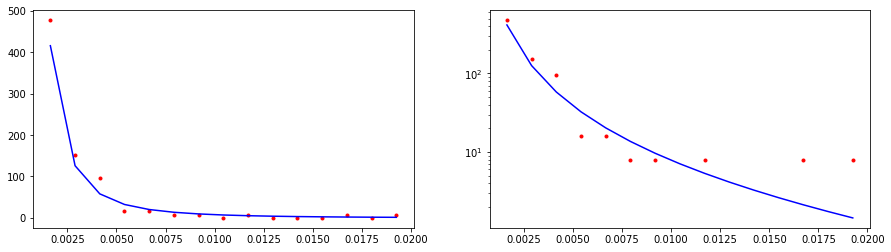

CPU times: user 182 µs, sys: 26 µs, total: 208 µs
Wall time: 175 µs
7063193.8526102835


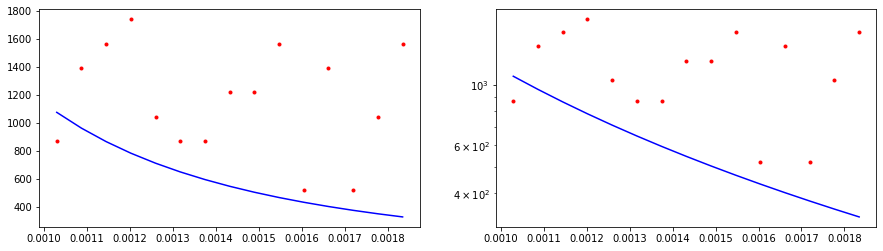

CPU times: user 401 µs, sys: 0 ns, total: 401 µs
Wall time: 263 µs
580930.437392346


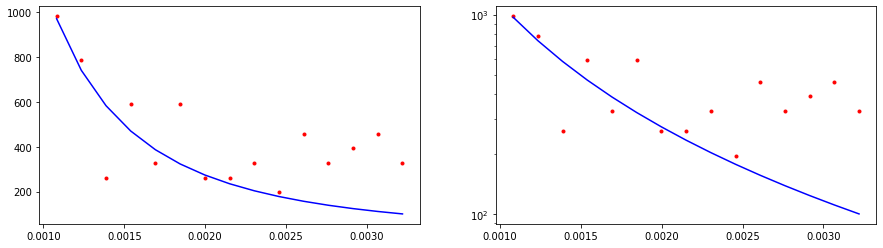

CPU times: user 321 µs, sys: 0 ns, total: 321 µs
Wall time: 234 µs
72837.89979374742


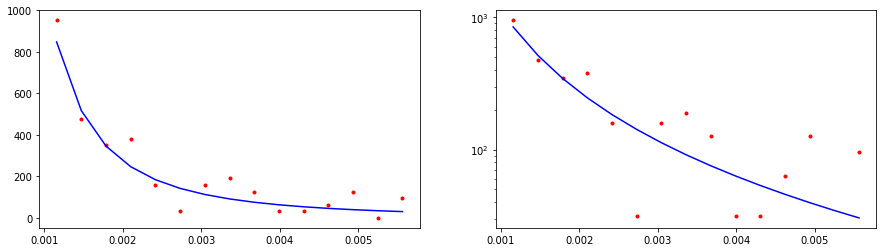

CPU times: user 262 µs, sys: 39 µs, total: 301 µs
Wall time: 264 µs
12495.724498477071


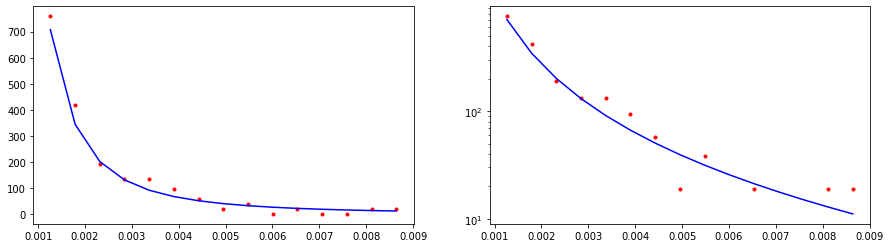

CPU times: user 475 µs, sys: 0 ns, total: 475 µs
Wall time: 319 µs
9298.979942657941


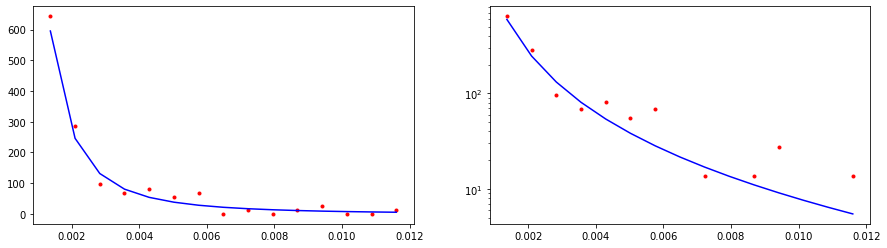

CPU times: user 0 ns, sys: 459 µs, total: 459 µs
Wall time: 364 µs
13756.583128150745


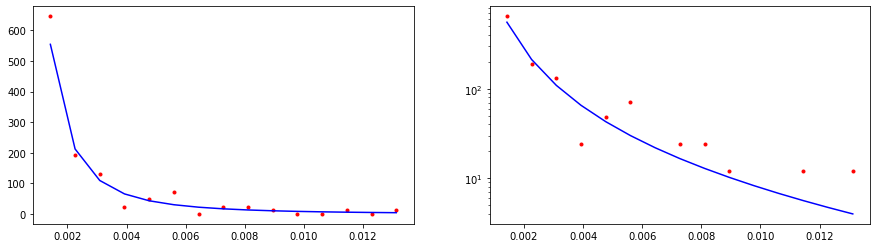

CPU times: user 0 ns, sys: 538 µs, total: 538 µs
Wall time: 375 µs
26618.034650067337


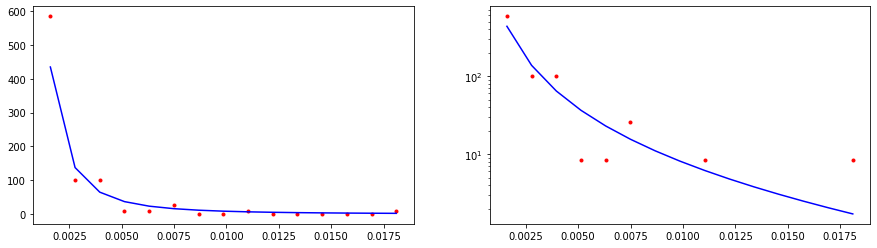

CPU times: user 430 µs, sys: 63 µs, total: 493 µs
Wall time: 376 µs
6226.409071792901


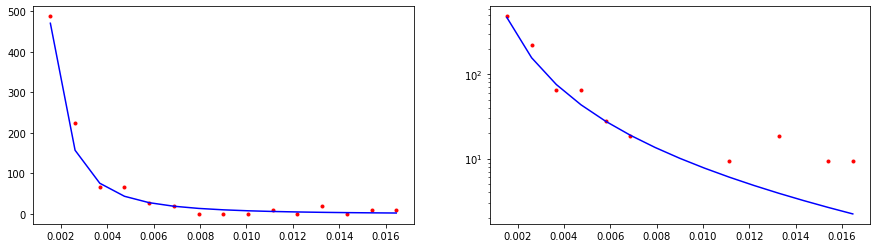

CPU times: user 609 µs, sys: 0 ns, total: 609 µs
Wall time: 420 µs
9776.40443021129


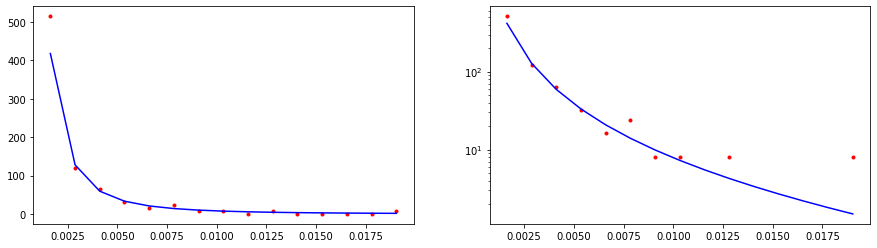

CPU times: user 537 µs, sys: 79 µs, total: 616 µs
Wall time: 445 µs
11453.311733597808


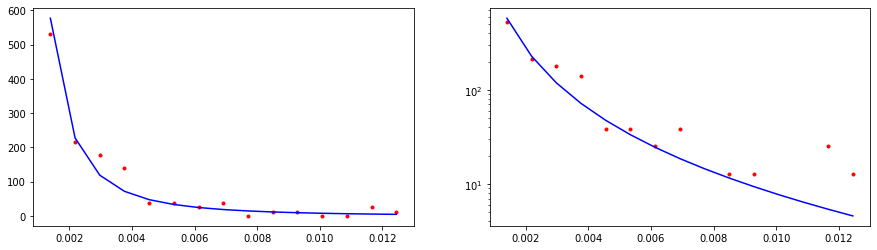

CPU times: user 634 µs, sys: 92 µs, total: 726 µs
Wall time: 537 µs
39892.7460789724


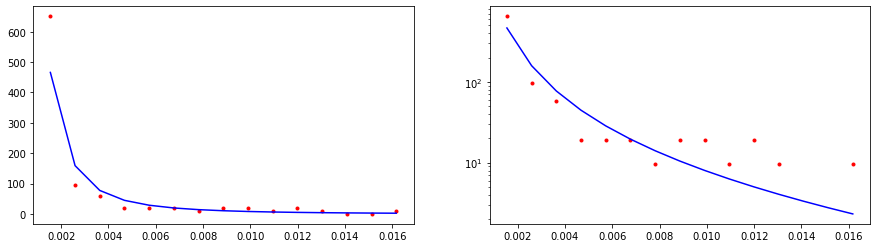

CPU times: user 668 µs, sys: 0 ns, total: 668 µs
Wall time: 497 µs
17048.78522790182


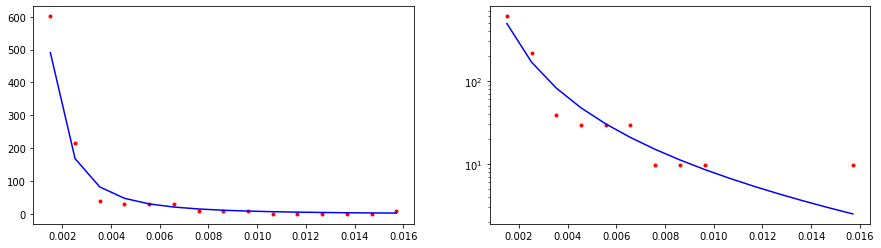

CPU times: user 633 µs, sys: 93 µs, total: 726 µs
Wall time: 548 µs
4512.119227057781


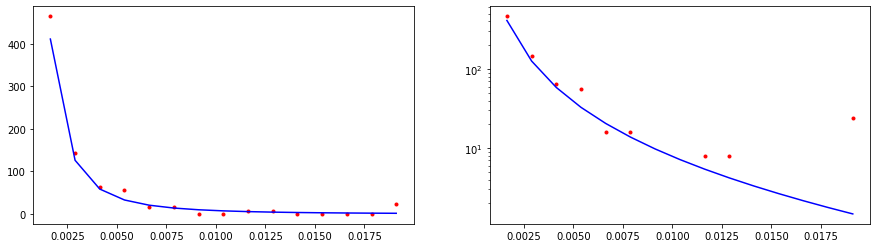

CPU times: user 0 ns, sys: 745 µs, total: 745 µs
Wall time: 624 µs
7825.787197961557


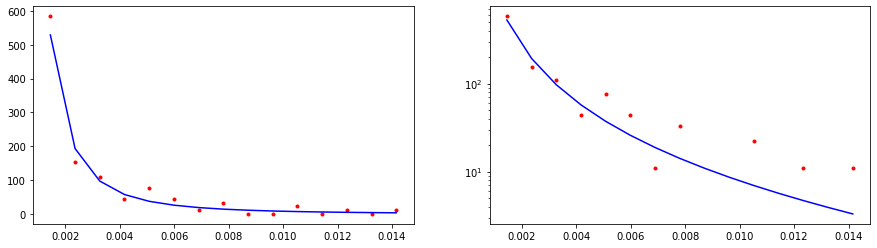

CPU times: user 824 µs, sys: 0 ns, total: 824 µs
Wall time: 646 µs
15407.747864916017


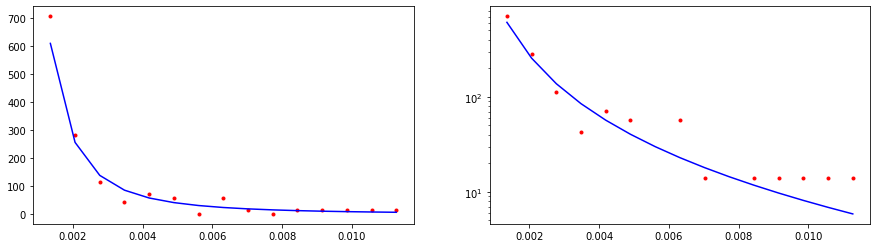

CPU times: user 0 ns, sys: 794 µs, total: 794 µs
Wall time: 676 µs
15876.286912237676


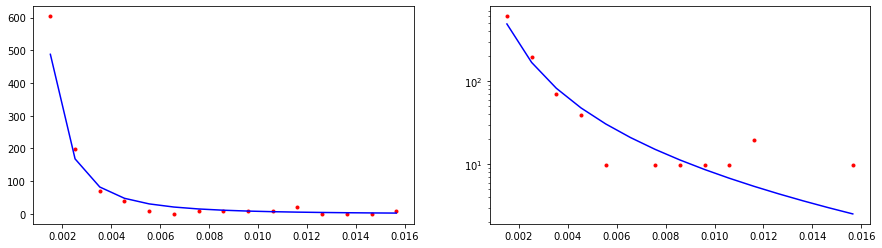

CPU times: user 858 µs, sys: 5 µs, total: 863 µs
Wall time: 658 µs
2144.2264119266188


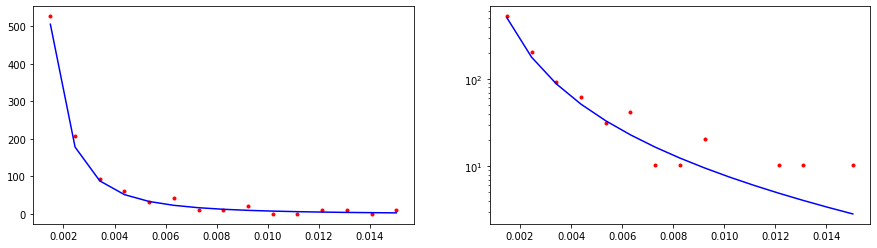

CPU times: user 886 µs, sys: 6 µs, total: 892 µs
Wall time: 705 µs
6108.287067339808


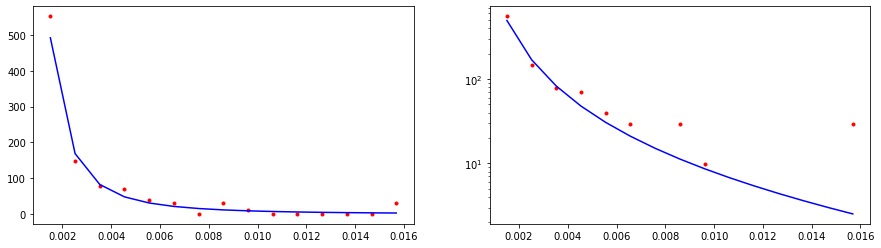

CPU times: user 934 µs, sys: 0 ns, total: 934 µs
Wall time: 731 µs
8048.882105176655


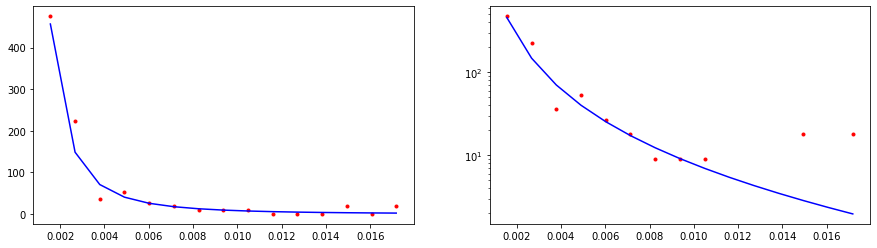

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 879 µs
8987.17367912176


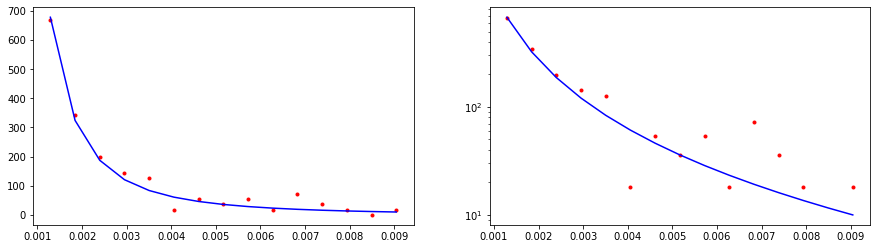

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 842 µs
8136.765469288357


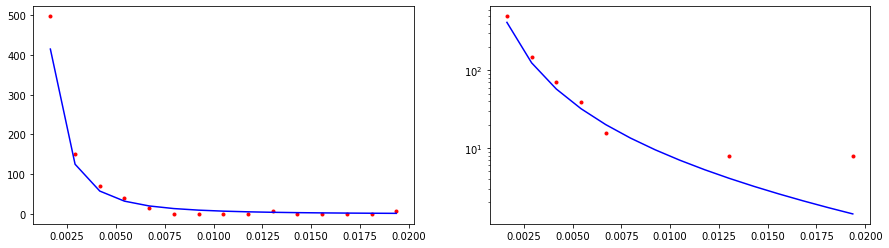

CPU times: user 1.05 ms, sys: 7 µs, total: 1.06 ms
Wall time: 868 µs
3778.09009296181


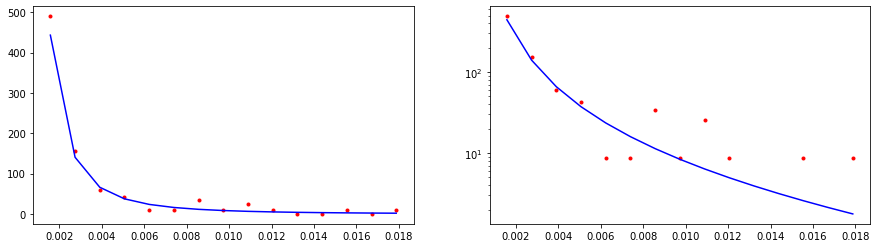

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 880 µs
11353.991909892628


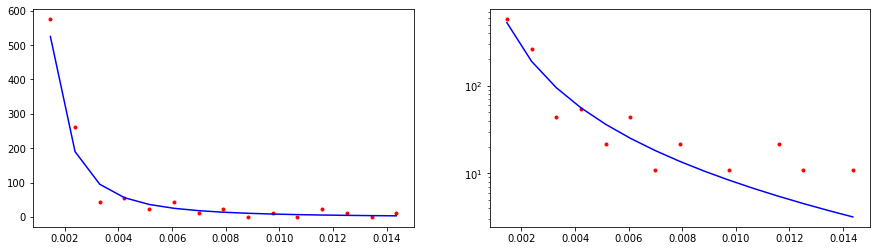

CPU times: user 166 µs, sys: 878 µs, total: 1.04 ms
Wall time: 876 µs
11259.435786641954


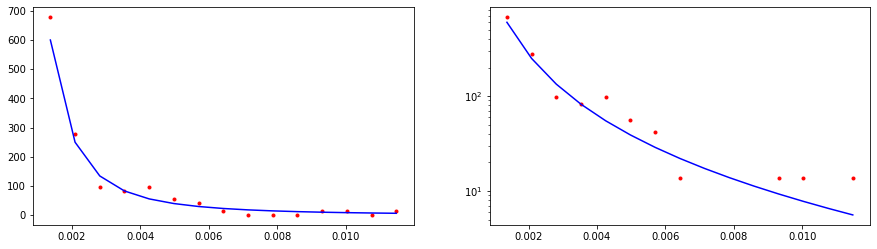

CPU times: user 190 µs, sys: 881 µs, total: 1.07 ms
Wall time: 899 µs
34452.27846618058


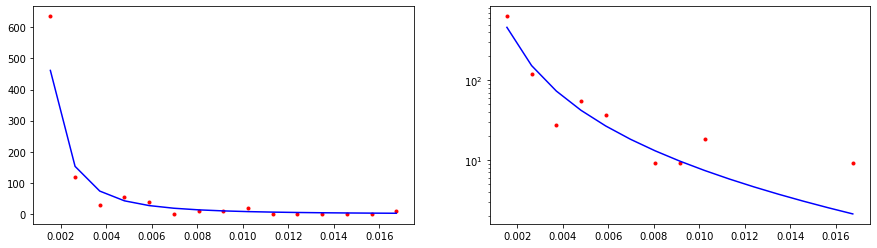

CPU times: user 1.07 ms, sys: 10 µs, total: 1.08 ms
Wall time: 949 µs
8593.453134320373


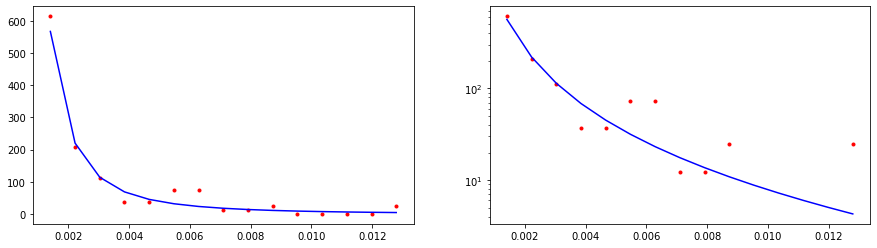

CPU times: user 1.05 ms, sys: 7 µs, total: 1.06 ms
Wall time: 935 µs
15104.381630774082


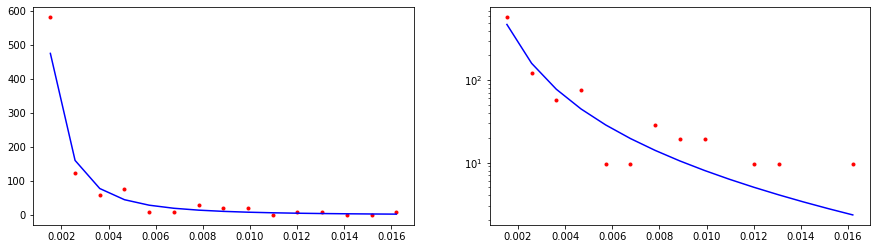

CPU times: user 1.13 ms, sys: 20 µs, total: 1.15 ms
Wall time: 976 µs
3945.2178658169855


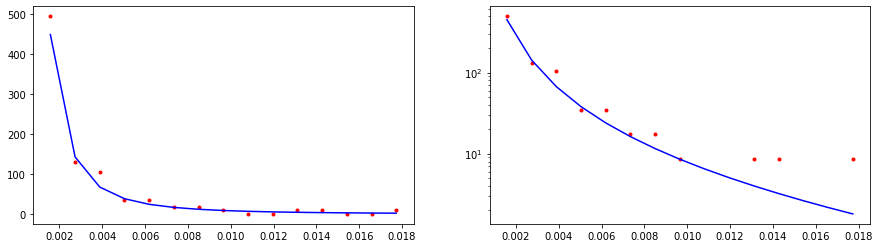

CPU times: user 1.22 ms, sys: 33 µs, total: 1.25 ms
Wall time: 1.07 ms
3594.2644405739597


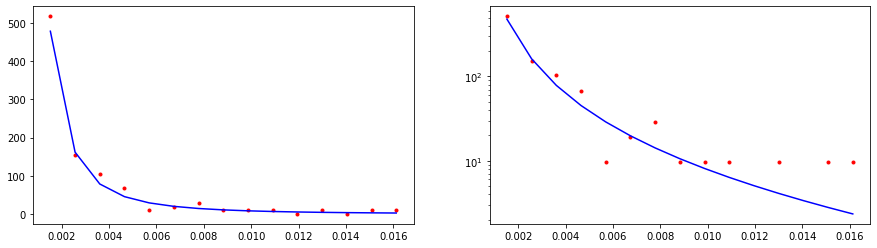

CPU times: user 1.22 ms, sys: 32 µs, total: 1.25 ms
Wall time: 1.07 ms
8120.918964218591


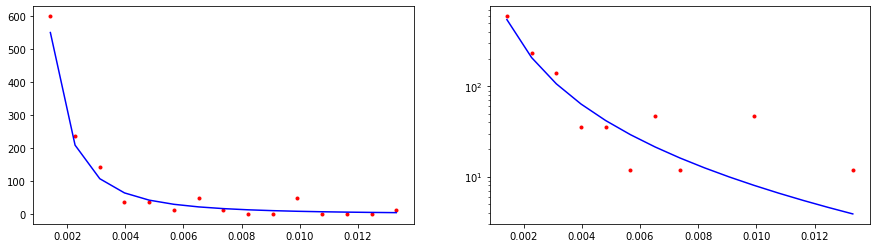

CPU times: user 0 ns, sys: 641 µs, total: 641 µs
Wall time: 392 µs
5537.664868518595


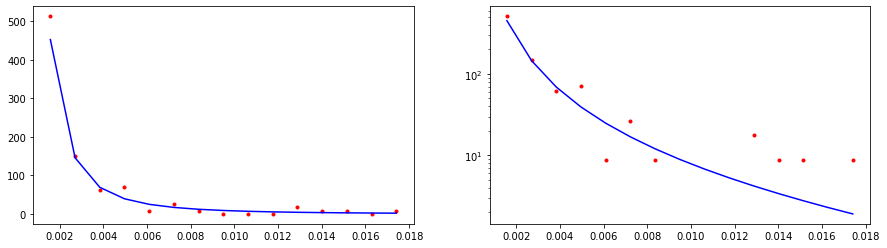

CPU times: user 0 ns, sys: 264 µs, total: 264 µs
Wall time: 180 µs
8051012.390829471


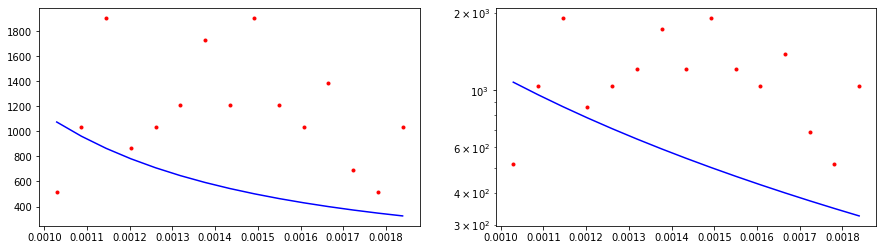

CPU times: user 208 µs, sys: 31 µs, total: 239 µs
Wall time: 218 µs
611194.2004022106


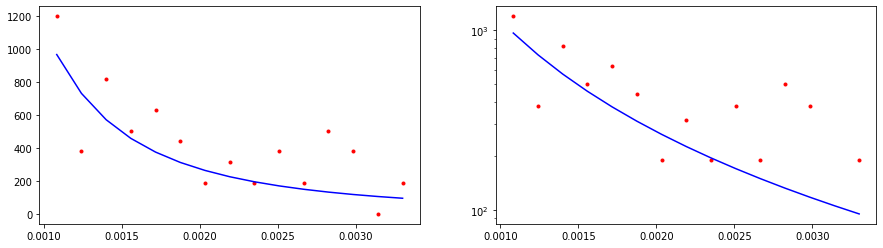

CPU times: user 291 µs, sys: 43 µs, total: 334 µs
Wall time: 229 µs
166241.91703256566


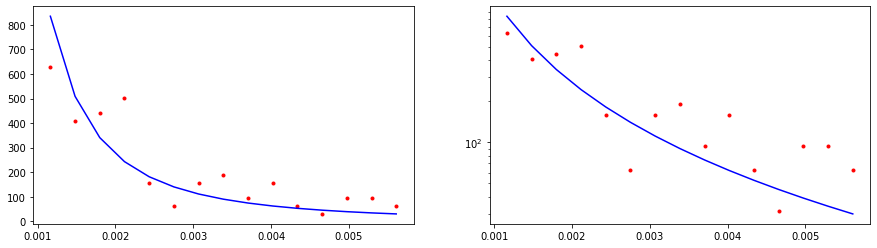

CPU times: user 283 µs, sys: 42 µs, total: 325 µs
Wall time: 256 µs
23455.85856727273


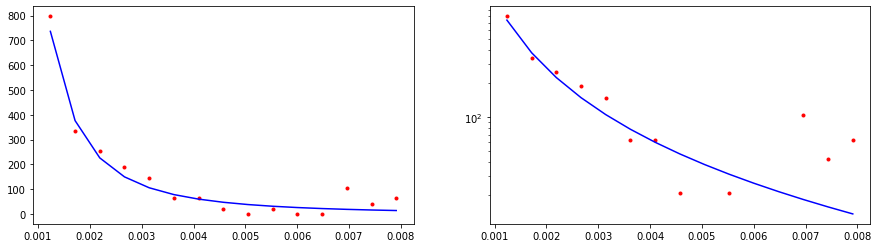

CPU times: user 466 µs, sys: 0 ns, total: 466 µs
Wall time: 389 µs
9722.851124153773


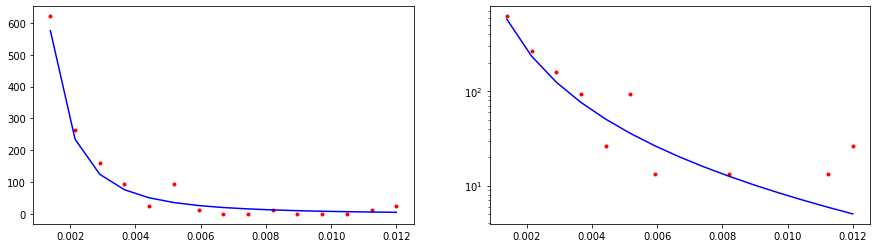

CPU times: user 382 µs, sys: 56 µs, total: 438 µs
Wall time: 334 µs
4869.93968944901


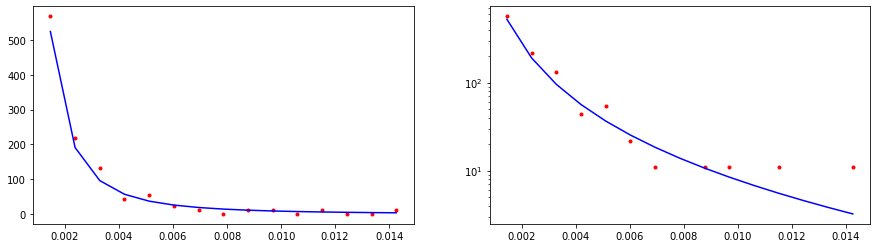

CPU times: user 457 µs, sys: 0 ns, total: 457 µs
Wall time: 355 µs
19547.927515023253


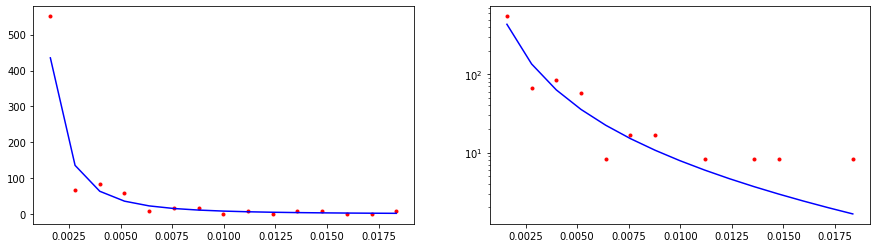

CPU times: user 580 µs, sys: 0 ns, total: 580 µs
Wall time: 414 µs
15260.46956250418


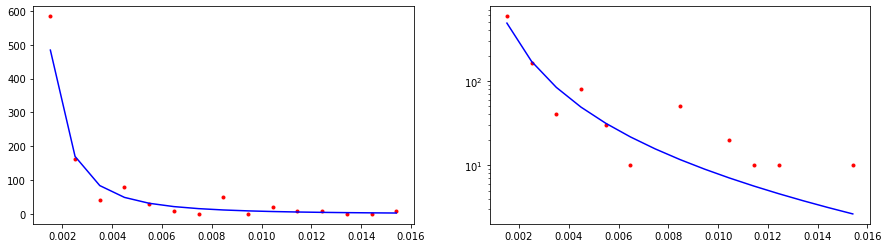

CPU times: user 0 ns, sys: 595 µs, total: 595 µs
Wall time: 433 µs
16507.045173507147


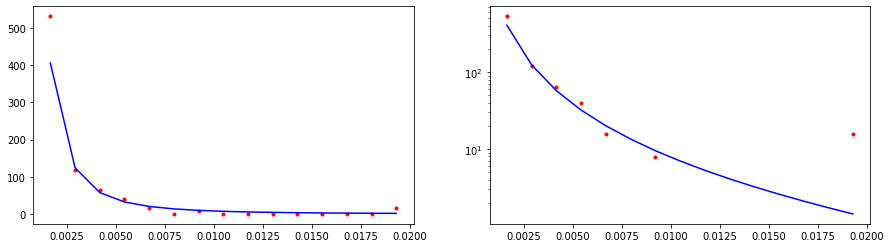

CPU times: user 0 ns, sys: 678 µs, total: 678 µs
Wall time: 499 µs
21005.10519578196


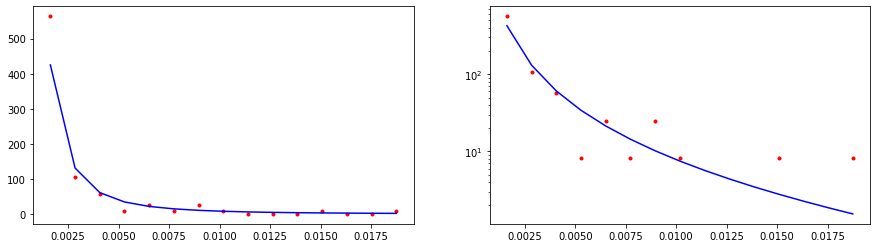

CPU times: user 640 µs, sys: 0 ns, total: 640 µs
Wall time: 473 µs
41146.92826296565


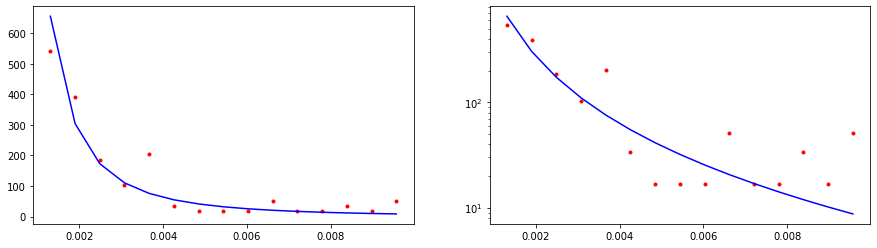

CPU times: user 675 µs, sys: 0 ns, total: 675 µs
Wall time: 557 µs
10915.056567602976


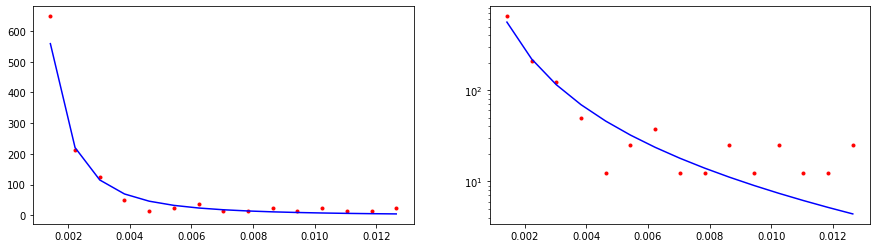

CPU times: user 675 µs, sys: 100 µs, total: 775 µs
Wall time: 597 µs
8684.487709118013


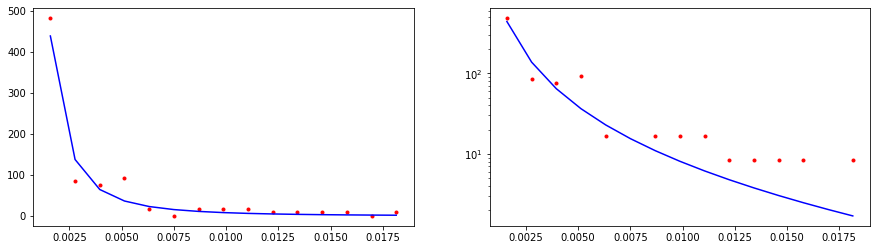

CPU times: user 0 ns, sys: 700 µs, total: 700 µs
Wall time: 540 µs
5374.69053269849


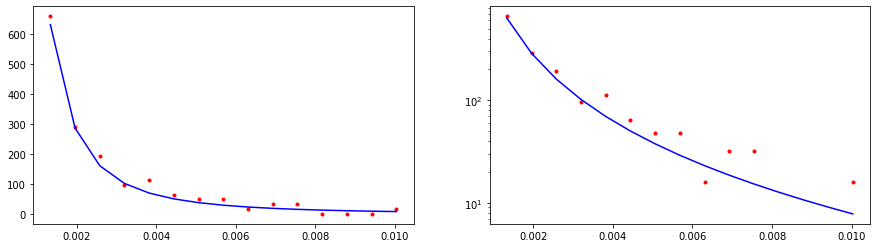

CPU times: user 676 µs, sys: 100 µs, total: 776 µs
Wall time: 605 µs
11296.854356926868


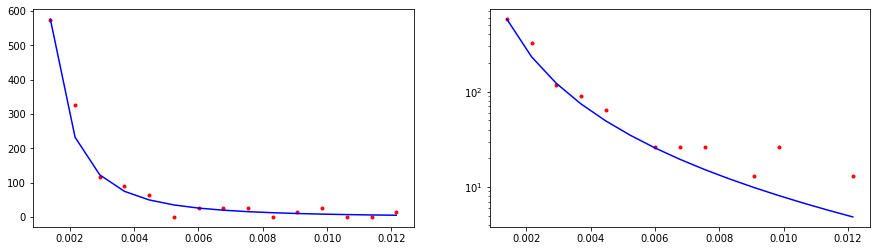

CPU times: user 803 µs, sys: 0 ns, total: 803 µs
Wall time: 631 µs
5849.962595987339


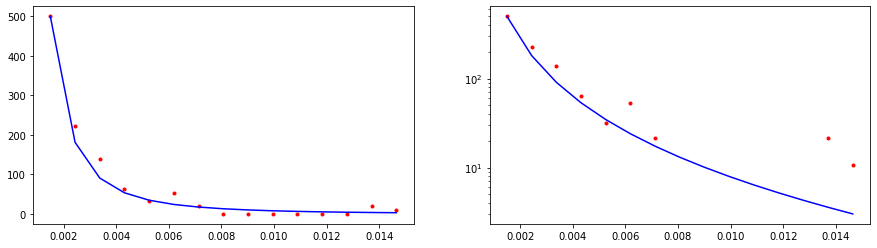

CPU times: user 757 µs, sys: 112 µs, total: 869 µs
Wall time: 679 µs
4549.965311958728


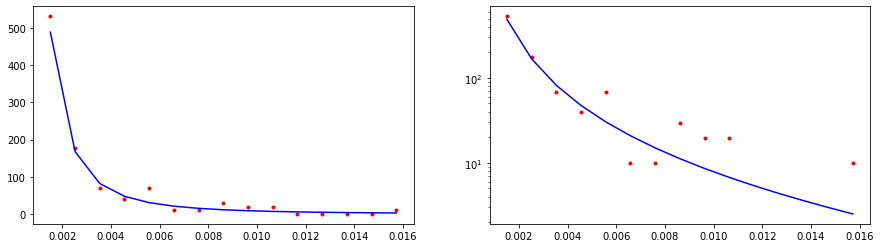

CPU times: user 877 µs, sys: 0 ns, total: 877 µs
Wall time: 701 µs
4060.3143370175094


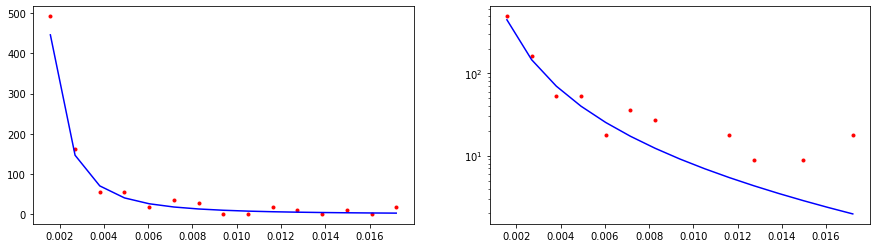

CPU times: user 893 µs, sys: 0 ns, total: 893 µs
Wall time: 721 µs
1664.742405757578


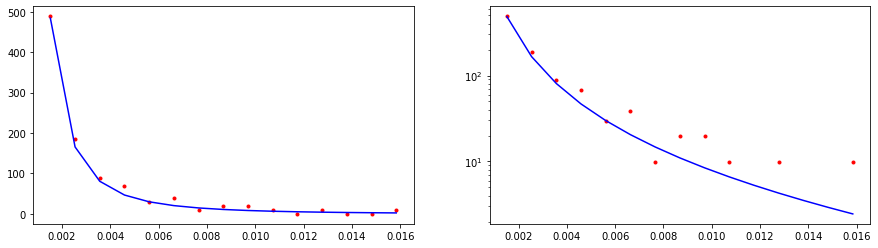

CPU times: user 0 ns, sys: 977 µs, total: 977 µs
Wall time: 767 µs
25736.965313867902


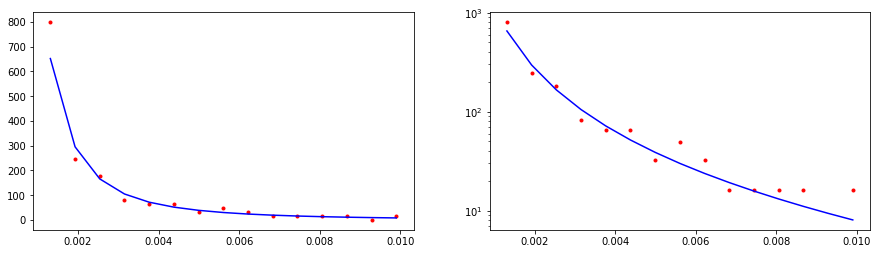

CPU times: user 159 µs, sys: 876 µs, total: 1.04 ms
Wall time: 859 µs
22579.021304157814


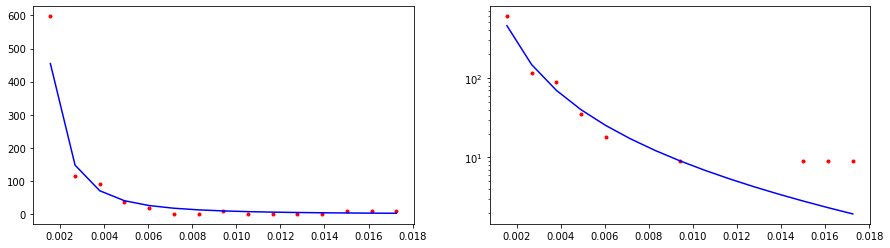

CPU times: user 1.01 ms, sys: 2 µs, total: 1.01 ms
Wall time: 821 µs
16793.529078687658


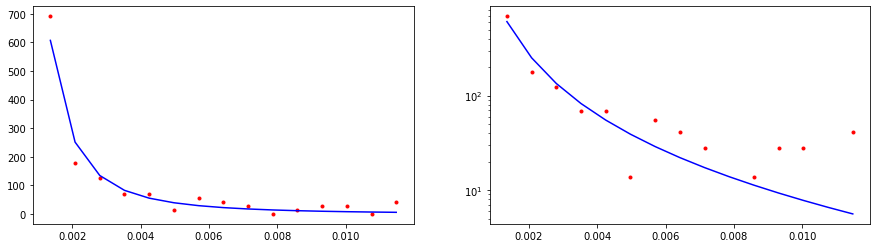

CPU times: user 982 µs, sys: 0 ns, total: 982 µs
Wall time: 810 µs
40826.17032478819


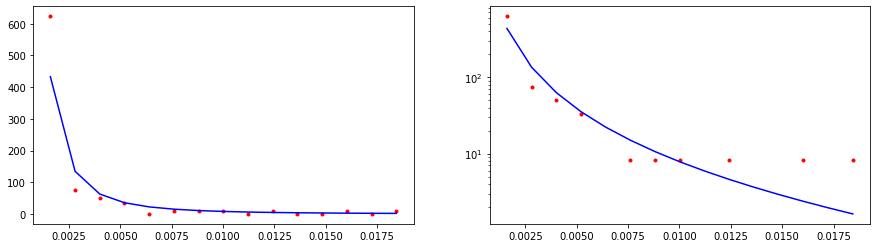

CPU times: user 1.13 ms, sys: 20 µs, total: 1.15 ms
Wall time: 1.03 ms
5547.26849461955


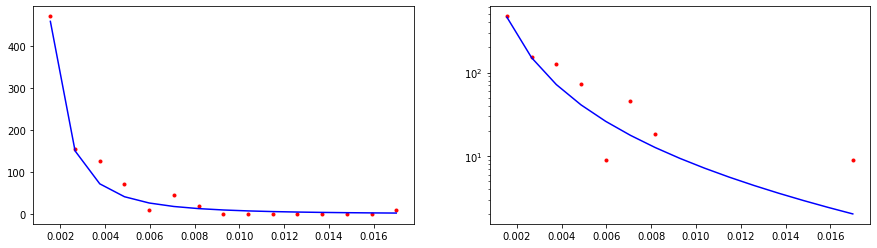

CPU times: user 1.01 ms, sys: 2 µs, total: 1.01 ms
Wall time: 883 µs
10803.707538604664


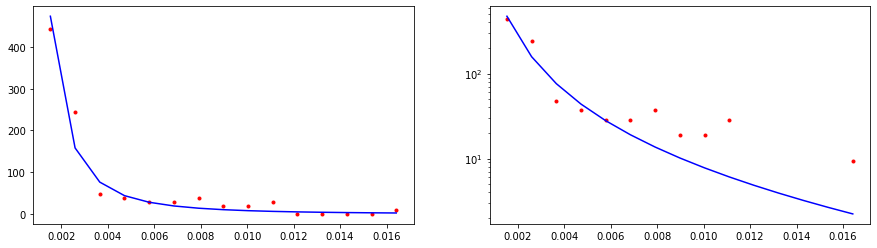

CPU times: user 1.09 ms, sys: 14 µs, total: 1.11 ms
Wall time: 927 µs
18361.515005506622


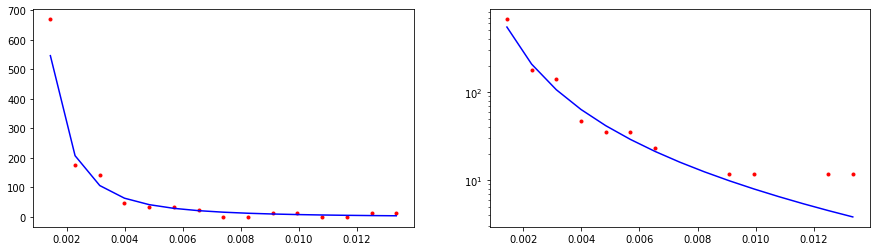

CPU times: user 1.1 ms, sys: 15 µs, total: 1.11 ms
Wall time: 941 µs
9027.940982046674


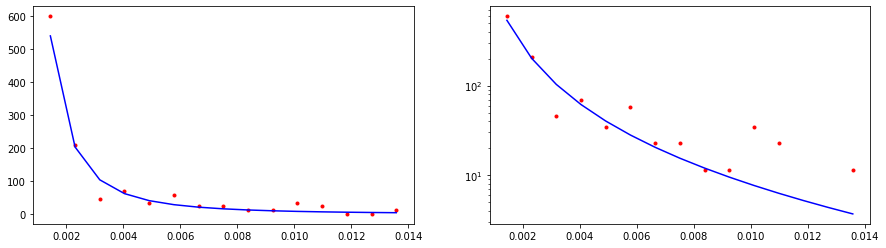

CPU times: user 1.1 ms, sys: 0 ns, total: 1.1 ms
Wall time: 985 µs
6803.982107968179


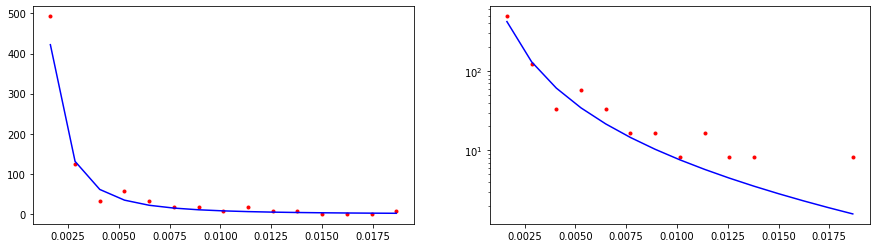

CPU times: user 310 µs, sys: 813 µs, total: 1.12 ms
Wall time: 957 µs
7257.686234660741


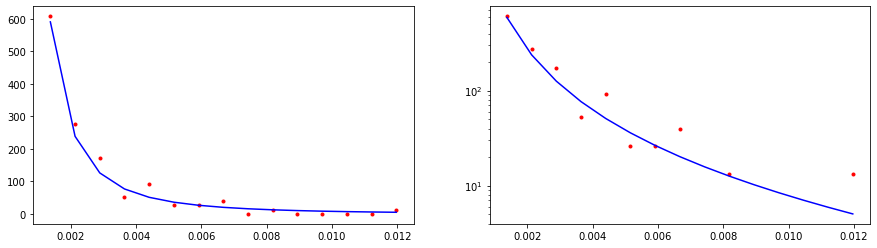

CPU times: user 372 µs, sys: 908 µs, total: 1.28 ms
Wall time: 1.11 ms
9155.716232357374


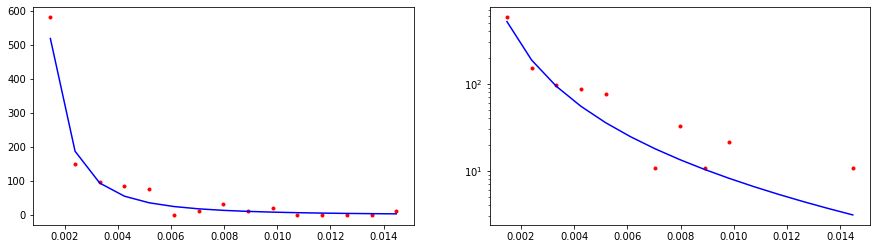

CPU times: user 634 µs, sys: 0 ns, total: 634 µs
Wall time: 415 µs
12874.13863187296


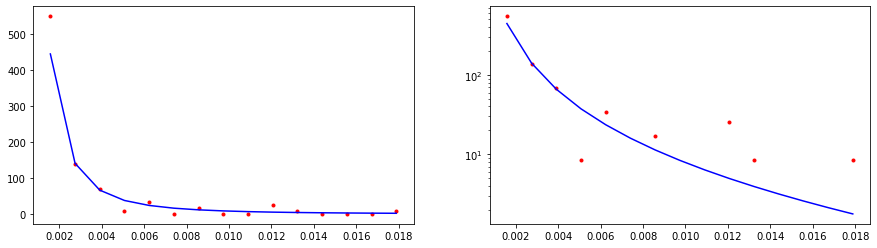

CPU times: user 253 µs, sys: 0 ns, total: 253 µs
Wall time: 219 µs
7878521.562791887


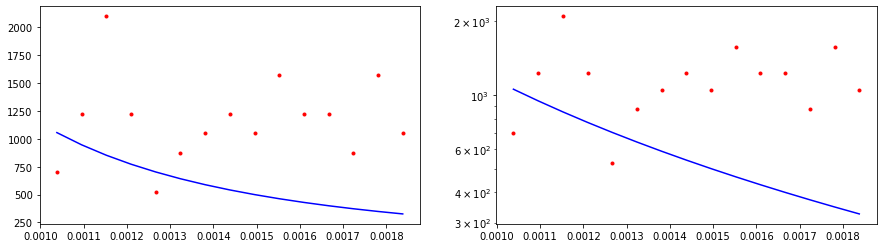

CPU times: user 214 µs, sys: 32 µs, total: 246 µs
Wall time: 208 µs
608172.2592448231


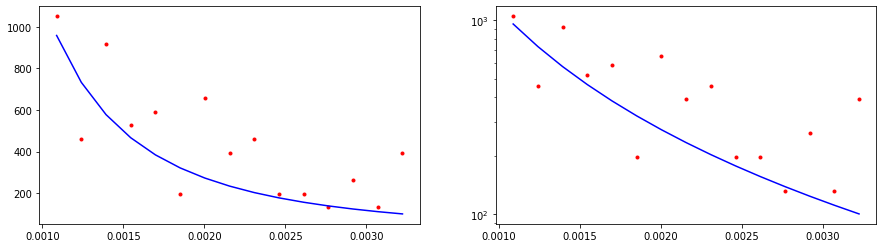

CPU times: user 364 µs, sys: 0 ns, total: 364 µs
Wall time: 261 µs
177263.49676970782


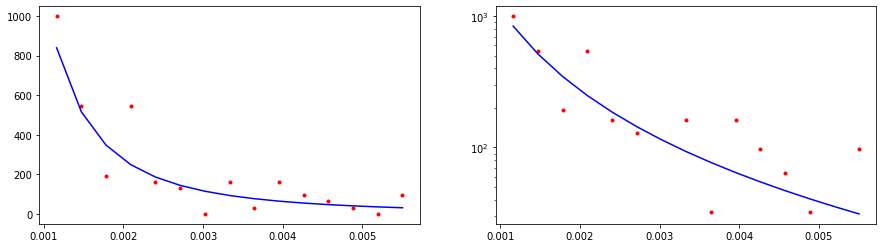

CPU times: user 311 µs, sys: 46 µs, total: 357 µs
Wall time: 262 µs
36413.583388748986


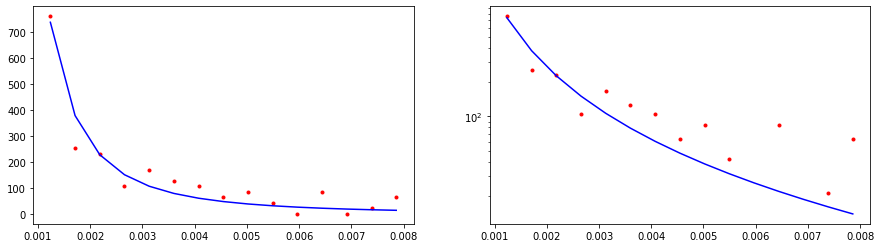

CPU times: user 484 µs, sys: 0 ns, total: 484 µs
Wall time: 317 µs
20338.703594503288


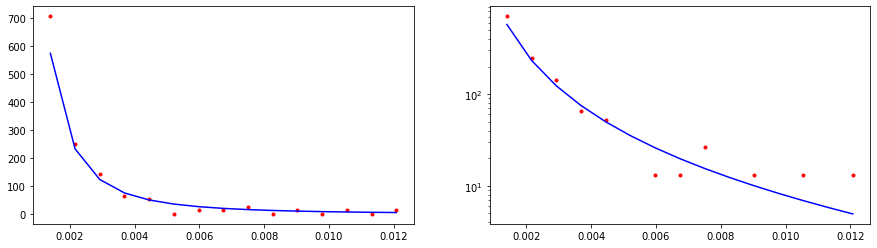

CPU times: user 479 µs, sys: 71 µs, total: 550 µs
Wall time: 370 µs
8442.813965523857


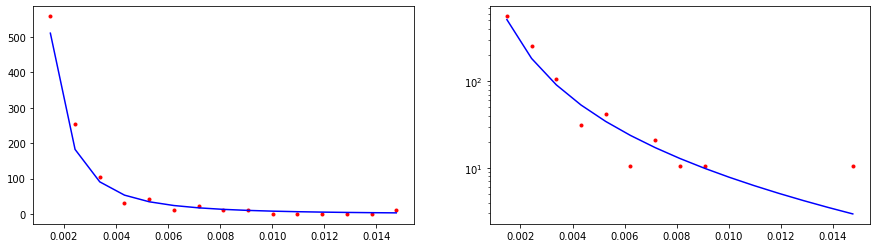

CPU times: user 477 µs, sys: 70 µs, total: 547 µs
Wall time: 375 µs
3192.0978970104507


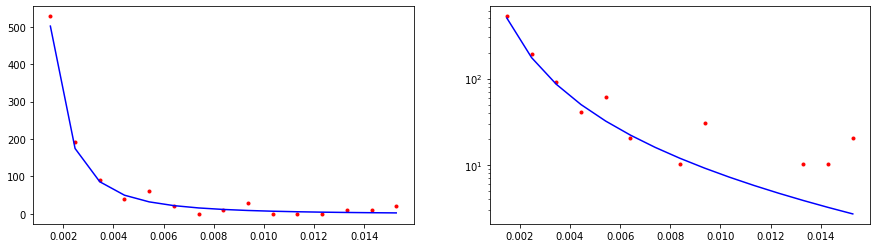

CPU times: user 523 µs, sys: 78 µs, total: 601 µs
Wall time: 427 µs
3986.0720714479276


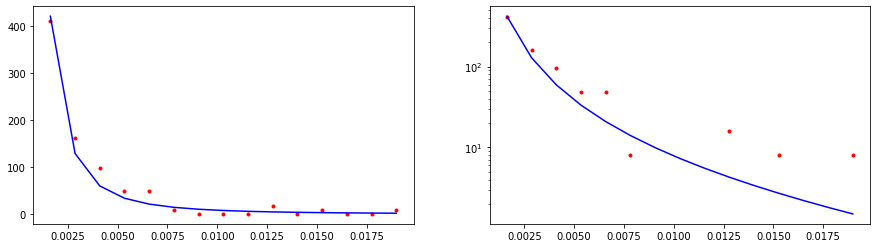

CPU times: user 583 µs, sys: 0 ns, total: 583 µs
Wall time: 408 µs
6237.850304515413


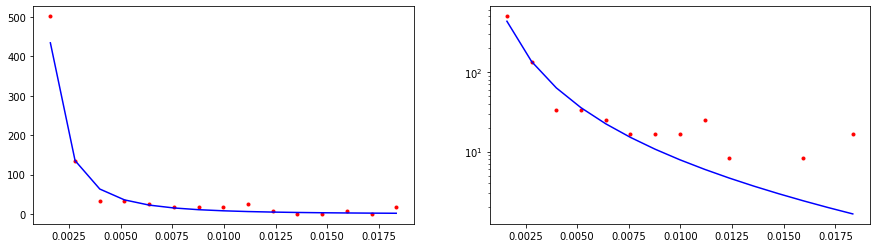

CPU times: user 629 µs, sys: 0 ns, total: 629 µs
Wall time: 455 µs
13521.51369341099


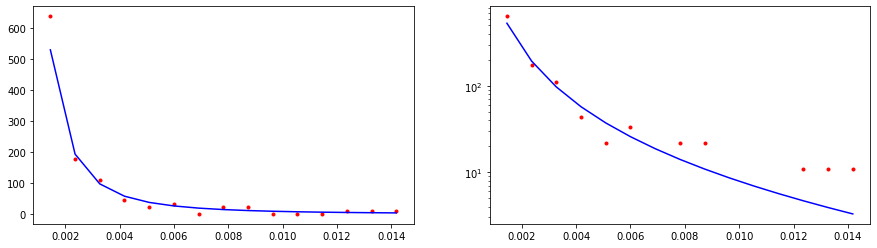

CPU times: user 737 µs, sys: 0 ns, total: 737 µs
Wall time: 564 µs
23900.12341713478


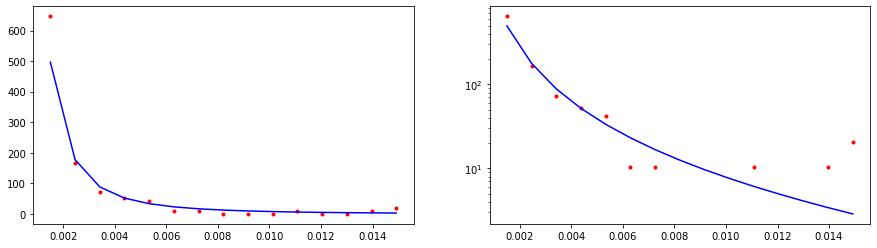

CPU times: user 688 µs, sys: 0 ns, total: 688 µs
Wall time: 518 µs
16728.580197871488


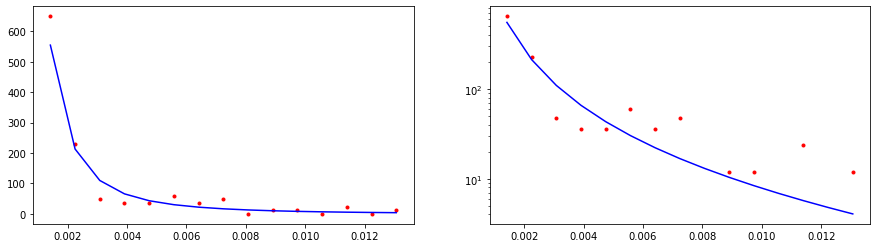

CPU times: user 626 µs, sys: 93 µs, total: 719 µs
Wall time: 547 µs
10705.573833343064


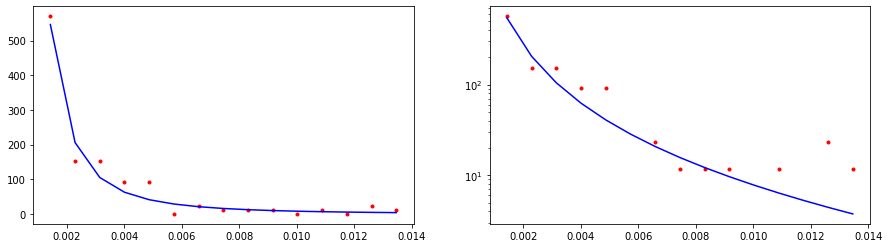

CPU times: user 761 µs, sys: 0 ns, total: 761 µs
Wall time: 593 µs
7870.405759332969


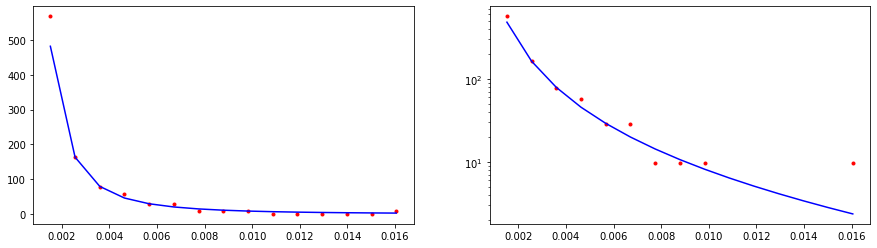

CPU times: user 609 µs, sys: 91 µs, total: 700 µs
Wall time: 583 µs
8751.451268831366


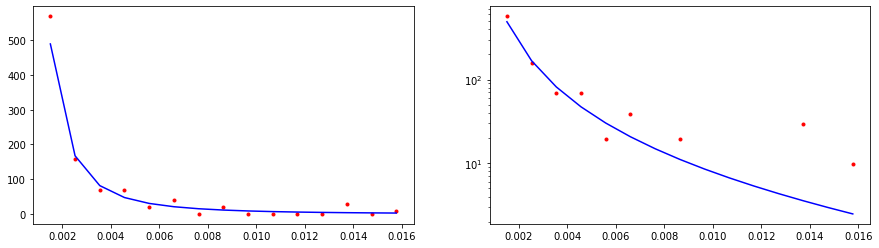

CPU times: user 702 µs, sys: 104 µs, total: 806 µs
Wall time: 630 µs
10790.64830610766


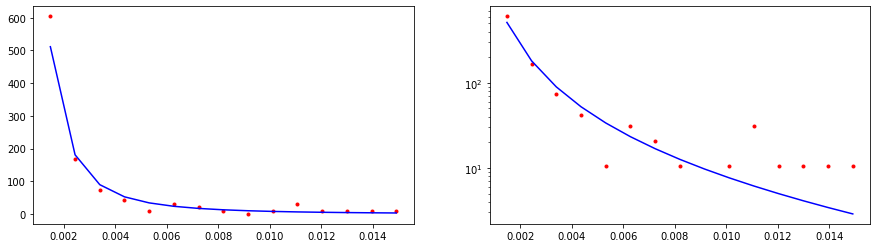

CPU times: user 873 µs, sys: 0 ns, total: 873 µs
Wall time: 690 µs
25624.840797908604


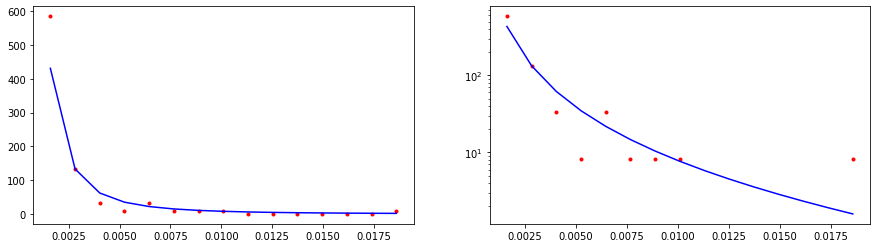

CPU times: user 930 µs, sys: 0 ns, total: 930 µs
Wall time: 756 µs
14694.566873129192


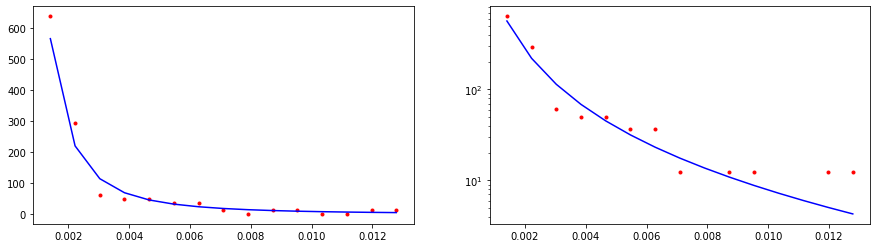

CPU times: user 934 µs, sys: 0 ns, total: 934 µs
Wall time: 710 µs
8664.033135163329


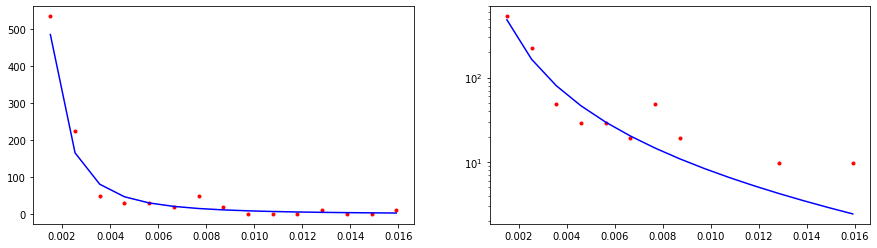

CPU times: user 970 µs, sys: 0 ns, total: 970 µs
Wall time: 778 µs
22247.958407128783


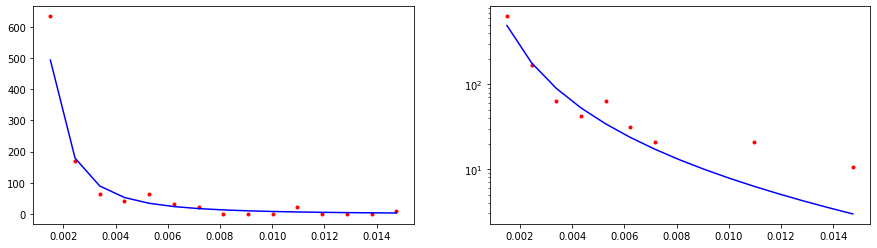

CPU times: user 980 µs, sys: 0 ns, total: 980 µs
Wall time: 807 µs
12465.800283621647


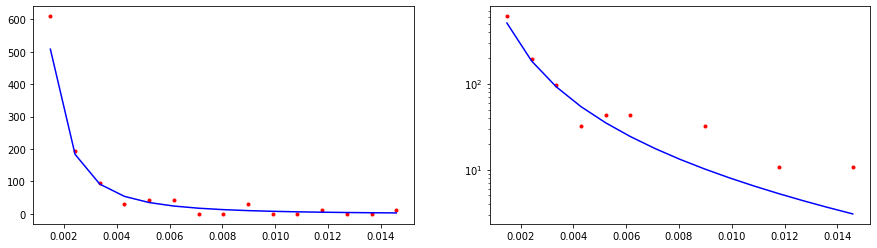

CPU times: user 1.02 ms, sys: 2 µs, total: 1.02 ms
Wall time: 840 µs
5990.341868562102


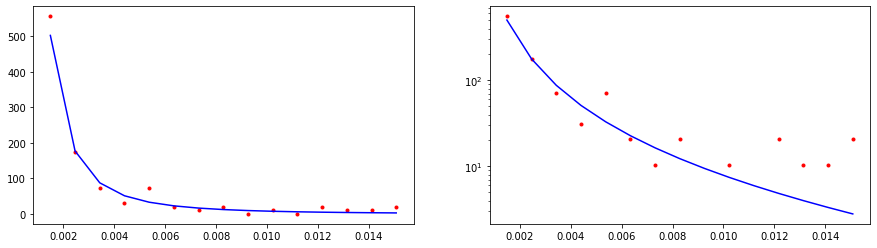

CPU times: user 1.02 ms, sys: 3 µs, total: 1.02 ms
Wall time: 846 µs
6679.813268449928


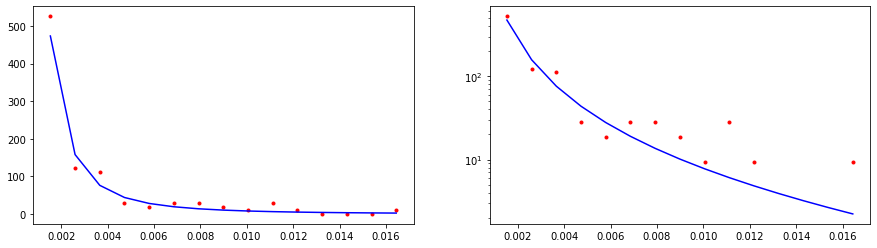

CPU times: user 1.14 ms, sys: 20 µs, total: 1.16 ms
Wall time: 977 µs
6586.246043940801


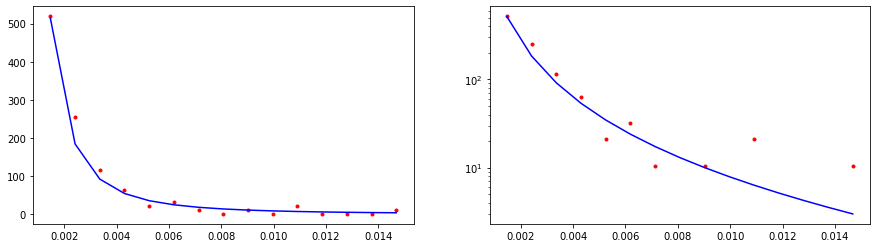

CPU times: user 1.12 ms, sys: 18 µs, total: 1.14 ms
Wall time: 952 µs
13291.190105835969


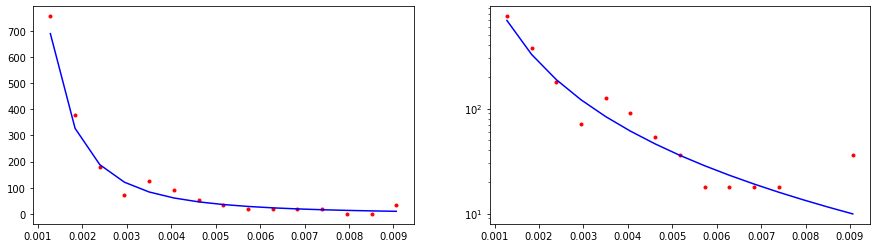

CPU times: user 1.09 ms, sys: 15 µs, total: 1.11 ms
Wall time: 933 µs
4904.106539788322


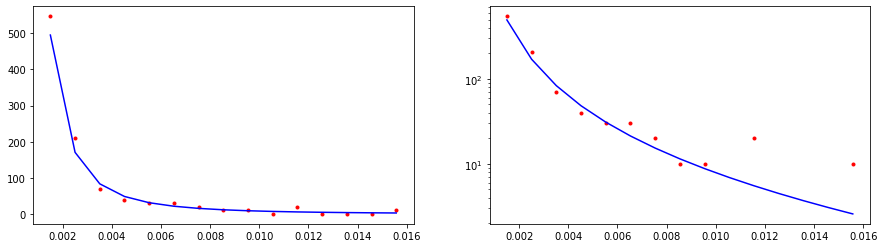

CPU times: user 1.16 ms, sys: 23 µs, total: 1.18 ms
Wall time: 999 µs
10801.51571224783


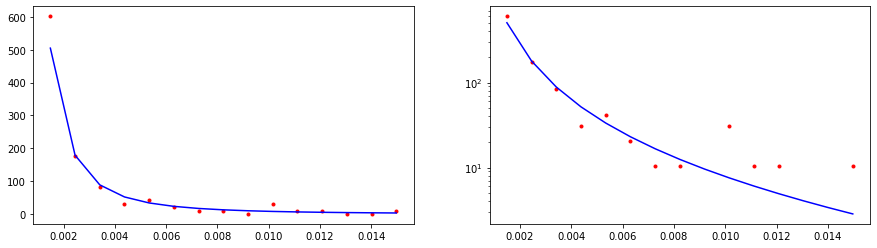

CPU times: user 1.14 ms, sys: 22 µs, total: 1.16 ms
Wall time: 975 µs
12854.064836136766


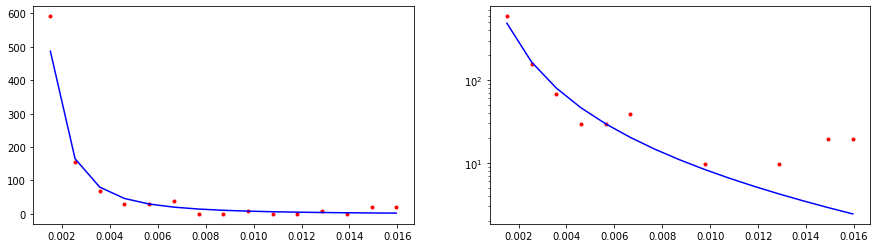

CPU times: user 313 µs, sys: 882 µs, total: 1.19 ms
Wall time: 1.01 ms
12815.963010228843


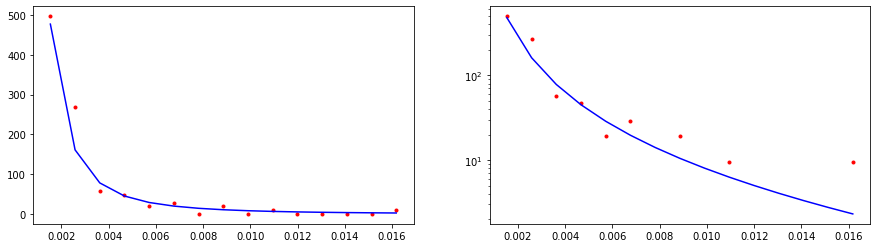

CPU times: user 1.29 ms, sys: 0 ns, total: 1.29 ms
Wall time: 1.1 ms
5564.778819362731


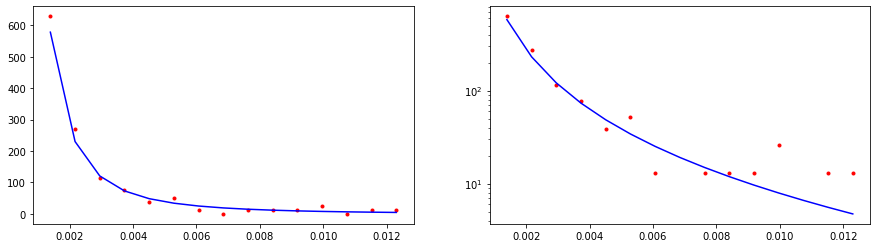

CPU times: user 0 ns, sys: 700 µs, total: 700 µs
Wall time: 442 µs
4728.155169538641


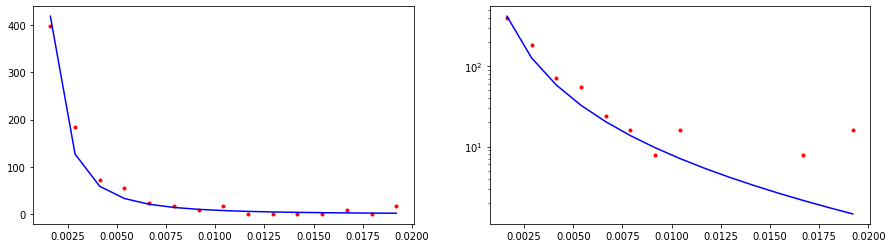

CPU times: user 0 ns, sys: 224 µs, total: 224 µs
Wall time: 186 µs
7963939.280796299


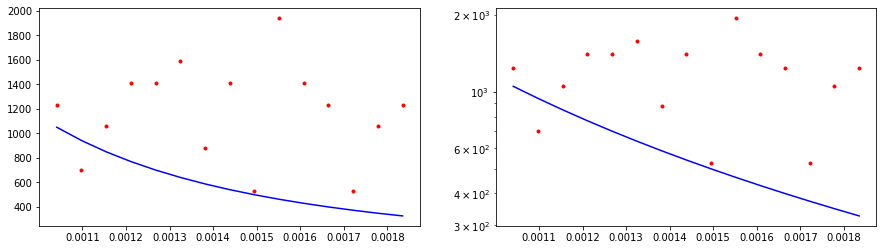

CPU times: user 220 µs, sys: 32 µs, total: 252 µs
Wall time: 218 µs
444608.9824492682


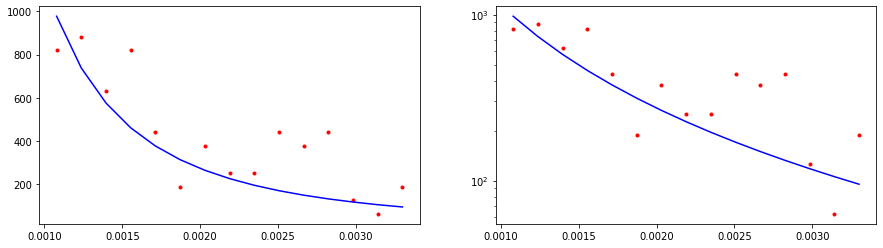

CPU times: user 0 ns, sys: 321 µs, total: 321 µs
Wall time: 283 µs
67665.86680921244


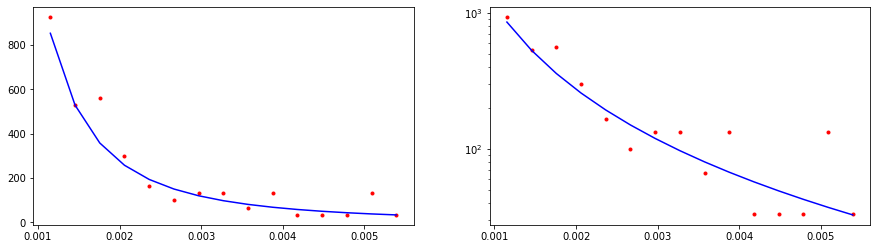

CPU times: user 0 ns, sys: 363 µs, total: 363 µs
Wall time: 264 µs
52222.18475674993


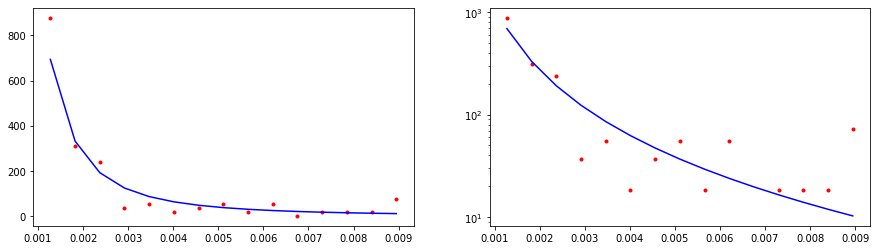

CPU times: user 511 µs, sys: 0 ns, total: 511 µs
Wall time: 337 µs
18903.70340215573


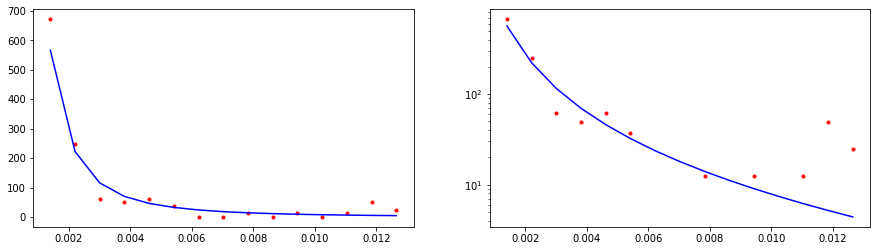

CPU times: user 447 µs, sys: 67 µs, total: 514 µs
Wall time: 332 µs
12224.82009478955


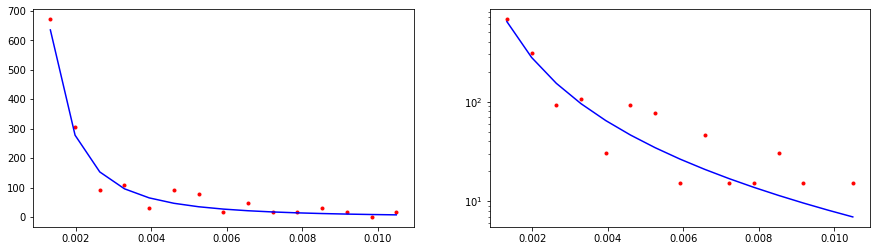

CPU times: user 0 ns, sys: 577 µs, total: 577 µs
Wall time: 387 µs
12448.21460532889


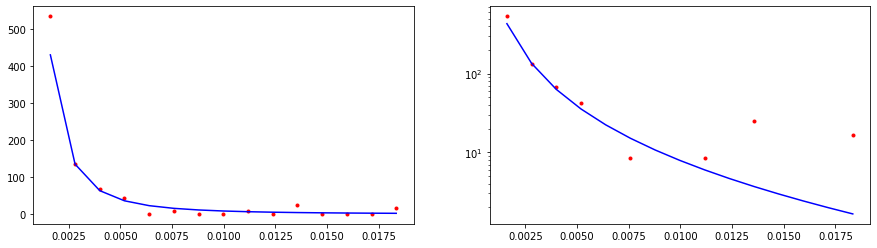

CPU times: user 0 ns, sys: 583 µs, total: 583 µs
Wall time: 410 µs
15491.98258115708


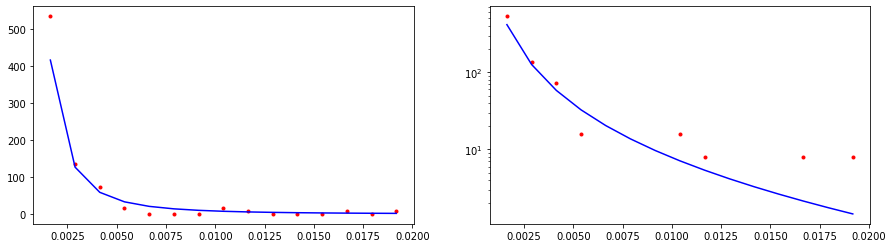

CPU times: user 481 µs, sys: 71 µs, total: 552 µs
Wall time: 382 µs
3557.374016085663


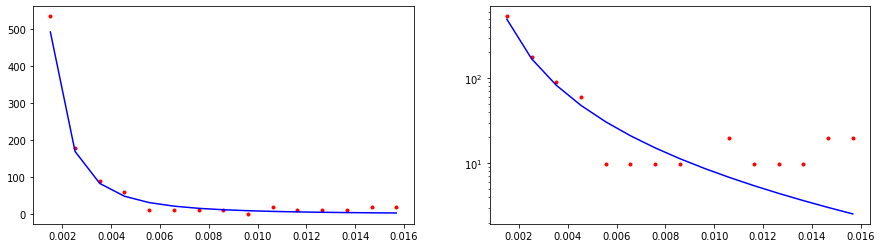

CPU times: user 698 µs, sys: 0 ns, total: 698 µs
Wall time: 514 µs
12674.238908658348


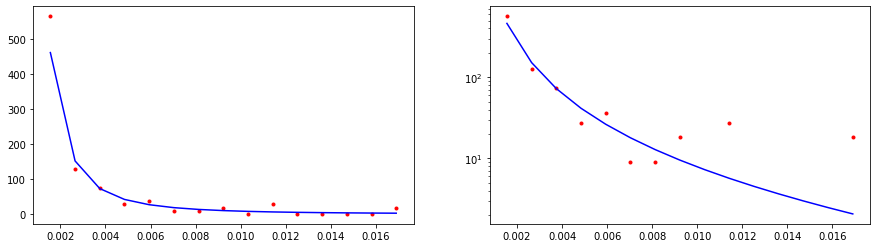

CPU times: user 529 µs, sys: 79 µs, total: 608 µs
Wall time: 442 µs
9796.64840449595


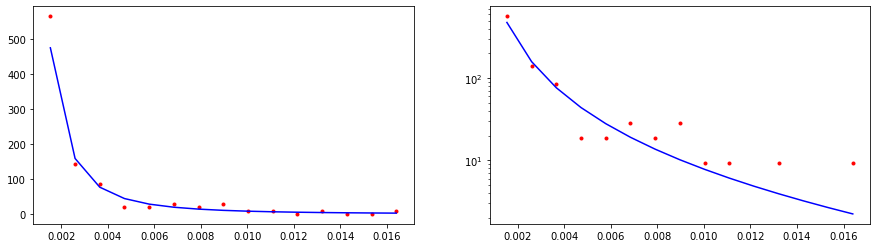

CPU times: user 0 ns, sys: 690 µs, total: 690 µs
Wall time: 511 µs
24282.571288198116


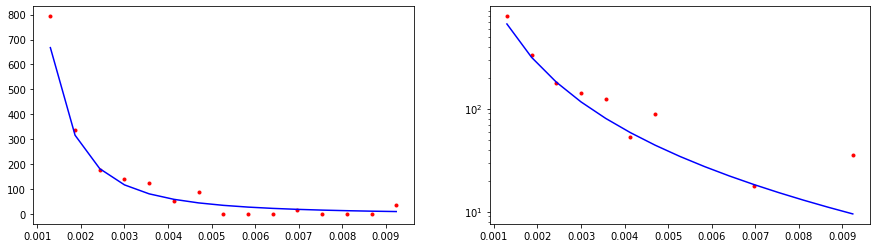

CPU times: user 0 ns, sys: 788 µs, total: 788 µs
Wall time: 596 µs
3518.287125211421


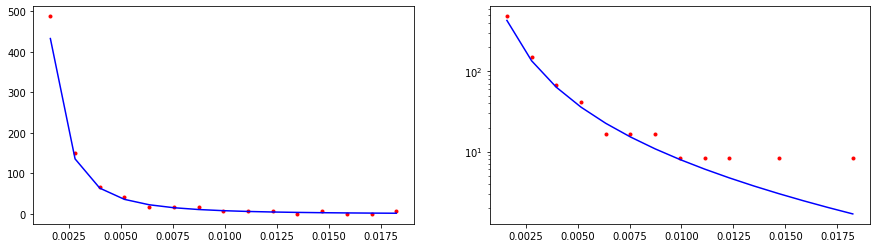

CPU times: user 721 µs, sys: 0 ns, total: 721 µs
Wall time: 621 µs
17835.984309043597


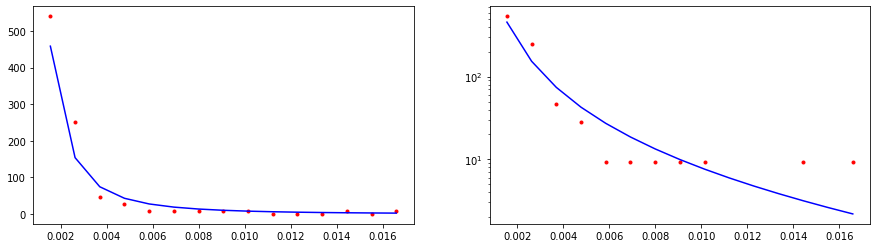

CPU times: user 833 µs, sys: 0 ns, total: 833 µs
Wall time: 649 µs
9725.565979191922


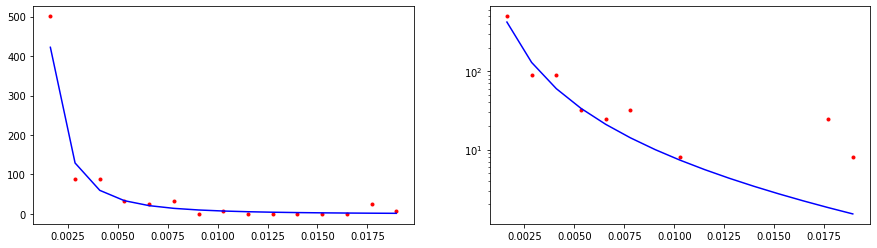

CPU times: user 848 µs, sys: 0 ns, total: 848 µs
Wall time: 657 µs
13652.027759290215


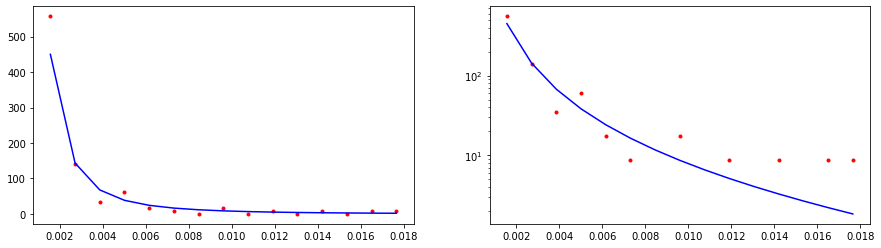

CPU times: user 823 µs, sys: 0 ns, total: 823 µs
Wall time: 652 µs
13382.024027884918


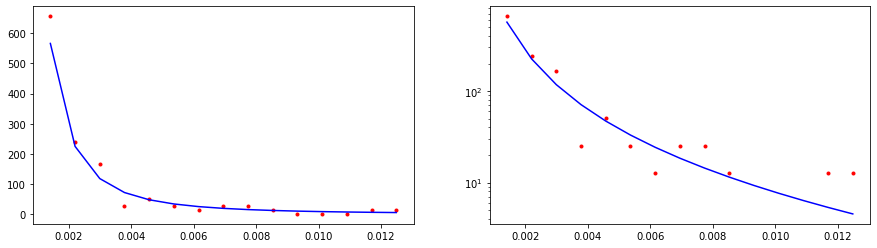

CPU times: user 870 µs, sys: 0 ns, total: 870 µs
Wall time: 689 µs
7848.179172962075


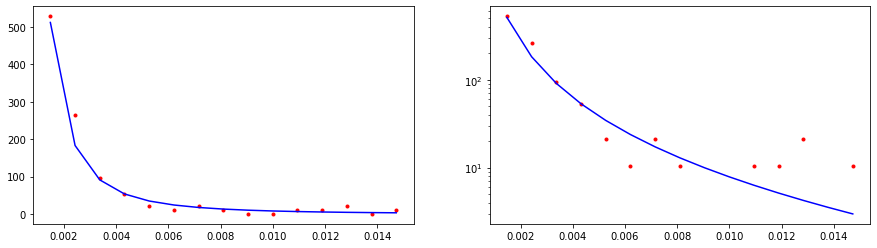

CPU times: user 976 µs, sys: 0 ns, total: 976 µs
Wall time: 787 µs
11528.78519767512


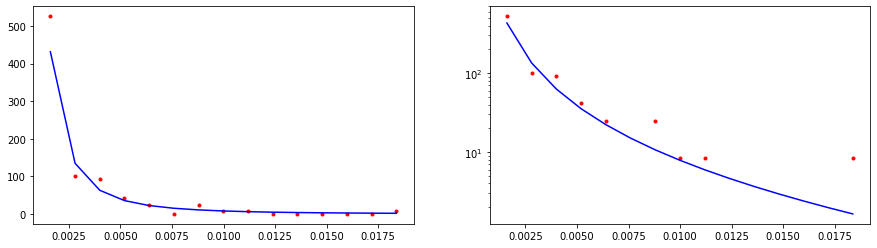

CPU times: user 967 µs, sys: 0 ns, total: 967 µs
Wall time: 795 µs
23917.045858848003


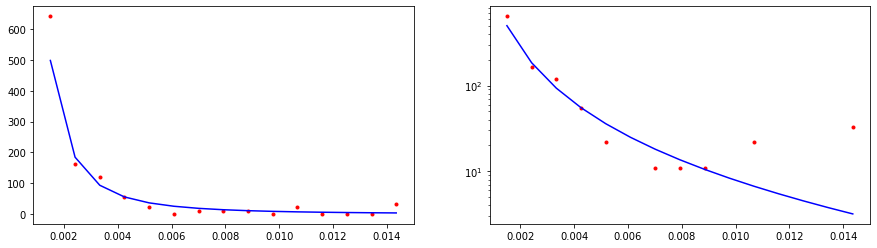

CPU times: user 961 µs, sys: 0 ns, total: 961 µs
Wall time: 783 µs
19907.024637553794


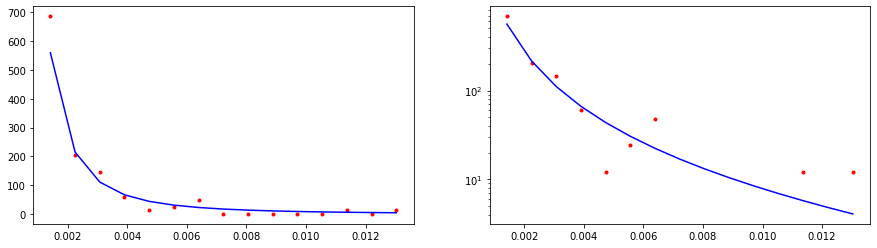

CPU times: user 988 µs, sys: 0 ns, total: 988 µs
Wall time: 806 µs
23165.27208390374


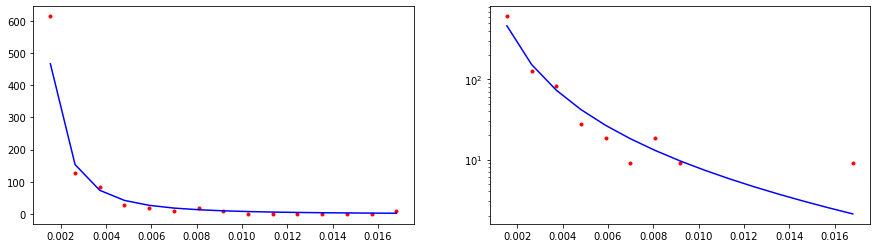

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 923 µs
13472.051504569663


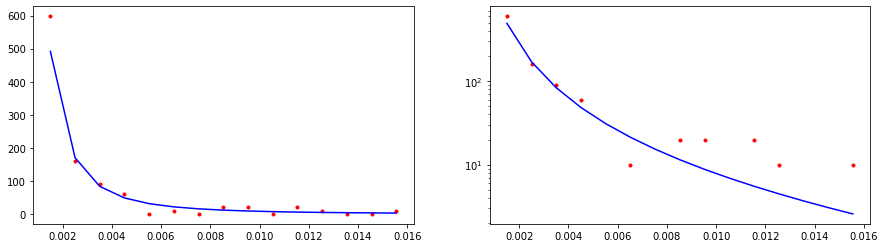

CPU times: user 993 µs, sys: 0 ns, total: 993 µs
Wall time: 870 µs
5554.455824524353


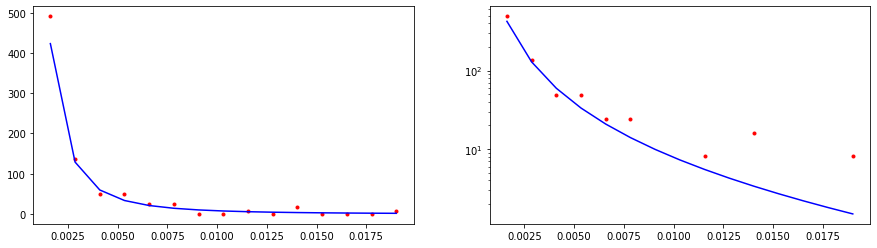

CPU times: user 1.08 ms, sys: 13 µs, total: 1.09 ms
Wall time: 904 µs
24683.59897565514


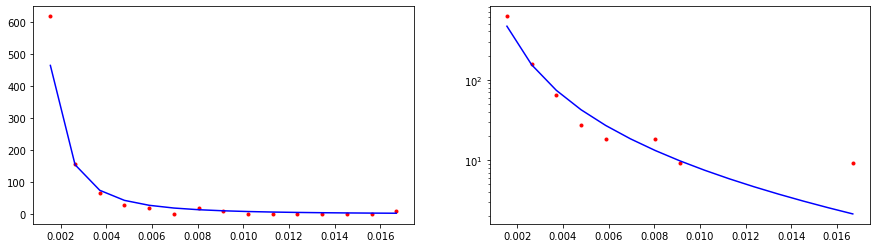

CPU times: user 1.11 ms, sys: 17 µs, total: 1.13 ms
Wall time: 949 µs
22833.520083561507


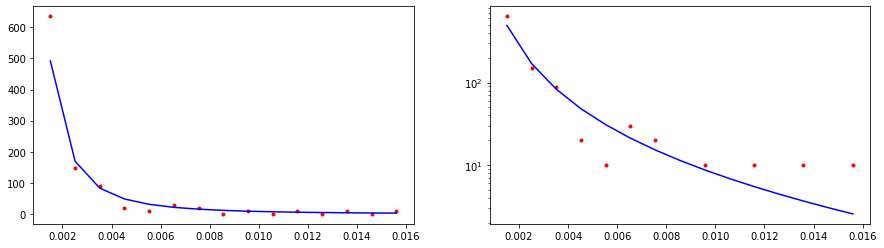

CPU times: user 1.11 ms, sys: 17 µs, total: 1.12 ms
Wall time: 943 µs
3673.588981852926


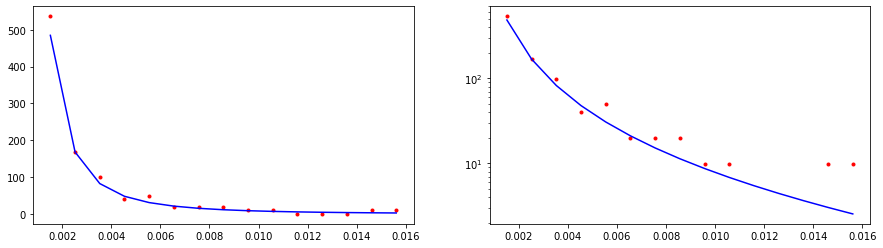

CPU times: user 1.13 ms, sys: 21 µs, total: 1.16 ms
Wall time: 983 µs
8107.149056298104


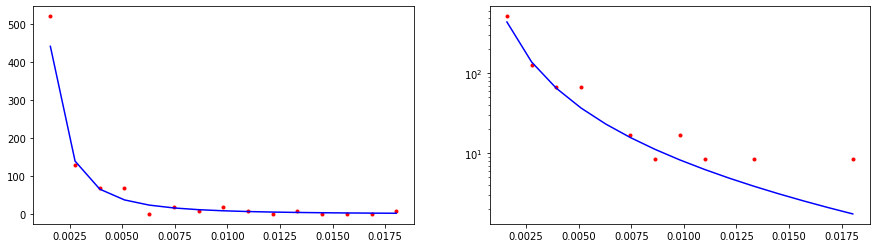

CPU times: user 1.19 ms, sys: 29 µs, total: 1.22 ms
Wall time: 1.02 ms
32671.017698496737


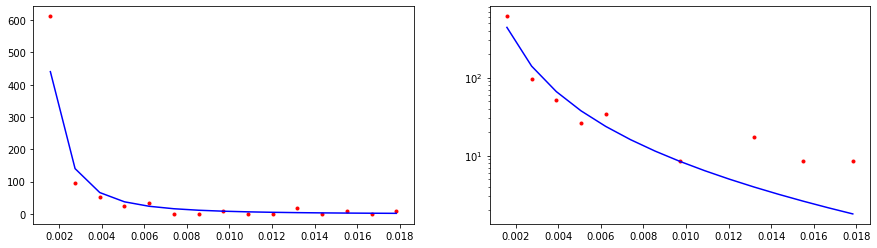

CPU times: user 1.37 ms, sys: 0 ns, total: 1.37 ms
Wall time: 1.17 ms
23839.27337349132


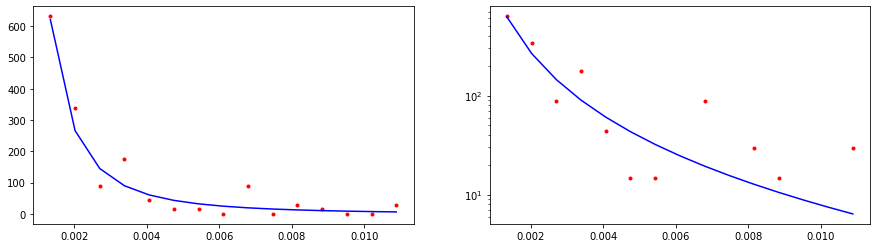

CPU times: user 668 µs, sys: 0 ns, total: 668 µs
Wall time: 425 µs
11761.970838687585


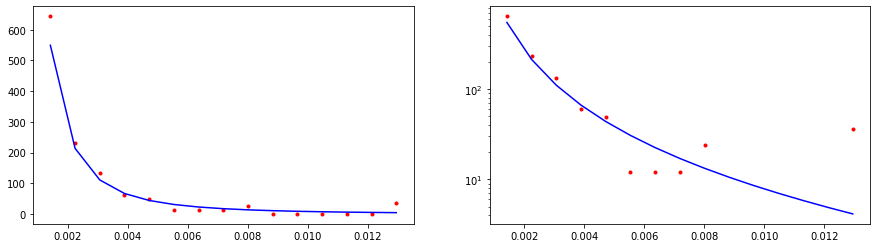

CPU times: user 195 µs, sys: 29 µs, total: 224 µs
Wall time: 184 µs
8704453.974256098


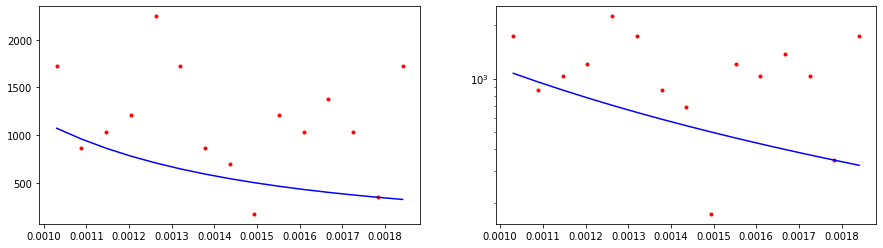

CPU times: user 259 µs, sys: 38 µs, total: 297 µs
Wall time: 205 µs
324226.82914722426


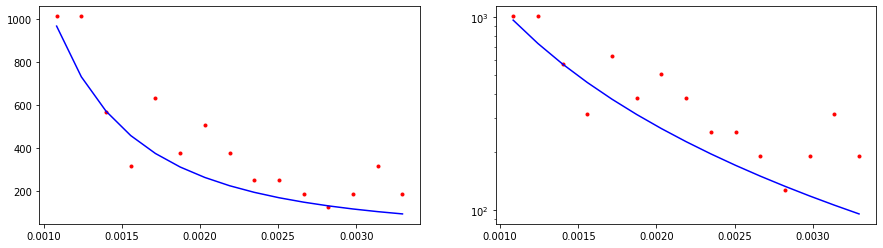

CPU times: user 344 µs, sys: 52 µs, total: 396 µs
Wall time: 294 µs
146008.67126779555


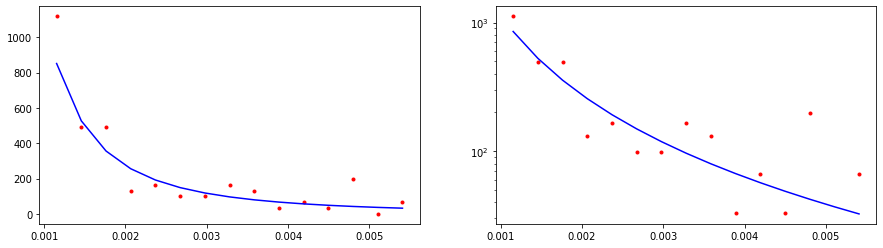

CPU times: user 277 µs, sys: 42 µs, total: 319 µs
Wall time: 282 µs
114375.99508234173


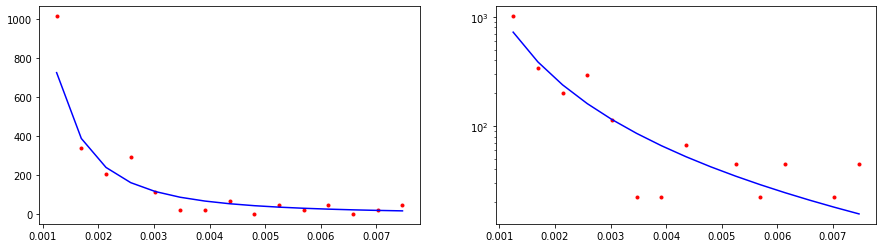

CPU times: user 473 µs, sys: 0 ns, total: 473 µs
Wall time: 305 µs
21964.730225249816


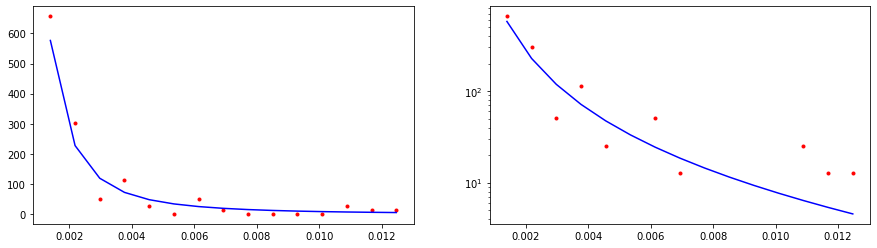

CPU times: user 435 µs, sys: 66 µs, total: 501 µs
Wall time: 329 µs
7066.911199303411


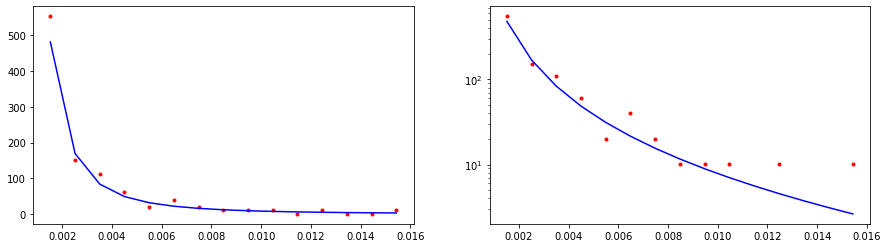

CPU times: user 0 ns, sys: 531 µs, total: 531 µs
Wall time: 357 µs
5586.400001886267


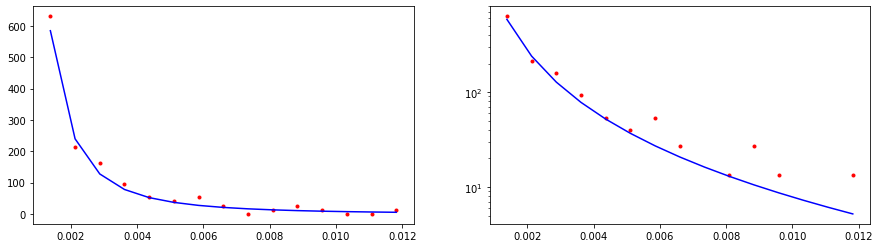

CPU times: user 665 µs, sys: 0 ns, total: 665 µs
Wall time: 485 µs
8092.411496432014


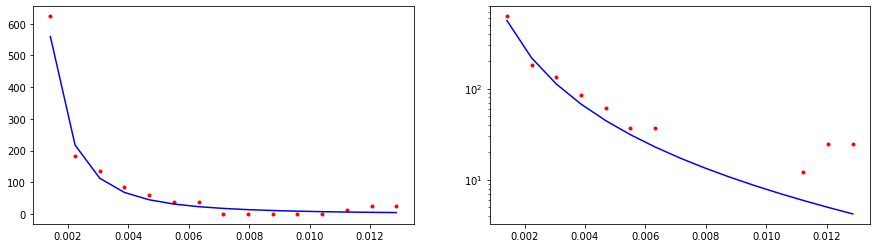

CPU times: user 0 ns, sys: 622 µs, total: 622 µs
Wall time: 445 µs
29517.540195944974


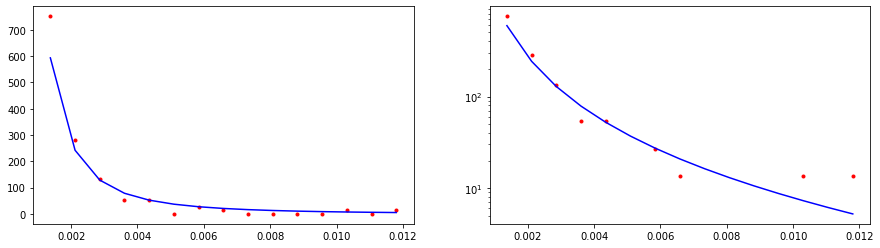

CPU times: user 676 µs, sys: 0 ns, total: 676 µs
Wall time: 487 µs
25404.917254288106


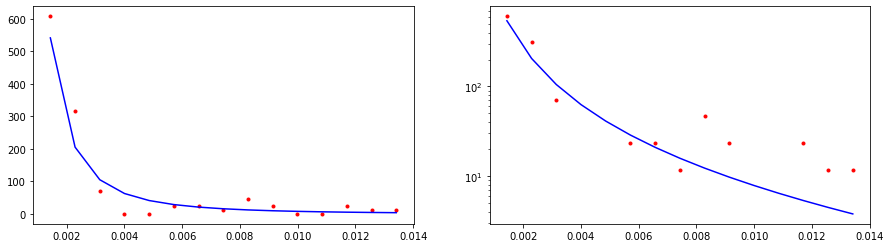

CPU times: user 677 µs, sys: 0 ns, total: 677 µs
Wall time: 497 µs
19409.932170428197


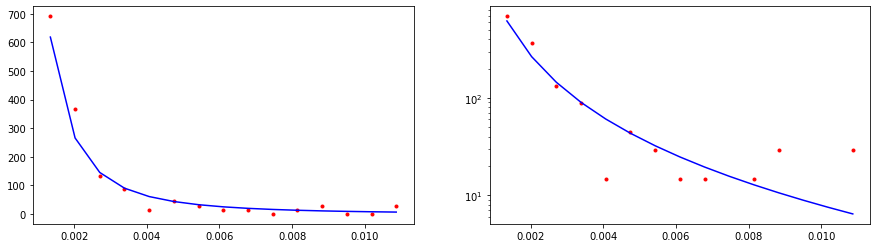

CPU times: user 693 µs, sys: 0 ns, total: 693 µs
Wall time: 511 µs
11731.900528243186


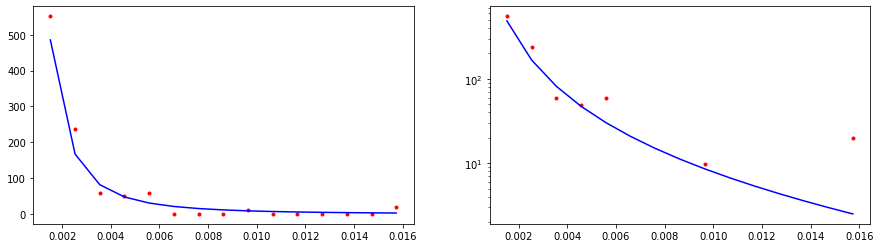

CPU times: user 660 µs, sys: 99 µs, total: 759 µs
Wall time: 552 µs
5272.336487385859


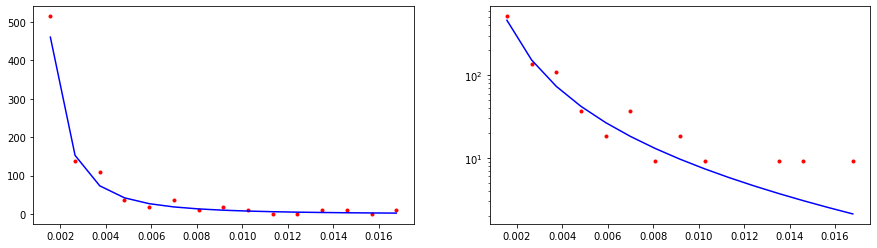

CPU times: user 805 µs, sys: 0 ns, total: 805 µs
Wall time: 628 µs
17297.047691277883


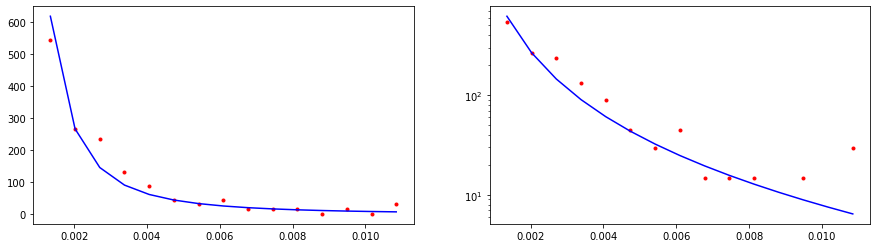

CPU times: user 714 µs, sys: 108 µs, total: 822 µs
Wall time: 649 µs
14122.930351223673


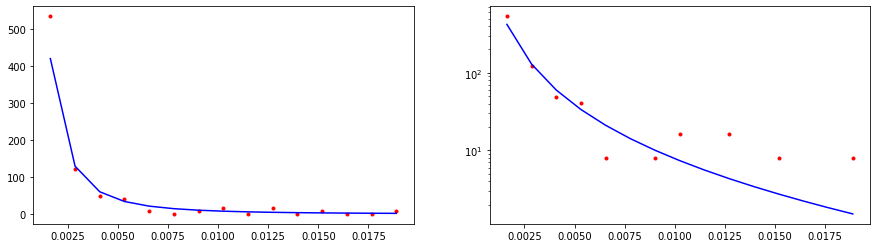

CPU times: user 806 µs, sys: 0 ns, total: 806 µs
Wall time: 626 µs
21475.15970951313


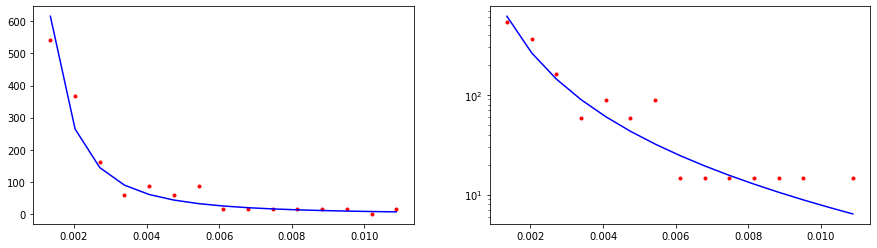

CPU times: user 843 µs, sys: 0 ns, total: 843 µs
Wall time: 664 µs
21618.209603215324


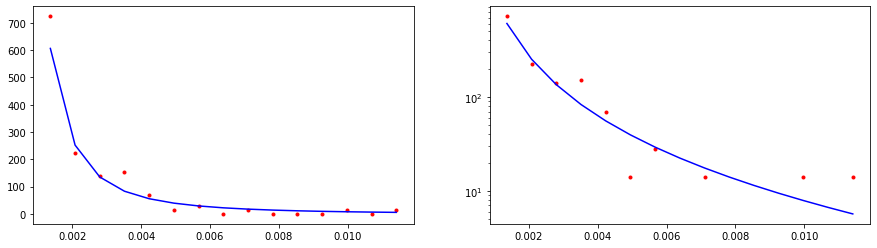

CPU times: user 909 µs, sys: 0 ns, total: 909 µs
Wall time: 709 µs
7760.501298016493


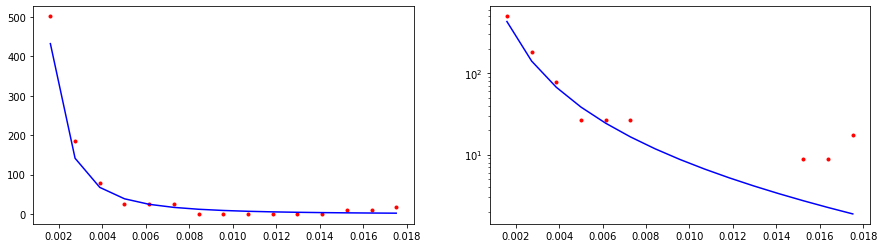

CPU times: user 0 ns, sys: 943 µs, total: 943 µs
Wall time: 736 µs
10173.033948634748


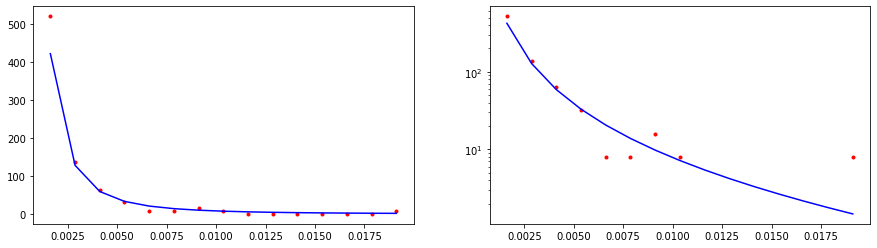

CPU times: user 933 µs, sys: 0 ns, total: 933 µs
Wall time: 755 µs
28835.967519467617


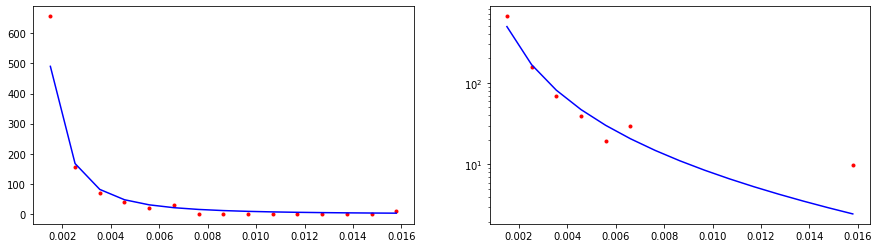

CPU times: user 943 µs, sys: 0 ns, total: 943 µs
Wall time: 770 µs
2868.467024228822


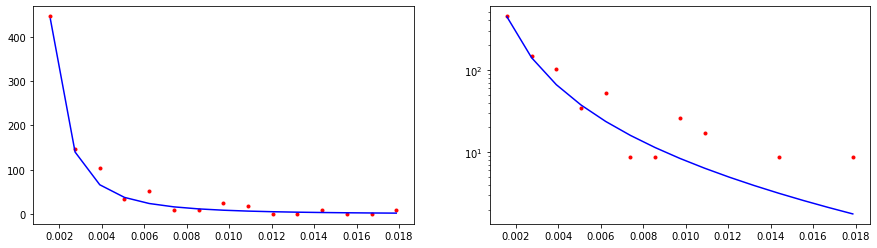

CPU times: user 1.04 ms, sys: 6 µs, total: 1.04 ms
Wall time: 844 µs
10857.561585005924


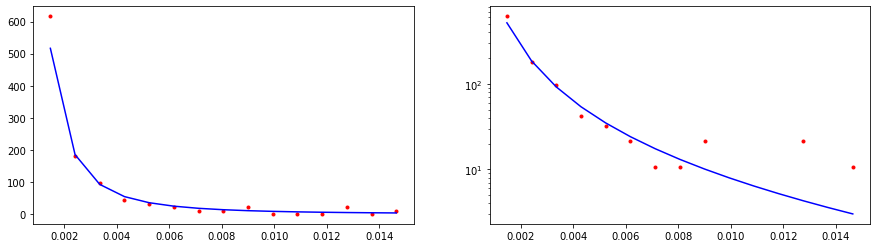

CPU times: user 1.01 ms, sys: 1e+03 ns, total: 1.01 ms
Wall time: 835 µs
3245.295350357862


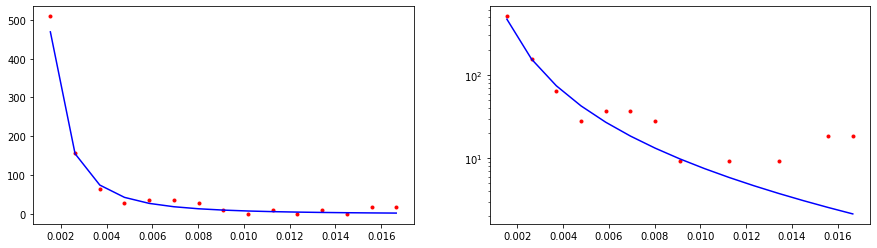

CPU times: user 976 µs, sys: 0 ns, total: 976 µs
Wall time: 863 µs
3645.6031454734775


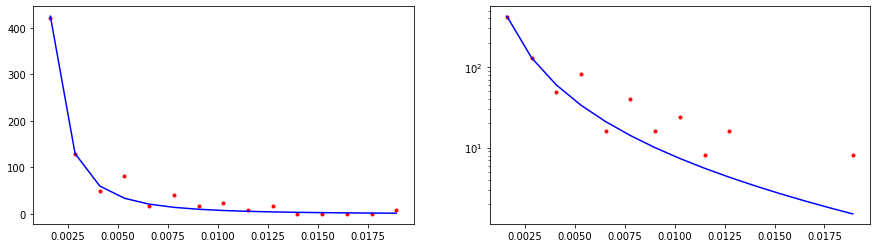

CPU times: user 1.05 ms, sys: 8 µs, total: 1.06 ms
Wall time: 892 µs
10380.43319322752


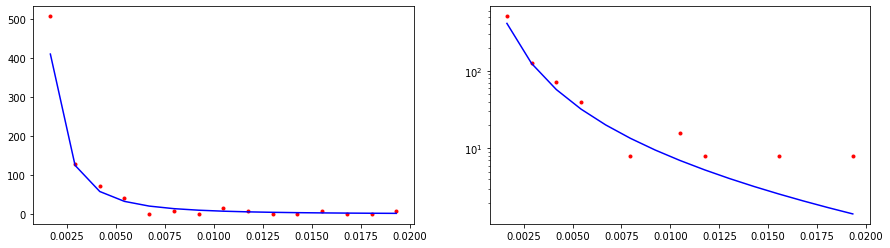

CPU times: user 1.07 ms, sys: 11 µs, total: 1.08 ms
Wall time: 906 µs
17034.8184466545


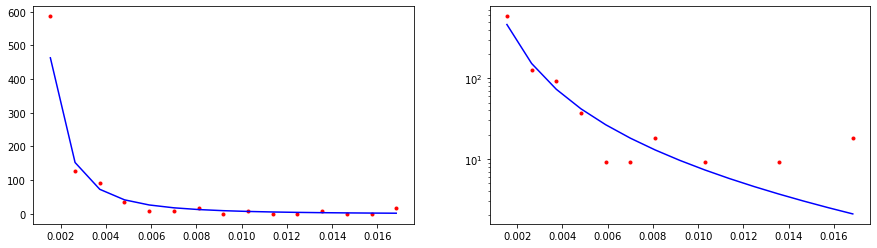

CPU times: user 1.16 ms, sys: 24 µs, total: 1.19 ms
Wall time: 1.01 ms
27476.254283644037


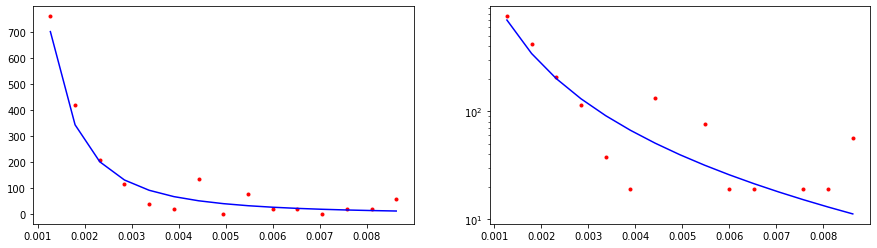

CPU times: user 1.2 ms, sys: 0 ns, total: 1.2 ms
Wall time: 993 µs
29147.546843862572


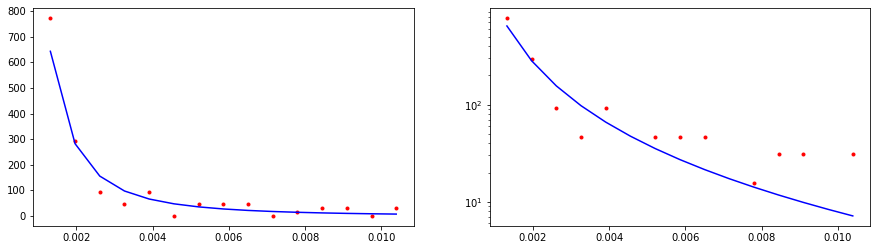

CPU times: user 1.19 ms, sys: 0 ns, total: 1.19 ms
Wall time: 1.01 ms
6446.899945125966


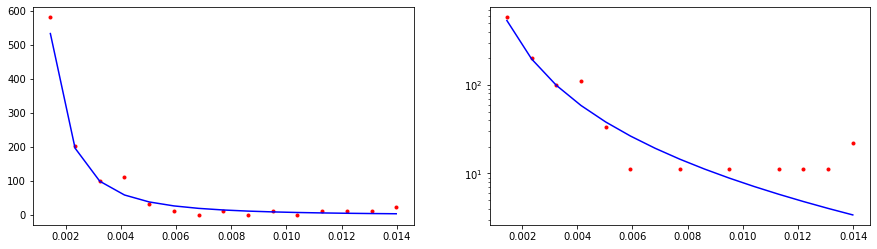

CPU times: user 1.23 ms, sys: 34 µs, total: 1.26 ms
Wall time: 1.04 ms
6237.318534998643


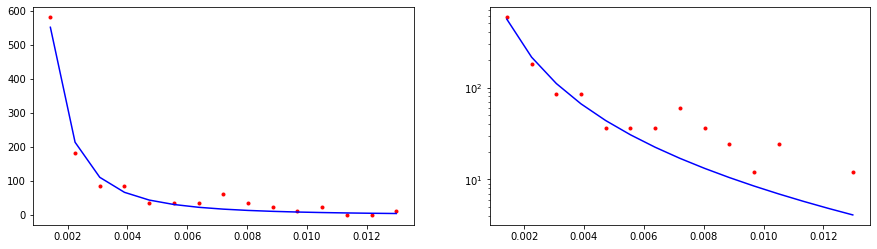

CPU times: user 710 µs, sys: 0 ns, total: 710 µs
Wall time: 454 µs
5323.388390667577


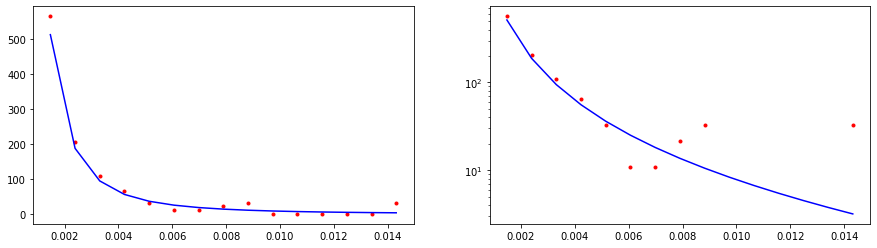

In [44]:
for _ in range(loops):
    for nn_iter in n_iter:
        evran.set_rutherford_iterations(nn_iter)
        %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
        S_everest[nn_iter] = np.array([ *S_everest[nn_iter], test_random(r_everest, bins, f) ])
    %time r_k2 = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_K2 = np.array([ *S_K2, test_random(r_k2, bins, f) ])

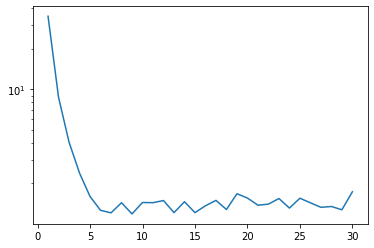

In [49]:
fig, ax = plt.subplots(1, 1)
ax.plot(n_iter, [ np.sqrt((S_everest[nn_iter] / S_K2).mean()) for nn_iter in n_iter ])
ax.set_yscale('log')

In [40]:
evran.set_random_seed(1669281221)
k2ran.set_random_seed(1669281221)

mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)
cgen = k2ran.initialise_random_ruth(zatom=z, emr=emr, hcut=t1)

n = 100
n_iter = [5, 6, 7, 8, 9, 10, 15, 20, 25, 30, 35, 40, 45, 50]
bins = 15

loops = 20
S_everest = { nn: [] for nn in n_iter }
S_K2 = []
f = lambda x: PDF(x,z,emr)/CDF(t1,z,emr)

CPU times: user 399 µs, sys: 47 µs, total: 446 µs
Wall time: 307 µs
57899.96939728616


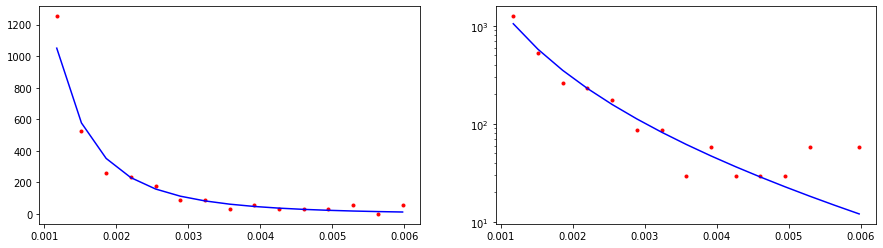

CPU times: user 573 µs, sys: 0 ns, total: 573 µs
Wall time: 396 µs
167552.2408140122


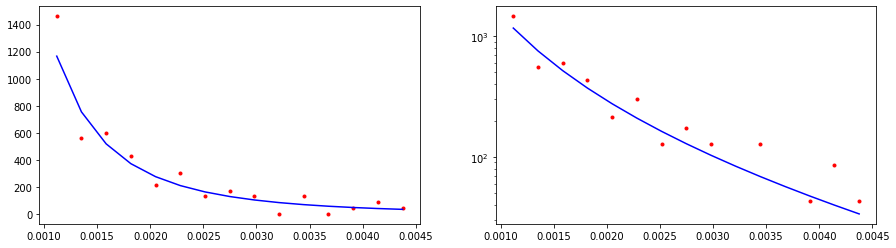

CPU times: user 560 µs, sys: 0 ns, total: 560 µs
Wall time: 441 µs
22812.688222652014


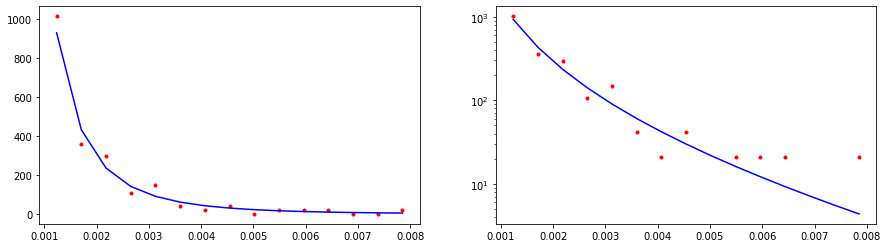

CPU times: user 646 µs, sys: 0 ns, total: 646 µs
Wall time: 470 µs
12265.492672805276


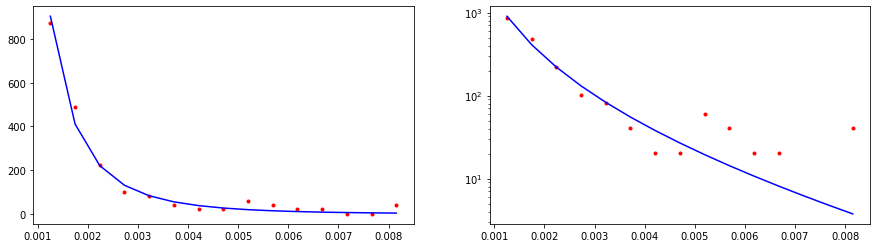

CPU times: user 564 µs, sys: 66 µs, total: 630 µs
Wall time: 458 µs
66517.45136196747


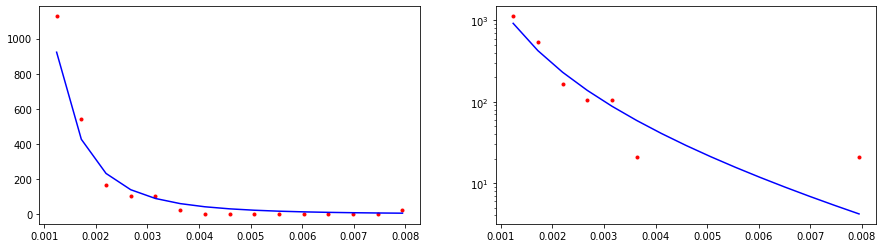

CPU times: user 0 ns, sys: 750 µs, total: 750 µs
Wall time: 546 µs
18105.312323088543


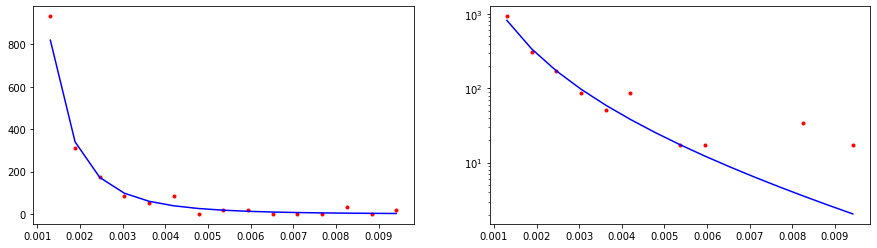

CPU times: user 821 µs, sys: 0 ns, total: 821 µs
Wall time: 644 µs
51873.75400637643


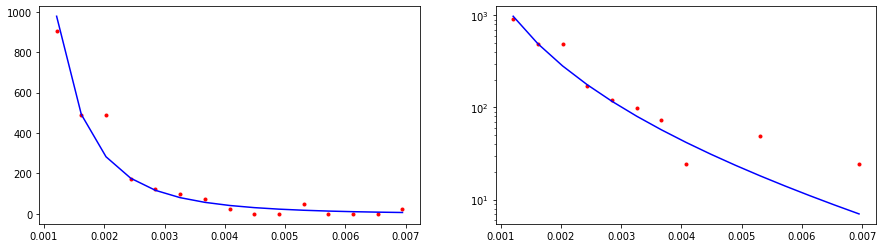

CPU times: user 1.05 ms, sys: 16 µs, total: 1.07 ms
Wall time: 887 µs
48060.7088496573


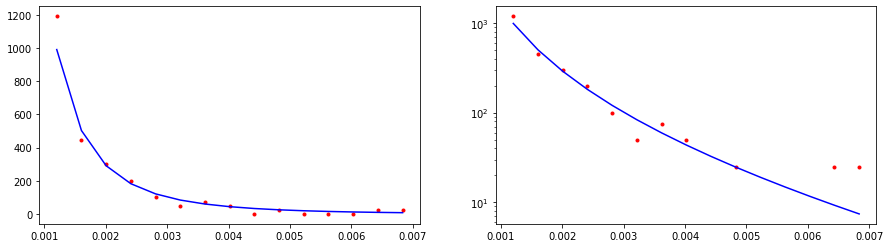

CPU times: user 1.17 ms, sys: 20 µs, total: 1.19 ms
Wall time: 1.02 ms
51874.31026533473


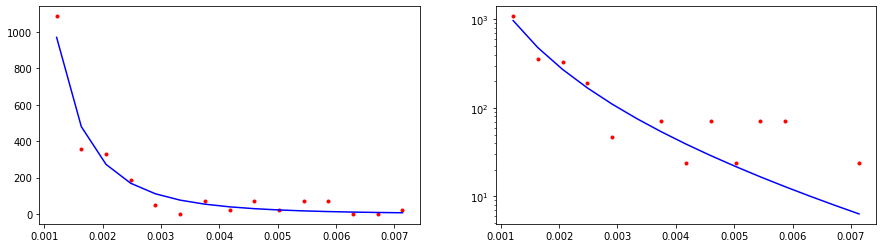

CPU times: user 1.38 ms, sys: 45 µs, total: 1.42 ms
Wall time: 1.24 ms
39284.56679100548


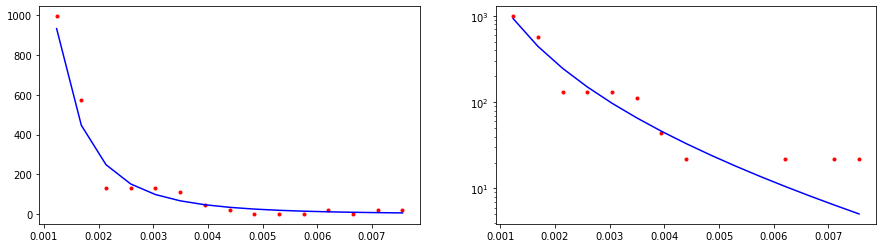

CPU times: user 1.59 ms, sys: 0 ns, total: 1.59 ms
Wall time: 1.41 ms
28017.070818642453


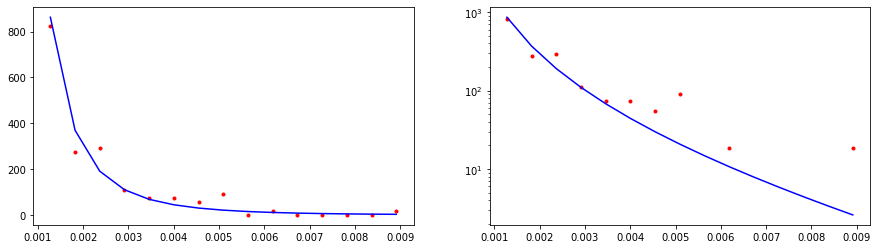

CPU times: user 890 µs, sys: 832 µs, total: 1.72 ms
Wall time: 1.53 ms
41104.769596717764


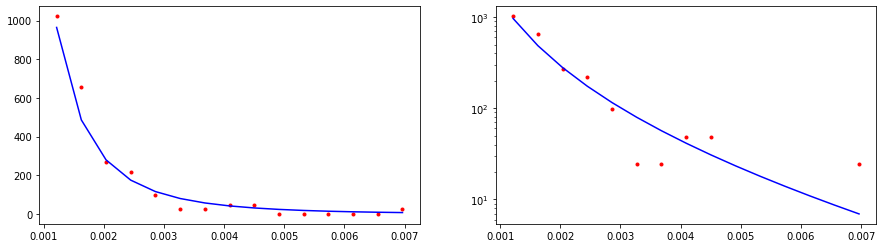

CPU times: user 1.69 ms, sys: 82 µs, total: 1.77 ms
Wall time: 1.59 ms
39143.616270354585


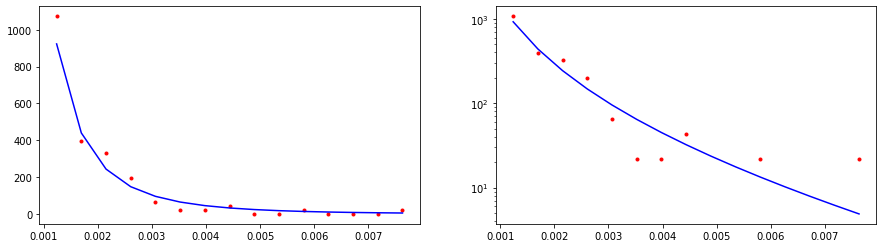

CPU times: user 2.06 ms, sys: 9 µs, total: 2.07 ms
Wall time: 1.89 ms
53474.36465991499


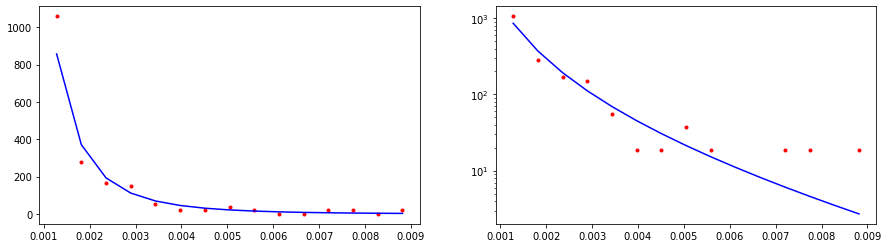

CPU times: user 636 µs, sys: 76 µs, total: 712 µs
Wall time: 461 µs
7552.302351638086


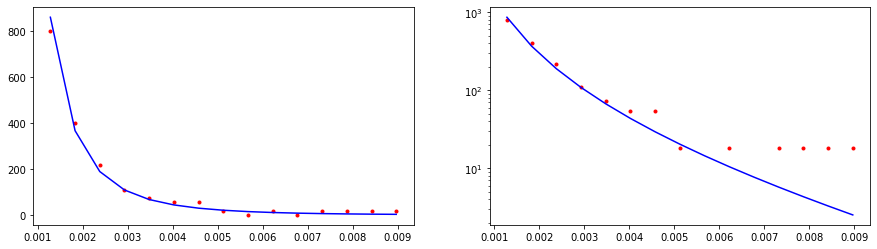

CPU times: user 465 µs, sys: 0 ns, total: 465 µs
Wall time: 304 µs
46116.27463227634


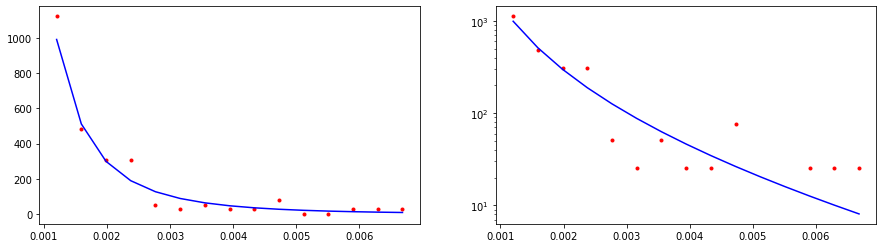

CPU times: user 410 µs, sys: 49 µs, total: 459 µs
Wall time: 337 µs
103068.9641840589


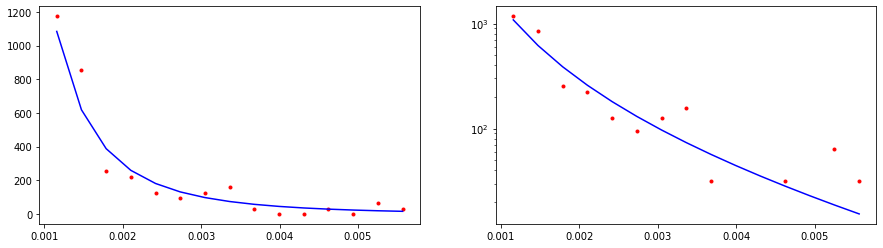

CPU times: user 497 µs, sys: 59 µs, total: 556 µs
Wall time: 381 µs
78983.64271063182


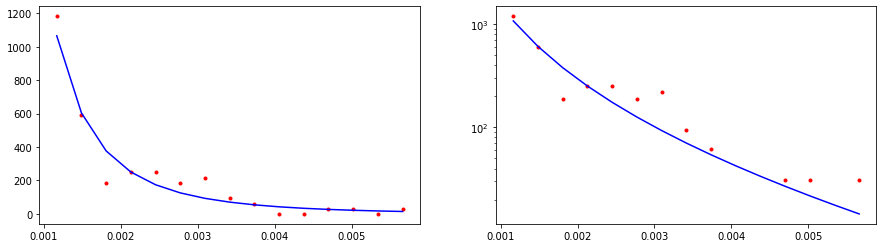

CPU times: user 0 ns, sys: 606 µs, total: 606 µs
Wall time: 437 µs
12006.066764027155


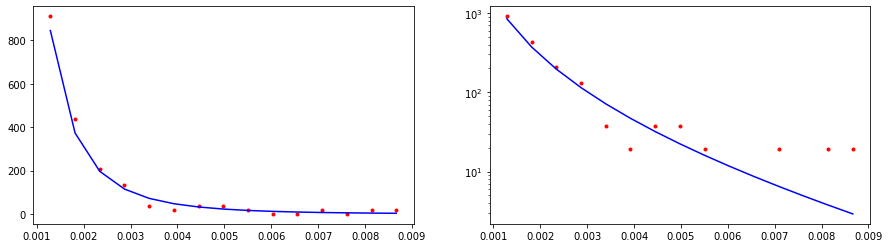

CPU times: user 606 µs, sys: 72 µs, total: 678 µs
Wall time: 491 µs
26337.128870916007


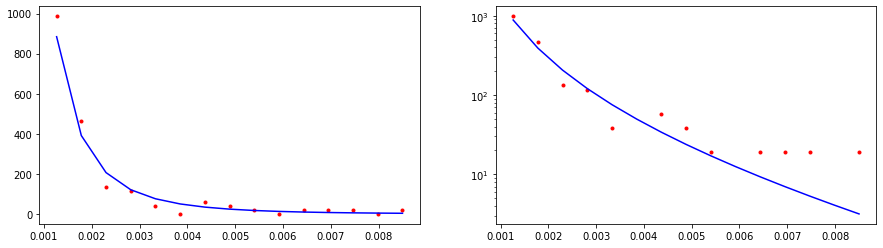

CPU times: user 695 µs, sys: 0 ns, total: 695 µs
Wall time: 520 µs
34759.769588894786


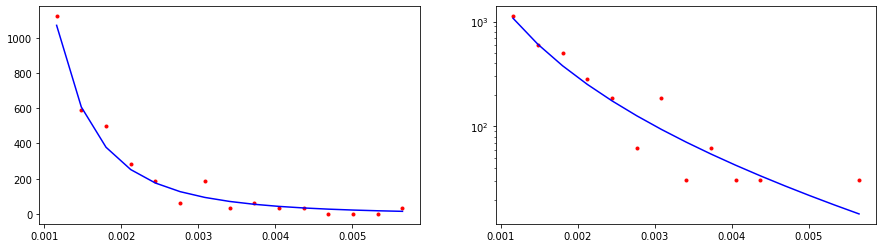

CPU times: user 814 µs, sys: 0 ns, total: 814 µs
Wall time: 685 µs
65805.83293335632


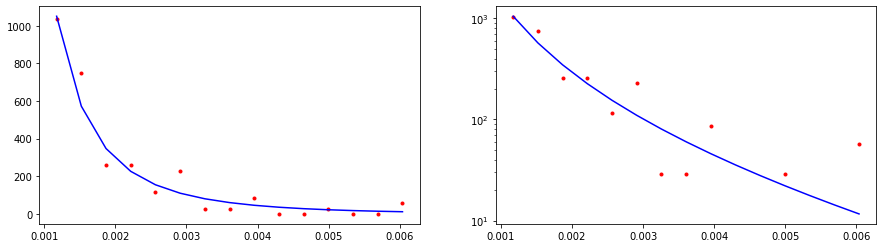

CPU times: user 1.01 ms, sys: 2 µs, total: 1.01 ms
Wall time: 820 µs
17497.194731994274


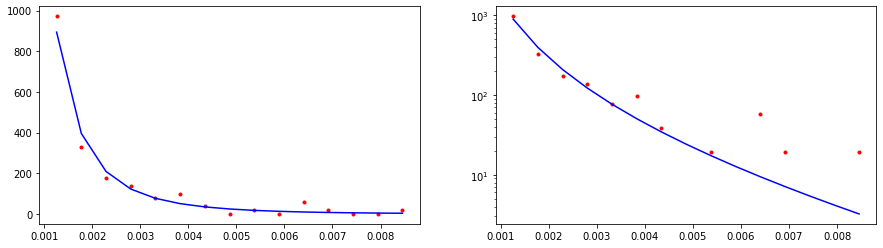

CPU times: user 456 µs, sys: 775 µs, total: 1.23 ms
Wall time: 1.05 ms
46319.27009749542


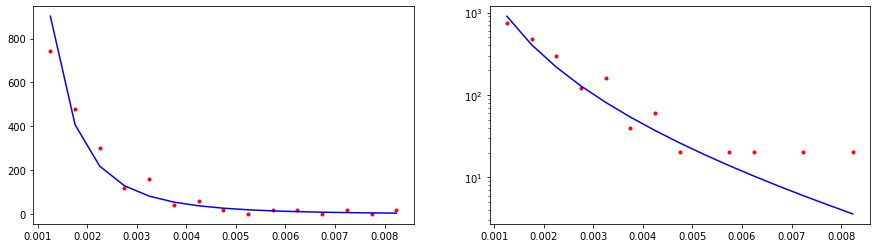

CPU times: user 1.42 ms, sys: 0 ns, total: 1.42 ms
Wall time: 1.24 ms
21251.04196673336


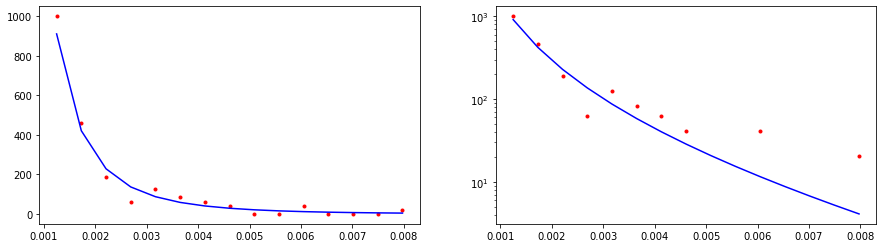

CPU times: user 1.55 ms, sys: 0 ns, total: 1.55 ms
Wall time: 1.37 ms
36410.88714870651


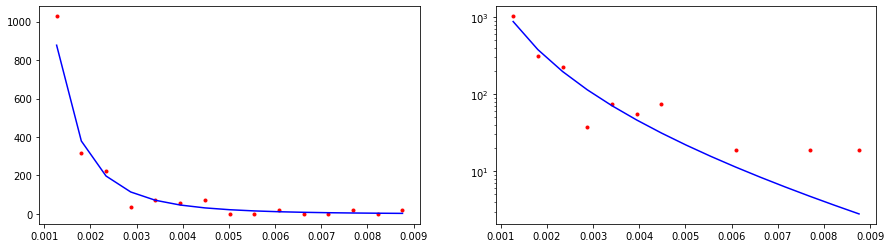

CPU times: user 1.7 ms, sys: 0 ns, total: 1.7 ms
Wall time: 1.51 ms
80661.0812020915


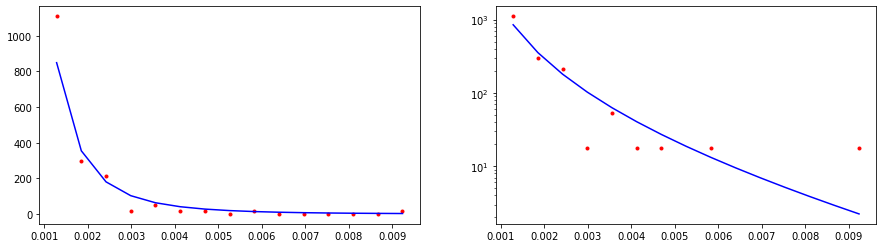

CPU times: user 1.71 ms, sys: 0 ns, total: 1.71 ms
Wall time: 1.59 ms
49382.046708878355


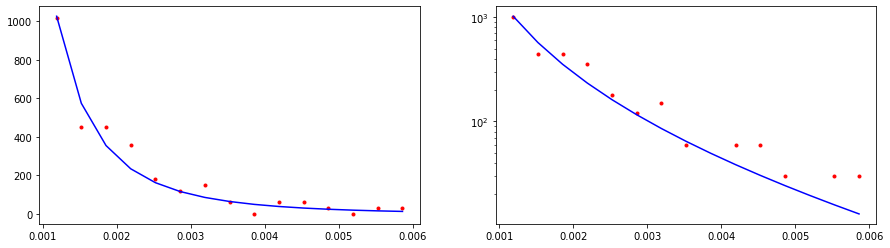

CPU times: user 1.84 ms, sys: 0 ns, total: 1.84 ms
Wall time: 1.72 ms
21581.146857902884


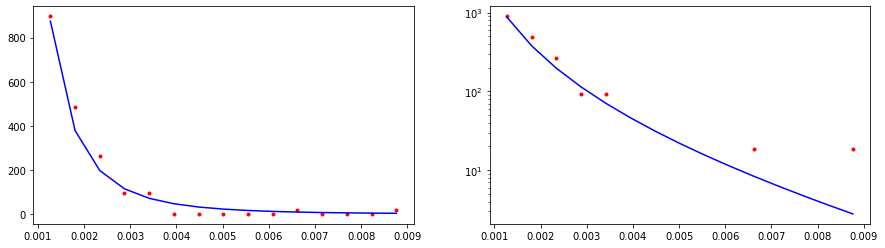

CPU times: user 644 µs, sys: 76 µs, total: 720 µs
Wall time: 468 µs
65645.00786352043


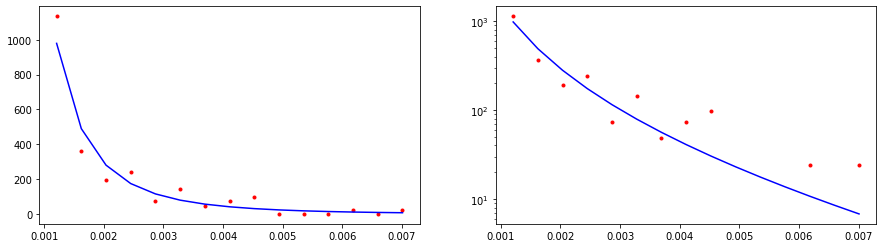

CPU times: user 0 ns, sys: 555 µs, total: 555 µs
Wall time: 383 µs
45419.98230940325


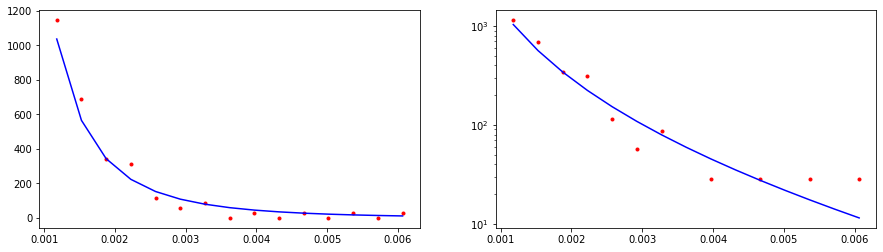

CPU times: user 487 µs, sys: 58 µs, total: 545 µs
Wall time: 378 µs
16676.885527884355


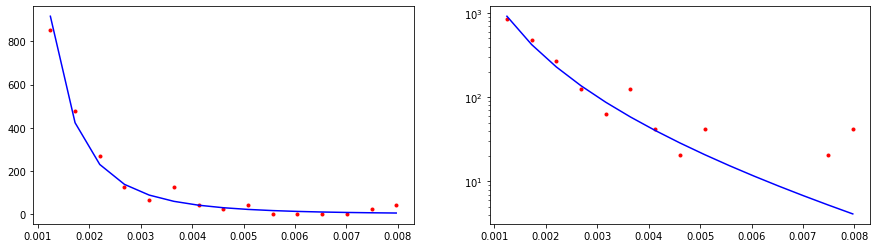

CPU times: user 579 µs, sys: 0 ns, total: 579 µs
Wall time: 409 µs
46610.4074488501


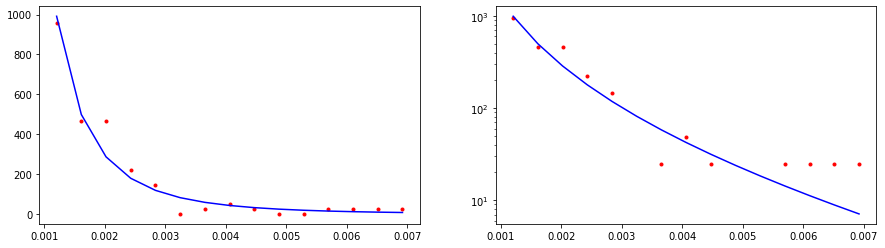

CPU times: user 631 µs, sys: 0 ns, total: 631 µs
Wall time: 463 µs
18426.64385645301


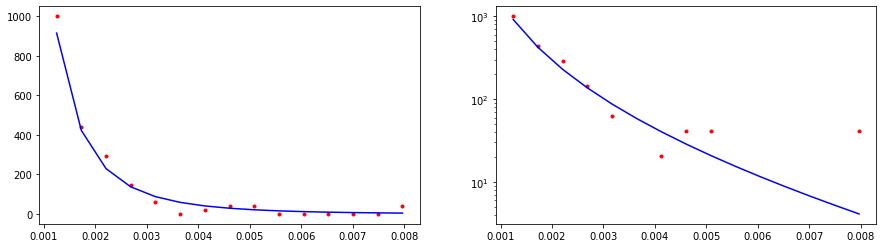

CPU times: user 589 µs, sys: 70 µs, total: 659 µs
Wall time: 484 µs
32687.37948266394


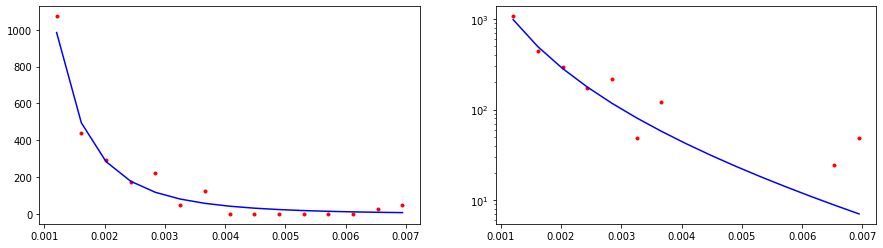

CPU times: user 702 µs, sys: 0 ns, total: 702 µs
Wall time: 520 µs
27104.928443311197


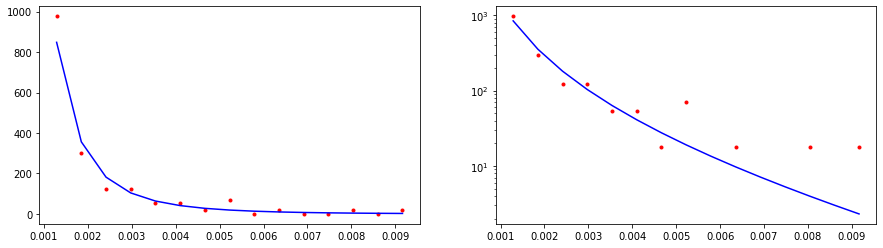

CPU times: user 843 µs, sys: 0 ns, total: 843 µs
Wall time: 685 µs
38979.9330458578


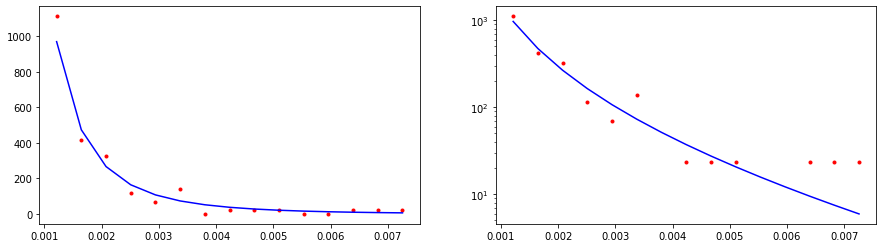

CPU times: user 1.06 ms, sys: 8 µs, total: 1.07 ms
Wall time: 897 µs
47354.138989646024


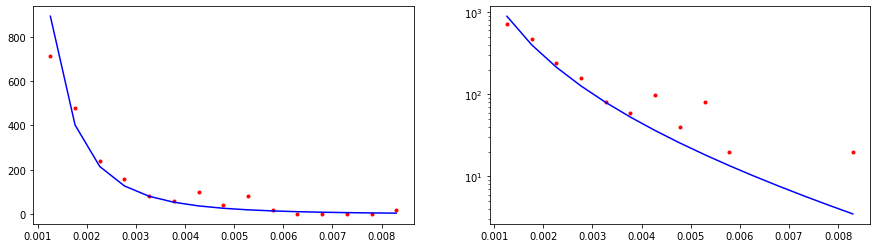

CPU times: user 1.22 ms, sys: 27 µs, total: 1.25 ms
Wall time: 1.07 ms
152944.8051279703


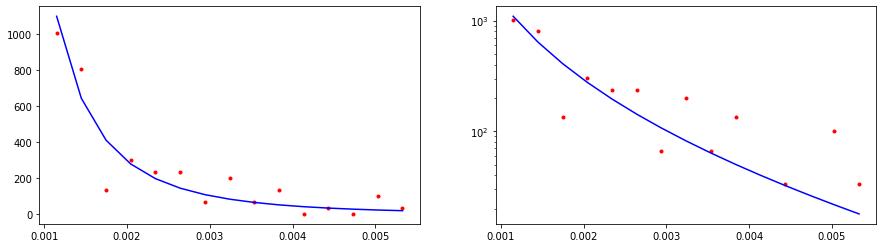

CPU times: user 1.17 ms, sys: 21 µs, total: 1.19 ms
Wall time: 1.08 ms
92164.04461884136


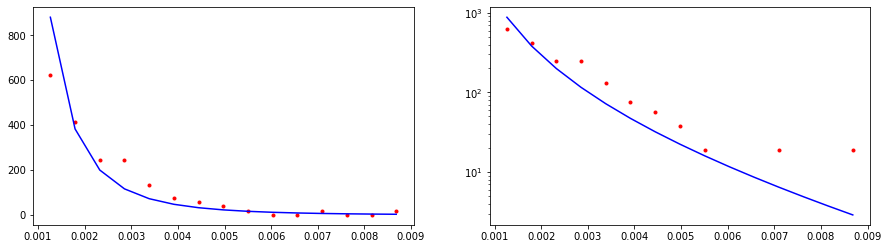

CPU times: user 1.55 ms, sys: 66 µs, total: 1.62 ms
Wall time: 1.44 ms
19643.13050459825


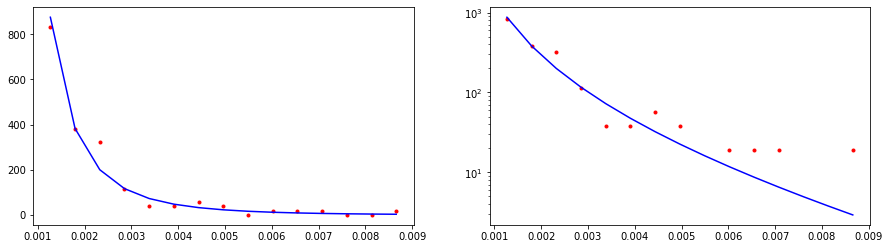

CPU times: user 1.53 ms, sys: 65 µs, total: 1.6 ms
Wall time: 1.49 ms
101503.78391905759


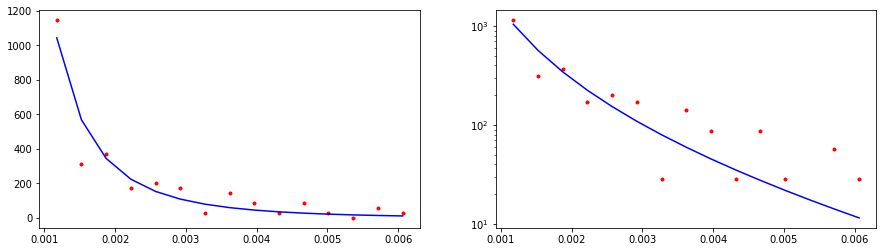

CPU times: user 1.68 ms, sys: 82 µs, total: 1.76 ms
Wall time: 1.65 ms
15103.653844418226


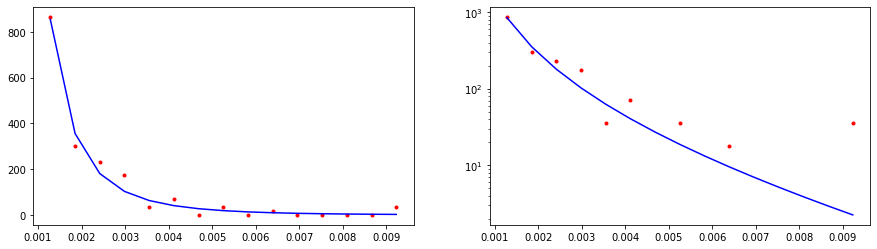

CPU times: user 2.01 ms, sys: 2 µs, total: 2.01 ms
Wall time: 1.83 ms
167878.44503466066


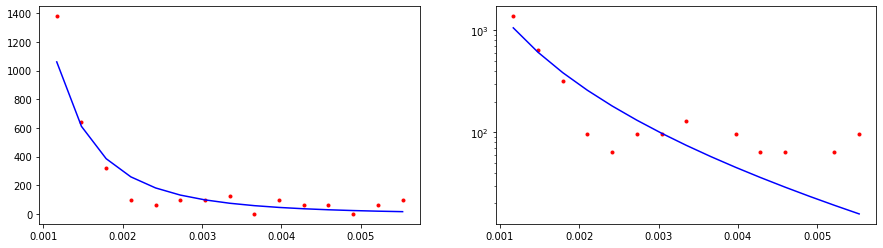

CPU times: user 592 µs, sys: 71 µs, total: 663 µs
Wall time: 416 µs
13758.294278122426


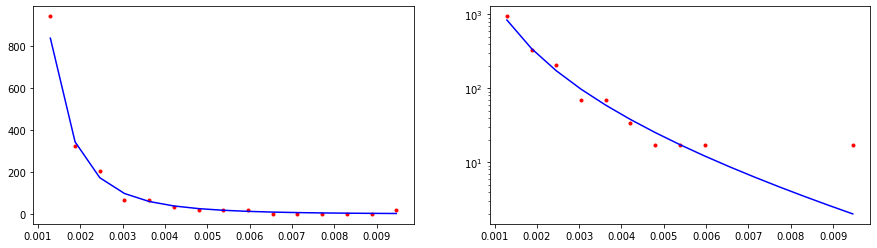

CPU times: user 512 µs, sys: 0 ns, total: 512 µs
Wall time: 347 µs
34171.52622125023


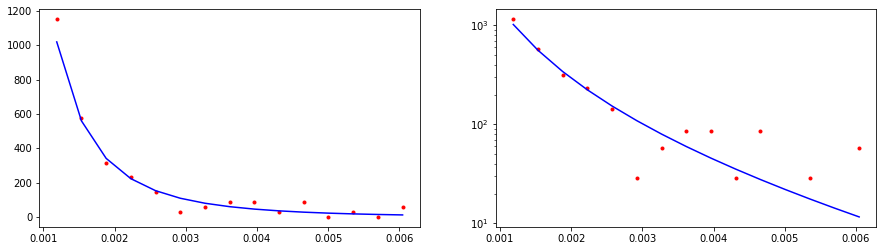

CPU times: user 480 µs, sys: 0 ns, total: 480 µs
Wall time: 320 µs
24531.443454377368


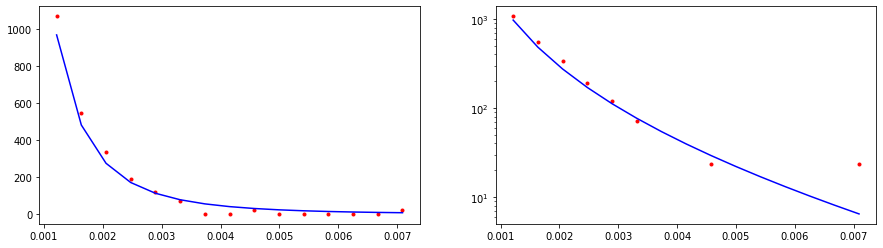

CPU times: user 576 µs, sys: 0 ns, total: 576 µs
Wall time: 410 µs
36273.77632361497


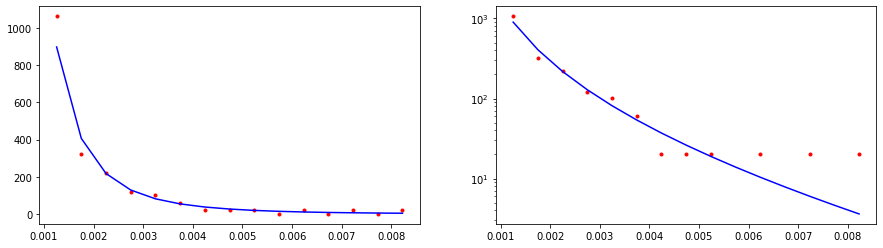

CPU times: user 556 µs, sys: 67 µs, total: 623 µs
Wall time: 448 µs
43926.73095113816


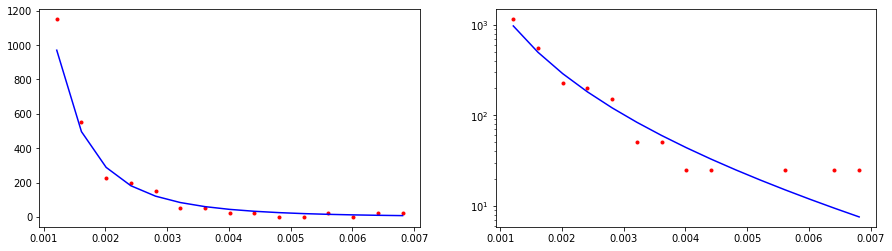

CPU times: user 651 µs, sys: 0 ns, total: 651 µs
Wall time: 501 µs
37172.53285055324


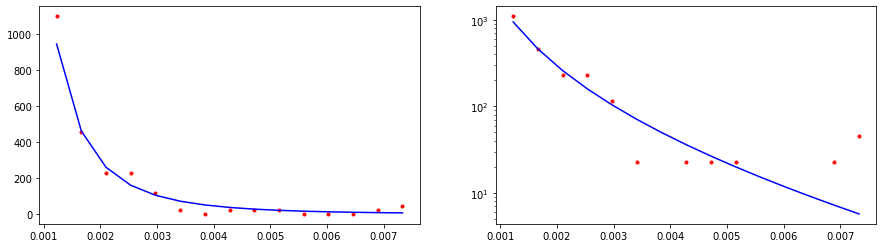

CPU times: user 612 µs, sys: 74 µs, total: 686 µs
Wall time: 502 µs
88106.73940455397


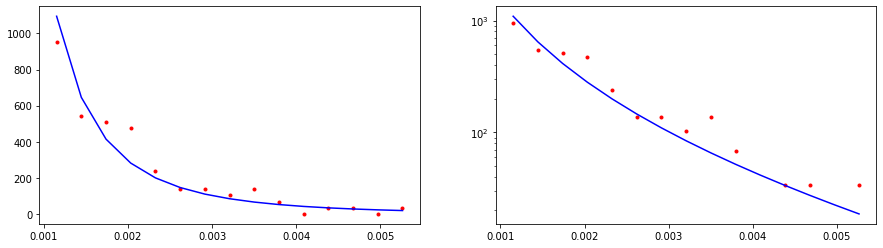

CPU times: user 718 µs, sys: 0 ns, total: 718 µs
Wall time: 615 µs
25697.20111890882


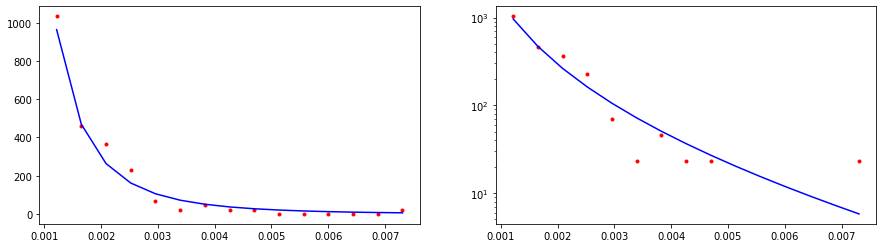

CPU times: user 929 µs, sys: 0 ns, total: 929 µs
Wall time: 833 µs
71934.8904298268


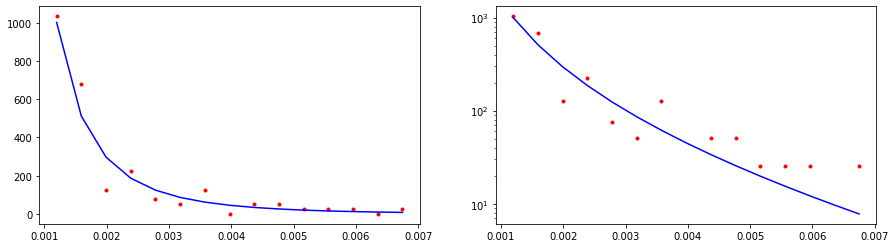

CPU times: user 1.17 ms, sys: 21 µs, total: 1.19 ms
Wall time: 1.04 ms
110941.49534052372


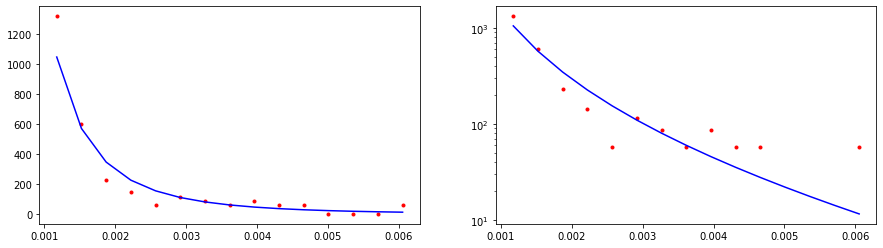

CPU times: user 1.39 ms, sys: 47 µs, total: 1.43 ms
Wall time: 1.26 ms
208363.79996713396


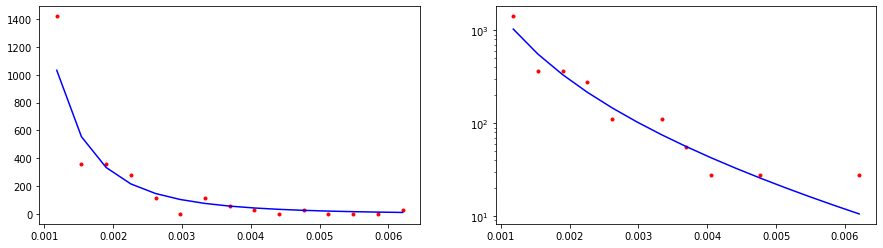

CPU times: user 1.4 ms, sys: 48 µs, total: 1.45 ms
Wall time: 1.32 ms
83004.2419880517


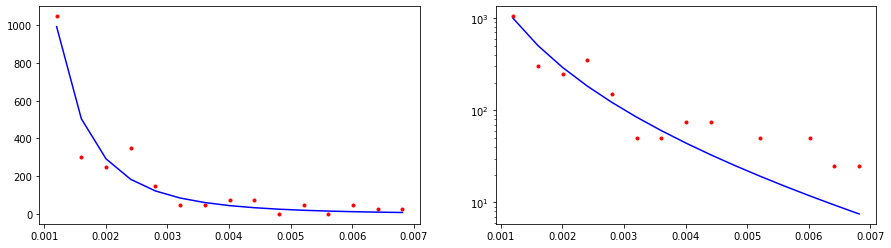

CPU times: user 1.56 ms, sys: 68 µs, total: 1.63 ms
Wall time: 1.44 ms
49094.86815188625


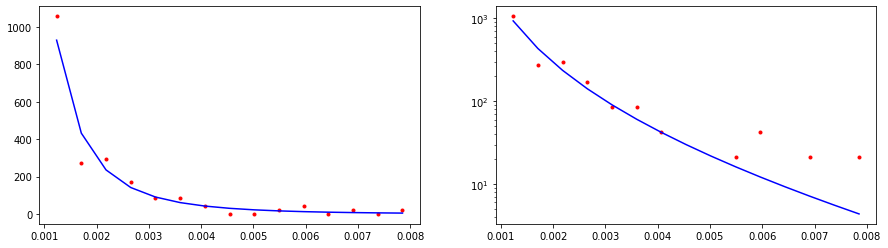

CPU times: user 1.92 ms, sys: 0 ns, total: 1.92 ms
Wall time: 1.72 ms
36692.106614414326


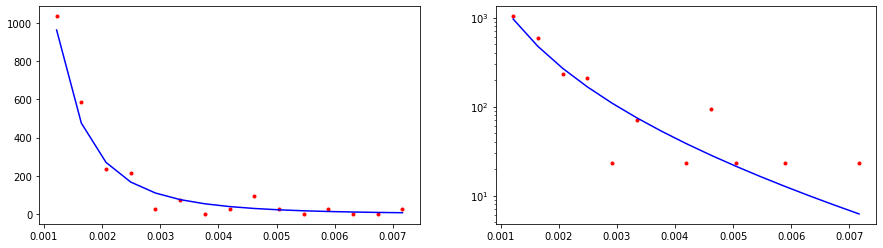

CPU times: user 2.04 ms, sys: 5 µs, total: 2.05 ms
Wall time: 1.85 ms
38808.192995953665


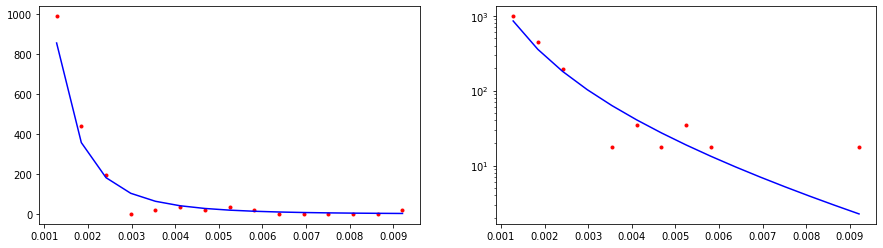

CPU times: user 636 µs, sys: 0 ns, total: 636 µs
Wall time: 398 µs
27062.160392492704


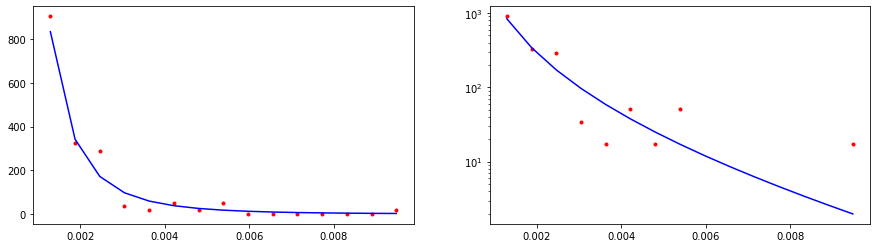

CPU times: user 511 µs, sys: 0 ns, total: 511 µs
Wall time: 342 µs
124617.7884560966


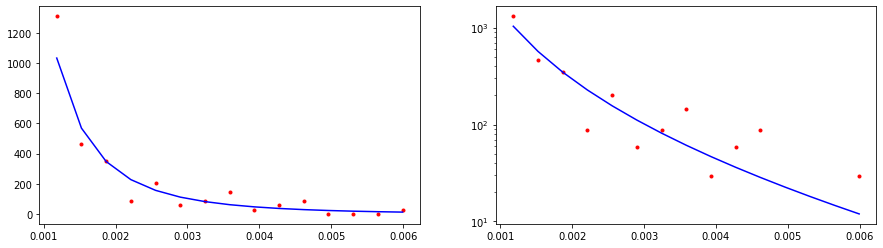

CPU times: user 471 µs, sys: 57 µs, total: 528 µs
Wall time: 355 µs
13018.345288073253


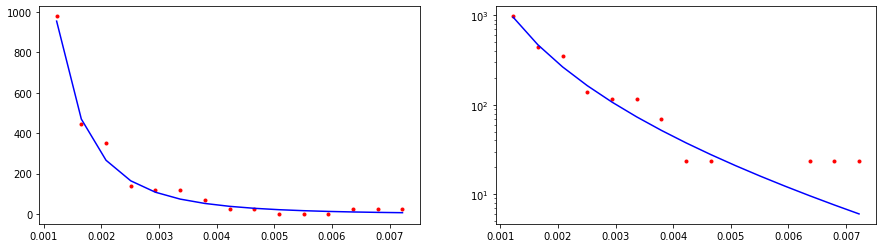

CPU times: user 0 ns, sys: 590 µs, total: 590 µs
Wall time: 425 µs
22251.724996288176


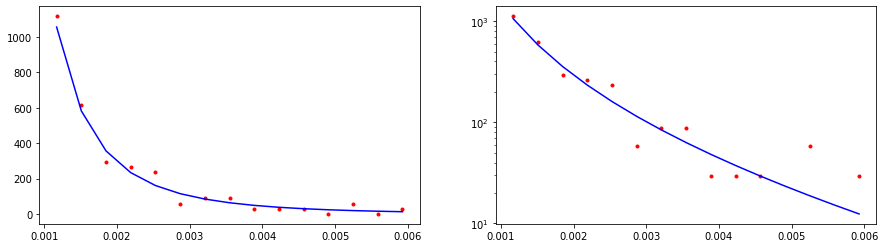

CPU times: user 620 µs, sys: 0 ns, total: 620 µs
Wall time: 445 µs
17086.33647877242


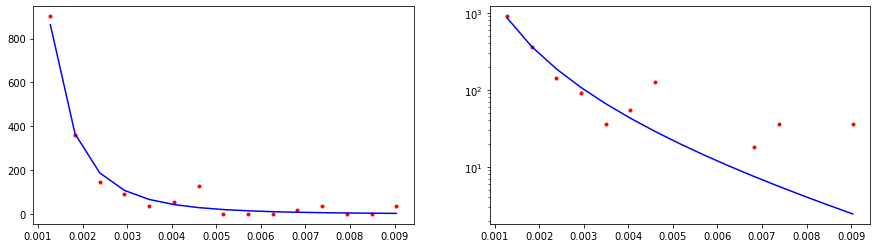

CPU times: user 636 µs, sys: 0 ns, total: 636 µs
Wall time: 514 µs
12361.661282629513


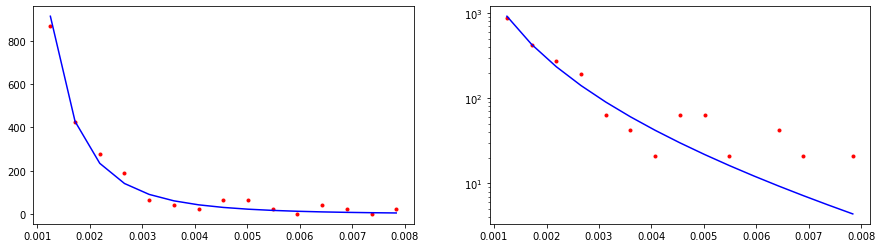

CPU times: user 0 ns, sys: 646 µs, total: 646 µs
Wall time: 525 µs
22188.11295698649


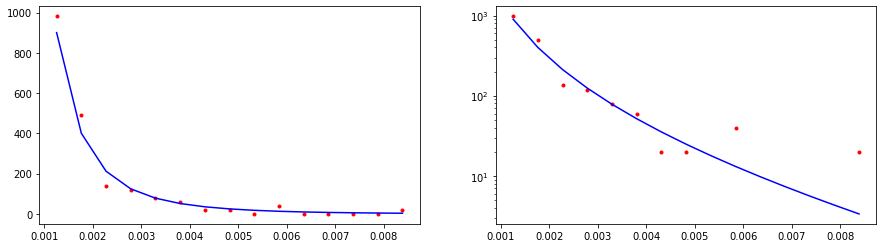

CPU times: user 875 µs, sys: 0 ns, total: 875 µs
Wall time: 697 µs
174838.8362842598


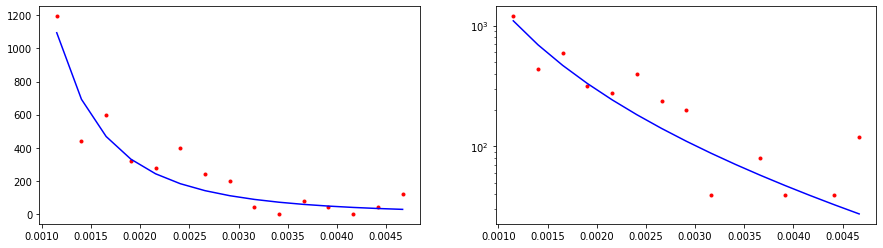

CPU times: user 1.04 ms, sys: 0 ns, total: 1.04 ms
Wall time: 868 µs
27679.703399896443


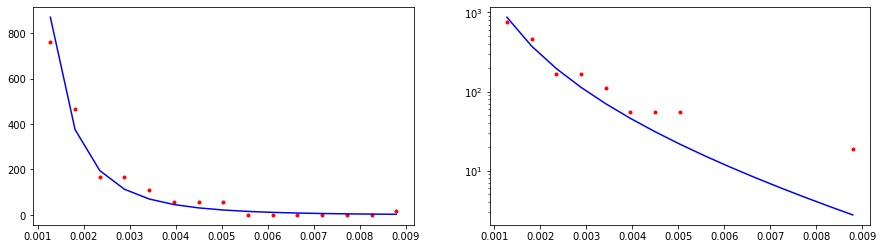

CPU times: user 1.14 ms, sys: 0 ns, total: 1.14 ms
Wall time: 969 µs
5719.5377623372615


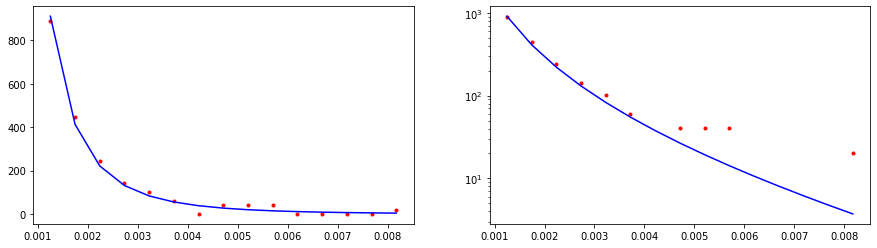

CPU times: user 1.35 ms, sys: 0 ns, total: 1.35 ms
Wall time: 1.24 ms
33335.458897289966


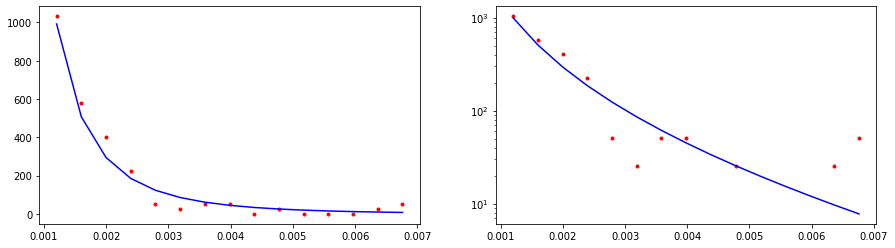

CPU times: user 763 µs, sys: 812 µs, total: 1.57 ms
Wall time: 1.39 ms
12118.35607640319


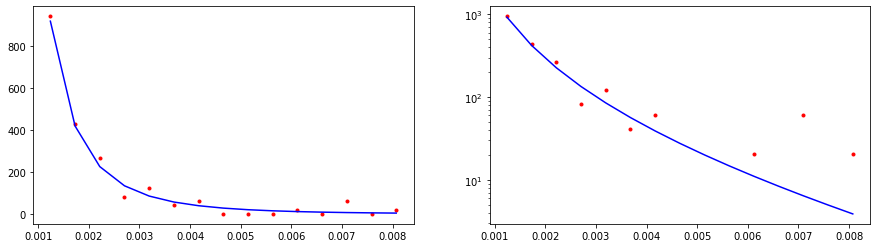

CPU times: user 1.61 ms, sys: 0 ns, total: 1.61 ms
Wall time: 1.42 ms
16061.436025314453


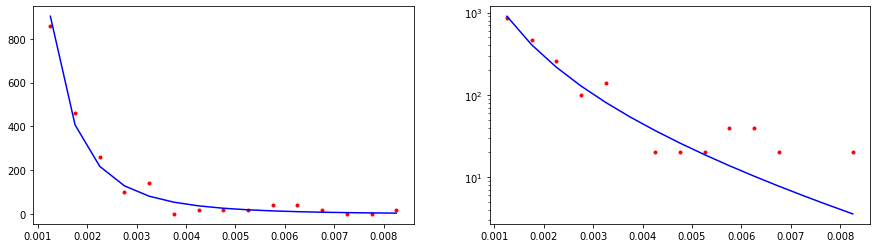

CPU times: user 1.91 ms, sys: 0 ns, total: 1.91 ms
Wall time: 1.72 ms
27507.801885270314


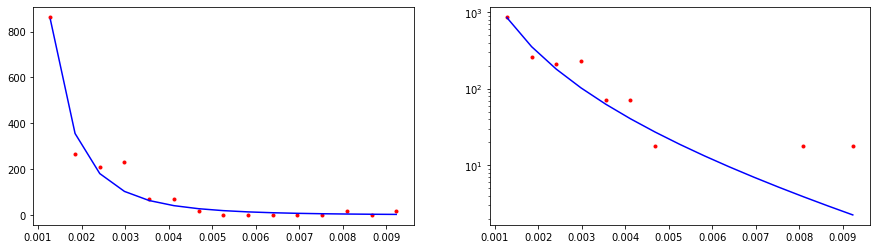

CPU times: user 1.06 ms, sys: 886 µs, total: 1.94 ms
Wall time: 1.83 ms
96480.26325660913


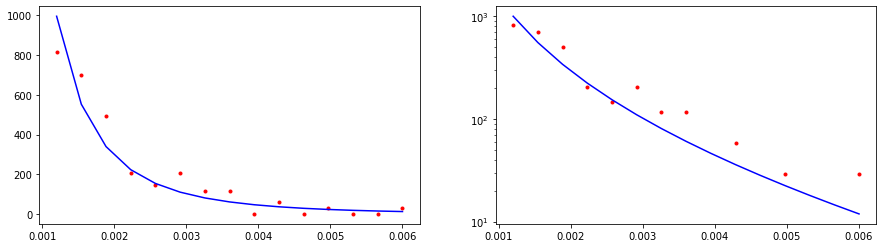

CPU times: user 558 µs, sys: 68 µs, total: 626 µs
Wall time: 381 µs
53838.76764582231


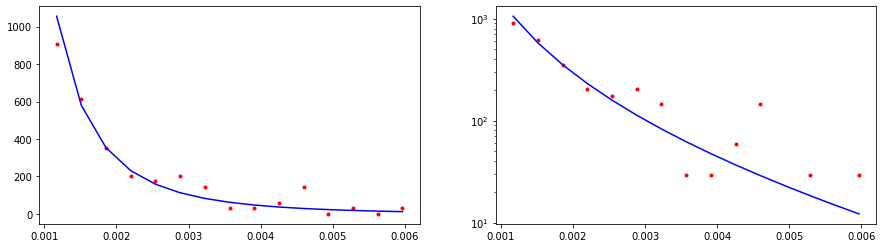

CPU times: user 543 µs, sys: 0 ns, total: 543 µs
Wall time: 356 µs
50581.49356426512


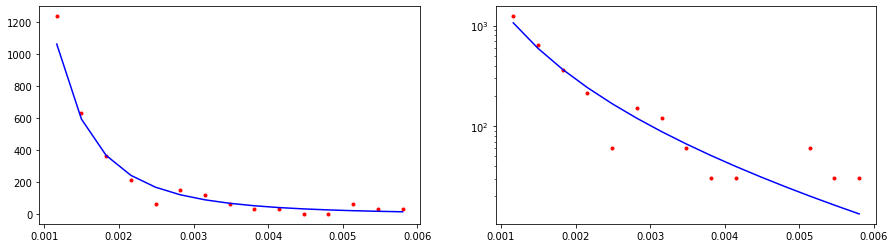

CPU times: user 524 µs, sys: 0 ns, total: 524 µs
Wall time: 365 µs
122903.8806151862


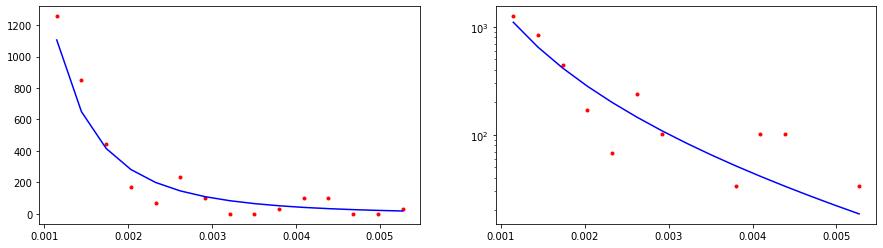

CPU times: user 557 µs, sys: 0 ns, total: 557 µs
Wall time: 392 µs
20307.271378961235


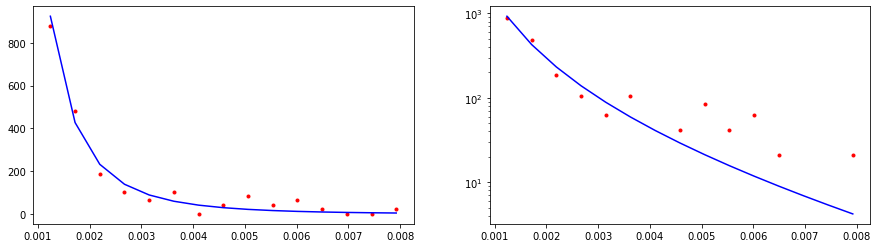

CPU times: user 631 µs, sys: 0 ns, total: 631 µs
Wall time: 460 µs
19403.468111203154


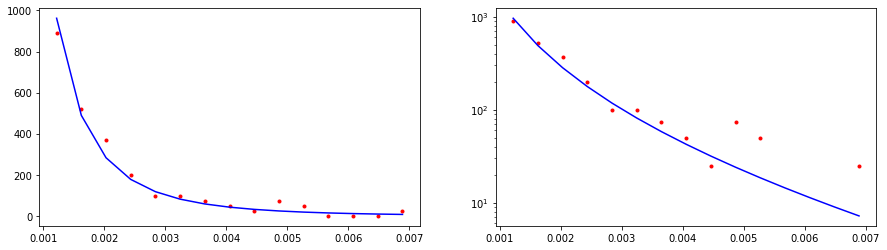

CPU times: user 648 µs, sys: 0 ns, total: 648 µs
Wall time: 525 µs
21540.136140910403


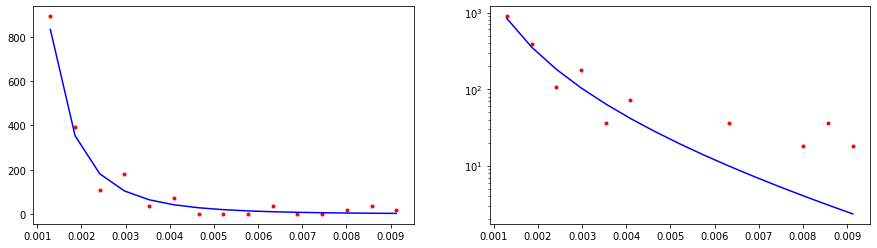

CPU times: user 0 ns, sys: 656 µs, total: 656 µs
Wall time: 533 µs
56035.822994361195


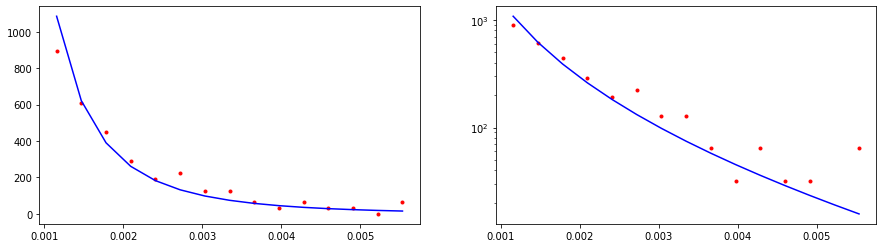

CPU times: user 835 µs, sys: 0 ns, total: 835 µs
Wall time: 710 µs
37577.619898271005


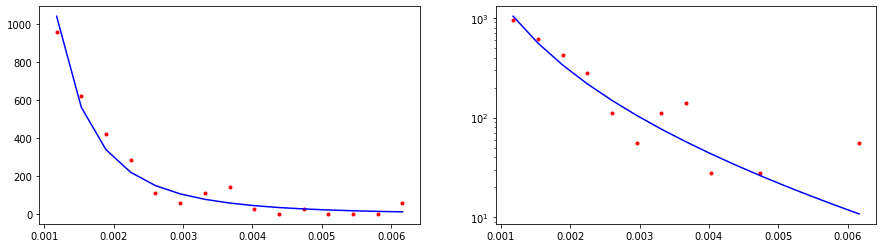

CPU times: user 1.07 ms, sys: 9 µs, total: 1.08 ms
Wall time: 903 µs
22249.079018513432


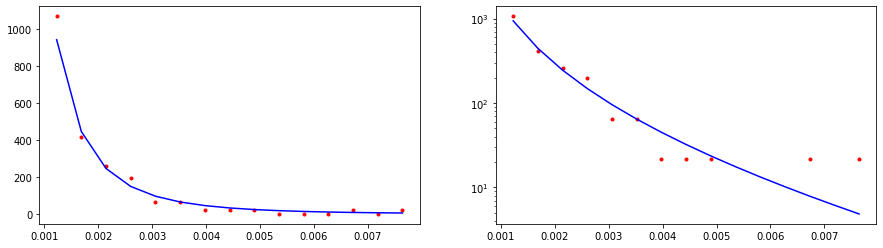

CPU times: user 1.22 ms, sys: 28 µs, total: 1.25 ms
Wall time: 1.06 ms
35265.51853389534


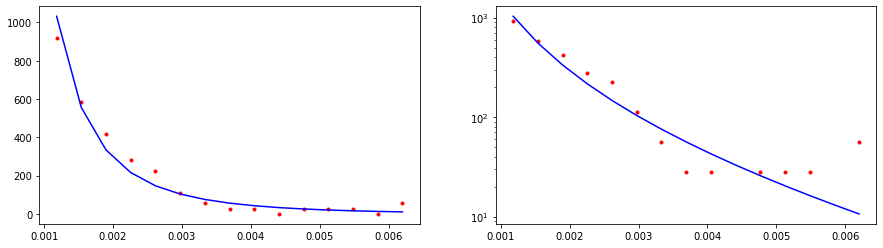

CPU times: user 1.42 ms, sys: 0 ns, total: 1.42 ms
Wall time: 1.21 ms
102753.73601689679


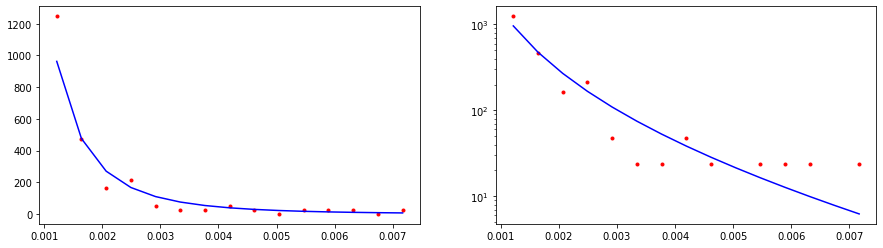

CPU times: user 1.56 ms, sys: 0 ns, total: 1.56 ms
Wall time: 1.38 ms
18400.94619901122


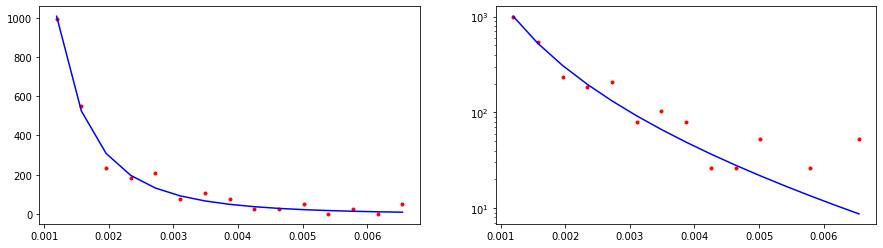

CPU times: user 1.76 ms, sys: 0 ns, total: 1.76 ms
Wall time: 1.58 ms
26340.19985776635


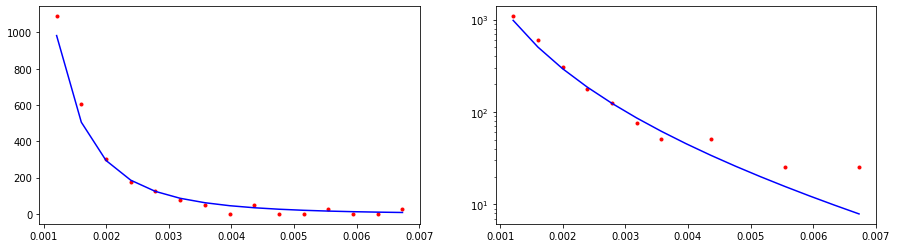

CPU times: user 1.8 ms, sys: 99 µs, total: 1.9 ms
Wall time: 1.71 ms
15815.149241079589


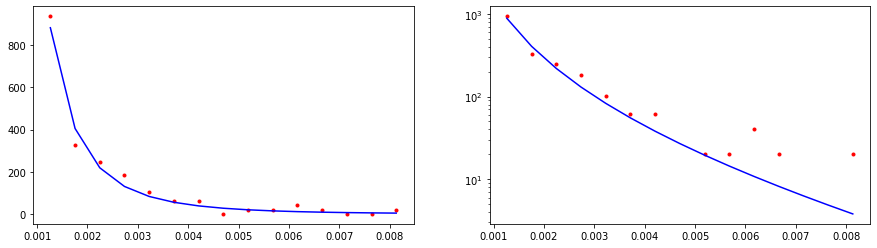

CPU times: user 2.05 ms, sys: 7 µs, total: 2.06 ms
Wall time: 1.92 ms
30261.269617053335


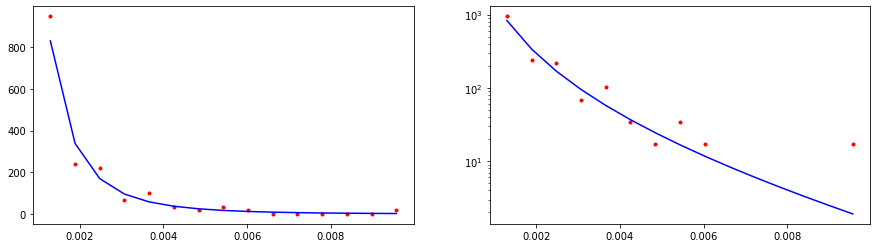

CPU times: user 732 µs, sys: 0 ns, total: 732 µs
Wall time: 475 µs
14211.182366898907


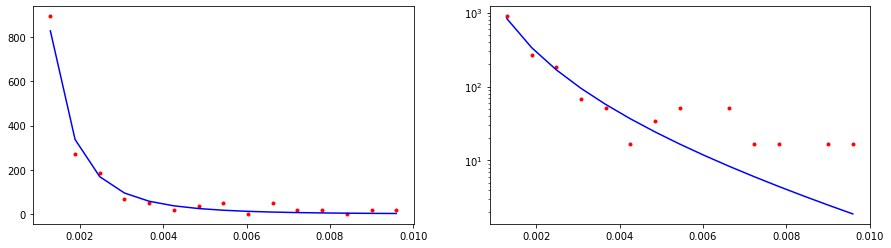

CPU times: user 0 ns, sys: 420 µs, total: 420 µs
Wall time: 308 µs
40062.25575897368


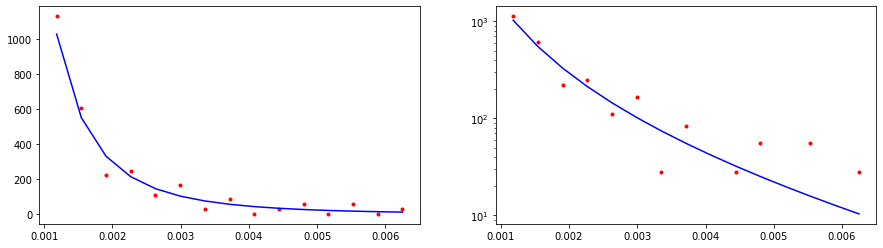

CPU times: user 550 µs, sys: 0 ns, total: 550 µs
Wall time: 391 µs
65636.7558991218


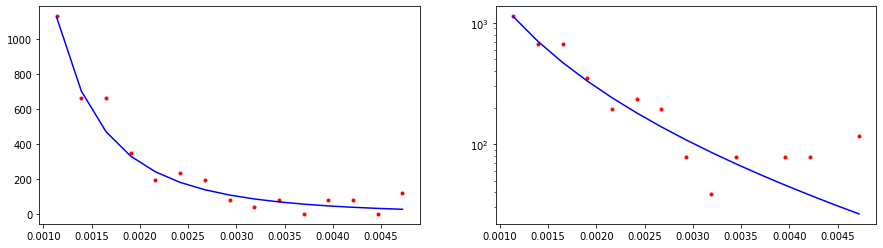

CPU times: user 574 µs, sys: 70 µs, total: 644 µs
Wall time: 421 µs
23459.64986026034


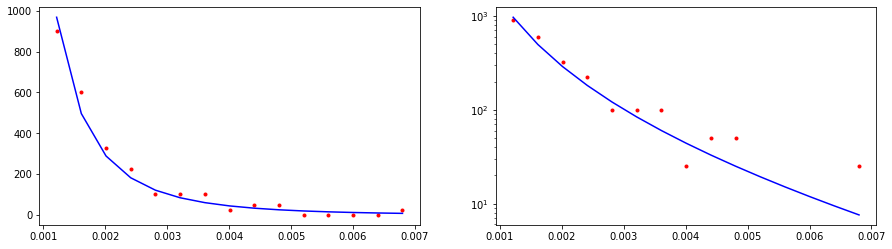

CPU times: user 627 µs, sys: 0 ns, total: 627 µs
Wall time: 473 µs
32283.119591520423


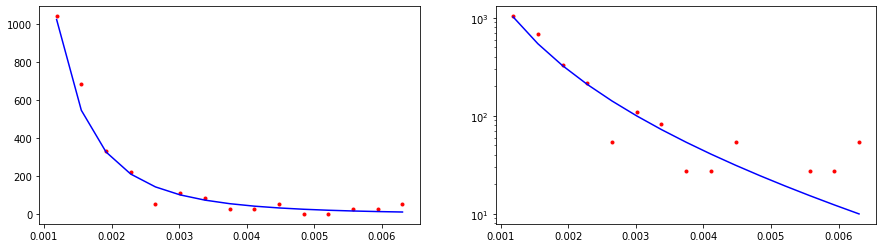

CPU times: user 542 µs, sys: 0 ns, total: 542 µs
Wall time: 439 µs
64571.43634582834


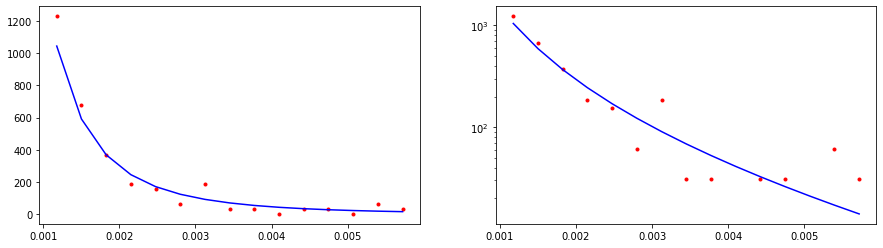

CPU times: user 569 µs, sys: 69 µs, total: 638 µs
Wall time: 470 µs
242084.24297716474


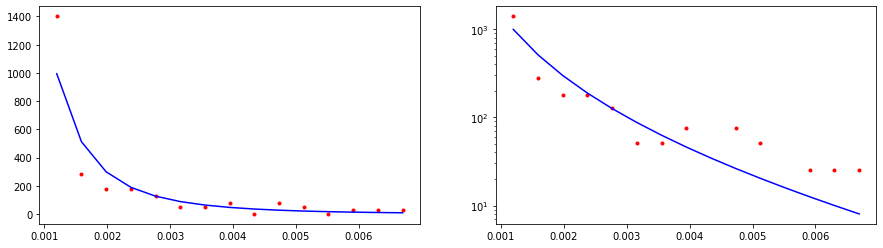

CPU times: user 898 µs, sys: 0 ns, total: 898 µs
Wall time: 713 µs
79202.9668374122


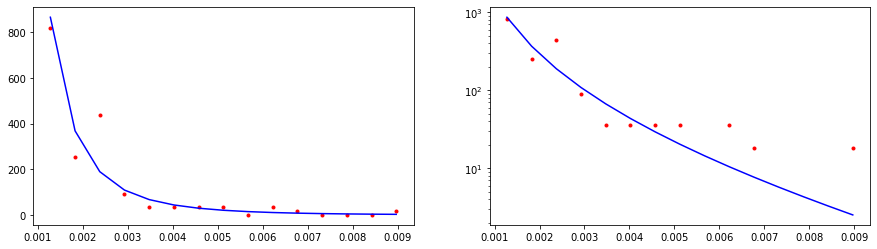

CPU times: user 1.09 ms, sys: 0 ns, total: 1.09 ms
Wall time: 891 µs
10333.35166595491


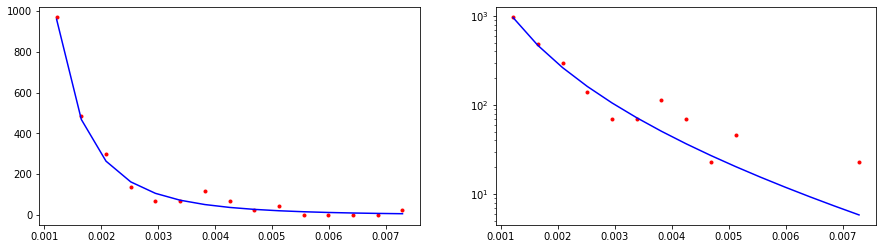

CPU times: user 1.19 ms, sys: 0 ns, total: 1.19 ms
Wall time: 1.03 ms
16356.466681590224


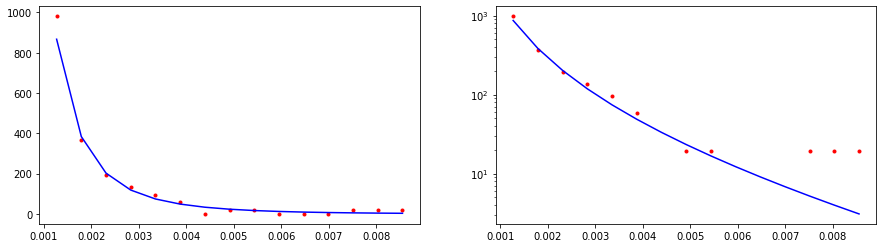

CPU times: user 1.39 ms, sys: 48 µs, total: 1.43 ms
Wall time: 1.25 ms
11391.67571642512


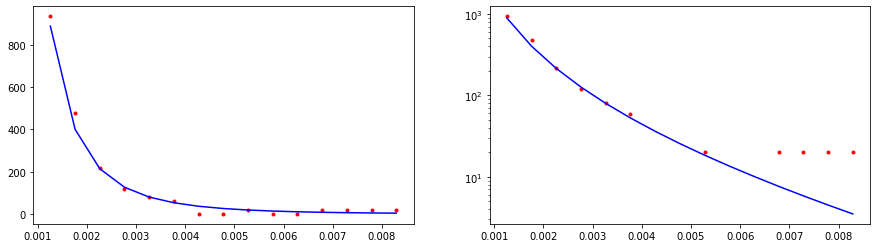

CPU times: user 1.6 ms, sys: 0 ns, total: 1.6 ms
Wall time: 1.42 ms
8364.91643401257


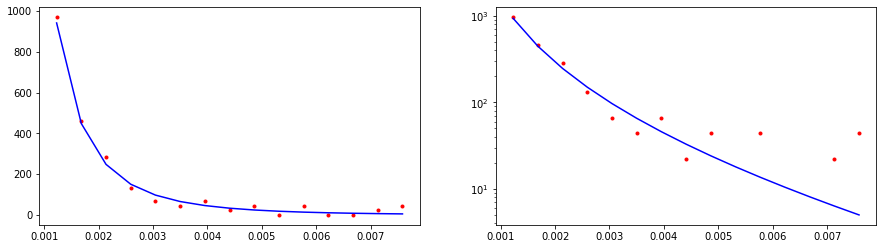

CPU times: user 1.76 ms, sys: 0 ns, total: 1.76 ms
Wall time: 1.56 ms
27735.954466677264


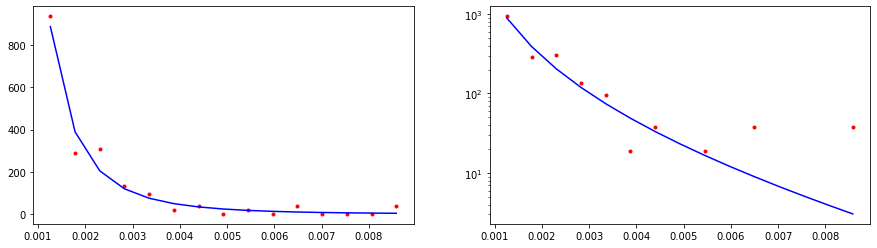

CPU times: user 1.92 ms, sys: 0 ns, total: 1.92 ms
Wall time: 1.73 ms
38525.118133785356


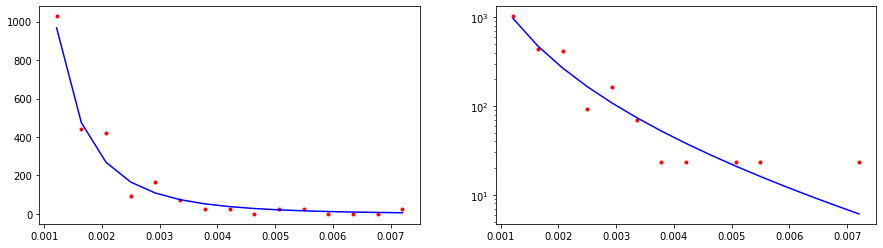

CPU times: user 2.08 ms, sys: 11 µs, total: 2.09 ms
Wall time: 1.89 ms
80055.30284296423


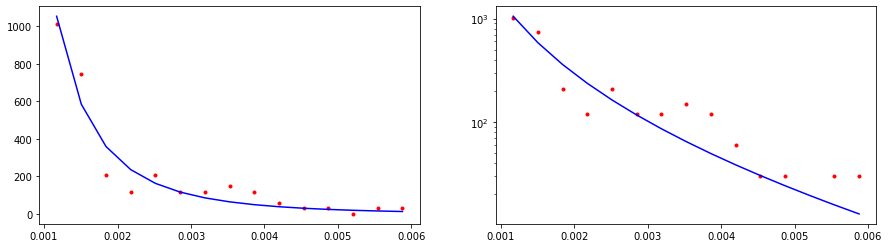

CPU times: user 665 µs, sys: 81 µs, total: 746 µs
Wall time: 491 µs
23403.099329782577


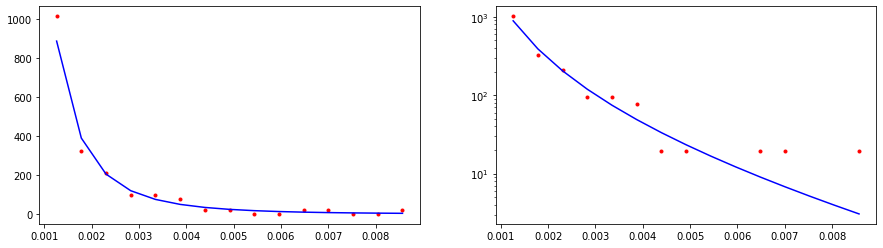

CPU times: user 513 µs, sys: 0 ns, total: 513 µs
Wall time: 343 µs
20694.879446280956


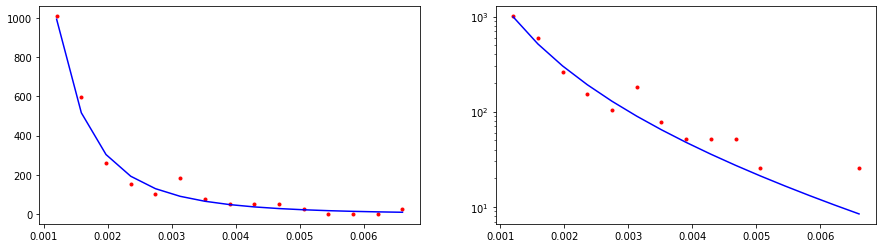

CPU times: user 551 µs, sys: 0 ns, total: 551 µs
Wall time: 377 µs
47203.87036015932


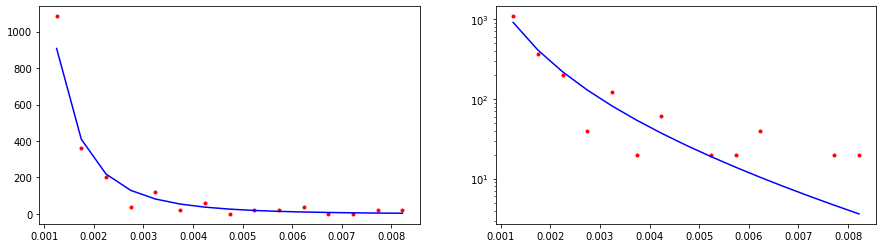

CPU times: user 466 µs, sys: 57 µs, total: 523 µs
Wall time: 360 µs
33270.55338625691


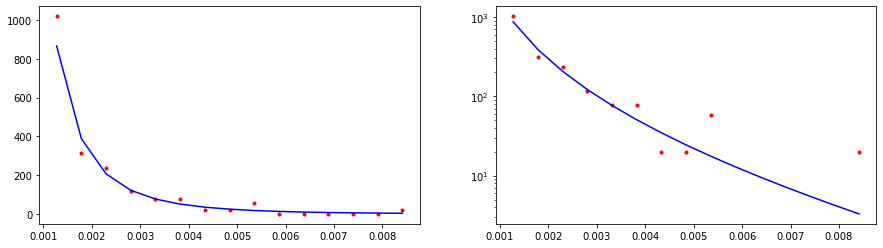

CPU times: user 0 ns, sys: 625 µs, total: 625 µs
Wall time: 450 µs
104270.91641757787


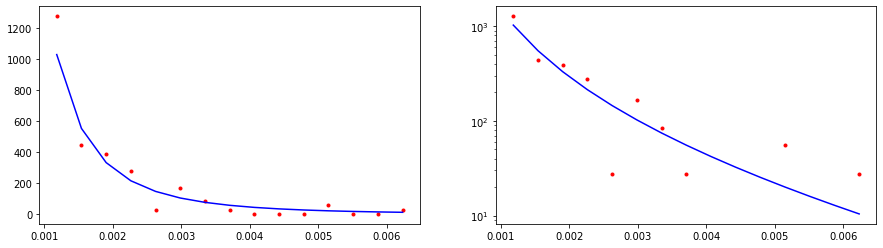

CPU times: user 547 µs, sys: 67 µs, total: 614 µs
Wall time: 451 µs
8309.950958898145


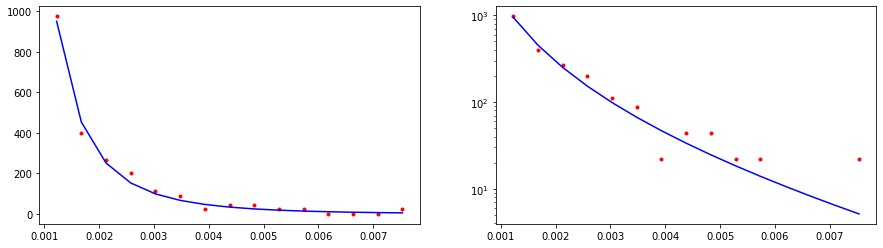

CPU times: user 613 µs, sys: 75 µs, total: 688 µs
Wall time: 515 µs
160990.81692144446


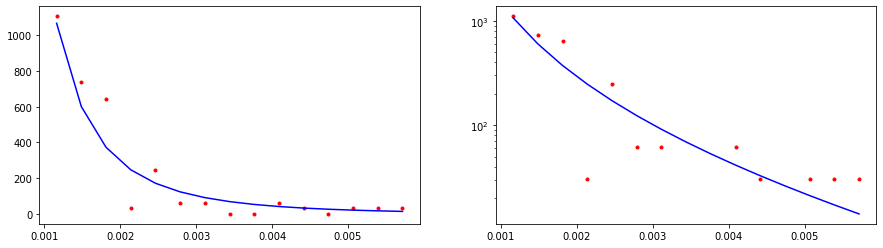

CPU times: user 864 µs, sys: 0 ns, total: 864 µs
Wall time: 697 µs
9669.265181318562


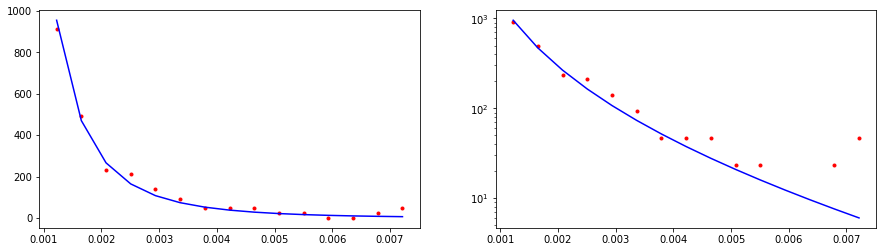

CPU times: user 1.08 ms, sys: 10 µs, total: 1.09 ms
Wall time: 904 µs
18399.509208873442


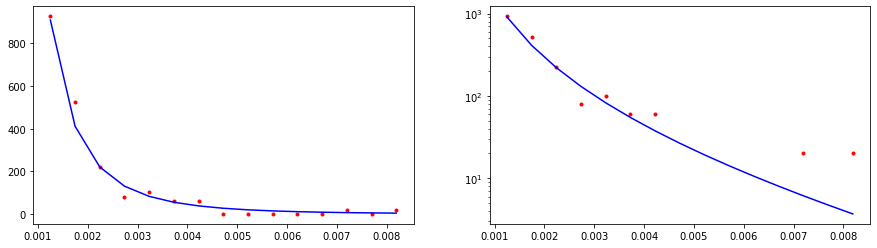

CPU times: user 1.22 ms, sys: 28 µs, total: 1.25 ms
Wall time: 1.08 ms
17783.213077760087


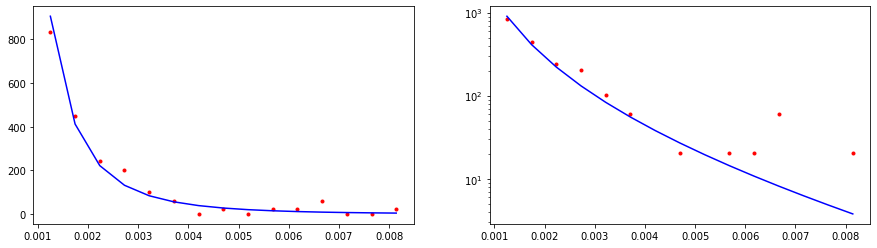

CPU times: user 1.39 ms, sys: 49 µs, total: 1.44 ms
Wall time: 1.25 ms
48191.2331294695


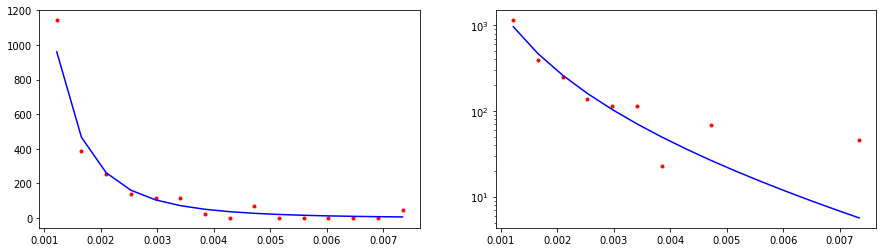

CPU times: user 1.41 ms, sys: 52 µs, total: 1.47 ms
Wall time: 1.27 ms
48863.56096871386


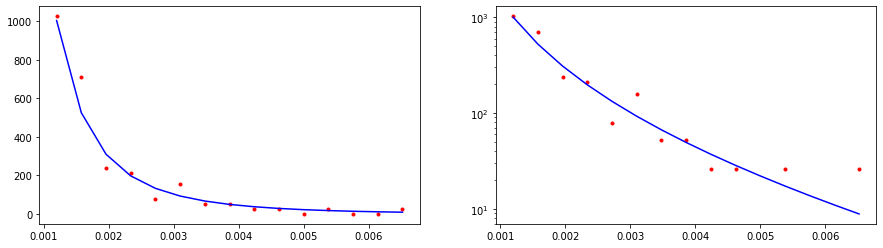

CPU times: user 759 µs, sys: 847 µs, total: 1.61 ms
Wall time: 1.42 ms
18488.50650533726


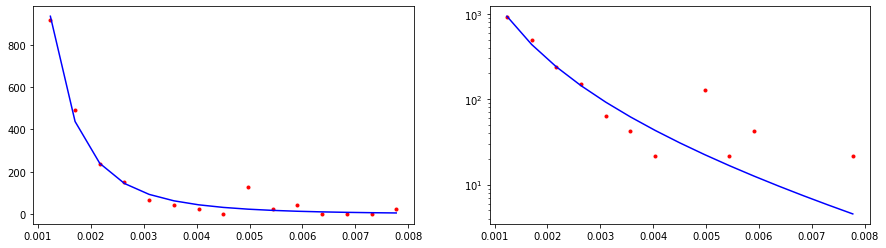

CPU times: user 1.79 ms, sys: 0 ns, total: 1.79 ms
Wall time: 1.66 ms
13672.493005378066


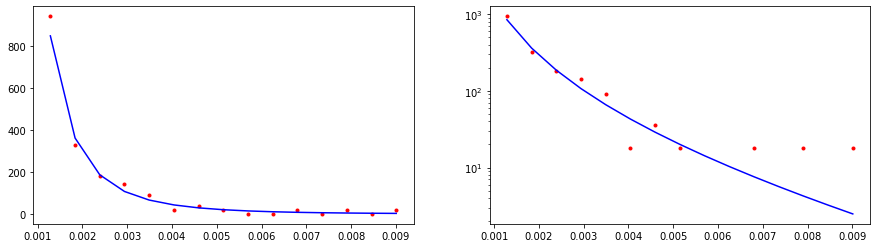

CPU times: user 2.01 ms, sys: 3 µs, total: 2.02 ms
Wall time: 1.82 ms
19088.853914223677


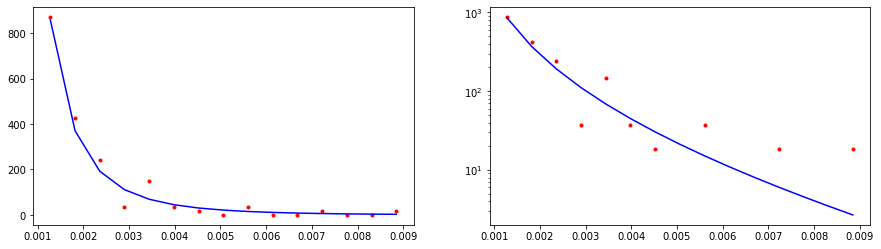

CPU times: user 0 ns, sys: 698 µs, total: 698 µs
Wall time: 441 µs
35091.101634157894


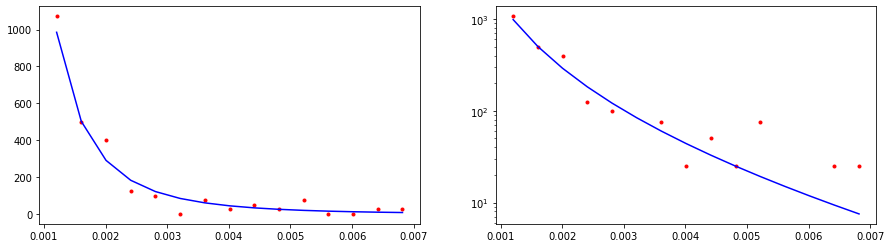

CPU times: user 443 µs, sys: 55 µs, total: 498 µs
Wall time: 326 µs
96932.61577994052


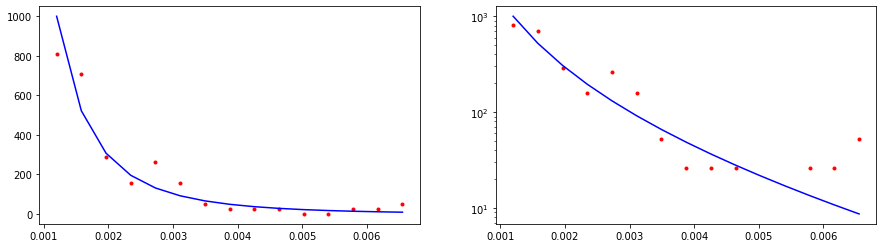

CPU times: user 484 µs, sys: 0 ns, total: 484 µs
Wall time: 381 µs
48451.045190731566


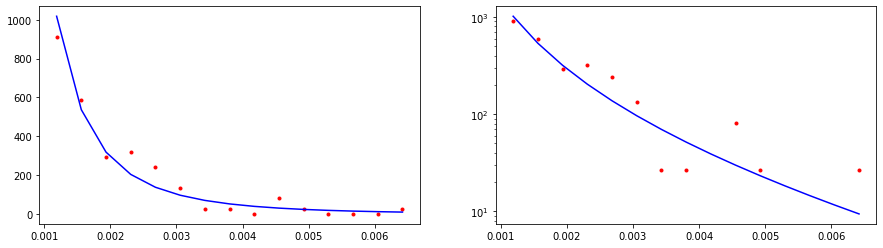

CPU times: user 585 µs, sys: 0 ns, total: 585 µs
Wall time: 416 µs
57605.09234619655


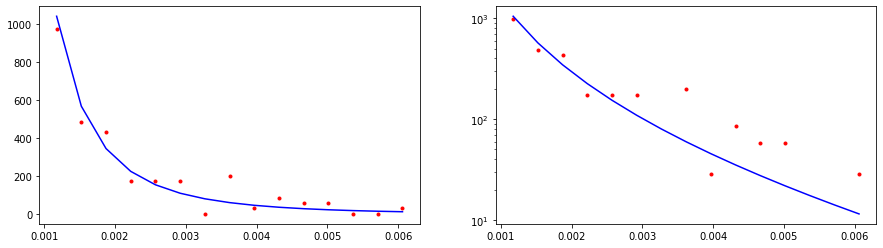

CPU times: user 0 ns, sys: 625 µs, total: 625 µs
Wall time: 425 µs
127650.66471655817


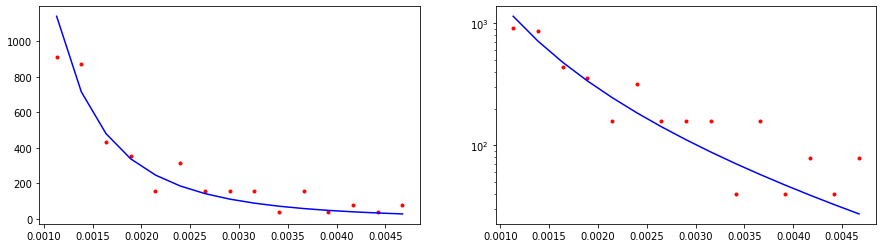

CPU times: user 728 µs, sys: 0 ns, total: 728 µs
Wall time: 508 µs
85133.98607739793


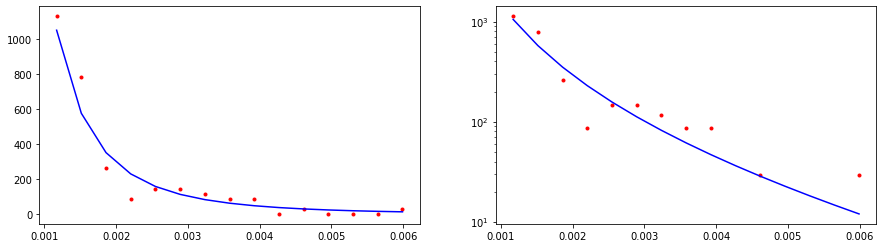

CPU times: user 589 µs, sys: 73 µs, total: 662 µs
Wall time: 481 µs
27327.478244811682


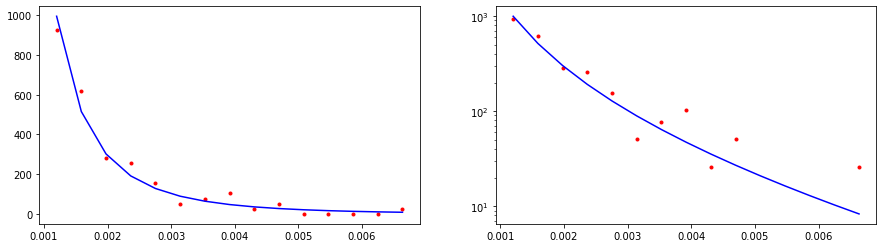

CPU times: user 0 ns, sys: 829 µs, total: 829 µs
Wall time: 650 µs
87752.04282429615


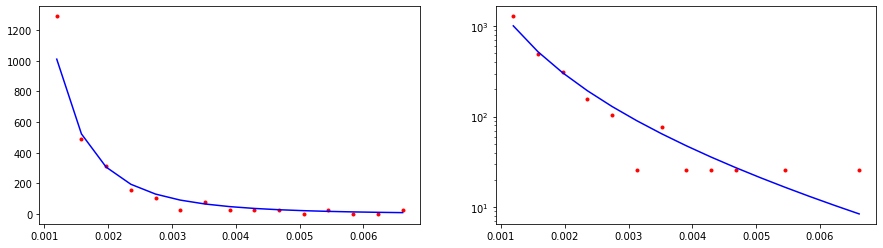

CPU times: user 140 µs, sys: 932 µs, total: 1.07 ms
Wall time: 894 µs
59403.9976766276


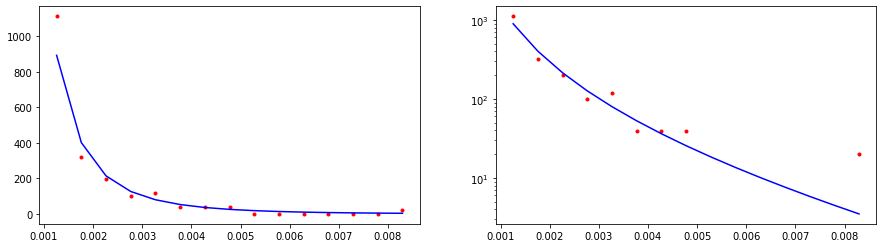

CPU times: user 1.22 ms, sys: 28 µs, total: 1.25 ms
Wall time: 1.06 ms
73179.53763994254


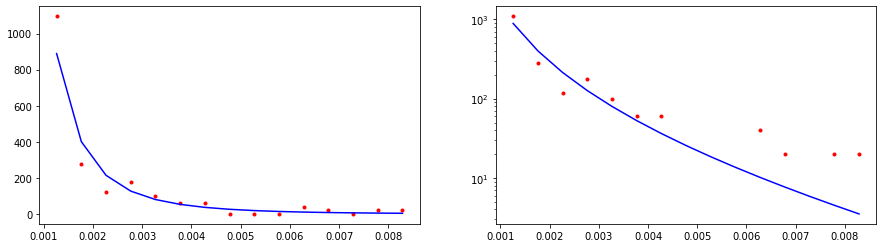

CPU times: user 1.44 ms, sys: 0 ns, total: 1.44 ms
Wall time: 1.2 ms
276253.94290083245


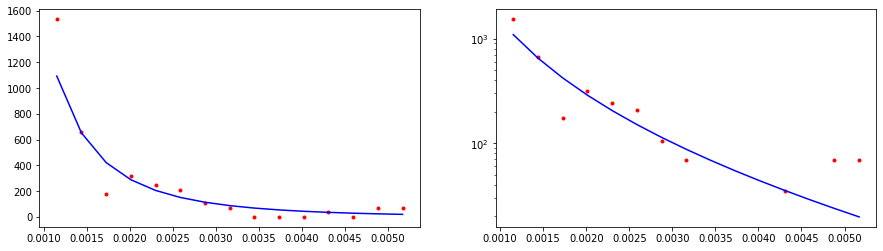

CPU times: user 1.47 ms, sys: 0 ns, total: 1.47 ms
Wall time: 1.28 ms
30110.43818839211


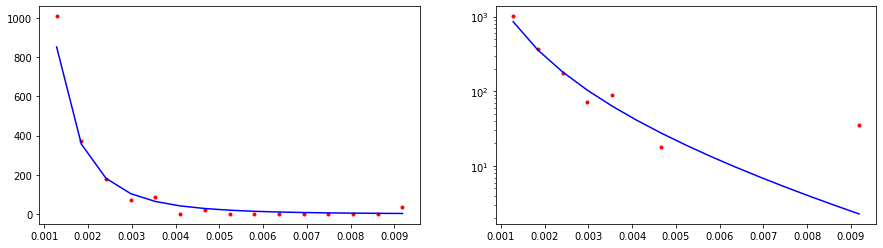

CPU times: user 1.56 ms, sys: 70 µs, total: 1.63 ms
Wall time: 1.44 ms
28026.454175190996


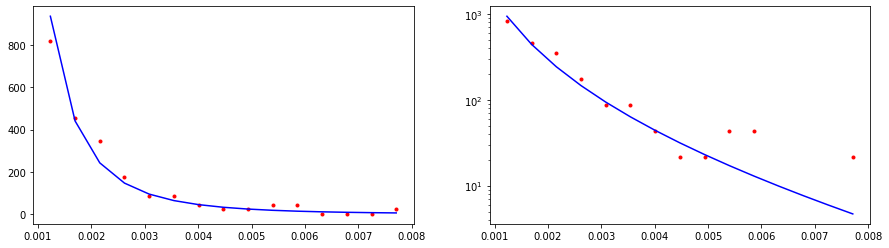

CPU times: user 1.01 ms, sys: 838 µs, total: 1.85 ms
Wall time: 1.66 ms
40223.03907174781


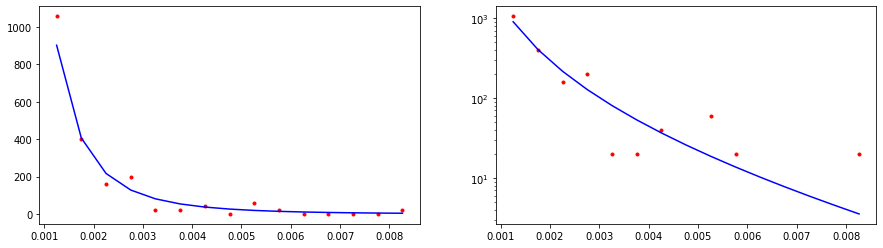

CPU times: user 1.97 ms, sys: 0 ns, total: 1.97 ms
Wall time: 1.83 ms
41488.46960885396


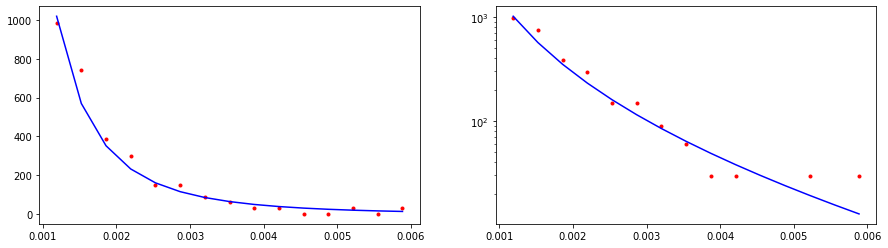

CPU times: user 648 µs, sys: 0 ns, total: 648 µs
Wall time: 453 µs
68745.14757296313


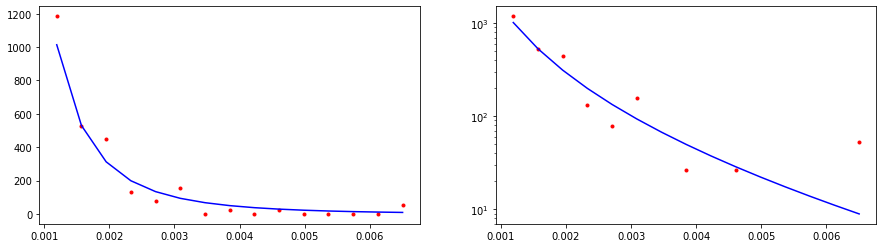

CPU times: user 464 µs, sys: 0 ns, total: 464 µs
Wall time: 314 µs
38345.9554367659


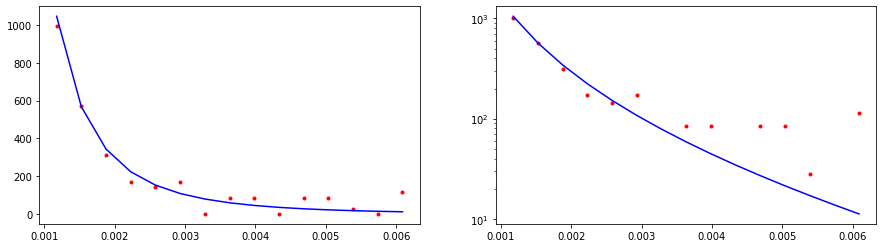

CPU times: user 652 µs, sys: 0 ns, total: 652 µs
Wall time: 395 µs
95204.29765565072


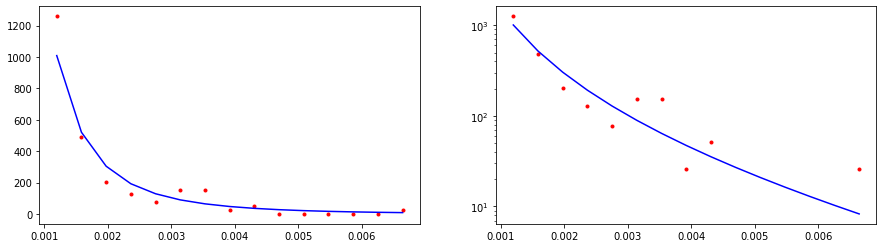

CPU times: user 533 µs, sys: 67 µs, total: 600 µs
Wall time: 422 µs
33361.58917773411


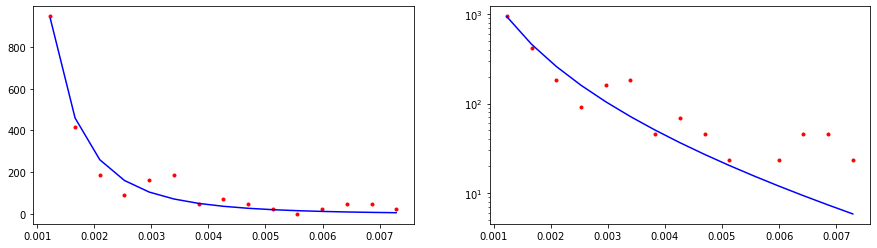

CPU times: user 547 µs, sys: 68 µs, total: 615 µs
Wall time: 436 µs
55745.71115998023


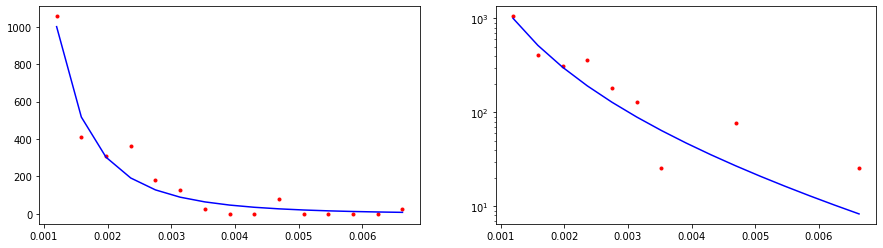

CPU times: user 695 µs, sys: 0 ns, total: 695 µs
Wall time: 513 µs
36475.26896444899


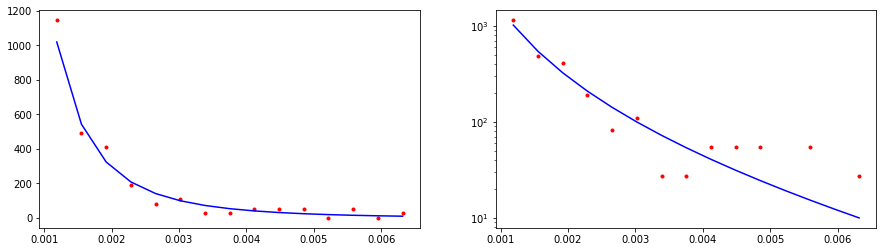

CPU times: user 642 µs, sys: 80 µs, total: 722 µs
Wall time: 542 µs
11152.554948324825


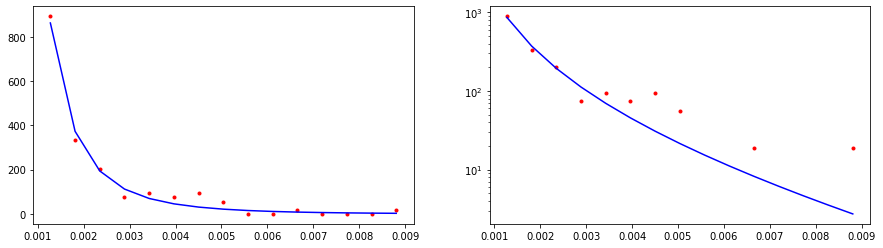

CPU times: user 872 µs, sys: 4 µs, total: 876 µs
Wall time: 705 µs
153992.88962346205


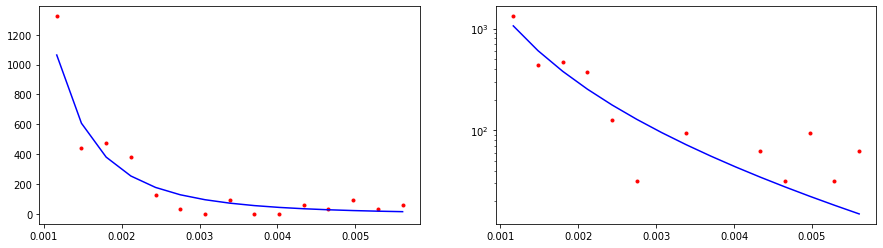

CPU times: user 1 ms, sys: 0 ns, total: 1 ms
Wall time: 890 µs
49741.89611083991


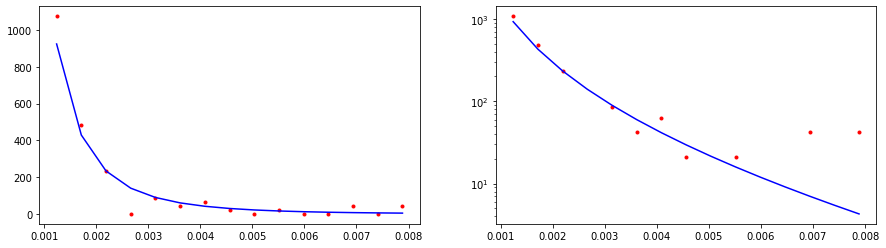

CPU times: user 311 µs, sys: 874 µs, total: 1.19 ms
Wall time: 1.02 ms
86294.98588599624


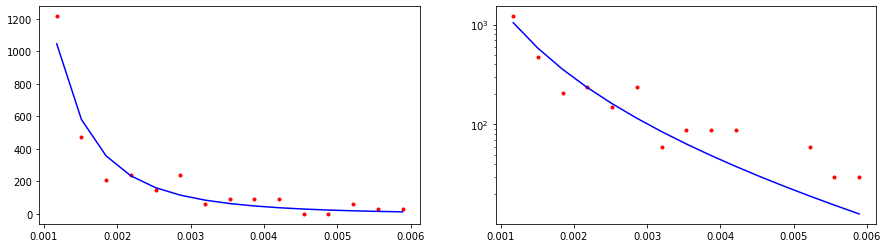

CPU times: user 1.27 ms, sys: 33 µs, total: 1.3 ms
Wall time: 1.13 ms
55781.42911572594


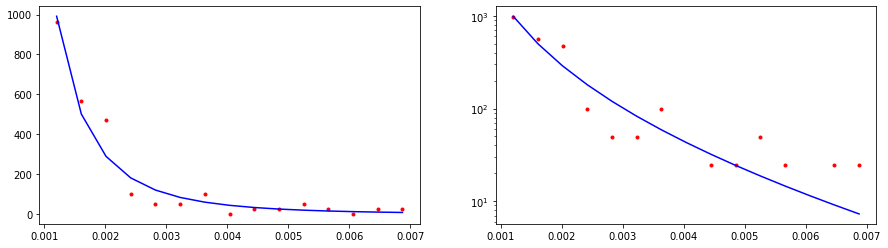

CPU times: user 1.53 ms, sys: 67 µs, total: 1.6 ms
Wall time: 1.41 ms
75413.81696695535


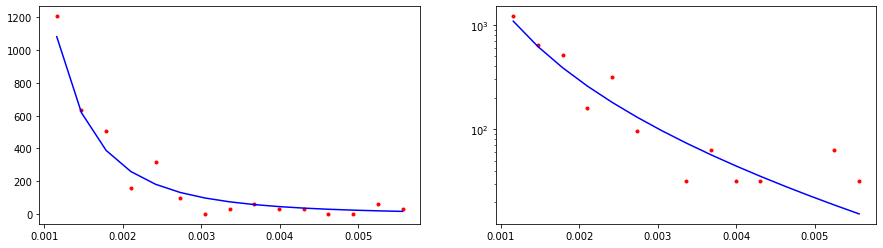

CPU times: user 1.69 ms, sys: 0 ns, total: 1.69 ms
Wall time: 1.49 ms
150152.09174859125


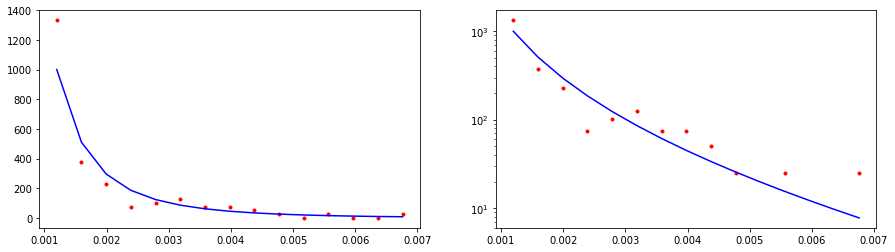

CPU times: user 1.71 ms, sys: 89 µs, total: 1.8 ms
Wall time: 1.59 ms
86813.54177349586


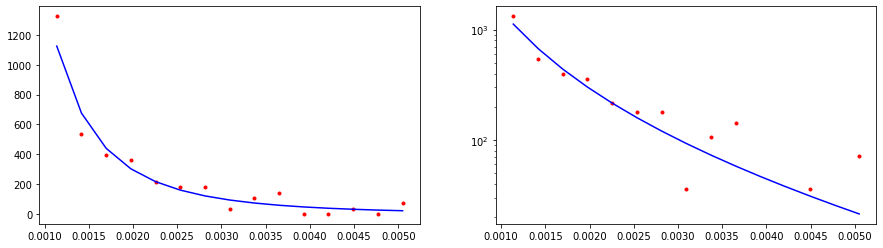

CPU times: user 1.84 ms, sys: 105 µs, total: 1.94 ms
Wall time: 1.75 ms
35222.35330647633


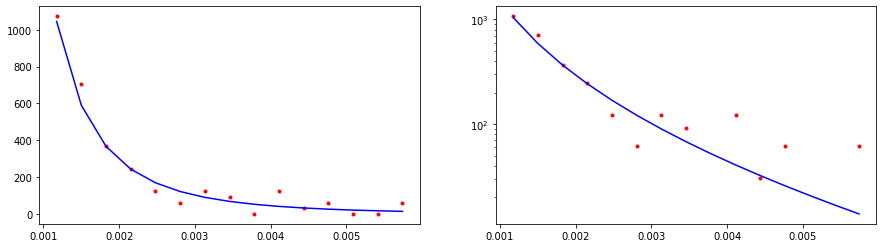

CPU times: user 480 µs, sys: 59 µs, total: 539 µs
Wall time: 421 µs
23662.827888328015


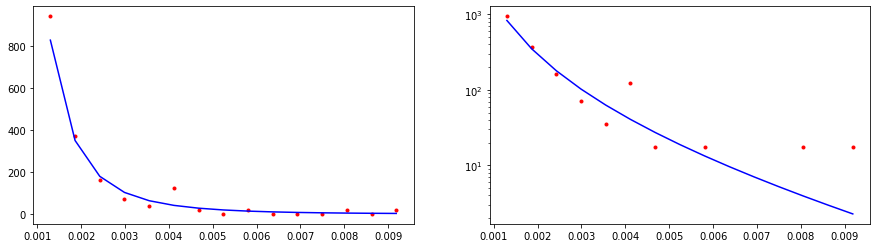

CPU times: user 497 µs, sys: 0 ns, total: 497 µs
Wall time: 343 µs
98188.883973764


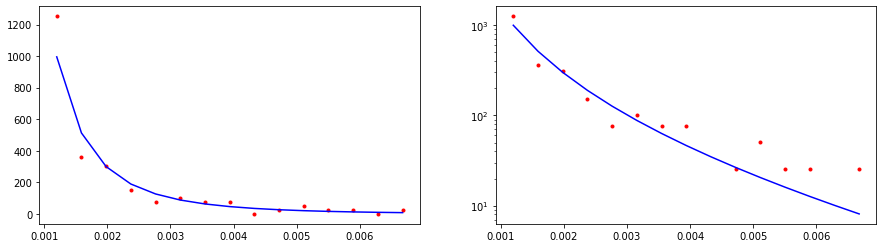

CPU times: user 566 µs, sys: 0 ns, total: 566 µs
Wall time: 386 µs
15271.571971307088


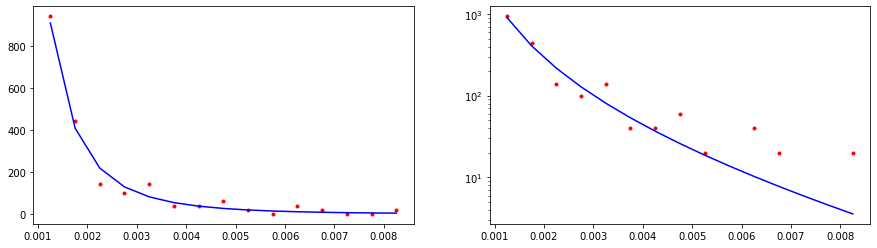

CPU times: user 593 µs, sys: 0 ns, total: 593 µs
Wall time: 427 µs
50821.95514995057


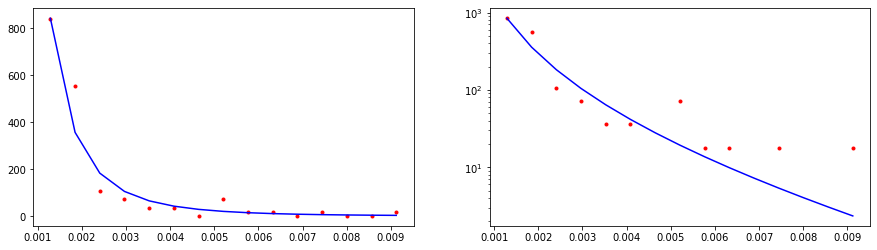

CPU times: user 551 µs, sys: 69 µs, total: 620 µs
Wall time: 445 µs
42778.32966288582


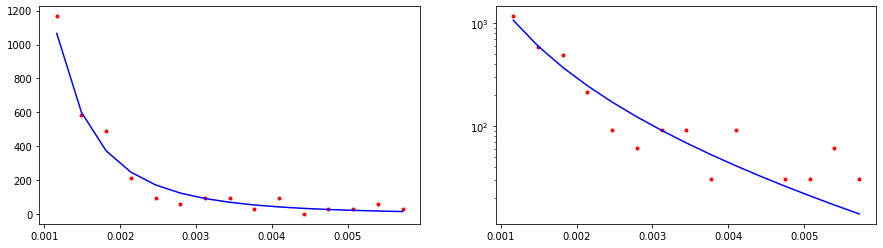

CPU times: user 613 µs, sys: 0 ns, total: 613 µs
Wall time: 452 µs
50243.84951617663


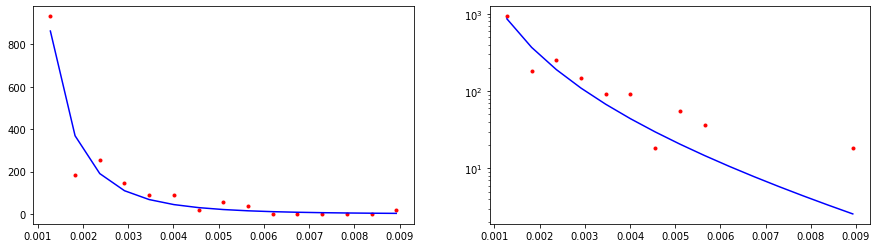

CPU times: user 720 µs, sys: 0 ns, total: 720 µs
Wall time: 545 µs
50175.25075576137


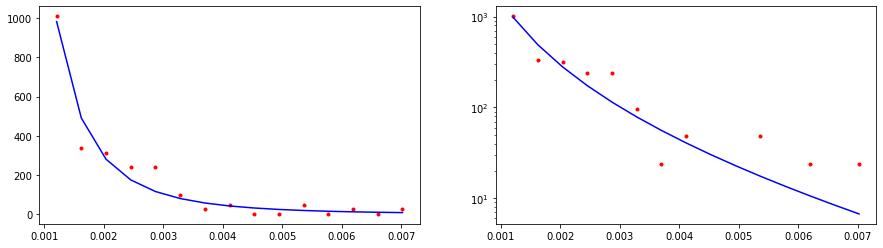

CPU times: user 0 ns, sys: 847 µs, total: 847 µs
Wall time: 721 µs
88694.36260282942


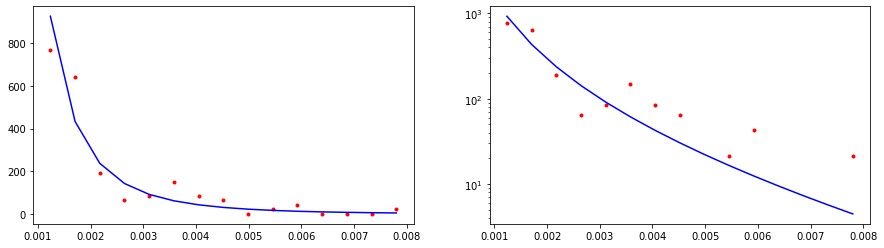

CPU times: user 995 µs, sys: 8 µs, total: 1 ms
Wall time: 883 µs
115375.2266952394


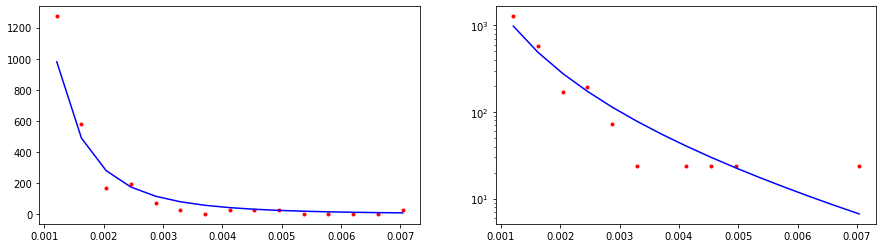

CPU times: user 1.22 ms, sys: 0 ns, total: 1.22 ms
Wall time: 1.1 ms
26117.342217493864


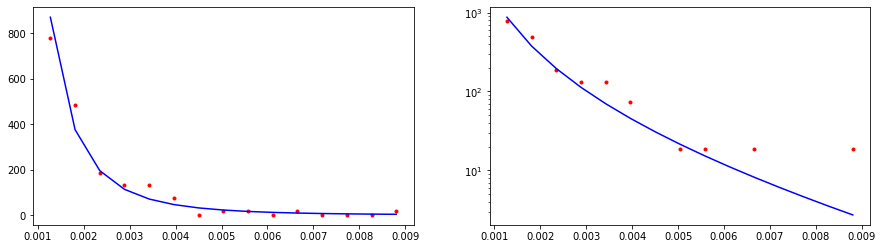

CPU times: user 1.47 ms, sys: 59 µs, total: 1.53 ms
Wall time: 1.31 ms
19298.549674194517


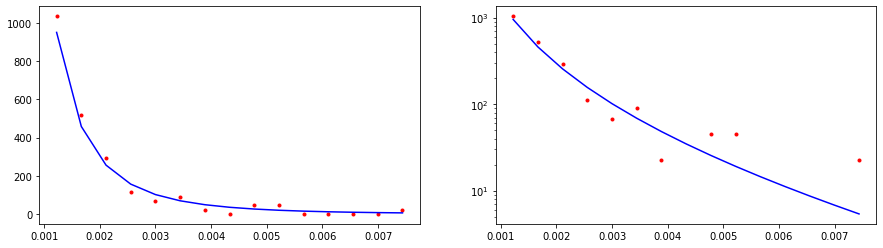

CPU times: user 725 µs, sys: 842 µs, total: 1.57 ms
Wall time: 1.37 ms
168627.5020431444


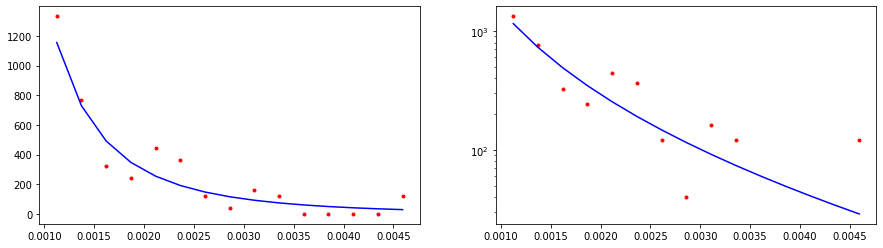

CPU times: user 739 µs, sys: 810 µs, total: 1.55 ms
Wall time: 1.39 ms
33497.613637607225


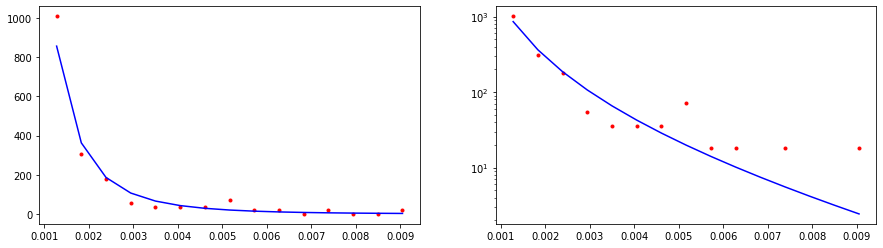

CPU times: user 1.91 ms, sys: 0 ns, total: 1.91 ms
Wall time: 1.69 ms
30986.231997573967


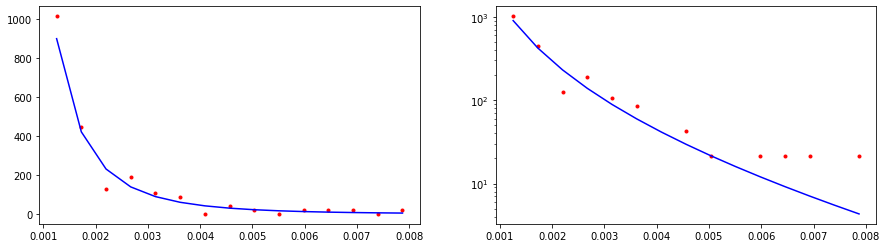

CPU times: user 2.07 ms, sys: 10 µs, total: 2.08 ms
Wall time: 1.87 ms
15871.138255760683


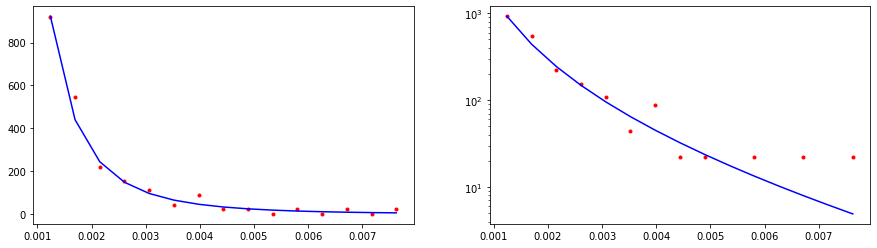

CPU times: user 805 µs, sys: 0 ns, total: 805 µs
Wall time: 521 µs
41938.331500600565


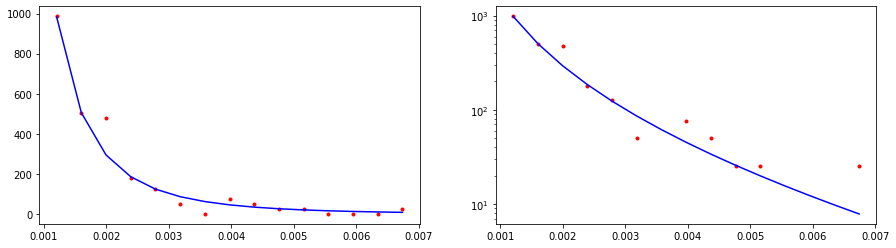

CPU times: user 462 µs, sys: 58 µs, total: 520 µs
Wall time: 340 µs
75384.2744102741


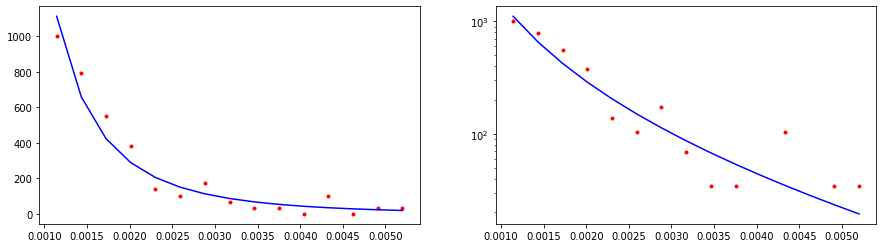

CPU times: user 520 µs, sys: 0 ns, total: 520 µs
Wall time: 392 µs
23798.278509812848


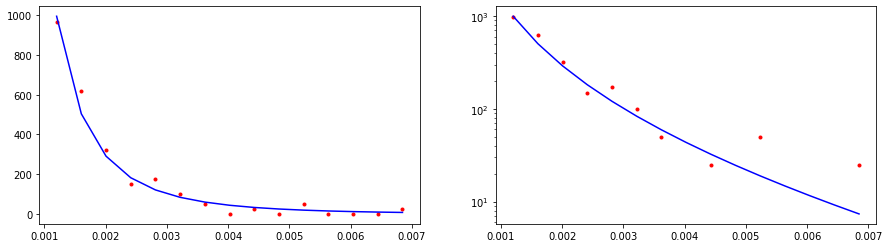

CPU times: user 0 ns, sys: 552 µs, total: 552 µs
Wall time: 373 µs
42204.704533046155


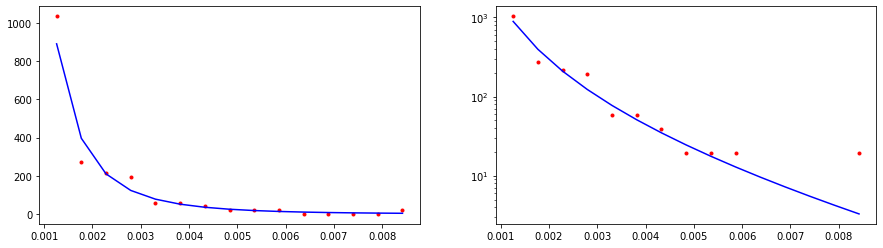

CPU times: user 581 µs, sys: 73 µs, total: 654 µs
Wall time: 455 µs
62536.55483305012


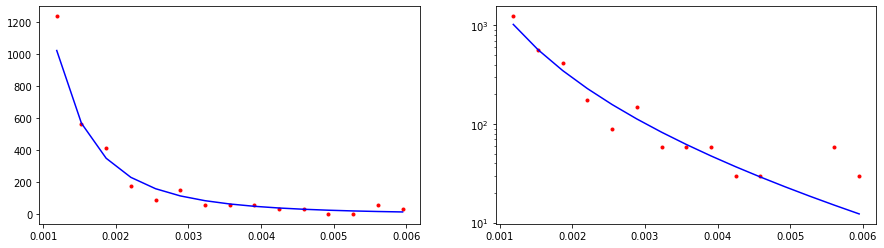

CPU times: user 546 µs, sys: 68 µs, total: 614 µs
Wall time: 438 µs
26464.58258612168


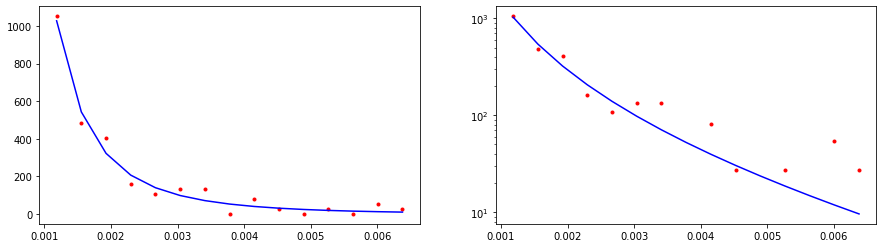

CPU times: user 710 µs, sys: 0 ns, total: 710 µs
Wall time: 532 µs
15705.334705546322


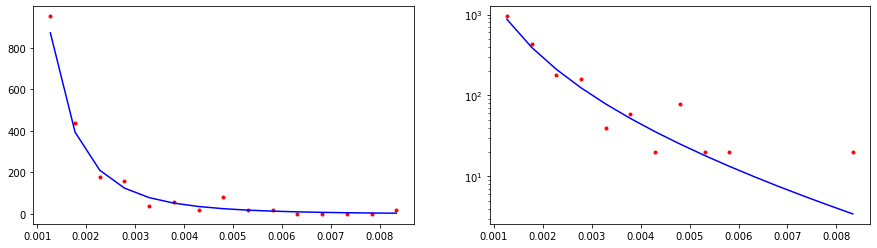

CPU times: user 795 µs, sys: 100 µs, total: 895 µs
Wall time: 708 µs
29447.229153621247


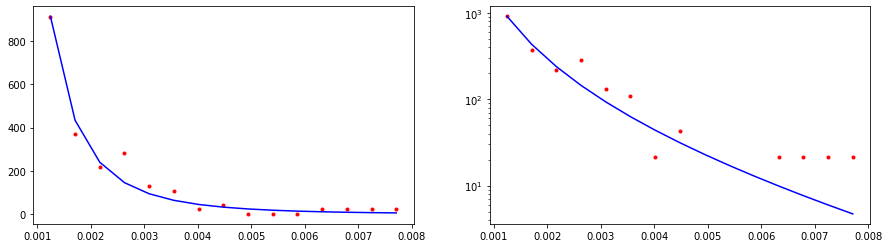

CPU times: user 1.09 ms, sys: 12 µs, total: 1.1 ms
Wall time: 902 µs
46124.20580258512


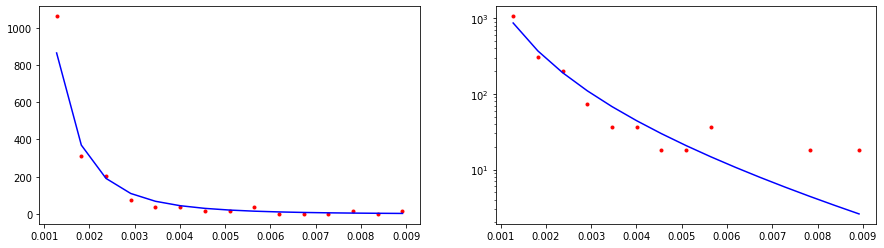

CPU times: user 1.22 ms, sys: 0 ns, total: 1.22 ms
Wall time: 1.04 ms
26406.463347743076


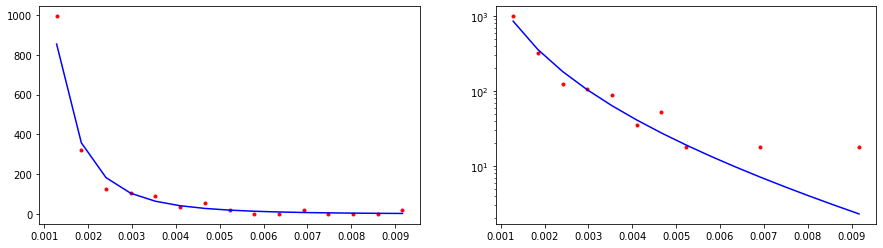

CPU times: user 1.38 ms, sys: 49 µs, total: 1.43 ms
Wall time: 1.26 ms
42944.758216366245


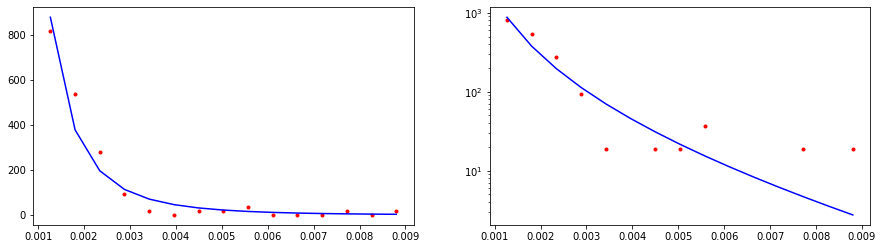

CPU times: user 1.53 ms, sys: 0 ns, total: 1.53 ms
Wall time: 1.37 ms
21905.78938713569


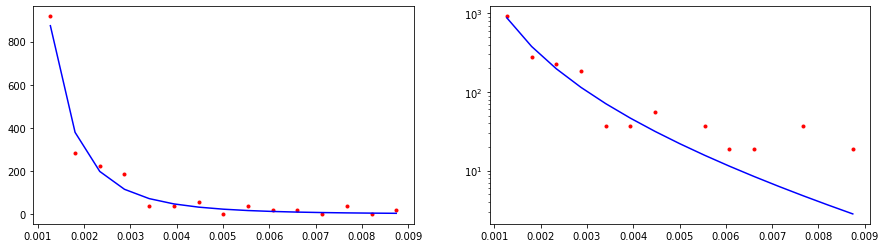

CPU times: user 1.76 ms, sys: 0 ns, total: 1.76 ms
Wall time: 1.57 ms
39119.440732233765


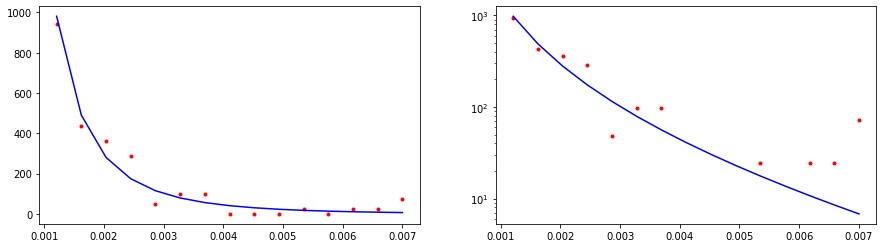

CPU times: user 1.87 ms, sys: 7 µs, total: 1.87 ms
Wall time: 1.67 ms
45814.716783541575


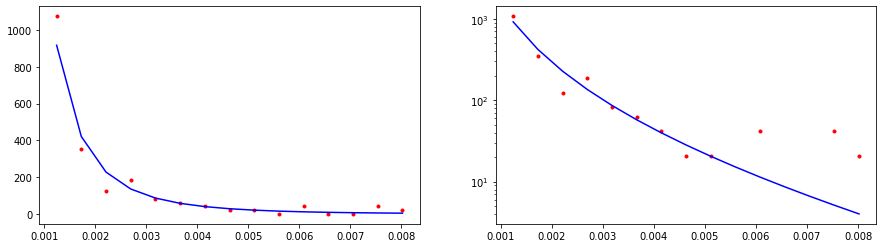

CPU times: user 1.09 ms, sys: 885 µs, total: 1.98 ms
Wall time: 1.82 ms
7645.65187314772


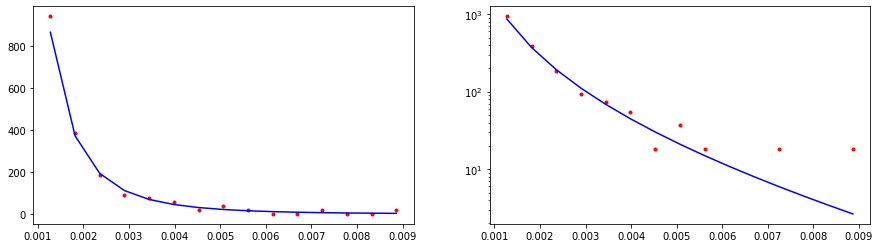

CPU times: user 665 µs, sys: 0 ns, total: 665 µs
Wall time: 427 µs
11323.322716800707


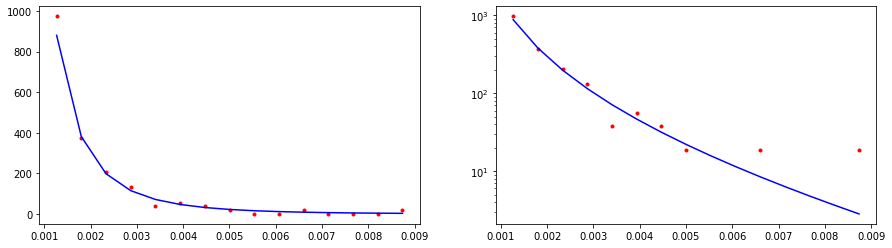

CPU times: user 0 ns, sys: 493 µs, total: 493 µs
Wall time: 302 µs
360219.92943773605


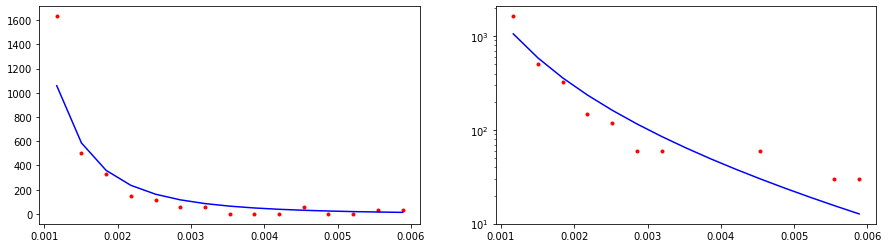

CPU times: user 486 µs, sys: 61 µs, total: 547 µs
Wall time: 353 µs
37969.286439235984


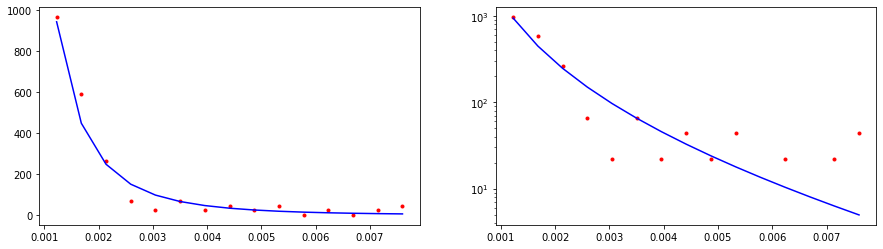

CPU times: user 455 µs, sys: 57 µs, total: 512 µs
Wall time: 403 µs
112473.08738244243


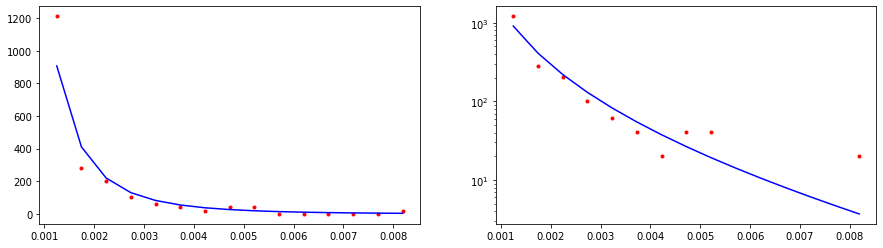

CPU times: user 555 µs, sys: 70 µs, total: 625 µs
Wall time: 440 µs
23734.309281465594


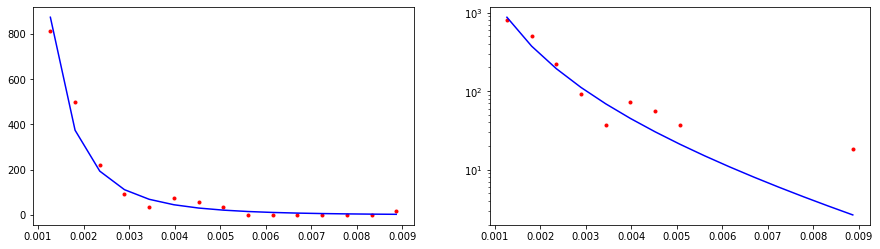

CPU times: user 618 µs, sys: 0 ns, total: 618 µs
Wall time: 445 µs
109766.80755257682


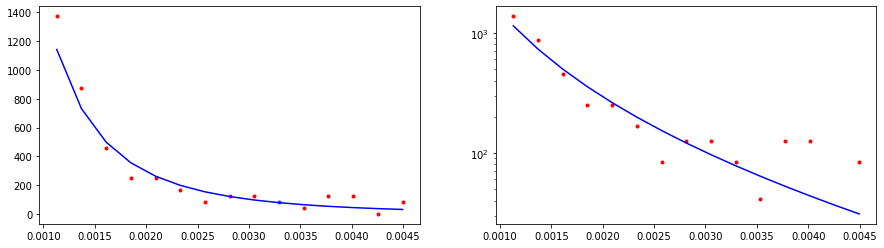

CPU times: user 753 µs, sys: 0 ns, total: 753 µs
Wall time: 573 µs
13499.987500203122


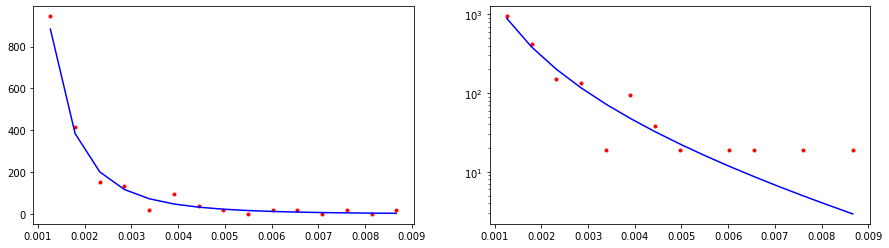

CPU times: user 841 µs, sys: 0 ns, total: 841 µs
Wall time: 674 µs
74245.14845922362


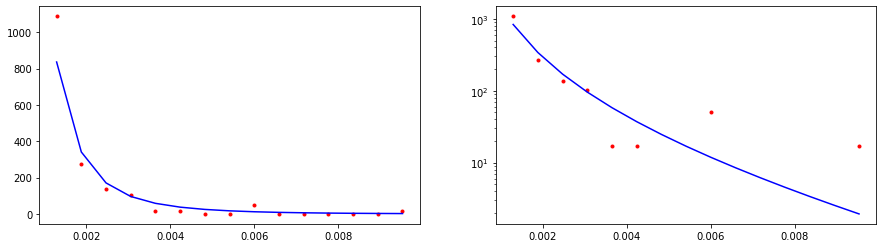

CPU times: user 1 ms, sys: 9 µs, total: 1.01 ms
Wall time: 883 µs
25831.44986563434


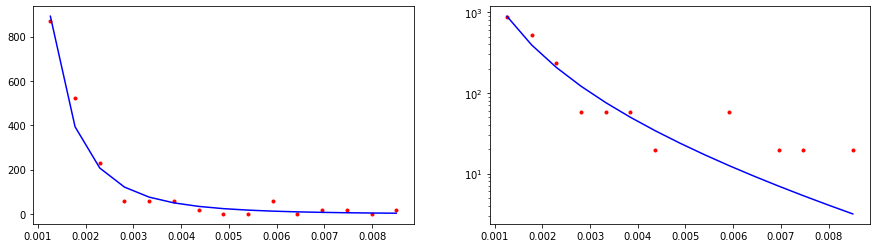

CPU times: user 305 µs, sys: 913 µs, total: 1.22 ms
Wall time: 1.07 ms
6575.620107133089


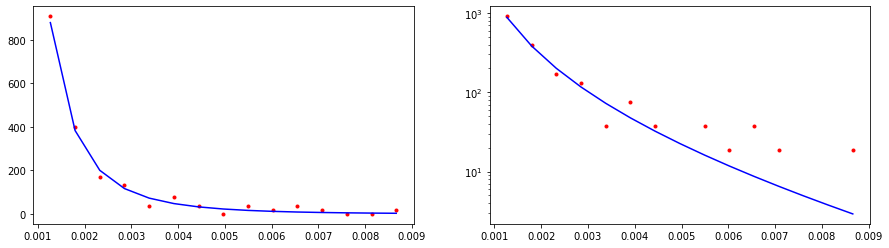

CPU times: user 1.32 ms, sys: 40 µs, total: 1.36 ms
Wall time: 1.2 ms
10050.129622245


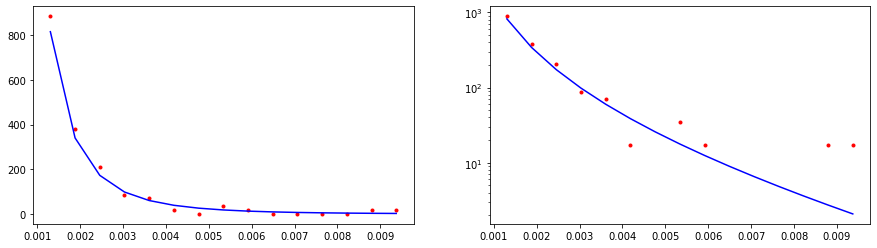

CPU times: user 1.55 ms, sys: 69 µs, total: 1.61 ms
Wall time: 1.43 ms
28524.25173933042


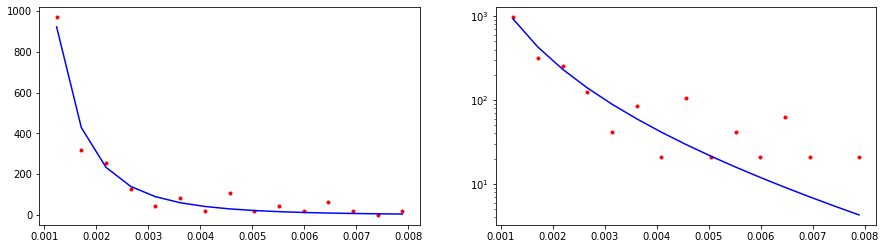

CPU times: user 1.7 ms, sys: 0 ns, total: 1.7 ms
Wall time: 1.51 ms
95350.38558053397


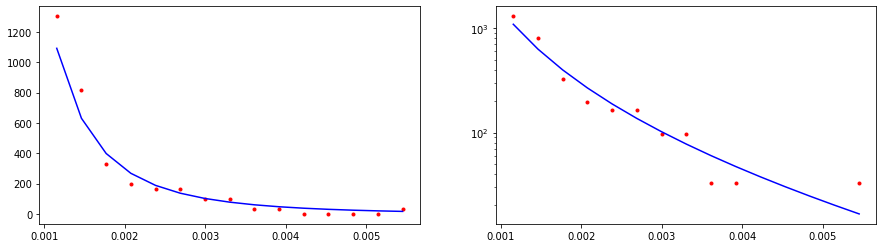

CPU times: user 1.77 ms, sys: 0 ns, total: 1.77 ms
Wall time: 1.6 ms
13230.804715478316


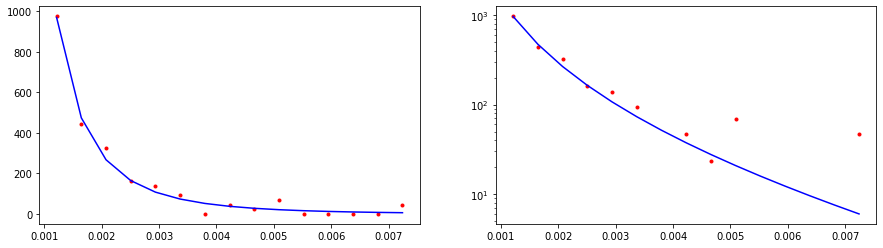

CPU times: user 2.02 ms, sys: 3 µs, total: 2.02 ms
Wall time: 1.85 ms
86856.88734441422


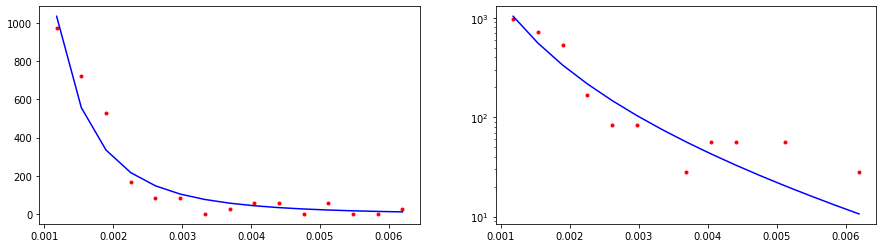

CPU times: user 729 µs, sys: 0 ns, total: 729 µs
Wall time: 474 µs
33692.50671597715


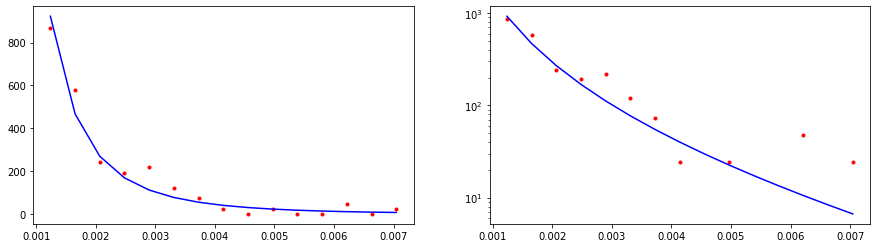

CPU times: user 453 µs, sys: 57 µs, total: 510 µs
Wall time: 344 µs
74159.32138554651


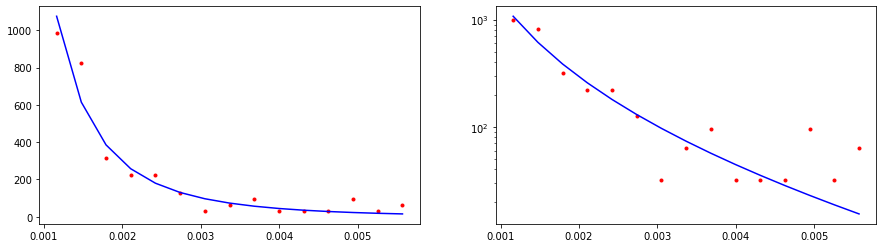

CPU times: user 376 µs, sys: 47 µs, total: 423 µs
Wall time: 328 µs
23288.001796810175


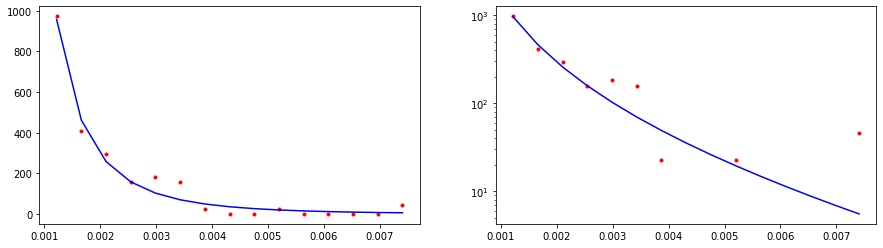

CPU times: user 458 µs, sys: 58 µs, total: 516 µs
Wall time: 407 µs
20959.090763783046


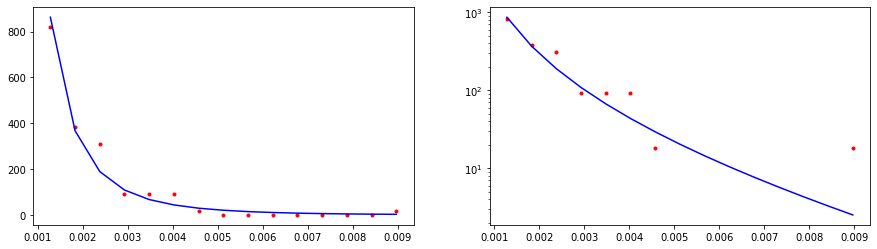

CPU times: user 626 µs, sys: 0 ns, total: 626 µs
Wall time: 462 µs
98567.82979852406


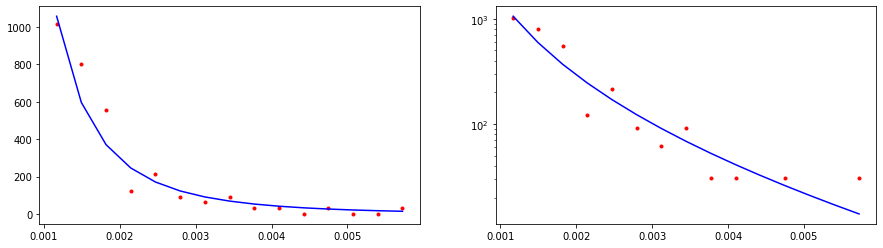

CPU times: user 649 µs, sys: 0 ns, total: 649 µs
Wall time: 504 µs
11205.155057476846


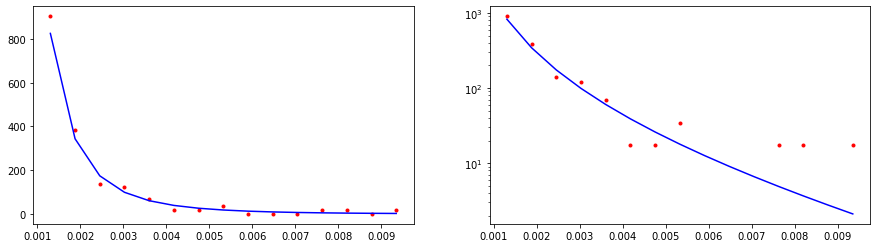

CPU times: user 607 µs, sys: 0 ns, total: 607 µs
Wall time: 512 µs
122310.5370401325


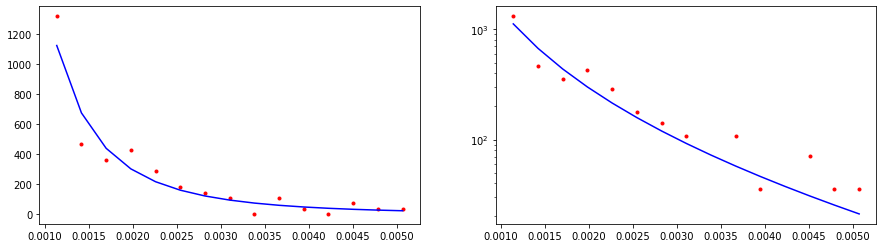

CPU times: user 802 µs, sys: 0 ns, total: 802 µs
Wall time: 630 µs
18548.17341187771


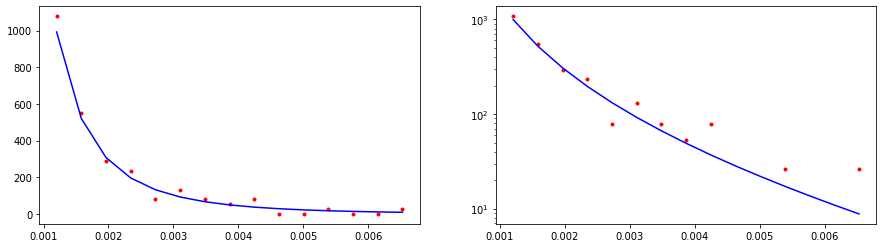

CPU times: user 824 µs, sys: 105 µs, total: 929 µs
Wall time: 807 µs
66162.81047961718


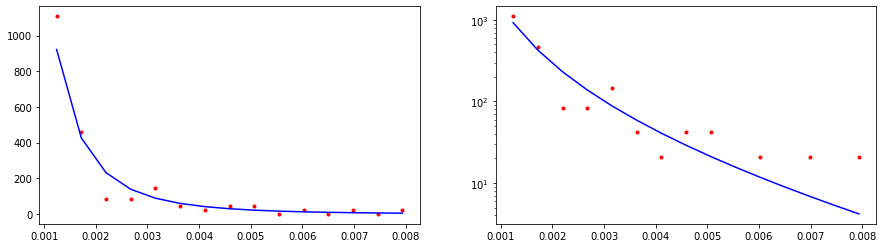

CPU times: user 1.11 ms, sys: 14 µs, total: 1.12 ms
Wall time: 1.02 ms
16253.025668788561


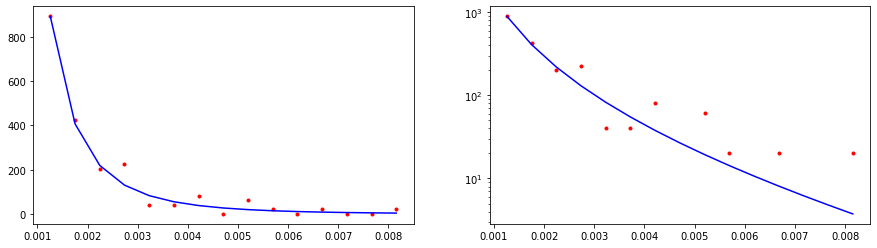

CPU times: user 1.29 ms, sys: 38 µs, total: 1.33 ms
Wall time: 1.22 ms
50060.46616099223


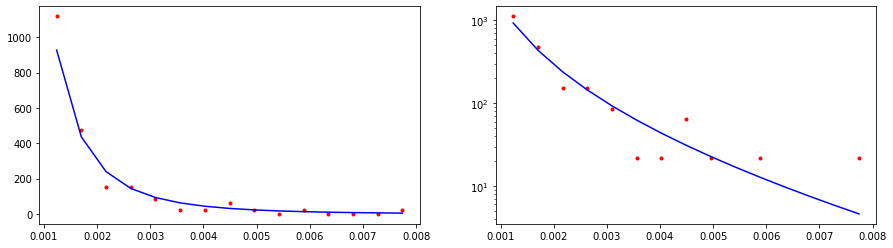

CPU times: user 658 µs, sys: 879 µs, total: 1.54 ms
Wall time: 1.37 ms
56341.09019494946


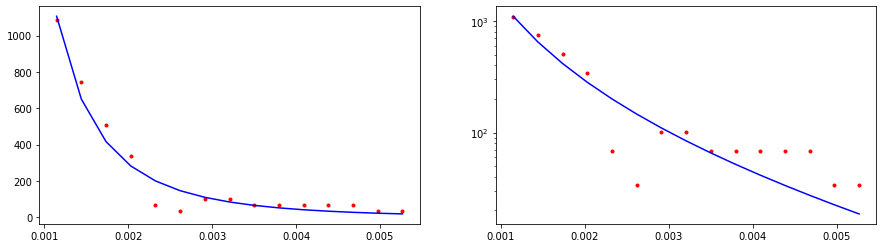

CPU times: user 835 µs, sys: 849 µs, total: 1.68 ms
Wall time: 1.49 ms
104841.59886508292


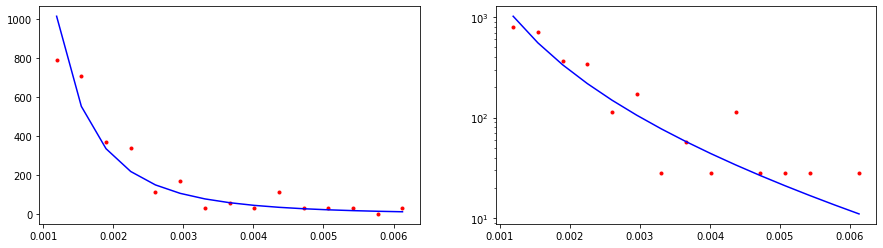

CPU times: user 1.72 ms, sys: 92 µs, total: 1.81 ms
Wall time: 1.62 ms
3430.655185668901


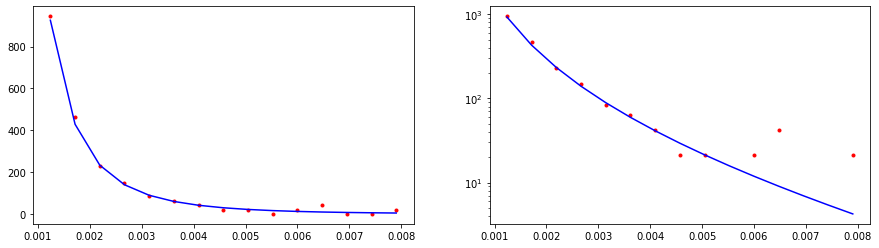

CPU times: user 2.07 ms, sys: 11 µs, total: 2.09 ms
Wall time: 1.89 ms
26162.24919667226


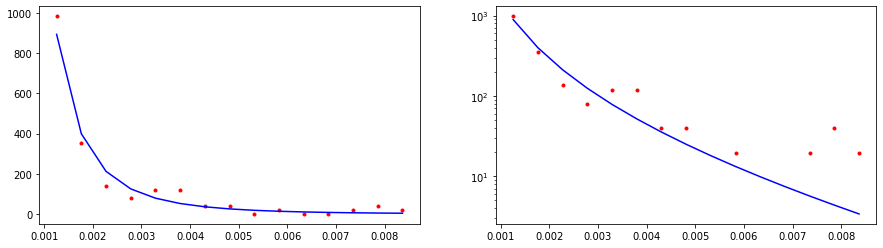

CPU times: user 666 µs, sys: 0 ns, total: 666 µs
Wall time: 424 µs
44245.83339878616


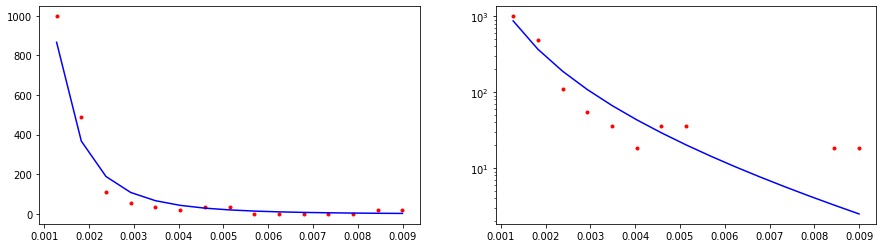

CPU times: user 506 µs, sys: 0 ns, total: 506 µs
Wall time: 342 µs
31737.611227964222


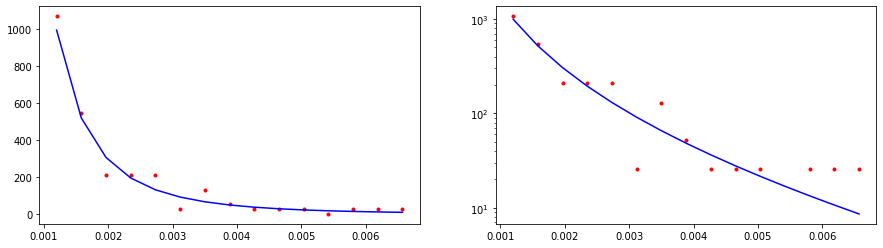

CPU times: user 0 ns, sys: 582 µs, total: 582 µs
Wall time: 402 µs
24410.75719686988


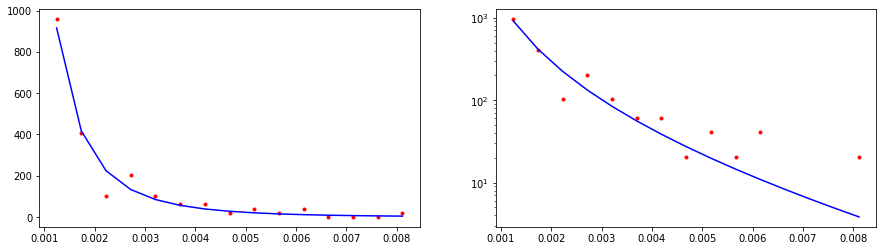

CPU times: user 530 µs, sys: 0 ns, total: 530 µs
Wall time: 367 µs
66109.97253403813


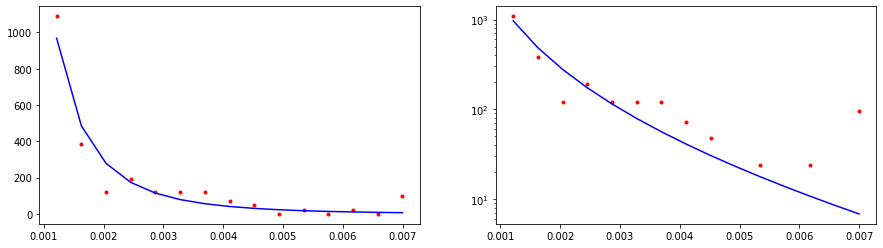

CPU times: user 520 µs, sys: 67 µs, total: 587 µs
Wall time: 415 µs
5265.960876284439


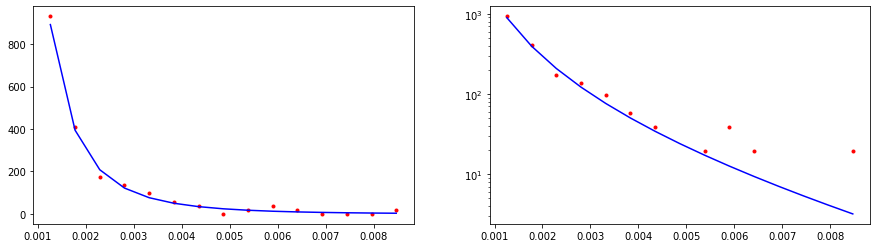

CPU times: user 573 µs, sys: 73 µs, total: 646 µs
Wall time: 475 µs
172234.46435824782


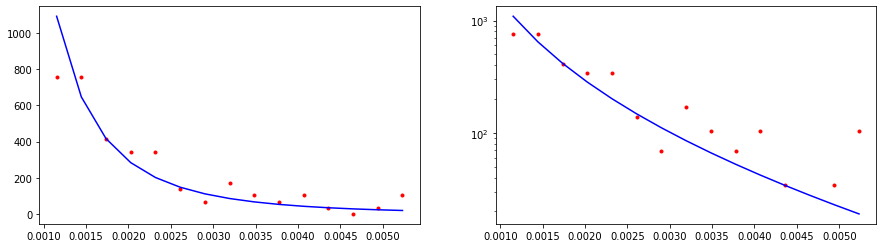

CPU times: user 667 µs, sys: 0 ns, total: 667 µs
Wall time: 518 µs
41727.696710463264


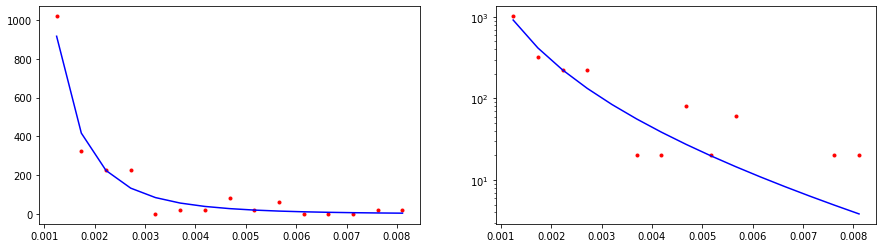

CPU times: user 725 µs, sys: 93 µs, total: 818 µs
Wall time: 666 µs
25458.314375847945


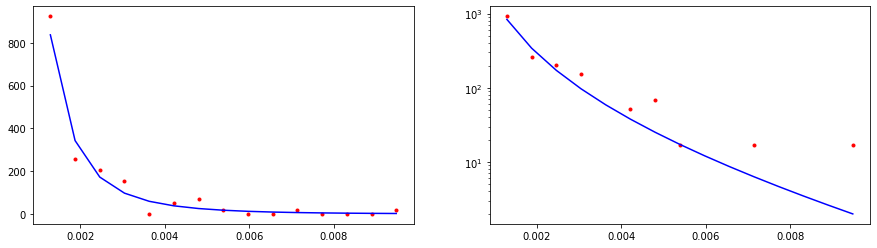

CPU times: user 1.05 ms, sys: 7 µs, total: 1.05 ms
Wall time: 891 µs
88906.76118366375


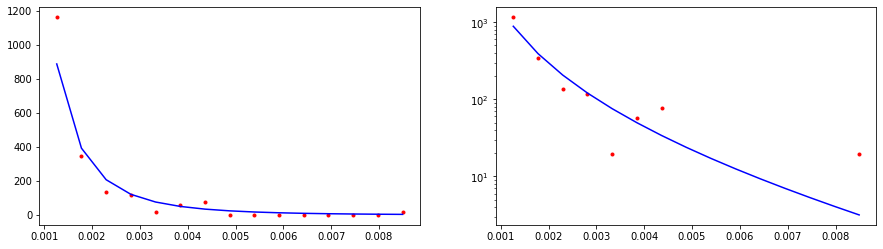

CPU times: user 1.21 ms, sys: 28 µs, total: 1.24 ms
Wall time: 1.07 ms
39418.74264863509


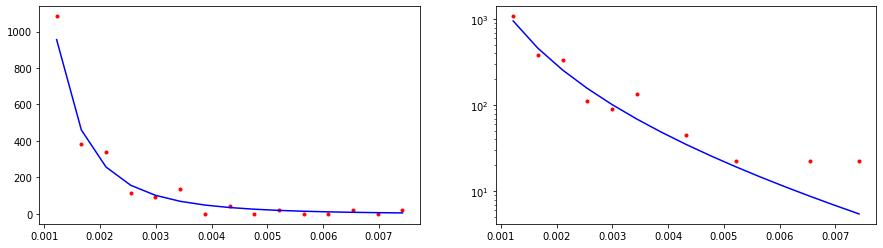

CPU times: user 1.35 ms, sys: 45 µs, total: 1.39 ms
Wall time: 1.27 ms
50014.19607371646


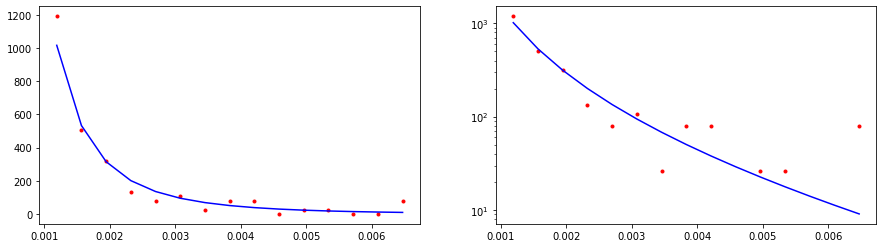

CPU times: user 1.51 ms, sys: 66 µs, total: 1.57 ms
Wall time: 1.4 ms
41839.047237600695


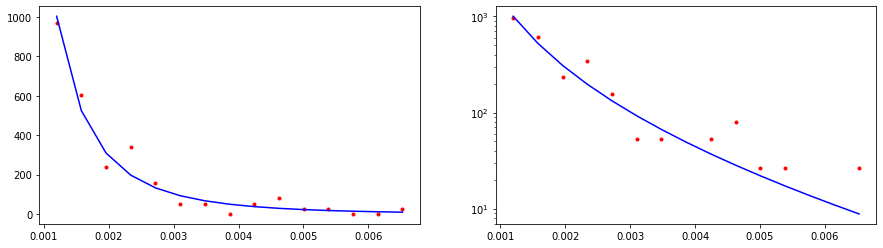

CPU times: user 1.61 ms, sys: 78 µs, total: 1.69 ms
Wall time: 1.51 ms
83711.11947365385


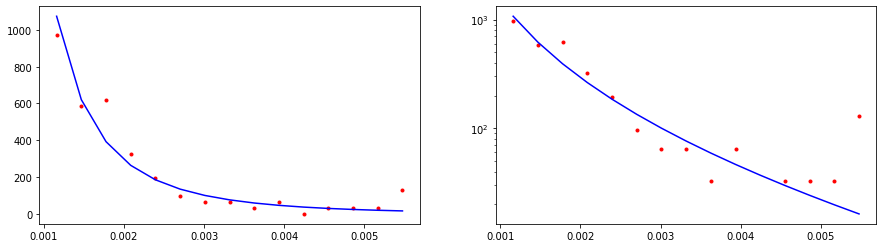

CPU times: user 1.88 ms, sys: 0 ns, total: 1.88 ms
Wall time: 1.71 ms
21060.253235589687


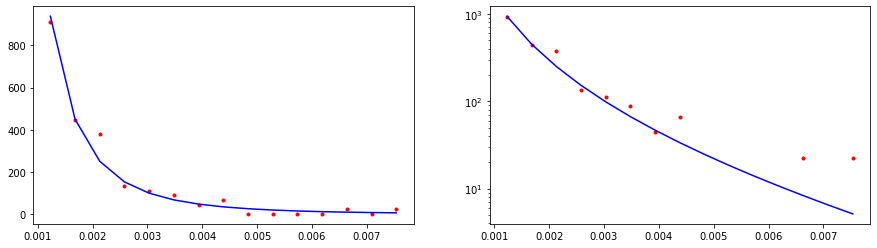

CPU times: user 2.06 ms, sys: 9 µs, total: 2.07 ms
Wall time: 1.9 ms
55426.622338150184


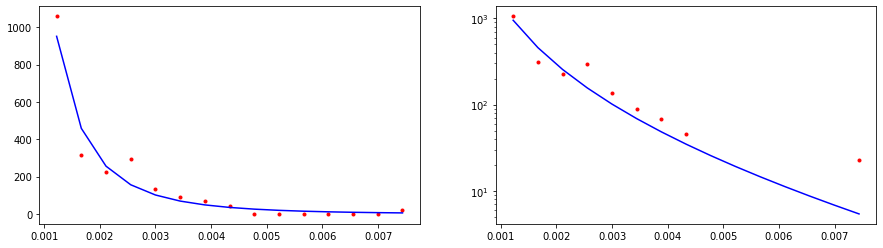

CPU times: user 588 µs, sys: 75 µs, total: 663 µs
Wall time: 420 µs
39712.960421704774


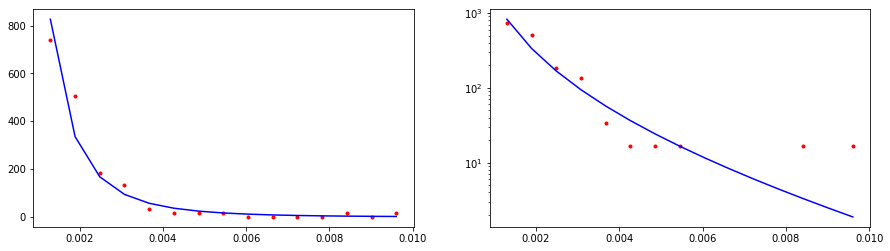

CPU times: user 0 ns, sys: 510 µs, total: 510 µs
Wall time: 343 µs
22925.779745376156


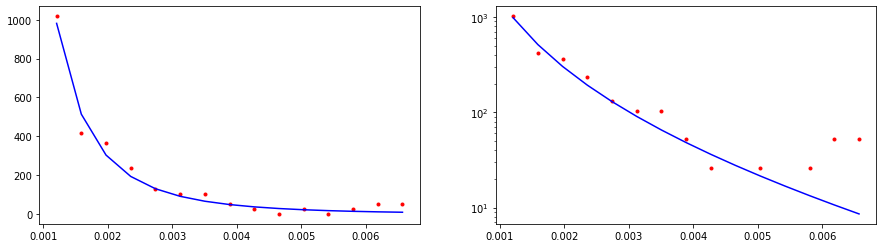

CPU times: user 551 µs, sys: 0 ns, total: 551 µs
Wall time: 374 µs
103281.94441678694


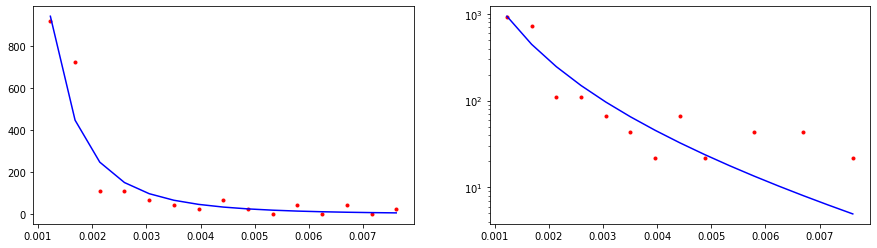

CPU times: user 0 ns, sys: 600 µs, total: 600 µs
Wall time: 433 µs
58903.20580597535


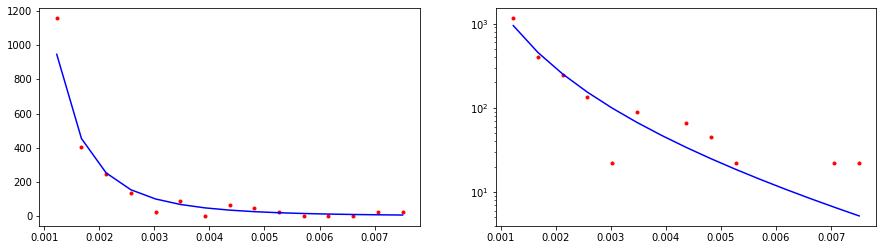

CPU times: user 638 µs, sys: 0 ns, total: 638 µs
Wall time: 467 µs
44143.71614850833


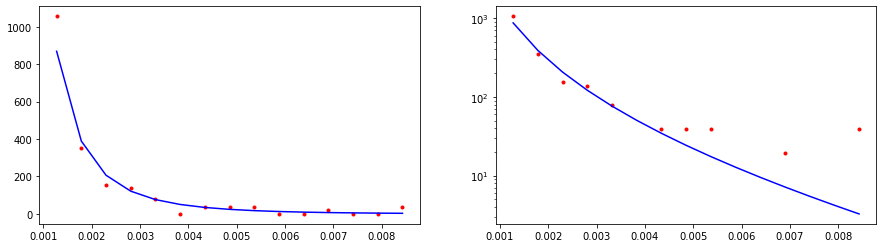

CPU times: user 637 µs, sys: 0 ns, total: 637 µs
Wall time: 474 µs
22104.267258967793


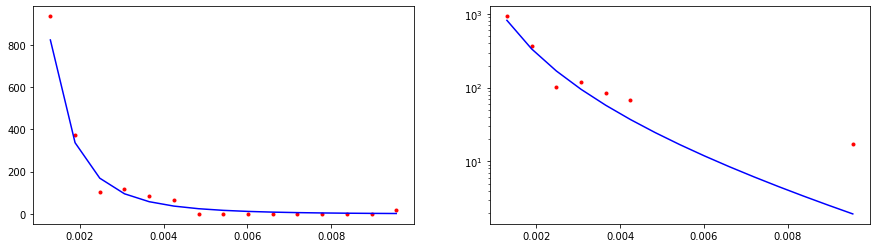

CPU times: user 685 µs, sys: 0 ns, total: 685 µs
Wall time: 531 µs
225042.32190936912


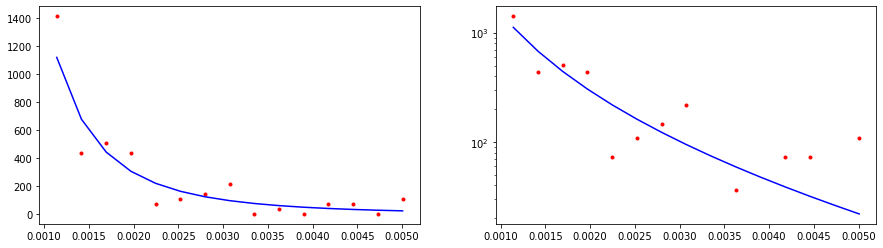

CPU times: user 854 µs, sys: 0 ns, total: 854 µs
Wall time: 626 µs
65379.923282323274


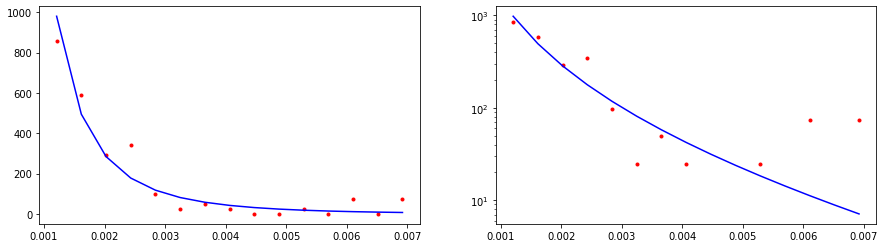

CPU times: user 1.04 ms, sys: 5 µs, total: 1.04 ms
Wall time: 886 µs
32241.739947373735


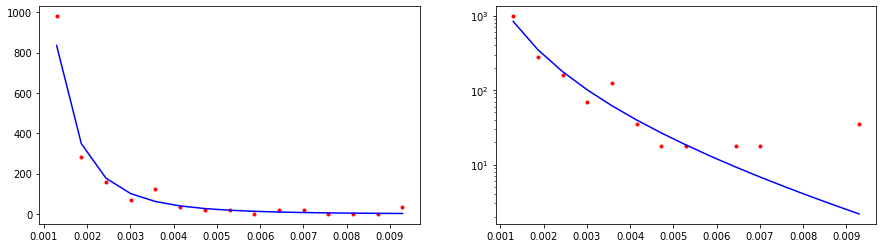

CPU times: user 363 µs, sys: 915 µs, total: 1.28 ms
Wall time: 1.06 ms
38916.08176249117


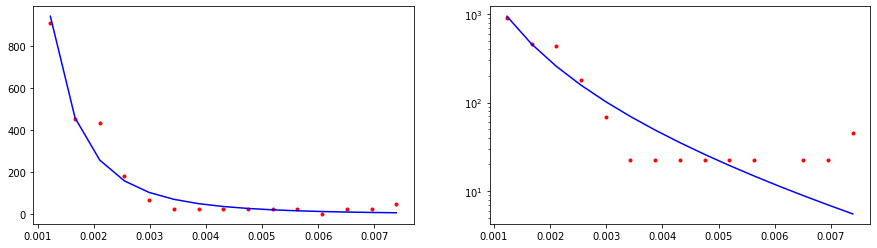

CPU times: user 528 µs, sys: 859 µs, total: 1.39 ms
Wall time: 1.2 ms
17412.20905177651


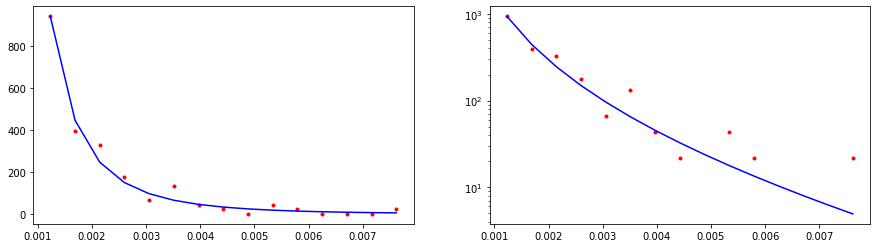

CPU times: user 1.5 ms, sys: 66 µs, total: 1.57 ms
Wall time: 1.39 ms
119586.25025205831


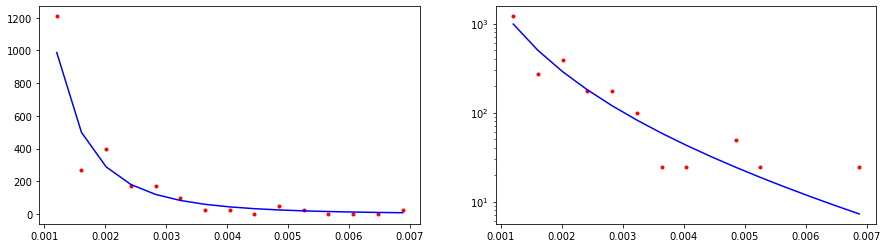

CPU times: user 1.73 ms, sys: 0 ns, total: 1.73 ms
Wall time: 1.55 ms
91251.58008182199


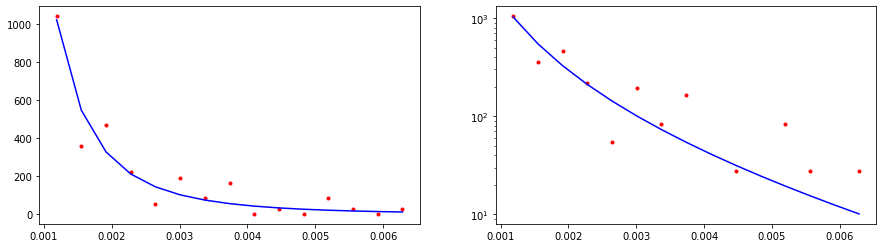

CPU times: user 1.9 ms, sys: 0 ns, total: 1.9 ms
Wall time: 1.71 ms
52414.55704745152


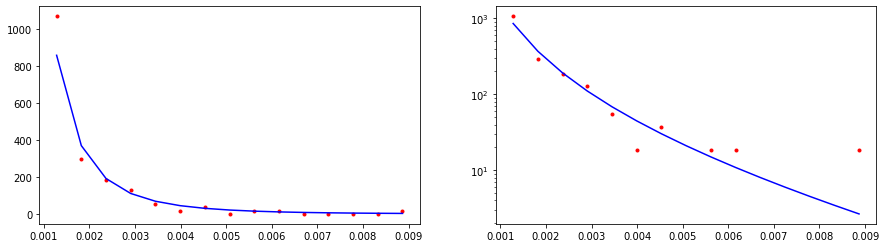

CPU times: user 2 ms, sys: 3 µs, total: 2.01 ms
Wall time: 1.83 ms
37313.07629393348


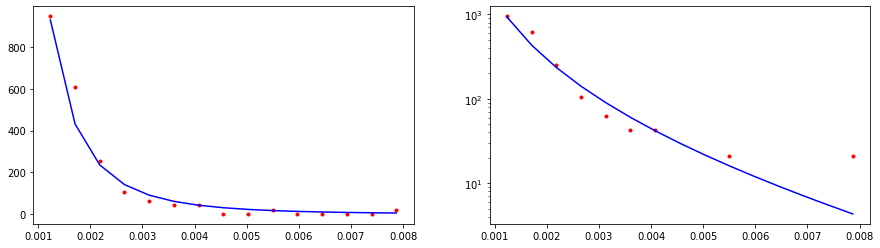

CPU times: user 545 µs, sys: 70 µs, total: 615 µs
Wall time: 376 µs
13623.52290342207


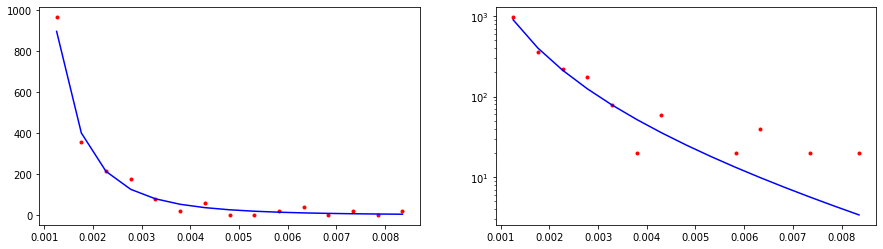

CPU times: user 0 ns, sys: 492 µs, total: 492 µs
Wall time: 324 µs
58571.16355497202


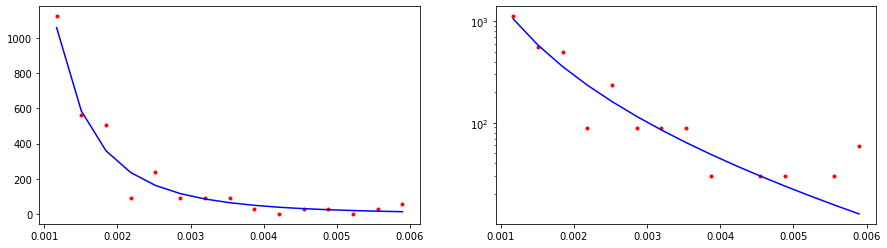

CPU times: user 426 µs, sys: 55 µs, total: 481 µs
Wall time: 334 µs
48966.38661952248


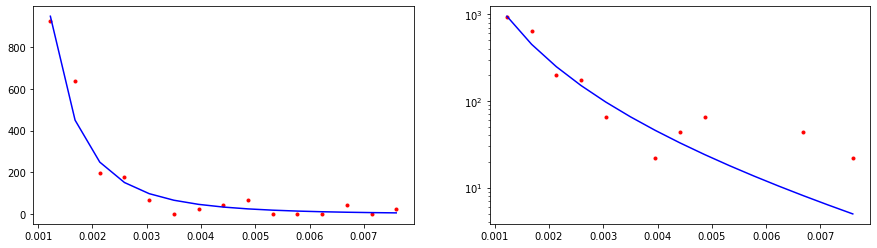

CPU times: user 0 ns, sys: 526 µs, total: 526 µs
Wall time: 382 µs
45070.93334467204


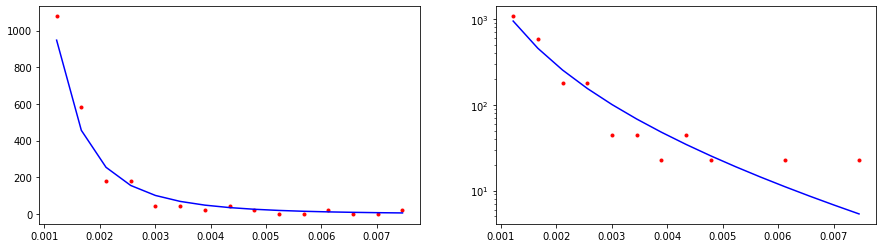

CPU times: user 0 ns, sys: 576 µs, total: 576 µs
Wall time: 418 µs
20195.98369544786


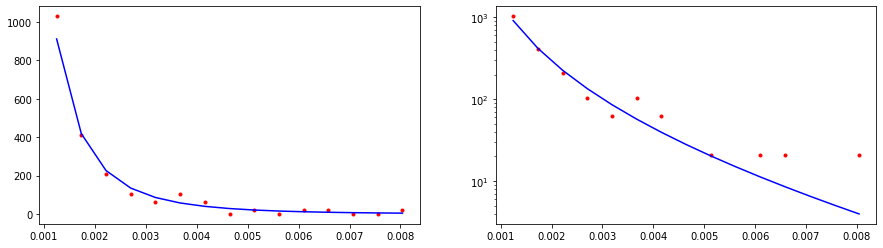

CPU times: user 550 µs, sys: 71 µs, total: 621 µs
Wall time: 499 µs
18999.86440896168


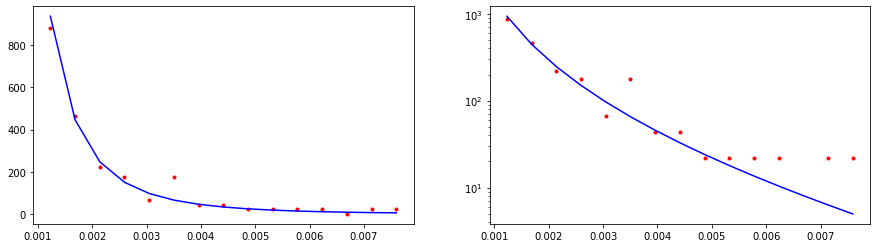

CPU times: user 713 µs, sys: 0 ns, total: 713 µs
Wall time: 535 µs
70244.96682913369


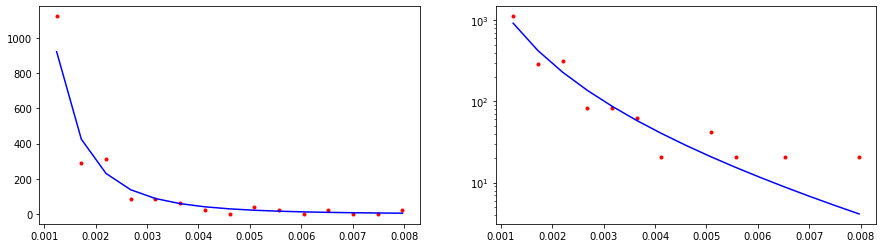

CPU times: user 812 µs, sys: 0 ns, total: 812 µs
Wall time: 636 µs
259164.1562804339


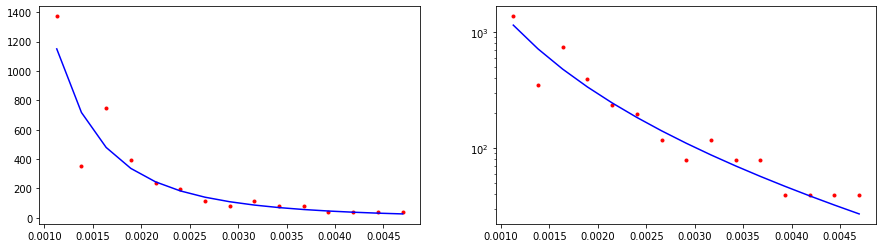

CPU times: user 1.01 ms, sys: 0 ns, total: 1.01 ms
Wall time: 871 µs
47506.17955723516


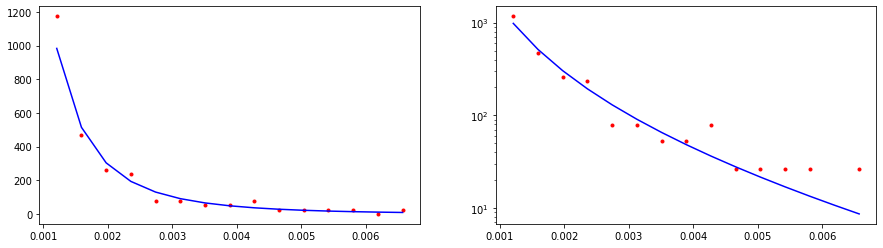

CPU times: user 1.17 ms, sys: 0 ns, total: 1.17 ms
Wall time: 1.01 ms
52047.65396875636


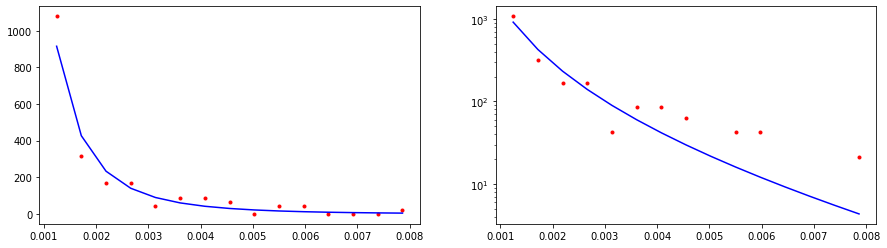

CPU times: user 1.32 ms, sys: 41 µs, total: 1.36 ms
Wall time: 1.19 ms
23191.102340499565


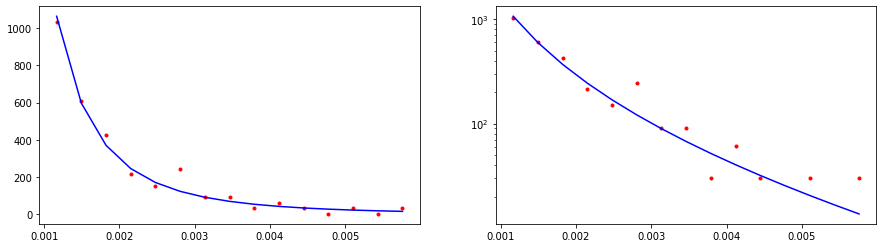

CPU times: user 1.38 ms, sys: 49 µs, total: 1.43 ms
Wall time: 1.27 ms
41265.52413653628


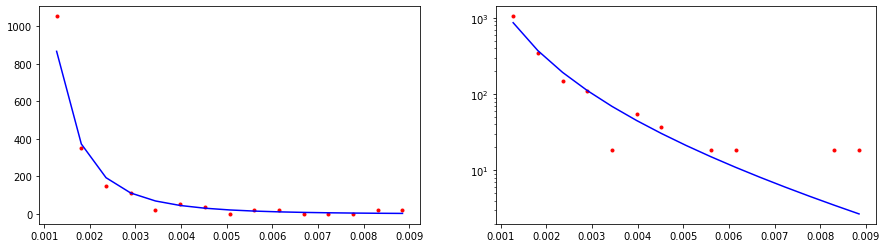

CPU times: user 1.63 ms, sys: 0 ns, total: 1.63 ms
Wall time: 1.48 ms
33733.82956840888


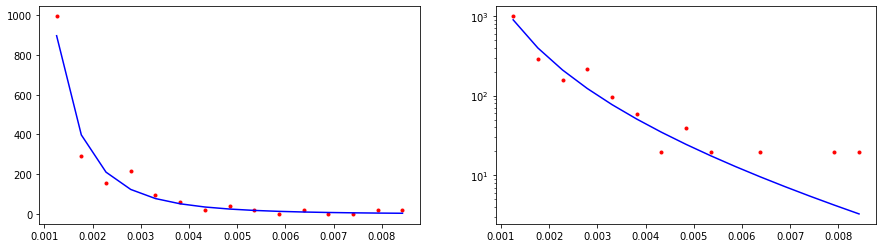

CPU times: user 1.07 ms, sys: 838 µs, total: 1.9 ms
Wall time: 1.71 ms
14240.06578350955


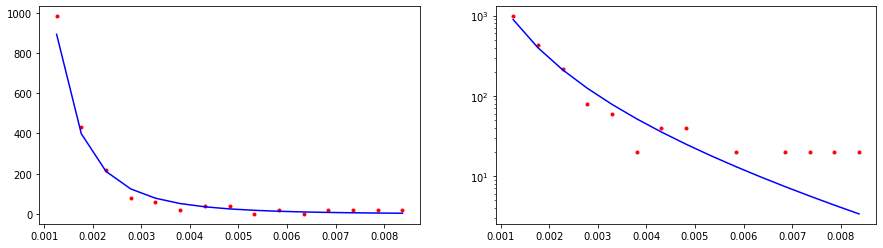

CPU times: user 1.99 ms, sys: 21 µs, total: 2.01 ms
Wall time: 1.82 ms
11778.483801518716


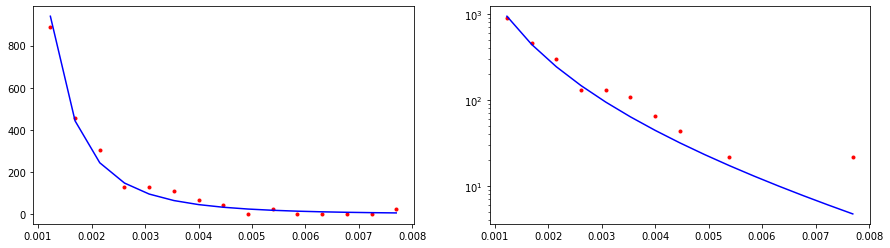

CPU times: user 504 µs, sys: 65 µs, total: 569 µs
Wall time: 375 µs
27004.513318537523


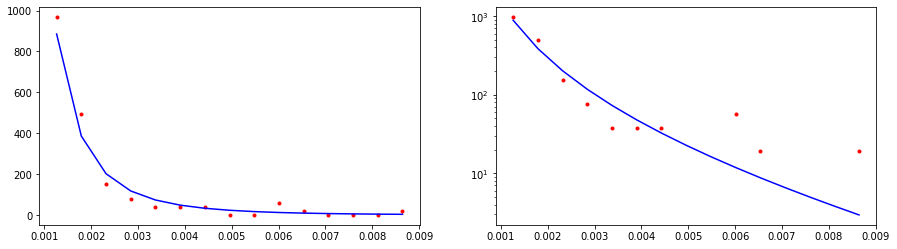

CPU times: user 551 µs, sys: 0 ns, total: 551 µs
Wall time: 371 µs
106195.11391766738


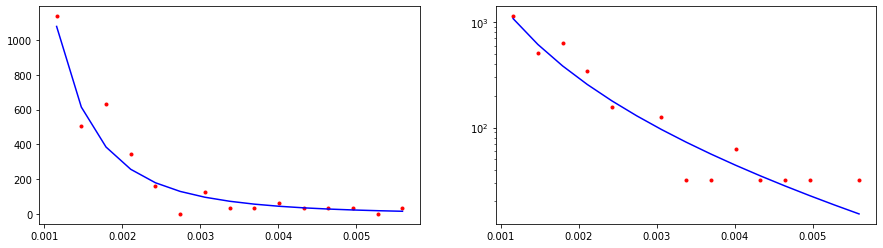

CPU times: user 455 µs, sys: 59 µs, total: 514 µs
Wall time: 359 µs
22416.21560312986


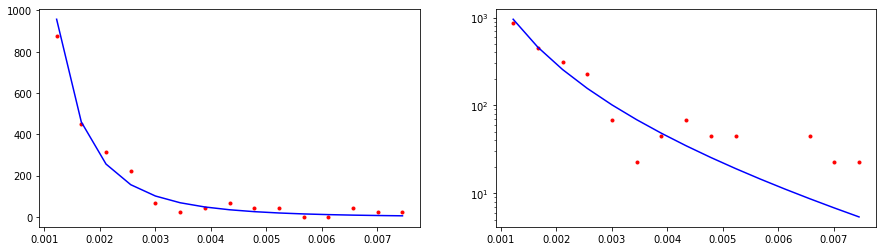

CPU times: user 0 ns, sys: 588 µs, total: 588 µs
Wall time: 431 µs
28271.604254143946


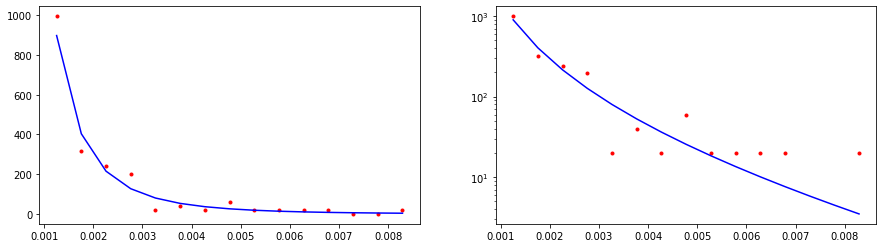

CPU times: user 600 µs, sys: 0 ns, total: 600 µs
Wall time: 442 µs
19879.541180009266


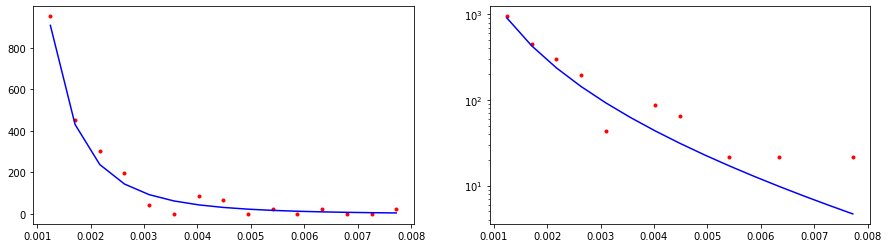

CPU times: user 577 µs, sys: 75 µs, total: 652 µs
Wall time: 485 µs
97928.65552980521


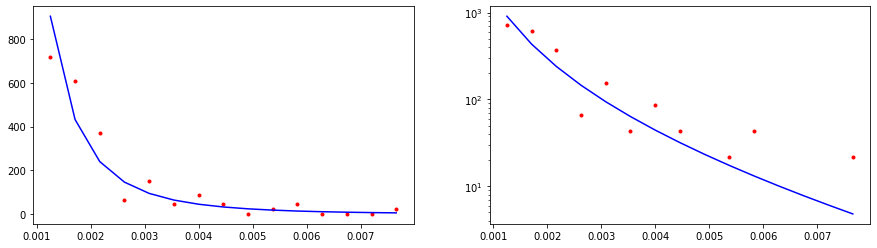

CPU times: user 634 µs, sys: 82 µs, total: 716 µs
Wall time: 528 µs
94161.94377237611


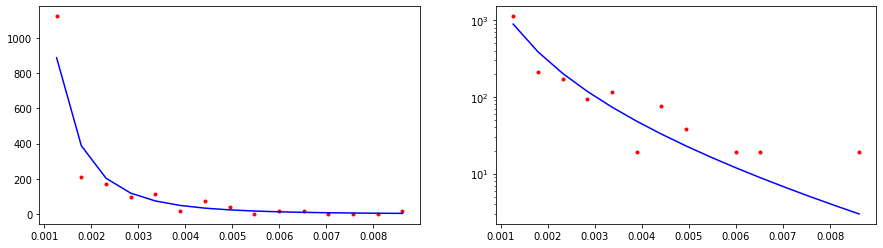

CPU times: user 859 µs, sys: 0 ns, total: 859 µs
Wall time: 697 µs
104451.32796270563


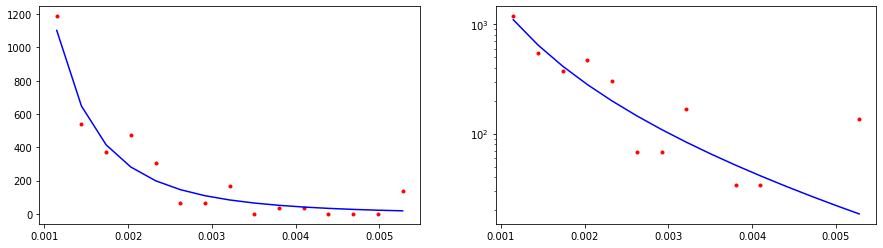

CPU times: user 1.08 ms, sys: 19 µs, total: 1.1 ms
Wall time: 925 µs
38201.64192013967


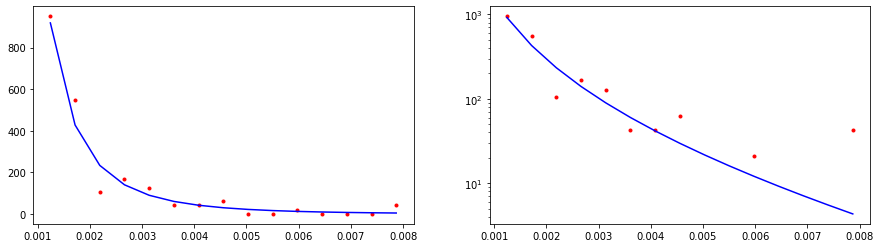

CPU times: user 1.21 ms, sys: 0 ns, total: 1.21 ms
Wall time: 1.03 ms
52673.15559631241


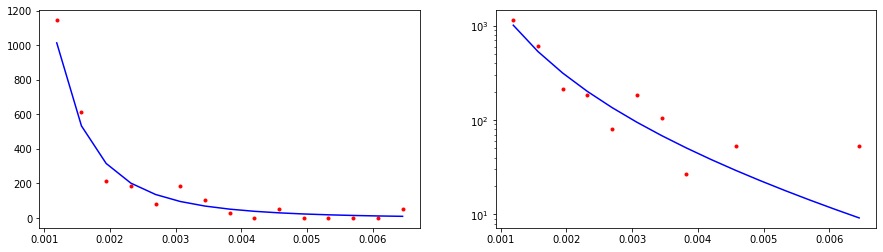

CPU times: user 1.32 ms, sys: 42 µs, total: 1.36 ms
Wall time: 1.22 ms
11772.833393505189


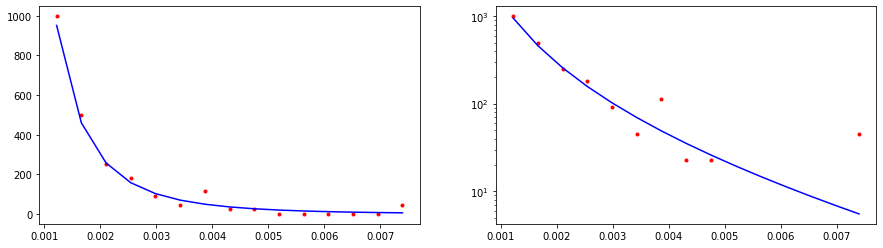

CPU times: user 1.53 ms, sys: 69 µs, total: 1.6 ms
Wall time: 1.43 ms
20264.03936658184


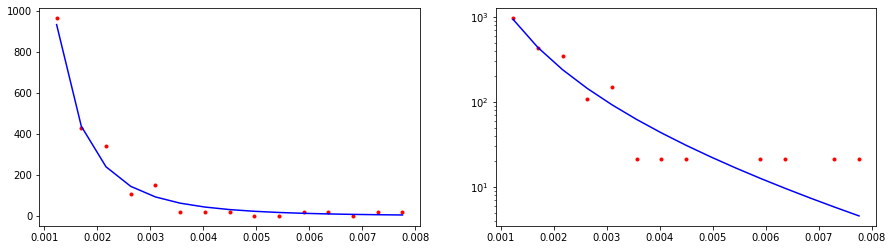

CPU times: user 1.77 ms, sys: 0 ns, total: 1.77 ms
Wall time: 1.59 ms
12385.884615502071


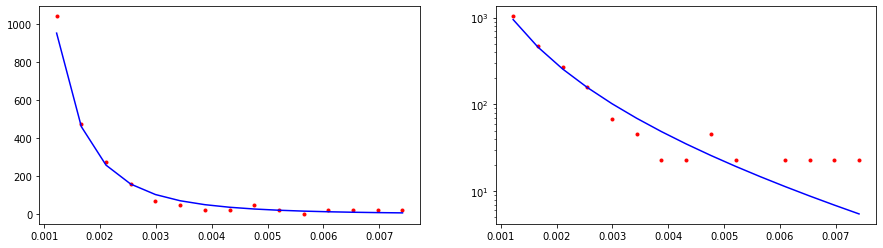

CPU times: user 1.87 ms, sys: 0 ns, total: 1.87 ms
Wall time: 1.7 ms
113681.897640542


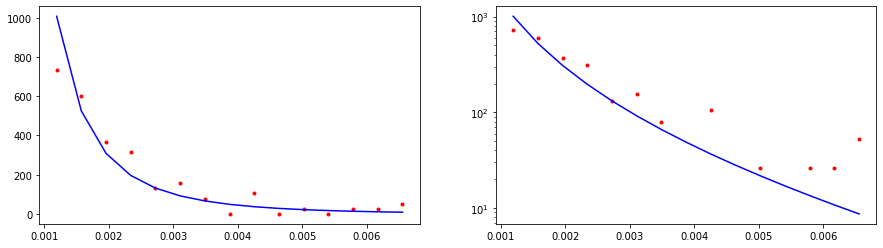

CPU times: user 2 ms, sys: 1e+03 ns, total: 2 ms
Wall time: 1.85 ms
24908.56337046472


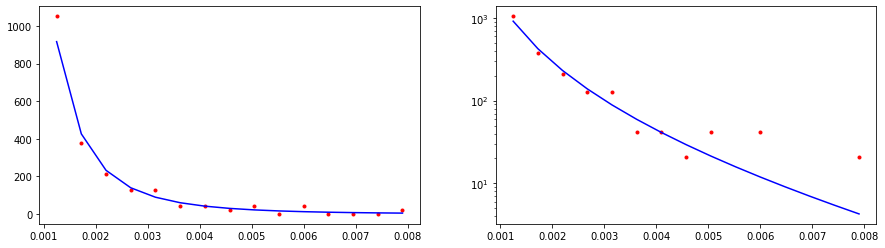

CPU times: user 568 µs, sys: 73 µs, total: 641 µs
Wall time: 401 µs
43183.55781184659


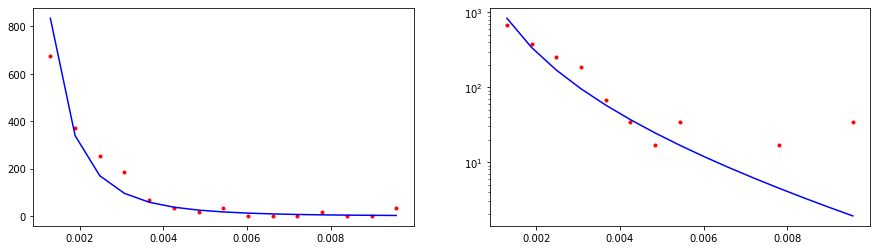

CPU times: user 431 µs, sys: 0 ns, total: 431 µs
Wall time: 325 µs
170412.76563443933


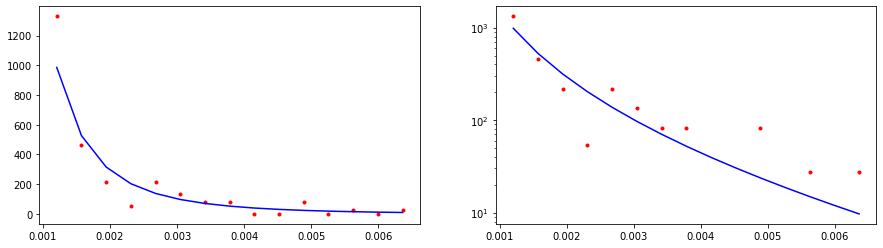

CPU times: user 476 µs, sys: 61 µs, total: 537 µs
Wall time: 376 µs
186151.6287091682


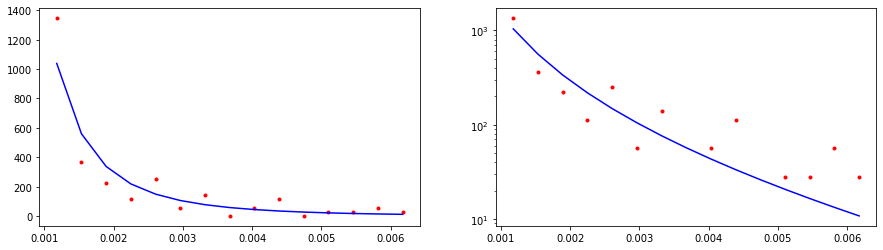

CPU times: user 586 µs, sys: 0 ns, total: 586 µs
Wall time: 426 µs
92747.86052916305


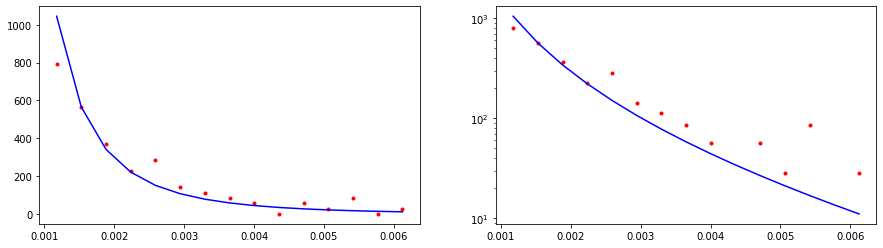

CPU times: user 0 ns, sys: 620 µs, total: 620 µs
Wall time: 444 µs
47533.61972065817


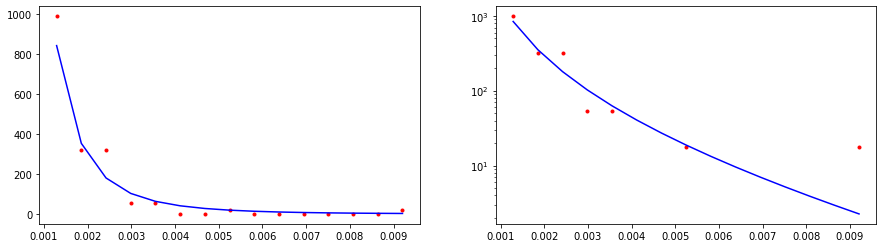

CPU times: user 573 µs, sys: 0 ns, total: 573 µs
Wall time: 447 µs
141012.86058369934


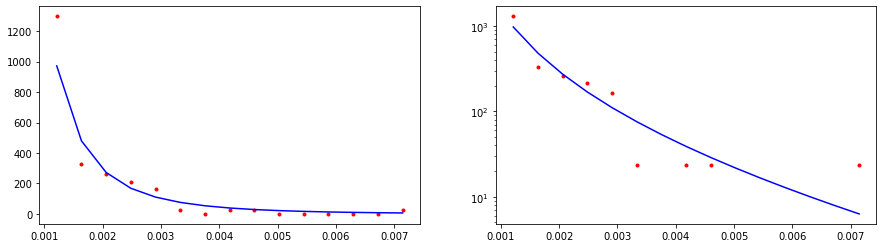

CPU times: user 563 µs, sys: 73 µs, total: 636 µs
Wall time: 478 µs
63498.48910846617


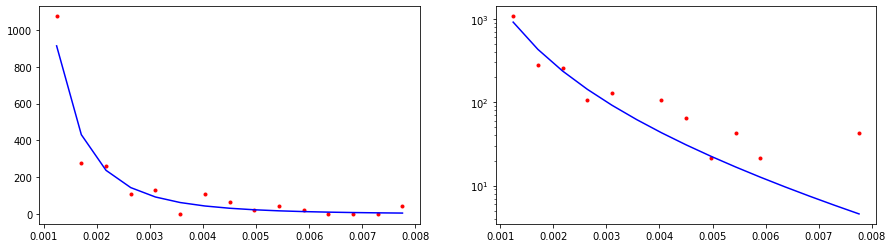

CPU times: user 793 µs, sys: 103 µs, total: 896 µs
Wall time: 709 µs
9646.48704944444


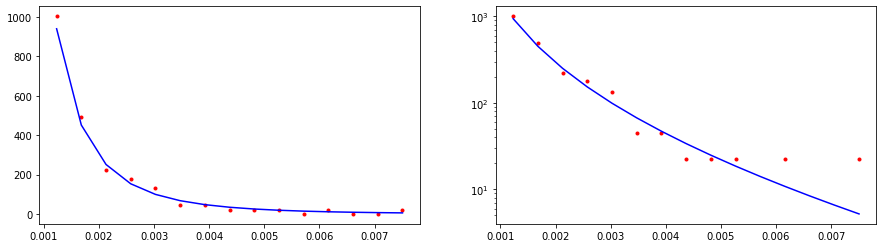

CPU times: user 1.03 ms, sys: 5 µs, total: 1.04 ms
Wall time: 878 µs
29027.30655584857


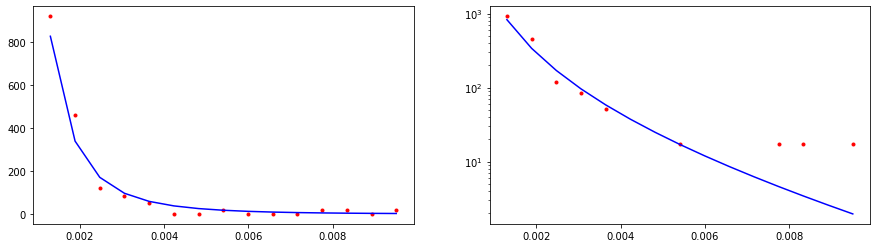

CPU times: user 1.12 ms, sys: 0 ns, total: 1.12 ms
Wall time: 958 µs
83847.74402165815


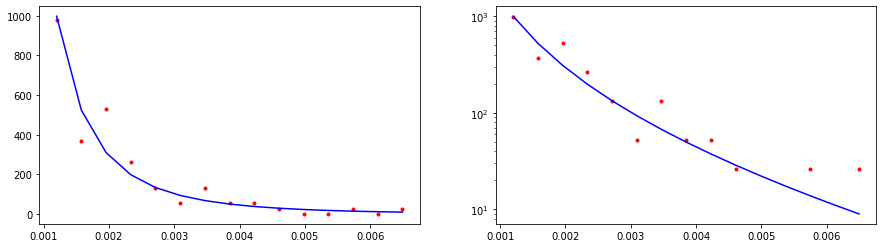

CPU times: user 1.37 ms, sys: 50 µs, total: 1.42 ms
Wall time: 1.24 ms
95429.71444599681


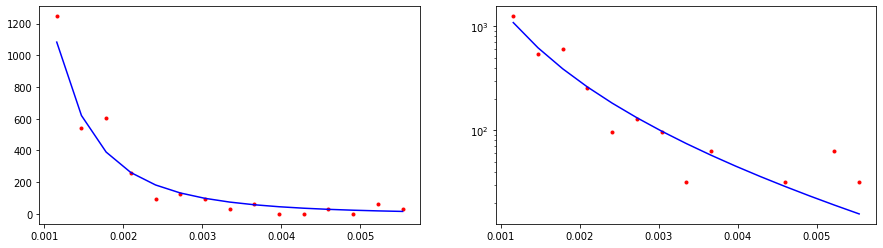

CPU times: user 1.4 ms, sys: 53 µs, total: 1.46 ms
Wall time: 1.28 ms
24651.74842292201


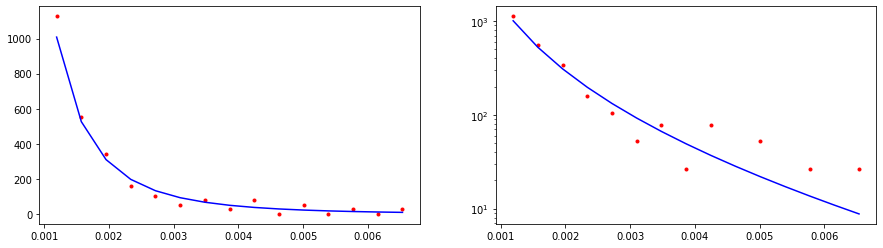

CPU times: user 1.67 ms, sys: 0 ns, total: 1.67 ms
Wall time: 1.53 ms
10716.131178988097


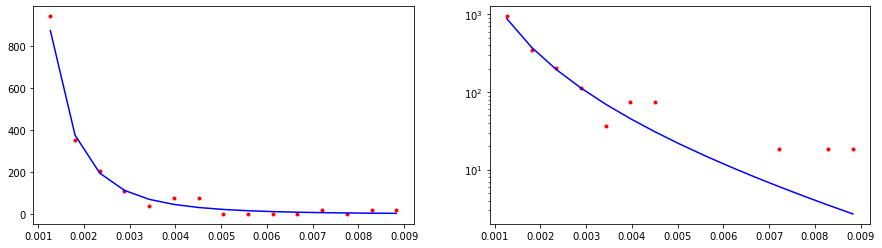

CPU times: user 1.84 ms, sys: 0 ns, total: 1.84 ms
Wall time: 1.66 ms
55492.267810716156


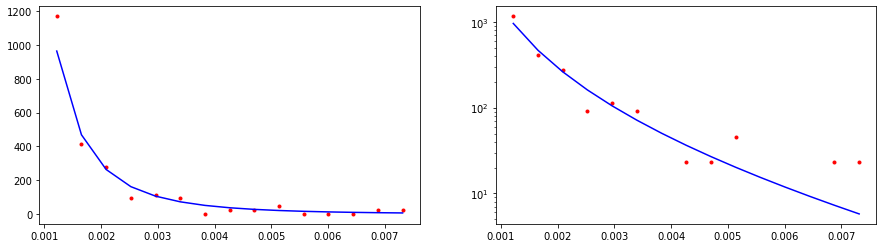

CPU times: user 2.02 ms, sys: 5 µs, total: 2.03 ms
Wall time: 1.86 ms
10482.230493076777


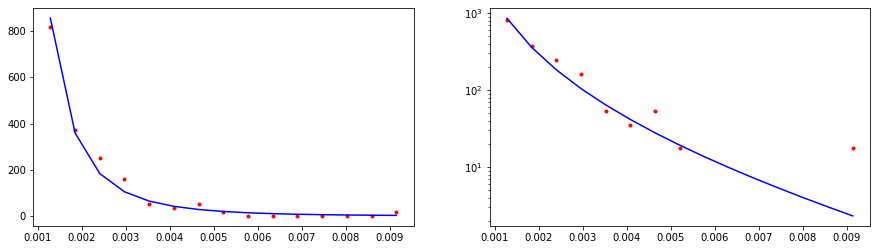

CPU times: user 660 µs, sys: 86 µs, total: 746 µs
Wall time: 478 µs
28165.890845121587


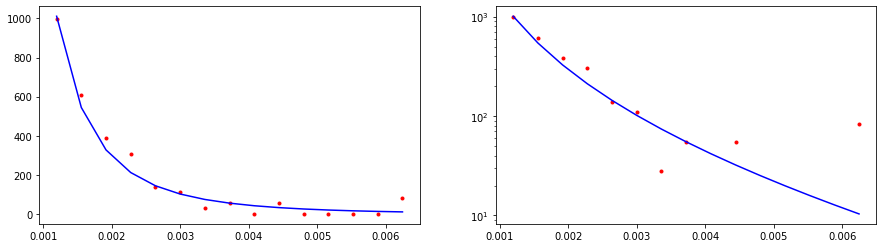

CPU times: user 0 ns, sys: 535 µs, total: 535 µs
Wall time: 363 µs
67093.66722550284


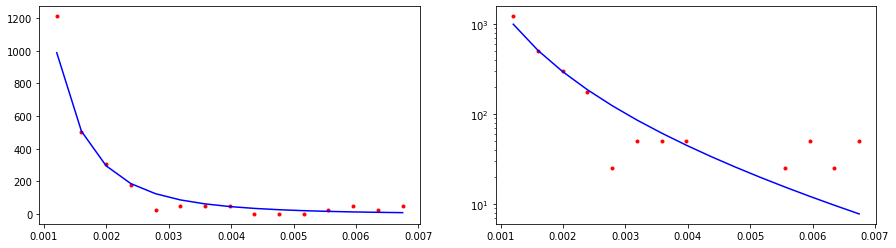

CPU times: user 474 µs, sys: 62 µs, total: 536 µs
Wall time: 374 µs
49273.87394873487


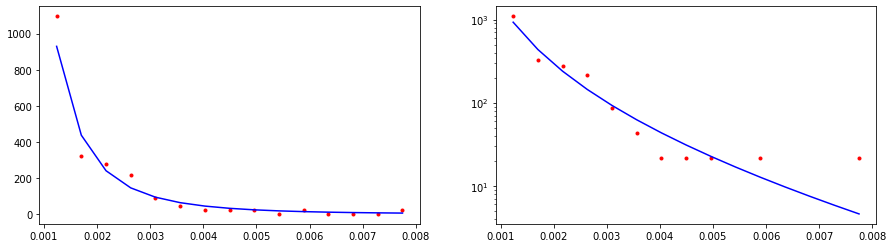

CPU times: user 503 µs, sys: 65 µs, total: 568 µs
Wall time: 391 µs
6649.958720805255


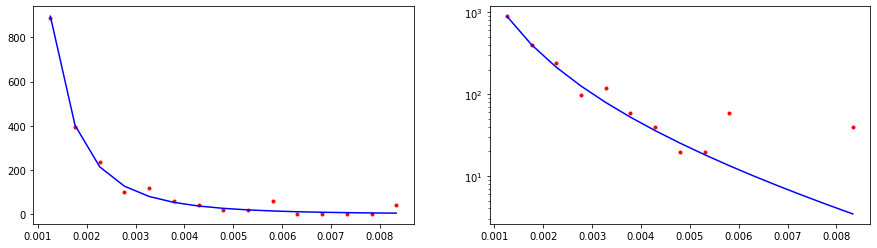

CPU times: user 546 µs, sys: 71 µs, total: 617 µs
Wall time: 439 µs
33739.76146681913


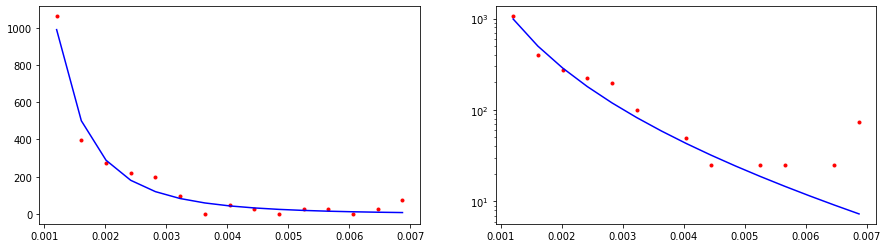

CPU times: user 612 µs, sys: 0 ns, total: 612 µs
Wall time: 494 µs
40151.088240794496


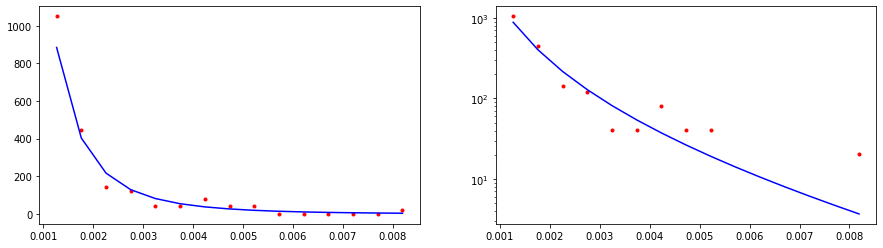

CPU times: user 539 µs, sys: 71 µs, total: 610 µs
Wall time: 511 µs
40075.8917301471


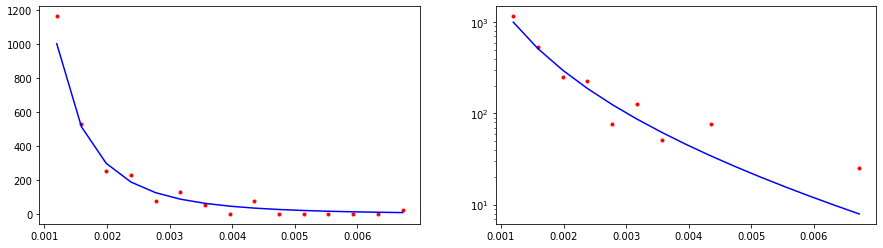

CPU times: user 862 µs, sys: 0 ns, total: 862 µs
Wall time: 685 µs
20116.3739874347


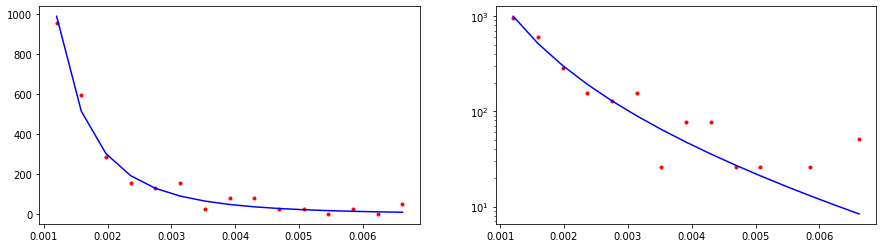

CPU times: user 1.04 ms, sys: 7 µs, total: 1.05 ms
Wall time: 896 µs
45994.77032912634


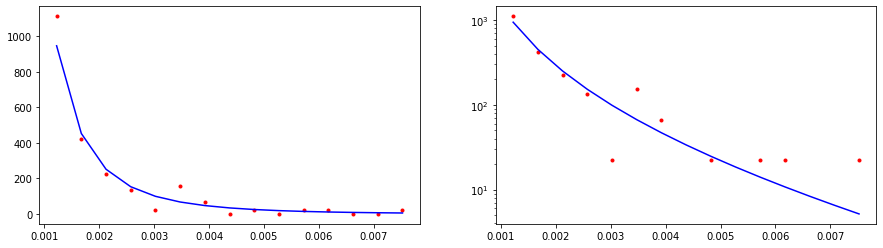

CPU times: user 1.22 ms, sys: 29 µs, total: 1.25 ms
Wall time: 1.06 ms
5259.311952664288


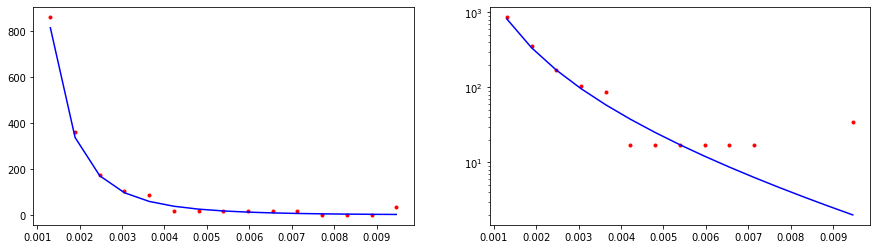

CPU times: user 1.4 ms, sys: 0 ns, total: 1.4 ms
Wall time: 1.21 ms
20528.13147097071


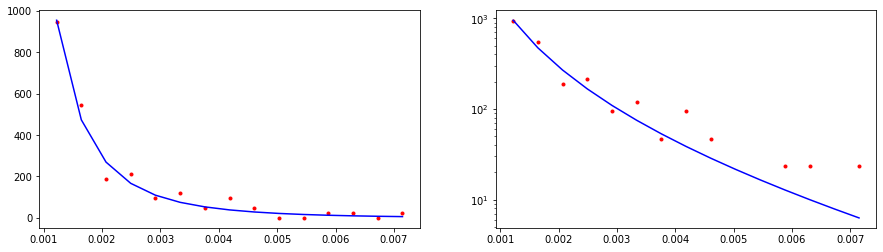

CPU times: user 1.53 ms, sys: 0 ns, total: 1.53 ms
Wall time: 1.38 ms
5906.215908267854


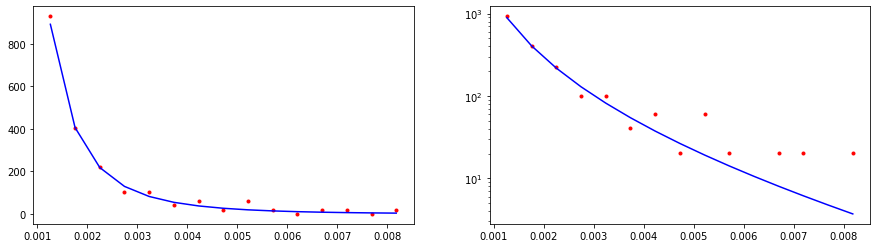

CPU times: user 1.74 ms, sys: 0 ns, total: 1.74 ms
Wall time: 1.57 ms
11978.428641093149


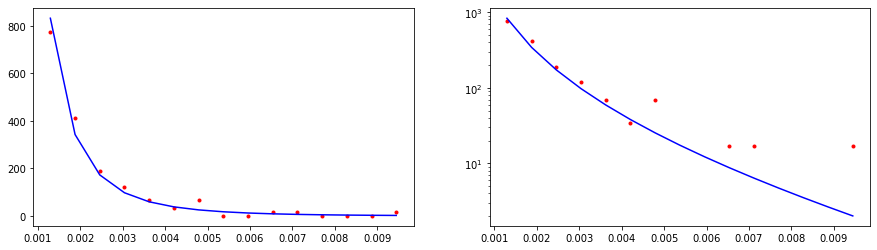

CPU times: user 1.89 ms, sys: 0 ns, total: 1.89 ms
Wall time: 1.72 ms
15715.198747372586


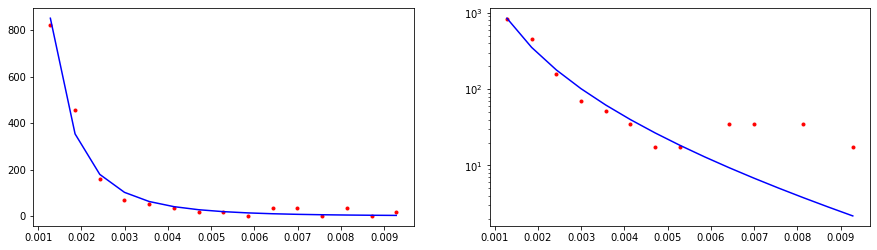

CPU times: user 1.09 ms, sys: 882 µs, total: 1.97 ms
Wall time: 1.82 ms
6558.320444114594


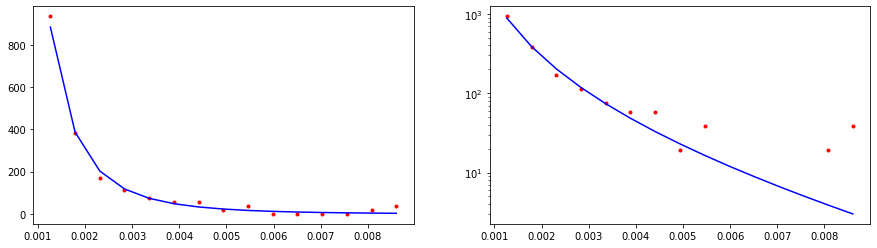

CPU times: user 652 µs, sys: 0 ns, total: 652 µs
Wall time: 409 µs
36837.76678327962


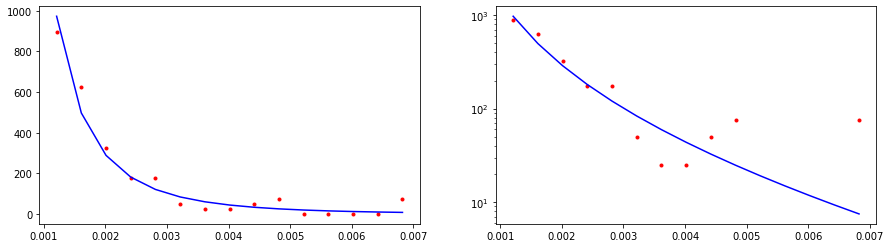

In [41]:
for _ in range(loops):
    for nn_iter in n_iter:
        evran.set_rutherford_iterations(nn_iter)
        %time r_everest = [ evran.get_random_ruth() for _ in range(n) ]
        S_everest[nn_iter] = np.array([ *S_everest[nn_iter], test_random(r_everest, bins, f) ])
    %time r_k2 = [ k2ran.get_random_ruth(cgen) for _ in range(n) ]
    S_K2 = np.array([ *S_K2, test_random(r_k2, bins, f) ])

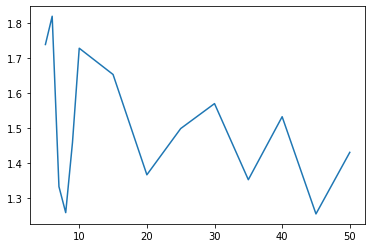

In [42]:
plt.plot(n_iter, [ np.sqrt((S_everest[nn_iter] / S_K2).mean()) for nn_iter in n_iter ])

## Investigating number of Newton iterations

In [8]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)

result = []
for n_iter in range(1,50):
    evran.set_random_seed(1669281221)
    evran.set_rutherford_iterations(n_iter)
    result = [ *result, evran.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

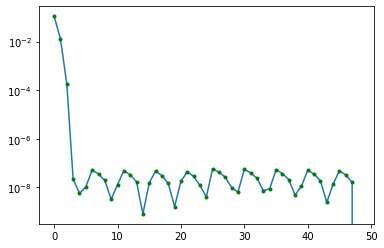

In [9]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [11]:
result = []
for n_iter in range(7,50):
    evran.set_random_seed(1669281221)
    evran.set_rutherford_iterations(n_iter)
    result = [ *result, evran.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

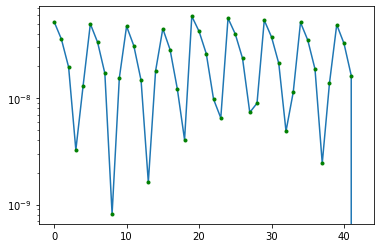

In [12]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [13]:
result = []
for n_iter in range(1,50):
    evran.set_random_seed(1669281221)
    evran.set_rutherford_iterations(n_iter)
    evran.get_random_ruth()
    evran.get_random_ruth()
    evran.get_random_ruth()
    result = [ *result, evran.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

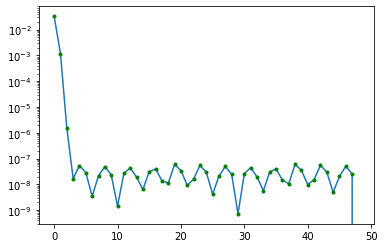

In [14]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [15]:
result = []
for n_iter in range(1,50):
    evran.set_random_seed(1669281221)
    evran.set_rutherford_iterations(n_iter)
    evran.get_random_ruth()
    evran.get_random_ruth()
    evran.get_random_ruth()
    evran.get_random_ruth()
    evran.get_random_ruth()
    result = [ *result, evran.get_random_ruth() ]

result = abs(result[-1] - np.array(result))/result[-1]

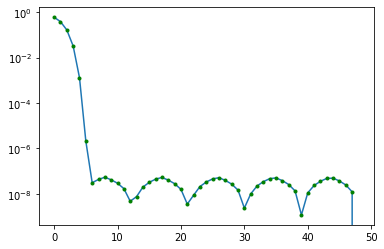

In [16]:
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result)
ax.plot(result, 'g.')
ax.set_yscale('log')
plt.show()

In [143]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    evran.set_rutherford_iterations(100)
    norm = evran.get_random_ruth()

    # Sample again n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 7 iterations and calculate its deviation from the perfect one
    evran.set_rutherford_iterations(7)
    val = evran.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

7.5770985164475374e-06
7.744723751108299e-05


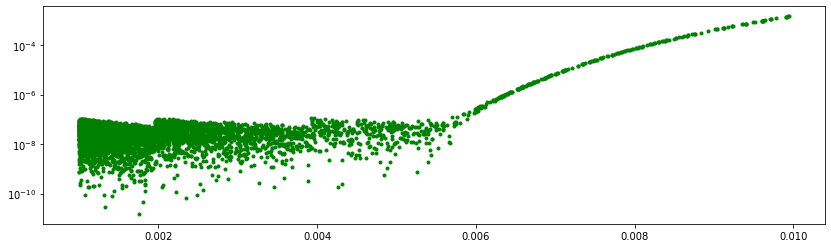

In [144]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure(figsize=(14,4))
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
# ax.set_xscale('log')
# ax.set_xlim([0.008,0.0095])
plt.show()

In [157]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

CDF(0.009, z, emr)/CDF(0.02, z, emr)

0.9792669810357654

In [117]:
mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 50 iterations, interpret it as 'perfect'
    evran.set_rutherford_iterations(50)
    norm = evran.get_random_ruth()

    # Sample again n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 7 iterations and calculate its deviation from the perfect one
    evran.set_rutherford_iterations(7)
    val = evran.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

0.00012162311852541978
0.0011661456469632405


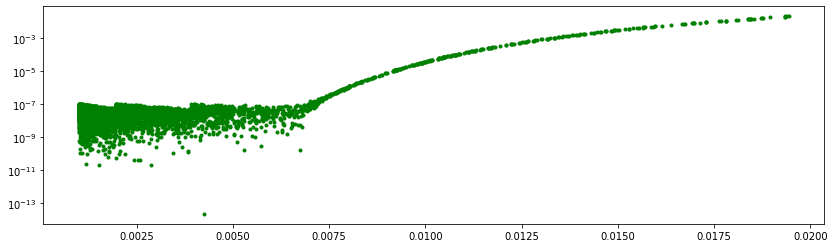

In [118]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure(figsize=(14,4))
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
# ax.set_xscale('log')
# ax.set_xlim([0.0175,0.02])
plt.show()

In [116]:
mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

CDF(0.0185, z, emr)/CDF(0.02, z, emr)

0.9978289172534573

In [187]:
mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    evran.set_rutherford_iterations(100)
    norm = evran.get_random_ruth()

    # Sample again n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 7 iterations and calculate its deviation from the perfect one
    evran.set_rutherford_iterations(7)
    val = evran.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

0.0001313246433530967
0.0016430034142023548


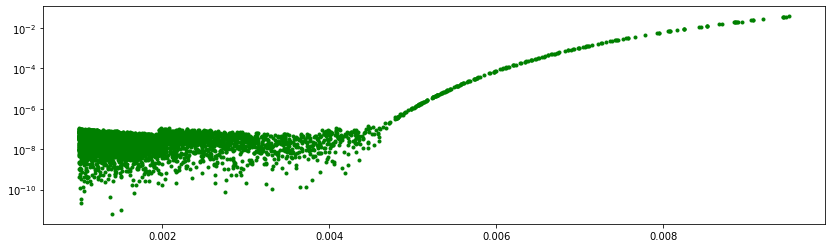

In [188]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure(figsize=(14,4))
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
# ax.set_xscale('log')
# ax.set_xlim([0.006,0.007])
plt.show()

In [204]:
mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

CDF(0.008, z, emr)/CDF(0.01, z, emr)

0.9948093654197406

In [42]:
mat = xc.materials.Copper
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    evran.set_rutherford_iterations(100)
    norm = evran.get_random_ruth()

    # Sample again n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 25 iterations and calculate its deviation from the perfect one
    evran.set_rutherford_iterations(6)
    val = evran.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

0.0002447048701792093
0.0018977726489164386


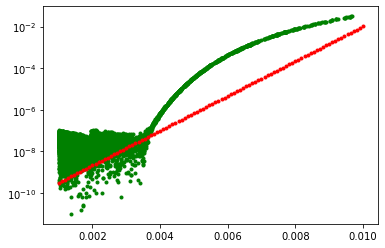

In [69]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
x = np.linspace(0.001,0.01,100)
ax.plot(x, 4.6e-11*np.exp(1920*x), 'r.')
ax.set_yscale('log')
plt.show()

In [22]:
mat = xc.materials.Berylium
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    evran.set_rutherford_iterations(100)
    norm = evran.get_random_ruth()

    # Sample again n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 25 iterations and calculate its deviation from the perfect one
    evran.set_rutherford_iterations(25)
    val = evran.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

3.0061211230171924e-08
2.219858713429089e-08


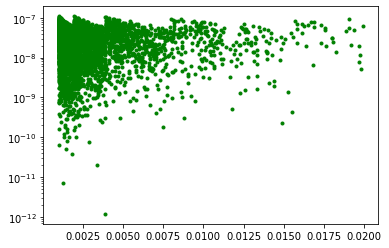

In [23]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
plt.show()

In [24]:
mat = xc.materials.Lead
z = mat.Z
emr = mat.nuclear_radius
t1 = mat.hcut

evran.set_rutherford_parameters(z,emr,t1)

result_val  = []
result_prec = []
for n in range(5000):
    # Sample n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 100 iterations, interpret it as 'perfect'
    evran.set_rutherford_iterations(100)
    norm = evran.get_random_ruth()

    # Sample again n values
    evran.set_random_seed(16692811)
    for _ in range(n):
        evran.set_rutherford_iterations(1)
        evran.get_random_ruth()

    # Get the n-th random number with 25 iterations and calculate its deviation from the perfect one
    evran.set_rutherford_iterations(25)
    val = evran.get_random_ruth()
    result_val  = [ *result_val, val ]
    result_prec = [ *result_prec, abs(norm-val) / norm ]

result_val = np.array(result_val)
result_prec = np.array(result_prec)

2.967182103633592e-08
2.2281295086209595e-08


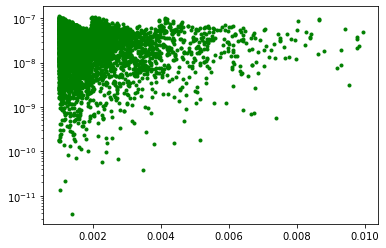

In [25]:
print(result_prec.mean())
print(result_prec.std())
fig = plt.figure()
ax = fig.add_subplot()
ax.plot(result_val, result_prec, 'g.')
ax.set_yscale('log')
plt.show()

# Gaussian random number generator

## 1000000 samples

In [33]:
n = 1000000
bins = 1000
mu = 0
sigma = 1

loops = 20
S_everest = []
S_K2 = []
f = lambda x: 1/np.sqrt(2*np.pi)/sigma * np.exp(-(x-mu)**2/sigma**2/2)

CPU times: user 211 ms, sys: 12.2 ms, total: 223 ms
Wall time: 222 ms
CPU times: user 1.45 s, sys: 15.9 ms, total: 1.46 s
Wall time: 1.46 s
0.010070994840629547


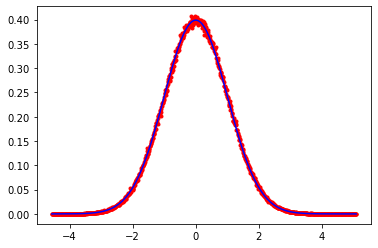

0.010509263147450808


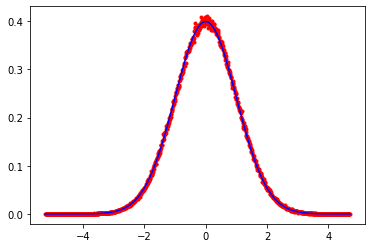

CPU times: user 301 ms, sys: 32.7 ms, total: 333 ms
Wall time: 211 ms
CPU times: user 1.43 s, sys: 15 ms, total: 1.45 s
Wall time: 1.45 s
0.010111679472853186


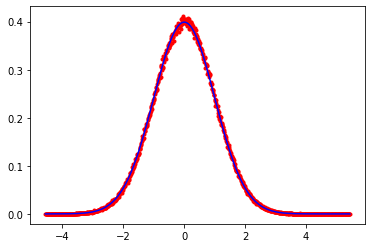

0.012572902795088409


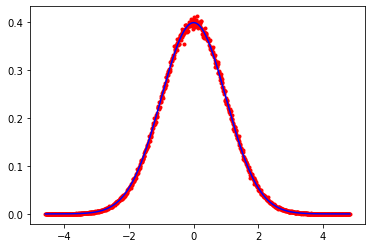

CPU times: user 295 ms, sys: 33.2 ms, total: 328 ms
Wall time: 213 ms
CPU times: user 1.42 s, sys: 11.8 ms, total: 1.43 s
Wall time: 1.43 s
0.01142538215041141


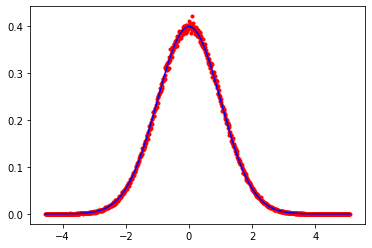

0.012706943222770503


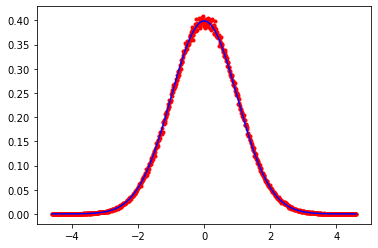

CPU times: user 285 ms, sys: 33.4 ms, total: 319 ms
Wall time: 226 ms
CPU times: user 1.49 s, sys: 17.2 ms, total: 1.51 s
Wall time: 1.51 s
0.01062982483722155


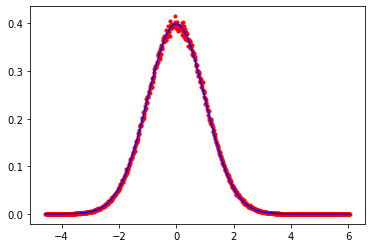

0.011095733376799817


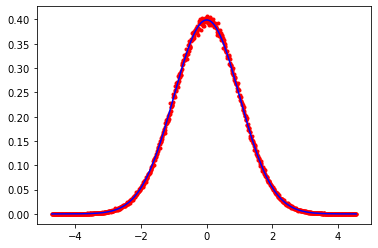

CPU times: user 284 ms, sys: 31.2 ms, total: 315 ms
Wall time: 218 ms
CPU times: user 1.45 s, sys: 15.3 ms, total: 1.46 s
Wall time: 1.46 s
0.010099971441584412


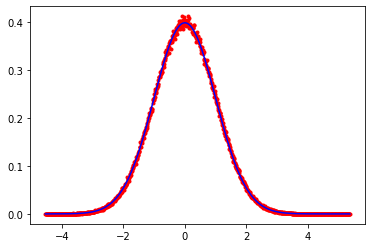

0.011823405073854114


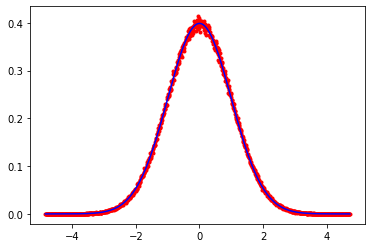

CPU times: user 302 ms, sys: 32.5 ms, total: 335 ms
Wall time: 210 ms
CPU times: user 1.43 s, sys: 12.1 ms, total: 1.44 s
Wall time: 1.44 s
0.010209664371364894


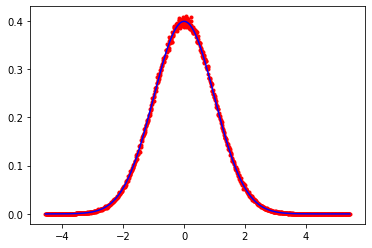

0.011753519922878906


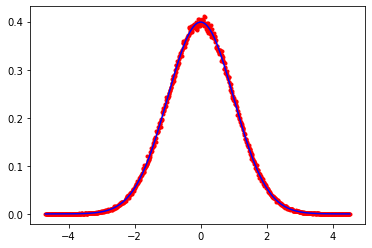

CPU times: user 303 ms, sys: 34.4 ms, total: 337 ms
Wall time: 210 ms
CPU times: user 1.42 s, sys: 13.3 ms, total: 1.44 s
Wall time: 1.44 s
0.010451254368297951


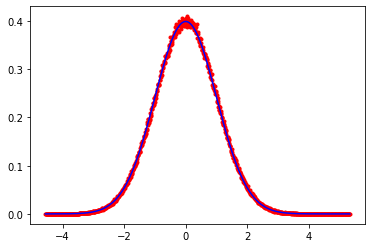

0.010474251615486643


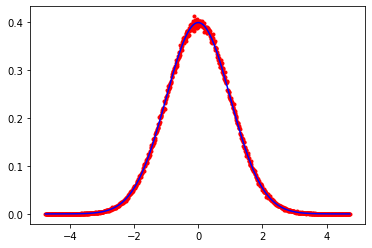

CPU times: user 293 ms, sys: 30 ms, total: 323 ms
Wall time: 206 ms
CPU times: user 1.48 s, sys: 19 ms, total: 1.5 s
Wall time: 1.5 s
0.010721318137384736


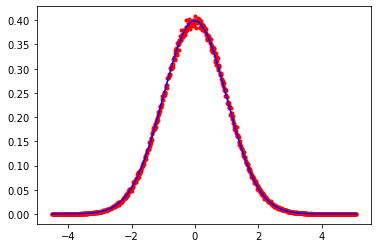

0.009398536227110049


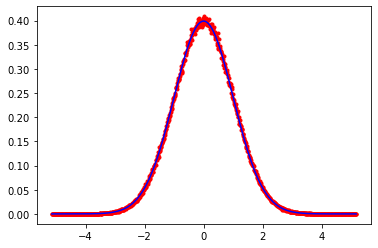

CPU times: user 268 ms, sys: 29.8 ms, total: 298 ms
Wall time: 215 ms
CPU times: user 1.46 s, sys: 14.8 ms, total: 1.48 s
Wall time: 1.48 s
0.01059983873234132


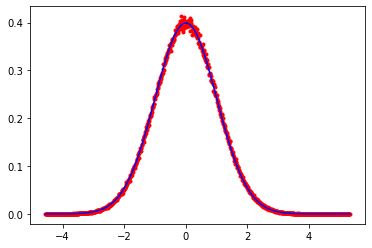

0.012244648011954223


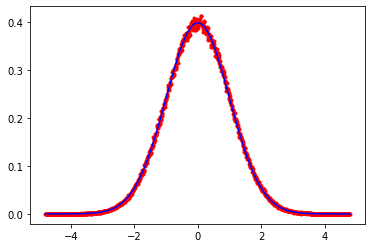

CPU times: user 301 ms, sys: 36.4 ms, total: 337 ms
Wall time: 215 ms
CPU times: user 1.48 s, sys: 18.2 ms, total: 1.5 s
Wall time: 1.51 s
0.010403439024358634


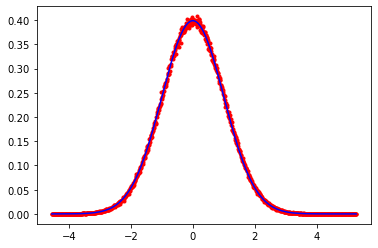

0.01070828976225953


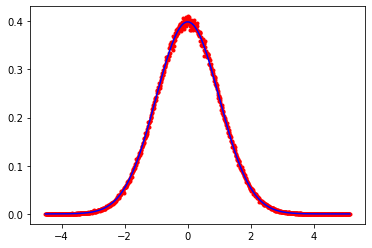

CPU times: user 304 ms, sys: 33.1 ms, total: 337 ms
Wall time: 213 ms
CPU times: user 1.45 s, sys: 16.9 ms, total: 1.47 s
Wall time: 1.47 s
0.010165252247710702


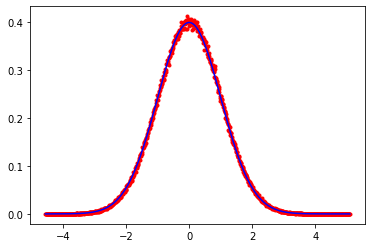

0.009476126948149637


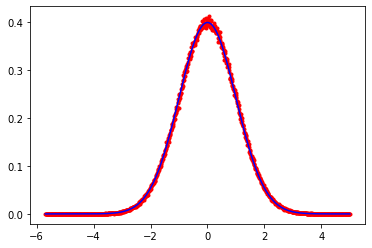

CPU times: user 291 ms, sys: 36.2 ms, total: 327 ms
Wall time: 216 ms
CPU times: user 1.5 s, sys: 18.5 ms, total: 1.51 s
Wall time: 1.52 s
0.010076418504110079


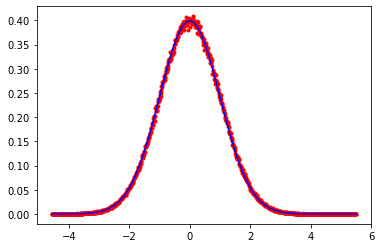

0.011179125714899828


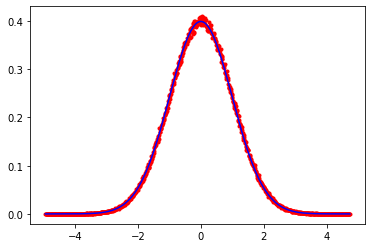

CPU times: user 299 ms, sys: 34.3 ms, total: 333 ms
Wall time: 211 ms
CPU times: user 1.48 s, sys: 19.3 ms, total: 1.5 s
Wall time: 1.5 s
0.010254968923016312


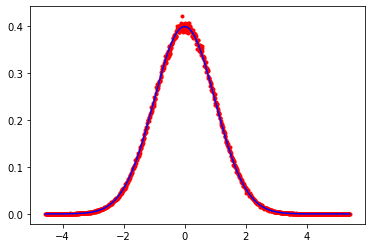

0.010189522023632106


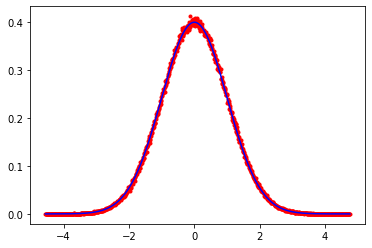

CPU times: user 295 ms, sys: 33.9 ms, total: 328 ms
Wall time: 217 ms
CPU times: user 1.49 s, sys: 18.3 ms, total: 1.51 s
Wall time: 1.51 s
0.009291154549680929


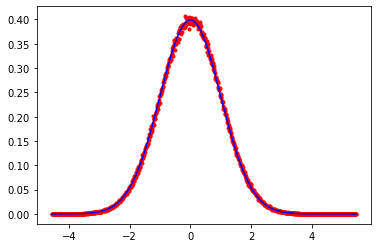

0.00964774595094629


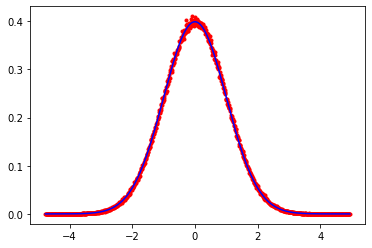

CPU times: user 301 ms, sys: 39.6 ms, total: 340 ms
Wall time: 223 ms
CPU times: user 1.46 s, sys: 15.1 ms, total: 1.47 s
Wall time: 1.47 s
0.011529832744854477


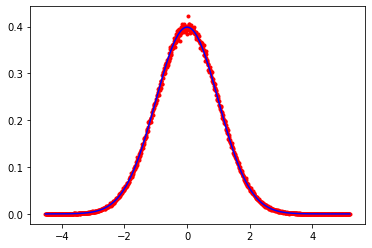

0.011612829045143748


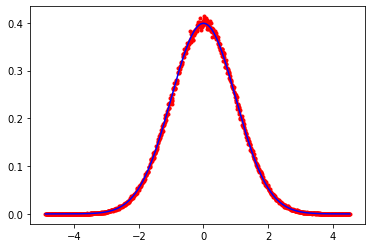

CPU times: user 301 ms, sys: 33.7 ms, total: 335 ms
Wall time: 211 ms
CPU times: user 1.42 s, sys: 14.9 ms, total: 1.44 s
Wall time: 1.44 s
0.011404726263446054


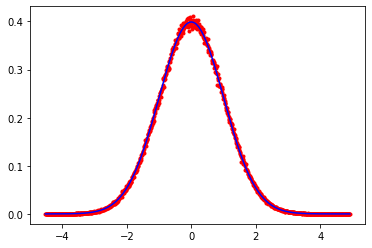

0.010875623153843737


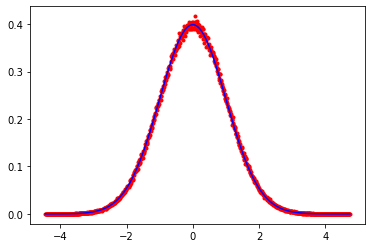

CPU times: user 305 ms, sys: 34.7 ms, total: 340 ms
Wall time: 210 ms
CPU times: user 1.48 s, sys: 14.6 ms, total: 1.5 s
Wall time: 1.5 s
0.010066351525533472


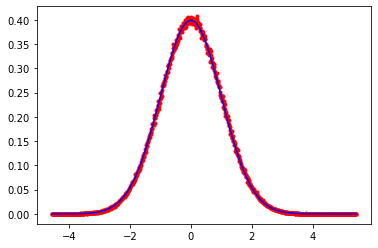

0.010529759506278956


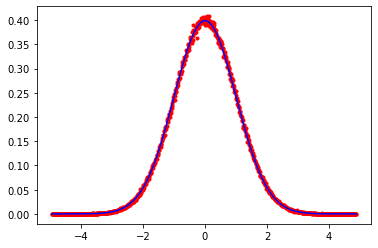

CPU times: user 289 ms, sys: 31.5 ms, total: 321 ms
Wall time: 211 ms
CPU times: user 1.43 s, sys: 13.6 ms, total: 1.44 s
Wall time: 1.44 s
0.010280794655012224


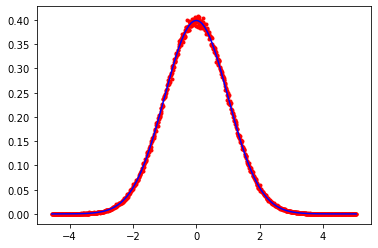

0.010580314337166828


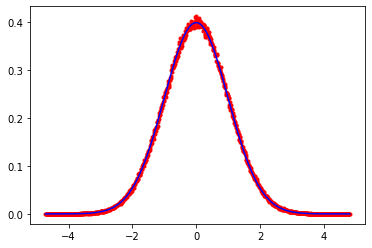

CPU times: user 303 ms, sys: 34 ms, total: 337 ms
Wall time: 209 ms
CPU times: user 1.47 s, sys: 17 ms, total: 1.49 s
Wall time: 1.5 s
0.01057093540279409


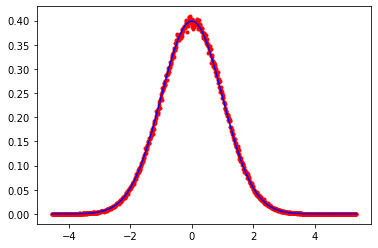

0.010169172152278031


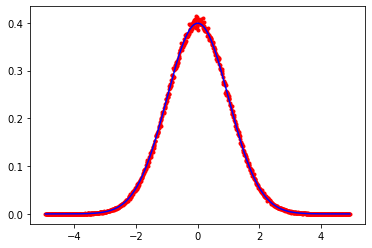

CPU times: user 287 ms, sys: 31.1 ms, total: 318 ms
Wall time: 211 ms
CPU times: user 1.46 s, sys: 16 ms, total: 1.48 s
Wall time: 1.48 s
0.009489103466070237


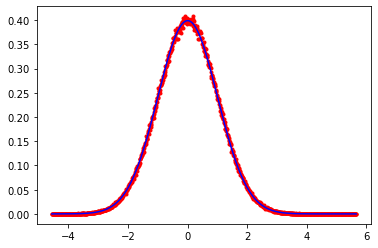

0.008145577993626755


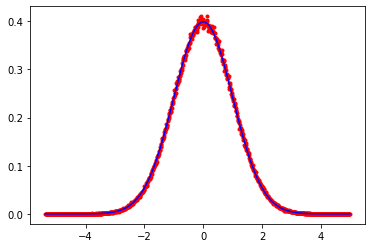

In [34]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_gauss() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random_gauss(100) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [35]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

0.10194432442727654
0.10384923928022269
[0.97892643 0.89679643 0.94823247 0.97877991 0.92424857 0.93201255
 0.9989016  1.0680559  0.93041451 0.98566289 1.03572306 0.94939989
 1.00320634 0.98134545 0.99642012 1.02403631 0.97774774 0.98574381
 1.01956263 1.07932351]
0.9857866199688193


## 5000 samples

In [36]:
n = 5000
bins = 100
mu = 0
sigma = 1

loops = 20
S_everest = []
S_K2 = []
f = lambda x: 1/np.sqrt(2*np.pi)/sigma * np.exp(-(x-mu)**2/sigma**2/2)

CPU times: user 9.56 ms, sys: 4.72 ms, total: 14.3 ms
Wall time: 13.5 ms
CPU times: user 21.6 ms, sys: 3.39 ms, total: 25 ms
Wall time: 25.1 ms
0.030969099152956682


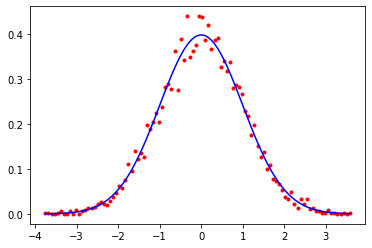

0.028978301588058433


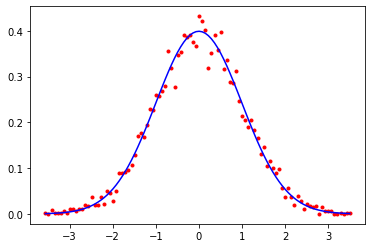

CPU times: user 3.38 ms, sys: 1.25 ms, total: 4.63 ms
Wall time: 1.61 ms
CPU times: user 18.8 ms, sys: 2.41 ms, total: 21.2 ms
Wall time: 7.11 ms
0.028046269186702142


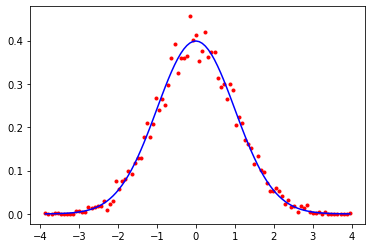

0.027024290322198732


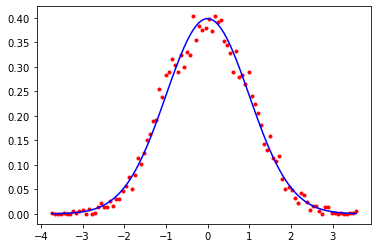

CPU times: user 5.15 ms, sys: 2.23 ms, total: 7.38 ms
Wall time: 2.82 ms
CPU times: user 18.9 ms, sys: 2.46 ms, total: 21.4 ms
Wall time: 7.18 ms
0.025540667650011537


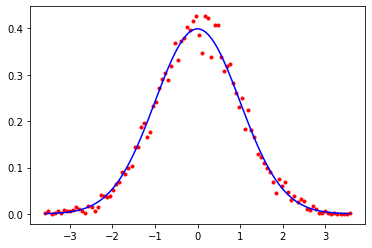

0.036176901703738086


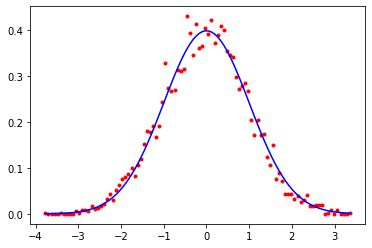

CPU times: user 3.58 ms, sys: 1.27 ms, total: 4.85 ms
Wall time: 1.64 ms
CPU times: user 18.1 ms, sys: 3.68 ms, total: 21.8 ms
Wall time: 7.65 ms
0.046979741106405896


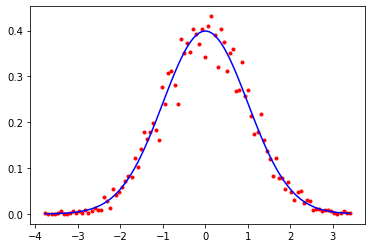

0.04390982118029137


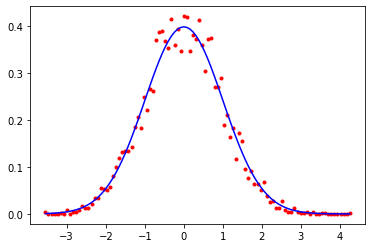

CPU times: user 3.41 ms, sys: 1.35 ms, total: 4.76 ms
Wall time: 1.64 ms
CPU times: user 18.6 ms, sys: 3.07 ms, total: 21.6 ms
Wall time: 7.41 ms
0.05149161246070517


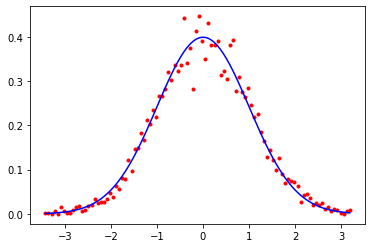

0.04758440206815848


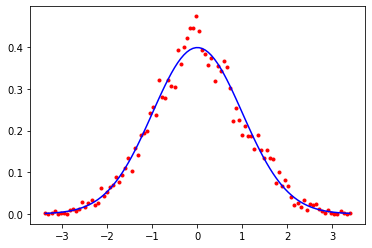

CPU times: user 3.32 ms, sys: 1.96 ms, total: 5.28 ms
Wall time: 1.97 ms
CPU times: user 13.3 ms, sys: 2.12 ms, total: 15.4 ms
Wall time: 15.2 ms
0.05022973365257261


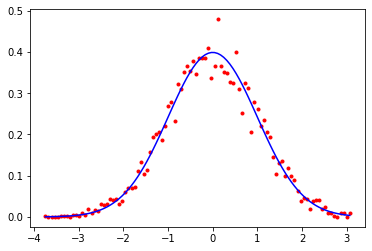

0.04687871777022613


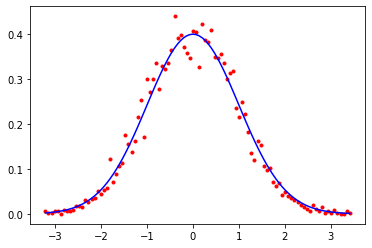

CPU times: user 3.37 ms, sys: 1.83 ms, total: 5.2 ms
Wall time: 1.85 ms
CPU times: user 26.3 ms, sys: 4.13 ms, total: 30.5 ms
Wall time: 10.4 ms
0.047117984427773166


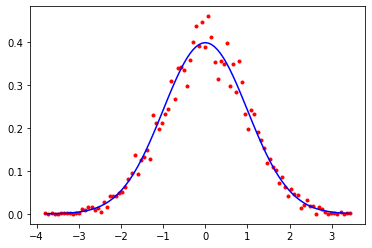

0.02724950592280133


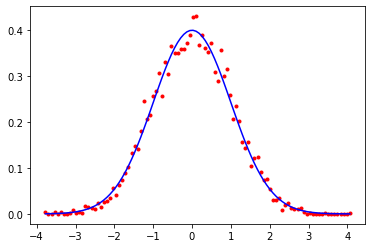

CPU times: user 3.68 ms, sys: 1.79 ms, total: 5.47 ms
Wall time: 1.88 ms
CPU times: user 18.9 ms, sys: 3.63 ms, total: 22.5 ms
Wall time: 7.82 ms
0.02785789107041034


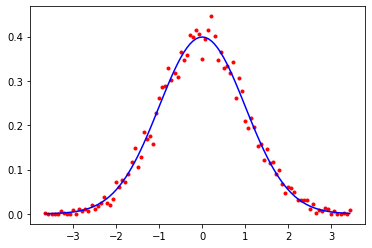

0.02273629825921083


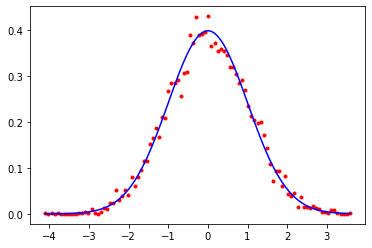

CPU times: user 3.35 ms, sys: 1.48 ms, total: 4.83 ms
Wall time: 1.7 ms
CPU times: user 18.7 ms, sys: 2.85 ms, total: 21.6 ms
Wall time: 7.35 ms
0.03251410750030296


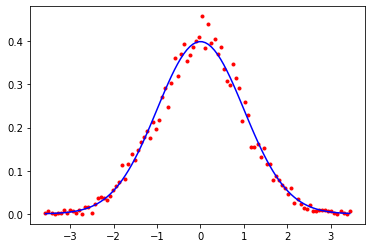

0.042787129726477184


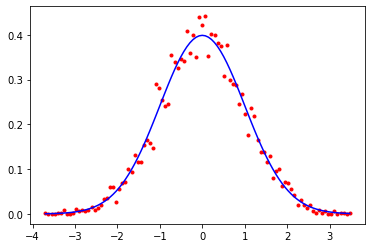

CPU times: user 3.39 ms, sys: 1.15 ms, total: 4.53 ms
Wall time: 1.56 ms
CPU times: user 18.8 ms, sys: 2.84 ms, total: 21.6 ms
Wall time: 7.36 ms
0.03082410590909906


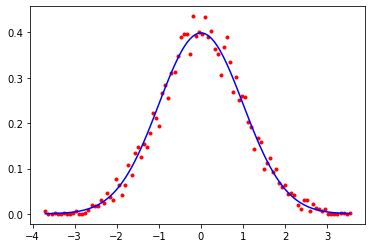

0.025882236326423978


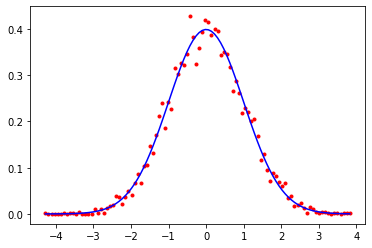

CPU times: user 3.35 ms, sys: 1.38 ms, total: 4.73 ms
Wall time: 1.65 ms
CPU times: user 18.8 ms, sys: 3.21 ms, total: 22 ms
Wall time: 7.57 ms
0.03599103720138392


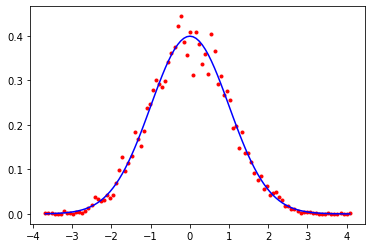

0.04409684295230964


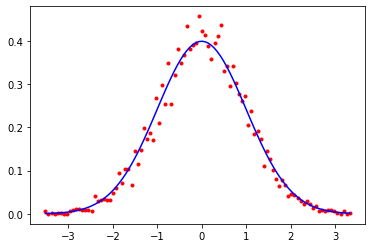

CPU times: user 3.25 ms, sys: 1.21 ms, total: 4.46 ms
Wall time: 1.56 ms
CPU times: user 18.3 ms, sys: 3.59 ms, total: 21.9 ms
Wall time: 7.68 ms
0.04198308762996386


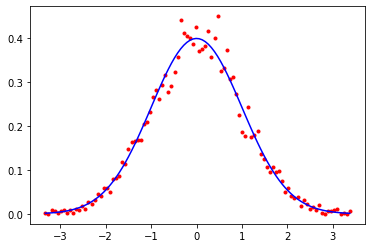

0.028666268631309996


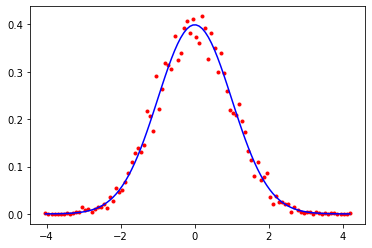

CPU times: user 3.33 ms, sys: 1.13 ms, total: 4.47 ms
Wall time: 1.56 ms
CPU times: user 26.9 ms, sys: 3.62 ms, total: 30.5 ms
Wall time: 10.3 ms
0.038290381982768434


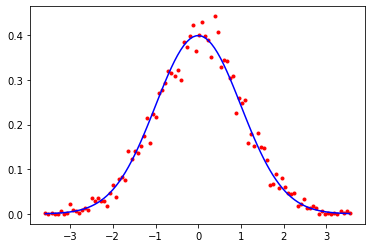

0.04394781924312942


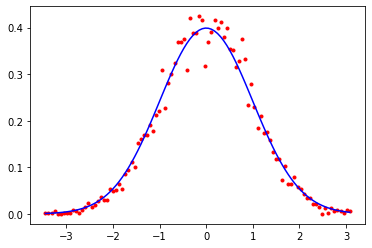

CPU times: user 3.47 ms, sys: 1.62 ms, total: 5.08 ms
Wall time: 1.83 ms
CPU times: user 18.7 ms, sys: 3 ms, total: 21.7 ms
Wall time: 7.43 ms
0.026858870322351253


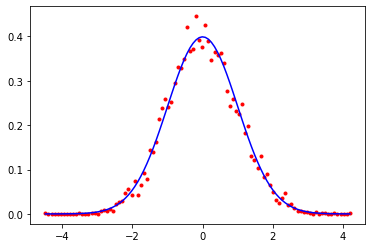

0.023298576296231995


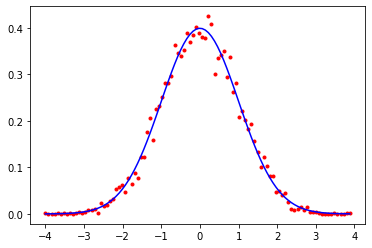

CPU times: user 3.34 ms, sys: 1.43 ms, total: 4.77 ms
Wall time: 1.66 ms
CPU times: user 18.5 ms, sys: 3.04 ms, total: 21.5 ms
Wall time: 7.4 ms
0.04362264513508548


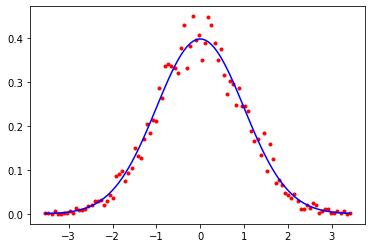

0.042201220216881705


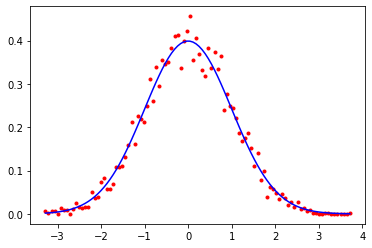

CPU times: user 3.32 ms, sys: 1.2 ms, total: 4.52 ms
Wall time: 1.58 ms
CPU times: user 18.9 ms, sys: 2.9 ms, total: 21.8 ms
Wall time: 7.46 ms
0.03762965212725231


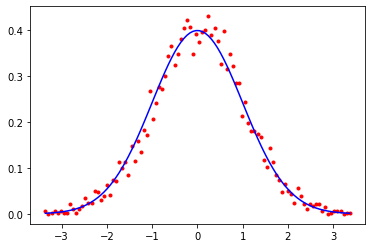

0.019507163256599507


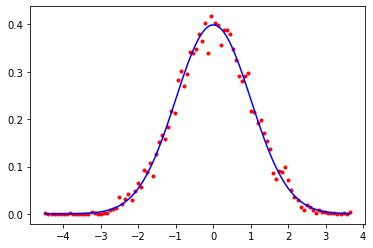

CPU times: user 3.4 ms, sys: 1.57 ms, total: 4.97 ms
Wall time: 1.73 ms
CPU times: user 18.7 ms, sys: 4.78 ms, total: 23.4 ms
Wall time: 8.59 ms
0.028954690885291883


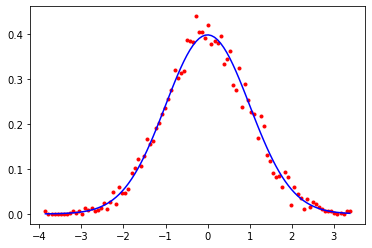

0.02694039163582922


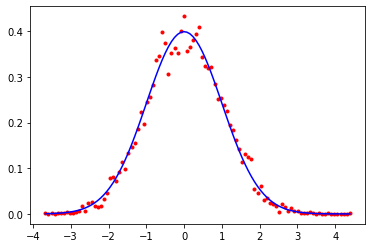

CPU times: user 3.34 ms, sys: 1.19 ms, total: 4.54 ms
Wall time: 1.59 ms
CPU times: user 18.9 ms, sys: 2.89 ms, total: 21.8 ms
Wall time: 7.42 ms
0.03602680392560522


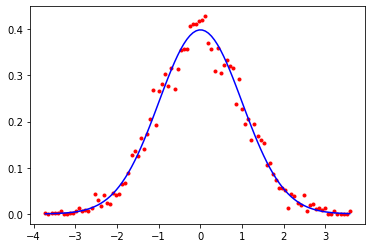

0.017793107397698484


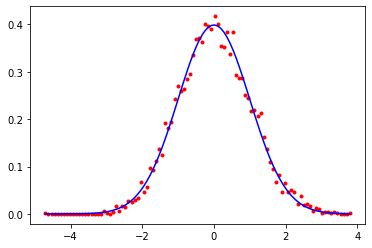

CPU times: user 3.36 ms, sys: 1.43 ms, total: 4.79 ms
Wall time: 1.66 ms
CPU times: user 26.7 ms, sys: 3.75 ms, total: 30.5 ms
Wall time: 10.3 ms
0.033039167066662795


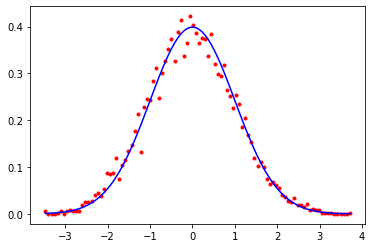

0.02288153684942768


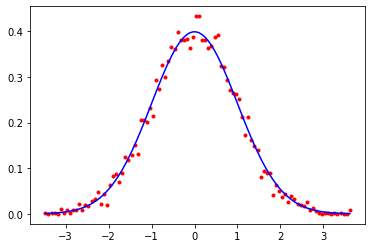

CPU times: user 3.52 ms, sys: 1.4 ms, total: 4.92 ms
Wall time: 1.69 ms
CPU times: user 18.6 ms, sys: 2.99 ms, total: 21.6 ms
Wall time: 7.41 ms
0.029643134199371056


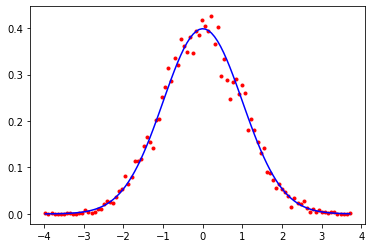

0.023916488951318482


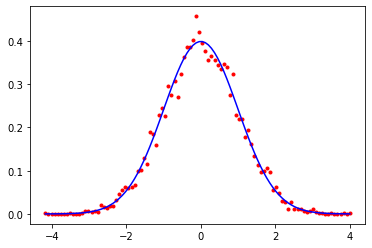

In [37]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_gauss() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random_gauss(100) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [38]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

0.19021181385401323
0.1792284882905506
[1.03377928 1.01873306 0.84023436 1.03436657 1.04024572 1.03512447
 1.31496452 1.10691491 0.87172468 1.09130048 0.90342776 1.21018455
 0.93341803 1.07369067 1.01670157 1.38889061 1.03671054 1.42294124
 1.20163328 1.11330292]
1.0952546815945101


## 100 samples

In [45]:
n = 100
bins = 5
mu = 0
sigma = 1

loops = 20
S_everest = []
S_K2 = []
f = lambda x: 1/np.sqrt(2*np.pi)/sigma * np.exp(-(x-mu)**2/sigma**2/2)

CPU times: user 44 µs, sys: 12 µs, total: 56 µs
Wall time: 54.1 µs
CPU times: user 229 µs, sys: 6 µs, total: 235 µs
Wall time: 247 µs
0.006966398941906941


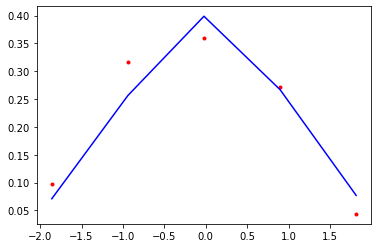

0.015433891071384287


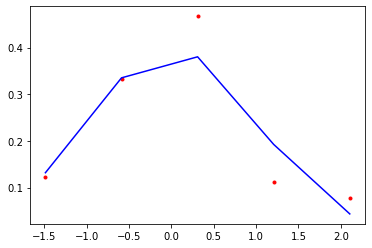

CPU times: user 437 µs, sys: 424 µs, total: 861 µs
Wall time: 287 µs
CPU times: user 413 µs, sys: 49 µs, total: 462 µs
Wall time: 156 µs
0.0034450582032099506


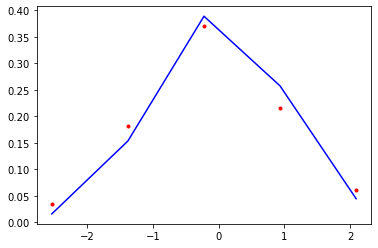

0.022504629138849964


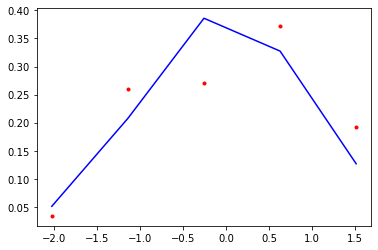

CPU times: user 220 µs, sys: 142 µs, total: 362 µs
Wall time: 131 µs
CPU times: user 469 µs, sys: 91 µs, total: 560 µs
Wall time: 196 µs
0.008917196031358035


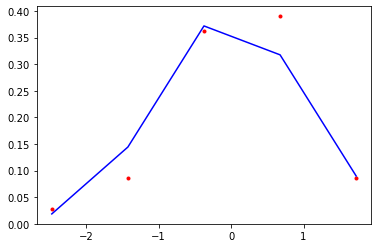

0.007508228353809295


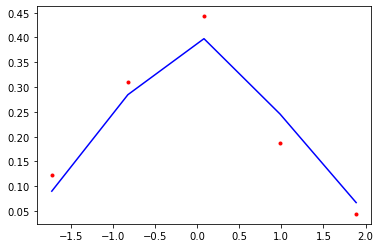

CPU times: user 305 µs, sys: 297 µs, total: 602 µs
Wall time: 207 µs
CPU times: user 405 µs, sys: 47 µs, total: 452 µs
Wall time: 154 µs
0.012416500621759696


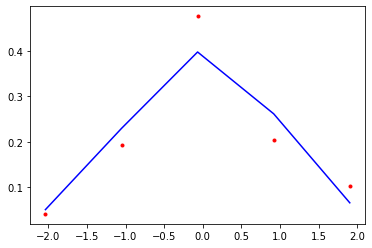

0.008203521779975641


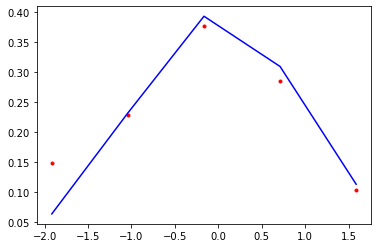

CPU times: user 223 µs, sys: 180 µs, total: 403 µs
Wall time: 153 µs
CPU times: user 487 µs, sys: 62 µs, total: 549 µs
Wall time: 186 µs
0.01588362414330962


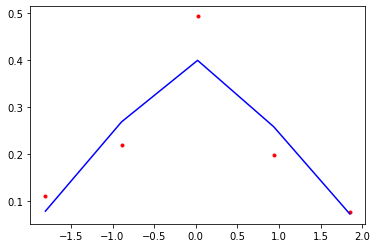

0.00543524623258647


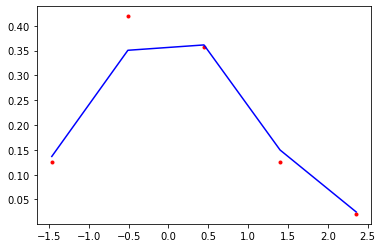

CPU times: user 324 µs, sys: 341 µs, total: 665 µs
Wall time: 229 µs
CPU times: user 407 µs, sys: 48 µs, total: 455 µs
Wall time: 155 µs
0.004643340000900424


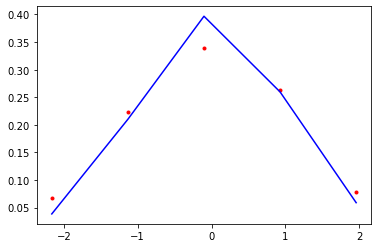

0.010486659432817355


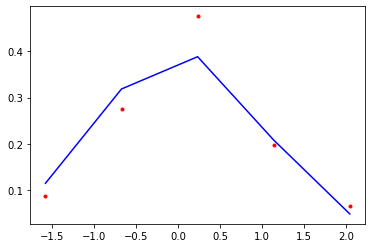

CPU times: user 214 µs, sys: 194 µs, total: 408 µs
Wall time: 148 µs
CPU times: user 412 µs, sys: 49 µs, total: 461 µs
Wall time: 156 µs
0.016459256403781923


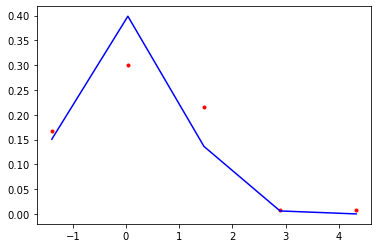

0.0021626031587232927


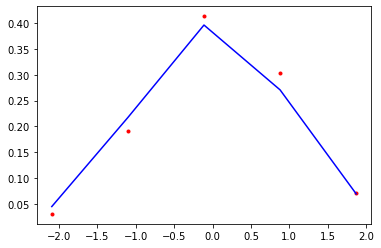

CPU times: user 304 µs, sys: 275 µs, total: 579 µs
Wall time: 203 µs
CPU times: user 410 µs, sys: 48 µs, total: 458 µs
Wall time: 156 µs
0.003595210978597635


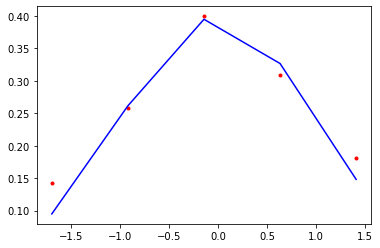

0.011541535673239602


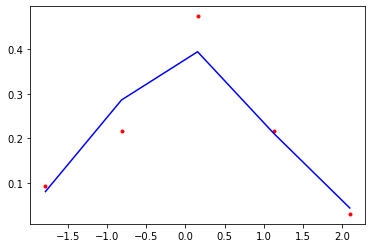

CPU times: user 345 µs, sys: 349 µs, total: 694 µs
Wall time: 241 µs
CPU times: user 499 µs, sys: 59 µs, total: 558 µs
Wall time: 189 µs
0.004458240039313526


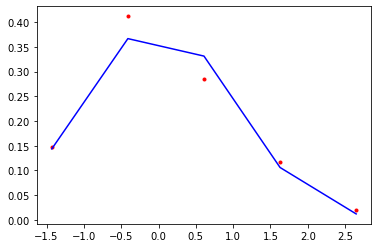

0.0016659389296051438


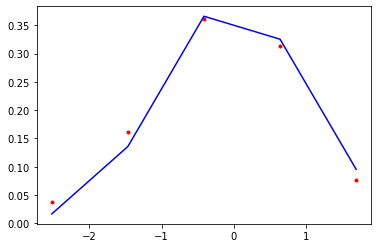

CPU times: user 307 µs, sys: 287 µs, total: 594 µs
Wall time: 205 µs
CPU times: user 412 µs, sys: 49 µs, total: 461 µs
Wall time: 157 µs
0.003971557745628575


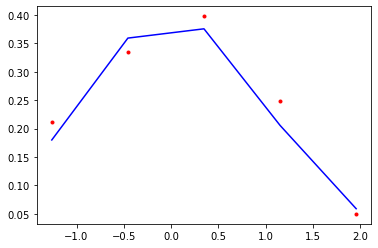

0.009123992203552967


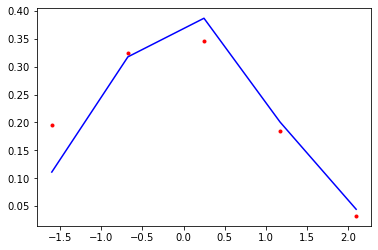

CPU times: user 219 µs, sys: 199 µs, total: 418 µs
Wall time: 153 µs
CPU times: user 410 µs, sys: 47 µs, total: 457 µs
Wall time: 155 µs
0.0027397003896002725


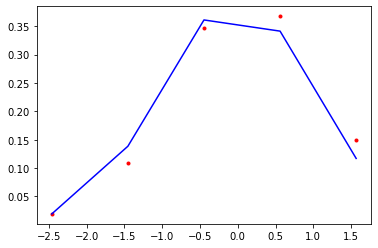

0.0009777707604136042


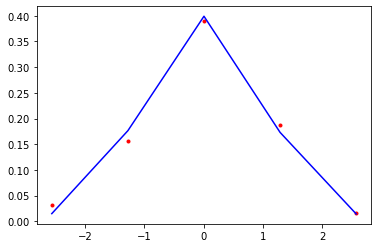

CPU times: user 202 µs, sys: 145 µs, total: 347 µs
Wall time: 126 µs
CPU times: user 408 µs, sys: 48 µs, total: 456 µs
Wall time: 155 µs
0.007391883058440993


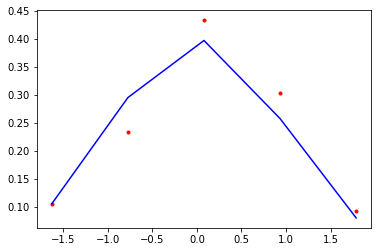

0.003920247528713821


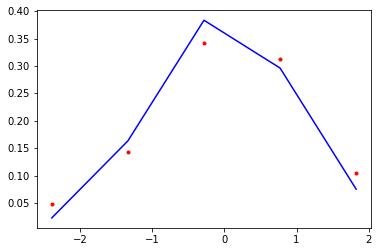

CPU times: user 329 µs, sys: 341 µs, total: 670 µs
Wall time: 228 µs
CPU times: user 407 µs, sys: 49 µs, total: 456 µs
Wall time: 154 µs
0.003924958134411194


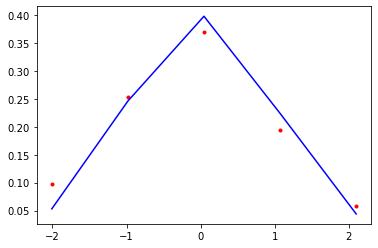

0.0026318953359489843


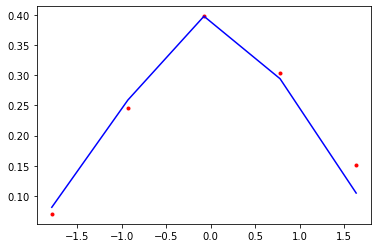

CPU times: user 253 µs, sys: 246 µs, total: 499 µs
Wall time: 172 µs
CPU times: user 405 µs, sys: 47 µs, total: 452 µs
Wall time: 153 µs
0.0007489325072959743


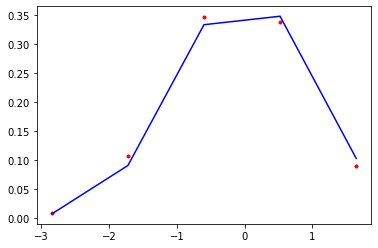

0.005223556421919208


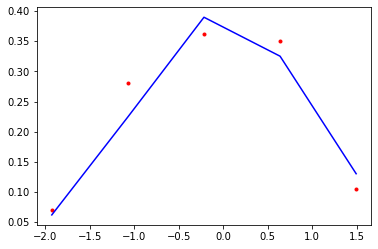

CPU times: user 308 µs, sys: 238 µs, total: 546 µs
Wall time: 178 µs
CPU times: user 406 µs, sys: 48 µs, total: 454 µs
Wall time: 154 µs
0.014429396133701543


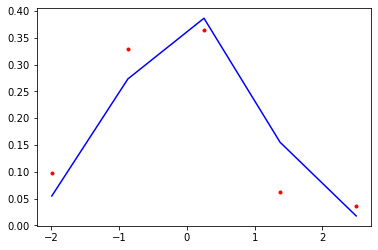

0.0015077381988199382


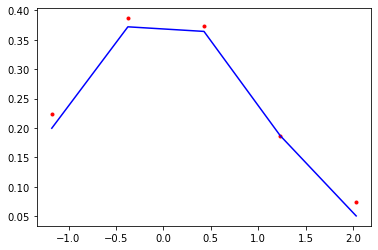

CPU times: user 277 µs, sys: 218 µs, total: 495 µs
Wall time: 168 µs
CPU times: user 405 µs, sys: 49 µs, total: 454 µs
Wall time: 154 µs
0.005287094983069826


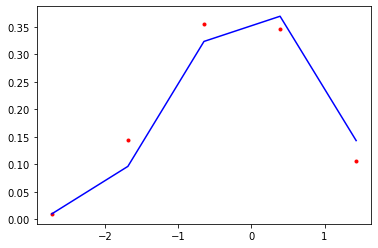

0.0013557446195910654


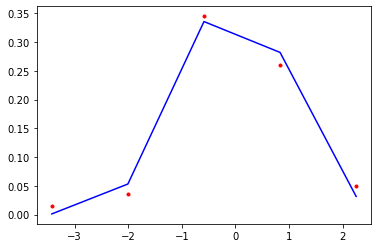

CPU times: user 239 µs, sys: 213 µs, total: 452 µs
Wall time: 159 µs
CPU times: user 411 µs, sys: 49 µs, total: 460 µs
Wall time: 156 µs
0.008440296618306512


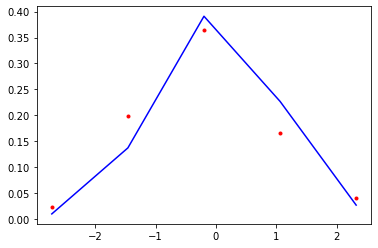

0.0073668115582344


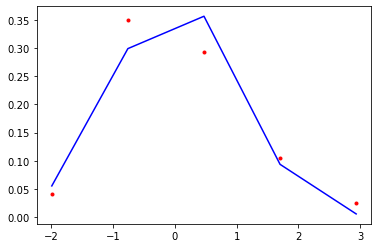

CPU times: user 323 µs, sys: 426 µs, total: 749 µs
Wall time: 261 µs
CPU times: user 407 µs, sys: 46 µs, total: 453 µs
Wall time: 154 µs
0.019551825523440734


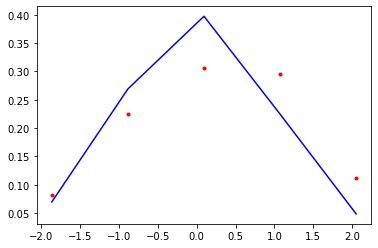

0.010827527863473524


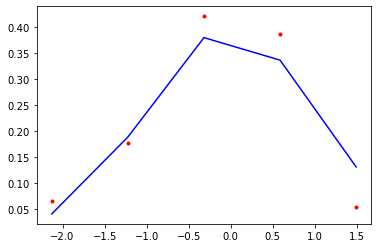

CPU times: user 253 µs, sys: 184 µs, total: 437 µs
Wall time: 155 µs
CPU times: user 408 µs, sys: 48 µs, total: 456 µs
Wall time: 155 µs
0.004094150722422508


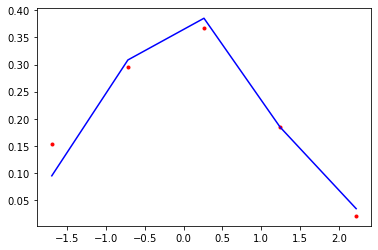

0.002939113014762313


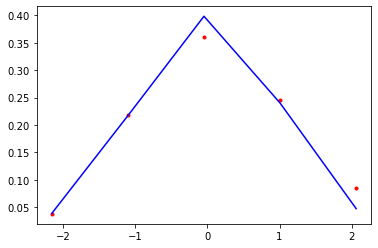

CPU times: user 274 µs, sys: 251 µs, total: 525 µs
Wall time: 183 µs
CPU times: user 408 µs, sys: 49 µs, total: 457 µs
Wall time: 154 µs
0.004276764176401133


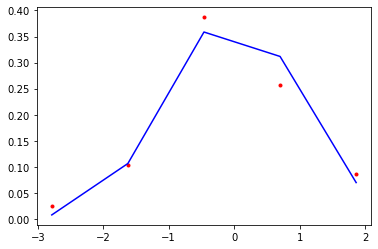

0.004574223730812333


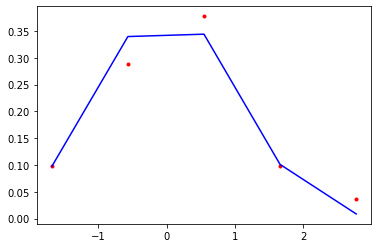

In [46]:
for _ in range(loops):
    %time r_everest = [ evran.get_random_gauss() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random_gauss(100) for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [47]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

0.08707507833957344
0.08227723713373987
[0.67184093 0.39125721 1.08979653 1.23026718 1.70948459 0.66542124
 2.75877759 0.55812361 1.6358828  0.65976305 1.6739135  1.37315891
 1.22118991 0.3786502  3.09357828 1.97478405 1.07038268 1.34378256
 1.18024935 0.96693872]
1.4624671898072636


# Uniform random number generator

## 1000000 samples

In [55]:
n = 1000000
bins = 1000

loops = 20
S_everest = []
S_K2 = []
f = lambda _: 1

CPU times: user 176 ms, sys: 10 ms, total: 186 ms
Wall time: 185 ms
CPU times: user 1.36 s, sys: 13.1 ms, total: 1.38 s
Wall time: 1.38 s
0.9811428804950595


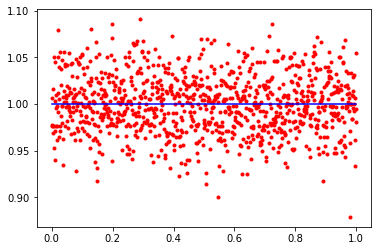

0.9714757340305372


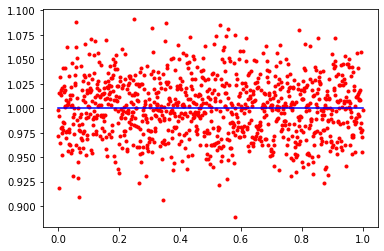

CPU times: user 221 ms, sys: 27.2 ms, total: 249 ms
Wall time: 175 ms
CPU times: user 1.4 s, sys: 15.7 ms, total: 1.42 s
Wall time: 1.42 s
0.9114116798101428


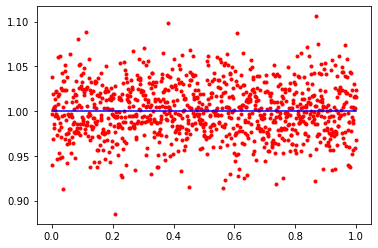

0.949242638790609


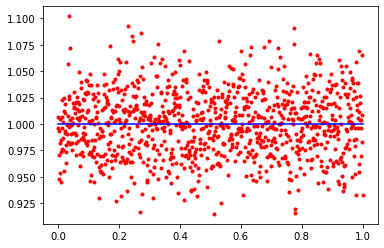

CPU times: user 250 ms, sys: 33.8 ms, total: 284 ms
Wall time: 179 ms
CPU times: user 1.36 s, sys: 13.9 ms, total: 1.37 s
Wall time: 1.37 s
0.988046122188174


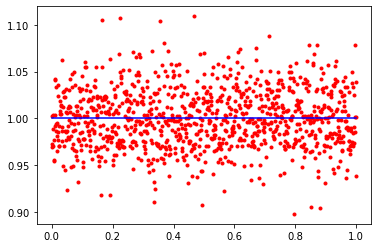

1.0162085469895672


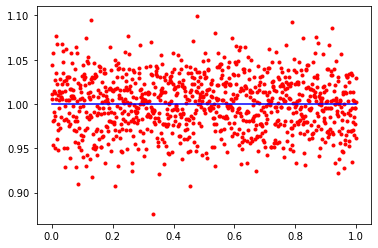

CPU times: user 263 ms, sys: 37.2 ms, total: 300 ms
Wall time: 182 ms
CPU times: user 1.39 s, sys: 17.9 ms, total: 1.41 s
Wall time: 1.41 s
1.0607046984673194


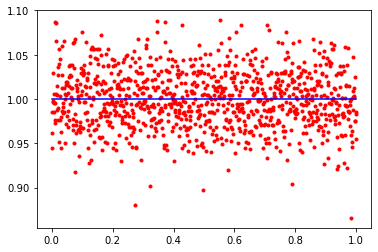

1.0264375818965952


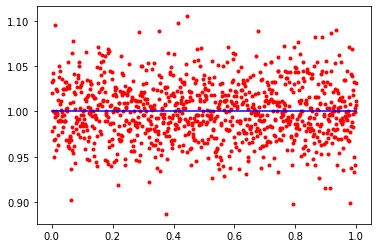

CPU times: user 248 ms, sys: 35.8 ms, total: 284 ms
Wall time: 182 ms
CPU times: user 1.42 s, sys: 18.3 ms, total: 1.44 s
Wall time: 1.45 s
1.0380420901626874


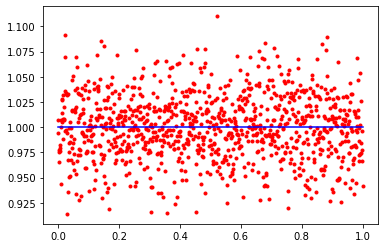

0.9697633717846035


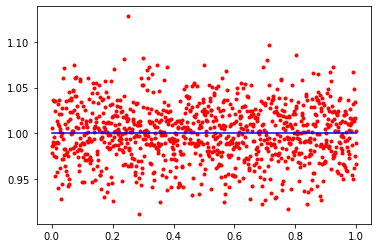

CPU times: user 267 ms, sys: 34.3 ms, total: 301 ms
Wall time: 180 ms
CPU times: user 1.41 s, sys: 15.6 ms, total: 1.42 s
Wall time: 1.43 s
1.0340569142155687


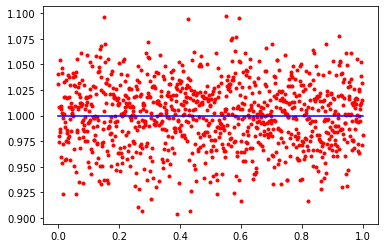

0.9708421370817122


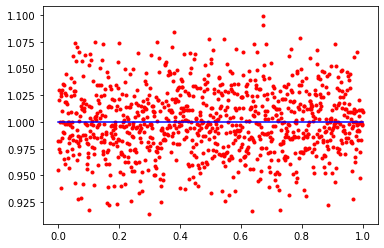

CPU times: user 240 ms, sys: 29.6 ms, total: 270 ms
Wall time: 176 ms
CPU times: user 1.41 s, sys: 18.6 ms, total: 1.43 s
Wall time: 1.43 s
1.0050792956043313


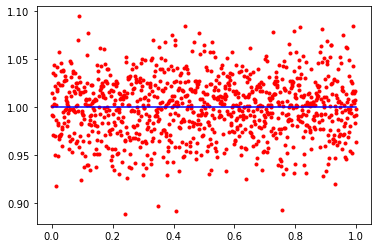

0.9504795239103538


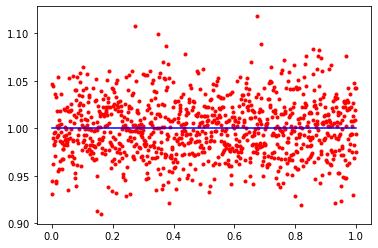

CPU times: user 236 ms, sys: 28 ms, total: 264 ms
Wall time: 174 ms
CPU times: user 1.37 s, sys: 14 ms, total: 1.39 s
Wall time: 1.39 s
0.9737681505514285


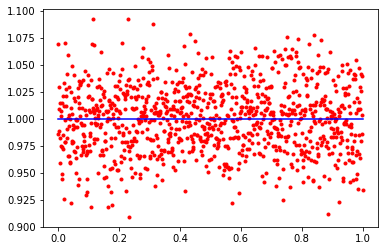

0.9797241998079158


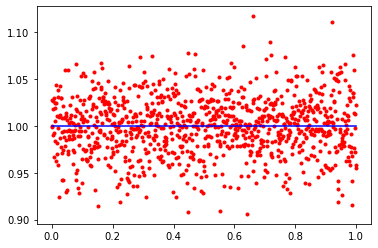

CPU times: user 269 ms, sys: 34.6 ms, total: 304 ms
Wall time: 187 ms
CPU times: user 1.37 s, sys: 13.1 ms, total: 1.38 s
Wall time: 1.38 s
1.0486615898274043


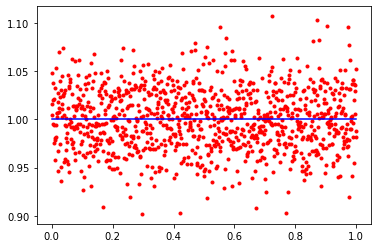

0.9427977719798087


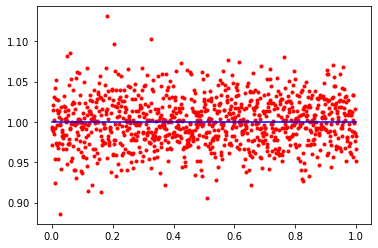

CPU times: user 261 ms, sys: 33.5 ms, total: 294 ms
Wall time: 174 ms
CPU times: user 1.34 s, sys: 12 ms, total: 1.35 s
Wall time: 1.36 s
0.9220646106732864


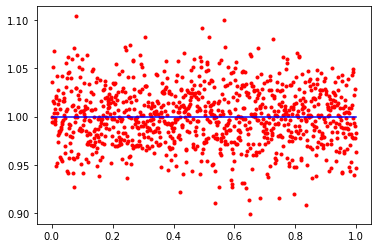

0.9579270032996225


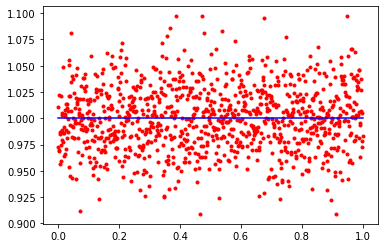

CPU times: user 237 ms, sys: 27.7 ms, total: 265 ms
Wall time: 174 ms
CPU times: user 1.35 s, sys: 11.7 ms, total: 1.36 s
Wall time: 1.36 s
0.99328998872568


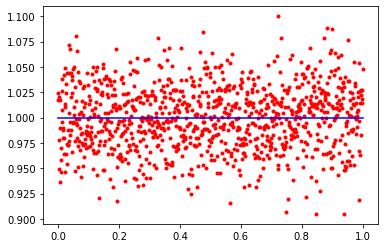

1.0542105199041223


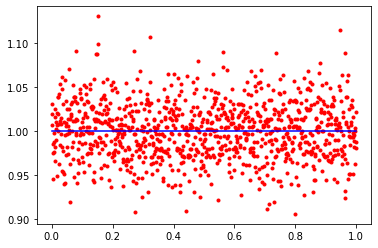

CPU times: user 264 ms, sys: 32.4 ms, total: 296 ms
Wall time: 179 ms
CPU times: user 1.33 s, sys: 12.4 ms, total: 1.34 s
Wall time: 1.34 s
1.0884755788901295


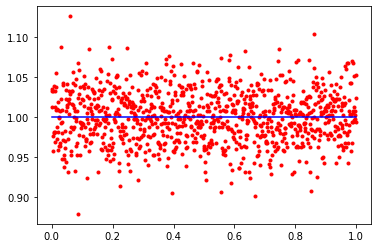

1.0337106764471562


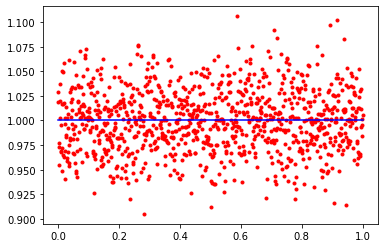

CPU times: user 237 ms, sys: 25.2 ms, total: 262 ms
Wall time: 176 ms
CPU times: user 1.35 s, sys: 12.6 ms, total: 1.36 s
Wall time: 1.36 s
1.035697247258721


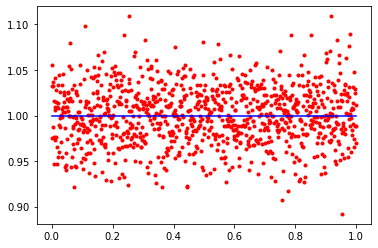

1.0591904982455884


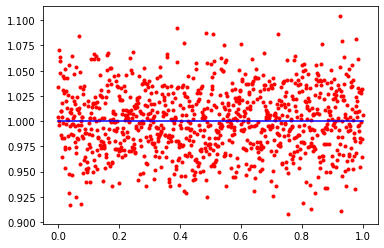

CPU times: user 240 ms, sys: 31.5 ms, total: 271 ms
Wall time: 176 ms
CPU times: user 1.38 s, sys: 14.5 ms, total: 1.39 s
Wall time: 1.39 s
1.0199404445977387


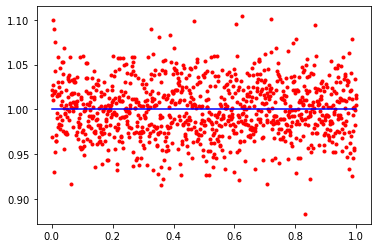

0.9628590957920653


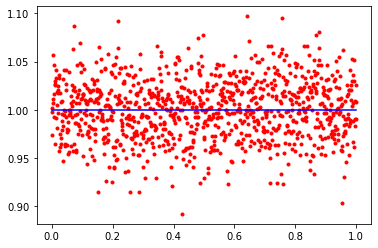

CPU times: user 259 ms, sys: 31 ms, total: 290 ms
Wall time: 170 ms
CPU times: user 1.33 s, sys: 12.4 ms, total: 1.34 s
Wall time: 1.34 s
0.9468561113735091


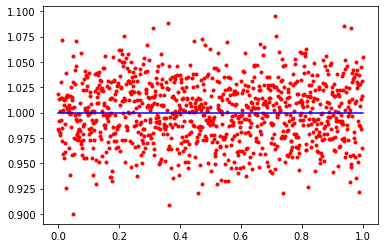

1.0007557281163915


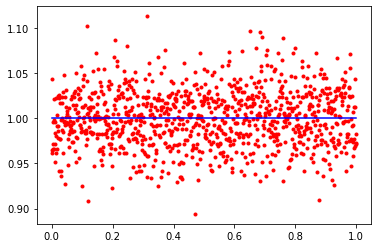

CPU times: user 260 ms, sys: 32.4 ms, total: 293 ms
Wall time: 172 ms
CPU times: user 1.34 s, sys: 11.4 ms, total: 1.35 s
Wall time: 1.35 s
0.9876037953107801


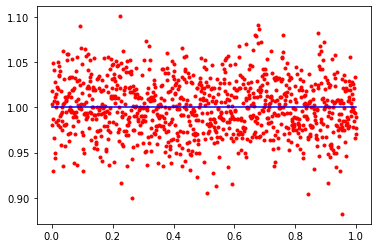

0.977091955463267


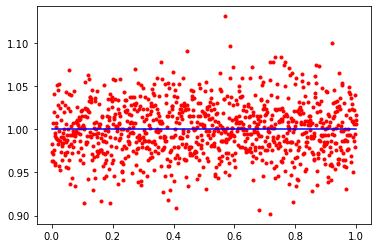

CPU times: user 253 ms, sys: 31.2 ms, total: 284 ms
Wall time: 174 ms
CPU times: user 1.37 s, sys: 13.9 ms, total: 1.38 s
Wall time: 1.38 s
1.0330744313252216


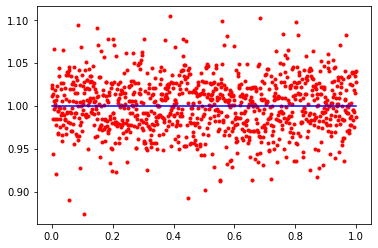

0.9834372663649021


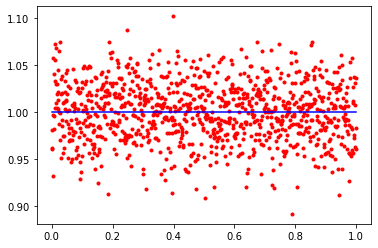

CPU times: user 258 ms, sys: 34 ms, total: 292 ms
Wall time: 174 ms
CPU times: user 1.34 s, sys: 12.4 ms, total: 1.35 s
Wall time: 1.35 s
1.015951577754692


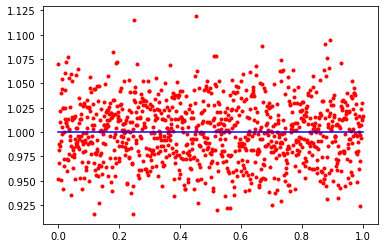

1.0317662904996765


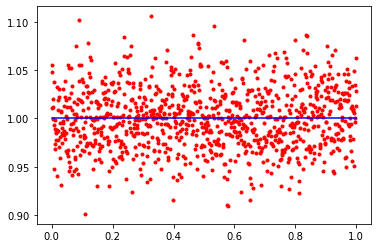

CPU times: user 242 ms, sys: 27.1 ms, total: 269 ms
Wall time: 170 ms
CPU times: user 1.34 s, sys: 12.6 ms, total: 1.35 s
Wall time: 1.35 s
0.917745937998119


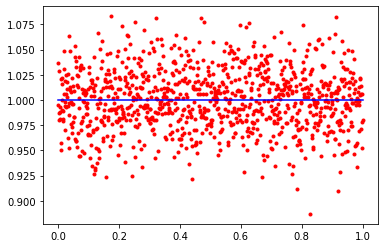

1.079068775144468


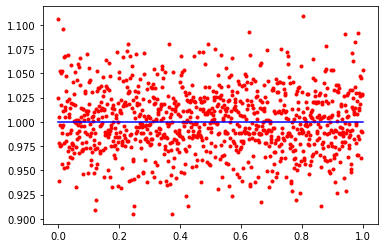

CPU times: user 238 ms, sys: 28.5 ms, total: 267 ms
Wall time: 172 ms
CPU times: user 1.36 s, sys: 12.2 ms, total: 1.37 s
Wall time: 1.37 s
1.0203281177116736


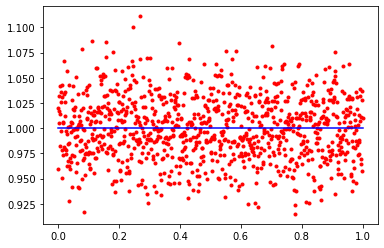

1.0364211711576443


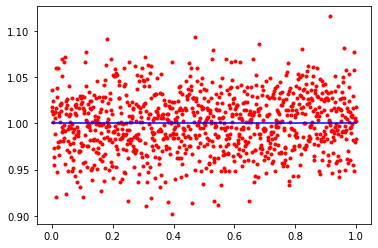

In [56]:
for _ in range(loops):
    %time r_everest = [ evran.get_random() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random() for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [57]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

1.0005483812125646
0.998834583069354
[1.00496318 0.97987048 0.98604603 1.01655522 1.03460505 1.03204329
 1.02832118 0.99695571 1.05465012 0.9811027  0.97067614 1.02614762
 0.98884762 1.02921484 0.97269784 1.00536476 1.02492592 0.9923065
 0.92222454 0.99220586]
1.0024174055566557


## 5000 samples

In [58]:
n = 5000
bins = 100

loops = 20
S_everest = []
S_K2 = []
f = lambda _: 1

CPU times: user 9.04 ms, sys: 4.59 ms, total: 13.6 ms
Wall time: 12.5 ms
CPU times: user 16 ms, sys: 2.9 ms, total: 18.9 ms
Wall time: 18.9 ms
2.338997965751577


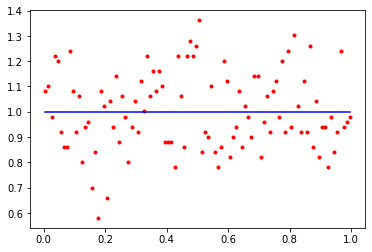

1.8266234100034078


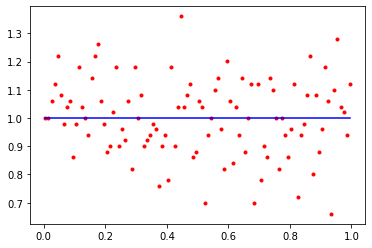

CPU times: user 2.69 ms, sys: 1.3 ms, total: 3.99 ms
Wall time: 1.42 ms
CPU times: user 18.4 ms, sys: 3.26 ms, total: 21.7 ms
Wall time: 7.51 ms
2.3449065924102848


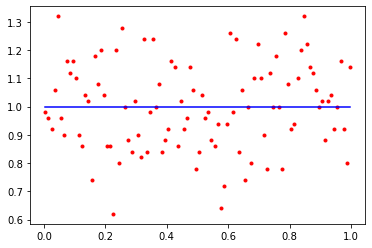

2.2291049779697834


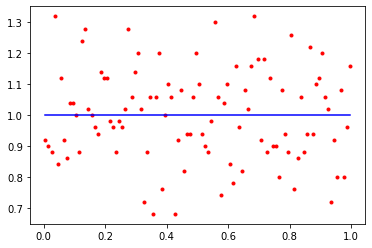

CPU times: user 3.17 ms, sys: 1.78 ms, total: 4.95 ms
Wall time: 1.69 ms
CPU times: user 18.8 ms, sys: 2.99 ms, total: 21.8 ms
Wall time: 7.57 ms
1.8482698989144428


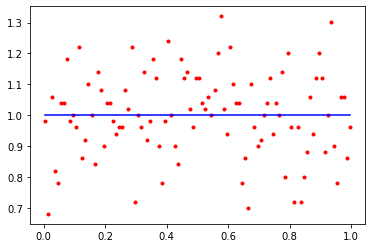

2.3266316452818363


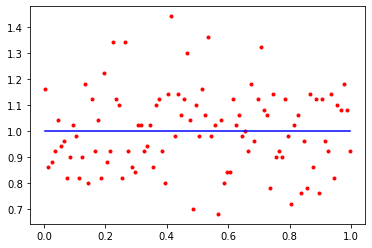

CPU times: user 3.14 ms, sys: 1.89 ms, total: 5.02 ms
Wall time: 1.73 ms
CPU times: user 18.9 ms, sys: 2.9 ms, total: 21.8 ms
Wall time: 7.44 ms
1.97426997194145


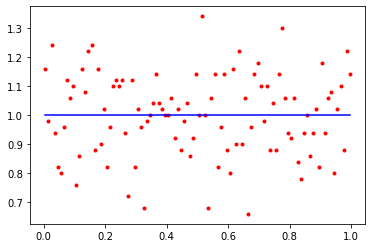

2.1188357969211413


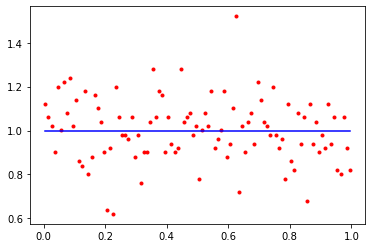

CPU times: user 3.16 ms, sys: 1.92 ms, total: 5.08 ms
Wall time: 1.76 ms
CPU times: user 18.8 ms, sys: 3.02 ms, total: 21.8 ms
Wall time: 7.48 ms
1.5697557563429112


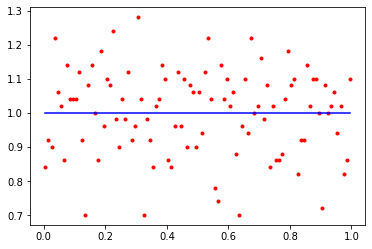

1.787766084176532


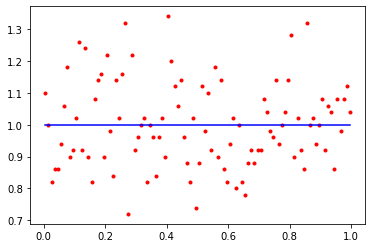

CPU times: user 3.37 ms, sys: 2.25 ms, total: 5.62 ms
Wall time: 1.92 ms
CPU times: user 18.3 ms, sys: 3.05 ms, total: 21.3 ms
Wall time: 7.32 ms
2.525259750690953


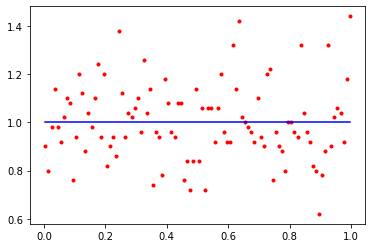

2.0075714314853603


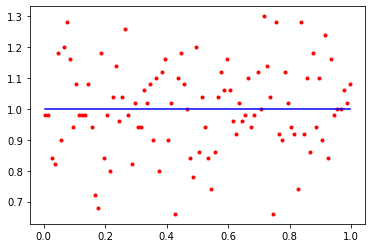

CPU times: user 3 ms, sys: 1.46 ms, total: 4.46 ms
Wall time: 1.54 ms
CPU times: user 18.7 ms, sys: 2.86 ms, total: 21.6 ms
Wall time: 7.36 ms
2.033900467582207


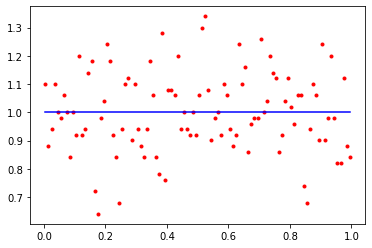

1.747047123514838


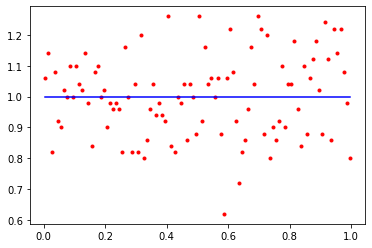

CPU times: user 2.92 ms, sys: 1.56 ms, total: 4.48 ms
Wall time: 1.6 ms
CPU times: user 18.6 ms, sys: 3.25 ms, total: 21.9 ms
Wall time: 7.58 ms
2.0012320517781754


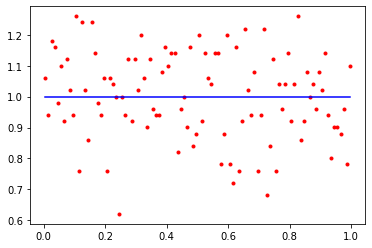

1.7174510042862776


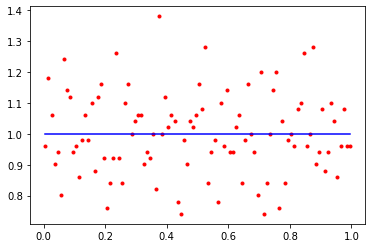

CPU times: user 3.28 ms, sys: 2.01 ms, total: 5.29 ms
Wall time: 1.85 ms
CPU times: user 18.6 ms, sys: 2.68 ms, total: 21.2 ms
Wall time: 7.2 ms
1.8844478955936772


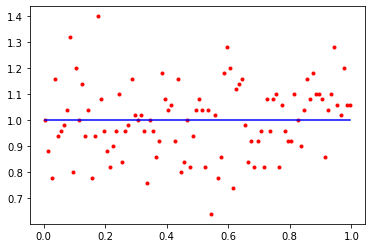

2.1864342630371394


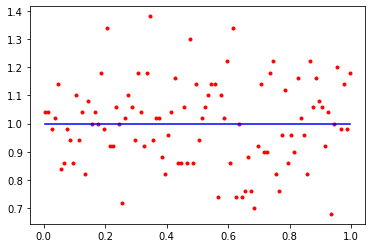

CPU times: user 3.32 ms, sys: 2.31 ms, total: 5.64 ms
Wall time: 1.96 ms
CPU times: user 18.3 ms, sys: 2.95 ms, total: 21.3 ms
Wall time: 7.3 ms
1.8499846988972117


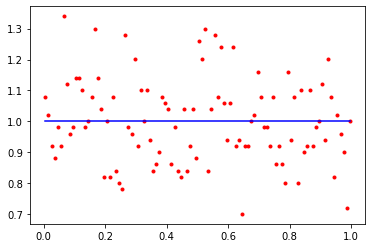

2.1082515633852643


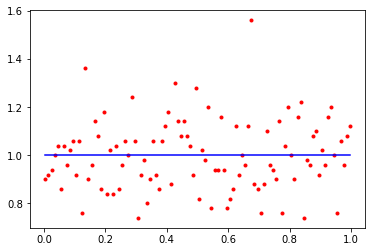

CPU times: user 3.01 ms, sys: 1.7 ms, total: 4.71 ms
Wall time: 1.63 ms
CPU times: user 18.9 ms, sys: 2.69 ms, total: 21.6 ms
Wall time: 7.32 ms
2.3762835997238847


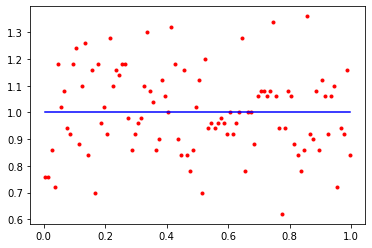

2.1890471454536917


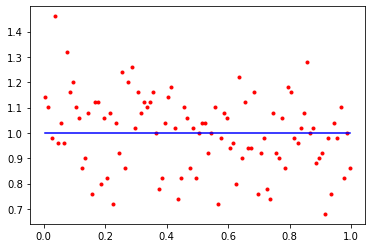

CPU times: user 3.22 ms, sys: 1.56 ms, total: 4.78 ms
Wall time: 1.64 ms
CPU times: user 18.3 ms, sys: 3.19 ms, total: 21.5 ms
Wall time: 7.4 ms
1.9006794605099635


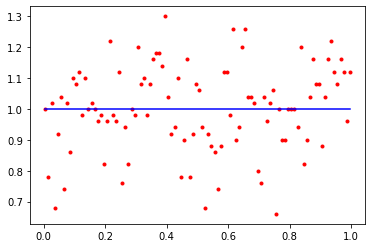

1.8174741157759386


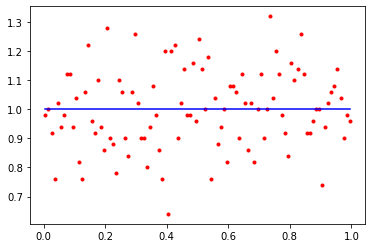

CPU times: user 3.39 ms, sys: 2.38 ms, total: 5.77 ms
Wall time: 1.95 ms
CPU times: user 18.7 ms, sys: 2.95 ms, total: 21.6 ms
Wall time: 7.38 ms
1.9417925367571722


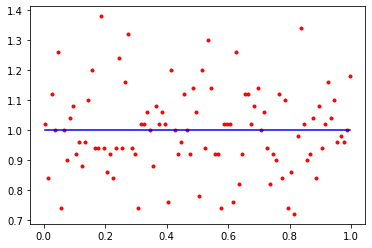

1.7522946484716493


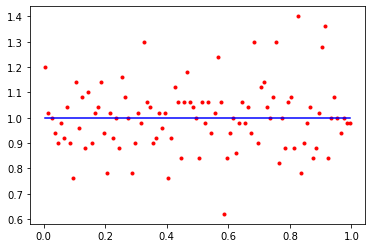

CPU times: user 5.01 ms, sys: 2.28 ms, total: 7.3 ms
Wall time: 3.02 ms
CPU times: user 18.7 ms, sys: 3.02 ms, total: 21.7 ms
Wall time: 7.43 ms
2.425684117637789


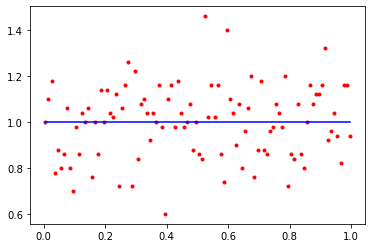

1.8995108621689227


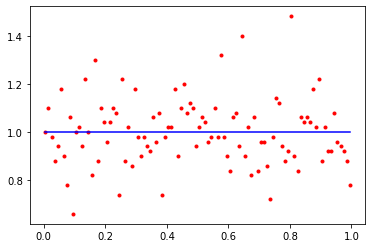

CPU times: user 3.07 ms, sys: 1.76 ms, total: 4.83 ms
Wall time: 1.68 ms
CPU times: user 18.4 ms, sys: 3.07 ms, total: 21.5 ms
Wall time: 7.41 ms
2.011620006957703


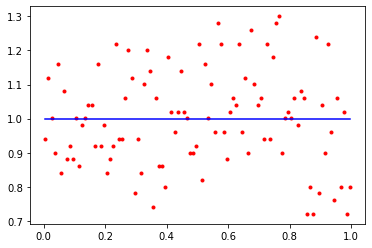

2.006437840935834


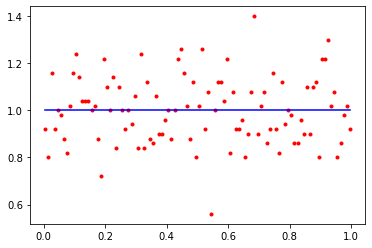

CPU times: user 2.97 ms, sys: 2.07 ms, total: 5.05 ms
Wall time: 1.78 ms
CPU times: user 18.7 ms, sys: 2.77 ms, total: 21.5 ms
Wall time: 7.3 ms
2.459213493430965


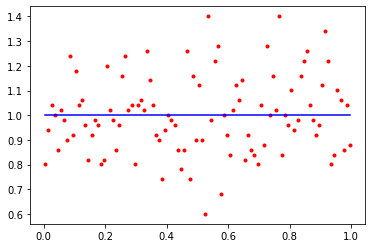

1.9672223200975063


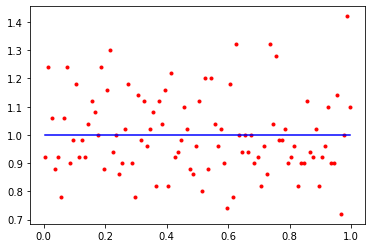

CPU times: user 3.08 ms, sys: 2.04 ms, total: 5.12 ms
Wall time: 1.79 ms
CPU times: user 18.3 ms, sys: 3.06 ms, total: 21.4 ms
Wall time: 7.37 ms
1.8633423028045848


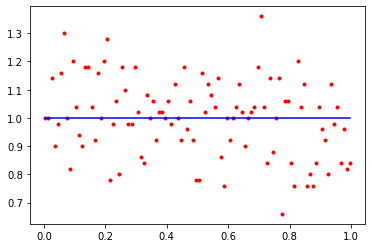

1.8571658953223917


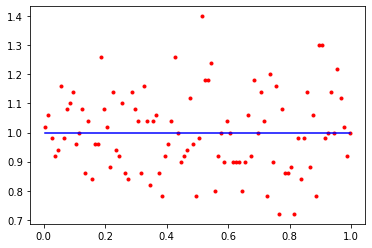

CPU times: user 3.23 ms, sys: 1.57 ms, total: 4.8 ms
Wall time: 1.67 ms
CPU times: user 18.4 ms, sys: 2.81 ms, total: 21.2 ms
Wall time: 7.23 ms
2.0456625330510727


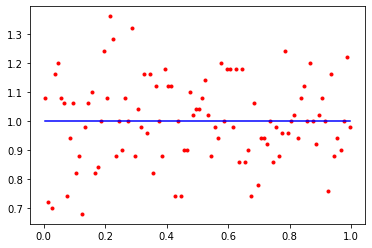

2.022324759113721


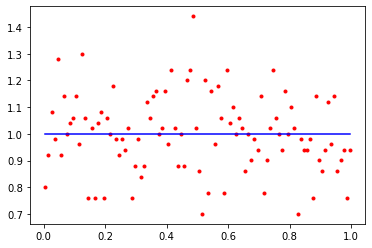

CPU times: user 2.84 ms, sys: 1.1 ms, total: 3.95 ms
Wall time: 1.37 ms
CPU times: user 18.3 ms, sys: 3.12 ms, total: 21.5 ms
Wall time: 7.42 ms
1.7698107236989278


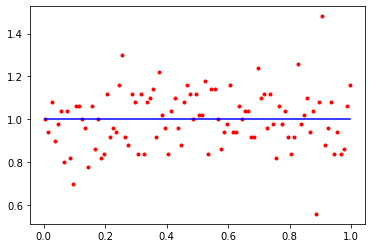

1.9679728551994862


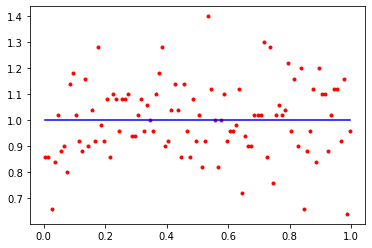

CPU times: user 2.89 ms, sys: 1.24 ms, total: 4.12 ms
Wall time: 1.43 ms
CPU times: user 18.5 ms, sys: 3 ms, total: 21.5 ms
Wall time: 7.39 ms
2.04905800223767


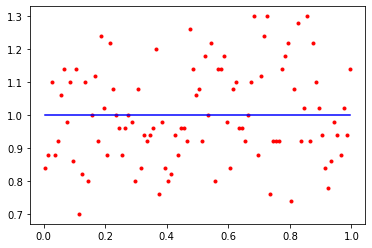

1.6841209366757248


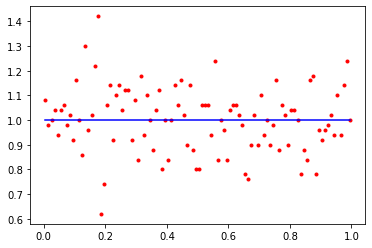

In [59]:
for _ in range(loops):
    %time r_everest = [ evran.get_random() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random() for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [60]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

1.4355168377053718
1.4003443983405734
[1.13159342 1.02564605 0.89128968 0.96528291 0.93704553 1.12154712
 1.07897787 1.07945998 0.92837589 0.93674817 1.0418893  1.02263423
 1.05268357 1.13004628 1.00129055 1.11807618 1.00166148 1.00575348
 0.94831771 1.10303804]
1.0286727825224966


## 100 samples

In [61]:
n = 100
bins = 15

loops = 20
S_everest = []
S_K2 = []
f = lambda _: 1

CPU times: user 101 µs, sys: 16 µs, total: 117 µs
Wall time: 111 µs
CPU times: user 247 µs, sys: 3 µs, total: 250 µs
Wall time: 255 µs
2.525812677796363


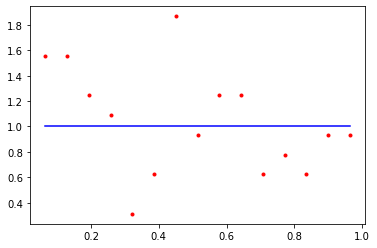

2.277139481578156


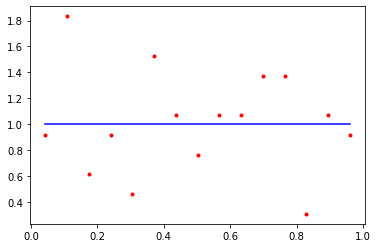

CPU times: user 159 µs, sys: 127 µs, total: 286 µs
Wall time: 110 µs
CPU times: user 408 µs, sys: 47 µs, total: 455 µs
Wall time: 154 µs
3.5212406457404533


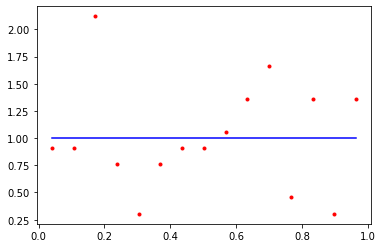

1.857547533732423


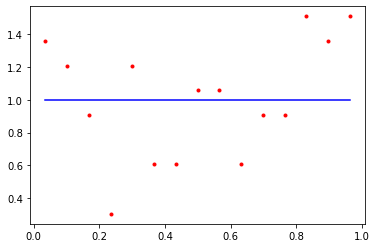

CPU times: user 499 µs, sys: 456 µs, total: 955 µs
Wall time: 323 µs
CPU times: user 351 µs, sys: 80 µs, total: 431 µs
Wall time: 157 µs
1.6667308201658468


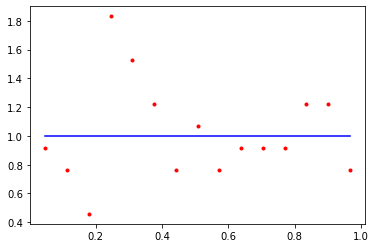

3.8206105605542686


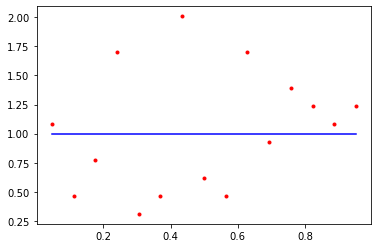

CPU times: user 317 µs, sys: 247 µs, total: 564 µs
Wall time: 200 µs
CPU times: user 424 µs, sys: 50 µs, total: 474 µs
Wall time: 161 µs
3.8147549310062034


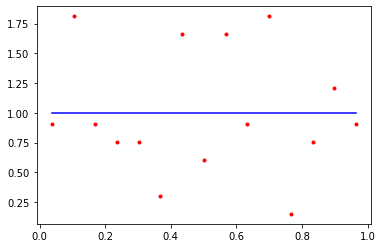

1.2580653605142074


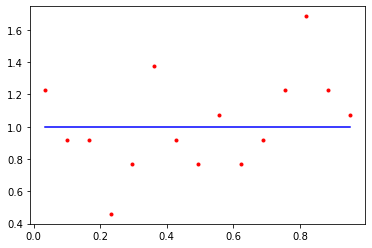

CPU times: user 382 µs, sys: 446 µs, total: 828 µs
Wall time: 287 µs
CPU times: user 461 µs, sys: 64 µs, total: 525 µs
Wall time: 178 µs
2.0482372081384552


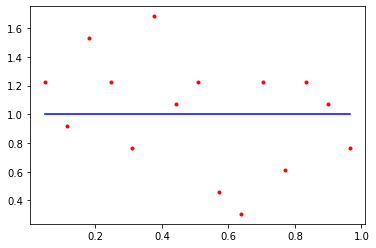

2.203223835192794


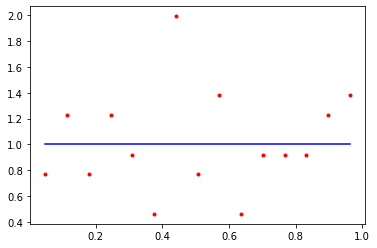

CPU times: user 200 µs, sys: 127 µs, total: 327 µs
Wall time: 124 µs
CPU times: user 359 µs, sys: 116 µs, total: 475 µs
Wall time: 177 µs
3.197477716114567


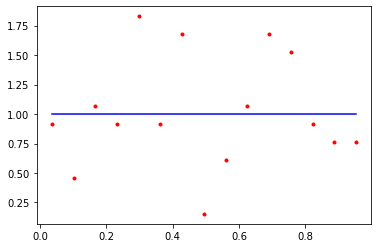

1.9803258879247443


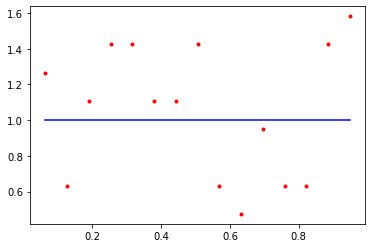

CPU times: user 122 µs, sys: 205 µs, total: 327 µs
Wall time: 116 µs
CPU times: user 409 µs, sys: 49 µs, total: 458 µs
Wall time: 155 µs
3.1636580576600237


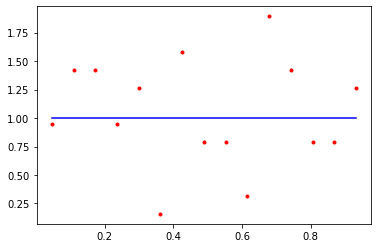

1.7411988927500992


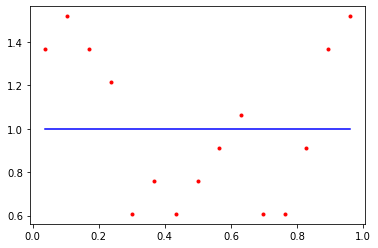

CPU times: user 233 µs, sys: 268 µs, total: 501 µs
Wall time: 187 µs
CPU times: user 412 µs, sys: 47 µs, total: 459 µs
Wall time: 156 µs
2.3250752544833877


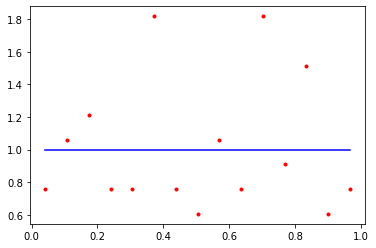

1.2997898730020068


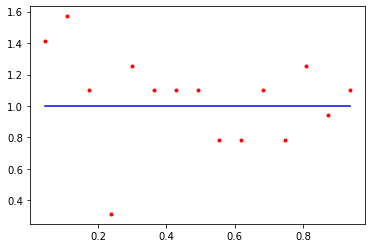

CPU times: user 170 µs, sys: 106 µs, total: 276 µs
Wall time: 99.9 µs
CPU times: user 407 µs, sys: 49 µs, total: 456 µs
Wall time: 154 µs
0.9311587117359346


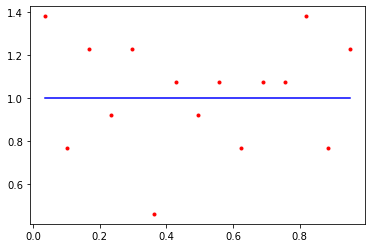

1.1374111699055245


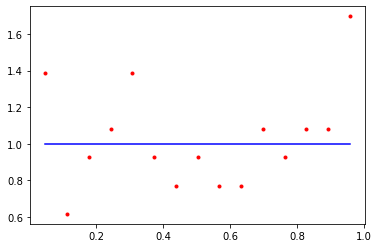

CPU times: user 320 µs, sys: 367 µs, total: 687 µs
Wall time: 244 µs
CPU times: user 411 µs, sys: 49 µs, total: 460 µs
Wall time: 156 µs
1.9944008279784067


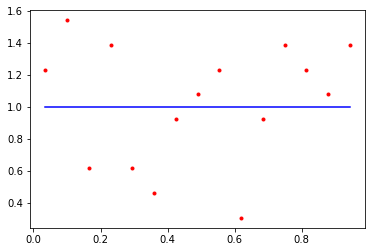

1.123734829388846


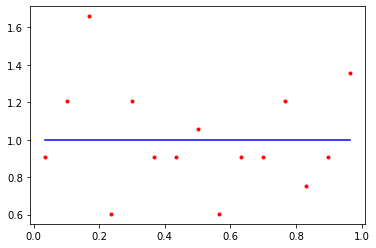

CPU times: user 262 µs, sys: 303 µs, total: 565 µs
Wall time: 202 µs
CPU times: user 406 µs, sys: 48 µs, total: 454 µs
Wall time: 154 µs
1.8150916434682696


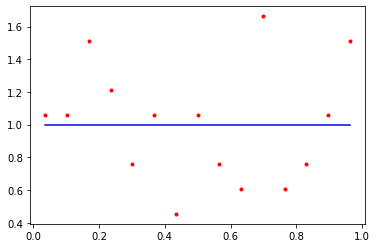

1.5561766182252008


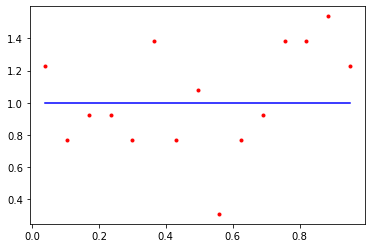

CPU times: user 222 µs, sys: 220 µs, total: 442 µs
Wall time: 161 µs
CPU times: user 407 µs, sys: 48 µs, total: 455 µs
Wall time: 154 µs
1.0422631420817172


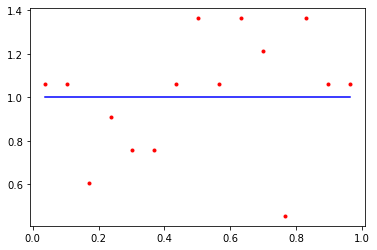

1.5593564460061868


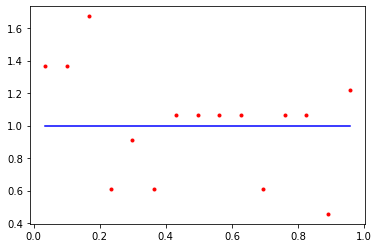

CPU times: user 251 µs, sys: 240 µs, total: 491 µs
Wall time: 189 µs
CPU times: user 363 µs, sys: 94 µs, total: 457 µs
Wall time: 173 µs
1.9723935983152308


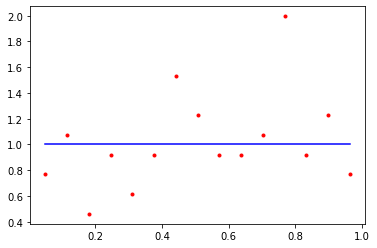

1.8453256205842636


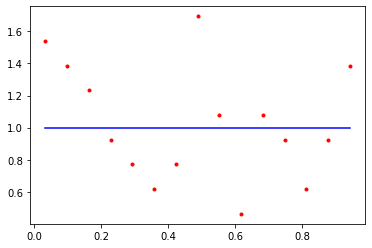

CPU times: user 197 µs, sys: 134 µs, total: 331 µs
Wall time: 123 µs
CPU times: user 356 µs, sys: 79 µs, total: 435 µs
Wall time: 159 µs
1.7234907508860198


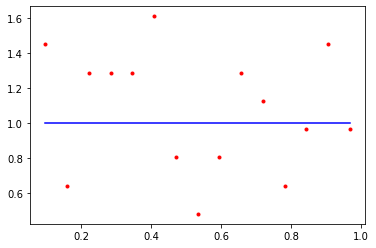

1.720495944459295


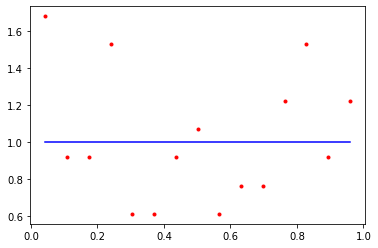

CPU times: user 144 µs, sys: 219 µs, total: 363 µs
Wall time: 122 µs
CPU times: user 416 µs, sys: 49 µs, total: 465 µs
Wall time: 158 µs
1.8798484282575478


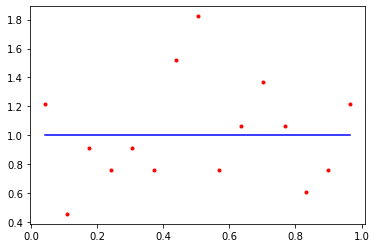

1.8791642446173977


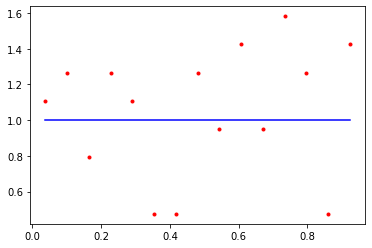

CPU times: user 241 µs, sys: 240 µs, total: 481 µs
Wall time: 180 µs
CPU times: user 399 µs, sys: 100 µs, total: 499 µs
Wall time: 182 µs
2.3177671624490483


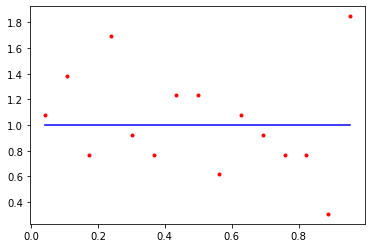

4.5564998971633885


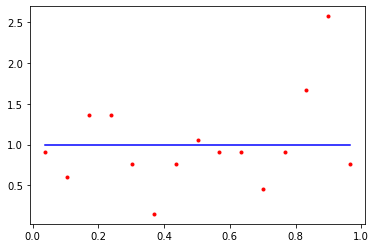

CPU times: user 198 µs, sys: 106 µs, total: 304 µs
Wall time: 112 µs
CPU times: user 417 µs, sys: 49 µs, total: 466 µs
Wall time: 158 µs
1.7894459271039052


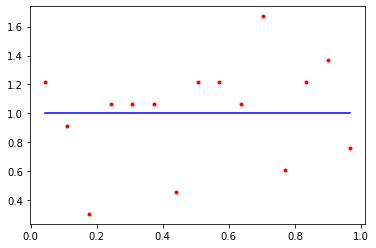

1.7770382170139516


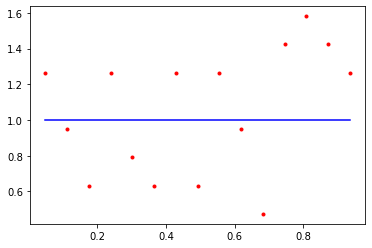

CPU times: user 212 µs, sys: 215 µs, total: 427 µs
Wall time: 161 µs
CPU times: user 411 µs, sys: 49 µs, total: 460 µs
Wall time: 156 µs
1.5172874756851444


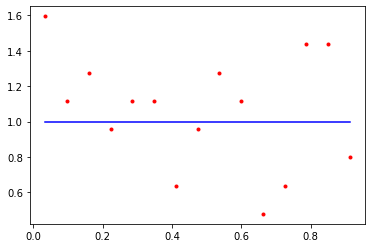

3.0308875664042914


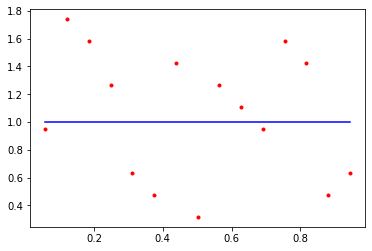

CPU times: user 198 µs, sys: 163 µs, total: 361 µs
Wall time: 135 µs
CPU times: user 417 µs, sys: 49 µs, total: 466 µs
Wall time: 158 µs
1.9767280669050833


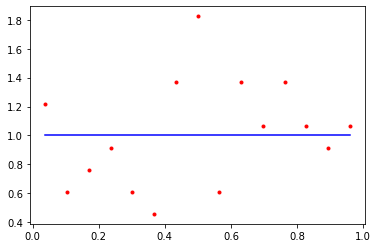

1.1073761431804912


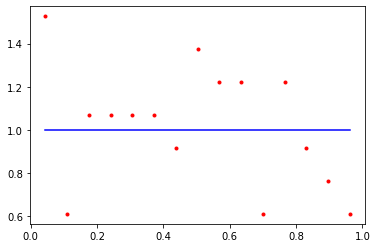

CPU times: user 177 µs, sys: 293 µs, total: 470 µs
Wall time: 160 µs
CPU times: user 410 µs, sys: 48 µs, total: 458 µs
Wall time: 155 µs
2.7040888144177426


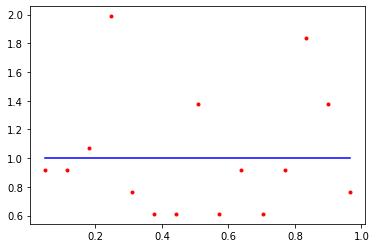

2.94116882453383


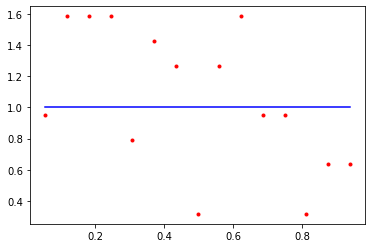

In [62]:
for _ in range(loops):
    %time r_everest = [ evran.get_random() for _ in range(n)]
    %time r_k2      = [ k2ran.get_random() for _ in range(n) ]
    S_everest = np.array([ *S_everest, test_random(r_everest, bins, f) ])
    S_K2      = np.array([ *S_K2, test_random(r_k2, bins, f) ])

In [63]:
print(np.sqrt(S_everest.mean()))
print(np.sqrt(S_K2.mean()))
print(np.sqrt(S_everest / S_K2))
print(np.sqrt((S_everest / S_K2).mean()))

1.4820079598367437
1.426052890792122
[1.05318764 1.37682228 0.66049015 1.74133255 0.96418599 1.27067777
 1.34794005 1.33746348 0.90480108 1.33221495 1.07999025 0.81755314
 1.03385656 1.00086995 1.00018203 0.71321295 1.00348505 0.70753678
 1.33605976 0.95884962]
1.1145238227603855
